## Importing the libraries

In [1]:
%pip install scikit-learn==1.2.2

Note: you may need to restart the kernel to use updated packages.


In [1]:
%pip install statsmodels

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.7/10.7 MB 77.0 MB/s eta 0:00:00:00:01:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.9/233.9 kB 29.6 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


In [2]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import precision_recall_fscore_support,r2_score,classification_report,confusion_matrix,ConfusionMatrixDisplay,accuracy_score
from sklearn.preprocessing import StandardScaler
from collections import defaultdict
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import LogisticRegression,RidgeClassifierCV
from sklearn.linear_model import SGDClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import GridSearchCV
from scipy.stats import loguniform
from sklearn.model_selection import RepeatedStratifiedKFold


## Importing the dataset

In [3]:
df= pd.read_csv("adult.data",sep=' ',names= ['age','workclass','fnlwgt','education','education_num','marital_status','occupation',
            'relationship','race','sex','capital_gain','capital_loss','hours_per_week','native_country','high_income'])

In [4]:
df

,age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country,high_income
0,"39,","State-gov,","77516,","Bachelors,","13,","Never-married,","Adm-clerical,","Not-in-family,","White,","Male,","2174,","0,","40,","United-States,",<=50K
1,"50,","Self-emp-not-inc,","83311,","Bachelors,","13,","Married-civ-spouse,","Exec-managerial,","Husband,","White,","Male,","0,","0,","13,","United-States,",<=50K
2,"38,","Private,","215646,","HS-grad,","9,","Divorced,","Handlers-cleaners,","Not-in-family,","White,","Male,","0,","0,","40,","United-States,",<=50K
3,"53,","Private,","234721,","11th,","7,","Married-civ-spouse,","Handlers-cleaners,","Husband,","Black,","Male,","0,","0,","40,","United-States,",<=50K
4,"28,","Private,","338409,","Bachelors,","13,","Married-civ-spouse,","Prof-specialty,","Wife,","Black,","Female,","0,","0,","40,","Cuba,",<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,"27,","Private,","257302,","Assoc-acdm,","12,","Married-civ-spouse,","Tech-support,","Wife,","White,","Female,","0,","0,","38,","United-States,",<=50K
32557,"40,","Private,","154374,","HS-grad,","9,","Married-civ-spouse,","Machine-op-inspct,","Husband,","White,","Male,","0,","0,","40,","United-States,",>50K
32558,"58,","Private,","151910,","HS-grad,","9,","Widowed,","Adm-clerical,","Unmarried,","White,","Female,","0,","0,","40,","United-States,",<=50K
32559,"22,","Private,","201490,","HS-grad,","9,","Never-married,","Adm-clerical,","Own-child,","White,","Male,","0,","0,","20,","United-States,",<=50K


In [5]:
df_train=df.drop("high_income",axis=1)
output_col=pd.DataFrame(df['high_income'])

In [6]:
output_col

,high_income
0,<=50K
1,<=50K
2,<=50K
3,<=50K
4,<=50K
...,...
32556,<=50K
32557,>50K
32558,<=50K
32559,<=50K


## Cleaning the dataset

In [7]:
label_mapper={'<=50K':0,'>50K':1}
output_col['high_income']=output_col['high_income'].map(label_mapper)


In [8]:
output_col


,high_income
0,0
1,0
2,0
3,0
4,0
...,...
32556,0
32557,1
32558,0
32559,0


In [9]:
df_train

,age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country
0,"39,","State-gov,","77516,","Bachelors,","13,","Never-married,","Adm-clerical,","Not-in-family,","White,","Male,","2174,","0,","40,","United-States,"
1,"50,","Self-emp-not-inc,","83311,","Bachelors,","13,","Married-civ-spouse,","Exec-managerial,","Husband,","White,","Male,","0,","0,","13,","United-States,"
2,"38,","Private,","215646,","HS-grad,","9,","Divorced,","Handlers-cleaners,","Not-in-family,","White,","Male,","0,","0,","40,","United-States,"
3,"53,","Private,","234721,","11th,","7,","Married-civ-spouse,","Handlers-cleaners,","Husband,","Black,","Male,","0,","0,","40,","United-States,"
4,"28,","Private,","338409,","Bachelors,","13,","Married-civ-spouse,","Prof-specialty,","Wife,","Black,","Female,","0,","0,","40,","Cuba,"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,"27,","Private,","257302,","Assoc-acdm,","12,","Married-civ-spouse,","Tech-support,","Wife,","White,","Female,","0,","0,","38,","United-States,"
32557,"40,","Private,","154374,","HS-grad,","9,","Married-civ-spouse,","Machine-op-inspct,","Husband,","White,","Male,","0,","0,","40,","United-States,"
32558,"58,","Private,","151910,","HS-grad,","9,","Widowed,","Adm-clerical,","Unmarried,","White,","Female,","0,","0,","40,","United-States,"
32559,"22,","Private,","201490,","HS-grad,","9,","Never-married,","Adm-clerical,","Own-child,","White,","Male,","0,","0,","20,","United-States,"


In [10]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32561 entries, 0 to 32560
Data columns (total 14 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   age             32561 non-null  object
 1   workclass       32561 non-null  object
 2   fnlwgt          32561 non-null  object
 3   education       32561 non-null  object
 4   education_num   32561 non-null  object
 5   marital_status  32561 non-null  object
 6   occupation      32561 non-null  object
 7   relationship    32561 non-null  object
 8   race            32561 non-null  object
 9   sex             32561 non-null  object
 10  capital_gain    32561 non-null  object
 11  capital_loss    32561 non-null  object
 12  hours_per_week  32561 non-null  object
 13  native_country  32561 non-null  object
dtypes: object(14)
memory usage: 3.5+ MB


In [11]:
for col in df_train.columns:
    has_comma=False
    for val in df_train[col]:
        if "," in val:
            has_comma=True
            break
    print(col," has comma")
            

age  has comma
workclass  has comma
fnlwgt  has comma
education  has comma
education_num  has comma
marital_status  has comma
occupation  has comma
relationship  has comma
race  has comma
sex  has comma
capital_gain  has comma
capital_loss  has comma
hours_per_week  has comma
native_country  has comma


In [12]:
def remove_extra_commas(value):
    if value.endswith(','):
        return value[:-1]  # Remove the last character (comma)
    else:
        return value  # No change if no extra comma
for col in df_train.columns:
    df_train[col] = df_train[col].apply(remove_extra_commas)


In [13]:
df_train

,age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,27,Private,257302,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,United-States
32557,40,Private,154374,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,United-States
32558,58,Private,151910,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,United-States
32559,22,Private,201490,HS-grad,9,Never-married,Adm-clerical,Own-child,White,Male,0,0,20,United-States


In [14]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32561 entries, 0 to 32560
Data columns (total 14 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   age             32561 non-null  object
 1   workclass       32561 non-null  object
 2   fnlwgt          32561 non-null  object
 3   education       32561 non-null  object
 4   education_num   32561 non-null  object
 5   marital_status  32561 non-null  object
 6   occupation      32561 non-null  object
 7   relationship    32561 non-null  object
 8   race            32561 non-null  object
 9   sex             32561 non-null  object
 10  capital_gain    32561 non-null  object
 11  capital_loss    32561 non-null  object
 12  hours_per_week  32561 non-null  object
 13  native_country  32561 non-null  object
dtypes: object(14)
memory usage: 3.5+ MB


Since some columns are of number types also so we will convert them.

In [15]:
update_cols=['age','fnlwgt','education_num','capital_gain','capital_loss','hours_per_week']
for col in update_cols:
    df_train[col]=df_train[col].astype("float")
    

In [16]:
df_train

,age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country
0,39.0,State-gov,77516.0,Bachelors,13.0,Never-married,Adm-clerical,Not-in-family,White,Male,2174.0,0.0,40.0,United-States
1,50.0,Self-emp-not-inc,83311.0,Bachelors,13.0,Married-civ-spouse,Exec-managerial,Husband,White,Male,0.0,0.0,13.0,United-States
2,38.0,Private,215646.0,HS-grad,9.0,Divorced,Handlers-cleaners,Not-in-family,White,Male,0.0,0.0,40.0,United-States
3,53.0,Private,234721.0,11th,7.0,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0.0,0.0,40.0,United-States
4,28.0,Private,338409.0,Bachelors,13.0,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0.0,0.0,40.0,Cuba
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,27.0,Private,257302.0,Assoc-acdm,12.0,Married-civ-spouse,Tech-support,Wife,White,Female,0.0,0.0,38.0,United-States
32557,40.0,Private,154374.0,HS-grad,9.0,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0.0,0.0,40.0,United-States
32558,58.0,Private,151910.0,HS-grad,9.0,Widowed,Adm-clerical,Unmarried,White,Female,0.0,0.0,40.0,United-States
32559,22.0,Private,201490.0,HS-grad,9.0,Never-married,Adm-clerical,Own-child,White,Male,0.0,0.0,20.0,United-States


In [17]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32561 entries, 0 to 32560
Data columns (total 14 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             32561 non-null  float64
 1   workclass       32561 non-null  object 
 2   fnlwgt          32561 non-null  float64
 3   education       32561 non-null  object 
 4   education_num   32561 non-null  float64
 5   marital_status  32561 non-null  object 
 6   occupation      32561 non-null  object 
 7   relationship    32561 non-null  object 
 8   race            32561 non-null  object 
 9   sex             32561 non-null  object 
 10  capital_gain    32561 non-null  float64
 11  capital_loss    32561 non-null  float64
 12  hours_per_week  32561 non-null  float64
 13  native_country  32561 non-null  object 
dtypes: float64(6), object(8)
memory usage: 3.5+ MB


In [18]:
categorical_columns=df_train.select_dtypes(exclude=np.number).columns
numerical_columns=df_train.select_dtypes(include=np.number).columns
categorical_columns

Index(['workclass', 'education', 'marital_status', 'occupation',
       'relationship', 'race', 'sex', 'native_country'],
      dtype='object')

In [19]:
numerical_columns

Index(['age', 'fnlwgt', 'education_num', 'capital_gain', 'capital_loss',
       'hours_per_week'],
      dtype='object')

In [20]:
for col in categorical_columns:
    # print(df_train[col].value_counts())
    print(col)
    categories=list(df_train[col].value_counts().index)
    for cats in categories:
        
        print(cats,"__")
    print()
    

workclass
Private __
Self-emp-not-inc __
Local-gov __
? __
State-gov __
Self-emp-inc __
Federal-gov __
Without-pay __
Never-worked __

education
HS-grad __
Some-college __
Bachelors __
Masters __
Assoc-voc __
11th __
Assoc-acdm __
10th __
7th-8th __
Prof-school __
9th __
12th __
Doctorate __
5th-6th __
1st-4th __
Preschool __

marital_status
Married-civ-spouse __
Never-married __
Divorced __
Separated __
Widowed __
Married-spouse-absent __
Married-AF-spouse __

occupation
Prof-specialty __
Craft-repair __
Exec-managerial __
Adm-clerical __
Sales __
Other-service __
Machine-op-inspct __
? __
Transport-moving __
Handlers-cleaners __
Farming-fishing __
Tech-support __
Protective-serv __
Priv-house-serv __
Armed-Forces __

relationship
Husband __
Not-in-family __
Own-child __
Unmarried __
Wife __
Other-relative __

race
White __
Black __
Asian-Pac-Islander __
Amer-Indian-Eskimo __
Other __

sex
Male __
Female __

native_country
United-States __
Mexico __
? __
Philippines __
Germany __
Cana

In [21]:
# For the category "?" in some columns we impute them with np.nan values
for col in categorical_columns:
    if "?" in set(df_train[col].value_counts().index) :
        df_train[col]=np.where(df_train[col]=="?","Undefined",df_train[col])

In [22]:
df_train

,age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country
0,39.0,State-gov,77516.0,Bachelors,13.0,Never-married,Adm-clerical,Not-in-family,White,Male,2174.0,0.0,40.0,United-States
1,50.0,Self-emp-not-inc,83311.0,Bachelors,13.0,Married-civ-spouse,Exec-managerial,Husband,White,Male,0.0,0.0,13.0,United-States
2,38.0,Private,215646.0,HS-grad,9.0,Divorced,Handlers-cleaners,Not-in-family,White,Male,0.0,0.0,40.0,United-States
3,53.0,Private,234721.0,11th,7.0,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0.0,0.0,40.0,United-States
4,28.0,Private,338409.0,Bachelors,13.0,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0.0,0.0,40.0,Cuba
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,27.0,Private,257302.0,Assoc-acdm,12.0,Married-civ-spouse,Tech-support,Wife,White,Female,0.0,0.0,38.0,United-States
32557,40.0,Private,154374.0,HS-grad,9.0,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0.0,0.0,40.0,United-States
32558,58.0,Private,151910.0,HS-grad,9.0,Widowed,Adm-clerical,Unmarried,White,Female,0.0,0.0,40.0,United-States
32559,22.0,Private,201490.0,HS-grad,9.0,Never-married,Adm-clerical,Own-child,White,Male,0.0,0.0,20.0,United-States


## Exploratory Data Analysis

### 1. First step is to see the type of columns so that we could conclude that even now some columns needs to be appropriated.

In [23]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32561 entries, 0 to 32560
Data columns (total 14 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             32561 non-null  float64
 1   workclass       32561 non-null  object 
 2   fnlwgt          32561 non-null  float64
 3   education       32561 non-null  object 
 4   education_num   32561 non-null  float64
 5   marital_status  32561 non-null  object 
 6   occupation      32561 non-null  object 
 7   relationship    32561 non-null  object 
 8   race            32561 non-null  object 
 9   sex             32561 non-null  object 
 10  capital_gain    32561 non-null  float64
 11  capital_loss    32561 non-null  float64
 12  hours_per_week  32561 non-null  float64
 13  native_country  32561 non-null  object 
dtypes: float64(6), object(8)
memory usage: 3.5+ MB


In [24]:
df_train

,age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country
0,39.0,State-gov,77516.0,Bachelors,13.0,Never-married,Adm-clerical,Not-in-family,White,Male,2174.0,0.0,40.0,United-States
1,50.0,Self-emp-not-inc,83311.0,Bachelors,13.0,Married-civ-spouse,Exec-managerial,Husband,White,Male,0.0,0.0,13.0,United-States
2,38.0,Private,215646.0,HS-grad,9.0,Divorced,Handlers-cleaners,Not-in-family,White,Male,0.0,0.0,40.0,United-States
3,53.0,Private,234721.0,11th,7.0,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0.0,0.0,40.0,United-States
4,28.0,Private,338409.0,Bachelors,13.0,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0.0,0.0,40.0,Cuba
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,27.0,Private,257302.0,Assoc-acdm,12.0,Married-civ-spouse,Tech-support,Wife,White,Female,0.0,0.0,38.0,United-States
32557,40.0,Private,154374.0,HS-grad,9.0,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0.0,0.0,40.0,United-States
32558,58.0,Private,151910.0,HS-grad,9.0,Widowed,Adm-clerical,Unmarried,White,Female,0.0,0.0,40.0,United-States
32559,22.0,Private,201490.0,HS-grad,9.0,Never-married,Adm-clerical,Own-child,White,Male,0.0,0.0,20.0,United-States


### 2. NULL Values . First step is to see the Null Values

In [25]:
df_train.isnull().sum()

age               0
workclass         0
fnlwgt            0
education         0
education_num     0
marital_status    0
occupation        0
relationship      0
race              0
sex               0
capital_gain      0
capital_loss      0
hours_per_week    0
native_country    0
dtype: int64

<Axes: >

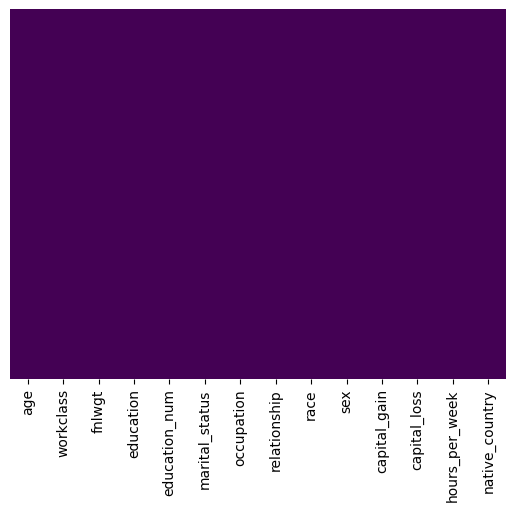

In [26]:
sns.heatmap(df_train.isnull(),yticklabels=False,cbar=False,cmap='viridis')

###  3. Next step is to see the collinearity. We will use the spearman correlation since even if the dataset is spreaded we can see the correlation very easily. We will also use the Variable Inflation Factor to see the that whether a independent column could be predicted using other independednt columns

In [27]:
pd.concat([df_train,output_col],axis=1)

,age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country,high_income
0,39.0,State-gov,77516.0,Bachelors,13.0,Never-married,Adm-clerical,Not-in-family,White,Male,2174.0,0.0,40.0,United-States,0
1,50.0,Self-emp-not-inc,83311.0,Bachelors,13.0,Married-civ-spouse,Exec-managerial,Husband,White,Male,0.0,0.0,13.0,United-States,0
2,38.0,Private,215646.0,HS-grad,9.0,Divorced,Handlers-cleaners,Not-in-family,White,Male,0.0,0.0,40.0,United-States,0
3,53.0,Private,234721.0,11th,7.0,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0.0,0.0,40.0,United-States,0
4,28.0,Private,338409.0,Bachelors,13.0,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0.0,0.0,40.0,Cuba,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,27.0,Private,257302.0,Assoc-acdm,12.0,Married-civ-spouse,Tech-support,Wife,White,Female,0.0,0.0,38.0,United-States,0
32557,40.0,Private,154374.0,HS-grad,9.0,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0.0,0.0,40.0,United-States,1
32558,58.0,Private,151910.0,HS-grad,9.0,Widowed,Adm-clerical,Unmarried,White,Female,0.0,0.0,40.0,United-States,0
32559,22.0,Private,201490.0,HS-grad,9.0,Never-married,Adm-clerical,Own-child,White,Male,0.0,0.0,20.0,United-States,0


In [28]:
pd.concat([df_train,output_col],axis=1).select_dtypes(include=np.number)

,age,fnlwgt,education_num,capital_gain,capital_loss,hours_per_week,high_income
0,39.0,77516.0,13.0,2174.0,0.0,40.0,0
1,50.0,83311.0,13.0,0.0,0.0,13.0,0
2,38.0,215646.0,9.0,0.0,0.0,40.0,0
3,53.0,234721.0,7.0,0.0,0.0,40.0,0
4,28.0,338409.0,13.0,0.0,0.0,40.0,0
...,...,...,...,...,...,...,...
32556,27.0,257302.0,12.0,0.0,0.0,38.0,0
32557,40.0,154374.0,9.0,0.0,0.0,40.0,1
32558,58.0,151910.0,9.0,0.0,0.0,40.0,0
32559,22.0,201490.0,9.0,0.0,0.0,20.0,0


In [29]:
pd.concat([df_train,output_col],axis=1).select_dtypes(include=np.number).corr(method='spearman')

,age,fnlwgt,education_num,capital_gain,capital_loss,hours_per_week,high_income
age,1.000000,-0.078141,0.066345,0.124948,0.058484,0.142907,0.272962
fnlwgt,-0.078141,1.000000,-0.035706,-0.006039,-0.006914,-0.021621,-0.010738
education_num,0.066345,-0.035706,1.000000,0.119140,0.074749,0.167215,0.329682
capital_gain,0.124948,-0.006039,0.119140,1.000000,-0.066569,0.093322,0.278159
capital_loss,0.058484,-0.006914,0.074749,-0.066569,1.000000,0.059852,0.141042
hours_per_week,0.142907,-0.021621,0.167215,0.093322,0.059852,1.000000,0.269075
high_income,0.272962,-0.010738,0.329682,0.278159,0.141042,0.269075,1.000000


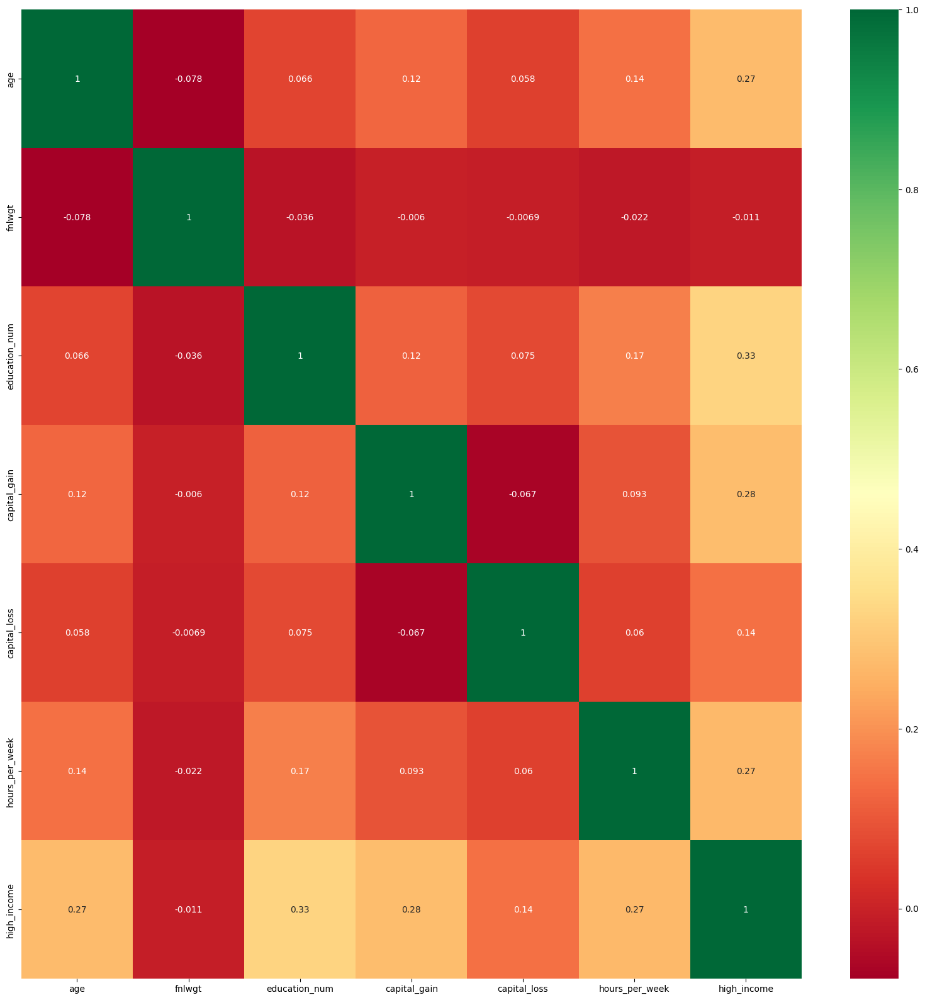

In [30]:
plt.figure(figsize=(20,20))
sns.heatmap(pd.concat([df_train,output_col],axis=1).select_dtypes(include=np.number).corr(method='spearman'),annot=True,cmap="RdYlGn")
plt.show()

In [31]:
def calc_vif(X):

    # Calculating VIF
    vif = pd.DataFrame()
    vif["Variables"] = X.columns
    vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

    return(vif)



X = df_train.select_dtypes(include=np.number)
calc_vif(X)

,Variables,VIF
0,age,7.246475
1,fnlwgt,3.683144
2,education_num,10.983289
3,capital_gain,1.032987
4,capital_loss,1.056815
5,hours_per_week,9.758094


### 4. Next step is to see the outliers.

/usr/local/lib/python3.11/dist-packages/seaborn/categorical.py:1794: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.11/dist-packages/seaborn/categorical.py:1794: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.11/dist-packages/seaborn/categorical.py:1794: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.11/dist-packages/seaborn/categorical.py:1794: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating

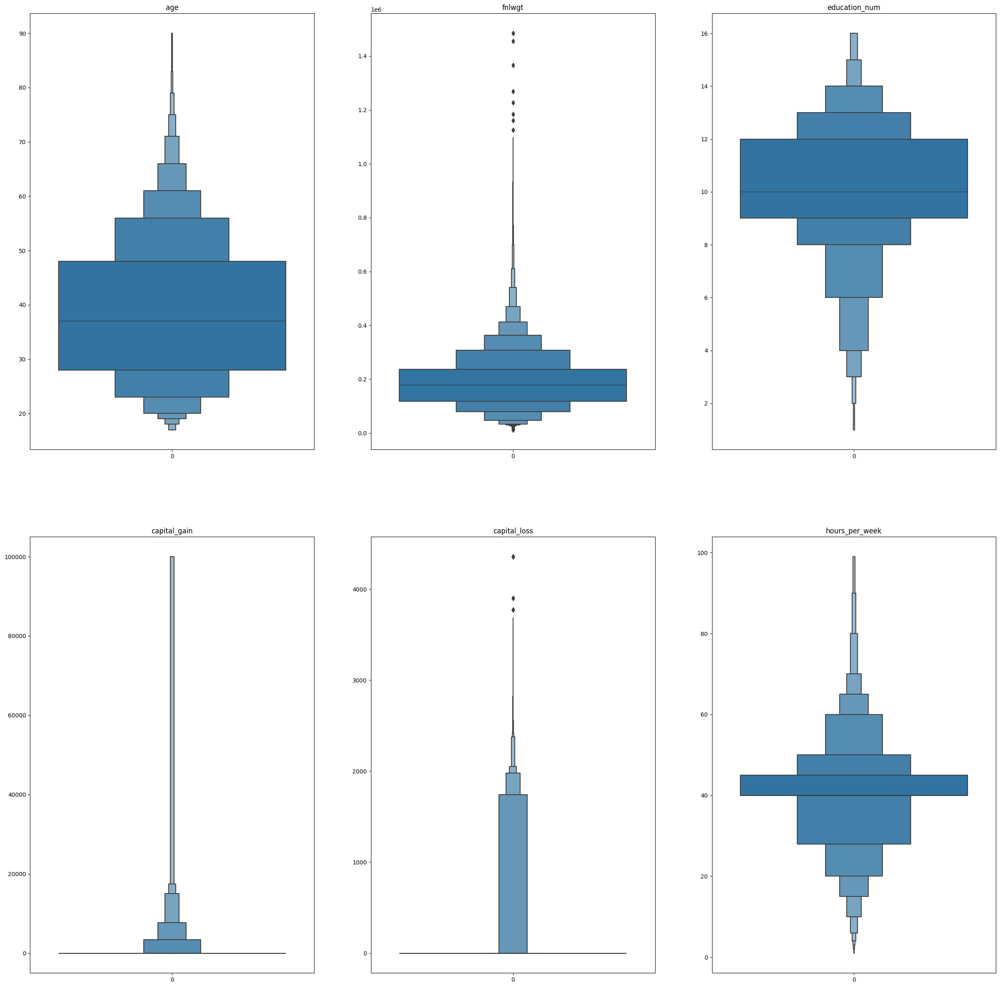

In [32]:
fig, axes = plt.subplots(nrows = 2, ncols = 3)    # axes is 2d array (3x3) since 36 numerical columns
axes = axes.flatten()         # Convert axes to 1d array of length 9
fig.set_size_inches(30,30)

# cols=list(df_train.select_dtypes(include= np.number).columns)
for ax, col in zip(axes, numerical_columns):
    print()
    sns.boxenplot(df_train[col], ax = ax)
    ax.set_title(col)

### 5. Next step is to see the density 

In [33]:
range(len(df_train))

range(0, 32561)

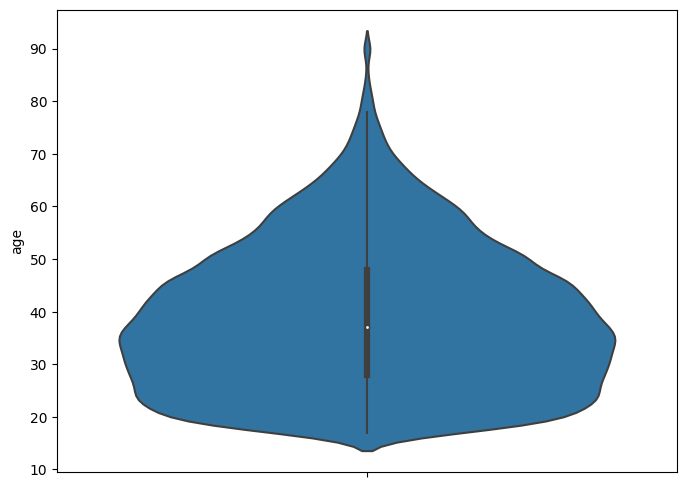

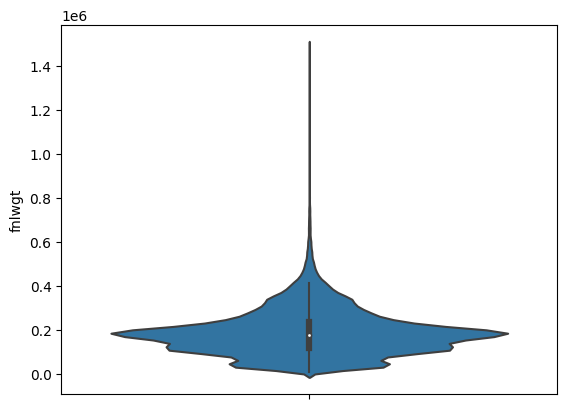

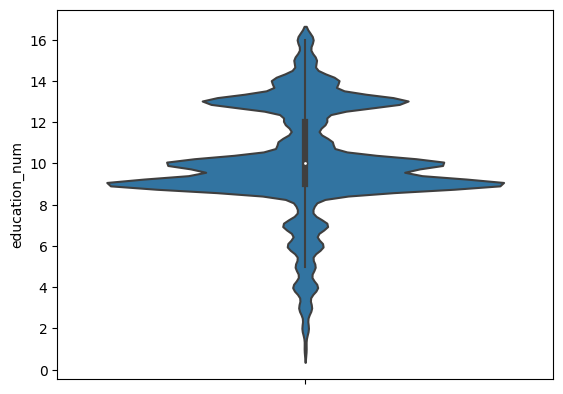

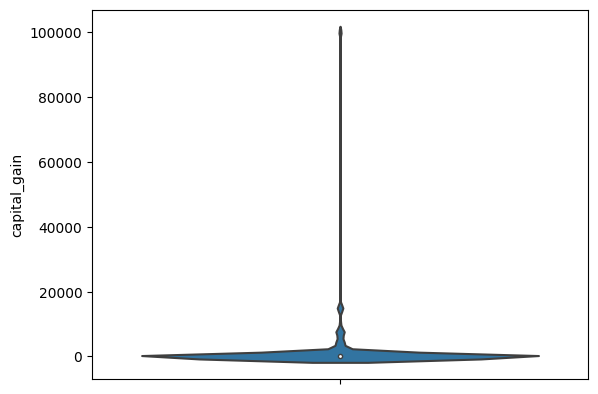

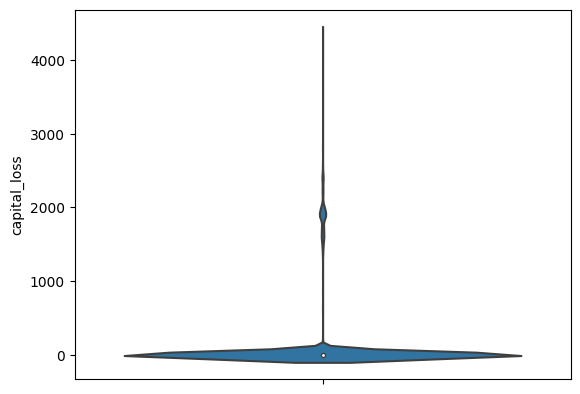

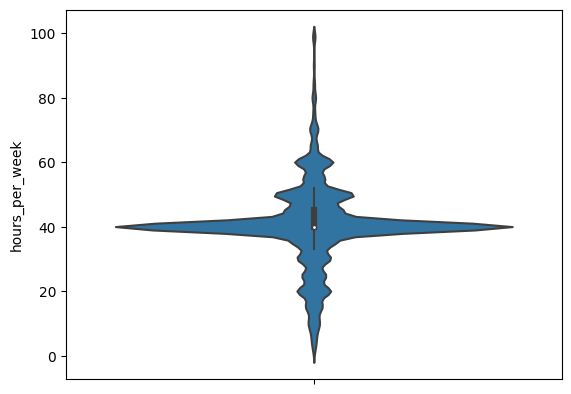

In [34]:
l=[]
for i in range(len(df_train)):
    l.append(i)
# Plot a violin plot for numerical vs categorical
plt.figure(figsize=(8, 6))
for col in numerical_columns:
    sns.violinplot(y=df_train[col])
    plt.show()


### 6. Next step is to see the distribution plot

/tmp/ipykernel_78/1690995412.py:8: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_train[col], ax = ax)
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


/tmp/ipykernel_78/1690995412.py:8: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_train[col], ax = ax)
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


/tmp/ipykernel_78/1690995412.py:8: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_train[col], ax = ax)
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


/tmp/ipykernel_78/1690995412.py:8: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_train[col], ax = ax)
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


/tmp/ipykernel_78/1690995412.py:8: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_train[col], ax = ax)
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


/tmp/ipykernel_78/1690995412.py:8: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_train[col], ax = ax)
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


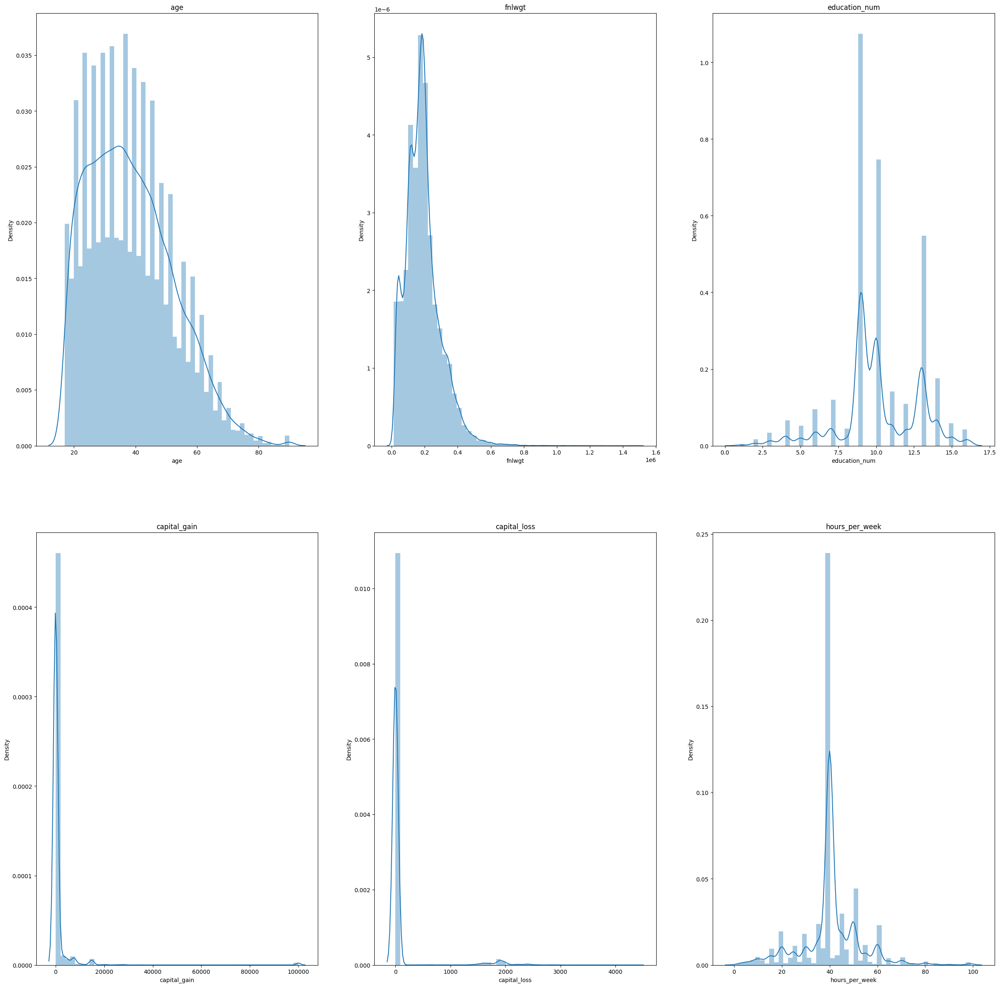

In [35]:
fig, axes = plt.subplots(nrows = 2, ncols = 3)    # axes is 2d array (3x3) since 36 numerical columns
axes = axes.flatten()         # Convert axes to 1d array of length 9
fig.set_size_inches(30,30)

# cols=list(df_train.select_dtypes(include= np.number).columns)
for ax, col in zip(axes, numerical_columns):
    print()
    sns.distplot(df_train[col], ax = ax)
    ax.set_title(col)

### 7. To get more clearity we also see the skewness in each of the numerical column 

In [36]:
for col in numerical_columns:
    print(f" {df_train[col].skew() } in {col}")

 0.5587433694130484 in age
 1.4469800945789826 in fnlwgt
 -0.3116758679102297 in education_num
 11.953847687699799 in capital_gain
 4.594629121679692 in capital_loss
 0.22764253680450092 in hours_per_week


### 8. Next we see the count plot of each category i.e. basically the countplot

In [37]:
len(categorical_columns)

8

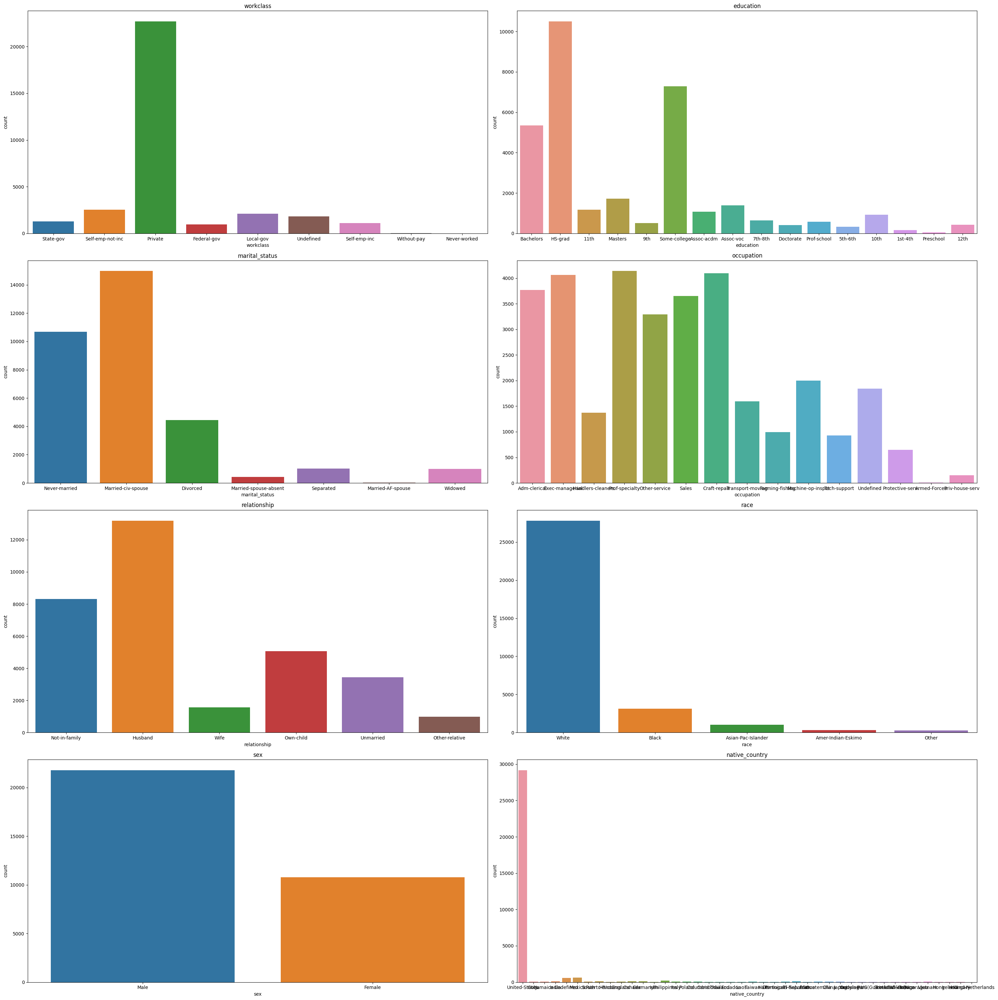

In [38]:
fig, axes = plt.subplots(nrows=4, ncols=2)  # Create subplots
axes = axes.flatten()  # Flatten the axes array to handle individual plots
fig.set_size_inches(30, 30)  # Set the figure size

for ax, col in zip(axes, categorical_columns):
    sns.countplot(x=col, data=df_train, ax=ax)  # Use x=col to specify the column
    ax.set_title(col)

plt.tight_layout()  # Adjust layout for better spacing
plt.show()

Text(0.5, 1.0, 'Count of categories in the label')

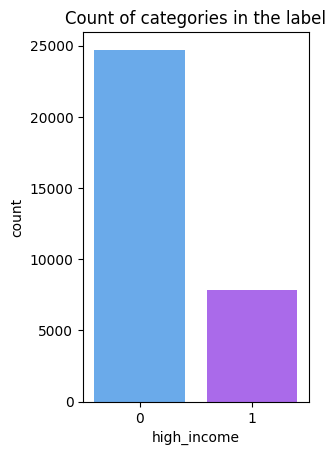

In [39]:
plt.subplot(1,2,1)
sns.countplot(x = 'high_income' , palette= 'cool', data= output_col) 
plt.title("Count of categories in the label")

### 9. See the redundant values in a column

In [40]:
df_train[numerical_columns].describe(percentiles = [.25,.5,.75,.95,.97,.99])  

,age,fnlwgt,education_num,capital_gain,capital_loss,hours_per_week
count,32561.000000,3.256100e+04,32561.000000,32561.000000,32561.000000,32561.000000
mean,38.581647,1.897784e+05,10.080679,1077.648844,87.303830,40.437456
std,13.640433,1.055500e+05,2.572720,7385.292085,402.960219,12.347429
min,17.000000,1.228500e+04,1.000000,0.000000,0.000000,1.000000
25%,28.000000,1.178270e+05,9.000000,0.000000,0.000000,40.000000
50%,37.000000,1.783560e+05,10.000000,0.000000,0.000000,40.000000
75%,48.000000,2.370510e+05,12.000000,0.000000,0.000000,45.000000
95%,63.000000,3.796820e+05,14.000000,5013.000000,0.000000,60.000000
97%,67.000000,4.168904e+05,15.000000,7688.000000,1848.000000,65.000000
99%,74.000000,5.100720e+05,16.000000,15024.000000,1980.000000,80.000000


## Modification on the basis of EDA

In [41]:
categorical_cols=df_train.select_dtypes(exclude=np.number).columns
numerical_cols=df_train.select_dtypes(include=np.number).columns
numerical_cols

Index(['age', 'fnlwgt', 'education_num', 'capital_gain', 'capital_loss',
       'hours_per_week'],
      dtype='object')

In [42]:
categorical_cols

Index(['workclass', 'education', 'marital_status', 'occupation',
       'relationship', 'race', 'sex', 'native_country'],
      dtype='object')

### 1.Apropriation

### 2. NULL values

### 3. Removing the most correlated column

In [43]:
df_train.drop(['age','hours_per_week'],axis=1,inplace=True)

In [44]:
calc_vif(df_train.select_dtypes(include=np.number))

,Variables,VIF
0,fnlwgt,3.432454
1,education_num,3.547361
2,capital_gain,1.032406
3,capital_loss,1.055069


### 4. Remove the outliers 

In [45]:
output_col.value_counts()

high_income
0              24720
1               7841
Name: count, dtype: int64

In [46]:
cols=df_train.select_dtypes(include=np.number).columns
for col in cols:
    print(f"Median in {col} col is:")
    print(df_train[col].median())
    print()

Median in fnlwgt col is:
178356.0

Median in education_num col is:
10.0

Median in capital_gain col is:
0.0

Median in capital_loss col is:
0.0



In [47]:
# Outlier imputing by median
cols=df_train.select_dtypes(include=np.number).columns


for col in cols:
    q1=df_train[col].quantile(0.25)
    q3=df_train[col].quantile(0.75)
    iqr=q3-q1
    l=q1-1.5*iqr
    h=q3+1.5*iqr
    print("[",l,",",h,"]")
    mode_value=df_train[col].mode().values[0]

        
    df_train[col] = np.where((df_train[col] < l) | (df_train[col] > h), mode_value, df_train[col])



[ -61009.0 , 415887.0 ]
[ 4.5 , 16.5 ]
[ 0.0 , 0.0 ]
[ 0.0 , 0.0 ]


In [48]:
df_train

,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,native_country
0,State-gov,77516.0,Bachelors,13.0,Never-married,Adm-clerical,Not-in-family,White,Male,0.0,0.0,United-States
1,Self-emp-not-inc,83311.0,Bachelors,13.0,Married-civ-spouse,Exec-managerial,Husband,White,Male,0.0,0.0,United-States
2,Private,215646.0,HS-grad,9.0,Divorced,Handlers-cleaners,Not-in-family,White,Male,0.0,0.0,United-States
3,Private,234721.0,11th,7.0,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0.0,0.0,United-States
4,Private,338409.0,Bachelors,13.0,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0.0,0.0,Cuba
...,...,...,...,...,...,...,...,...,...,...,...,...
32556,Private,257302.0,Assoc-acdm,12.0,Married-civ-spouse,Tech-support,Wife,White,Female,0.0,0.0,United-States
32557,Private,154374.0,HS-grad,9.0,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0.0,0.0,United-States
32558,Private,151910.0,HS-grad,9.0,Widowed,Adm-clerical,Unmarried,White,Female,0.0,0.0,United-States
32559,Private,201490.0,HS-grad,9.0,Never-married,Adm-clerical,Own-child,White,Male,0.0,0.0,United-States


In [49]:
np.unique(output_col)

array([0, 1])

/tmp/ipykernel_78/2928899459.py:8: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_train[col], ax = ax)
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


/tmp/ipykernel_78/2928899459.py:8: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_train[col], ax = ax)
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


/tmp/ipykernel_78/2928899459.py:8: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_train[col], ax = ax)
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.11/dist-packages/seaborn/distributions.py:2511: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  kdeplot(**{axis: a}, ax=ax, color=kde_color, **kde_kws)


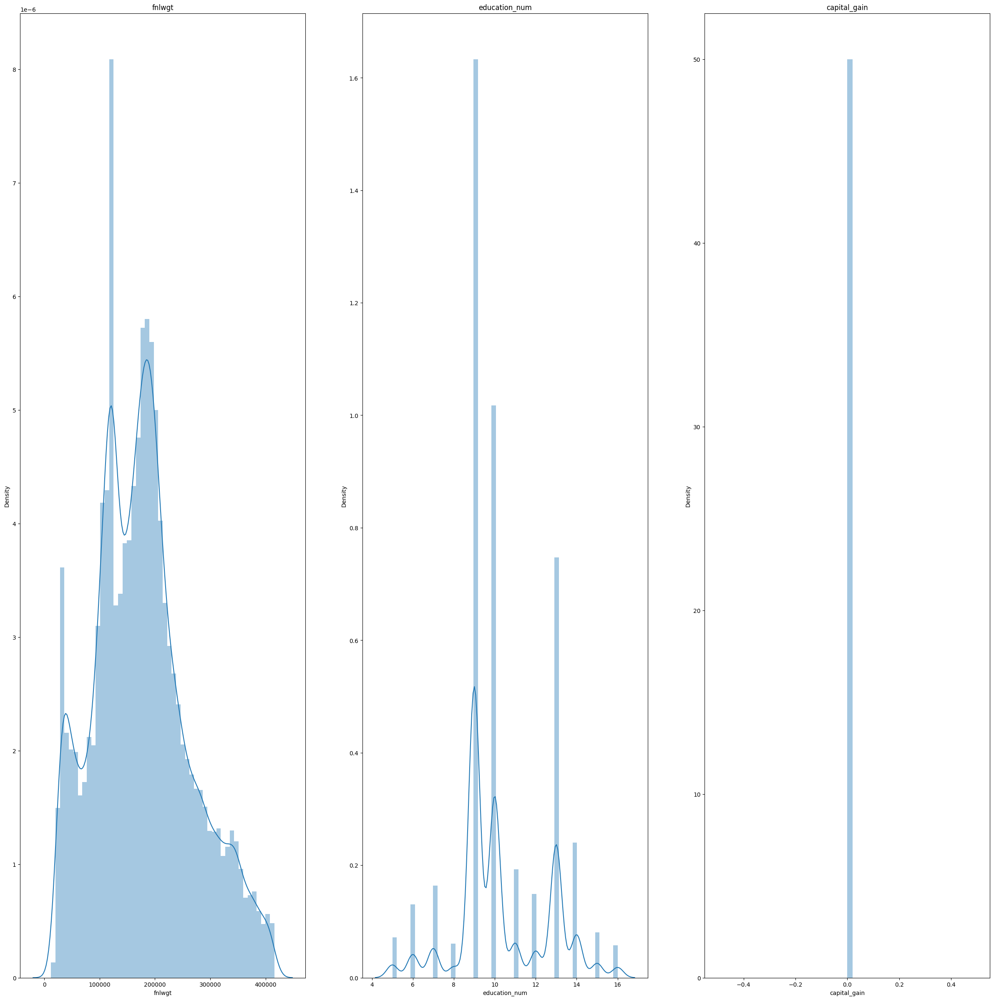

In [50]:
fig, axes = plt.subplots(nrows = 1, ncols = 3)    # axes is 2d array (3x3) since 36 numerical columns
axes = axes.flatten()         # Convert axes to 1d array of length 9
fig.set_size_inches(30,30)

cols=list(df_train.select_dtypes(include= np.number).columns)
for ax, col in zip(axes, cols):
    print()
    sns.distplot(df_train[col], ax = ax)
    ax.set_title(col)

In [51]:
cols=list(df_train.select_dtypes(include= np.number).columns)
for col in cols:
    print(f" {df_train[col].skew() } in {col}")

 0.46122083523202373 in fnlwgt
 0.32629709399621976 in education_num
 0.0 in capital_gain
 0.0 in capital_loss


### 5. Describe 

In [52]:
df_train.describe(percentiles = [.25,.5,.75,.95,.97,.99])

,fnlwgt,education_num,capital_gain,capital_loss
count,32561.000000,32561.000000,32561.0,32561.0
mean,177906.349836,10.289887,0.0,0.0
std,86577.089111,2.214876,0.0,0.0
min,12285.000000,5.000000,0.0,0.0
25%,117827.000000,9.000000,0.0,0.0
50%,173674.000000,10.000000,0.0,0.0
75%,226196.000000,12.000000,0.0,0.0
95%,344624.000000,14.000000,0.0,0.0
97%,365988.000000,15.000000,0.0,0.0
99%,396668.600000,16.000000,0.0,0.0


In [53]:
df_train.drop(["capital_gain","capital_loss"],axis=1,inplace=True)

## Scaling

In [54]:
df_train.describe()

,fnlwgt,education_num
count,32561.000000,32561.000000
mean,177906.349836,10.289887
std,86577.089111,2.214876
min,12285.000000,5.000000
25%,117827.000000,9.000000
50%,173674.000000,10.000000
75%,226196.000000,12.000000
max,415847.000000,16.000000


In [55]:
scaling=StandardScaler()
scaling.fit_transform(df_train.loc[:,["fnlwgt","education_num"]])

array([[-1.15956649,  1.22361491],
       [-1.0926309 ,  1.22361491],
       [ 0.43591474, -0.58238323],
       ...,
       [-0.30027285, -0.58238323],
       [ 0.27240477, -0.58238323],
       [ 1.27080202, -0.58238323]])

In [56]:
df_train["fnlwgt"]=list(scaling.fit_transform(df_train.loc[:,["fnlwgt","education_num"]])[:,0])
df_train["education_num"]=list(scaling.fit_transform(df_train.loc[:,["fnlwgt","education_num"]])[:,1])
df_train.describe()

,fnlwgt,education_num
count,3.256100e+04,3.256100e+04
mean,-1.669375e-16,-1.625731e-16
std,1.000015e+00,1.000015e+00
min,-1.913022e+00,-2.388381e+00
25%,-6.939512e-01,-5.823832e-01
50%,-4.888608e-02,-1.308837e-01
75%,5.577733e-01,7.721154e-01
max,2.748352e+00,2.578114e+00


## Encoding

In [57]:
def encoding_categorical_cols(df_train:pd.DataFrame,categorical_columns:list,strategy:str):
    df_categorical=pd.DataFrame(df_train.loc[:,categorical_columns])
    if strategy=="labelencoder":
        for col in list(df_categorical.columns):
            cat=[]
            d={}

            cat.append([df_categorical[col].value_counts().index,len(df_categorical[col].value_counts().index)])

            for j in range(int(cat[0][1])):
                d[str(cat[0][0][j])]=j
            df_categorical[col]=df_categorical[col].map(d)
        df_train.drop(categorical_columns,axis=1,inplace=True)
        
        df_train=pd.concat([df_train,df_categorical],axis=1)
        
    if strategy=="onehotencoder":
        one_hot_encoded=pd.get_dummies(df_categorical)
        # print(one_hot_encoded)
        df_train.drop(categorical_columns,axis=1,inplace=True)
        df_train=pd.concat([df_train,one_hot_encoded],axis=1)
    return df_train

In [58]:
categorical_cols=df_train.select_dtypes(exclude=np.number).columns
numerical_cols=df_train.select_dtypes(include=np.number).columns
df_train=encoding_categorical_cols(df_train=df_train,categorical_columns=categorical_columns,strategy="onehotencoder")

In [59]:
df_train

,fnlwgt,education_num,workclass_Federal-gov,workclass_Local-gov,workclass_Never-worked,workclass_Private,workclass_Self-emp-inc,workclass_Self-emp-not-inc,workclass_State-gov,workclass_Undefined,...,native_country_Puerto-Rico,native_country_Scotland,native_country_South,native_country_Taiwan,native_country_Thailand,native_country_Trinadad&Tobago,native_country_Undefined,native_country_United-States,native_country_Vietnam,native_country_Yugoslavia
0,-1.159566,1.223615,False,False,False,False,False,False,True,False,...,False,False,False,False,False,False,False,True,False,False
1,-1.092631,1.223615,False,False,False,False,False,True,False,False,...,False,False,False,False,False,False,False,True,False,False
2,0.435915,-0.582383,False,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,True,False,False
3,0.656242,-1.485382,False,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,True,False,False
4,1.853898,1.223615,False,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,0.917066,0.772115,False,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,True,False,False
32557,-0.271812,-0.582383,False,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,True,False,False
32558,-0.300273,-0.582383,False,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,True,False,False
32559,0.272405,-0.582383,False,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,True,False,False


In [60]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32561 entries, 0 to 32560
Columns: 104 entries, fnlwgt to native_country_Yugoslavia
dtypes: bool(102), float64(2)
memory usage: 3.7 MB


In [61]:
output_col

,high_income
0,0
1,0
2,0
3,0
4,0
...,...
32556,0
32557,1
32558,0
32559,0


## Making Model

In [62]:
X=df_train
Y=output_col


In [63]:
X.describe()

,fnlwgt,education_num
count,3.256100e+04,3.256100e+04
mean,-1.669375e-16,-1.625731e-16
std,1.000015e+00,1.000015e+00
min,-1.913022e+00,-2.388381e+00
25%,-6.939512e-01,-5.823832e-01
50%,-4.888608e-02,-1.308837e-01
75%,5.577733e-01,7.721154e-01
max,2.748352e+00,2.578114e+00


In [64]:
np.unique(output_col)

array([0, 1])

In [65]:
X_train,X_test,Y_train,Y_test=train_test_split(X,Y,test_size=0.33,random_state=42)

In [66]:
X_train

,fnlwgt,education_num,workclass_Federal-gov,workclass_Local-gov,workclass_Never-worked,workclass_Private,workclass_Self-emp-inc,workclass_Self-emp-not-inc,workclass_State-gov,workclass_Undefined,...,native_country_Puerto-Rico,native_country_Scotland,native_country_South,native_country_Taiwan,native_country_Thailand,native_country_Trinadad&Tobago,native_country_Undefined,native_country_United-States,native_country_Vietnam,native_country_Yugoslavia
27585,-0.629245,1.675114,False,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,True,False,False
18010,-0.339787,-0.582383,False,False,False,False,False,False,False,True,...,False,False,False,False,False,False,False,False,False,False
22472,1.034061,1.223615,False,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,True,False,False
4585,-1.626533,0.772115,False,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,True,False,False
11191,-0.732854,1.675114,False,True,False,False,False,False,False,False,...,False,False,False,False,False,False,False,True,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29802,2.097061,1.223615,False,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,True,False,False
5390,-0.354503,-1.033883,False,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,True,False,False
860,0.443284,-1.485382,False,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,True,False,False
15795,-1.428175,-0.582383,False,False,False,False,False,True,False,False,...,False,False,False,False,False,False,False,True,False,False


## RandomSearch CV

First we will narrow down our area of search using randomsearchcv then use gridsearch to get the optimal answer


In [70]:
final_accuracies=defaultdict(dict)
acuracies=defaultdict(dict)

In [71]:
def hyperparameter_tuning(algo:str,param_grid:dict,n_iter:int,cv:int,verbose:int,random_state:int,X_train,Y_train,X_test,Y_test,evaluation_metric:str):
    model=eval(algo)
    evaluation_metric=eval(evaluation_metric)
    
    model_random_cv=RandomizedSearchCV(estimator=model,param_distributions=param_grid,n_iter=n_iter,cv=cv,verbose=verbose,random_state=random_state,scoring='accuracy')
    model_random_cv.fit(X_train,Y_train)
    best_params_=model_random_cv.best_params_
    acuracies[algo]['RandomCV Best Params']=best_params_
    print(f"{model} RandomCV Best Params :",best_params_)
    
    best_random_grid=model_random_cv.best_estimator_
    y_pred=best_random_grid.predict(X_test)
    
    score=evaluation_metric(Y_test,y_pred)
    print(f"{model} RandomCV Score:",score)
    
    
    
    param_grid=defaultdict(list)
    for val in best_params_:
        param_grid[val].append(best_params_[val])
    
    
    model_for_gcv=eval(algo)
    
    grid_search=GridSearchCV(estimator=model_for_gcv,param_grid=param_grid,cv=cv,n_jobs=-1,verbose=verbose)
    grid_search.fit(X_train,Y_train)
    best_grid2=grid_search.best_estimator_
    acuracies[algo]['GridSearchCV Best Params']=best_params_
    print(grid_search.best_params_)
    y_pred2=best_grid2.predict(X_test)
    score_1=evaluation_metric(Y_test,y_pred2)
    print("Final score is ",score_1)
    final_accuracies[algo]["Test Accuracy"]=score_1
    
    
   

In [72]:
# On Logistic Regression



random_grid = {
    'solver': ['newton-cg', 'lbfgs', 'liblinear'],
    'penalty': ['none', 'l1', 'l2', 'elasticnet'],
    'C': loguniform(1e-5, 100),
    'max_iter': list(range(1000, 4000, 100)),
    'tol': loguniform(1e-5, 1e-1),
    'class_weight': ['balanced', 'auto', None],
    'warm_start': [True, False],
    'n_jobs': [-1, 1, 2, 4, 8]}
print(random_grid)

{'solver': ['newton-cg', 'lbfgs', 'liblinear'], 'penalty': ['none', 'l1', 'l2', 'elasticnet'], 'C': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x7fc4040cc6d0>, 'max_iter': [1000, 1100, 1200, 1300, 1400, 1500, 1600, 1700, 1800, 1900, 2000, 2100, 2200, 2300, 2400, 2500, 2600, 2700, 2800, 2900, 3000, 3100, 3200, 3300, 3400, 3500, 3600, 3700, 3800, 3900], 'tol': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x7fc4040db9d0>, 'class_weight': ['balanced', 'auto', None], 'warm_start': [True, False], 'n_jobs': [-1, 1, 2, 4, 8]}


In [73]:
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

hyperparameter_tuning(algo="LogisticRegression()",param_grid=random_grid,n_iter=100,cv=cv,verbose=3,random_state=42,X_train=X_train,Y_train=Y_train,X_test=X_test,Y_test=Y_test,evaluation_metric="accuracy_score")

Fitting 30 folds for each of 100 candidates, totalling 3000 fits
[CV 1/30] END C=0.004185822729546971, class_weight=balanced, max_iter=2400, n_jobs=2, penalty=elasticnet, solver=newton-cg, tol=0.0024400607090817534, warm_start=False;, score=nan total time=   0.0s
[CV 2/30] END C=0.004185822729546971, class_weight=balanced, max_iter=2400, n_jobs=2, penalty=elasticnet, solver=newton-cg, tol=0.0024400607090817534, warm_start=False;, score=nan total time=   0.0s
[CV 3/30] END C=0.004185822729546971, class_weight=balanced, max_iter=2400, n_jobs=2, penalty=elasticnet, solver=newton-cg, tol=0.0024400607090817534, warm_start=False;, score=nan total time=   0.0s
[CV 4/30] END C=0.004185822729546971, class_weight=balanced, max_iter=2400, n_jobs=2, penalty=elasticnet, solver=newton-cg, tol=0.0024400607090817534, warm_start=False;, score=nan total time=   0.0s
[CV 5/30] END C=0.004185822729546971, class_weight=balanced, max_iter=2400, n_jobs=2, penalty=elasticnet, solver=newton-cg, tol=0.002440060

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 2/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.778 total time=   0.1s
[CV 3/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.785 total time=   0.1s
[CV 4/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.795 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 5/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.776 total time=   0.1s
[CV 6/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.774 total time=   0.1s
[CV 7/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.771 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 8/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.784 total time=   0.1s
[CV 9/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.769 total time=   0.1s
[CV 10/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.761 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 11/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.769 total time=   0.1s
[CV 12/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.780 total time=   0.1s
[CV 13/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.781 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 14/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.768 total time=   0.1s
[CV 15/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.766 total time=   0.1s
[CV 16/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.791 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 17/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.776 total time=   0.1s
[CV 18/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.774 total time=   0.1s
[CV 19/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.761 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 20/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.777 total time=   0.1s
[CV 21/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.773 total time=   0.1s
[CV 22/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.780 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 23/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.784 total time=   0.1s
[CV 24/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.762 total time=   0.1s
[CV 25/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.774 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 26/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.773 total time=   0.1s
[CV 27/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.776 total time=   0.1s
[CV 28/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.775 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 29/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.774 total time=   0.1s
[CV 30/30] END C=0.047129737561107825, class_weight=balanced, max_iter=2600, n_jobs=2, penalty=l2, solver=liblinear, tol=3.613894271216525e-05, warm_start=False;, score=0.773 total time=   0.1s
[CV 1/30] END C=65.5071389539206, class_weight=None, max_iter=3900, n_jobs=2, penalty=elasticnet, solver=liblinear, tol=0.08568869785189001, warm_start=True;, score=nan total time=   0.0s
[CV 2/30] END C=65.5071389539206, class_weight=None, max_iter=3900, n_jobs=2, penalty=elasticnet, solver=liblinear, tol=0.08568869785189001, warm_start=True;, score=nan total time=   0.0s
[CV 3/30] END C=65.5071389539206, class_weight=None, max_iter=3900, n_jobs=2, penalty=elasticnet, solver=liblinear, tol=0.08568869785189001, warm_start=True;, score=nan total time=   0.0s
[CV 4/30] END C=65.5071389539206, class_weight=N

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.757 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.758 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.758 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.758 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.758 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.757 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.758 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.758 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.758 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.758 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.758 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.758 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.758 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.758 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END C=1.2547544916583986e-05, class_weight=None, max_iter=2600, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.002653627132902633, warm_start=False;, score=0.757 total time=   0.3s
[CV 1/30] END C=0.003230428252240959, class_weight=balanced, max_iter=3700, n_jobs=-1, penalty=elasticnet, solver=lbfgs, tol=2.407911195464456e-05, warm_start=True;, score=nan total time=   0.0s
[CV 2/30] END C=0.003230428252240959, class_weight=balanced, max_iter=3700, n_jobs=-1, penalty=elasticnet, solver=lbfgs, tol=2.407911195464456e-05, warm_start=True;, score=nan total time=   0.0s
[CV 3/30] END C=0.003230428252240959, class_weight=balanced, max_iter=3700, n_jobs=-1, penalty=elasticnet, solver=lbfgs, tol=2.407911195464456e-05, warm_start=True;, score=nan total time=   0.0s
[CV 4/30] END C=0.003230428252240959, class_weight=balanced, max_iter=3700, n_jobs=-1, penalty=elasticnet, solver=lbfgs, tol=2.407911195464456e-05, warm_start=True;, score=nan total time=   0.0s
[CV 5/30] END C=0.00323042825

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.822 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.838 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.836 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.837 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.829 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.837 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.837 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.829 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.826 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.830 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.819 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.833 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.841 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.824 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.837 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.837 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.835 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.835 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.824 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.830 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.827 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.829 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.831 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.833 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.827 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.840 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.834 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.832 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.831 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END C=0.0047916834883246695, class_weight=None, max_iter=2300, n_jobs=2, penalty=none, solver=newton-cg, tol=0.0017583640270008513, warm_start=True;, score=0.834 total time=   1.4s
[CV 1/30] END C=0.000620123599647907, class_weight=None, max_iter=1800, n_jobs=1, penalty=l1, solver=newton-cg, tol=6.410277188110155e-05, warm_start=False;, score=nan total time=   0.0s
[CV 2/30] END C=0.000620123599647907, class_weight=None, max_iter=1800, n_jobs=1, penalty=l1, solver=newton-cg, tol=6.410277188110155e-05, warm_start=False;, score=nan total time=   0.0s
[CV 3/30] END C=0.000620123599647907, class_weight=None, max_iter=1800, n_jobs=1, penalty=l1, solver=newton-cg, tol=6.410277188110155e-05, warm_start=False;, score=nan total time=   0.0s
[CV 4/30] END C=0.000620123599647907, class_weight=None, max_iter=1800, n_jobs=1, penalty=l1, solver=newton-cg, tol=6.410277188110155e-05, warm_start=False;, score=nan total time=   0.0s
[CV 5/30] END C=0.000620123599647907, class_weight=None, max

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 2/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.778 total time=   0.1s
[CV 3/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.790 total time=   0.1s
[CV 4/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.797 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 5/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.777 total time=   0.1s
[CV 6/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.780 total time=   0.1s
[CV 7/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.771 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 8/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.788 total time=   0.1s
[CV 9/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.772 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 10/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.765 total time=   0.1s
[CV 11/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.774 total time=   0.1s
[CV 12/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.779 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 13/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.782 total time=   0.1s
[CV 14/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.771 total time=   0.1s
[CV 15/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.773 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 16/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.796 total time=   0.1s
[CV 17/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.778 total time=   0.1s
[CV 18/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.776 total time=   0.1s
[CV 19/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.760 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 20/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.782 total time=   0.1s
[CV 21/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.777 total time=   0.1s
[CV 22/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.780 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 23/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.784 total time=   0.1s
[CV 24/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.767 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 25/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.777 total time=   0.1s
[CV 26/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.773 total time=   0.1s
[CV 27/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.781 total time=   0.1s
[CV 28/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.776 total time=   0.1s
[CV 29/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.774 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 30/30] END C=0.2850183875843368, class_weight=balanced, max_iter=1300, n_jobs=8, penalty=l2, solver=liblinear, tol=0.00043805807679056546, warm_start=True;, score=0.773 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.715 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.749 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.745 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.751 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.750 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.737 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.741 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.752 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.729 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.723 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.731 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.749 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.736 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.734 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.737 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.753 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.753 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.736 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.723 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.739 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.727 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.741 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.739 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.724 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.739 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.735 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.750 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.750 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.736 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END C=0.00026389342706135933, class_weight=balanced, max_iter=1600, n_jobs=2, penalty=l2, solver=lbfgs, tol=0.033256102959751885, warm_start=False;, score=0.746 total time=   1.1s
[CV 1/30] END C=4.537771853157071, class_weight=balanced, max_iter=3000, n_jobs=4, penalty=elasticnet, solver=lbfgs, tol=0.03412880136122728, warm_start=False;, score=nan total time=   0.0s
[CV 2/30] END C=4.537771853157071, class_weight=balanced, max_iter=3000, n_jobs=4, penalty=elasticnet, solver=lbfgs, tol=0.03412880136122728, warm_start=False;, score=nan total time=   0.0s
[CV 3/30] END C=4.537771853157071, class_weight=balanced, max_iter=3000, n_jobs=4, penalty=elasticnet, solver=lbfgs, tol=0.03412880136122728, warm_start=False;, score=nan total time=   0.0s
[CV 4/30] END C=4.537771853157071, class_weight=balanced, max_iter=3000, n_jobs=4, penalty=elasticnet, solver=lbfgs, tol=0.03412880136122728, warm_start=False;, score=nan total time=   0.0s
[CV 5/30] END C=4.537771853157071, class_weight=b

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.758 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.776 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.790 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.796 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.780 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.779 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.773 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.788 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.773 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.765 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.774 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.779 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.785 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.769 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.775 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.796 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.779 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.779 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.761 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.781 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.780 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.781 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.783 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.769 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.778 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.775 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.780 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.779 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.773 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END C=4.488291820002605, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.003897269889874577, warm_start=True;, score=0.774 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.758 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.776 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.790 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.796 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.780 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.779 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.773 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.788 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.773 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.765 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.774 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.779 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.785 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.769 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.775 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.796 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.779 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.778 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.761 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.781 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.780 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.781 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.783 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.769 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.778 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.775 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.780 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.779 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.774 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END C=5.322349153329202, class_weight=balanced, max_iter=1200, n_jobs=2, penalty=none, solver=lbfgs, tol=7.734482156646794e-05, warm_start=True;, score=0.774 total time=   2.3s
[CV 1/30] END C=0.0007689291700576298, class_weight=None, max_iter=3600, n_jobs=-1, penalty=elasticnet, solver=newton-cg, tol=1.8178958090803936e-05, warm_start=False;, score=nan total time=   0.0s
[CV 2/30] END C=0.0007689291700576298, class_weight=None, max_iter=3600, n_jobs=-1, penalty=elasticnet, solver=newton-cg, tol=1.8178958090803936e-05, warm_start=False;, score=nan total time=   0.0s
[CV 3/30] END C=0.0007689291700576298, class_weight=None, max_iter=3600, n_jobs=-1, penalty=elasticnet, solver=newton-cg, tol=1.8178958090803936e-05, warm_start=False;, score=nan total time=   0.0s
[CV 4/30] END C=0.0007689291700576298, class_weight=None, max_iter=3600, n_jobs=-1, penalty=elasticnet, solver=newton-cg, tol=1.8178958090803936e-05, warm_start=False;, score=nan total time=   0.0s
[CV 5/30] END C=0.00

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.822 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.838 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.836 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.837 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.829 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.837 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.837 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.829 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.826 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.829 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.819 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.833 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.841 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.824 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.837 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.837 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.835 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.835 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.824 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.830 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.828 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.829 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.831 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.833 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.827 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.840 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.834 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.832 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.831 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END C=22.796134031070487, class_weight=None, max_iter=3900, n_jobs=1, penalty=none, solver=lbfgs, tol=0.0876197110102369, warm_start=False;, score=0.834 total time=   1.2s
[CV 1/30] END C=0.14088899368893812, class_weight=None, max_iter=2000, n_jobs=2, penalty=none, solver=liblinear, tol=0.016313946190943736, warm_start=True;, score=nan total time=   0.0s
[CV 2/30] END C=0.14088899368893812, class_weight=None, max_iter=2000, n_jobs=2, penalty=none, solver=liblinear, tol=0.016313946190943736, warm_start=True;, score=nan total time=   0.0s
[CV 3/30] END C=0.14088899368893812, class_weight=None, max_iter=2000, n_jobs=2, penalty=none, solver=liblinear, tol=0.016313946190943736, warm_start=True;, score=nan total time=   0.0s
[CV 4/30] END C=0.14088899368893812, class_weight=None, max_iter=2000, n_jobs=2, penalty=none, solver=liblinear, tol=0.016313946190943736, warm_start=True;, score=nan total time=   0.0s
[CV 5/30] END C=0.14088899368893812, class_weight=None, max_iter=2000, n_

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.822 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.838 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.836 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.837 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.829 total time=   3.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.837 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.837 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.829 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.826 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.830 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.819 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.833 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.841 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.824 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.837 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.837 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.835 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.835 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.824 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.830 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.827 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.829 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.831 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.833 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.827 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.840 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.834 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.832 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.831 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END C=0.03842832084916224, class_weight=None, max_iter=2900, n_jobs=4, penalty=none, solver=newton-cg, tol=0.00038930329931910446, warm_start=True;, score=0.834 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.758 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.776 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.790 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.796 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.780 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.779 total time=   3.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.773 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.788 total time=   3.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.773 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.765 total time=   3.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.774 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.779 total time=   3.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.785 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.769 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.775 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.796 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.779 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.779 total time=   3.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.761 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.781 total time=   3.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.780 total time=   3.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.781 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.783 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.769 total time=   3.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.778 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.775 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.780 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.779 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.773 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END C=36.06699180427391, class_weight=balanced, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=6.85940558876205e-05, warm_start=True;, score=0.774 total time=   3.0s
[CV 1/30] END C=13.847630724468166, class_weight=None, max_iter=1600, n_jobs=4, penalty=elasticnet, solver=lbfgs, tol=0.08485420586212647, warm_start=False;, score=nan total time=   0.0s
[CV 2/30] END C=13.847630724468166, class_weight=None, max_iter=1600, n_jobs=4, penalty=elasticnet, solver=lbfgs, tol=0.08485420586212647, warm_start=False;, score=nan total time=   0.0s
[CV 3/30] END C=13.847630724468166, class_weight=None, max_iter=1600, n_jobs=4, penalty=elasticnet, solver=lbfgs, tol=0.08485420586212647, warm_start=False;, score=nan total time=   0.0s
[CV 4/30] END C=13.847630724468166, class_weight=None, max_iter=1600, n_jobs=4, penalty=elasticnet, solver=lbfgs, tol=0.08485420586212647, warm_start=False;, score=nan total time=   0.0s
[CV 5/30] END C=13.847630724468166, class_weight=None, max_it

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.758 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.776 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.790 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.796 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.780 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.779 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.773 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.788 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.773 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.765 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.774 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.779 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.785 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.769 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.775 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.796 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.779 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.779 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.761 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.781 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.780 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.781 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.783 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.769 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.778 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.775 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.780 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.779 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.773 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END C=0.013771111698662625, class_weight=balanced, max_iter=1800, n_jobs=4, penalty=none, solver=newton-cg, tol=0.0009453113247448204, warm_start=False;, score=0.774 total time=   1.9s
[CV 1/30] END C=1.680505103950657, class_weight=None, max_iter=1200, n_jobs=-1, penalty=elasticnet, solver=newton-cg, tol=0.001479656554258492, warm_start=True;, score=nan total time=   0.0s
[CV 2/30] END C=1.680505103950657, class_weight=None, max_iter=1200, n_jobs=-1, penalty=elasticnet, solver=newton-cg, tol=0.001479656554258492, warm_start=True;, score=nan total time=   0.0s
[CV 3/30] END C=1.680505103950657, class_weight=None, max_iter=1200, n_jobs=-1, penalty=elasticnet, solver=newton-cg, tol=0.001479656554258492, warm_start=True;, score=nan total time=   0.0s
[CV 4/30] END C=1.680505103950657, class_weight=None, max_iter=1200, n_jobs=-1, penalty=elasticnet, solver=newton-cg, tol=0.001479656554258492, warm_start=True;, score=nan total time=   0.0s
[CV 5/30] END C=1.680505103950657, class

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.810 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.828 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.832 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.832 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.826 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.826 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.825 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.826 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.821 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.813 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.819 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.822 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.834 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.818 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.830 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.825 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.821 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.823 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.820 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.824 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.823 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.824 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.820 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.816 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.823 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.835 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.829 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.828 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.815 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END C=0.0037498217296518515, class_weight=None, max_iter=3100, n_jobs=8, penalty=l2, solver=lbfgs, tol=0.04211096085003154, warm_start=True;, score=0.826 total time=   1.1s
[CV 1/30] END C=3.6616693499679793, class_weight=auto, max_iter=1000, n_jobs=4, penalty=l2, solver=newton-cg, tol=6.0390962475457836e-05, warm_start=True;, score=nan total time=   0.0s
[CV 2/30] END C=3.6616693499679793, class_weight=auto, max_iter=1000, n_jobs=4, penalty=l2, solver=newton-cg, tol=6.0390962475457836e-05, warm_start=True;, score=nan total time=   0.0s
[CV 3/30] END C=3.6616693499679793, class_weight=auto, max_iter=1000, n_jobs=4, penalty=l2, solver=newton-cg, tol=6.0390962475457836e-05, warm_start=True;, score=nan total time=   0.0s
[CV 4/30] END C=3.6616693499679793, class_weight=auto, max_iter=1000, n_jobs=4, penalty=l2, solver=newton-cg, tol=6.0390962475457836e-05, warm_start=True;, score=nan total time=   0.0s
[CV 5/30] END C=3.6616693499679793, class_weight=auto, max_iter=1000, n_jobs

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.758 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.776 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.790 total time=   3.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.795 total time=   3.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.780 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.779 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.773 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.788 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.773 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.765 total time=   3.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.774 total time=   3.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.779 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.785 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.769 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.775 total time=   3.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.796 total time=   3.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.779 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.779 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.761 total time=   3.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.781 total time=   3.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.780 total time=   3.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.781 total time=   3.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.783 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.769 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.778 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.775 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.781 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.779 total time=   3.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.773 total time=   3.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END C=15.291784034643882, class_weight=balanced, max_iter=1400, n_jobs=8, penalty=none, solver=lbfgs, tol=0.07355619850853308, warm_start=True;, score=0.774 total time=   3.4s
[CV 1/30] END C=72.83180713796125, class_weight=None, max_iter=3800, n_jobs=8, penalty=elasticnet, solver=liblinear, tol=0.00011854941836650536, warm_start=True;, score=nan total time=   0.0s
[CV 2/30] END C=72.83180713796125, class_weight=None, max_iter=3800, n_jobs=8, penalty=elasticnet, solver=liblinear, tol=0.00011854941836650536, warm_start=True;, score=nan total time=   0.0s
[CV 3/30] END C=72.83180713796125, class_weight=None, max_iter=3800, n_jobs=8, penalty=elasticnet, solver=liblinear, tol=0.00011854941836650536, warm_start=True;, score=nan total time=   0.0s
[CV 4/30] END C=72.83180713796125, class_weight=None, max_iter=3800, n_jobs=8, penalty=elasticnet, solver=liblinear, tol=0.00011854941836650536, warm_start=True;, score=nan total time=   0.0s
[CV 5/30] END C=72.83180713796125, class_weig

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 2/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.747 total time=   0.0s
[CV 3/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.741 total time=   0.0s
[CV 4/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.743 total time=   0.1s
[CV 5/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.751 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 6/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.738 total time=   0.0s
[CV 7/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.738 total time=   0.1s
[CV 8/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.745 total time=   0.0s
[CV 9/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.726 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.719 total time=   0.1s
[CV 11/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.729 total time=   0.1s
[CV 12/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.747 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.731 total time=   0.1s
[CV 14/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.731 total time=   0.1s
[CV 15/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.731 total time=   0.0s
[CV 16/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.751 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 17/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.749 total time=   0.1s
[CV 18/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.732 total time=   0.1s
[CV 19/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.718 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 20/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.745 total time=   0.1s
[CV 21/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.725 total time=   0.1s
[CV 22/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.734 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.731 total time=   0.1s
[CV 24/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.722 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.736 total time=   0.2s
[CV 26/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.729 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.745 total time=   0.2s
[CV 28/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.752 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.735 total time=   0.2s
[CV 30/30] END C=0.00015362051856878086, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=2.447405744579684e-05, warm_start=False;, score=0.741 total time=   0.2s
[CV 1/30] END C=0.4988897920294746, class_weight=None, max_iter=1100, n_jobs=2, penalty=l1, solver=lbfgs, tol=0.00019507564742959552, warm_start=False;, score=nan total time=   0.0s
[CV 2/30] END C=0.4988897920294746, class_weight=None, max_iter=1100, n_jobs=2, penalty=l1, solver=lbfgs, tol=0.00019507564742959552, warm_start=False;, score=nan total time=   0.0s
[CV 3/30] END C=0.4988897920294746, class_weight=None, max_iter=1100, n_jobs=2, penalty=l1, solver=lbfgs, tol=0.00019507564742959552, warm_start=False;, score=nan total time=   0.0s
[CV 4/30] END C=0.4988897920294746, class_weight=None, max_iter=1100, 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 1/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.822 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 2/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.836 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 3/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.834 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 4/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.838 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 5/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.825 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 6/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.838 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 7/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.837 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 8/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.828 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 9/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.829 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 10/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.829 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 11/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.823 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 12/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.835 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 13/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.840 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 14/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.824 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 15/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.837 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 16/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.839 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 17/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.834 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 18/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.834 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 19/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.823 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 20/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.833 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 21/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.829 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 22/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.830 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 23/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.827 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 24/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.833 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 25/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.826 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 26/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.840 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 27/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.834 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 28/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.833 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 29/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.831 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 30/30] END C=0.7570249391397498, class_weight=None, max_iter=3100, n_jobs=8, penalty=l1, solver=liblinear, tol=0.0004776650059868054, warm_start=False;, score=0.834 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.759 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.777 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.790 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.796 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.780 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.780 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.773 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.788 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.773 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.765 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.774 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.778 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.786 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.769 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.775 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.796 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.779 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.778 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.761 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.782 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.780 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.781 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.783 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.768 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.778 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.775 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.781 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.779 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.774 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END C=11.735625174123227, class_weight=balanced, max_iter=3700, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0032477131202478396, warm_start=False;, score=0.774 total time=   1.2s
[CV 1/30] END C=0.35460717232584504, class_weight=auto, max_iter=2500, n_jobs=4, penalty=l2, solver=liblinear, tol=1.2896358206357495e-05, warm_start=False;, score=nan total time=   0.0s
[CV 2/30] END C=0.35460717232584504, class_weight=auto, max_iter=2500, n_jobs=4, penalty=l2, solver=liblinear, tol=1.2896358206357495e-05, warm_start=False;, score=nan total time=   0.0s
[CV 3/30] END C=0.35460717232584504, class_weight=auto, max_iter=2500, n_jobs=4, penalty=l2, solver=liblinear, tol=1.2896358206357495e-05, warm_start=False;, score=nan total time=   0.0s
[CV 4/30] END C=0.35460717232584504, class_weight=auto, max_iter=2500, n_jobs=4, penalty=l2, solver=liblinear, tol=1.2896358206357495e-05, warm_start=False;, score=nan total time=   0.0s
[CV 5/30] END C=0.35460717232584504, class_weight=auto, max_

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.822 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.838 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.836 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.838 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.829 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.837 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.837 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.829 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.826 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.830 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.819 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.833 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.841 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.824 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.837 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.837 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.835 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.835 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.824 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.830 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.827 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.829 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.831 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.833 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.827 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.840 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.834 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.832 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.831 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END C=4.548556345064481e-05, class_weight=None, max_iter=3100, n_jobs=2, penalty=none, solver=lbfgs, tol=0.001481080073036349, warm_start=True;, score=0.834 total time=   2.3s
[CV 1/30] END C=7.456491283032305, class_weight=auto, max_iter=3100, n_jobs=-1, penalty=elasticnet, solver=lbfgs, tol=0.01951651378326559, warm_start=False;, score=nan total time=   0.0s
[CV 2/30] END C=7.456491283032305, class_weight=auto, max_iter=3100, n_jobs=-1, penalty=elasticnet, solver=lbfgs, tol=0.01951651378326559, warm_start=False;, score=nan total time=   0.0s
[CV 3/30] END C=7.456491283032305, class_weight=auto, max_iter=3100, n_jobs=-1, penalty=elasticnet, solver=lbfgs, tol=0.01951651378326559, warm_start=False;, score=nan total time=   0.0s
[CV 4/30] END C=7.456491283032305, class_weight=auto, max_iter=3100, n_jobs=-1, penalty=elasticnet, solver=lbfgs, tol=0.01951651378326559, warm_start=False;, score=nan total time=   0.0s
[CV 5/30] END C=7.456491283032305, class_weight=auto, max_iter=31

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 2/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.834 total time=   0.1s
[CV 3/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.836 total time=   0.1s
[CV 4/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.841 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 5/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.827 total time=   0.1s
[CV 6/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.835 total time=   0.1s
[CV 7/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.837 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 8/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.830 total time=   0.1s
[CV 9/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.829 total time=   0.1s
[CV 10/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.831 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 11/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.827 total time=   0.1s
[CV 12/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.834 total time=   0.1s
[CV 13/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.841 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 14/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.821 total time=   0.1s
[CV 15/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.834 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 16/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.838 total time=   0.1s
[CV 17/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.830 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 18/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.835 total time=   0.1s
[CV 19/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.823 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 20/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.832 total time=   0.1s
[CV 21/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.832 total time=   0.1s
[CV 22/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.829 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 23/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.827 total time=   0.1s
[CV 24/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.830 total time=   0.1s
[CV 25/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.825 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 26/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.842 total time=   0.1s
[CV 27/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.838 total time=   0.1s
[CV 28/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.829 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 29/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.832 total time=   0.1s
[CV 30/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.837 total time=   0.1s
[CV 1/30] END C=0.00012898081995403477, class_weight=auto, max_iter=3400, n_jobs=8, penalty=l1, solver=newton-cg, tol=2.380279482363595e-05, warm_start=False;, score=nan total time=   0.0s
[CV 2/30] END C=0.00012898081995403477, class_weight=auto, max_iter=3400, n_jobs=8, penalty=l1, solver=newton-cg, tol=2.380279482363595e-05, warm_start=False;, score=nan total time=   0.0s
[CV 3/30] END C=0.00012898081995403477, class_weight=auto, max_iter=3400, n_jobs=8, penalty=l1, solver=newton-cg, tol=2.380279482363595e-05, warm_start=False;, score=nan total time=   0.0s
[CV 4/30] END C=0.00012898081995403477, class_weight=

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 2/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.772 total time=   0.1s
[CV 3/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.763 total time=   0.1s
[CV 4/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.775 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 5/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.757 total time=   0.1s
[CV 6/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.765 total time=   0.1s
[CV 7/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.756 total time=   0.0s
[CV 8/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.768 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 9/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.751 total time=   0.1s
[CV 10/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.738 total time=   0.0s
[CV 11/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.756 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 12/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.768 total time=   0.1s
[CV 13/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.762 total time=   0.1s
[CV 14/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.756 total time=   0.1s
[CV 15/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.747 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 16/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.770 total time=   0.0s
[CV 17/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.767 total time=   0.1s
[CV 18/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.751 total time=   0.1s
[CV 19/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.740 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 20/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.768 total time=   0.1s
[CV 21/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.755 total time=   0.1s
[CV 22/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.757 total time=   0.1s
[CV 23/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.767 total time=   0.1s
[CV 24/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.746 total time=   0.1s
[CV 25/30] END C=0.005214221588877728, class_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 27/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.761 total time=   0.1s
[CV 28/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.764 total time=   0.1s
[CV 29/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.756 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 30/30] END C=0.005214221588877728, class_weight=balanced, max_iter=1000, n_jobs=8, penalty=l2, solver=liblinear, tol=0.05832560268546887, warm_start=True;, score=0.760 total time=   0.1s
[CV 1/30] END C=5.533347005411901, class_weight=auto, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=7.216996236672743e-05, warm_start=False;, score=nan total time=   0.0s
[CV 2/30] END C=5.533347005411901, class_weight=auto, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=7.216996236672743e-05, warm_start=False;, score=nan total time=   0.0s
[CV 3/30] END C=5.533347005411901, class_weight=auto, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=7.216996236672743e-05, warm_start=False;, score=nan total time=   0.0s
[CV 4/30] END C=5.533347005411901, class_weight=auto, max_iter=2000, n_jobs=4, penalty=none, solver=newton-cg, tol=7.216996236672743e-05, warm_start=False;, score=nan total time=   0.0s
[CV 5/30] END C=5.533347005411901, class_weight=auto, max_iter=20

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.757 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.758 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.758 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.758 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.758 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.758 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.758 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.758 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.758 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.758 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.758 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.758 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.758 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.757 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.757 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END C=1.341382943004567e-05, class_weight=None, max_iter=2700, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.0041965320233494354, warm_start=True;, score=0.757 total time=   0.3s
[CV 1/30] END C=8.205918074565577, class_weight=auto, max_iter=3900, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0009641615699844258, warm_start=False;, score=nan total time=   0.0s
[CV 2/30] END C=8.205918074565577, class_weight=auto, max_iter=3900, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0009641615699844258, warm_start=False;, score=nan total time=   0.0s
[CV 3/30] END C=8.205918074565577, class_weight=auto, max_iter=3900, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0009641615699844258, warm_start=False;, score=nan total time=   0.0s
[CV 4/30] END C=8.205918074565577, class_weight=auto, max_iter=3900, n_jobs=1, penalty=l2, solver=newton-cg, tol=0.0009641615699844258, warm_start=False;, score=nan total time=   0.0s
[CV 5/30] END C=8.205918074565577, class_weight=auto, max_iter=3900, n_job

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.758 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.776 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.790 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.795 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.780 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.779 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.773 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.788 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.773 total time=   3.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.765 total time=   3.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.774 total time=   3.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.779 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.785 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.769 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.775 total time=   3.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.796 total time=   3.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.779 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.778 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.761 total time=   3.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.781 total time=   3.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.780 total time=   3.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.780 total time=   3.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.783 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.769 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.778 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.775 total time=   3.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.781 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.779 total time=   3.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.774 total time=   3.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END C=1.913375103027493, class_weight=balanced, max_iter=3900, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.0009688237188976701, warm_start=True;, score=0.774 total time=   3.3s
[CV 1/30] END C=0.0017391907111133495, class_weight=None, max_iter=2800, n_jobs=-1, penalty=elasticnet, solver=newton-cg, tol=0.041833856821460375, warm_start=False;, score=nan total time=   0.0s
[CV 2/30] END C=0.0017391907111133495, class_weight=None, max_iter=2800, n_jobs=-1, penalty=elasticnet, solver=newton-cg, tol=0.041833856821460375, warm_start=False;, score=nan total time=   0.0s
[CV 3/30] END C=0.0017391907111133495, class_weight=None, max_iter=2800, n_jobs=-1, penalty=elasticnet, solver=newton-cg, tol=0.041833856821460375, warm_start=False;, score=nan total time=   0.0s
[CV 4/30] END C=0.0017391907111133495, class_weight=None, max_iter=2800, n_jobs=-1, penalty=elasticnet, solver=newton-cg, tol=0.041833856821460375, warm_start=False;, score=nan total time=   0.0s
[CV 5/30] END C=0.001739190

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.758 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.776 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.790 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.796 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.780 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.779 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.773 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.788 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.773 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.765 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.774 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.779 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.785 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.769 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.775 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.796 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.779 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.779 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.761 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.781 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.780 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.781 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.783 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.769 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.778 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.775 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.780 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.779 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.773 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END C=0.0011284320221747904, class_weight=balanced, max_iter=2900, n_jobs=2, penalty=none, solver=newton-cg, tol=0.014666151770108535, warm_start=True;, score=0.774 total time=   1.1s
[CV 1/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.728 total time=   0.1s
[CV 2/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.756 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 3/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.763 total time=   0.1s
[CV 4/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.767 total time=   0.0s
[CV 5/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.772 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 6/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.756 total time=   0.1s
[CV 7/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.747 total time=   0.0s
[CV 8/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.766 total time=   0.1s
[CV 9/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.743 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.743 total time=   0.0s
[CV 11/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.745 total time=   0.1s
[CV 12/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.758 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 13/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.742 total time=   0.1s
[CV 14/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.748 total time=   0.0s
[CV 15/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.758 total time=   0.1s
[CV 16/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.773 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 17/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.757 total time=   0.1s
[CV 18/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.751 total time=   0.1s
[CV 19/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.742 total time=   0.1s
[CV 20/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.747 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 21/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.748 total time=   0.1s
[CV 22/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.749 total time=   0.0s
[CV 23/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.745 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.739 total time=   0.1s
[CV 25/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.755 total time=   0.1s
[CV 26/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.757 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.768 total time=   0.1s
[CV 28/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.760 total time=   0.1s
[CV 29/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.757 total time=   0.0s
[CV 30/30] END C=6.226617875834555e-05, class_weight=balanced, max_iter=1900, n_jobs=1, penalty=l2, solver=lbfgs, tol=0.0015780309954142961, warm_start=True;, score=0.761 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 1/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.758 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 2/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.776 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 3/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.790 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 4/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.795 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 5/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.779 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 6/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.780 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 7/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.773 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 8/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.787 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 9/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.772 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 10/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.767 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 11/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.775 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 12/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.779 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 13/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.785 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 14/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.770 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 15/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.774 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 16/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.796 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 17/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.778 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 18/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.778 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 19/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.762 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 20/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.782 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 21/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.779 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 22/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.780 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 23/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.783 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 24/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.768 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 25/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.776 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 26/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.774 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 27/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.780 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 28/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.777 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 29/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.775 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 2.
  warnings.warn(


[CV 30/30] END C=1.4429420758999607, class_weight=balanced, max_iter=2000, n_jobs=2, penalty=l1, solver=liblinear, tol=3.732215637767071e-05, warm_start=False;, score=0.774 total time=   2.3s
[CV 1/30] END C=7.223490727900507, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=elasticnet, solver=lbfgs, tol=0.0003860169792077765, warm_start=True;, score=nan total time=   0.0s
[CV 2/30] END C=7.223490727900507, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=elasticnet, solver=lbfgs, tol=0.0003860169792077765, warm_start=True;, score=nan total time=   0.0s
[CV 3/30] END C=7.223490727900507, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=elasticnet, solver=lbfgs, tol=0.0003860169792077765, warm_start=True;, score=nan total time=   0.0s
[CV 4/30] END C=7.223490727900507, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=elasticnet, solver=lbfgs, tol=0.0003860169792077765, warm_start=True;, score=nan total time=   0.0s
[CV 5/30] END C=7.223490727900507, class_wei

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 1/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.758 total time=   0.3s
[CV 2/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.777 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 3/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.791 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 4/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.795 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 5/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.779 total time=   0.2s
[CV 6/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.780 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 7/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.774 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 8/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.788 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 9/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.772 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 10/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.765 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 11/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.774 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 12/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.779 total time=   0.2s
[CV 13/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.784 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 14/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.770 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 15/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.773 total time=   0.3s
[CV 16/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.796 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 17/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.778 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 18/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.779 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 19/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.760 total time=   0.2s
[CV 20/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.781 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 21/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.779 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 22/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.780 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 23/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.784 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 24/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.767 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 25/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.777 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 26/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.774 total time=   0.4s
[CV 27/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.780 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 28/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.777 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


[CV 29/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.774 total time=   0.2s
[CV 30/30] END C=0.8784065997170709, class_weight=balanced, max_iter=3800, n_jobs=8, penalty=l1, solver=liblinear, tol=0.002114568064342219, warm_start=True;, score=0.774 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when

[CV 1/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.758 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.776 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.790 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.795 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.780 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.779 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.773 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.788 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.773 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.765 total time=   3.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.774 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.779 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.785 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.769 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.775 total time=   3.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.796 total time=   3.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.779 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.778 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.761 total time=   3.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.781 total time=   3.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.780 total time=   3.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.780 total time=   3.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.783 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.769 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.778 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.775 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.781 total time=   3.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.779 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.774 total time=   3.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END C=0.003930927459068074, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=none, solver=lbfgs, tol=0.006803380835818696, warm_start=True;, score=0.774 total time=   3.2s
[CV 1/30] END C=2.7544088905379946, class_weight=auto, max_iter=1600, n_jobs=2, penalty=l1, solver=lbfgs, tol=0.00020941612348457652, warm_start=False;, score=nan total time=   0.0s
[CV 2/30] END C=2.7544088905379946, class_weight=auto, max_iter=1600, n_jobs=2, penalty=l1, solver=lbfgs, tol=0.00020941612348457652, warm_start=False;, score=nan total time=   0.0s
[CV 3/30] END C=2.7544088905379946, class_weight=auto, max_iter=1600, n_jobs=2, penalty=l1, solver=lbfgs, tol=0.00020941612348457652, warm_start=False;, score=nan total time=   0.0s
[CV 4/30] END C=2.7544088905379946, class_weight=auto, max_iter=1600, n_jobs=2, penalty=l1, solver=lbfgs, tol=0.00020941612348457652, warm_start=False;, score=nan total time=   0.0s
[CV 5/30] END C=2.7544088905379946, class_weight=auto, max_iter=1600, n_jobs=2, p

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.729 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.753 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_linesearch.py:314: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.758 total time=   0.5s
[CV 4/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.769 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.771 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.757 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_linesearch.py:425: LineSearchWarning: Rounding errors prevent the line search from converging
  warn(msg, LineSearchWarning)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_linesearch.py:314: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for

[CV 7/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.747 total time=   0.4s
[CV 8/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.767 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.742 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.741 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.745 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_linesearch.py:314: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.761 total time=   0.5s
[CV 13/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.739 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.747 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.759 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.773 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.758 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.750 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_linesearch.py:314: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.743 total time=   0.5s
[CV 20/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.748 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.748 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.749 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.745 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.739 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.752 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.758 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.769 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.761 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.756 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END C=6.647888510639971e-05, class_weight=balanced, max_iter=1600, n_jobs=-1, penalty=l2, solver=newton-cg, tol=8.913040607738852e-05, warm_start=True;, score=0.762 total time=   0.3s
[CV 1/30] END C=0.004208177564807707, class_weight=balanced, max_iter=3400, n_jobs=-1, penalty=l1, solver=newton-cg, tol=0.0712672757353231, warm_start=False;, score=nan total time=   0.0s
[CV 2/30] END C=0.004208177564807707, class_weight=balanced, max_iter=3400, n_jobs=-1, penalty=l1, solver=newton-cg, tol=0.0712672757353231, warm_start=False;, score=nan total time=   0.0s
[CV 3/30] END C=0.004208177564807707, class_weight=balanced, max_iter=3400, n_jobs=-1, penalty=l1, solver=newton-cg, tol=0.0712672757353231, warm_start=False;, score=nan total time=   0.0s
[CV 4/30] END C=0.004208177564807707, class_weight=balanced, max_iter=3400, n_jobs=-1, penalty=l1, solver=newton-cg, tol=0.0712672757353231, warm_start=False;, score=nan total time=   0.0s
[CV 5/30] END C=0.004208177564807707, class_weigh

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.822 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.838 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.836 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.838 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.829 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.837 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.837 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.829 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.826 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.830 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.819 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.833 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.841 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.824 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.837 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.837 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.835 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.835 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.824 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.830 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.828 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.829 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.831 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.833 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.827 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.840 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.834 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.832 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.831 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END C=3.285306955478979e-05, class_weight=None, max_iter=2800, n_jobs=4, penalty=none, solver=lbfgs, tol=4.6223383016770245e-05, warm_start=True;, score=0.834 total time=   2.9s
[CV 1/30] END C=0.74172142309179, class_weight=None, max_iter=1000, n_jobs=8, penalty=l1, solver=lbfgs, tol=0.0003441971940089915, warm_start=True;, score=nan total time=   0.0s
[CV 2/30] END C=0.74172142309179, class_weight=None, max_iter=1000, n_jobs=8, penalty=l1, solver=lbfgs, tol=0.0003441971940089915, warm_start=True;, score=nan total time=   0.0s
[CV 3/30] END C=0.74172142309179, class_weight=None, max_iter=1000, n_jobs=8, penalty=l1, solver=lbfgs, tol=0.0003441971940089915, warm_start=True;, score=nan total time=   0.0s
[CV 4/30] END C=0.74172142309179, class_weight=None, max_iter=1000, n_jobs=8, penalty=l1, solver=lbfgs, tol=0.0003441971940089915, warm_start=True;, score=nan total time=   0.0s
[CV 5/30] END C=0.74172142309179, class_weight=None, max_iter=1000, n_jobs=8, penalty=l1, solver=lb

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.822 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.838 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.836 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.837 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.829 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.837 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.837 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.829 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.826 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.830 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.819 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.833 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.841 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.824 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.837 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.837 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.835 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.835 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.824 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.830 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.827 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.829 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.831 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.833 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.827 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.840 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.834 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.832 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.831 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END C=0.014882843939664636, class_weight=None, max_iter=2600, n_jobs=-1, penalty=none, solver=newton-cg, tol=0.01799616965904435, warm_start=False;, score=0.834 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.758 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.776 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.790 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.796 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.780 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.779 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.773 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.788 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.773 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.765 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.774 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.779 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.785 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.769 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.775 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.796 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.779 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.778 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.761 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.781 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.780 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.781 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.783 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.769 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.778 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.775 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.781 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.779 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.774 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END C=0.00078832172927281, class_weight=balanced, max_iter=2300, n_jobs=2, penalty=none, solver=lbfgs, tol=0.06297956449676541, warm_start=False;, score=0.774 total time=   2.4s
[CV 1/30] END C=0.11698720045187154, class_weight=balanced, max_iter=1100, n_jobs=1, penalty=elasticnet, solver=lbfgs, tol=0.029124304162619095, warm_start=True;, score=nan total time=   0.0s
[CV 2/30] END C=0.11698720045187154, class_weight=balanced, max_iter=1100, n_jobs=1, penalty=elasticnet, solver=lbfgs, tol=0.029124304162619095, warm_start=True;, score=nan total time=   0.0s
[CV 3/30] END C=0.11698720045187154, class_weight=balanced, max_iter=1100, n_jobs=1, penalty=elasticnet, solver=lbfgs, tol=0.029124304162619095, warm_start=True;, score=nan total time=   0.0s
[CV 4/30] END C=0.11698720045187154, class_weight=balanced, max_iter=1100, n_jobs=1, penalty=elasticnet, solver=lbfgs, tol=0.029124304162619095, warm_start=True;, score=nan total time=   0.0s
[CV 5/30] END C=0.11698720045187154, class_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 2/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.758 total time=   0.1s
[CV 3/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.758 total time=   0.0s
[CV 4/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.758 total time=   0.1s
[CV 5/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.758 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logist

[CV 6/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.757 total time=   0.1s
[CV 7/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.757 total time=   0.0s
[CV 8/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.757 total time=   0.1s
[CV 9/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.757 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 10/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.757 total time=   0.1s
[CV 11/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.757 total time=   0.1s
[CV 12/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.758 total time=   0.0s
[CV 13/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.758 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 14/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.758 total time=   0.0s
[CV 15/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.758 total time=   0.1s
[CV 16/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.757 total time=   0.0s
[CV 17/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.757 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 18/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.757 total time=   0.1s
[CV 19/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.757 total time=   0.0s
[CV 20/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.757 total time=   0.1s
[CV 21/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.757 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 22/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.758 total time=   0.1s
[CV 23/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.758 total time=   0.1s
[CV 24/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.758 total time=   0.0s
[CV 25/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.758 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 26/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.757 total time=   0.1s
[CV 27/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.757 total time=   0.0s
[CV 28/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.757 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

[CV 29/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.757 total time=   0.1s
[CV 30/30] END C=0.00014250819125605316, class_weight=balanced, max_iter=3100, n_jobs=-1, penalty=l1, solver=liblinear, tol=3.996387247033349e-05, warm_start=True;, score=0.757 total time=   0.1s
[CV 1/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.758 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.777 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.790 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.796 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.780 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.780 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.773 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.789 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.772 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.766 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.775 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.779 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.785 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.769 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.774 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.796 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.779 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.779 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.761 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.783 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.780 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.780 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.783 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.769 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.778 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.776 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.780 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.778 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.775 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END C=1.766233427195445, class_weight=balanced, max_iter=3100, n_jobs=2, penalty=l2, solver=newton-cg, tol=0.022558738962142375, warm_start=False;, score=0.774 total time=   0.6s
[CV 1/30] END C=1.81031051281206e-05, class_weight=None, max_iter=1000, n_jobs=8, penalty=elasticnet, solver=liblinear, tol=0.028766664283743453, warm_start=True;, score=nan total time=   0.0s
[CV 2/30] END C=1.81031051281206e-05, class_weight=None, max_iter=1000, n_jobs=8, penalty=elasticnet, solver=liblinear, tol=0.028766664283743453, warm_start=True;, score=nan total time=   0.0s
[CV 3/30] END C=1.81031051281206e-05, class_weight=None, max_iter=1000, n_jobs=8, penalty=elasticnet, solver=liblinear, tol=0.028766664283743453, warm_start=True;, score=nan total time=   0.0s
[CV 4/30] END C=1.81031051281206e-05, class_weight=None, max_iter=1000, n_jobs=8, penalty=elasticnet, solver=liblinear, tol=0.028766664283743453, warm_start=True;, score=nan total time=   0.0s
[CV 5/30] END C=1.81031051281206e-05, 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 2/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.774 total time=   0.1s
[CV 3/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.773 total time=   0.1s
[CV 4/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.784 total time=   0.1s
[CV 5/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.769 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.768 total time=   0.1s
[CV 7/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.759 total time=   0.1s
[CV 8/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.773 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.759 total time=   0.1s
[CV 10/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.746 total time=   0.1s
[CV 11/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.760 total time=   0.1s
[CV 12/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.775 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 13/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.766 total time=   0.1s
[CV 14/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.757 total time=   0.1s
[CV 15/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.755 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.777 total time=   0.1s
[CV 17/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.769 total time=   0.1s
[CV 18/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.762 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.753 total time=   0.1s
[CV 20/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.774 total time=   0.1s
[CV 21/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.761 total time=   0.1s
[CV 22/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.766 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.775 total time=   0.1s
[CV 24/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.747 total time=   0.1s
[CV 25/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.766 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.764 total time=   0.1s
[CV 27/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.767 total time=   0.1s
[CV 28/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.768 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.763 total time=   0.1s
[CV 30/30] END C=0.008785175680204916, class_weight=balanced, max_iter=3000, n_jobs=1, penalty=l2, solver=liblinear, tol=0.040983046112491414, warm_start=False;, score=0.766 total time=   0.1s
[CV 1/30] END C=1.2641908995500815e-05, class_weight=auto, max_iter=2700, n_jobs=1, penalty=l1, solver=lbfgs, tol=0.0016567708095480479, warm_start=True;, score=nan total time=   0.0s
[CV 2/30] END C=1.2641908995500815e-05, class_weight=auto, max_iter=2700, n_jobs=1, penalty=l1, solver=lbfgs, tol=0.0016567708095480479, warm_start=True;, score=nan total time=   0.0s
[CV 3/30] END C=1.2641908995500815e-05, class_weight=auto, max_iter=2700, n_jobs=1, penalty=l1, solver=lbfgs, tol=0.0016567708095480479, warm_start=True;, score=nan total time=   0.0s
[CV 4/30] END C=1.2641908995500815e-05, class_weight=auto, max

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
2010 fits failed out of a total of 3000.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
300 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.11/dist-packages/

LogisticRegression() RandomCV Best Params : {'C': 0.041387939158144614, 'class_weight': None, 'max_iter': 1400, 'n_jobs': 8, 'penalty': 'l2', 'solver': 'liblinear', 'tol': 9.793184984206251e-05, 'warm_start': False}
LogisticRegression() RandomCV Score: 0.8315652335752838
Fitting 30 folds for each of 1 candidates, totalling 30 fits


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:

{'C': 0.041387939158144614, 'class_weight': None, 'max_iter': 1400, 'n_jobs': 8, 'penalty': 'l2', 'solver': 'liblinear', 'tol': 9.793184984206251e-05, 'warm_start': False}
Final score is  0.8315652335752838


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(


In [74]:
final_accuracies

defaultdict(dict,
            {'LogisticRegression()': {'Test Accuracy': 0.8315652335752838}})

In [75]:
acuracies

defaultdict(dict,
            {'LogisticRegression()': {'RandomCV Best Params': {'C': 0.041387939158144614,
               'class_weight': None,
               'max_iter': 1400,
               'n_jobs': 8,
               'penalty': 'l2',
               'solver': 'liblinear',
               'tol': 9.793184984206251e-05,
               'warm_start': False},
              'GridSearchCV Best Params': {'C': 0.041387939158144614,
               'class_weight': None,
               'max_iter': 1400,
               'n_jobs': 8,
               'penalty': 'l2',
               'solver': 'liblinear',
               'tol': 9.793184984206251e-05,
               'warm_start': False}}})

In [76]:
# On DecisionTree Classifier 

random_grid={'ccp_alpha': [0.0], 
             'class_weight':  ['balanced', None],
             'max_leaf_nodes': [None], 
             'min_impurity_decrease': [0.0],  
             'min_weight_fraction_leaf': [0.0], 
             'random_state':[ None],
            'max_depth': [3, 5, 7, 9, 11,None],
            'min_samples_split': [2, 5, 10, 15, 20],
            'min_samples_leaf': [1, 2, 3, 4, 5],
            'criterion': ['gini', 'entropy'],
            'splitter': ['best', 'random'],
            'max_features': ['auto', 'sqrt', 'log2', None]}
print(random_grid)

{'ccp_alpha': [0.0], 'class_weight': ['balanced', None], 'max_leaf_nodes': [None], 'min_impurity_decrease': [0.0], 'min_weight_fraction_leaf': [0.0], 'random_state': [None], 'max_depth': [3, 5, 7, 9, 11, None], 'min_samples_split': [2, 5, 10, 15, 20], 'min_samples_leaf': [1, 2, 3, 4, 5], 'criterion': ['gini', 'entropy'], 'splitter': ['best', 'random'], 'max_features': ['auto', 'sqrt', 'log2', None]}


In [77]:
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

hyperparameter_tuning(algo="DecisionTreeClassifier()",param_grid=random_grid,n_iter=100,cv=cv,verbose=3,random_state=42,X_train=X_train,Y_train=Y_train,X_test=X_test,Y_test=Y_test,evaluation_metric="accuracy_score")

Fitting 30 folds for each of 100 candidates, totalling 3000 fits
[CV 1/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=None, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.734 total time=   0.1s
[CV 2/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=None, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.765 total time=   0.1s
[CV 3/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=None, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.755 total time=   0.1s
[CV 4/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 6/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.815 total time=   0.0s
[CV 7/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.791 total time=   0.0s
[CV 8/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.823 total time=   0.0s
[CV 9/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_sample

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 17/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.819 total time=   0.0s
[CV 18/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.817 total time=   0.0s
[CV 19/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.822 total time=   0.0s
[CV 20/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_sa

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 28/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.819 total time=   0.0s
[CV 29/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.792 total time=   0.0s
[CV 30/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.808 total time=   0.0s
[CV 1/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, min_impurity_decrease=0.0, min_sam

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 8/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.718 total time=   0.0s
[CV 9/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.707 total time=   0.0s
[CV 10/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.691 total time=   0.0s
[CV 11/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decrea

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 21/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.732 total time=   0.0s
[CV 22/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.485 total time=   0.0s
[CV 23/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.742 total time=   0.0s
[CV 24/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decr

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(


[CV 2/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=None, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.743 total time=   0.1s
[CV 3/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=None, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.742 total time=   0.1s
[CV 4/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=None, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.777 total time=   0.1s
[CV 5/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=None, max_leaf_nodes=None, min_impurity_de

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 7/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.746 total time=   0.0s
[CV 8/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.757 total time=   0.0s
[CV 9/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.735 total time=   0.0s
[CV 10/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 17/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.749 total time=   0.0s
[CV 18/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.730 total time=   0.0s
[CV 19/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.690 total time=   0.0s
[CV 20/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impuri

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 26/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.732 total time=   0.0s
[CV 27/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.738 total time=   0.0s
[CV 28/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.724 total time=   0.0s
[CV 29/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impuri

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(


[CV 5/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.820 total time=   0.0s
[CV 6/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.816 total time=   0.0s
[CV 7/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.817 total time=   0.0s
[CV 8/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, min_impurity_decrea

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 4/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.692 total time=   0.0s
[CV 5/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.737 total time=   0.0s
[CV 6/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.694 total time=   0.0s
[CV 7/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_impurity_de

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 16/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.714 total time=   0.0s
[CV 17/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.702 total time=   0.0s
[CV 18/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.668 total time=   0.0s
[CV 19/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_impurit

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 28/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.639 total time=   0.0s
[CV 29/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.711 total time=   0.0s
[CV 30/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.702 total time=   0.0s
[CV 1/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=None, min_impurity

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 1/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.724 total time=   0.0s
[CV 2/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.767 total time=   0.0s
[CV 3/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.753 total time=   0.0s
[CV 4/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 9/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.747 total time=   0.0s
[CV 10/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.750 total time=   0.0s
[CV 11/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.765 total time=   0.0s
[CV 12/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impur

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 16/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.756 total time=   0.0s
[CV 17/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.744 total time=   0.0s
[CV 18/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.757 total time=   0.0s
[CV 19/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impu

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 24/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.723 total time=   0.0s
[CV 25/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.745 total time=   0.0s
[CV 26/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.745 total time=   0.0s
[CV 27/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impu

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 3/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.832 total time=   0.0s
[CV 4/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.831 total time=   0.0s
[CV 5/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.803 total time=   0.0s
[CV 6/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 15/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.799 total time=   0.0s
[CV 16/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.802 total time=   0.0s
[CV 17/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.815 total time=   0.0s
[CV 18/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, 

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 28/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.795 total time=   0.0s
[CV 29/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.786 total time=   0.0s
[CV 30/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.811 total time=   0.0s
[CV 1/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, min_impurity_decrease=0.0

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 1/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.703 total time=   0.0s
[CV 2/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.743 total time=   0.0s
[CV 3/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.812 total time=   0.0s
[CV 4/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurit

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 11/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.722 total time=   0.0s
[CV 12/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.752 total time=   0.0s
[CV 13/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.733 total time=   0.0s
[CV 14/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_imp

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 21/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.717 total time=   0.0s
[CV 22/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.735 total time=   0.0s
[CV 23/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.720 total time=   0.0s
[CV 24/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_imp

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 5/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.665 total time=   0.0s
[CV 6/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.734 total time=   0.0s
[CV 7/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.729 total time=   0.0s
[CV 8/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decr

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 14/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.704 total time=   0.0s
[CV 15/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.693 total time=   0.0s
[CV 16/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.770 total time=   0.0s
[CV 17/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 23/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.755 total time=   0.0s
[CV 24/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.741 total time=   0.0s
[CV 25/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.725 total time=   0.0s
[CV 26/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(


[CV 2/30] END ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=log2, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.827 total time=   0.0s
[CV 3/30] END ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=log2, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.817 total time=   0.0s
[CV 4/30] END ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=log2, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.827 total time=   0.0s
[CV 5/30] END ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=log2, max_leaf_nodes=None, min_impurity_dec

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 14/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.719 total time=   0.0s
[CV 15/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.724 total time=   0.0s
[CV 16/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.714 total time=   0.0s
[CV 17/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_d

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(


[CV 27/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.779 total time=   0.0s
[CV 28/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.725 total time=   0.0s
[CV 29/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.706 total time=   0.0s
[CV 30/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_d

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 11/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.742 total time=   0.0s
[CV 12/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.724 total time=   0.0s
[CV 13/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.521 total time=   0.0s
[CV 14/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=auto, max_leaf_nodes=None,

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 22/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.585 total time=   0.0s
[CV 23/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.722 total time=   0.0s
[CV 24/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.659 total time=   0.0s
[CV 25/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=auto, max_leaf_nodes=None,

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 3/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.816 total time=   0.0s
[CV 4/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.826 total time=   0.0s
[CV 5/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.823 total time=   0.0s
[CV 6/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 13/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.823 total time=   0.0s
[CV 14/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.817 total time=   0.0s
[CV 15/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.822 total time=   0.0s
[CV 16/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0,

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 24/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.808 total time=   0.0s
[CV 25/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.817 total time=   0.0s
[CV 26/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.830 total time=   0.0s
[CV 27/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0,

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 6/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.702 total time=   0.0s
[CV 7/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.725 total time=   0.0s
[CV 8/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.722 total time=   0.0s
[CV 9/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decre

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 20/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.698 total time=   0.0s
[CV 21/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.701 total time=   0.0s
[CV 22/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.524 total time=   0.0s
[CV 23/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_d

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 3/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.689 total time=   0.0s
[CV 4/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.760 total time=   0.0s
[CV 5/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.714 total time=   0.0s
[CV 6/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, min_impurity_d

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 6/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.818 total time=   0.0s
[CV 7/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.801 total time=   0.0s
[CV 8/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.813 total time=   0.0s
[CV 9/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_sample

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 17/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.806 total time=   0.0s
[CV 18/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.829 total time=   0.0s
[CV 19/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.816 total time=   0.0s
[CV 20/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_sa

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 27/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.827 total time=   0.0s
[CV 28/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.807 total time=   0.0s
[CV 29/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.765 total time=   0.0s
[CV 30/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_sa

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 10/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.690 total time=   0.0s
[CV 11/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.724 total time=   0.0s
[CV 12/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.726 total time=   0.0s
[CV 13/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=auto, max_leaf_nodes=None,

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 21/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.808 total time=   0.0s
[CV 22/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.723 total time=   0.0s
[CV 23/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.726 total time=   0.0s
[CV 24/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=auto, max_leaf_nodes=None,

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 2/30] END ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.814 total time=   0.0s
[CV 3/30] END ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.830 total time=   0.0s
[CV 4/30] END ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.827 total time=   0.0s
[CV 5/30] END ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 12/30] END ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.813 total time=   0.0s
[CV 13/30] END ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.814 total time=   0.0s
[CV 14/30] END ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.817 total time=   0.0s
[CV 15/30] END ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decr

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 22/30] END ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.809 total time=   0.0s
[CV 23/30] END ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.810 total time=   0.0s
[CV 24/30] END ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.816 total time=   0.0s
[CV 25/30] END ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decr

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 2/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.809 total time=   0.0s
[CV 3/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.797 total time=   0.0s
[CV 4/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.808 total time=   0.0s
[CV 5/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, min_impurity_decrease=0.0, min_sam

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 12/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.792 total time=   0.0s
[CV 13/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.790 total time=   0.0s
[CV 14/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.783 total time=   0.0s
[CV 15/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_sampl

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 25/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.786 total time=   0.0s
[CV 26/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.808 total time=   0.0s
[CV 27/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.755 total time=   0.0s
[CV 28/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_sampl

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(


[CV 6/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.683 total time=   0.0s
[CV 7/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.713 total time=   0.0s
[CV 8/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.804 total time=   0.0s
[CV 9/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, min_impurity_decre

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 8/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.718 total time=   0.0s
[CV 9/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.715 total time=   0.0s
[CV 10/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.708 total time=   0.0s
[CV 11/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=None, min_

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 21/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.558 total time=   0.0s
[CV 22/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.581 total time=   0.0s
[CV 23/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.659 total time=   0.0s
[CV 24/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=auto, max_leaf_nodes=None, mi

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(


[CV 5/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.673 total time=   0.0s
[CV 6/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.719 total time=   0.0s
[CV 7/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.691 total time=   0.0s
[CV 8/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, min

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 3/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.830 total time=   0.0s
[CV 4/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.829 total time=   0.0s
[CV 5/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.818 total time=   0.0s
[CV 6/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity_decrea

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 12/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.820 total time=   0.0s
[CV 13/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.834 total time=   0.0s
[CV 14/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.819 total time=   0.0s
[CV 15/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity_de

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 21/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.824 total time=   0.0s
[CV 22/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.824 total time=   0.0s
[CV 23/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.828 total time=   0.0s
[CV 24/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity_de

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(


[CV 30/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.822 total time=   0.0s
[CV 1/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.648 total time=   0.0s
[CV 2/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.757 total time=   0.0s
[CV 3/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, min

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 10/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.806 total time=   0.0s
[CV 11/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.712 total time=   0.0s
[CV 12/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.724 total time=   0.0s
[CV 13/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_i

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 21/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.722 total time=   0.0s
[CV 22/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.728 total time=   0.0s
[CV 23/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.705 total time=   0.0s
[CV 24/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, min_i

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 1/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.726 total time=   0.0s
[CV 2/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.746 total time=   0.0s
[CV 3/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.738 total time=   0.0s
[CV 4/30] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, min_impurity_decre

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 4/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.750 total time=   0.0s
[CV 5/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.742 total time=   0.0s
[CV 6/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.739 total time=   0.0s
[CV 7/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, min_i

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 13/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.720 total time=   0.0s
[CV 14/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.724 total time=   0.0s
[CV 15/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.737 total time=   0.0s
[CV 16/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, m

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 22/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.731 total time=   0.0s
[CV 23/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.723 total time=   0.0s
[CV 24/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.739 total time=   0.0s
[CV 25/30] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, m

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(


[CV 1/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.808 total time=   0.0s
[CV 2/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.826 total time=   0.0s
[CV 3/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, splitter=best;, score=0.820 total time=   0.0s
[CV 4/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, min_impurity_decrease=0.0, min_sa

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 4/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.828 total time=   0.0s
[CV 5/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.771 total time=   0.0s
[CV 6/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.808 total time=   0.0s
[CV 7/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 16/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.813 total time=   0.0s
[CV 17/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.818 total time=   0.0s
[CV 18/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.814 total time=   0.0s
[CV 19/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, 

/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/pytho

[CV 27/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.820 total time=   0.0s
[CV 28/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.805 total time=   0.0s
[CV 29/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, random_state=None, splitter=random;, score=0.778 total time=   0.0s
[CV 30/30] END ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, min_impurity_decrease=0.0, 

In [78]:
final_accuracies

defaultdict(dict,
            {'LogisticRegression()': {'Test Accuracy': 0.8315652335752838},
             'DecisionTreeClassifier()': {'Test Accuracy': 0.824678950307091}})

In [79]:
acuracies

defaultdict(dict,
            {'LogisticRegression()': {'RandomCV Best Params': {'C': 0.041387939158144614,
               'class_weight': None,
               'max_iter': 1400,
               'n_jobs': 8,
               'penalty': 'l2',
               'solver': 'liblinear',
               'tol': 9.793184984206251e-05,
               'warm_start': False},
              'GridSearchCV Best Params': {'C': 0.041387939158144614,
               'class_weight': None,
               'max_iter': 1400,
               'n_jobs': 8,
               'penalty': 'l2',
               'solver': 'liblinear',
               'tol': 9.793184984206251e-05,
               'warm_start': False}},
             'DecisionTreeClassifier()': {'RandomCV Best Params': {'splitter': 'random',
               'random_state': None,
               'min_weight_fraction_leaf': 0.0,
               'min_samples_split': 10,
               'min_samples_leaf': 1,
               'min_impurity_decrease': 0.0,
               'max_leaf

In [80]:
## On KNeighborsClassifier


random_grid = {
    'leaf_size': [30], 
    'metric': ['minkowski'], 
    'metric_params': [None], 
    'n_jobs': [None],
    'p': [2],
    'n_neighbors': range(3, 6),
    'weights': ['uniform', 'distance'],
    'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
    'p': [1, 2]}
print(randacom_grid)


cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

hyperparameter_tuning(algo="KNeighborsClassifier()",param_grid=random_grid,n_iter=100,cv=cv,verbose=3,random_state=1,X_train=X_train,Y_train=Y_train,X_test=X_test,Y_test=Y_test,evaluation_metric="accuracy_score")

{'leaf_size': [30], 'metric': ['minkowski'], 'metric_params': [None], 'n_jobs': [None], 'p': [1, 2], 'n_neighbors': range(3, 6), 'weights': ['uniform', 'distance'], 'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute']}
Fitting 30 folds for each of 48 candidates, totalling 1440 fits


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_search.py:305: UserWarning: The total space of parameters 48 is smaller than n_iter=100. Running 48 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.795 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.798 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.811 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.816 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.804 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.806 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.798 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.807 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.791 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.790 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.800 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.789 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.807 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.798 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.807 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.812 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.801 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.799 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.792 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.803 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.799 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.795 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.803 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.792 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.801 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.803 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.815 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.806 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.811 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.810 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.777 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.778 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.798 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.804 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.787 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.793 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.787 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.791 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.771 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.771 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.777 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.780 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.793 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.784 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.792 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.793 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.792 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.790 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.778 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.792 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.781 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.780 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.789 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.781 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.786 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.790 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.800 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.797 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.794 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.785 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.792 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.797 total time=   0.4s
[CV 3/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.810 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.817 total time=   0.1s
[CV 5/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.803 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.801 total time=   0.1s
[CV 7/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.797 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.808 total time=   0.1s
[CV 9/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.791 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.787 total time=   0.1s
[CV 11/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.800 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.791 total time=   0.1s
[CV 13/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.808 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.798 total time=   0.1s
[CV 15/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.807 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.809 total time=   0.2s
[CV 17/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.799 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.797 total time=   0.2s
[CV 19/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.790 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.801 total time=   0.1s
[CV 21/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.798 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.793 total time=   0.1s
[CV 23/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.805 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.794 total time=   0.1s
[CV 25/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.801 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.801 total time=   0.1s
[CV 27/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.814 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.801 total time=   0.1s
[CV 29/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.812 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.806 total time=   0.1s
[CV 1/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.776 total time=   0.1s
[CV 2/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.779 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.798 total time=   0.1s
[CV 4/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.806 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.787 total time=   0.1s
[CV 6/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.791 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.788 total time=   0.1s
[CV 8/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.795 total time=   0.1s
[CV 9/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.772 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.770 total time=   0.1s
[CV 11/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.779 total time=   0.1s
[CV 12/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.783 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.795 total time=   0.1s
[CV 14/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.785 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.791 total time=   0.1s
[CV 16/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.790 total time=   0.1s
[CV 17/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.790 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.790 total time=   0.2s
[CV 19/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.779 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.792 total time=   0.1s
[CV 21/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.780 total time=   0.1s
[CV 22/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.780 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.791 total time=   0.2s
[CV 24/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.784 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.787 total time=   0.1s
[CV 26/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.789 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.801 total time=   0.2s
[CV 28/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.795 total time=   0.1s
[CV 29/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.795 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.782 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.798 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.803 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.813 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.824 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.813 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.814 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.807 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.818 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.808 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.799 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.813 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.800 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.813 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.797 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.814 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.822 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.808 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.811 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.815 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.807 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.805 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.804 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.815 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.800 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.806 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.807 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.817 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.808 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.817 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.816 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.782 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.782 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.800 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.809 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.797 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.790 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.792 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.792 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.779 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.774 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.780 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.781 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.798 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.788 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.794 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.796 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.798 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.794 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.786 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.796 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.780 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.786 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.791 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.786 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.789 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.791 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.802 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.797 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.793 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.794 total time=   0.8s
[CV 1/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.797 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.804 total time=   0.2s
[CV 3/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.813 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.821 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.810 total time=   0.2s
[CV 6/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.812 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.806 total time=   0.1s
[CV 8/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.818 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.808 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.798 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.811 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.803 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.814 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.797 total time=   0.3s
[CV 15/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.813 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.818 total time=   0.1s
[CV 17/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.804 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.807 total time=   0.1s
[CV 19/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.814 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.806 total time=   0.1s
[CV 21/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.806 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.806 total time=   0.1s
[CV 23/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.814 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.800 total time=   0.1s
[CV 25/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.807 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.807 total time=   0.3s
[CV 27/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.814 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.806 total time=   0.2s
[CV 29/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.816 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.814 total time=   0.1s
[CV 1/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.781 total time=   0.1s
[CV 2/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.783 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.800 total time=   0.1s
[CV 4/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.808 total time=   0.1s
[CV 5/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.795 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.788 total time=   0.1s
[CV 7/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.790 total time=   0.1s
[CV 8/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.791 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.779 total time=   0.1s
[CV 10/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.773 total time=   0.1s
[CV 11/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.778 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.785 total time=   0.1s
[CV 13/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.795 total time=   0.1s
[CV 14/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.786 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.792 total time=   0.1s
[CV 16/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.796 total time=   0.1s
[CV 17/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.795 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.792 total time=   0.1s
[CV 19/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.785 total time=   0.1s
[CV 20/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.796 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.781 total time=   0.1s
[CV 22/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.786 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.791 total time=   0.1s
[CV 24/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.786 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.788 total time=   0.2s
[CV 26/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.791 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.801 total time=   0.2s
[CV 28/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.795 total time=   0.1s
[CV 29/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.791 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.792 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.796 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.813 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.819 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.826 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.815 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.806 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.810 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.818 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.812 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.798 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.815 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.804 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.817 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.799 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.822 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.821 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.812 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.816 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.807 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.817 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.808 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.811 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.818 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.804 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.805 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.818 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.823 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.813 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.811 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.818 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.784 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.786 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.808 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.812 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.803 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.794 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.796 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.799 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.785 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.781 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.793 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.787 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.801 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.788 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.803 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.800 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.798 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.798 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.783 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.801 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.787 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.791 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.799 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.799 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.793 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.793 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.801 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.800 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.795 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.800 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.796 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.809 total time=   0.4s
[CV 3/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.817 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.824 total time=   0.2s
[CV 5/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.812 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.804 total time=   0.2s
[CV 7/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.807 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.819 total time=   0.2s
[CV 9/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.812 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.797 total time=   0.1s
[CV 11/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.812 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.805 total time=   0.2s
[CV 13/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.816 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.799 total time=   0.1s
[CV 15/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.819 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.822 total time=   0.2s
[CV 17/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.811 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.812 total time=   0.2s
[CV 19/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.806 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.818 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.808 total time=   0.3s
[CV 22/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.809 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.816 total time=   0.1s
[CV 24/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.804 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.805 total time=   0.1s
[CV 26/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.818 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.823 total time=   0.1s
[CV 28/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.812 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.810 total time=   0.1s
[CV 30/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.819 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.786 total time=   0.1s
[CV 2/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.786 total time=   0.1s
[CV 3/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.807 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.812 total time=   0.1s
[CV 5/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.802 total time=   0.1s
[CV 6/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.793 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.796 total time=   0.1s
[CV 8/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.801 total time=   0.1s
[CV 9/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.787 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.781 total time=   0.1s
[CV 11/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.791 total time=   0.1s
[CV 12/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.789 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.802 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.788 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.802 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.801 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.798 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.799 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.785 total time=   0.4s
[CV 20/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.804 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.788 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.792 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.799 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.798 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.792 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.795 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.803 total time=   0.4s
[CV 28/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.802 total time=   0.1s
[CV 29/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.792 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.801 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.796 total time=   7.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.799 total time=   7.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.811 total time=   7.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.817 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.804 total time=   7.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.806 total time=   7.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.798 total time=   7.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.807 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.791 total time=   7.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.789 total time=   7.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.800 total time=   7.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.788 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.807 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.798 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.807 total time=   8.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.813 total time=   7.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.837 total time=   0.1s
[CV 13/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.841 total time=   0.1s
[CV 20/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.832 total time=   0.1s
[CV 30/30] END C=0.041387939158144614, class_weight=None, max_iter=1400, n_jobs=8, penalty=l2, solver=liblinear, tol=9.793184984206251e-05, warm_start=False;, score=0.837 total time=   0.1s
[CV 8/30] END ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, random_state=None, spl

/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.799 total time=   7.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.792 total time=   7.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.803 total time=   7.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.799 total time=   7.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.794 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.803 total time=   7.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.793 total time=   7.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.802 total time=   7.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.803 total time=   7.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.815 total time=   7.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.806 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.811 total time=   7.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.809 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.778 total time=   8.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.778 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.798 total time=   8.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.804 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.787 total time=   8.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.793 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.787 total time=   7.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.791 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.771 total time=   7.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.770 total time=   7.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.778 total time=   8.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.780 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.793 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.784 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.793 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.793 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.791 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.791 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.779 total time=   7.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.792 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.781 total time=   7.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.780 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.790 total time=   7.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.782 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.786 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.790 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.800 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.797 total time=   7.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.794 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.784 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.793 total time=   7.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.797 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.810 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.817 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.803 total time=   8.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.800 total time=   7.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.797 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.809 total time=   7.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.791 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.788 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.799 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.790 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.807 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.798 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.807 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.809 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.798 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.798 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.791 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.801 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.798 total time=   7.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.792 total time=   7.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.805 total time=   7.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.794 total time=   7.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.801 total time=   7.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.801 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.814 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.801 total time=   7.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.812 total time=   7.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.805 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.777 total time=   8.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.779 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.798 total time=   8.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.806 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.787 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.791 total time=   7.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.788 total time=   7.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.795 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.772 total time=   7.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.770 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.778 total time=   8.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.783 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.794 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.785 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.791 total time=   7.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.790 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.789 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.791 total time=   7.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.780 total time=   7.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.792 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.780 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.780 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.791 total time=   7.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.784 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.787 total time=   7.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.789 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.801 total time=   7.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.795 total time=   7.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.795 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.781 total time=   7.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.797 total time=   8.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.803 total time=   8.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.813 total time=   8.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.824 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.813 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.814 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.807 total time=   8.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.818 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.808 total time=   8.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.800 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.813 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.800 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.813 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.797 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.814 total time=   7.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.822 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.808 total time=   7.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.810 total time=   7.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.814 total time=   7.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.806 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.804 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.804 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.815 total time=   8.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.800 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.806 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.807 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.817 total time=   8.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.808 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.818 total time=   7.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.816 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.782 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.782 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.800 total time=   7.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.809 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.797 total time=   7.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.790 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.791 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.792 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.779 total time=   8.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.774 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.780 total time=   8.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.781 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.797 total time=   7.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.788 total time=   7.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.794 total time=   7.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.796 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.798 total time=   8.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.794 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.785 total time=   7.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.795 total time=   7.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.780 total time=   7.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.786 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.791 total time=   7.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.786 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.788 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.791 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.802 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.797 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.794 total time=   7.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.794 total time=   7.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.795 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.803 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.813 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.821 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.809 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.812 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.805 total time=   8.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.818 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.807 total time=   8.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.798 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.811 total time=   8.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.802 total time=   8.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.813 total time=   7.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.797 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.813 total time=   8.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.818 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.804 total time=   8.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.806 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.813 total time=   8.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.805 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.806 total time=   8.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.806 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.814 total time=   8.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.800 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.807 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.806 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.814 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.805 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.817 total time=   8.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.814 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.781 total time=   8.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.783 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.800 total time=   8.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.808 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.795 total time=   8.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.788 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.790 total time=   8.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.791 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.778 total time=   8.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.773 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.778 total time=   8.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.784 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.794 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.786 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.792 total time=   7.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.796 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.794 total time=   7.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.792 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.785 total time=   7.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.796 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.781 total time=   8.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.786 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.792 total time=   8.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.786 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.788 total time=   8.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.790 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.801 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.795 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.791 total time=   7.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.791 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.794 total time=   8.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.813 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.819 total time=   8.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.826 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.815 total time=   8.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.805 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.810 total time=   8.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.818 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.813 total time=   8.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.796 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.815 total time=   8.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.804 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.817 total time=   8.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.799 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.820 total time=   8.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.822 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.812 total time=   8.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.816 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.806 total time=   8.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.816 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.808 total time=   9.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.811 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.819 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.804 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.805 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.818 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.823 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.813 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.812 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.818 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.784 total time=   8.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.786 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.808 total time=   8.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.812 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.803 total time=   8.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.793 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.796 total time=   8.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.799 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.786 total time=   8.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.780 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.793 total time=   8.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.787 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.801 total time=   8.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.788 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.803 total time=   8.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.800 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.798 total time=   7.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.798 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.782 total time=   7.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.801 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.787 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.791 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.799 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.799 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.793 total time=   8.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.793 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.801 total time=   7.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.800 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.796 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.800 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.795 total time=   7.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.809 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.817 total time=   7.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.824 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.812 total time=   7.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.804 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.807 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.818 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.812 total time=   7.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.796 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.812 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.805 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.816 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.799 total time=   8.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.819 total time=   7.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.822 total time=   8.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.810 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.812 total time=   8.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.805 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.818 total time=   8.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.807 total time=   7.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.809 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.817 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.804 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.805 total time=   8.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.818 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.822 total time=   9.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.813 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.810 total time=   8.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.818 total time=   8.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.786 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.787 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.807 total time=   8.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.812 total time=   7.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.802 total time=   8.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.793 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.796 total time=   9.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.800 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.787 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.780 total time=   7.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.791 total time=   8.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.789 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.802 total time=   9.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.788 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.803 total time=   8.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.801 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.796 total time=   9.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.799 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.784 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.804 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.787 total time=   7.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.792 total time=   7.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.800 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.798 total time=   7.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.792 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.795 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.802 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.802 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.793 total time=   7.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=ball_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.801 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.795 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.799 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.811 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.817 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.804 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.805 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.798 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.807 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.791 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.789 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.800 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.788 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.807 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.798 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.808 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.812 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.801 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.799 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.792 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.803 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.799 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.794 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.803 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.792 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.802 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.803 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.815 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.806 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.810 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.809 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.777 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.778 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.798 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.803 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.787 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.793 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.787 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.791 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.771 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.770 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.778 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.780 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.793 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.784 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.793 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.793 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.792 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.791 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.779 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.792 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.781 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.780 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.790 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.781 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.786 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.790 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.800 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.797 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.794 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.784 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.792 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.797 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.811 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.816 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.803 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.800 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.797 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.808 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.791 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.788 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.800 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.790 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.807 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.798 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.807 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.809 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.798 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.797 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.791 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.801 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.798 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.792 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.805 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.794 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.801 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.801 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.814 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.802 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.811 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.805 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.776 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.779 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.798 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.805 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.787 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.791 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.788 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.795 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.772 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.770 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.779 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.783 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.794 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.785 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.791 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.789 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.789 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.791 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.780 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.792 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.780 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.780 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.791 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.784 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.787 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.789 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.801 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.795 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.795 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.781 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.797 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.804 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.813 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.824 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.813 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.814 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.807 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.818 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.808 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.799 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.813 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.800 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.813 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.797 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.815 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.822 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.808 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.810 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.814 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.806 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.805 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.804 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.815 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.800 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.806 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.807 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.817 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.808 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.817 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.816 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.782 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.782 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.800 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.809 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.797 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.790 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.791 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.792 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.779 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.773 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.780 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.781 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.797 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.788 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.794 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.796 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.798 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.794 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.785 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.796 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.780 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.786 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.791 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.786 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.789 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.790 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.802 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.797 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.793 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.794 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.796 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.804 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.813 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.821 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.810 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.812 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.805 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.818 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.808 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.797 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.811 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.802 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.813 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.797 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.814 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.818 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.804 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.806 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.813 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.804 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.807 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.806 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.814 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.800 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.807 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.806 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.814 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.806 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.816 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.814 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.781 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.783 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.800 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.808 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.795 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.788 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.790 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.791 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.779 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.773 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.778 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.784 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.794 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.786 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.792 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.796 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.795 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.791 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.785 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.796 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.781 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.786 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.792 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.786 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.788 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.790 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.801 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.795 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.791 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.791 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.795 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.813 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.819 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.825 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.816 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.805 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.810 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.818 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.812 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.796 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.816 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.804 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.817 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.798 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.820 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.822 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.812 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.816 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.806 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.816 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.808 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.811 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.818 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.804 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.805 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.818 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.823 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.813 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.812 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.817 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.784 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.786 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.808 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.811 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.803 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.793 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.796 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.799 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.786 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.779 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.793 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.787 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.801 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.787 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.803 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.800 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.798 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.798 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.782 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.801 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.787 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.791 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.799 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.799 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.793 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.793 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.801 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.800 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.796 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.799 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.795 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.809 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.818 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.824 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.812 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.804 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.807 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.818 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.812 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.796 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.813 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.805 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.816 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.799 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.818 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.822 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.810 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.812 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.805 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.818 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.807 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.810 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.816 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.804 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.805 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.818 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.822 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.813 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.810 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.818 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.786 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.787 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.807 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.812 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.802 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.793 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.796 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.799 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.787 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.780 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.791 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.789 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.802 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.787 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.802 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.801 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.797 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.799 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.784 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.804 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.787 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.792 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.800 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.798 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.792 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.795 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.802 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.802 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.793 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=kd_tree, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.801 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.795 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.798 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.811 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.816 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.804 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.806 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.798 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.807 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.791 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.790 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.800 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.789 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.807 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.798 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.807 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.812 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.801 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.799 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.792 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.803 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.799 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.795 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.803 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.792 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.801 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.803 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.815 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.806 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.811 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=uniform;, score=0.810 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.777 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.778 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.798 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.804 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.787 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.793 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.787 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.791 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.771 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.771 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.777 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.780 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.793 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.784 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.792 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.793 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.792 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.790 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.778 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.792 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.781 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.780 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.789 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.781 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.786 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.790 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.800 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.797 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.794 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=1, weights=distance;, score=0.785 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.792 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.797 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.810 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.817 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.803 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.801 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.797 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.808 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.791 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.787 total time=   0.4s
[CV 11/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.800 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.791 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.808 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.798 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.807 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.809 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.799 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.797 total time=   0.3s
[CV 19/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.790 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.801 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.798 total time=   0.2s
[CV 22/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.793 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.805 total time=   0.1s
[CV 24/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.794 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.801 total time=   0.2s
[CV 26/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.801 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.814 total time=   0.1s
[CV 28/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.801 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.812 total time=   0.2s
[CV 30/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=uniform;, score=0.806 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.776 total time=   0.1s
[CV 2/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.779 total time=   0.1s
[CV 3/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.798 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.806 total time=   0.1s
[CV 5/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.787 total time=   0.1s
[CV 6/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.791 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.788 total time=   0.1s
[CV 8/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.795 total time=   0.1s
[CV 9/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.772 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.770 total time=   0.1s
[CV 11/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.779 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.783 total time=   0.1s
[CV 13/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.795 total time=   0.1s
[CV 14/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.785 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.791 total time=   0.1s
[CV 16/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.790 total time=   0.1s
[CV 17/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.790 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.790 total time=   0.1s
[CV 19/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.779 total time=   0.1s
[CV 20/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.792 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.780 total time=   0.1s
[CV 22/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.780 total time=   0.1s
[CV 23/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.791 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.784 total time=   0.1s
[CV 25/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.787 total time=   0.1s
[CV 26/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.789 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.801 total time=   0.1s
[CV 28/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.795 total time=   0.1s
[CV 29/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.795 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=3, p=2, weights=distance;, score=0.782 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.798 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.803 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.813 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.824 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.813 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.814 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.807 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.818 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.808 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.799 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.813 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.800 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.813 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.797 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.814 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.822 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.808 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.811 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.815 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.807 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.805 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.804 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.815 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.800 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.806 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.807 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.817 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.808 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.817 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=uniform;, score=0.816 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.782 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.782 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.800 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.809 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.797 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.790 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.792 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.792 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.779 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.774 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.780 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.781 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.798 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.788 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.794 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.796 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.798 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.794 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.786 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.796 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.780 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.786 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.791 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.786 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.789 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.791 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.802 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.797 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.793 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=1, weights=distance;, score=0.794 total time=   0.7s
[CV 1/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.797 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.804 total time=   0.2s
[CV 3/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.813 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.821 total time=   0.1s
[CV 5/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.810 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.812 total time=   0.2s
[CV 7/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.806 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.818 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.808 total time=   0.3s
[CV 10/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.798 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.811 total time=   0.1s
[CV 12/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.803 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.814 total time=   0.1s
[CV 14/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.797 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.813 total time=   0.2s
[CV 16/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.818 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.804 total time=   0.1s
[CV 18/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.807 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.814 total time=   0.1s
[CV 20/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.806 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.806 total time=   0.1s
[CV 22/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.806 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.814 total time=   0.1s
[CV 24/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.800 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.807 total time=   0.2s
[CV 26/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.807 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.814 total time=   0.1s
[CV 28/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.806 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.816 total time=   0.1s
[CV 30/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=uniform;, score=0.814 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.781 total time=   0.1s
[CV 2/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.783 total time=   0.1s
[CV 3/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.800 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.808 total time=   0.1s
[CV 5/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.795 total time=   0.1s
[CV 6/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.788 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.790 total time=   0.1s
[CV 8/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.791 total time=   0.1s
[CV 9/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.779 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.773 total time=   0.1s
[CV 11/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.778 total time=   0.1s
[CV 12/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.785 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.795 total time=   0.1s
[CV 14/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.786 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.792 total time=   0.1s
[CV 16/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.796 total time=   0.1s
[CV 17/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.795 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.792 total time=   0.1s
[CV 19/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.785 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.796 total time=   0.1s
[CV 21/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.781 total time=   0.1s
[CV 22/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.786 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.791 total time=   0.1s
[CV 24/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.786 total time=   0.1s
[CV 25/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.788 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.791 total time=   0.1s
[CV 27/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.801 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.795 total time=   0.1s
[CV 29/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.791 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=4, p=2, weights=distance;, score=0.792 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.796 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.813 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.819 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.826 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.815 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.806 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.810 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.818 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.812 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.798 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.815 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.804 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.817 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.799 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.822 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.821 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.812 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.816 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.807 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.817 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.808 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.811 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.818 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.804 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.805 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.818 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.823 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.813 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.811 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.818 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 1/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.784 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.786 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.808 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.812 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 5/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.803 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.794 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 7/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.796 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.799 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.785 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.781 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.793 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.787 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.801 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.788 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.803 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.800 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.798 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.798 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.783 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.801 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.787 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.791 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 23/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.799 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.799 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 25/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.793 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.793 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.801 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.800 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.795 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=distance;, score=0.800 total time=   0.7s
[CV 1/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.796 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 2/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.809 total time=   0.2s
[CV 3/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.817 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 4/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.824 total time=   0.1s
[CV 5/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.812 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.804 total time=   0.1s
[CV 7/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.807 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 8/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.819 total time=   0.1s
[CV 9/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.812 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 10/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.797 total time=   0.1s
[CV 11/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.812 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 12/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.805 total time=   0.1s
[CV 13/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.816 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 14/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.799 total time=   0.1s
[CV 15/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.819 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 16/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.822 total time=   0.1s
[CV 17/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.811 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 18/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.812 total time=   0.1s
[CV 19/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.806 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 20/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.818 total time=   0.1s
[CV 21/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.808 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 22/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.809 total time=   0.1s
[CV 23/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.816 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.804 total time=   0.2s
[CV 25/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.805 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 26/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.818 total time=   0.2s
[CV 27/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.823 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 28/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.812 total time=   0.2s
[CV 29/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.810 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 30/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=uniform;, score=0.819 total time=   0.2s
[CV 1/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.786 total time=   0.1s
[CV 2/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.786 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 3/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.807 total time=   0.1s
[CV 4/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.812 total time=   0.1s
[CV 5/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.802 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 6/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.793 total time=   0.1s
[CV 7/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.796 total time=   0.1s
[CV 8/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.801 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 9/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.787 total time=   0.1s
[CV 10/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.781 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 11/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.791 total time=   0.2s
[CV 12/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.789 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 13/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.802 total time=   0.1s
[CV 14/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.788 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 15/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.802 total time=   0.1s
[CV 16/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.801 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 17/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.798 total time=   0.1s
[CV 18/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.799 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 19/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.785 total time=   0.2s
[CV 20/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.804 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 21/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.788 total time=   0.1s
[CV 22/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.792 total time=   0.1s
[CV 23/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.799 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 24/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.798 total time=   0.1s
[CV 25/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.792 total time=   0.1s
[CV 26/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.795 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 27/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.803 total time=   0.3s
[CV 28/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.802 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


[CV 29/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.792 total time=   0.1s
[CV 30/30] END algorithm=brute, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=2, weights=distance;, score=0.801 total time=   0.2s
KNeighborsClassifier() RandomCV Best Params : {'weights': 'uniform', 'p': 1, 'n_neighbors': 5, 'n_jobs': None, 'metric_params': None, 'metric': 'minkowski', 'leaf_size': 30, 'algorithm': 'auto'}


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


KNeighborsClassifier() RandomCV Score: 0.8117439047087288
Fitting 30 folds for each of 1 candidates, totalling 30 fits


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for 

{'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': None, 'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}
Final score is  0.8117439047087288


In [81]:
final_accuracies

defaultdict(dict,
            {'LogisticRegression()': {'Test Accuracy': 0.8315652335752838},
             'DecisionTreeClassifier()': {'Test Accuracy': 0.824678950307091},
             'KNeighborsClassifier()': {'Test Accuracy': 0.8117439047087288}})

In [82]:
acuracies

defaultdict(dict,
            {'LogisticRegression()': {'RandomCV Best Params': {'C': 0.041387939158144614,
               'class_weight': None,
               'max_iter': 1400,
               'n_jobs': 8,
               'penalty': 'l2',
               'solver': 'liblinear',
               'tol': 9.793184984206251e-05,
               'warm_start': False},
              'GridSearchCV Best Params': {'C': 0.041387939158144614,
               'class_weight': None,
               'max_iter': 1400,
               'n_jobs': 8,
               'penalty': 'l2',
               'solver': 'liblinear',
               'tol': 9.793184984206251e-05,
               'warm_start': False}},
             'DecisionTreeClassifier()': {'RandomCV Best Params': {'splitter': 'random',
               'random_state': None,
               'min_weight_fraction_leaf': 0.0,
               'min_samples_split': 10,
               'min_samples_leaf': 1,
               'min_impurity_decrease': 0.0,
               'max_leaf

In [83]:
## On RandomForestClassifier




random_grid = {
    'n_estimators':range(100,300,50),
    'criterion': ['gini', 'entropy','log_loss'],
    'max_depth': [3, 5, 7, 9, 11,None],
    'min_samples_split': [2, 5, 10, 15, 20],
    'min_samples_leaf': [1, 2, 3, 4, 5],
    'min_weight_fraction_leaf': [0.0],
    'bootstrap': [True,False],
    'max_features': ['auto', 'sqrt', 'log2', None],
    'max_leaf_nodes': [None],
    'min_impurity_decrease': [0.0],  
    'oob_score': [False,True],
    'n_jobs': [None],
    'random_state':[ None],
    'warm_start': [False,True],
    'class_weight':  ['balanced', None],
    'ccp_alpha': [0.0],
    'max_samples': [None]}
print(random_grid)


{'n_estimators': range(100, 300, 50), 'criterion': ['gini', 'entropy', 'log_loss'], 'max_depth': [3, 5, 7, 9, 11, None], 'min_samples_split': [2, 5, 10, 15, 20], 'min_samples_leaf': [1, 2, 3, 4, 5], 'min_weight_fraction_leaf': [0.0], 'bootstrap': [True, False], 'max_features': ['auto', 'sqrt', 'log2', None], 'max_leaf_nodes': [None], 'min_impurity_decrease': [0.0], 'oob_score': [False, True], 'n_jobs': [None], 'random_state': [None], 'warm_start': [False, True], 'class_weight': ['balanced', None], 'ccp_alpha': [0.0], 'max_samples': [None]}


In [84]:
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

hyperparameter_tuning(algo="RandomForestClassifier()",param_grid=random_grid,n_iter=100,cv=cv,verbose=3,random_state=1,X_train=X_train,Y_train=Y_train,X_test=X_test,Y_test=Y_test,evaluation_metric="accuracy_score")

Fitting 30 folds for each of 100 candidates, totalling 3000 fits
[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2,

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed whe

[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimat

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed whe

[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.703 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.739 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.725 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.742 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.728 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.728 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.728 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.729 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.722 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.718 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.717 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.741 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.722 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.725 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.720 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.732 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.740 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.719 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.709 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.744 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.725 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.731 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.730 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.718 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.729 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.728 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.726 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.739 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.722 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.725 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.732 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.759 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.751 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.761 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.742 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.754 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.750 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.747 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.747 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.741 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.742 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.764 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.735 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.748 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.746 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.750 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.757 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.744 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.728 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.764 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.741 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.753 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.753 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.736 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.756 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.744 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.743 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.762 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.744 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.746 total time=   1.6s
[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estim

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed whe

[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimat

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed whe

[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.808 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.828 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.828 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.820 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.816 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.814 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.818 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.814 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.812 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.815 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.810 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.825 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.826 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.817 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.813 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.815 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.813 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.818 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.818 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.815 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.813 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.818 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.826 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.822 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.820 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.808 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.814 total time=   1.1s
[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_esti

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed whe

[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_esti

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed whe

[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.734 total time=  10.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.757 total time=  11.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.754 total time=  10.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.775 total time=  10.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.748 total time=  10.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.763 total time=  10.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.749 total time=  10.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.757 total time=  10.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.746 total time=  11.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.746 total time=  10.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.746 total time=  10.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.754 total time=  10.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.761 total time=  10.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.741 total time=  10.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.744 total time=  10.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.763 total time=  11.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 2/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.813 total time=   5.6s
[CV 16/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.821 total time=   5.3s
[CV 23/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.818 total time=   5.2s
[CV 8/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.818 total time=   5.2s
[CV 14/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.798 total time=   5.8s
[CV 24/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.804 total time=   5.2s
[CV 1/30] EN

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 6/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.805 total time=   5.1s
[CV 10/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.796 total time=   5.8s
[CV 22/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.811 total time=   5.0s
[CV 29/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.812 total time=   4.1s
[CV 5/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.815 total time=   5.2s
[CV 12/30] END algorithm=auto, leaf_size=30, metric=minkowski, metric_params=None, n_jobs=None, n_neighbors=5, p=1, weights=uniform;, score=0.804 total time=   5.5s
[CV 21/30] E

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.725 total time=  10.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.753 total time=  10.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.756 total time=  10.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.742 total time=  11.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.758 total time=  11.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.733 total time=  11.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.758 total time=  10.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.753 total time=  10.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.755 total time=  11.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.768 total time=  10.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.756 total time=  10.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.759 total time=  10.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.698 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.736 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.722 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.732 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.725 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.730 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.722 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.723 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.720 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.721 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.721 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.733 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.720 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.721 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.717 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.728 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.735 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.721 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.702 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.744 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.718 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.729 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.726 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.712 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.731 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.718 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.729 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.737 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.713 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.717 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.797 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.801 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.794 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.802 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.799 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.800 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.805 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.804 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.801 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.805 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.794 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.786 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.802 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.798 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.814 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.809 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.784 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.804 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.801 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.793 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.793 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.793 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.814 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.800 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.805 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.801 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.803 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.805 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.800 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.807 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.676 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.708 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.705 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.714 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.709 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.707 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.700 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.702 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.702 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.696 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.701 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.716 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.700 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.700 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.696 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.705 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.713 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.697 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.674 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.716 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.700 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.704 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.703 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.698 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.709 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.695 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.700 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.717 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.701 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.695 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.757 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.758 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.758 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.758 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.758 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.757 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.757 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.757 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.757 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.757 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.757 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.758 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.758 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.758 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.758 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.757 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.757 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.757 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.757 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.757 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.757 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.758 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.758 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.758 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.758 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.757 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.757 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.757 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.757 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.757 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.759 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.783 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.780 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.787 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.776 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.769 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.769 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.784 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.769 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.747 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.775 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.777 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.773 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.770 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.771 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.782 total time=   8.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.780 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.773 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.756 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.775 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.767 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.768 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.779 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.763 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.772 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.773 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.779 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.779 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.778 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.780 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.811 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.827 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.835 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.830 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.824 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.826 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.822 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.825 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.825 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.814 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.820 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.832 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.831 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.829 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.825 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.818 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.827 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.823 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.826 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.822 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.816 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.823 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.836 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.830 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.831 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.817 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.823 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.791 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.797 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.795 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.813 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.807 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.807 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.797 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.801 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.808 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.809 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.799 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.802 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.801 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.802 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.811 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.807 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.802 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.803 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.801 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.796 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.797 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.796 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.813 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.798 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.806 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.804 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.799 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.799 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.795 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.801 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.811 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.827 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.839 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.829 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.823 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.824 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.822 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.819 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.821 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.816 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.822 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.821 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.831 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.823 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.832 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.822 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.820 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.819 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.822 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.826 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.823 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.821 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.824 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.816 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.825 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.830 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.828 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.828 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.813 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.824 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.811 total time=   5.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.824 total time=   5.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.830 total time=   5.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.824 total time=   5.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.823 total time=   5.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.820 total time=   5.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.814 total time=   5.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=   5.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.816 total time=   5.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.810 total time=   5.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.817 total time=   5.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.815 total time=   5.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.827 total time=   5.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=   5.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.823 total time=   5.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.818 total time=   5.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.817 total time=   5.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.820 total time=   5.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.816 total time=   5.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=   5.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.816 total time=   5.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=   5.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.818 total time=   5.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.813 total time=   5.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=   5.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.829 total time=   5.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.823 total time=   5.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.828 total time=   5.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.813 total time=   5.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.815 total time=   5.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.708 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.739 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.730 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.738 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.725 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.732 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.728 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.730 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.723 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.723 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.725 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.739 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.727 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.730 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.721 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.736 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.743 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.721 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.707 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.746 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.732 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.730 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.734 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.719 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.734 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.729 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.729 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.742 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.724 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.725 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.814 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.830 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.838 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.835 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.827 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.832 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.824 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.824 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.826 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.817 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.820 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.826 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.836 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.823 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.836 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.832 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.823 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.830 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.823 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.826 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.828 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.830 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.824 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.820 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.826 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.837 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.829 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.832 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.820 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.826 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.816 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.833 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.836 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.834 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.824 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.830 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.830 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.824 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.829 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.818 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.824 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.824 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.837 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.824 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.833 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.833 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.823 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.833 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.820 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.829 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.831 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.828 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.827 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.823 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.826 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.836 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.832 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.833 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.823 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.829 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.808 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.824 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.832 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.828 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.824 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.824 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.820 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.822 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.820 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.812 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.819 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.817 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.829 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.820 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.828 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.822 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.817 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.820 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.822 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.823 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.820 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.820 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.819 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.817 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.823 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.829 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.823 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.829 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.813 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.821 total time=   1.1s
[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_e

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_e

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.794 total time=   4.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.800 total time=   4.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.808 total time=   4.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.823 total time=   4.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.806 total time=   4.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.805 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.803 total time=   4.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.811 total time=   4.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.795 total time=   4.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.794 total time=   4.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.798 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.803 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.807 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.794 total time=   4.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.815 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.822 total time=   4.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.807 total time=   4.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.803 total time=   4.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.799 total time=   4.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.807 total time=   4.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.799 total time=   4.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.807 total time=   4.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.809 total time=   4.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.791 total time=   4.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.799 total time=   4.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.812 total time=   4.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.811 total time=   4.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.806 total time=   4.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.805 total time=   4.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.811 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.704 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.735 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.722 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.740 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.724 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.726 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.726 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.726 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.719 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.716 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.717 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.736 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.722 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.721 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.716 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.725 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.738 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.717 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.706 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.743 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.720 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.727 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.729 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.714 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.729 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.718 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.726 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.739 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.719 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.718 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.814 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.832 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.839 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.836 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.825 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.831 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.832 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.825 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.827 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.818 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.822 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.825 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.836 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.821 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.835 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.832 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.822 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.828 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.822 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.829 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.829 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.826 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.826 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.821 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.826 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.836 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.833 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.832 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.821 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.825 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.797 total time=  18.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.816 total time=  18.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.828 total time=  18.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.827 total time=  18.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.813 total time=  18.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=  18.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=  18.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.822 total time=  18.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.813 total time=  18.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.809 total time=  18.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.810 total time=  18.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.811 total time=  18.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.826 total time=  18.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.809 total time=  18.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=  18.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.820 total time=  18.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.818 total time=  18.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.816 total time=  18.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.815 total time=  18.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.822 total time=  18.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.805 total time=  18.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.809 total time=  18.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=  18.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.809 total time=  18.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.822 total time=  18.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.816 total time=  18.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=  18.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.823 total time=  18.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=  18.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.820 total time=  18.5s
[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=nan total time=   0.0s
[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimato

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed whe

[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=nan total time=   0.0s
[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=nan total time=   0.0s
[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed whe

[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.813 total time=  10.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.830 total time=  10.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.835 total time=  10.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.828 total time=  10.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.819 total time=  10.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.831 total time=  10.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.833 total time=  10.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.818 total time=  10.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.816 total time=  10.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.818 total time=  10.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.813 total time=  10.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.818 total time=  10.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.834 total time=  10.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.816 total time=  10.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.823 total time=  10.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.834 total time=  10.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.829 total time=  10.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.826 total time=  10.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.823 total time=  10.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.814 total time=  10.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.813 total time=  10.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.825 total time=  10.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.826 total time=  10.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.826 total time=  10.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.817 total time=  10.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.829 total time=  10.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.834 total time=  10.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.826 total time=  10.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.819 total time=  10.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.819 total time=  10.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.814 total time=   4.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.830 total time=   4.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.834 total time=   4.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.830 total time=   4.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.825 total time=   4.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.827 total time=   4.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.828 total time=   4.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.826 total time=   4.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.825 total time=   4.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.815 total time=   4.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.815 total time=   4.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.823 total time=   4.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.835 total time=   4.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.821 total time=   4.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.828 total time=   4.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.827 total time=   4.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.822 total time=   4.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.827 total time=   4.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.821 total time=   4.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.829 total time=   4.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.826 total time=   4.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.829 total time=   4.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.820 total time=   4.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.819 total time=   4.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.822 total time=   4.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.834 total time=   4.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.832 total time=   4.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.833 total time=   4.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.819 total time=   4.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.820 total time=   4.7s
[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed whe

[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, 

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed whe

[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.704 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.736 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.726 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.737 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.731 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.726 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.725 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.727 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.719 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.713 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.721 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.730 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.722 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.721 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.717 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.732 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.737 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.717 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.696 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.745 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.719 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.731 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.731 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.717 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.727 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.728 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.725 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.738 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.718 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.722 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.736 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.755 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.747 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.755 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.741 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.748 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.738 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.750 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.743 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.735 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.736 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.759 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.739 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.744 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.735 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.752 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.738 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.733 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.764 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.742 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.752 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.747 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.728 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.759 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.746 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.755 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.750 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.740 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.742 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.737 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.766 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.762 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.772 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.748 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.760 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.753 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.763 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.755 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.747 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.752 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.769 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.756 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.750 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.767 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.767 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.733 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.768 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.764 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.743 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.763 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.755 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.752 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.765 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.758 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.758 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.819 total time=  12.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.833 total time=  12.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.841 total time=  12.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.833 total time=  12.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.829 total time=  12.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.835 total time=  12.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.834 total time=  12.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.825 total time=  12.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.828 total time=  12.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.823 total time=  12.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.819 total time=  12.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.825 total time=  12.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.846 total time=  12.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.827 total time=  12.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.833 total time=  12.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.836 total time=  12.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.827 total time=  12.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.836 total time=  12.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.829 total time=  12.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.829 total time=  12.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.826 total time=  12.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.830 total time=  12.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.832 total time=  12.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.830 total time=  12.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.822 total time=  12.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.835 total time=  12.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.835 total time=  12.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.833 total time=  12.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.828 total time=  12.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.832 total time=  12.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.812 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.829 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.834 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.828 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.823 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.826 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.826 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.826 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.824 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.815 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.815 total time=   3.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.820 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.834 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.820 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.825 total time=   3.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.826 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.820 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.827 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.818 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.829 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.822 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.829 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.819 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.818 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.823 total time=   3.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.833 total time=   3.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.831 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.832 total time=   3.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.818 total time=   3.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.821 total time=   3.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.812 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.826 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.838 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.835 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.825 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.827 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.823 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.826 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.828 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.816 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.821 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.822 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.835 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.819 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.829 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.825 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.821 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.823 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.822 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.828 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.823 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.827 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.823 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.815 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.824 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.833 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.833 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.829 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.818 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.820 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.816 total time=   4.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.835 total time=   4.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.841 total time=   4.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.842 total time=   4.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.833 total time=   4.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.834 total time=   4.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.835 total time=   4.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.829 total time=   4.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.830 total time=   4.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.826 total time=   4.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=   4.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=   4.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.842 total time=   4.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.828 total time=   4.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.840 total time=   5.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.841 total time=   4.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.835 total time=   4.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.834 total time=   4.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.830 total time=   4.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.830 total time=   4.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.833 total time=   4.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.830 total time=   4.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.834 total time=   4.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.823 total time=   4.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.825 total time=   4.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.842 total time=   4.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.836 total time=   4.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.836 total time=   4.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.824 total time=   4.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.829 total time=   4.8s
[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_esti

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: Fut

[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimat

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: Fut

[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.821 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.835 total time=   3.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.841 total time=   3.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.839 total time=   3.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.824 total time=   3.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.831 total time=   3.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.837 total time=   3.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.826 total time=   3.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.835 total time=   3.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.826 total time=   3.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.819 total time=   3.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.831 total time=   3.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.841 total time=   3.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.829 total time=   3.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.838 total time=   3.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.838 total time=   3.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.829 total time=   3.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.836 total time=   3.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.825 total time=   3.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.833 total time=   3.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.836 total time=   3.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.830 total time=   3.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.832 total time=   3.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.830 total time=   3.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.826 total time=   3.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.840 total time=   3.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.839 total time=   3.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.835 total time=   3.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.827 total time=   3.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.832 total time=   3.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.716 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.740 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.735 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.754 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.728 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.743 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.734 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.738 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.735 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.727 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.729 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.739 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.732 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.736 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.730 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.739 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.742 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.725 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.713 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.750 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.725 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.737 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.735 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.730 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.743 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.735 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.735 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.742 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.724 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.729 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.806 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.824 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.830 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.814 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.816 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.812 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.816 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.811 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.814 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.814 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.822 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.823 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.827 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.812 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.815 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.817 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.815 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.816 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.814 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.818 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.826 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.820 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.808 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.702 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.738 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.724 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.742 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.729 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.726 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.731 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.728 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.722 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.713 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.718 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.737 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.722 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.721 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.716 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.734 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.735 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.716 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.706 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.740 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.723 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.730 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.728 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.714 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.731 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.728 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.726 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.739 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.718 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.722 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.711 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.744 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.737 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.750 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.728 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.738 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.733 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.737 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.728 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.727 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.728 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.743 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.731 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.726 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.725 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.740 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.750 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.732 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.715 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.751 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.730 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.739 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.735 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.723 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.743 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.731 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.733 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.743 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.727 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.729 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.738 total time=   6.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.771 total time=   6.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.753 total time=   6.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.774 total time=   6.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.761 total time=   6.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.756 total time=   6.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.749 total time=   6.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.757 total time=   6.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.755 total time=   7.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.742 total time=   6.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.751 total time=   6.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.754 total time=   7.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.758 total time=   6.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.751 total time=   6.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.753 total time=   7.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.760 total time=   6.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.768 total time=   6.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.757 total time=   7.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.732 total time=   6.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.750 total time=   7.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.747 total time=   7.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.756 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.757 total time=   7.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.746 total time=   7.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.754 total time=   6.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.751 total time=   6.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.758 total time=   7.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.771 total time=   7.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.750 total time=   7.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.760 total time=   7.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.819 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.834 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.838 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.836 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.827 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.831 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.835 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.826 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.829 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.826 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.821 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.825 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.841 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.828 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.837 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.838 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.828 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.834 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.827 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.827 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.835 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.827 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.835 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.824 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.827 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.839 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.837 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.835 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.823 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.830 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.703 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.739 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.725 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.741 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.729 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.726 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.724 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.727 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.720 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.717 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.721 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.738 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.723 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.724 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.715 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.733 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.735 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.718 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.704 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.743 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.716 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.728 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.729 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.718 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.728 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.726 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.722 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.739 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.718 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.722 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.806 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.823 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.827 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.828 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.817 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.815 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.815 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.813 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.813 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.812 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.823 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.823 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.829 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.818 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.813 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.815 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.812 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.815 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.816 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.817 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.813 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.818 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.824 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.822 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.818 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.807 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.818 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.758 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.758 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.758 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.758 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.760 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.759 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.758 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.758 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.758 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.758 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.758 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.758 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.758 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.704 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.737 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.723 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.740 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.730 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.726 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.729 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.727 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.718 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.715 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.719 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.731 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.721 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.720 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.716 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.732 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.739 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.716 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.706 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.743 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.722 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.731 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.729 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.714 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.728 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.727 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.724 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.740 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.715 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.725 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.806 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.821 total time=   4.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.825 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.829 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.822 total time=   3.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.815 total time=   3.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.822 total time=   3.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.823 total time=   4.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.812 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.814 total time=   4.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.818 total time=   3.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.814 total time=   3.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.815 total time=   3.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.805 total time=   3.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.826 total time=   4.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.832 total time=   4.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.825 total time=   3.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.815 total time=   4.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.816 total time=   4.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.823 total time=   3.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.810 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.815 total time=   3.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.821 total time=   4.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.814 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.818 total time=   3.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.823 total time=   4.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.829 total time=   4.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.820 total time=   4.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.821 total time=   3.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.823 total time=   4.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.813 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.825 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.835 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.831 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.825 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.824 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.820 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.820 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.821 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.817 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.821 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.823 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.830 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.822 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.830 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.822 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.820 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.818 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.822 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.822 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.822 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.821 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.820 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.817 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.825 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.831 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.830 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.829 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.816 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.825 total time=   1.7s
[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=nan total time=   0.0s
[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed whe

[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=nan total time=   0.0s
[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=nan total time=   0.0s
[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_le

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed whe

[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0,

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to

[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: Fut

[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_esti

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed whe

[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=nan total time=   0.0s
[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=nan total time=   0.0s
[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimato

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.764 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.764 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.770 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.743 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.760 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.754 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.764 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.755 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.746 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.748 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.770 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.754 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.756 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.751 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.766 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.765 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.755 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.734 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.767 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.752 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.758 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.762 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.745 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.763 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.751 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.754 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.763 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.758 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.758 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.719 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.741 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.727 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.745 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.728 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.740 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.728 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.737 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.733 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.729 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.731 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.742 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.725 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.728 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.732 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.738 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.746 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.729 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.723 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.754 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.729 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.737 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.733 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.718 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.739 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.732 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.729 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.745 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.727 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.732 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.808 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.824 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.833 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.828 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.824 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.824 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.818 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.820 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.820 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.812 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.817 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.820 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.829 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.829 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.817 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.818 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.823 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.822 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.820 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.816 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.822 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.828 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.825 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.829 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.812 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=7, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.820 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.815 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.829 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.837 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.833 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.825 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.829 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.829 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.826 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.829 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.818 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.824 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.824 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.836 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.822 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.835 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.830 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.821 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.830 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.821 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.829 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.830 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.827 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.825 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.820 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.826 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.838 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.834 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.832 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.820 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.824 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.823 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.836 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.844 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.839 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.827 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.832 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.840 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.826 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.834 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.830 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.820 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.828 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.841 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.827 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.837 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.838 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.833 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.838 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.831 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.834 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.835 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.830 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.833 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.829 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.828 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.840 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.840 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.834 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.823 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.831 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.723 total time=  23.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.747 total time=  22.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.758 total time=  22.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.768 total time=  22.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.740 total time=  24.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.747 total time=  22.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.744 total time=  23.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.746 total time=  23.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.739 total time=  22.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.741 total time=  23.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.742 total time=  23.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.746 total time=  22.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.747 total time=  22.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.746 total time=  24.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.749 total time=  23.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.762 total time=  23.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.752 total time=  23.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.755 total time=  23.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.740 total time=  23.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.754 total time=  23.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.734 total time=  21.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.751 total time=  23.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.748 total time=  23.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.736 total time=  23.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.746 total time=  22.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.744 total time=  23.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.755 total time=  23.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.753 total time=  23.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.749 total time=  22.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.750 total time=  23.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.811 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.824 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.830 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.824 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.823 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.820 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.814 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.816 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.810 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.817 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.815 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.827 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.823 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.818 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.817 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.820 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.816 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.816 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.818 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.813 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.829 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.823 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.828 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.813 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.815 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.810 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.826 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.836 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.830 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.824 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.825 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.823 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.825 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.823 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.815 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.819 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.823 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.833 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.820 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.831 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.828 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.821 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.829 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.820 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.827 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.822 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.824 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.822 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.817 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.823 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.834 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.832 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.829 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.816 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.821 total time=   2.0s
[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=nan total time=   0.0s
[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: Fut

[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=nan total time=   0.0s
[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=nan total time=   0.0s
[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=15, min_weight_fr

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.731 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.722 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.738 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.723 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.733 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.724 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.729 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.726 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.720 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.724 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.738 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.720 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.728 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.715 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.729 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.732 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.721 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.702 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.740 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.723 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.724 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.728 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.718 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.731 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.724 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.725 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.741 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.723 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.724 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.782 total time=   6.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.803 total time=   6.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.812 total time=   6.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.815 total time=   6.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.804 total time=   6.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.797 total time=   6.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.796 total time=   6.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.807 total time=   6.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.787 total time=   6.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.785 total time=   6.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.791 total time=   6.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.800 total time=   6.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.808 total time=   6.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.791 total time=   6.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.800 total time=   6.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.813 total time=   6.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.800 total time=   6.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.803 total time=   6.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.792 total time=   6.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.804 total time=   6.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.789 total time=   6.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.790 total time=   6.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.802 total time=   6.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.790 total time=   6.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.797 total time=   6.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.807 total time=   6.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.810 total time=   6.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.807 total time=   6.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.796 total time=   6.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.800 total time=   6.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.813 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.832 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.838 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.835 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.825 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.830 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.829 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.826 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.827 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.816 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.824 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.826 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.837 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.823 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.835 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.832 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.829 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.823 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.828 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.830 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.829 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.826 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.824 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.834 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.833 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.833 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.823 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.827 total time=   2.5s
[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimator

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed whe

[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimat

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed whe

[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.815 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.834 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.840 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.837 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.826 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.833 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.835 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.824 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.834 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.826 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.823 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.827 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.840 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.828 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.837 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.835 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.828 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.833 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.827 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.829 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.834 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.830 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.830 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.827 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.823 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.839 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.839 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.834 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.822 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.830 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.765 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.794 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.779 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.807 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.778 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.787 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.785 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.792 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.778 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.764 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.781 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.788 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.781 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.777 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.778 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.791 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.789 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.777 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.770 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.787 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.776 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.788 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.788 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.770 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.785 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.779 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.793 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.784 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.782 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=None, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.790 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.705 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.733 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.720 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.742 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.729 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.727 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.723 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.725 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.721 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.718 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.720 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.739 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.723 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.723 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.708 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.731 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.735 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.718 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.702 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.744 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.718 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.723 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.730 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.716 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.729 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.724 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.722 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.738 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.719 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.722 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.815 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.833 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.841 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.838 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.824 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.831 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.828 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.827 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.827 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.819 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.823 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.826 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.840 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.822 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.835 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.834 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.824 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.833 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.827 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.829 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.828 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.829 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.828 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.822 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.827 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.838 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.836 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.833 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.823 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.828 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.709 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.742 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.727 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.740 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.733 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.733 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.726 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.730 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.723 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.721 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.723 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.739 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.723 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.726 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.720 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.739 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.739 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.718 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.706 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.744 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.726 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.736 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.730 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.719 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.733 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.722 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.734 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.742 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.722 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.725 total time=   0.8s
[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.710 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.742 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.735 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.748 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.729 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.741 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.728 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.733 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.725 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.724 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.727 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.739 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.731 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.725 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.716 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.740 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.745 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.725 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.715 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.752 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.730 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.740 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.736 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.723 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.741 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.734 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.735 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.740 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.732 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.727 total time=   1.2s
[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_lea

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to

[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=15, min_weight_fractio

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to

[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=nan total time=   0.0s
[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=nan total time=   0.0s
[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed whe

[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=nan total time=   0.0s
[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=nan total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.769 total time=   3.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.788 total time=   3.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.788 total time=   3.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.802 total time=   3.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.779 total time=   3.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.788 total time=   3.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.782 total time=   3.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.793 total time=   3.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.778 total time=   3.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.766 total time=   3.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.775 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.786 total time=   3.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.785 total time=   3.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.778 total time=   3.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.790 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.796 total time=   3.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.793 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.789 total time=   3.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.772 total time=   3.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.787 total time=   3.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.782 total time=   4.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.788 total time=   4.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.789 total time=   3.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.778 total time=   3.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.786 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.781 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.791 total time=   3.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.785 total time=   3.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.784 total time=   3.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.785 total time=   4.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.708 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.738 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.728 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.741 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.731 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.725 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.725 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.728 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.721 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.718 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.718 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.740 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.723 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.722 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.718 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.729 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.733 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.718 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.707 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.743 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.722 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.730 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.727 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.716 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.733 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.727 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.723 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.738 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.720 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.723 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.814 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.832 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.838 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.834 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.824 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.829 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.831 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.824 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.830 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.824 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.826 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.837 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.822 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.835 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.831 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.822 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.828 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.824 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.828 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.830 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.827 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.829 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.820 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.825 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.839 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.832 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.834 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.824 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.826 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.758 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.758 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.758 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.758 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.758 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.758 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.758 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.758 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.758 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.758 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.758 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.758 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=3, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.757 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.706 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.738 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.717 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.736 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.728 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.724 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.721 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.727 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.720 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.720 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.719 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.736 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.724 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.724 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.716 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.724 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.737 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.715 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.706 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.741 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.720 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.728 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.727 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.710 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.724 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.726 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.722 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.739 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.714 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expl

[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.717 total time=   1.1s
[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=nan total time=   0.0s
[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed whe

[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=nan total time=   0.0s
[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=nan total time=   0.0s
[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=5, min_weight_fraction_leaf=

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed whe

[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=10, min_weight_fraction_leaf=0.0, n_esti

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed whe

[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.721 total time=  10.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.762 total time=  10.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.756 total time=  10.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.757 total time=  10.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.749 total time=  10.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.753 total time=  10.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.744 total time=  10.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.760 total time=  10.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.753 total time=  10.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.740 total time=  10.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.746 total time=  10.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.765 total time=  10.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.741 total time=  10.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.747 total time=  10.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.739 total time=  10.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.761 total time=  10.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.762 total time=  10.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.750 total time=  11.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.729 total time=  11.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.761 total time=  10.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.739 total time=  10.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.752 total time=  10.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.752 total time=  10.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.733 total time=  10.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.754 total time=  10.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.737 total time=  10.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.753 total time=  10.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.762 total time=  10.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.747 total time=  10.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_depth=5, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.756 total time=  10.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.810 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.824 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.835 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.832 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.821 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.824 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.821 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.818 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.818 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.815 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.823 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.820 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.829 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.824 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.830 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.822 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.818 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.818 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.823 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.823 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.824 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.819 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.821 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.817 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.821 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.829 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.827 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.827 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.812 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.823 total time=   1.2s
[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to

[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=20, min_weight_fraction_leaf

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to

[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.717 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.741 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.731 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.747 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.731 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.737 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.729 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.734 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.727 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.727 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.725 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.743 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.730 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.730 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.725 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.740 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.746 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.727 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.716 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.751 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.728 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.741 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.736 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.724 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.738 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.728 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.737 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.742 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.726 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=7, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.727 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.676 total time=   4.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.708 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.705 total time=   4.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.714 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.709 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.707 total time=   3.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.700 total time=   4.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.702 total time=   4.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.702 total time=   4.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.696 total time=   4.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.701 total time=   4.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.716 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.700 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.700 total time=   4.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.696 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.706 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.713 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.697 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.674 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.716 total time=   4.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.700 total time=   4.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.706 total time=   4.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.702 total time=   4.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.698 total time=   4.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.709 total time=   4.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.694 total time=   4.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.700 total time=   4.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.717 total time=   4.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.701 total time=   4.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.695 total time=   4.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.676 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.708 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.705 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.714 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.709 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.707 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.700 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.702 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.702 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.696 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.701 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.716 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.701 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.700 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.696 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.706 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.713 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.697 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.674 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.716 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.700 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.707 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.702 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.698 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.709 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.695 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.700 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.717 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.701 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=3, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.695 total time=   2.3s
[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=nan total time=   0.0s
[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimat

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed whe

[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=nan total time=   0.0s
[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=nan total time=   0.0s
[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=11, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=20, min_weight_fraction_leaf=0.0, n_estimators=

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed whe

[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.712 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.745 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.733 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.763 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.731 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.743 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.735 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.743 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.736 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.732 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.725 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.755 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.730 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.732 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.730 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.739 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.755 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.738 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.711 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.752 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.734 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.744 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.738 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.721 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.750 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.736 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.737 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.744 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.735 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=3, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.732 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.723 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.758 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.749 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.761 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.753 total time=   8.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.759 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.741 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.757 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.751 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.733 total time=   8.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.741 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.750 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.758 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.745 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.746 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.763 total time=   8.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.759 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.752 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.739 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.728 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.743 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.746 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.755 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.733 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.742 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.746 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.747 total time=   8.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.769 total time=   8.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.757 total time=   8.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=11, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=False, random_state=None, warm_start=False;, score=0.751 total time=   8.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.821 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.835 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.842 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.840 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.826 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.832 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.838 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.826 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.831 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.828 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.822 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.829 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.841 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.830 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.835 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.835 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.834 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.838 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.828 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.832 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.833 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.831 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.834 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.829 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.826 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.838 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.840 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.836 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.823 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.829 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.816 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.832 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.838 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.835 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.824 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.832 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.830 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.827 total time=   2.9s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.828 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.821 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.824 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.823 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.840 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.822 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.836 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.832 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.823 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.832 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.825 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.829 total time=   2.5s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.830 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.827 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.826 total time=   2.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.822 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.828 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.837 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.834 total time=   2.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.834 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.821 total time=   2.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=11, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=True, random_state=None, warm_start=False;, score=0.826 total time=   2.5s
[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_e

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: Fut

[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=log_loss, max_depth=None, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.0, 

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: Fut

[CV 1/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.812 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 2/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.824 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 3/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.836 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 4/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.832 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 5/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.823 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 6/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.823 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 7/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.823 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 8/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.820 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 9/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.819 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 10/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.815 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 11/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.824 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 12/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.819 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 13/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.828 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 14/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.824 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 15/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.830 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 16/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.823 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 17/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.816 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 18/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.820 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 19/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.822 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 20/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.823 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 21/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.824 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 22/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.818 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 23/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.822 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 24/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.817 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 25/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.821 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 26/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.829 total time=   2.3s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 27/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.829 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 28/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.826 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 29/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.813 total time=   2.4s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV 30/30] END bootstrap=True, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=9, max_features=log2, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=0.823 total time=   2.4s
[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0,

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to

[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=250, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=2, min_samples_split=10, min_weight_fractio

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed whe

[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=entropy, max_depth=None, max_features=None, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.808 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.824 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 3/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.835 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 4/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.829 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 5/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.825 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 6/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.825 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 7/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 8/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 9/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 10/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.812 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 11/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 12/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 13/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.830 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 14/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 15/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.828 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 16/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.822 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 17/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.816 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 18/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.820 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.822 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 22/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.821 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 23/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 24/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.817 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 25/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.822 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 26/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.830 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 27/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.826 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 28/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.828 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 29/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.815 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


[CV 30/30] END bootstrap=False, ccp_alpha=0.0, class_weight=None, criterion=gini, max_depth=7, max_features=auto, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=4, min_samples_split=10, min_weight_fraction_leaf=0.0, n_estimators=200, n_jobs=None, oob_score=False, random_state=None, warm_start=True;, score=0.819 total time=   1.7s
[CV 1/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 2/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_e

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to

[CV 19/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 20/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.0, n_estimators=150, n_jobs=None, oob_score=True, random_state=None, warm_start=True;, score=nan total time=   0.0s
[CV 21/30] END bootstrap=False, ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_depth=5, max_features=sqrt, max_leaf_nodes=None, max_samples=None, min_impurity_decrease=0.0, min_samples_leaf=5, min_samples_split=15, min_weight_fraction_leaf=0.

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:777: UserWarning: class_weight presets "balanced" or "balanced_subsample" are not recommended for warm_start if the fitted data differs from the full dataset. In order to use "balanced" weights, use compute_class_weight ("balanced", classes, y). In place of y you can use a large enough sample of the full training set target to properly estimate the class frequency distributions. Pass the resulting weights as the class_weight parameter.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to

RandomForestClassifier() RandomCV Best Params : {'warm_start': False, 'random_state': None, 'oob_score': False, 'n_jobs': None, 'n_estimators': 150, 'min_weight_fraction_leaf': 0.0, 'min_samples_split': 5, 'min_samples_leaf': 4, 'min_impurity_decrease': 0.0, 'max_samples': None, 'max_leaf_nodes': None, 'max_features': 'auto', 'max_depth': None, 'criterion': 'log_loss', 'class_weight': None, 'ccp_alpha': 0.0, 'bootstrap': True}
RandomForestClassifier() RandomCV Score: 0.8315652335752838
Fitting 30 folds for each of 1 candidates, totalling 30 fits


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.11/dist-packages/sklearn/ensemble/_forest.py:424: Fut

{'bootstrap': True, 'ccp_alpha': 0.0, 'class_weight': None, 'criterion': 'log_loss', 'max_depth': None, 'max_features': 'auto', 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 4, 'min_samples_split': 5, 'min_weight_fraction_leaf': 0.0, 'n_estimators': 150, 'n_jobs': None, 'oob_score': False, 'random_state': None, 'warm_start': False}
Final score is  0.8321235808672994


In [85]:
final_accuracies

defaultdict(dict,
            {'LogisticRegression()': {'Test Accuracy': 0.8315652335752838},
             'DecisionTreeClassifier()': {'Test Accuracy': 0.824678950307091},
             'KNeighborsClassifier()': {'Test Accuracy': 0.8117439047087288},
             'RandomForestClassifier()': {'Test Accuracy': 0.8321235808672994}})

In [86]:
acuracies

defaultdict(dict,
            {'LogisticRegression()': {'RandomCV Best Params': {'C': 0.041387939158144614,
               'class_weight': None,
               'max_iter': 1400,
               'n_jobs': 8,
               'penalty': 'l2',
               'solver': 'liblinear',
               'tol': 9.793184984206251e-05,
               'warm_start': False},
              'GridSearchCV Best Params': {'C': 0.041387939158144614,
               'class_weight': None,
               'max_iter': 1400,
               'n_jobs': 8,
               'penalty': 'l2',
               'solver': 'liblinear',
               'tol': 9.793184984206251e-05,
               'warm_start': False}},
             'DecisionTreeClassifier()': {'RandomCV Best Params': {'splitter': 'random',
               'random_state': None,
               'min_weight_fraction_leaf': 0.0,
               'min_samples_split': 10,
               'min_samples_leaf': 1,
               'min_impurity_decrease': 0.0,
               'max_leaf

In [87]:
## On SGDClassifier




random_grid = {
    'loss': ['hinge', 'log', 'perceptron', 'squared_hinge'],
    'penalty': ['l1', 'l2', 'elasticnet'],
    'alpha': [0.0001, 0.001, 0.01, 0.1, 1],
    'max_iter': [100, 500, 1000, 2000],
    'learning_rate': ['constant', 'invscaling', 'adaptive'],
    'eta0': [0.1, 0.5, 1.0],
    'early_stopping': [True, False],
    'validation_fraction': [0.1, 0.2, 0.3],
    'n_iter_no_change': [5, 10, 15],
    'shuffle': [True, False],
    'verbose': [0, 1, 2],
    'average': [True, False]}
print(random_grid)


{'loss': ['hinge', 'log', 'perceptron', 'squared_hinge'], 'penalty': ['l1', 'l2', 'elasticnet'], 'alpha': [0.0001, 0.001, 0.01, 0.1, 1], 'max_iter': [100, 500, 1000, 2000], 'learning_rate': ['constant', 'invscaling', 'adaptive'], 'eta0': [0.1, 0.5, 1.0], 'early_stopping': [True, False], 'validation_fraction': [0.1, 0.2, 0.3], 'n_iter_no_change': [5, 10, 15], 'shuffle': [True, False], 'verbose': [0, 1, 2], 'average': [True, False]}


In [88]:
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

hyperparameter_tuning(algo="SGDClassifier()",param_grid=random_grid,n_iter=100,cv=cv,verbose=3,random_state=1,X_train=X_train,Y_train=Y_train,X_test=X_test,Y_test=Y_test,evaluation_metric="accuracy_score")

Fitting 30 folds for each of 100 candidates, totalling 3000 fits


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.808 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.819 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.820 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.817 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.824 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.819 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.810 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.812 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.815 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.817 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.815 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.812 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.826 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.815 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.828 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.818 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.812 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.812 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.818 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.818 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.812 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.815 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.817 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.808 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.814 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.825 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.819 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.824 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.813 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.811 total time=   0.2s
[CV 1/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.809 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.826 total time=   0.1s
[CV 3/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.830 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.827 total time=   0.1s
[CV 5/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.825 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.818 total time=   0.1s
[CV 7/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.818 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.825 total time=   0.1s
[CV 9/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.819 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.814 total time=   0.1s
[CV 11/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.818 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.822 total time=   0.1s
[CV 13/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.831 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.819 total time=   0.1s
[CV 15/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.823 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.822 total time=   0.1s
[CV 17/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.821 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.823 total time=   0.1s
[CV 19/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.817 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.820 total time=   0.1s
[CV 21/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.819 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.820 total time=   0.1s
[CV 23/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.821 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.814 total time=   0.1s
[CV 25/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.819 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.830 total time=   0.1s
[CV 27/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.825 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.829 total time=   0.1s
[CV 29/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.817 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.819 total time=   0.1s
[CV 1/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.789 total time=   0.1s
[CV 2/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.788 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 3/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.792 total time=   0.1s
[CV 4/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.790 total time=   0.1s
[CV 5/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.791 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 6/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.793 total time=   0.1s
[CV 7/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.790 total time=   0.1s
[CV 8/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.788 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 9/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.795 total time=   0.1s
[CV 10/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.792 total time=   0.1s
[CV 11/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.786 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 12/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.785 total time=   0.1s
[CV 13/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.796 total time=   0.1s
[CV 14/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.791 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 15/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.796 total time=   0.1s
[CV 16/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.794 total time=   0.1s
[CV 17/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.785 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 18/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.791 total time=   0.1s
[CV 19/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.790 total time=   0.1s
[CV 20/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.785 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 21/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.788 total time=   0.1s
[CV 22/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.791 total time=   0.1s
[CV 23/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.793 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 24/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.785 total time=   0.1s
[CV 25/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.793 total time=   0.1s
[CV 26/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.795 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 27/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.793 total time=   0.1s
[CV 28/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.787 total time=   0.1s
[CV 29/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.785 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 30/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.5, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.792 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/d

[CV 1/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.783 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.784 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.790 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.786 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.787 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.789 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.789 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.784 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.790 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.785 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.782 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.781 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.794 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.788 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.789 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.791 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.781 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.789 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.789 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.783 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.785 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.792 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.787 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.780 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.789 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.791 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.788 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.785 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.781 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.790 total time=   1.0s
-- Epoch 1
Norm: 1.78, NNZs: 84, Bias: -0.572584, T: 19633, Avg. loss: 0.395771
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.95, NNZs: 84, Bias: -0.639130, T: 39266, Avg. loss: 0.380926
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.06, NNZs: 84, Bias: -0.681011, T: 58899, Avg. loss: 0.377059
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.14, NNZs: 80, Bias: -0.712291, T: 78532, Avg. loss: 0.374698
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.20, NNZs: 80, Bias: -0.737502, T: 98165, Avg. loss: 0.373019
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 2.25, NNZs: 80, Bias: -0.758717, T: 117798, Avg. loss: 0.371732
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 2.30, NNZs: 79, Bias: -0.777076, T: 137431, Avg

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.57, NNZs: 78, Bias: -0.875705, T: 294495, Avg. loss: 0.369380
Total training time: 0.14 seconds.
-- Epoch 16
Norm: 2.59, NNZs: 77, Bias: -0.883486, T: 314128, Avg. loss: 0.369047
Total training time: 0.15 seconds.
-- Epoch 17
Norm: 2.61, NNZs: 77, Bias: -0.890107, T: 333761, Avg. loss: 0.368758
Total training time: 0.16 seconds.
-- Epoch 18
Norm: 2.63, NNZs: 78, Bias: -0.896218, T: 353394, Avg. loss: 0.368495
Total training time: 0.17 seconds.
-- Epoch 19
Norm: 2.66, NNZs: 78, Bias: -0.902655, T: 373027, Avg. loss: 0.368250
Total training time: 0.18 seconds.
-- Epoch 20
Norm: 2.67, NNZs: 78, Bias: -0.909235, T: 392660, Avg. loss: 0.368010
Total training time: 0.19 seconds.
-- Epoch 21
Norm: 2.69, NNZs: 78, Bias: -0.915566, T: 412293, Avg. loss: 0.367785
Total training time: 0.20 seconds.
-- Epoch 22
Norm: 2.71, NNZs: 79, Bias: -0.921623, T: 431926, Avg. loss: 0.367574
Total training time: 0.21 seconds.
Convergence after 22 epochs took 0.21 seconds
[CV 2/30] END alpha=0.0001, av

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.45, NNZs: 79, Bias: -0.830580, T: 215963, Avg. loss: 0.371442
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 2.48, NNZs: 79, Bias: -0.841616, T: 235596, Avg. loss: 0.370947
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 2.51, NNZs: 79, Bias: -0.851829, T: 255229, Avg. loss: 0.370505
Total training time: 0.13 seconds.
-- Epoch 14
Norm: 2.54, NNZs: 78, Bias: -0.861333, T: 274862, Avg. loss: 0.370107
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 2.56, NNZs: 78, Bias: -0.870216, T: 294495, Avg. loss: 0.369746
Total training time: 0.15 seconds.
-- Epoch 16
Norm: 2.58, NNZs: 77, Bias: -0.878538, T: 314128, Avg. loss: 0.369416
Total training time: 0.16 seconds.
-- Epoch 17
Norm: 2.61, NNZs: 76, Bias: -0.885555, T: 333761, Avg. loss: 0.369115
Total training time: 0.17 seconds.
-- Epoch 18
Norm: 2.63, NNZs: 76, Bias: -0.891700, T: 353394, Avg. loss: 0.368850
Total training time: 0.18 seconds.
-- Epoch 19
Norm: 2.65, NNZs: 79, Bias: -0.897400, T: 373027, Avg. loss: 0.3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.05, NNZs: 79, Bias: -0.677117, T: 58899, Avg. loss: 0.380822
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 2.13, NNZs: 79, Bias: -0.707460, T: 78532, Avg. loss: 0.378472
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 2.20, NNZs: 79, Bias: -0.731886, T: 98165, Avg. loss: 0.376804
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 2.25, NNZs: 79, Bias: -0.752423, T: 117798, Avg. loss: 0.375528
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 2.30, NNZs: 79, Bias: -0.770185, T: 137431, Avg. loss: 0.374505
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 2.35, NNZs: 78, Bias: -0.785853, T: 157064, Avg. loss: 0.373658
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 2.38, NNZs: 78, Bias: -0.799877, T: 176697, Avg. loss: 0.372940
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 2.42, NNZs: 78, Bias: -0.812573, T: 196330, Avg. loss: 0.372321
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 2.45, NNZs: 79, Bias: -0.824172, T: 215963, Avg. loss: 0.371780
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.64, NNZs: 76, Bias: -0.895629, T: 333761, Avg. loss: 0.367337
Total training time: 0.18 seconds.
-- Epoch 18
Norm: 2.66, NNZs: 76, Bias: -0.901837, T: 353394, Avg. loss: 0.367073
Total training time: 0.19 seconds.
-- Epoch 19
Norm: 2.68, NNZs: 76, Bias: -0.907628, T: 373027, Avg. loss: 0.366831
Total training time: 0.20 seconds.
-- Epoch 20
Norm: 2.70, NNZs: 77, Bias: -0.913748, T: 392660, Avg. loss: 0.366605
Total training time: 0.21 seconds.
-- Epoch 21
Norm: 2.72, NNZs: 76, Bias: -0.919950, T: 412293, Avg. loss: 0.366385
Total training time: 0.22 seconds.
-- Epoch 22
Norm: 2.74, NNZs: 76, Bias: -0.925943, T: 431926, Avg. loss: 0.366177
Total training time: 0.23 seconds.
Convergence after 22 epochs took 0.23 seconds
[CV 5/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.823 total time=   0.3s
-- Epoch 1
Norm: 1.78, 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.52, NNZs: 80, Bias: -0.862824, T: 255242, Avg. loss: 0.369264
Total training time: 0.13 seconds.
-- Epoch 14
Norm: 2.55, NNZs: 80, Bias: -0.872695, T: 274876, Avg. loss: 0.368857
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 2.58, NNZs: 79, Bias: -0.881631, T: 294510, Avg. loss: 0.368484
Total training time: 0.15 seconds.
-- Epoch 16
Norm: 2.60, NNZs: 78, Bias: -0.888953, T: 314144, Avg. loss: 0.368160
Total training time: 0.16 seconds.
-- Epoch 17
Norm: 2.62, NNZs: 78, Bias: -0.895556, T: 333778, Avg. loss: 0.367870
Total training time: 0.17 seconds.
-- Epoch 18
Norm: 2.64, NNZs: 79, Bias: -0.902504, T: 353412, Avg. loss: 0.367602
Total training time: 0.18 seconds.
-- Epoch 19
Norm: 2.67, NNZs: 79, Bias: -0.909606, T: 373046, Avg. loss: 0.367339
Total training time: 0.19 seconds.
-- Epoch 20
Norm: 2.69, NNZs: 79, Bias: -0.916432, T: 392680, Avg. loss: 0.367092
Total training time: 0.20 seconds.
-- Epoch 21
Norm: 2.70, NNZs: 80, Bias: -0.922949, T: 412314, Avg. loss: 0.3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.42, NNZs: 79, Bias: -0.824361, T: 196340, Avg. loss: 0.370896
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 2.46, NNZs: 78, Bias: -0.836304, T: 215974, Avg. loss: 0.370350
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 2.49, NNZs: 78, Bias: -0.847280, T: 235608, Avg. loss: 0.369869
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 2.52, NNZs: 78, Bias: -0.857433, T: 255242, Avg. loss: 0.369438
Total training time: 0.13 seconds.
-- Epoch 14
Norm: 2.54, NNZs: 78, Bias: -0.866874, T: 274876, Avg. loss: 0.369051
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 2.57, NNZs: 78, Bias: -0.875696, T: 294510, Avg. loss: 0.368700
Total training time: 0.15 seconds.
-- Epoch 16
Norm: 2.59, NNZs: 78, Bias: -0.883970, T: 314144, Avg. loss: 0.368380
Total training time: 0.16 seconds.
-- Epoch 17
Norm: 2.61, NNZs: 77, Bias: -0.891582, T: 333778, Avg. loss: 0.368083
Total training time: 0.17 seconds.
-- Epoch 18
Norm: 2.63, NNZs: 75, Bias: -0.897945, T: 353412, Avg. loss: 0.3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.27, NNZs: 80, Bias: -0.764721, T: 117804, Avg. loss: 0.373329
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2.32, NNZs: 80, Bias: -0.783017, T: 137438, Avg. loss: 0.372261
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 2.36, NNZs: 80, Bias: -0.799161, T: 157072, Avg. loss: 0.371377
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 2.40, NNZs: 79, Bias: -0.813615, T: 176706, Avg. loss: 0.370628
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 2.44, NNZs: 78, Bias: -0.826702, T: 196340, Avg. loss: 0.369981
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 2.47, NNZs: 78, Bias: -0.838658, T: 215974, Avg. loss: 0.369416
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 2.50, NNZs: 78, Bias: -0.849661, T: 235608, Avg. loss: 0.368915
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 2.53, NNZs: 78, Bias: -0.859851, T: 255242, Avg. loss: 0.368467
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 2.56, NNZs: 79, Bias: -0.869337, T: 274876, Avg. loss: 0.3680

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.14, NNZs: 80, Bias: -0.721537, T: 78536, Avg. loss: 0.376734
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.21, NNZs: 79, Bias: -0.746531, T: 98170, Avg. loss: 0.374985
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 2.27, NNZs: 79, Bias: -0.767531, T: 117804, Avg. loss: 0.373644
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 2.32, NNZs: 77, Bias: -0.785677, T: 137438, Avg. loss: 0.372567
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 2.36, NNZs: 78, Bias: -0.801669, T: 157072, Avg. loss: 0.371674
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 2.40, NNZs: 76, Bias: -0.815975, T: 176706, Avg. loss: 0.370917
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 2.44, NNZs: 76, Bias: -0.828919, T: 196340, Avg. loss: 0.370264
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 2.47, NNZs: 75, Bias: -0.840738, T: 215974, Avg. loss: 0.369692
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 2.50, NNZs: 76, Bias: -0.851611, T: 235608, Avg. loss: 0.369185
T

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.96, NNZs: 81, Bias: -0.649398, T: 39268, Avg. loss: 0.382313
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.06, NNZs: 82, Bias: -0.691852, T: 58902, Avg. loss: 0.378361
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.15, NNZs: 82, Bias: -0.723632, T: 78536, Avg. loss: 0.375940
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 2.21, NNZs: 81, Bias: -0.749269, T: 98170, Avg. loss: 0.374216
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.27, NNZs: 81, Bias: -0.770852, T: 117804, Avg. loss: 0.372892
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 2.32, NNZs: 80, Bias: -0.789533, T: 137438, Avg. loss: 0.371829
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 2.36, NNZs: 80, Bias: -0.806018, T: 157072, Avg. loss: 0.370948
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 2.40, NNZs: 80, Bias: -0.820780, T: 176706, Avg. loss: 0.370202
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 2.44, NNZs: 80, Bias: -0.834148, T: 196340, Avg. loss: 0.369557
Total

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.78, NNZs: 81, Bias: -0.579927, T: 19633, Avg. loss: 0.397463
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.95, NNZs: 81, Bias: -0.646944, T: 39266, Avg. loss: 0.382609
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.06, NNZs: 79, Bias: -0.689212, T: 58899, Avg. loss: 0.378660
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.14, NNZs: 77, Bias: -0.720761, T: 78532, Avg. loss: 0.376242
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.21, NNZs: 76, Bias: -0.746164, T: 98165, Avg. loss: 0.374522
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 2.26, NNZs: 77, Bias: -0.767522, T: 117798, Avg. loss: 0.373202
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 2.31, NNZs: 77, Bias: -0.785986, T: 137431, Avg. loss: 0.372143
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 2.36, NNZs: 77, Bias: -0.802266, T: 157064, Avg. loss: 0.371267
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 2.40, NNZs: 77, Bias: -0.816834, T: 176697, Avg. loss: 0.370

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.66, NNZs: 77, Bias: -0.900251, T: 353394, Avg. loss: 0.366681
Total training time: 0.17 seconds.
-- Epoch 19
Norm: 2.68, NNZs: 78, Bias: -0.906596, T: 373027, Avg. loss: 0.366424
Total training time: 0.18 seconds.
-- Epoch 20
Norm: 2.70, NNZs: 78, Bias: -0.912256, T: 392660, Avg. loss: 0.366196
Total training time: 0.19 seconds.
-- Epoch 21
Norm: 2.71, NNZs: 78, Bias: -0.917549, T: 412293, Avg. loss: 0.365984
Total training time: 0.21 seconds.
-- Epoch 22
Norm: 2.73, NNZs: 79, Bias: -0.922734, T: 431926, Avg. loss: 0.365789
Total training time: 0.22 seconds.
Convergence after 22 epochs took 0.22 seconds
[CV 12/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.833 total time=   0.2s
-- Epoch 1
Norm: 1.77, NNZs: 83, Bias: -0.572347, T: 19633, Avg. loss: 0.399478
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.95, N

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.55, NNZs: 77, Bias: -0.870715, T: 274862, Avg. loss: 0.369792
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 2.58, NNZs: 77, Bias: -0.878466, T: 294495, Avg. loss: 0.369439
Total training time: 0.15 seconds.
-- Epoch 16
Norm: 2.60, NNZs: 79, Bias: -0.885435, T: 314128, Avg. loss: 0.369128
Total training time: 0.16 seconds.
-- Epoch 17
Norm: 2.62, NNZs: 79, Bias: -0.892868, T: 333761, Avg. loss: 0.368837
Total training time: 0.17 seconds.
-- Epoch 18
Norm: 2.64, NNZs: 79, Bias: -0.900312, T: 353394, Avg. loss: 0.368556
Total training time: 0.18 seconds.
-- Epoch 19
Norm: 2.66, NNZs: 78, Bias: -0.907429, T: 373027, Avg. loss: 0.368295
Total training time: 0.19 seconds.
-- Epoch 20
Norm: 2.68, NNZs: 78, Bias: -0.914207, T: 392660, Avg. loss: 0.368052
Total training time: 0.20 seconds.
-- Epoch 21
Norm: 2.70, NNZs: 78, Bias: -0.920671, T: 412293, Avg. loss: 0.367826
Total training time: 0.21 seconds.
-- Epoch 22
Norm: 2.72, NNZs: 78, Bias: -0.926846, T: 431926, Avg. loss: 0.3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.47, NNZs: 78, Bias: -0.839398, T: 215963, Avg. loss: 0.368979
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 2.51, NNZs: 78, Bias: -0.850328, T: 235596, Avg. loss: 0.368471
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 2.53, NNZs: 78, Bias: -0.860454, T: 255229, Avg. loss: 0.368017
Total training time: 0.13 seconds.
-- Epoch 14
Norm: 2.56, NNZs: 77, Bias: -0.869882, T: 274862, Avg. loss: 0.367608
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 2.59, NNZs: 76, Bias: -0.878189, T: 294495, Avg. loss: 0.367237
Total training time: 0.14 seconds.
-- Epoch 16
Norm: 2.61, NNZs: 76, Bias: -0.885204, T: 314128, Avg. loss: 0.366909
Total training time: 0.15 seconds.
-- Epoch 17
Norm: 2.64, NNZs: 76, Bias: -0.891591, T: 333761, Avg. loss: 0.366617
Total training time: 0.16 seconds.
-- Epoch 18
Norm: 2.66, NNZs: 76, Bias: -0.898220, T: 353394, Avg. loss: 0.366345
Total training time: 0.17 seconds.
-- Epoch 19
Norm: 2.68, NNZs: 76, Bias: -0.905002, T: 373027, Avg. loss: 0.3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.39, NNZs: 74, Bias: -0.809074, T: 176697, Avg. loss: 0.371768
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 2.43, NNZs: 73, Bias: -0.822177, T: 196330, Avg. loss: 0.371142
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 2.46, NNZs: 73, Bias: -0.834139, T: 215963, Avg. loss: 0.370594
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 2.49, NNZs: 75, Bias: -0.845142, T: 235596, Avg. loss: 0.370109
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 2.52, NNZs: 75, Bias: -0.855328, T: 255229, Avg. loss: 0.369676
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 2.54, NNZs: 75, Bias: -0.864807, T: 274862, Avg. loss: 0.369286
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 2.57, NNZs: 75, Bias: -0.873668, T: 294495, Avg. loss: 0.368932
Total training time: 0.14 seconds.
-- Epoch 16
Norm: 2.59, NNZs: 75, Bias: -0.881984, T: 314128, Avg. loss: 0.368609
Total training time: 0.15 seconds.
-- Epoch 17
Norm: 2.62, NNZs: 74, Bias: -0.889765, T: 333761, Avg. loss: 0.3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.30, NNZs: 81, Bias: -0.780378, T: 137438, Avg. loss: 0.374372
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 2.34, NNZs: 81, Bias: -0.796571, T: 157072, Avg. loss: 0.373515
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 2.38, NNZs: 81, Bias: -0.811059, T: 176706, Avg. loss: 0.372788
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 2.42, NNZs: 81, Bias: -0.824170, T: 196340, Avg. loss: 0.372161
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 2.45, NNZs: 81, Bias: -0.836143, T: 215974, Avg. loss: 0.371612
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 2.48, NNZs: 81, Bias: -0.847159, T: 235608, Avg. loss: 0.371127
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 2.51, NNZs: 81, Bias: -0.857356, T: 255242, Avg. loss: 0.370693
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 2.54, NNZs: 82, Bias: -0.866847, T: 274876, Avg. loss: 0.370303
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 2.56, NNZs: 81, Bias: -0.875531, T: 294510, Avg. loss: 0.369

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.14, NNZs: 82, Bias: -0.710824, T: 78536, Avg. loss: 0.377702
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.20, NNZs: 83, Bias: -0.735483, T: 98170, Avg. loss: 0.376017
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 2.26, NNZs: 80, Bias: -0.756197, T: 117804, Avg. loss: 0.374723
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 2.30, NNZs: 80, Bias: -0.774092, T: 137438, Avg. loss: 0.373685
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 2.35, NNZs: 79, Bias: -0.789864, T: 157072, Avg. loss: 0.372824
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 2.39, NNZs: 79, Bias: -0.803972, T: 176706, Avg. loss: 0.372095
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 2.42, NNZs: 79, Bias: -0.816738, T: 196340, Avg. loss: 0.371465
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 2.46, NNZs: 79, Bias: -0.828394, T: 215974, Avg. loss: 0.370913
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 2.49, NNZs: 79, Bias: -0.839118, T: 235608, Avg. loss: 0.370424
T

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.77, NNZs: 84, Bias: -0.579010, T: 19634, Avg. loss: 0.397597
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.94, NNZs: 83, Bias: -0.645280, T: 39268, Avg. loss: 0.382535
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.05, NNZs: 83, Bias: -0.686787, T: 58902, Avg. loss: 0.378645
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.13, NNZs: 83, Bias: -0.717689, T: 78536, Avg. loss: 0.376275
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.20, NNZs: 82, Bias: -0.742545, T: 98170, Avg. loss: 0.374592
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 2.25, NNZs: 81, Bias: -0.763434, T: 117804, Avg. loss: 0.373303
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 2.30, NNZs: 80, Bias: -0.781495, T: 137438, Avg. loss: 0.372269
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 2.34, NNZs: 79, Bias: -0.797423, T: 157072, Avg. loss: 0.371413
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 2.38, NNZs: 79, Bias: -0.811674, T: 176706, Avg. loss: 0.370

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.61, NNZs: 77, Bias: -0.886744, T: 314144, Avg. loss: 0.366945
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 2.63, NNZs: 77, Bias: -0.893386, T: 333778, Avg. loss: 0.366648
Total training time: 0.18 seconds.
-- Epoch 18
Norm: 2.65, NNZs: 77, Bias: -0.899459, T: 353412, Avg. loss: 0.366379
Total training time: 0.19 seconds.
-- Epoch 19
Norm: 2.67, NNZs: 77, Bias: -0.905723, T: 373046, Avg. loss: 0.366131
Total training time: 0.20 seconds.
-- Epoch 20
Norm: 2.69, NNZs: 77, Bias: -0.912248, T: 392680, Avg. loss: 0.365888
Total training time: 0.21 seconds.
-- Epoch 21
Norm: 2.71, NNZs: 77, Bias: -0.918553, T: 412314, Avg. loss: 0.365659
Total training time: 0.22 seconds.
-- Epoch 22
Norm: 2.73, NNZs: 76, Bias: -0.924589, T: 431948, Avg. loss: 0.365444
Total training time: 0.23 seconds.
Convergence after 22 epochs took 0.23 seconds
[CV 19/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=100, n_iter_no_change=15, 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.51, NNZs: 78, Bias: -0.857652, T: 255242, Avg. loss: 0.369407
Total training time: 0.13 seconds.
-- Epoch 14
Norm: 2.54, NNZs: 77, Bias: -0.867311, T: 274876, Avg. loss: 0.369011
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 2.56, NNZs: 76, Bias: -0.875479, T: 294510, Avg. loss: 0.368654
Total training time: 0.14 seconds.
-- Epoch 16
Norm: 2.59, NNZs: 76, Bias: -0.882444, T: 314144, Avg. loss: 0.368345
Total training time: 0.15 seconds.
-- Epoch 17
Norm: 2.61, NNZs: 77, Bias: -0.889139, T: 333778, Avg. loss: 0.368066
Total training time: 0.16 seconds.
-- Epoch 18
Norm: 2.63, NNZs: 78, Bias: -0.896335, T: 353412, Avg. loss: 0.367796
Total training time: 0.17 seconds.
-- Epoch 19
Norm: 2.65, NNZs: 78, Bias: -0.903352, T: 373046, Avg. loss: 0.367539
Total training time: 0.19 seconds.
-- Epoch 20
Norm: 2.67, NNZs: 78, Bias: -0.910051, T: 392680, Avg. loss: 0.367300
Total training time: 0.20 seconds.
-- Epoch 21
Norm: 2.69, NNZs: 78, Bias: -0.916441, T: 412314, Avg. loss: 0.3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.46, NNZs: 76, Bias: -0.828252, T: 215963, Avg. loss: 0.370176
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 2.49, NNZs: 76, Bias: -0.839037, T: 235596, Avg. loss: 0.369684
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 2.51, NNZs: 76, Bias: -0.849027, T: 255229, Avg. loss: 0.369244
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 2.54, NNZs: 75, Bias: -0.858331, T: 274862, Avg. loss: 0.368847
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 2.57, NNZs: 76, Bias: -0.867034, T: 294495, Avg. loss: 0.368487
Total training time: 0.14 seconds.
-- Epoch 16
Norm: 2.59, NNZs: 76, Bias: -0.875207, T: 314128, Avg. loss: 0.368157
Total training time: 0.15 seconds.
-- Epoch 17
Norm: 2.61, NNZs: 75, Bias: -0.882474, T: 333761, Avg. loss: 0.367854
Total training time: 0.16 seconds.
-- Epoch 18
Norm: 2.64, NNZs: 76, Bias: -0.888689, T: 353394, Avg. loss: 0.367582
Total training time: 0.16 seconds.
-- Epoch 19
Norm: 2.66, NNZs: 76, Bias: -0.894344, T: 373027, Avg. loss: 0.3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.26, NNZs: 78, Bias: -0.765694, T: 117798, Avg. loss: 0.373642
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 2.31, NNZs: 78, Bias: -0.784456, T: 137431, Avg. loss: 0.372589
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 2.36, NNZs: 77, Bias: -0.801010, T: 157064, Avg. loss: 0.371716
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 2.40, NNZs: 78, Bias: -0.815832, T: 176697, Avg. loss: 0.370977
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 2.43, NNZs: 78, Bias: -0.829254, T: 196330, Avg. loss: 0.370340
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 2.46, NNZs: 76, Bias: -0.841517, T: 215963, Avg. loss: 0.369782
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 2.50, NNZs: 76, Bias: -0.852804, T: 235596, Avg. loss: 0.369288
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 2.52, NNZs: 76, Bias: -0.863260, T: 255229, Avg. loss: 0.368847
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 2.55, NNZs: 77, Bias: -0.872995, T: 274862, Avg. loss: 0.3684

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.95, NNZs: 82, Bias: -0.640951, T: 39266, Avg. loss: 0.383757
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.06, NNZs: 82, Bias: -0.682390, T: 58899, Avg. loss: 0.379831
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.14, NNZs: 83, Bias: -0.713382, T: 78532, Avg. loss: 0.377431
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.20, NNZs: 82, Bias: -0.738369, T: 98165, Avg. loss: 0.375725
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 2.26, NNZs: 83, Bias: -0.759399, T: 117798, Avg. loss: 0.374418
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 2.31, NNZs: 81, Bias: -0.777593, T: 137431, Avg. loss: 0.373369
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 2.35, NNZs: 81, Bias: -0.793642, T: 157064, Avg. loss: 0.372500
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 2.39, NNZs: 81, Bias: -0.808008, T: 176697, Avg. loss: 0.371765
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 2.43, NNZs: 81, Bias: -0.821014, T: 196330, Avg. loss: 0.371130
Total

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.77, NNZs: 83, Bias: -0.573131, T: 19633, Avg. loss: 0.397960
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.95, NNZs: 84, Bias: -0.639783, T: 39266, Avg. loss: 0.382633
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.05, NNZs: 82, Bias: -0.681640, T: 58899, Avg. loss: 0.378638
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.14, NNZs: 81, Bias: -0.712847, T: 78532, Avg. loss: 0.376206
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.20, NNZs: 80, Bias: -0.737969, T: 98165, Avg. loss: 0.374482
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 2.26, NNZs: 79, Bias: -0.759088, T: 117798, Avg. loss: 0.373163
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 2.31, NNZs: 78, Bias: -0.777345, T: 137431, Avg. loss: 0.372108
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 2.35, NNZs: 77, Bias: -0.793446, T: 157064, Avg. loss: 0.371236
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 2.39, NNZs: 77, Bias: -0.807853, T: 176697, Avg. loss: 0.370

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.58, NNZs: 78, Bias: -0.884217, T: 294495, Avg. loss: 0.368282
Total training time: 0.15 seconds.
-- Epoch 16
Norm: 2.61, NNZs: 80, Bias: -0.891677, T: 314128, Avg. loss: 0.367972
Total training time: 0.16 seconds.
-- Epoch 17
Norm: 2.63, NNZs: 79, Bias: -0.899491, T: 333761, Avg. loss: 0.367671
Total training time: 0.17 seconds.
-- Epoch 18
Norm: 2.65, NNZs: 79, Bias: -0.907015, T: 353394, Avg. loss: 0.367389
Total training time: 0.18 seconds.
-- Epoch 19
Norm: 2.67, NNZs: 80, Bias: -0.914167, T: 373027, Avg. loss: 0.367127
Total training time: 0.19 seconds.
-- Epoch 20
Norm: 2.69, NNZs: 80, Bias: -0.920972, T: 392660, Avg. loss: 0.366885
Total training time: 0.20 seconds.
-- Epoch 21
Norm: 2.71, NNZs: 79, Bias: -0.927455, T: 412293, Avg. loss: 0.366658
Total training time: 0.21 seconds.
-- Epoch 22
Norm: 2.73, NNZs: 79, Bias: -0.933645, T: 431926, Avg. loss: 0.366447
Total training time: 0.22 seconds.
Convergence after 22 epochs took 0.22 seconds
[CV 25/30] END alpha=0.0001, a

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.13, NNZs: 83, Bias: -0.713980, T: 78536, Avg. loss: 0.377786
Total training time: 0.10 seconds.
-- Epoch 5
Norm: 2.20, NNZs: 83, Bias: -0.739002, T: 98170, Avg. loss: 0.376087
Total training time: 0.11 seconds.
-- Epoch 6
Norm: 2.25, NNZs: 82, Bias: -0.760055, T: 117804, Avg. loss: 0.374786
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 2.30, NNZs: 82, Bias: -0.778271, T: 137438, Avg. loss: 0.373743
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 2.34, NNZs: 82, Bias: -0.794343, T: 157072, Avg. loss: 0.372879
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 2.38, NNZs: 82, Bias: -0.808733, T: 176706, Avg. loss: 0.372147
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 2.42, NNZs: 81, Bias: -0.821761, T: 196340, Avg. loss: 0.371516
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 2.45, NNZs: 80, Bias: -0.833664, T: 215974, Avg. loss: 0.370963
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 2.48, NNZs: 80, Bias: -0.844618, T: 235608, Avg. loss: 0.370474
T

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.78, NNZs: 85, Bias: -0.576790, T: 19634, Avg. loss: 0.398240
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.96, NNZs: 84, Bias: -0.643520, T: 39268, Avg. loss: 0.383198
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.06, NNZs: 82, Bias: -0.685287, T: 58902, Avg. loss: 0.379218
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.15, NNZs: 82, Bias: -0.716376, T: 78536, Avg. loss: 0.376795
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.21, NNZs: 82, Bias: -0.741385, T: 98170, Avg. loss: 0.375075
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 2.27, NNZs: 82, Bias: -0.762403, T: 117804, Avg. loss: 0.373758
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 2.32, NNZs: 81, Bias: -0.780576, T: 137438, Avg. loss: 0.372701
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 2.36, NNZs: 81, Bias: -0.796598, T: 157072, Avg. loss: 0.371827
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 2.40, NNZs: 81, Bias: -0.810935, T: 176706, Avg. loss: 0.371087
Total t

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.63, NNZs: 80, Bias: -0.902483, T: 333778, Avg. loss: 0.367525
Total training time: 0.17 seconds.
-- Epoch 18
Norm: 2.66, NNZs: 78, Bias: -0.910042, T: 353412, Avg. loss: 0.367238
Total training time: 0.18 seconds.
-- Epoch 19
Norm: 2.68, NNZs: 79, Bias: -0.917217, T: 373046, Avg. loss: 0.366972
Total training time: 0.19 seconds.
-- Epoch 20
Norm: 2.70, NNZs: 79, Bias: -0.924043, T: 392680, Avg. loss: 0.366725
Total training time: 0.20 seconds.
-- Epoch 21
Norm: 2.71, NNZs: 79, Bias: -0.930548, T: 412314, Avg. loss: 0.366494
Total training time: 0.21 seconds.
-- Epoch 22
Norm: 2.73, NNZs: 79, Bias: -0.936760, T: 431948, Avg. loss: 0.366279
Total training time: 0.22 seconds.
Convergence after 22 epochs took 0.22 seconds
[CV 28/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.830 total time=   0.2s
-- Epoch 1
Norm: 1.77,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.42, NNZs: 76, Bias: -0.823203, T: 196340, Avg. loss: 0.370443
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 2.45, NNZs: 76, Bias: -0.835245, T: 215974, Avg. loss: 0.369888
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 2.48, NNZs: 76, Bias: -0.846321, T: 235608, Avg. loss: 0.369397
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 2.51, NNZs: 76, Bias: -0.856573, T: 255242, Avg. loss: 0.368958
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 2.54, NNZs: 76, Bias: -0.866113, T: 274876, Avg. loss: 0.368562
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 2.56, NNZs: 77, Bias: -0.875032, T: 294510, Avg. loss: 0.368203
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 2.59, NNZs: 76, Bias: -0.883399, T: 314144, Avg. loss: 0.367875
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 2.61, NNZs: 75, Bias: -0.890704, T: 333778, Avg. loss: 0.367573
Total training time: 0.18 seconds.
-- Epoch 18
Norm: 2.63, NNZs: 75, Bias: -0.896958, T: 353412, Avg. loss: 0.3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.06, NNZs: 79, Bias: -0.679916, T: 58902, Avg. loss: 0.379510
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 2.14, NNZs: 78, Bias: -0.711296, T: 78536, Avg. loss: 0.377111
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 2.20, NNZs: 78, Bias: -0.736514, T: 98170, Avg. loss: 0.375408
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 2.26, NNZs: 77, Bias: -0.757677, T: 117804, Avg. loss: 0.374104
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 2.31, NNZs: 75, Bias: -0.775949, T: 137438, Avg. loss: 0.373058
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 2.35, NNZs: 75, Bias: -0.792036, T: 157072, Avg. loss: 0.372192
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 2.39, NNZs: 75, Bias: -0.806412, T: 176706, Avg. loss: 0.371459
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 2.43, NNZs: 75, Bias: -0.819409, T: 196340, Avg. loss: 0.370827
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 2.46, NNZs: 75, Bias: -0.831268, T: 215974, Avg. loss: 0.370274
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 3.90, NNZs: 104, Bias: -2.162073, T: 19633, Avg. loss: 0.396272
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 3.76, NNZs: 104, Bias: -2.758339, T: 39266, Avg. loss: 0.393737
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 3.72, NNZs: 104, Bias: -2.891294, T: 58899, Avg. loss: 0.395689
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 3.80, NNZs: 104, Bias: -3.164258, T: 78532, Avg. loss: 0.391603
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 3.78, NNZs: 104, Bias: -3.108839, T: 98165, Avg. loss: 0.395254
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 3.71, NNZs: 104, Bias: -2.972565, T: 117798, Avg. loss: 0.392973
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 3.84, NNZs: 104, Bias: -3.220644, T: 137431, Avg. loss: 0.393659
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 3.98, NNZs: 104, Bias: -3.017076, T: 157064, Avg. loss: 0.395027
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 4.07, NNZs: 104, Bias: -3.294817, T: 176697, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.24, NNZs: 104, Bias: -2.805810, T: 215963, Avg. loss: 0.396939
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 3.79, NNZs: 104, Bias: -3.086399, T: 235596, Avg. loss: 0.396096
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 3.80, NNZs: 104, Bias: -3.268119, T: 255229, Avg. loss: 0.397599
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 3.71, NNZs: 104, Bias: -2.885443, T: 274862, Avg. loss: 0.397284
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 3.60, NNZs: 104, Bias: -3.085086, T: 294495, Avg. loss: 0.395514
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 3.75, NNZs: 104, Bias: -3.114823, T: 314128, Avg. loss: 0.398048
Total training time: 0.20 seconds.
-- Epoch 17
Norm: 3.85, NNZs: 104, Bias: -3.192833, T: 333761, Avg. loss: 0.395288
Total training time: 0.21 seconds.
-- Epoch 18
Norm: 3.95, NNZs: 104, Bias: -3.104314, T: 353394, Avg. loss: 0.398992
Total training time: 0.22 seconds.
-- Epoch 19
Norm: 3.78, NNZs: 104, Bias: -3.169395, T: 373027, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.83, NNZs: 104, Bias: -2.918868, T: 78532, Avg. loss: 0.397121
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 4.12, NNZs: 104, Bias: -3.096670, T: 98165, Avg. loss: 0.397315
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 3.67, NNZs: 104, Bias: -3.024537, T: 117798, Avg. loss: 0.398213
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 3.94, NNZs: 104, Bias: -3.170489, T: 137431, Avg. loss: 0.397732
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 3.48, NNZs: 104, Bias: -3.177412, T: 157064, Avg. loss: 0.397580
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 4.06, NNZs: 104, Bias: -3.079099, T: 176697, Avg. loss: 0.397459
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 3.50, NNZs: 104, Bias: -3.281439, T: 196330, Avg. loss: 0.396682
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 3.37, NNZs: 104, Bias: -3.221523, T: 215963, Avg. loss: 0.396960
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 3.63, NNZs: 104, Bias: -3.127949, T: 235596, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 3.95, NNZs: 104, Bias: -2.936240, T: 78532, Avg. loss: 0.399463
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.88, NNZs: 104, Bias: -3.157201, T: 98165, Avg. loss: 0.396767
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 3.92, NNZs: 104, Bias: -2.905295, T: 117798, Avg. loss: 0.398610
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 3.66, NNZs: 104, Bias: -3.314049, T: 137431, Avg. loss: 0.398402
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 3.70, NNZs: 104, Bias: -3.157688, T: 157064, Avg. loss: 0.399897
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 3.74, NNZs: 104, Bias: -3.165592, T: 176697, Avg. loss: 0.397560
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 3.95, NNZs: 104, Bias: -3.049893, T: 196330, Avg. loss: 0.395839
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 3.76, NNZs: 104, Bias: -3.334955, T: 215963, Avg. loss: 0.398482
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 3.80, NNZs: 104, Bias: -3.155752, T: 235596, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.04, NNZs: 104, Bias: -3.288118, T: 137438, Avg. loss: 0.393863
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 3.66, NNZs: 104, Bias: -3.104570, T: 157072, Avg. loss: 0.396784
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 3.60, NNZs: 104, Bias: -3.117817, T: 176706, Avg. loss: 0.396381
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 3.99, NNZs: 104, Bias: -3.119187, T: 196340, Avg. loss: 0.393410
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 3.76, NNZs: 104, Bias: -3.275226, T: 215974, Avg. loss: 0.394226
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 3.79, NNZs: 104, Bias: -3.126399, T: 235608, Avg. loss: 0.396690
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 3.41, NNZs: 104, Bias: -3.239993, T: 255242, Avg. loss: 0.394746
Total training time: 0.13 seconds.
-- Epoch 14
Norm: 3.66, NNZs: 104, Bias: -3.183340, T: 274876, Avg. loss: 0.396284
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 3.77, NNZs: 104, Bias: -3.391672, T: 294510, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.93, NNZs: 103, Bias: -3.078517, T: 117804, Avg. loss: 0.395822
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 3.57, NNZs: 103, Bias: -3.136518, T: 137438, Avg. loss: 0.395522
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 3.99, NNZs: 103, Bias: -2.951263, T: 157072, Avg. loss: 0.396215
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 3.72, NNZs: 103, Bias: -2.849418, T: 176706, Avg. loss: 0.397643
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 3.97, NNZs: 103, Bias: -2.993672, T: 196340, Avg. loss: 0.397487
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 3.57, NNZs: 103, Bias: -3.252213, T: 215974, Avg. loss: 0.396391
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 3.83, NNZs: 103, Bias: -2.931032, T: 235608, Avg. loss: 0.395613
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 3.13, NNZs: 103, Bias: -3.167293, T: 255242, Avg. loss: 0.396786
Total training time: 0.13 seconds.
-- Epoch 14
Norm: 3.88, NNZs: 103, Bias: -2.995644, T: 274876, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.11, NNZs: 104, Bias: -2.985553, T: 215974, Avg. loss: 0.393694
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 3.92, NNZs: 104, Bias: -2.929625, T: 235608, Avg. loss: 0.395229
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 3.67, NNZs: 104, Bias: -2.962810, T: 255242, Avg. loss: 0.395356
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 3.96, NNZs: 104, Bias: -2.944558, T: 274876, Avg. loss: 0.394984
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 4.16, NNZs: 104, Bias: -2.822068, T: 294510, Avg. loss: 0.394986
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 4.10, NNZs: 104, Bias: -3.148290, T: 314144, Avg. loss: 0.395757
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 3.94, NNZs: 104, Bias: -3.250622, T: 333778, Avg. loss: 0.395201
Total training time: 0.18 seconds.
Convergence after 17 epochs took 0.18 seconds
[CV 8/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.1, learning_rate=constant, loss=log, max_iter=500, n_iter_no_change=15

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.90, NNZs: 104, Bias: -3.045604, T: 235608, Avg. loss: 0.395376
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 3.91, NNZs: 104, Bias: -3.065204, T: 255242, Avg. loss: 0.393446
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 3.32, NNZs: 104, Bias: -3.005969, T: 274876, Avg. loss: 0.394022
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 3.84, NNZs: 104, Bias: -2.967148, T: 294510, Avg. loss: 0.395370
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 3.91, NNZs: 104, Bias: -3.359641, T: 314144, Avg. loss: 0.394074
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 4.02, NNZs: 104, Bias: -3.082086, T: 333778, Avg. loss: 0.394159
Total training time: 0.18 seconds.
-- Epoch 18
Norm: 3.72, NNZs: 104, Bias: -3.243039, T: 353412, Avg. loss: 0.395247
Total training time: 0.19 seconds.
-- Epoch 19
Norm: 3.80, NNZs: 104, Bias: -3.315519, T: 373046, Avg. loss: 0.394857
Total training time: 0.20 seconds.
-- Epoch 20
Norm: 3.76, NNZs: 104, Bias: -3.215052, T: 392680, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.90, NNZs: 104, Bias: -3.256429, T: 98170, Avg. loss: 0.393461
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 3.75, NNZs: 104, Bias: -3.089260, T: 117804, Avg. loss: 0.394535
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 3.98, NNZs: 104, Bias: -3.155646, T: 137438, Avg. loss: 0.396203
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 4.05, NNZs: 104, Bias: -3.286053, T: 157072, Avg. loss: 0.395553
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 3.72, NNZs: 104, Bias: -3.266285, T: 176706, Avg. loss: 0.393844
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 3.75, NNZs: 104, Bias: -3.251228, T: 196340, Avg. loss: 0.396123
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 4.02, NNZs: 104, Bias: -3.055719, T: 215974, Avg. loss: 0.394262
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 4.06, NNZs: 104, Bias: -2.871241, T: 235608, Avg. loss: 0.393334
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 3.78, NNZs: 104, Bias: -3.100053, T: 255242, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.83, NNZs: 104, Bias: -2.699062, T: 58899, Avg. loss: 0.394642
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.61, NNZs: 104, Bias: -2.893590, T: 78532, Avg. loss: 0.394607
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.76, NNZs: 104, Bias: -2.899101, T: 98165, Avg. loss: 0.394423
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 3.58, NNZs: 104, Bias: -3.335765, T: 117798, Avg. loss: 0.394836
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 3.92, NNZs: 104, Bias: -3.129514, T: 137431, Avg. loss: 0.393540
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 4.07, NNZs: 104, Bias: -3.232754, T: 157064, Avg. loss: 0.395038
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 3.82, NNZs: 104, Bias: -3.155423, T: 176697, Avg. loss: 0.393663
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 3.80, NNZs: 104, Bias: -3.350867, T: 196330, Avg. loss: 0.395242
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 3.57, NNZs: 104, Bias: -3.168586, T: 215963, Avg. loss: 0.3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.65, NNZs: 104, Bias: -2.883874, T: 58899, Avg. loss: 0.395689
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.86, NNZs: 104, Bias: -3.042463, T: 78532, Avg. loss: 0.396302
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.89, NNZs: 104, Bias: -3.133869, T: 98165, Avg. loss: 0.394347
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 3.96, NNZs: 104, Bias: -2.885126, T: 117798, Avg. loss: 0.395789
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 3.88, NNZs: 104, Bias: -3.185916, T: 137431, Avg. loss: 0.395078
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 3.63, NNZs: 104, Bias: -3.198852, T: 157064, Avg. loss: 0.395400
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 4.07, NNZs: 104, Bias: -3.299127, T: 176697, Avg. loss: 0.393334
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 3.55, NNZs: 104, Bias: -2.978349, T: 196330, Avg. loss: 0.394985
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 3.79, NNZs: 104, Bias: -3.132987, T: 215963, Avg. loss: 0.3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.92, NNZs: 104, Bias: -2.914982, T: 58899, Avg. loss: 0.397112
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.54, NNZs: 104, Bias: -3.100144, T: 78532, Avg. loss: 0.396756
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 4.17, NNZs: 104, Bias: -3.073595, T: 98165, Avg. loss: 0.395964
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 4.25, NNZs: 104, Bias: -3.031916, T: 117798, Avg. loss: 0.393235
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 3.66, NNZs: 104, Bias: -3.187680, T: 137431, Avg. loss: 0.396580
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 4.14, NNZs: 104, Bias: -3.016536, T: 157064, Avg. loss: 0.396476
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 3.61, NNZs: 104, Bias: -3.399381, T: 176697, Avg. loss: 0.396894
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 3.94, NNZs: 104, Bias: -3.047630, T: 196330, Avg. loss: 0.398027
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 3.94, NNZs: 104, Bias: -3.296899, T: 215963, Avg. loss: 0.3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 3.91, NNZs: 104, Bias: -2.153981, T: 19633, Avg. loss: 0.397034
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3.76, NNZs: 104, Bias: -2.803223, T: 39266, Avg. loss: 0.393599
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.78, NNZs: 104, Bias: -2.940568, T: 58899, Avg. loss: 0.394729
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.76, NNZs: 104, Bias: -2.931515, T: 78532, Avg. loss: 0.393943
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 4.20, NNZs: 104, Bias: -3.045519, T: 98165, Avg. loss: 0.392799
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 3.83, NNZs: 104, Bias: -3.430157, T: 117798, Avg. loss: 0.394700
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 4.24, NNZs: 104, Bias: -3.046056, T: 137431, Avg. loss: 0.393028
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 3.72, NNZs: 104, Bias: -3.104936, T: 157064, Avg. loss: 0.394136
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 4.05, NNZs: 104, Bias: -3.078702, T: 176697, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.56, NNZs: 104, Bias: -2.329863, T: 19634, Avg. loss: 0.398812
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3.70, NNZs: 104, Bias: -2.739076, T: 39268, Avg. loss: 0.398146
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.75, NNZs: 104, Bias: -2.903066, T: 58902, Avg. loss: 0.398206
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.75, NNZs: 104, Bias: -3.049104, T: 78536, Avg. loss: 0.396400
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.78, NNZs: 104, Bias: -3.182600, T: 98170, Avg. loss: 0.397426
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 3.70, NNZs: 104, Bias: -3.259862, T: 117804, Avg. loss: 0.397927
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 3.88, NNZs: 104, Bias: -3.083993, T: 137438, Avg. loss: 0.400609
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 3.73, NNZs: 104, Bias: -3.223162, T: 157072, Avg. loss: 0.396010
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 3.73, NNZs: 104, Bias: -3.096275, T: 176706, Avg. loss: 0.39689

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.74, NNZs: 104, Bias: -3.047041, T: 333778, Avg. loss: 0.398332
Total training time: 0.19 seconds.
Convergence after 17 epochs took 0.19 seconds
[CV 17/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.1, learning_rate=constant, loss=log, max_iter=500, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=1;, score=0.833 total time=   0.2s
-- Epoch 1
Norm: 3.50, NNZs: 104, Bias: -1.968993, T: 19634, Avg. loss: 0.398640
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3.98, NNZs: 104, Bias: -2.619222, T: 39268, Avg. loss: 0.394840
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.88, NNZs: 104, Bias: -2.687625, T: 58902, Avg. loss: 0.395837
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.56, NNZs: 104, Bias: -2.997130, T: 78536, Avg. loss: 0.395506
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.77, NNZs: 104, Bias: -3.040920, T: 98170, Avg. loss: 0.394667
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 3.89, NNZs: 10

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.68, NNZs: 104, Bias: -3.238309, T: 373046, Avg. loss: 0.396151
Total training time: 0.19 seconds.
-- Epoch 20
Norm: 3.88, NNZs: 104, Bias: -3.257799, T: 392680, Avg. loss: 0.392636
Total training time: 0.20 seconds.
-- Epoch 21
Norm: 3.72, NNZs: 104, Bias: -3.182716, T: 412314, Avg. loss: 0.394997
Total training time: 0.21 seconds.
Convergence after 21 epochs took 0.21 seconds
[CV 18/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.1, learning_rate=constant, loss=log, max_iter=500, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=1;, score=0.836 total time=   0.2s
-- Epoch 1
Norm: 3.91, NNZs: 104, Bias: -2.188210, T: 19634, Avg. loss: 0.398417
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3.79, NNZs: 104, Bias: -2.652128, T: 39268, Avg. loss: 0.394377
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.80, NNZs: 104, Bias: -2.911288, T: 58902, Avg. loss: 0.394006
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.64, NNZs

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.70, NNZs: 104, Bias: -3.263832, T: 314144, Avg. loss: 0.394959
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 4.27, NNZs: 104, Bias: -3.147916, T: 333778, Avg. loss: 0.393861
Total training time: 0.18 seconds.
-- Epoch 18
Norm: 3.66, NNZs: 104, Bias: -3.011463, T: 353412, Avg. loss: 0.392678
Total training time: 0.19 seconds.
-- Epoch 19
Norm: 3.87, NNZs: 104, Bias: -3.235169, T: 373046, Avg. loss: 0.395273
Total training time: 0.20 seconds.
-- Epoch 20
Norm: 3.77, NNZs: 104, Bias: -2.972128, T: 392680, Avg. loss: 0.393160
Total training time: 0.21 seconds.
-- Epoch 21
Norm: 4.02, NNZs: 104, Bias: -3.388395, T: 412314, Avg. loss: 0.393392
Total training time: 0.22 seconds.
-- Epoch 22
Norm: 3.78, NNZs: 104, Bias: -3.086239, T: 431948, Avg. loss: 0.395079
Total training time: 0.23 seconds.
-- Epoch 23
Norm: 4.22, NNZs: 104, Bias: -3.225987, T: 451582, Avg. loss: 0.392593
Total training time: 0.25 seconds.
-- Epoch 24
Norm: 3.87, NNZs: 104, Bias: -3.102869, T: 471216, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.80, NNZs: 104, Bias: -3.183513, T: 137438, Avg. loss: 0.396667
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 3.92, NNZs: 104, Bias: -3.313531, T: 157072, Avg. loss: 0.395272
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 3.51, NNZs: 104, Bias: -3.388871, T: 176706, Avg. loss: 0.396704
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 3.84, NNZs: 104, Bias: -2.988519, T: 196340, Avg. loss: 0.394870
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 3.93, NNZs: 104, Bias: -3.177368, T: 215974, Avg. loss: 0.394967
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 3.77, NNZs: 104, Bias: -3.330498, T: 235608, Avg. loss: 0.393930
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 3.50, NNZs: 104, Bias: -2.908243, T: 255242, Avg. loss: 0.393767
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 3.96, NNZs: 104, Bias: -2.814047, T: 274876, Avg. loss: 0.395349
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 3.85, NNZs: 104, Bias: -3.007924, T: 294510, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.74, NNZs: 104, Bias: -2.885087, T: 78532, Avg. loss: 0.393928
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.92, NNZs: 104, Bias: -3.024355, T: 98165, Avg. loss: 0.397541
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 3.92, NNZs: 104, Bias: -2.932781, T: 117798, Avg. loss: 0.392603
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 3.81, NNZs: 104, Bias: -3.004117, T: 137431, Avg. loss: 0.393438
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 3.62, NNZs: 104, Bias: -3.132955, T: 157064, Avg. loss: 0.394287
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 4.01, NNZs: 104, Bias: -3.150168, T: 176697, Avg. loss: 0.395182
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 3.95, NNZs: 104, Bias: -3.013431, T: 196330, Avg. loss: 0.393283
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 3.70, NNZs: 104, Bias: -3.049994, T: 215963, Avg. loss: 0.395601
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 3.94, NNZs: 104, Bias: -2.805447, T: 235596, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 3.90, NNZs: 104, Bias: -2.334382, T: 19633, Avg. loss: 0.396967
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.29, NNZs: 104, Bias: -2.780847, T: 39266, Avg. loss: 0.395164
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.87, NNZs: 104, Bias: -2.992812, T: 58899, Avg. loss: 0.394251
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.92, NNZs: 104, Bias: -2.937594, T: 78532, Avg. loss: 0.394949
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.76, NNZs: 104, Bias: -2.997354, T: 98165, Avg. loss: 0.396416
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 3.57, NNZs: 104, Bias: -3.307261, T: 117798, Avg. loss: 0.394887
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 3.67, NNZs: 104, Bias: -3.222727, T: 137431, Avg. loss: 0.396021
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 3.93, NNZs: 104, Bias: -3.239010, T: 157064, Avg. loss: 0.395093
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 3.72, NNZs: 104, Bias: -3.077918, T: 176697, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.98, NNZs: 104, Bias: -2.626890, T: 39266, Avg. loss: 0.395540
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.83, NNZs: 104, Bias: -2.967580, T: 58899, Avg. loss: 0.394702
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.80, NNZs: 104, Bias: -3.010325, T: 78532, Avg. loss: 0.395104
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.73, NNZs: 104, Bias: -3.281522, T: 98165, Avg. loss: 0.393515
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 3.65, NNZs: 104, Bias: -3.139575, T: 117798, Avg. loss: 0.394270
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 4.03, NNZs: 104, Bias: -3.070126, T: 137431, Avg. loss: 0.393458
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 3.95, NNZs: 104, Bias: -2.826861, T: 157064, Avg. loss: 0.395546
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 3.67, NNZs: 104, Bias: -3.282048, T: 176697, Avg. loss: 0.393759
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 3.83, NNZs: 104, Bias: -3.234053, T: 196330, Avg. loss: 0.395

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 3.81, NNZs: 104, Bias: -2.395601, T: 19633, Avg. loss: 0.397364
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3.87, NNZs: 104, Bias: -2.725440, T: 39266, Avg. loss: 0.397239
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.75, NNZs: 104, Bias: -2.560407, T: 58899, Avg. loss: 0.394962
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.48, NNZs: 104, Bias: -3.357536, T: 78532, Avg. loss: 0.393550
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.85, NNZs: 104, Bias: -3.086638, T: 98165, Avg. loss: 0.397604
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 3.71, NNZs: 104, Bias: -2.958429, T: 117798, Avg. loss: 0.395134
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 4.01, NNZs: 104, Bias: -3.042285, T: 137431, Avg. loss: 0.395757
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 4.01, NNZs: 104, Bias: -3.096210, T: 157064, Avg. loss: 0.394607
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 3.81, NNZs: 104, Bias: -2.994525, T: 176697, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 3.79, NNZs: 103, Bias: -1.910560, T: 19634, Avg. loss: 0.399982
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3.76, NNZs: 103, Bias: -2.780975, T: 39268, Avg. loss: 0.396361
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.83, NNZs: 103, Bias: -3.037805, T: 58902, Avg. loss: 0.394781
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.70, NNZs: 103, Bias: -2.962707, T: 78536, Avg. loss: 0.397847
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.75, NNZs: 103, Bias: -3.237703, T: 98170, Avg. loss: 0.395844
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 3.73, NNZs: 103, Bias: -3.118362, T: 117804, Avg. loss: 0.398309
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 3.45, NNZs: 103, Bias: -3.250815, T: 137438, Avg. loss: 0.396672
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 3.60, NNZs: 103, Bias: -3.133467, T: 157072, Avg. loss: 0.396851
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 3.59, NNZs: 103, Bias: -2.882841, T: 176706, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 4.00, NNZs: 104, Bias: -2.456746, T: 19634, Avg. loss: 0.398169
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.00, NNZs: 104, Bias: -2.887044, T: 39268, Avg. loss: 0.395070
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 4.03, NNZs: 104, Bias: -2.759164, T: 58902, Avg. loss: 0.393605
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.96, NNZs: 104, Bias: -3.174375, T: 78536, Avg. loss: 0.395140
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.39, NNZs: 104, Bias: -3.238465, T: 98170, Avg. loss: 0.397553
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 3.34, NNZs: 104, Bias: -2.981239, T: 117804, Avg. loss: 0.393189
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 4.02, NNZs: 104, Bias: -2.954786, T: 137438, Avg. loss: 0.395180
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 3.83, NNZs: 104, Bias: -3.172560, T: 157072, Avg. loss: 0.396801
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 3.87, NNZs: 104, Bias: -3.092287, T: 176706, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 28/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.1, learning_rate=constant, loss=log, max_iter=500, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=1;, score=0.830 total time=   0.2s
-- Epoch 1
Norm: 3.89, NNZs: 104, Bias: -1.997083, T: 19634, Avg. loss: 0.396678
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3.64, NNZs: 104, Bias: -2.770516, T: 39268, Avg. loss: 0.394374
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 4.14, NNZs: 104, Bias: -2.808949, T: 58902, Avg. loss: 0.393830
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.91, NNZs: 104, Bias: -3.038532, T: 78536, Avg. loss: 0.396197
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 4.01, NNZs: 104, Bias: -2.928922, T: 98170, Avg. loss: 0.395972
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 4.18, NNZs: 104, Bias: -3.094800, T: 117804, Avg. loss: 0.396263
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 4.01, NNZs: 104, Bias: -3.307096, T: 137438, Avg.

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.85, NNZs: 104, Bias: -3.192354, T: 333778, Avg. loss: 0.396745
Total training time: 0.19 seconds.
Convergence after 17 epochs took 0.19 seconds
[CV 30/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.1, learning_rate=constant, loss=log, max_iter=500, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=1;, score=0.836 total time=   0.2s
-- Epoch 1
Norm: 91.86, NNZs: 54, Bias: -4.826309, T: 17669, Avg. loss: 0.939937
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 152.71, NNZs: 51, Bias: -5.224988, T: 35338, Avg. loss: 0.733573
Total training time: 0.06 seconds.
-- Epoch 3
Norm: 199.32, NNZs: 40, Bias: -6.642226, T: 53007, Avg. loss: 0.683877
Total training time: 0.10 seconds.
-- Epoch 4
Norm: 238.77, NNZs: 40, Bias: -3.334243, T: 70676, Avg. loss: 0.661755
Total training time: 0.13 seconds.
-- Epoch 5


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 272.80, NNZs: 43, Bias: -6.016248, T: 88345, Avg. loss: 0.644357
Total training time: 0.16 seconds.
-- Epoch 6
Norm: 302.39, NNZs: 49, Bias: -6.782265, T: 106014, Avg. loss: 0.646075
Total training time: 0.20 seconds.
-- Epoch 7
Norm: 329.36, NNZs: 38, Bias: -4.104022, T: 123683, Avg. loss: 0.650000
Total training time: 0.23 seconds.
-- Epoch 8
Norm: 354.26, NNZs: 40, Bias: -8.037953, T: 141352, Avg. loss: 0.671743
Total training time: 0.26 seconds.
-- Epoch 9
Norm: 378.12, NNZs: 41, Bias: -4.200378, T: 159021, Avg. loss: 0.653546
Total training time: 0.32 seconds.
-- Epoch 10
Norm: 400.12, NNZs: 37, Bias: -4.048522, T: 176690, Avg. loss: 0.667777
Total training time: 0.35 seconds.
-- Epoch 11
Norm: 421.84, NNZs: 40, Bias: -5.862330, T: 194359, Avg. loss: 0.623779
Total training time: 0.39 seconds.
-- Epoch 12
Norm: 441.85, NNZs: 40, Bias: -4.232813, T: 212028, Avg. loss: 0.655322
Total training time: 0.43 seconds.
-- Epoch 13
Norm: 461.21, NNZs: 40, Bias: -4.619568, T: 229697, A

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 93.41, NNZs: 55, Bias: -6.088010, T: 17669, Avg. loss: 0.943348
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 151.96, NNZs: 48, Bias: -6.408383, T: 35338, Avg. loss: 0.750403
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 197.62, NNZs: 37, Bias: -5.613266, T: 53007, Avg. loss: 0.709530
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 236.20, NNZs: 42, Bias: -6.371615, T: 70676, Avg. loss: 0.659943
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 267.74, NNZs: 40, Bias: -5.232145, T: 88345, Avg. loss: 0.703610
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 298.06, NNZs: 37, Bias: -3.534500, T: 106014, Avg. loss: 0.663016
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 324.94, NNZs: 39, Bias: -7.156089, T: 123683, Avg. loss: 0.657859
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 350.04, NNZs: 40, Bias: -4.347144, T: 141352, Avg. loss: 0.656997
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 373.76, NNZs: 40, Bias: -4.377597, T: 159021, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 243.54, NNZs: 39, Bias: -4.155246, T: 70676, Avg. loss: 0.652238
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 277.24, NNZs: 35, Bias: -2.300423, T: 88345, Avg. loss: 0.671934
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 307.39, NNZs: 33, Bias: -3.315155, T: 106014, Avg. loss: 0.654978
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 335.13, NNZs: 38, Bias: -6.178640, T: 123683, Avg. loss: 0.658861
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 360.07, NNZs: 27, Bias: -4.927385, T: 141352, Avg. loss: 0.663326
Total training time: 0.17 seconds.
-- Epoch 9
Norm: 383.81, NNZs: 33, Bias: -4.985545, T: 159021, Avg. loss: 0.662029
Total training time: 0.19 seconds.
-- Epoch 10
Norm: 407.37, NNZs: 34, Bias: -2.376791, T: 176690, Avg. loss: 0.632741
Total training time: 0.20 seconds.
-- Epoch 11
Norm: 430.08, NNZs: 35, Bias: -3.037770, T: 194359, Avg. loss: 0.610798
Total training time: 0.22 seconds.
-- Epoch 12
Norm: 451.31, NNZs: 30, Bias: -3.365663, T: 212028, Avg

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.1, verbose=2;, score=0.704 total time=   2.0s
-- Epoch 1
Norm: 91.47, NNZs: 53, Bias: -3.108344, T: 17669, Avg. loss: 0.958824
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 153.30, NNZs: 53, Bias: -4.564957, T: 35338, Avg. loss: 0.739328
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 199.75, NNZs: 42, Bias: -4.572945, T: 53007, Avg. loss: 0.694215
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 239.00, NNZs: 39, Bias: -4.518861, T: 70676, Avg. loss: 0.673144
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 273.16, NNZs: 42, Bias: -5.796446, T: 88345, Avg. loss: 0.648415
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 304.05, NNZs: 39, Bias: -6.198887, T: 106014, Avg. loss: 0.654621
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 330.91, NNZs: 38, Bias: -4.811943, T: 123683,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 4
Norm: 235.11, NNZs: 41, Bias: -3.683292, T: 70676, Avg. loss: 0.668162
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 270.38, NNZs: 44, Bias: -4.948478, T: 88345, Avg. loss: 0.645952
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 300.89, NNZs: 38, Bias: -5.411013, T: 106014, Avg. loss: 0.663627
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 328.50, NNZs: 33, Bias: -6.201545, T: 123683, Avg. loss: 0.668547
Total training time: 0.16 seconds.
-- Epoch 8
Norm: 353.51, NNZs: 36, Bias: -3.723666, T: 141352, Avg. loss: 0.661653
Total training time: 0.18 seconds.
-- Epoch 9
Norm: 377.15, NNZs: 39, Bias: -5.397218, T: 159021, Avg. loss: 0.641653
Total training time: 0.20 seconds.
-- Epoch 10
Norm: 399.71, NNZs: 34, Bias: -5.108789, T: 176690, Avg. loss: 0.671251
Total training time: 0.21 seconds.
-- Epoch 11
Norm: 420.83, NNZs: 36, Bias: -6.494688, T: 194359, Avg. loss: 0.661291
Total training time: 0.23 seconds.
-- Epoch 12
Norm: 441.05, NNZs: 32, Bias: -4.794708, T: 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 197.33, NNZs: 46, Bias: -4.428234, T: 53010, Avg. loss: 0.691971
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 236.08, NNZs: 40, Bias: -5.609615, T: 70680, Avg. loss: 0.680205
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 270.77, NNZs: 34, Bias: -4.327260, T: 88350, Avg. loss: 0.654950
Total training time: 0.11 seconds.
-- Epoch 6
Norm: 301.80, NNZs: 43, Bias: -3.822162, T: 106020, Avg. loss: 0.655036
Total training time: 0.15 seconds.
-- Epoch 7
Norm: 329.93, NNZs: 44, Bias: -4.274015, T: 123690, Avg. loss: 0.649025
Total training time: 0.17 seconds.
-- Epoch 8
Norm: 355.13, NNZs: 41, Bias: -3.314683, T: 141360, Avg. loss: 0.645290
Total training time: 0.18 seconds.
-- Epoch 9
Norm: 379.36, NNZs: 39, Bias: -6.551439, T: 159030, Avg. loss: 0.642249
Total training time: 0.20 seconds.
-- Epoch 10
Norm: 401.67, NNZs: 45, Bias: -3.920923, T: 176700, Avg. loss: 0.639928
Total training time: 0.21 seconds.
-- Epoch 11
Norm: 424.25, NNZs: 37, Bias: -6.463295, T: 194370, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 237.74, NNZs: 40, Bias: -2.917281, T: 70680, Avg. loss: 0.669504
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 272.05, NNZs: 45, Bias: -3.764909, T: 88350, Avg. loss: 0.657913
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 302.69, NNZs: 41, Bias: -4.242636, T: 106020, Avg. loss: 0.649199
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 329.64, NNZs: 39, Bias: -3.857501, T: 123690, Avg. loss: 0.664733
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 355.57, NNZs: 40, Bias: -3.558359, T: 141360, Avg. loss: 0.648578
Total training time: 0.17 seconds.
-- Epoch 9
Norm: 379.59, NNZs: 32, Bias: -4.374749, T: 159030, Avg. loss: 0.644550
Total training time: 0.19 seconds.
-- Epoch 10
Norm: 401.77, NNZs: 35, Bias: -5.093523, T: 176700, Avg. loss: 0.654384
Total training time: 0.21 seconds.
-- Epoch 11
Norm: 422.74, NNZs: 40, Bias: -5.037279, T: 194370, Avg. loss: 0.665390
Total training time: 0.22 seconds.
-- Epoch 12
Norm: 443.57, NNZs: 34, Bias: -3.249746, T: 212040, Avg

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 8
Norm: 359.68, NNZs: 44, Bias: -3.135685, T: 141360, Avg. loss: 0.622627
Total training time: 0.18 seconds.
-- Epoch 9
Norm: 383.43, NNZs: 44, Bias: -3.430272, T: 159030, Avg. loss: 0.640179
Total training time: 0.20 seconds.
-- Epoch 10
Norm: 406.62, NNZs: 50, Bias: -4.320627, T: 176700, Avg. loss: 0.613022
Total training time: 0.22 seconds.
-- Epoch 11
Norm: 427.91, NNZs: 44, Bias: -5.136134, T: 194370, Avg. loss: 0.637059
Total training time: 0.23 seconds.
-- Epoch 12
Norm: 428.42, NNZs: 43, Bias: -3.287374, T: 212040, Avg. loss: 0.398215
Total training time: 0.27 seconds.
-- Epoch 13
Norm: 428.98, NNZs: 50, Bias: -3.449989, T: 229710, Avg. loss: 0.400417
Total training time: 0.28 seconds.
-- Epoch 14
Norm: 429.51, NNZs: 51, Bias: -2.305571, T: 247380, Avg. loss: 0.400621
Total training time: 0.30 seconds.
-- Epoch 15
Norm: 430.07, NNZs: 53, Bias: -3.619627, T: 265050, Avg. loss: 0.397476
Total training time: 0.31 seconds.
-- Epoch 16
Norm: 430.62, NNZs: 53, Bias: -2.89823

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 381.85, NNZs: 30, Bias: -4.533602, T: 159030, Avg. loss: 0.644919
Total training time: 0.19 seconds.
-- Epoch 10
Norm: 405.16, NNZs: 38, Bias: -4.321145, T: 176700, Avg. loss: 0.633203
Total training time: 0.21 seconds.
-- Epoch 11
Norm: 426.65, NNZs: 40, Bias: -3.558436, T: 194370, Avg. loss: 0.638195
Total training time: 0.23 seconds.
-- Epoch 12
Norm: 447.81, NNZs: 40, Bias: -4.345133, T: 212040, Avg. loss: 0.622337
Total training time: 0.24 seconds.
-- Epoch 13
Norm: 467.57, NNZs: 37, Bias: -5.634065, T: 229710, Avg. loss: 0.629741
Total training time: 0.26 seconds.
-- Epoch 14
Norm: 486.84, NNZs: 40, Bias: -5.556091, T: 247380, Avg. loss: 0.628778
Total training time: 0.29 seconds.
-- Epoch 15
Norm: 505.19, NNZs: 40, Bias: -5.353804, T: 265050, Avg. loss: 0.632977
Total training time: 0.31 seconds.
-- Epoch 16
Norm: 522.57, NNZs: 34, Bias: -3.565764, T: 282720, Avg. loss: 0.644202
Total training time: 0.32 seconds.
-- Epoch 17
Norm: 539.53, NNZs: 38, Bias: -4.019418, T: 3003

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 239.25, NNZs: 36, Bias: -4.459479, T: 70680, Avg. loss: 0.643059
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 273.47, NNZs: 38, Bias: -5.936606, T: 88350, Avg. loss: 0.660684
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 303.95, NNZs: 45, Bias: -4.385717, T: 106020, Avg. loss: 0.645063
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 332.00, NNZs: 39, Bias: -3.816062, T: 123690, Avg. loss: 0.663684
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 357.81, NNZs: 47, Bias: -5.079765, T: 141360, Avg. loss: 0.641744
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 381.74, NNZs: 34, Bias: -6.129857, T: 159030, Avg. loss: 0.631794
Total training time: 0.16 seconds.
-- Epoch 10
Norm: 404.30, NNZs: 37, Bias: -6.040333, T: 176700, Avg. loss: 0.645682
Total training time: 0.18 seconds.
-- Epoch 11
Norm: 426.25, NNZs: 37, Bias: -4.161636, T: 194370, Avg. loss: 0.621389
Total training time: 0.21 seconds.
-- Epoch 12
Norm: 446.58, NNZs: 42, Bias: -5.230236, T: 212040, Avg

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 92.77, NNZs: 61, Bias: -3.816749, T: 17669, Avg. loss: 0.954163
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 152.64, NNZs: 51, Bias: -4.855049, T: 35338, Avg. loss: 0.743685
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 198.50, NNZs: 45, Bias: -4.676157, T: 53007, Avg. loss: 0.696908
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 237.39, NNZs: 44, Bias: -3.370924, T: 70676, Avg. loss: 0.677863
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 271.63, NNZs: 41, Bias: -6.318141, T: 88345, Avg. loss: 0.652264
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 300.92, NNZs: 40, Bias: -3.487198, T: 106014, Avg. loss: 0.668625
Total training time: 0.13 seconds.
-- Epoch 7
Norm: 329.11, NNZs: 41, Bias: -5.606507, T: 123683, Avg. loss: 0.658462
Total training time: 0.15 seconds.
-- Epoch 8
Norm: 354.14, NNZs: 41, Bias: -2.982888, T: 141352, Avg. loss: 0.661340
Total training time: 0.17 seconds.
-- Epoch 9
Norm: 378.29, NNZs: 40, Bias: -3.432946, T: 159021,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 271.49, NNZs: 41, Bias: -3.321331, T: 88345, Avg. loss: 0.669559
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 301.63, NNZs: 39, Bias: -2.966846, T: 106014, Avg. loss: 0.666105
Total training time: 0.14 seconds.
-- Epoch 7
Norm: 328.74, NNZs: 35, Bias: -6.245896, T: 123683, Avg. loss: 0.645676
Total training time: 0.16 seconds.
-- Epoch 8
Norm: 354.74, NNZs: 34, Bias: -3.936194, T: 141352, Avg. loss: 0.641546
Total training time: 0.17 seconds.
-- Epoch 9
Norm: 378.82, NNZs: 37, Bias: -4.251031, T: 159021, Avg. loss: 0.639041
Total training time: 0.19 seconds.
-- Epoch 10
Norm: 401.67, NNZs: 40, Bias: -4.379308, T: 176690, Avg. loss: 0.637646
Total training time: 0.20 seconds.
-- Epoch 11
Norm: 423.32, NNZs: 43, Bias: -4.820349, T: 194359, Avg. loss: 0.640929
Total training time: 0.24 seconds.
-- Epoch 12
Norm: 443.67, NNZs: 39, Bias: -7.223659, T: 212028, Avg. loss: 0.651823
Total training time: 0.26 seconds.
-- Epoch 13
Norm: 463.52, NNZs: 34, Bias: -6.315194, T: 229697, A

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 91.93, NNZs: 55, Bias: -5.252230, T: 17669, Avg. loss: 0.946859
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 151.79, NNZs: 44, Bias: -4.996483, T: 35338, Avg. loss: 0.745723
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 198.92, NNZs: 42, Bias: -3.426376, T: 53007, Avg. loss: 0.683429
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 238.23, NNZs: 42, Bias: -4.230596, T: 70676, Avg. loss: 0.668296
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 271.00, NNZs: 40, Bias: -3.983256, T: 88345, Avg. loss: 0.683730
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 301.85, NNZs: 35, Bias: -3.128611, T: 106014, Avg. loss: 0.656554
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 329.32, NNZs: 45, Bias: -3.744102, T: 123683, Avg. loss: 0.659901
Total training time: 0.15 seconds.
-- Epoch 8
Norm: 355.17, NNZs: 38, Bias: -3.258749, T: 141352, Avg. loss: 0.671241
Total training time: 0.17 seconds.
-- Epoch 9
Norm: 379.70, NNZs: 40, Bias: -6.241650, T: 159021,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 90.96, NNZs: 54, Bias: -4.287289, T: 17669, Avg. loss: 0.954114
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 152.03, NNZs: 43, Bias: -6.023019, T: 35338, Avg. loss: 0.721944
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 198.42, NNZs: 43, Bias: -2.654381, T: 53007, Avg. loss: 0.699724
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 237.75, NNZs: 42, Bias: -3.820305, T: 70676, Avg. loss: 0.647030
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 271.70, NNZs: 44, Bias: -2.873082, T: 88345, Avg. loss: 0.643297
Total training time: 0.11 seconds.
-- Epoch 6
Norm: 303.01, NNZs: 36, Bias: -3.465404, T: 106014, Avg. loss: 0.634935
Total training time: 0.14 seconds.
-- Epoch 7
Norm: 330.45, NNZs: 40, Bias: -4.515600, T: 123683, Avg. loss: 0.661746
Total training time: 0.16 seconds.
-- Epoch 8
Norm: 356.32, NNZs: 35, Bias: -4.231501, T: 141352, Avg. loss: 0.631478
Total training time: 0.17 seconds.
-- Epoch 9
Norm: 380.91, NNZs: 42, Bias: -4.469711, T: 159021,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 386.91, NNZs: 31, Bias: -6.372776, T: 159021, Avg. loss: 0.635304
Total training time: 0.16 seconds.
-- Epoch 10
Norm: 410.23, NNZs: 36, Bias: -6.073777, T: 176690, Avg. loss: 0.642991
Total training time: 0.17 seconds.
-- Epoch 11
Norm: 431.71, NNZs: 30, Bias: -6.494703, T: 194359, Avg. loss: 0.637310
Total training time: 0.19 seconds.
-- Epoch 12
Norm: 432.23, NNZs: 37, Bias: -2.969400, T: 212028, Avg. loss: 0.407232
Total training time: 0.21 seconds.
-- Epoch 13
Norm: 432.77, NNZs: 39, Bias: -3.259282, T: 229697, Avg. loss: 0.403743
Total training time: 0.23 seconds.
-- Epoch 14
Norm: 433.31, NNZs: 39, Bias: -2.556184, T: 247366, Avg. loss: 0.403618
Total training time: 0.25 seconds.
-- Epoch 15
Norm: 433.87, NNZs: 40, Bias: -3.201256, T: 265035, Avg. loss: 0.404097
Total training time: 0.26 seconds.
-- Epoch 16
Norm: 434.39, NNZs: 45, Bias: -2.915122, T: 282704, Avg. loss: 0.404516
Total training time: 0.28 seconds.
-- Epoch 17
Norm: 434.92, NNZs: 43, Bias: -3.061198, T: 3003

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 92.08, NNZs: 50, Bias: -5.523557, T: 17670, Avg. loss: 0.961684
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 153.53, NNZs: 41, Bias: -5.434540, T: 35340, Avg. loss: 0.746932
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 202.19, NNZs: 44, Bias: -2.727980, T: 53010, Avg. loss: 0.672942
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 241.51, NNZs: 34, Bias: -4.180263, T: 70680, Avg. loss: 0.666929
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 275.51, NNZs: 36, Bias: -2.852641, T: 88350, Avg. loss: 0.684358
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 306.32, NNZs: 42, Bias: -4.244065, T: 106020, Avg. loss: 0.655369
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 333.53, NNZs: 42, Bias: -4.253524, T: 123690, Avg. loss: 0.672243
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 357.96, NNZs: 33, Bias: -4.508105, T: 141360, Avg. loss: 0.674313
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 381.83, NNZs: 36, Bias: -4.849661, T: 159030,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 272.90, NNZs: 39, Bias: -3.133147, T: 88350, Avg. loss: 0.660706
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 303.13, NNZs: 43, Bias: -5.217910, T: 106020, Avg. loss: 0.649317
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 330.22, NNZs: 36, Bias: -4.271494, T: 123690, Avg. loss: 0.649427
Total training time: 0.15 seconds.
-- Epoch 8
Norm: 355.42, NNZs: 38, Bias: -5.539215, T: 141360, Avg. loss: 0.635911
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 379.97, NNZs: 35, Bias: -4.730156, T: 159030, Avg. loss: 0.628697
Total training time: 0.18 seconds.
-- Epoch 10
Norm: 402.92, NNZs: 42, Bias: -3.395346, T: 176700, Avg. loss: 0.633511
Total training time: 0.19 seconds.
-- Epoch 11
Norm: 425.21, NNZs: 34, Bias: -3.166063, T: 194370, Avg. loss: 0.630511
Total training time: 0.21 seconds.
-- Epoch 12
Norm: 445.32, NNZs: 36, Bias: -6.073780, T: 212040, Avg. loss: 0.659911
Total training time: 0.25 seconds.
-- Epoch 13
Norm: 464.95, NNZs: 35, Bias: -2.254384, T: 229710, A

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 378.50, NNZs: 43, Bias: -2.230527, T: 159030, Avg. loss: 0.652976
Total training time: 0.18 seconds.
-- Epoch 10
Norm: 400.84, NNZs: 35, Bias: -3.862941, T: 176700, Avg. loss: 0.655539
Total training time: 0.20 seconds.
-- Epoch 11
Norm: 422.61, NNZs: 35, Bias: -4.361969, T: 194370, Avg. loss: 0.638516
Total training time: 0.24 seconds.
-- Epoch 12
Norm: 442.66, NNZs: 40, Bias: -5.950668, T: 212040, Avg. loss: 0.656709
Total training time: 0.25 seconds.
-- Epoch 13
Norm: 461.49, NNZs: 38, Bias: -3.988277, T: 229710, Avg. loss: 0.657520
Total training time: 0.27 seconds.
-- Epoch 14
Norm: 479.97, NNZs: 38, Bias: -5.037718, T: 247380, Avg. loss: 0.665534
Total training time: 0.28 seconds.
-- Epoch 15
Norm: 497.62, NNZs: 34, Bias: -4.854023, T: 265050, Avg. loss: 0.645232
Total training time: 0.30 seconds.
-- Epoch 16
Norm: 514.51, NNZs: 40, Bias: -3.924397, T: 282720, Avg. loss: 0.663591
Total training time: 0.31 seconds.
-- Epoch 17
Norm: 531.16, NNZs: 38, Bias: -4.558945, T: 3003

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 269.68, NNZs: 46, Bias: -3.965612, T: 88350, Avg. loss: 0.686165
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 298.77, NNZs: 41, Bias: -5.282241, T: 106020, Avg. loss: 0.679831
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 325.60, NNZs: 36, Bias: -5.166098, T: 123690, Avg. loss: 0.663297
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 351.41, NNZs: 38, Bias: -4.483481, T: 141360, Avg. loss: 0.651947
Total training time: 0.17 seconds.
-- Epoch 9
Norm: 375.56, NNZs: 38, Bias: -5.331476, T: 159030, Avg. loss: 0.641633
Total training time: 0.18 seconds.
-- Epoch 10
Norm: 397.15, NNZs: 39, Bias: -5.593979, T: 176700, Avg. loss: 0.685698
Total training time: 0.20 seconds.
-- Epoch 11
Norm: 418.54, NNZs: 34, Bias: -4.969380, T: 194370, Avg. loss: 0.667452
Total training time: 0.22 seconds.
-- Epoch 12
Norm: 438.21, NNZs: 44, Bias: -7.671201, T: 212040, Avg. loss: 0.670372
Total training time: 0.26 seconds.
-- Epoch 13
Norm: 457.12, NNZs: 39, Bias: -3.749224, T: 229710, A

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 154.93, NNZs: 52, Bias: -4.275241, T: 35340, Avg. loss: 0.754636
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 201.40, NNZs: 48, Bias: -5.058055, T: 53010, Avg. loss: 0.685933
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 240.13, NNZs: 42, Bias: -4.455977, T: 70680, Avg. loss: 0.674902
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 275.20, NNZs: 38, Bias: -4.867346, T: 88350, Avg. loss: 0.648772
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 306.79, NNZs: 40, Bias: -2.528169, T: 106020, Avg. loss: 0.648311
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 334.87, NNZs: 37, Bias: -2.714291, T: 123690, Avg. loss: 0.651728
Total training time: 0.16 seconds.
-- Epoch 8
Norm: 360.90, NNZs: 38, Bias: -5.070895, T: 141360, Avg. loss: 0.640608
Total training time: 0.18 seconds.
-- Epoch 9
Norm: 384.92, NNZs: 33, Bias: -5.010419, T: 159030, Avg. loss: 0.656810
Total training time: 0.19 seconds.
-- Epoch 10
Norm: 407.95, NNZs: 34, Bias: -5.031666, T: 176700, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 351.99, NNZs: 40, Bias: -4.032404, T: 141352, Avg. loss: 0.656771
Total training time: 0.18 seconds.
-- Epoch 9
Norm: 375.99, NNZs: 38, Bias: -5.190284, T: 159021, Avg. loss: 0.652378
Total training time: 0.19 seconds.
-- Epoch 10
Norm: 398.33, NNZs: 39, Bias: -4.402736, T: 176690, Avg. loss: 0.654175
Total training time: 0.21 seconds.
-- Epoch 11
Norm: 420.03, NNZs: 39, Bias: -3.515069, T: 194359, Avg. loss: 0.649384
Total training time: 0.22 seconds.
-- Epoch 12
Norm: 439.71, NNZs: 40, Bias: -3.619160, T: 212028, Avg. loss: 0.683640
Total training time: 0.24 seconds.
-- Epoch 13
Norm: 458.39, NNZs: 43, Bias: -7.574924, T: 229697, Avg. loss: 0.683502
Total training time: 0.28 seconds.
-- Epoch 14
Norm: 476.75, NNZs: 36, Bias: -3.340311, T: 247366, Avg. loss: 0.663464
Total training time: 0.29 seconds.
-- Epoch 15
Norm: 477.17, NNZs: 41, Bias: -2.184523, T: 265035, Avg. loss: 0.404862
Total training time: 0.31 seconds.
-- Epoch 16
Norm: 477.64, NNZs: 47, Bias: -2.790568, T: 28270

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 9
Norm: 383.38, NNZs: 41, Bias: -4.661505, T: 159021, Avg. loss: 0.633225
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 405.47, NNZs: 40, Bias: -6.032423, T: 176690, Avg. loss: 0.642449
Total training time: 0.19 seconds.
-- Epoch 11
Norm: 426.50, NNZs: 39, Bias: -5.134573, T: 194359, Avg. loss: 0.659114
Total training time: 0.21 seconds.
-- Epoch 12
Norm: 446.38, NNZs: 39, Bias: -5.607709, T: 212028, Avg. loss: 0.654939
Total training time: 0.22 seconds.
-- Epoch 13
Norm: 465.83, NNZs: 39, Bias: -4.869410, T: 229697, Avg. loss: 0.661076
Total training time: 0.24 seconds.
-- Epoch 14
Norm: 484.53, NNZs: 38, Bias: -5.924664, T: 247366, Avg. loss: 0.642786
Total training time: 0.25 seconds.
-- Epoch 15
Norm: 502.27, NNZs: 47, Bias: -4.241088, T: 265035, Avg. loss: 0.659285
Total training time: 0.29 seconds.
-- Epoch 16
Norm: 519.02, NNZs: 36, Bias: -5.348063, T: 282704, Avg. loss: 0.660212
Total training time: 0.30 seconds.
-- Epoch 17
Norm: 519.39, NNZs: 39, Bias: -3.0521

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 200.57, NNZs: 44, Bias: -4.102872, T: 53007, Avg. loss: 0.695864
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 239.44, NNZs: 40, Bias: -3.894103, T: 70676, Avg. loss: 0.673375
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 273.32, NNZs: 37, Bias: -5.764410, T: 88345, Avg. loss: 0.663875
Total training time: 0.11 seconds.
-- Epoch 6
Norm: 303.42, NNZs: 39, Bias: -6.569297, T: 106014, Avg. loss: 0.661082
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 330.59, NNZs: 38, Bias: -7.892153, T: 123683, Avg. loss: 0.665421
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 356.20, NNZs: 37, Bias: -4.248040, T: 141352, Avg. loss: 0.654826
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 379.63, NNZs: 40, Bias: -5.324775, T: 159021, Avg. loss: 0.672104
Total training time: 0.19 seconds.
-- Epoch 10
Norm: 403.07, NNZs: 39, Bias: -5.467348, T: 176690, Avg. loss: 0.637386
Total training time: 0.21 seconds.
-- Epoch 11
Norm: 424.16, NNZs: 38, Bias: -4.481965, T: 194359, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 304.94, NNZs: 42, Bias: -6.423172, T: 106014, Avg. loss: 0.647257
Total training time: 0.15 seconds.
-- Epoch 7
Norm: 332.12, NNZs: 40, Bias: -3.917419, T: 123683, Avg. loss: 0.654452
Total training time: 0.16 seconds.
-- Epoch 8
Norm: 358.32, NNZs: 40, Bias: -4.158839, T: 141352, Avg. loss: 0.634073
Total training time: 0.18 seconds.
-- Epoch 9
Norm: 382.01, NNZs: 40, Bias: -5.986983, T: 159021, Avg. loss: 0.650935
Total training time: 0.19 seconds.
-- Epoch 10
Norm: 405.27, NNZs: 36, Bias: -2.146868, T: 176690, Avg. loss: 0.637723
Total training time: 0.21 seconds.
-- Epoch 11
Norm: 426.73, NNZs: 37, Bias: -5.600785, T: 194359, Avg. loss: 0.630568
Total training time: 0.25 seconds.
-- Epoch 12
Norm: 447.73, NNZs: 35, Bias: -3.128618, T: 212028, Avg. loss: 0.613520
Total training time: 0.27 seconds.
-- Epoch 13
Norm: 467.59, NNZs: 33, Bias: -3.638897, T: 229697, Avg. loss: 0.615836
Total training time: 0.29 seconds.
-- Epoch 14
Norm: 486.59, NNZs: 34, Bias: -3.454496, T: 247366,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 237.52, NNZs: 36, Bias: -3.636798, T: 70676, Avg. loss: 0.679693
Total training time: 0.15 seconds.
-- Epoch 5
Norm: 270.85, NNZs: 42, Bias: -4.371384, T: 88345, Avg. loss: 0.685431
Total training time: 0.18 seconds.
-- Epoch 6
Norm: 301.41, NNZs: 41, Bias: -5.674819, T: 106014, Avg. loss: 0.662359
Total training time: 0.21 seconds.
-- Epoch 7
Norm: 329.34, NNZs: 42, Bias: -3.426361, T: 123683, Avg. loss: 0.648888
Total training time: 0.25 seconds.
-- Epoch 8
Norm: 354.55, NNZs: 39, Bias: -5.569977, T: 141352, Avg. loss: 0.675430
Total training time: 0.29 seconds.
-- Epoch 9
Norm: 378.58, NNZs: 39, Bias: -3.503003, T: 159021, Avg. loss: 0.649611
Total training time: 0.32 seconds.
-- Epoch 10
Norm: 401.48, NNZs: 37, Bias: -5.510353, T: 176690, Avg. loss: 0.642616
Total training time: 0.37 seconds.
-- Epoch 11
Norm: 423.86, NNZs: 38, Bias: -6.268864, T: 194359, Avg. loss: 0.628209
Total training time: 0.40 seconds.
-- Epoch 12
Norm: 444.30, NNZs: 35, Bias: -7.192667, T: 212028, Avg

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 240.60, NNZs: 42, Bias: -5.092301, T: 70680, Avg. loss: 0.674460
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 275.30, NNZs: 39, Bias: -3.966458, T: 88350, Avg. loss: 0.637546
Total training time: 0.11 seconds.
-- Epoch 6
Norm: 304.90, NNZs: 35, Bias: -3.886332, T: 106020, Avg. loss: 0.664242
Total training time: 0.13 seconds.
-- Epoch 7
Norm: 332.14, NNZs: 38, Bias: -5.214530, T: 123690, Avg. loss: 0.655044
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 357.50, NNZs: 33, Bias: -4.682406, T: 141360, Avg. loss: 0.668941
Total training time: 0.18 seconds.
-- Epoch 9
Norm: 381.35, NNZs: 33, Bias: -3.479858, T: 159030, Avg. loss: 0.654985
Total training time: 0.20 seconds.
-- Epoch 10
Norm: 404.21, NNZs: 41, Bias: -5.528821, T: 176700, Avg. loss: 0.636805
Total training time: 0.22 seconds.
-- Epoch 11
Norm: 425.50, NNZs: 46, Bias: -5.266424, T: 194370, Avg. loss: 0.656425
Total training time: 0.23 seconds.
-- Epoch 12
Norm: 446.37, NNZs: 41, Bias: -4.191522, T: 212040, Avg

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 237.76, NNZs: 49, Bias: -3.468583, T: 70680, Avg. loss: 0.657556
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 271.58, NNZs: 36, Bias: -2.659512, T: 88350, Avg. loss: 0.675840
Total training time: 0.12 seconds.
-- Epoch 6
Norm: 302.49, NNZs: 45, Bias: -5.106982, T: 106020, Avg. loss: 0.648026
Total training time: 0.14 seconds.
-- Epoch 7
Norm: 330.36, NNZs: 40, Bias: -4.060730, T: 123690, Avg. loss: 0.653195
Total training time: 0.15 seconds.
-- Epoch 8
Norm: 355.40, NNZs: 42, Bias: -4.809854, T: 141360, Avg. loss: 0.678732
Total training time: 0.17 seconds.
-- Epoch 9
Norm: 379.74, NNZs: 46, Bias: -3.839363, T: 159030, Avg. loss: 0.660828
Total training time: 0.18 seconds.
-- Epoch 10
Norm: 401.65, NNZs: 46, Bias: -2.767060, T: 176700, Avg. loss: 0.663344
Total training time: 0.22 seconds.
-- Epoch 11
Norm: 423.20, NNZs: 46, Bias: -5.234137, T: 194370, Avg. loss: 0.644341
Total training time: 0.24 seconds.
-- Epoch 12
Norm: 423.71, NNZs: 47, Bias: -2.495268, T: 212040, Avg

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.1, verbose=2;, score=0.714 total time=   2.0s
-- Epoch 1
Norm: 92.14, NNZs: 47, Bias: -3.868903, T: 17670, Avg. loss: 0.958419
Total training time: 0.04 seconds.
-- Epoch 2
Norm: 152.63, NNZs: 49, Bias: -4.485665, T: 35340, Avg. loss: 0.735496
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 198.65, NNZs: 41, Bias: -4.434272, T: 53010, Avg. loss: 0.701654
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 237.21, NNZs: 42, Bias: -7.007012, T: 70680, Avg. loss: 0.673974
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 270.22, NNZs: 33, Bias: -4.124717, T: 88350, Avg. loss: 0.667543
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 300.37, NNZs: 40, Bias: -4.929405, T: 106020, Avg. loss: 0.660496
Total training time: 0.14 seconds.
-- Epoch 7
Norm: 327.87, NNZs: 43, Bias: -4.023956, T: 123690

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 330.70, NNZs: 47, Bias: -4.866338, T: 123690, Avg. loss: 0.661759
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 355.51, NNZs: 43, Bias: -2.755548, T: 141360, Avg. loss: 0.638707
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 379.63, NNZs: 47, Bias: -3.523052, T: 159030, Avg. loss: 0.648870
Total training time: 0.16 seconds.
-- Epoch 10
Norm: 402.10, NNZs: 37, Bias: -4.735588, T: 176700, Avg. loss: 0.651198
Total training time: 0.21 seconds.
-- Epoch 11
Norm: 423.22, NNZs: 37, Bias: -5.844133, T: 194370, Avg. loss: 0.658987
Total training time: 0.23 seconds.
-- Epoch 12
Norm: 443.51, NNZs: 40, Bias: -3.126237, T: 212040, Avg. loss: 0.640623
Total training time: 0.24 seconds.
-- Epoch 13
Norm: 463.23, NNZs: 38, Bias: -4.713657, T: 229710, Avg. loss: 0.624956
Total training time: 0.26 seconds.
-- Epoch 14
Norm: 481.74, NNZs: 38, Bias: -3.894758, T: 247380, Avg. loss: 0.648803
Total training time: 0.29 seconds.
-- Epoch 15
Norm: 482.17, NNZs: 45, Bias: -2.807799, T: 265050

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 153.83, NNZs: 45, Bias: -4.452902, T: 35340, Avg. loss: 0.734269
Total training time: 0.08 seconds.
-- Epoch 3
Norm: 200.66, NNZs: 47, Bias: -6.419785, T: 53010, Avg. loss: 0.684139
Total training time: 0.13 seconds.
-- Epoch 4
Norm: 239.53, NNZs: 40, Bias: -7.176357, T: 70680, Avg. loss: 0.670462
Total training time: 0.15 seconds.
-- Epoch 5
Norm: 272.80, NNZs: 44, Bias: -5.523770, T: 88350, Avg. loss: 0.670269
Total training time: 0.17 seconds.
-- Epoch 6
Norm: 302.17, NNZs: 40, Bias: -4.353415, T: 106020, Avg. loss: 0.664785
Total training time: 0.18 seconds.
-- Epoch 7
Norm: 330.87, NNZs: 50, Bias: -6.137870, T: 123690, Avg. loss: 0.637137
Total training time: 0.20 seconds.
-- Epoch 8
Norm: 356.69, NNZs: 39, Bias: -4.257800, T: 141360, Avg. loss: 0.643787
Total training time: 0.23 seconds.
-- Epoch 9
Norm: 380.00, NNZs: 40, Bias: -6.117104, T: 159030, Avg. loss: 0.659822
Total training time: 0.25 seconds.
-- Epoch 10
Norm: 402.20, NNZs: 45, Bias: -7.201378, T: 176700, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.05, NNZs: 102, Bias: -0.038812, T: 196330, Avg. loss: 0.002979
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 0.06, NNZs: 102, Bias: -0.032265, T: 215963, Avg. loss: 0.002767
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 0.06, NNZs: 102, Bias: -0.028201, T: 235596, Avg. loss: 0.002663
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 0.05, NNZs: 102, Bias: -0.032318, T: 255229, Avg. loss: 0.002559
Total training time: 0.13 seconds.
-- Epoch 14
Norm: 0.05, NNZs: 103, Bias: -0.030357, T: 274862, Avg. loss: 0.002465
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 0.04, NNZs: 103, Bias: -0.030315, T: 294495, Avg. loss: 0.002391
Total training time: 0.15 seconds.
-- Epoch 16
Norm: 0.04, NNZs: 103, Bias: -0.024845, T: 314128, Avg. loss: 0.002278
Total training time: 0.16 seconds.
-- Epoch 17
Norm: 0.04, NNZs: 103, Bias: -0.024908, T: 333761, Avg. loss: 0.002228
Total training time: 0.17 seconds.
-- Epoch 18
Norm: 0.04, NNZs: 103, Bias: -0.026604, T: 353394, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.05, NNZs: 102, Bias: -0.029781, T: 235596, Avg. loss: 0.002736
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 0.05, NNZs: 102, Bias: -0.029800, T: 255229, Avg. loss: 0.002588
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 0.05, NNZs: 102, Bias: -0.029788, T: 274862, Avg. loss: 0.002483
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 0.05, NNZs: 102, Bias: -0.029737, T: 294495, Avg. loss: 0.002406
Total training time: 0.14 seconds.
-- Epoch 16
Norm: 0.05, NNZs: 103, Bias: -0.024298, T: 314128, Avg. loss: 0.002337
Total training time: 0.14 seconds.
-- Epoch 17
Norm: 0.04, NNZs: 103, Bias: -0.027827, T: 333761, Avg. loss: 0.002231
Total training time: 0.15 seconds.
-- Epoch 18
Norm: 0.04, NNZs: 103, Bias: -0.024398, T: 353394, Avg. loss: 0.002159
Total training time: 0.16 seconds.
Convergence after 18 epochs took 0.16 seconds
[CV 2/30] END alpha=0.01, average=True, early_stopping=False, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_c

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.05, NNZs: 102, Bias: -0.030516, T: 274862, Avg. loss: 0.002508
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 0.04, NNZs: 102, Bias: -0.028581, T: 294495, Avg. loss: 0.002383
Total training time: 0.15 seconds.
-- Epoch 16
Norm: 0.04, NNZs: 102, Bias: -0.028510, T: 314128, Avg. loss: 0.002283
Total training time: 0.16 seconds.
-- Epoch 17
Norm: 0.04, NNZs: 102, Bias: -0.024938, T: 333761, Avg. loss: 0.002252
Total training time: 0.17 seconds.
-- Epoch 18
Norm: 0.04, NNZs: 103, Bias: -0.024920, T: 353394, Avg. loss: 0.002201
Total training time: 0.18 seconds.
Convergence after 18 epochs took 0.18 seconds
[CV 4/30] END alpha=0.01, average=True, early_stopping=False, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=2;, score=0.839 total time=   0.2s
-- Epoch 1
Norm: 0.16, NNZs: 98, Bias: -0.112957, T: 19633, Avg. loss: 0.019849
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.16, NNZs: 99, Bias: -0.105594, T: 19634, Avg. loss: 0.019030
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.10, NNZs: 99, Bias: -0.081435, T: 39268, Avg. loss: 0.007621
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.09, NNZs: 101, Bias: -0.051006, T: 58902, Avg. loss: 0.005794
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.08, NNZs: 101, Bias: -0.059375, T: 78536, Avg. loss: 0.004788
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.08, NNZs: 101, Bias: -0.046061, T: 98170, Avg. loss: 0.004276
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.07, NNZs: 101, Bias: -0.049195, T: 117804, Avg. loss: 0.003821
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.07, NNZs: 102, Bias: -0.040682, T: 137438, Avg. loss: 0.003557
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.06, NNZs: 102, Bias: -0.038136, T: 157072, Avg. loss: 0.003310
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 0.06, NNZs: 102, Bias: -0.033386, T: 176706, Avg. loss: 0.003146


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.08, NNZs: 103, Bias: -0.059651, T: 98170, Avg. loss: 0.004368
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.07, NNZs: 103, Bias: -0.062323, T: 117804, Avg. loss: 0.003847
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.06, NNZs: 103, Bias: -0.048106, T: 137438, Avg. loss: 0.003578
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.06, NNZs: 103, Bias: -0.042944, T: 157072, Avg. loss: 0.003331
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.06, NNZs: 103, Bias: -0.038143, T: 176706, Avg. loss: 0.003092
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 0.06, NNZs: 103, Bias: -0.038154, T: 196340, Avg. loss: 0.002969
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 0.05, NNZs: 103, Bias: -0.035891, T: 215974, Avg. loss: 0.002791
Total training time: 0.09 seconds.
-- Epoch 12
Norm: 0.05, NNZs: 103, Bias: -0.033753, T: 235608, Avg. loss: 0.002643
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 0.05, NNZs: 103, Bias: -0.031674, T: 255242, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.04, NNZs: 103, Bias: -0.027061, T: 314144, Avg. loss: 0.002332
Total training time: 0.13 seconds.
-- Epoch 17
Norm: 0.04, NNZs: 103, Bias: -0.021851, T: 333778, Avg. loss: 0.002259
Total training time: 0.13 seconds.
-- Epoch 18
Norm: 0.04, NNZs: 103, Bias: -0.023644, T: 353412, Avg. loss: 0.002159
Total training time: 0.14 seconds.
Convergence after 18 epochs took 0.14 seconds
[CV 10/30] END alpha=0.01, average=True, early_stopping=False, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=2;, score=0.828 total time=   0.2s
-- Epoch 1
Norm: 0.15, NNZs: 99, Bias: -0.123979, T: 19633, Avg. loss: 0.019684
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.12, NNZs: 102, Bias: -0.094402, T: 39266, Avg. loss: 0.007490
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.09, NNZs: 102, Bias: -0.084442, T: 58899, Avg. loss: 0.005813
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.16, NNZs: 102, Bias: -0.092776, T: 19633, Avg. loss: 0.019243
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.11, NNZs: 102, Bias: -0.069227, T: 39266, Avg. loss: 0.007591
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.10, NNZs: 103, Bias: -0.064840, T: 58899, Avg. loss: 0.005773
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.08, NNZs: 103, Bias: -0.053369, T: 78532, Avg. loss: 0.004807
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.08, NNZs: 103, Bias: -0.047045, T: 98165, Avg. loss: 0.004288
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.07, NNZs: 103, Bias: -0.047001, T: 117798, Avg. loss: 0.003875
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.07, NNZs: 103, Bias: -0.041355, T: 137431, Avg. loss: 0.003602
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.06, NNZs: 103, Bias: -0.033777, T: 157064, Avg. loss: 0.003327
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 0.06, NNZs: 103, Bias: -0.034014, T: 176697, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.06, NNZs: 102, Bias: -0.041398, T: 157064, Avg. loss: 0.003311
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.06, NNZs: 102, Bias: -0.039006, T: 176697, Avg. loss: 0.003081
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 0.06, NNZs: 102, Bias: -0.036727, T: 196330, Avg. loss: 0.002940
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 0.05, NNZs: 102, Bias: -0.036722, T: 215963, Avg. loss: 0.002752
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 0.05, NNZs: 102, Bias: -0.030417, T: 235596, Avg. loss: 0.002625
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 0.04, NNZs: 102, Bias: -0.032471, T: 255229, Avg. loss: 0.002570
Total training time: 0.11 seconds.
-- Epoch 14
Norm: 0.05, NNZs: 103, Bias: -0.028545, T: 274862, Avg. loss: 0.002430
Total training time: 0.12 seconds.
-- Epoch 15
Norm: 0.05, NNZs: 103, Bias: -0.026704, T: 294495, Avg. loss: 0.002368
Total training time: 0.13 seconds.
-- Epoch 16
Norm: 0.04, NNZs: 103, Bias: -0.028496, T: 314128, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.05, NNZs: 103, Bias: -0.029863, T: 255242, Avg. loss: 0.002586
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 0.04, NNZs: 103, Bias: -0.027953, T: 274876, Avg. loss: 0.002511
Total training time: 0.12 seconds.
-- Epoch 15
Norm: 0.04, NNZs: 103, Bias: -0.027961, T: 294510, Avg. loss: 0.002441
Total training time: 0.13 seconds.
-- Epoch 16
Norm: 0.04, NNZs: 103, Bias: -0.027943, T: 314144, Avg. loss: 0.002308
Total training time: 0.14 seconds.
-- Epoch 17
Norm: 0.04, NNZs: 103, Bias: -0.022705, T: 333778, Avg. loss: 0.002236
Total training time: 0.15 seconds.
-- Epoch 18
Norm: 0.04, NNZs: 103, Bias: -0.024464, T: 353412, Avg. loss: 0.002199
Total training time: 0.16 seconds.
Convergence after 18 epochs took 0.16 seconds
[CV 16/30] END alpha=0.01, average=True, early_stopping=False, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=2;, score=0.837 total time=   0.2s
-- Epoch 1
No

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.09, NNZs: 102, Bias: -0.072999, T: 58902, Avg. loss: 0.005685
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.08, NNZs: 102, Bias: -0.057882, T: 78536, Avg. loss: 0.004836
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.08, NNZs: 102, Bias: -0.051577, T: 98170, Avg. loss: 0.004187
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.07, NNZs: 102, Bias: -0.051549, T: 117804, Avg. loss: 0.003855
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.06, NNZs: 102, Bias: -0.048545, T: 137438, Avg. loss: 0.003581
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.06, NNZs: 102, Bias: -0.043111, T: 157072, Avg. loss: 0.003328
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.06, NNZs: 102, Bias: -0.038151, T: 176706, Avg. loss: 0.003191
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 0.05, NNZs: 102, Bias: -0.035777, T: 196340, Avg. loss: 0.002927
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 0.05, NNZs: 102, Bias: -0.031386, T: 215974, Avg. loss: 0.0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.08, NNZs: 101, Bias: -0.057146, T: 98170, Avg. loss: 0.004268
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.07, NNZs: 102, Bias: -0.057194, T: 117804, Avg. loss: 0.003829
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.07, NNZs: 102, Bias: -0.048691, T: 137438, Avg. loss: 0.003549
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.06, NNZs: 102, Bias: -0.048575, T: 157072, Avg. loss: 0.003249
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.06, NNZs: 102, Bias: -0.038694, T: 176706, Avg. loss: 0.003176
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 0.05, NNZs: 102, Bias: -0.038737, T: 196340, Avg. loss: 0.002967
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 0.05, NNZs: 103, Bias: -0.038653, T: 215974, Avg. loss: 0.002769
Total training time: 0.09 seconds.
-- Epoch 12
Norm: 0.05, NNZs: 103, Bias: -0.034369, T: 235608, Avg. loss: 0.002620
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 0.05, NNZs: 103, Bias: -0.036261, T: 255242, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.05, NNZs: 103, Bias: -0.026488, T: 255229, Avg. loss: 0.002578
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 0.05, NNZs: 103, Bias: -0.032361, T: 274862, Avg. loss: 0.002472
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 0.05, NNZs: 103, Bias: -0.024879, T: 294495, Avg. loss: 0.002407
Total training time: 0.13 seconds.
-- Epoch 16
Norm: 0.04, NNZs: 103, Bias: -0.028535, T: 314128, Avg. loss: 0.002332
Total training time: 0.14 seconds.
-- Epoch 17
Norm: 0.04, NNZs: 103, Bias: -0.030204, T: 333761, Avg. loss: 0.002243
Total training time: 0.15 seconds.
-- Epoch 18
Norm: 0.04, NNZs: 103, Bias: -0.026726, T: 353394, Avg. loss: 0.002163
Total training time: 0.16 seconds.
Convergence after 18 epochs took 0.16 seconds
[CV 22/30] END alpha=0.01, average=True, early_stopping=False, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=2;, score=0.831 total time=   0.2s
-- Epoch 1
No

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.04, NNZs: 103, Bias: -0.026830, T: 314128, Avg. loss: 0.002335
Total training time: 0.15 seconds.
-- Epoch 17
Norm: 0.04, NNZs: 103, Bias: -0.026786, T: 333761, Avg. loss: 0.002246
Total training time: 0.16 seconds.
-- Epoch 18
Norm: 0.04, NNZs: 103, Bias: -0.023358, T: 353394, Avg. loss: 0.002161
Total training time: 0.17 seconds.
Convergence after 18 epochs took 0.17 seconds
[CV 24/30] END alpha=0.01, average=True, early_stopping=False, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=2;, score=0.832 total time=   0.2s
-- Epoch 1
Norm: 0.15, NNZs: 100, Bias: -0.138834, T: 19633, Avg. loss: 0.019580
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.11, NNZs: 102, Bias: -0.097398, T: 39266, Avg. loss: 0.007435
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.10, NNZs: 102, Bias: -0.083939, T: 58899, Avg. loss: 0.005667
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.14, NNZs: 98, Bias: -0.130287, T: 19634, Avg. loss: 0.019370
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.10, NNZs: 101, Bias: -0.098769, T: 39268, Avg. loss: 0.007512
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.08, NNZs: 101, Bias: -0.079723, T: 58902, Avg. loss: 0.005788
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.08, NNZs: 101, Bias: -0.064128, T: 78536, Avg. loss: 0.004895
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.07, NNZs: 101, Bias: -0.057414, T: 98170, Avg. loss: 0.004326
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.07, NNZs: 101, Bias: -0.051215, T: 117804, Avg. loss: 0.003935
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.07, NNZs: 101, Bias: -0.045698, T: 137438, Avg. loss: 0.003557
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.06, NNZs: 101, Bias: -0.040575, T: 157072, Avg. loss: 0.003311
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.06, NNZs: 101, Bias: -0.035834, T: 176706, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.05, NNZs: 103, Bias: -0.040503, T: 176706, Avg. loss: 0.003148
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 0.05, NNZs: 103, Bias: -0.038104, T: 196340, Avg. loss: 0.002966
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 0.05, NNZs: 103, Bias: -0.035833, T: 215974, Avg. loss: 0.002831
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 0.05, NNZs: 103, Bias: -0.033696, T: 235608, Avg. loss: 0.002672
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 0.05, NNZs: 103, Bias: -0.027710, T: 255242, Avg. loss: 0.002561
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 0.04, NNZs: 103, Bias: -0.031624, T: 274876, Avg. loss: 0.002466
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 0.05, NNZs: 103, Bias: -0.029665, T: 294510, Avg. loss: 0.002364
Total training time: 0.14 seconds.
-- Epoch 16
Norm: 0.04, NNZs: 103, Bias: -0.029598, T: 314144, Avg. loss: 0.002321
Total training time: 0.15 seconds.
-- Epoch 17
Norm: 0.04, NNZs: 103, Bias: -0.026054, T: 333778, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.04, NNZs: 103, Bias: -0.027973, T: 353412, Avg. loss: 0.002177
Total training time: 0.14 seconds.
Convergence after 18 epochs took 0.14 seconds
[CV 30/30] END alpha=0.01, average=True, early_stopping=False, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=2;, score=0.833 total time=   0.2s
-- Epoch 1
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 19633, Avg. loss: 0.836440
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 39266, Avg. loss: 0.841810
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 58899, Avg. loss: 0.866072
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 78532, Avg. loss: 0.877318
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 98165, Avg. loss: 0.831511
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, B

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 19633, Avg. loss: 0.841077
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.00, NNZs: 0, Bias: 0.000000, T: 39266, Avg. loss: 0.873914
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 2.85, NNZs: 10, Bias: 0.000000, T: 58899, Avg. loss: 0.840587
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 78532, Avg. loss: 0.864769
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 98165, Avg. loss: 0.856051
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 117798, Avg. loss: 0.860452
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 2.94, NNZs: 10, Bias: -1.000000, T: 137431, Avg. loss: 0.843864
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 157064, Avg. loss: 0.843809
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 3.08, NNZs: 10, Bias: -1.000000, T: 176697, Avg. loss: 0.849864
Tota

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 98165, Avg. loss: 0.875004
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 117798, Avg. loss: 0.874121
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 2.94, NNZs: 10, Bias: -1.000000, T: 137431, Avg. loss: 0.876321
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 157064, Avg. loss: 0.876041
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 2.96, NNZs: 10, Bias: 1.000000, T: 176697, Avg. loss: 0.842569
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 2.95, NNZs: 10, Bias: 0.000000, T: 196330, Avg. loss: 0.880547
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 215963, Avg. loss: 0.867046
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 3.31, NNZs: 10, Bias: -1.000000, T: 235596, Avg. loss: 0.868106
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 3.50, NNZs: 10, Bias: 0.000000, T: 255229, Avg. loss: 0.853078
Total 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 19633, Avg. loss: 0.863596
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3.13, NNZs: 10, Bias: 1.000000, T: 39266, Avg. loss: 0.843929
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 58899, Avg. loss: 0.856573
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 78532, Avg. loss: 0.854564
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 98165, Avg. loss: 0.853538
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 3.38, NNZs: 10, Bias: 0.000000, T: 117798, Avg. loss: 0.879454
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 137431, Avg. loss: 0.850210
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 157064, Avg. loss: 0.850548
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 2.98, NNZs: 10, Bias: -1.000000, T: 176697, Avg. loss: 0.845541
Tota

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.15, NNZs: 10, Bias: 0.000000, T: 78536, Avg. loss: 0.848310
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.84, NNZs: 10, Bias: -1.000000, T: 98170, Avg. loss: 0.855235
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 117804, Avg. loss: 0.858287
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 3.12, NNZs: 10, Bias: 0.000000, T: 137438, Avg. loss: 0.861547
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 157072, Avg. loss: 0.872981
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 176706, Avg. loss: 0.849713
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 196340, Avg. loss: 0.854374
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 215974, Avg. loss: 0.853295
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 3.00, NNZs: 10, Bias: -1.000000, T: 235608, Avg. loss: 0.849366
Total tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 314144, Avg. loss: 0.847834
Total training time: 0.15 seconds.
Convergence after 16 epochs took 0.15 seconds
[CV 9/30] END alpha=1, average=True, early_stopping=False, eta0=1.0, learning_rate=constant, loss=perceptron, max_iter=1000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.757 total time=   0.2s
-- Epoch 1
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 19634, Avg. loss: 0.867962
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 39268, Avg. loss: 0.859249
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 58902, Avg. loss: 0.863962
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.89, NNZs: 10, Bias: 0.000000, T: 78536, Avg. loss: 0.875663
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 98170, Avg. loss: 0.851393
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -1

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.48, NNZs: 10, Bias: 0.000000, T: 196330, Avg. loss: 0.856251
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 3.41, NNZs: 10, Bias: 0.000000, T: 215963, Avg. loss: 0.863252
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 235596, Avg. loss: 0.865987
Total training time: 0.11 seconds.
Convergence after 12 epochs took 0.11 seconds
[CV 11/30] END alpha=1, average=True, early_stopping=False, eta0=1.0, learning_rate=constant, loss=perceptron, max_iter=1000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.757 total time=   0.1s
-- Epoch 1
Norm: 2.86, NNZs: 10, Bias: 0.000000, T: 19633, Avg. loss: 0.851297
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 39266, Avg. loss: 0.852168
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.19, NNZs: 10, Bias: 0.000000, T: 58899, Avg. loss: 0.837165
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.00, NNZs: 0, Bia

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 3.46, NNZs: 10, Bias: 0.000000, T: 19633, Avg. loss: 0.854709
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3.16, NNZs: 10, Bias: -1.000000, T: 39266, Avg. loss: 0.870481
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 58899, Avg. loss: 0.864759
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 78532, Avg. loss: 0.856063
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 98165, Avg. loss: 0.842950
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 3.45, NNZs: 10, Bias: 0.000000, T: 117798, Avg. loss: 0.851350
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 3.31, NNZs: 10, Bias: -1.000000, T: 137431, Avg. loss: 0.857531
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 3.29, NNZs: 10, Bias: 0.000000, T: 157064, Avg. loss: 0.862553
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 176697, Avg. loss: 0.843364
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 19633, Avg. loss: 0.844689
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 39266, Avg. loss: 0.874853
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.00, NNZs: 0, Bias: 0.000000, T: 58899, Avg. loss: 0.866090
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.92, NNZs: 10, Bias: -1.000000, T: 78532, Avg. loss: 0.843426
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 98165, Avg. loss: 0.835598
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 117798, Avg. loss: 0.866649
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 3.24, NNZs: 10, Bias: 0.000000, T: 137431, Avg. loss: 0.847052
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 157064, Avg. loss: 0.850823
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 3.40, NNZs: 10, Bias: 0.000000, T: 176697, Avg. loss: 0.869766
Total

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.08, NNZs: 10, Bias: 0.000000, T: 333778, Avg. loss: 0.852015
Total training time: 0.17 seconds.
-- Epoch 18
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 353412, Avg. loss: 0.853932
Total training time: 0.18 seconds.
Convergence after 18 epochs took 0.18 seconds
[CV 17/30] END alpha=1, average=True, early_stopping=False, eta0=1.0, learning_rate=constant, loss=perceptron, max_iter=1000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.757 total time=   0.2s
-- Epoch 1
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 19634, Avg. loss: 0.874185
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 39268, Avg. loss: 0.867350
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 58902, Avg. loss: 0.874527
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 78536, Avg. loss: 0.860871
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.00, NNZs: 0, Bias: 0.000000, T: 157072, Avg. loss: 0.864541
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 176706, Avg. loss: 0.866045
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 2.89, NNZs: 10, Bias: 0.000000, T: 196340, Avg. loss: 0.852886
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 215974, Avg. loss: 0.853294
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 235608, Avg. loss: 0.878506
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 255242, Avg. loss: 0.862390
Total training time: 0.13 seconds.
-- Epoch 14
Norm: 2.97, NNZs: 10, Bias: 0.000000, T: 274876, Avg. loss: 0.845730
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 3.29, NNZs: 10, Bias: 0.000000, T: 294510, Avg. loss: 0.854825
Total training time: 0.14 seconds.
-- Epoch 16
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 314144, Avg. loss: 0.847246
Total

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.42, NNZs: 10, Bias: 0.000000, T: 19633, Avg. loss: 0.848944
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.85, NNZs: 10, Bias: -1.000000, T: 39266, Avg. loss: 0.858513
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.96, NNZs: 10, Bias: 0.000000, T: 58899, Avg. loss: 0.862019
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.00, NNZs: 0, Bias: 0.000000, T: 78532, Avg. loss: 0.841939
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 98165, Avg. loss: 0.885499
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 117798, Avg. loss: 0.869342
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 137431, Avg. loss: 0.858834
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 157064, Avg. loss: 0.866409
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 176697, Avg. loss: 0.860906
Total training t

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.50, NNZs: 10, Bias: 0.000000, T: 117798, Avg. loss: 0.842201
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 137431, Avg. loss: 0.872568
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 3.05, NNZs: 10, Bias: 0.000000, T: 157064, Avg. loss: 0.860619
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 2.98, NNZs: 10, Bias: -1.000000, T: 176697, Avg. loss: 0.837027
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 3.15, NNZs: 10, Bias: -1.000000, T: 196330, Avg. loss: 0.862300
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 215963, Avg. loss: 0.833760
Total training time: 0.10 seconds.
Convergence after 11 epochs took 0.10 seconds
[CV 23/30] END alpha=1, average=True, early_stopping=False, eta0=1.0, learning_rate=constant, loss=perceptron, max_iter=1000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.758 total time=   0.1s
-- Epoch 1
Norm: 0.00, NNZs: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 19633, Avg. loss: 0.865433
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.98, NNZs: 10, Bias: -1.000000, T: 39266, Avg. loss: 0.851013
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 58899, Avg. loss: 0.863482
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 78532, Avg. loss: 0.857518
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.75, NNZs: 10, Bias: 0.000000, T: 98165, Avg. loss: 0.843010
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 117798, Avg. loss: 0.877241
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 3.10, NNZs: 10, Bias: -1.000000, T: 137431, Avg. loss: 0.832840
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 157064, Avg. loss: 0.852964
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 3.29, NNZs: 10, Bias: -1.000000, T: 176697, Avg. loss: 0.850606
To

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 196340, Avg. loss: 0.856624
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 3.02, NNZs: 10, Bias: 0.000000, T: 215974, Avg. loss: 0.858563
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 2.94, NNZs: 10, Bias: 0.000000, T: 235608, Avg. loss: 0.843813
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 255242, Avg. loss: 0.847295
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 3.09, NNZs: 10, Bias: 0.000000, T: 274876, Avg. loss: 0.868025
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 3.56, NNZs: 10, Bias: -1.000000, T: 294510, Avg. loss: 0.859796
Total training time: 0.14 seconds.
-- Epoch 16
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 314144, Avg. loss: 0.858532
Total training time: 0.15 seconds.
-- Epoch 17
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 333778, Avg. loss: 0.844786
Total training time: 0.16 seconds.
-- Epoch 18
Norm: 3.18, NNZs: 10, Bias: 0.000000, T: 353412, Avg. loss: 0.855962
To

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 157072, Avg. loss: 0.857471
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 176706, Avg. loss: 0.854272
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 3.44, NNZs: 10, Bias: -1.000000, T: 196340, Avg. loss: 0.864318
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 0.00, NNZs: 0, Bias: -1.000000, T: 215974, Avg. loss: 0.861411
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 2.85, NNZs: 10, Bias: 0.000000, T: 235608, Avg. loss: 0.854536
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 2.90, NNZs: 10, Bias: -1.000000, T: 255242, Avg. loss: 0.866139
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 3.30, NNZs: 10, Bias: 0.000000, T: 274876, Avg. loss: 0.868808
Total training time: 0.14 seconds.
Convergence after 14 epochs took 0.14 seconds
[CV 28/30] END alpha=1, average=True, early_stopping=False, eta0=1.0, learning_rate=constant, loss=perceptron, max_iter=1000, n_iter_no_change=10, penalt

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alpha=1, average=True, early_stopping=False, eta0=1.0, learning_rate=constant, loss=perceptron, max_iter=1000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.757 total time=   0.1s
-- Epoch 1
Norm: 283.11, NNZs: 0, Bias: -1.000000, T: 17669, Avg. loss: 0.223889
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 400.79, NNZs: 0, Bias: 0.000000, T: 35338, Avg. loss: 0.224461
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 490.68, NNZs: 0, Bias: -1.000000, T: 53007, Avg. loss: 0.223838
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 566.55, NNZs: 0, Bias: -1.000000, T: 70676, Avg. loss: 0.223555
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 633.73, NNZs: 0, Bias: -1.000000, T: 88345, Avg. loss: 0.225480
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 694.65, NNZs: 0, Bias: -1.000000, T: 106014, Avg. loss: 0.225253
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 750.66, NNZs: 0, Bias: 0.000000, T: 123683, Av

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 803.16, NNZs: 0, Bias: 1.000000, T: 141352, Avg. loss: 0.224687
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 852.11, NNZs: 0, Bias: -1.000000, T: 159021, Avg. loss: 0.226215
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 898.24, NNZs: 0, Bias: -1.000000, T: 176690, Avg. loss: 0.225253
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 941.71, NNZs: 0, Bias: 0.000000, T: 194359, Avg. loss: 0.223612
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 943.44, NNZs: 0, Bias: 0.200000, T: 212028, Avg. loss: 0.045153
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 945.14, NNZs: 0, Bias: -0.200000, T: 229697, Avg. loss: 0.044904
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 946.85, NNZs: 0, Bias: -0.200000, T: 247366, Avg. loss: 0.045164
Total training time: 0.21 seconds.
-- Epoch 15
Norm: 948.55, NNZs: 0, Bias: 0.200000, T: 265035, Avg. loss: 0.044904
Total training time: 0.23 seconds.
-- Epoch 16
Norm: 950.26, NNZs: 0, Bias: 0.000000, T: 282704, Avg. loss: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 492.71, NNZs: 0, Bias: -1.000000, T: 53007, Avg. loss: 0.225253
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 569.53, NNZs: 0, Bias: 0.000000, T: 70676, Avg. loss: 0.227234
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 636.60, NNZs: 0, Bias: -1.000000, T: 88345, Avg. loss: 0.225593
Total training time: 0.11 seconds.
-- Epoch 6
Norm: 697.08, NNZs: 0, Bias: -1.000000, T: 106014, Avg. loss: 0.225027
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 752.79, NNZs: 0, Bias: 0.000000, T: 123683, Avg. loss: 0.225366
Total training time: 0.15 seconds.
-- Epoch 8
Norm: 804.81, NNZs: 0, Bias: -1.000000, T: 141352, Avg. loss: 0.226046
Total training time: 0.17 seconds.
-- Epoch 9
Norm: 853.44, NNZs: 0, Bias: -1.000000, T: 159021, Avg. loss: 0.224914
Total training time: 0.19 seconds.
-- Epoch 10
Norm: 899.48, NNZs: 0, Bias: -1.000000, T: 176690, Avg. loss: 0.225310
Total training time: 0.21 seconds.
-- Epoch 11
Norm: 943.42, NNZs: 0, Bias: -1.000000, T: 194359, Avg. loss: 0.225

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 8
Norm: 803.87, NNZs: 0, Bias: -1.000000, T: 141352, Avg. loss: 0.225310
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 853.04, NNZs: 0, Bias: -1.000000, T: 159021, Avg. loss: 0.226612
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 899.19, NNZs: 0, Bias: 1.000000, T: 176690, Avg. loss: 0.224857
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 942.94, NNZs: 0, Bias: -1.000000, T: 194359, Avg. loss: 0.224121
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 944.34, NNZs: 0, Bias: -0.000000, T: 212028, Avg. loss: 0.036991
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 945.74, NNZs: 0, Bias: -0.000000, T: 229697, Avg. loss: 0.036720
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 947.13, NNZs: 0, Bias: 0.200000, T: 247366, Avg. loss: 0.036708
Total training time: 0.22 seconds.
-- Epoch 15
Norm: 948.51, NNZs: 0, Bias: -0.000000, T: 265035, Avg. loss: 0.036290
Total training time: 0.25 seconds.
-- Epoch 16
Norm: 949.91, NNZs: 0, Bias: -0.000000, T: 28270

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 282.83, NNZs: 0, Bias: -1.000000, T: 17669, Avg. loss: 0.222933
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 401.04, NNZs: 0, Bias: -1.000000, T: 35338, Avg. loss: 0.225027
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 491.35, NNZs: 0, Bias: 0.000000, T: 53007, Avg. loss: 0.224178
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 567.90, NNZs: 0, Bias: -1.000000, T: 70676, Avg. loss: 0.224687
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 634.89, NNZs: 0, Bias: -1.000000, T: 88345, Avg. loss: 0.223838
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 696.34, NNZs: 0, Bias: -1.000000, T: 106014, Avg. loss: 0.227234
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 751.80, NNZs: 0, Bias: -1.000000, T: 123683, Avg. loss: 0.223386
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 803.53, NNZs: 0, Bias: -1.000000, T: 141352, Avg. loss: 0.223499
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 852.57, NNZs: 0, Bias: -1.000000, T: 159021, Avg. loss: 0.225819

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 568.23, NNZs: 0, Bias: 1.000000, T: 70680, Avg. loss: 0.225410
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 634.91, NNZs: 0, Bias: -1.000000, T: 88350, Avg. loss: 0.223316
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 695.83, NNZs: 0, Bias: -1.000000, T: 106020, Avg. loss: 0.226146
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 751.80, NNZs: 0, Bias: 0.000000, T: 123690, Avg. loss: 0.225750
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 803.58, NNZs: 0, Bias: 0.000000, T: 141360, Avg. loss: 0.224505
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 852.40, NNZs: 0, Bias: -1.000000, T: 159030, Avg. loss: 0.225127
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 898.57, NNZs: 0, Bias: 0.000000, T: 176700, Avg. loss: 0.224788
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 942.52, NNZs: 0, Bias: 0.000000, T: 194370, Avg. loss: 0.225580
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 944.24, NNZs: 0, Bias: 0.000000, T: 212040, Avg. loss: 0.04515

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 284.28, NNZs: 0, Bias: 1.000000, T: 17670, Avg. loss: 0.225354
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 401.44, NNZs: 0, Bias: -1.000000, T: 35340, Avg. loss: 0.224165
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 491.03, NNZs: 0, Bias: -1.000000, T: 53010, Avg. loss: 0.222977
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 566.27, NNZs: 0, Bias: -1.000000, T: 70680, Avg. loss: 0.221732
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 634.11, NNZs: 0, Bias: 0.000000, T: 88350, Avg. loss: 0.227221
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 694.89, NNZs: 0, Bias: -1.000000, T: 106020, Avg. loss: 0.225410
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 750.73, NNZs: 0, Bias: -1.000000, T: 123690, Avg. loss: 0.224392
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 801.99, NNZs: 0, Bias: -1.000000, T: 141360, Avg. loss: 0.222184
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 850.68, NNZs: 0, Bias: -1.000000, T: 159030, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 803.26, NNZs: 0, Bias: -1.000000, T: 141360, Avg. loss: 0.226712
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 852.01, NNZs: 0, Bias: -1.000000, T: 159030, Avg. loss: 0.224505
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 897.95, NNZs: 0, Bias: 0.000000, T: 176700, Avg. loss: 0.224392
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 941.98, NNZs: 0, Bias: -1.000000, T: 194370, Avg. loss: 0.226259
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 943.38, NNZs: 0, Bias: 0.200000, T: 212040, Avg. loss: 0.036786
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 944.77, NNZs: 0, Bias: -0.000000, T: 229710, Avg. loss: 0.036661
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 946.14, NNZs: 0, Bias: -0.000000, T: 247380, Avg. loss: 0.036299
Total training time: 0.21 seconds.
-- Epoch 15
Norm: 947.51, NNZs: 0, Bias: -0.000000, T: 265050, Avg. loss: 0.036140
Total training time: 0.23 seconds.
-- Epoch 16
Norm: 948.89, NNZs: 0, Bias: -0.000000, T: 282720, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 13
Norm: 945.86, NNZs: 0, Bias: 0.200000, T: 229710, Avg. loss: 0.036084
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 947.26, NNZs: 0, Bias: -0.000000, T: 247380, Avg. loss: 0.036910
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 948.66, NNZs: 0, Bias: -0.000000, T: 265050, Avg. loss: 0.037023
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 950.06, NNZs: 0, Bias: 0.200000, T: 282720, Avg. loss: 0.036989
Total training time: 0.21 seconds.
-- Epoch 17
Norm: 951.46, NNZs: 0, Bias: -0.000000, T: 300390, Avg. loss: 0.037001
Total training time: 0.22 seconds.
-- Epoch 18
Norm: 952.84, NNZs: 0, Bias: -0.000000, T: 318060, Avg. loss: 0.036808
Total training time: 0.23 seconds.
-- Epoch 19
Norm: 954.23, NNZs: 0, Bias: -0.000000, T: 335730, Avg. loss: 0.036752
Total training time: 0.24 seconds.
-- Epoch 20
Norm: 955.62, NNZs: 0, Bias: -0.000000, T: 353400, Avg. loss: 0.037170
Total training time: 0.25 seconds.
-- Epoch 21
Norm: 957.02, NNZs: 0, Bias: 0.200000, T: 3710

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 943.56, NNZs: 0, Bias: 0.200000, T: 212040, Avg. loss: 0.036865
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 944.98, NNZs: 0, Bias: -0.000000, T: 229710, Avg. loss: 0.037125
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 946.38, NNZs: 0, Bias: -0.000000, T: 247380, Avg. loss: 0.037148
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 947.77, NNZs: 0, Bias: -0.000000, T: 265050, Avg. loss: 0.036740
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 949.16, NNZs: 0, Bias: -0.000000, T: 282720, Avg. loss: 0.036797
Total training time: 0.24 seconds.
-- Epoch 17
Norm: 950.55, NNZs: 0, Bias: -0.000000, T: 300390, Avg. loss: 0.036808
Total training time: 0.25 seconds.
-- Epoch 18
Norm: 951.92, NNZs: 0, Bias: -0.000000, T: 318060, Avg. loss: 0.036389
Total training time: 0.27 seconds.
-- Epoch 19
Norm: 953.31, NNZs: 0, Bias: -0.000000, T: 335730, Avg. loss: 0.036774
Total training time: 0.28 seconds.
-- Epoch 20
Norm: 954.69, NNZs: 0, Bias: -0.000000, T: 353400, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 947.28, NNZs: 0, Bias: -0.000000, T: 247366, Avg. loss: 0.037320
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 948.66, NNZs: 0, Bias: -0.000000, T: 265035, Avg. loss: 0.036527
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 950.08, NNZs: 0, Bias: -0.000000, T: 282704, Avg. loss: 0.037365
Total training time: 0.21 seconds.
-- Epoch 17
Norm: 951.47, NNZs: 0, Bias: -0.000000, T: 300373, Avg. loss: 0.036957
Total training time: 0.22 seconds.
-- Epoch 18
Norm: 952.85, NNZs: 0, Bias: -0.000000, T: 318042, Avg. loss: 0.036573
Total training time: 0.23 seconds.
-- Epoch 19
Norm: 954.25, NNZs: 0, Bias: 0.200000, T: 335711, Avg. loss: 0.037014
Total training time: 0.24 seconds.
-- Epoch 20
Norm: 955.64, NNZs: 0, Bias: -0.000000, T: 353380, Avg. loss: 0.037082
Total training time: 0.25 seconds.
-- Epoch 21
Norm: 957.02, NNZs: 0, Bias: 0.200000, T: 371049, Avg. loss: 0.036844
Total training time: 0.26 seconds.
-- Epoch 22
Norm: 957.07, NNZs: 0, Bias: -0.000000, T: 388718, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 635.37, NNZs: 0, Bias: -1.000000, T: 88345, Avg. loss: 0.225876
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 696.33, NNZs: 0, Bias: 0.000000, T: 106014, Avg. loss: 0.225763
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 752.25, NNZs: 0, Bias: -1.000000, T: 123683, Avg. loss: 0.225876
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 803.68, NNZs: 0, Bias: -1.000000, T: 141352, Avg. loss: 0.223442
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 852.73, NNZs: 0, Bias: -1.000000, T: 159021, Avg. loss: 0.226046
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 898.76, NNZs: 0, Bias: -1.000000, T: 176690, Avg. loss: 0.224065
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 942.52, NNZs: 0, Bias: -1.000000, T: 194359, Avg. loss: 0.225197
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 943.92, NNZs: 0, Bias: -0.000000, T: 212028, Avg. loss: 0.036912
Total training time: 0.20 seconds.
-- Epoch 13
Norm: 945.32, NNZs: 0, Bias: 0.200000, T: 229697, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 695.80, NNZs: 0, Bias: -1.000000, T: 106014, Avg. loss: 0.225706
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 751.46, NNZs: 0, Bias: -1.000000, T: 123683, Avg. loss: 0.224970
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 803.47, NNZs: 0, Bias: -1.000000, T: 141352, Avg. loss: 0.225649
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 852.12, NNZs: 0, Bias: -1.000000, T: 159021, Avg. loss: 0.224404
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 898.63, NNZs: 0, Bias: 0.000000, T: 176690, Avg. loss: 0.226951
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 942.23, NNZs: 0, Bias: -1.000000, T: 194359, Avg. loss: 0.223838
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 943.62, NNZs: 0, Bias: -0.000000, T: 212028, Avg. loss: 0.036539
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 945.00, NNZs: 0, Bias: 0.200000, T: 229697, Avg. loss: 0.036652
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 946.41, NNZs: 0, Bias: -0.000000, T: 247366, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 10
Norm: 900.03, NNZs: 0, Bias: -1.000000, T: 176690, Avg. loss: 0.224518
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 943.50, NNZs: 0, Bias: 1.000000, T: 194359, Avg. loss: 0.223952
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 944.89, NNZs: 0, Bias: -0.200000, T: 212028, Avg. loss: 0.036856
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 946.30, NNZs: 0, Bias: -0.200000, T: 229697, Avg. loss: 0.036935
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 947.68, NNZs: 0, Bias: -0.200000, T: 247366, Avg. loss: 0.036550
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 949.08, NNZs: 0, Bias: -0.200000, T: 265035, Avg. loss: 0.036946
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 950.46, NNZs: 0, Bias: -0.200000, T: 282704, Avg. loss: 0.036561
Total training time: 0.20 seconds.
-- Epoch 17
Norm: 951.83, NNZs: 0, Bias: 0.000000, T: 300373, Avg. loss: 0.036335
Total training time: 0.24 seconds.
-- Epoch 18
Norm: 953.22, NNZs: 0, Bias: -0.200000, T: 318

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 944.02, NNZs: 0, Bias: -0.000000, T: 212028, Avg. loss: 0.037433
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 945.41, NNZs: 0, Bias: -0.000000, T: 229697, Avg. loss: 0.036674
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 946.79, NNZs: 0, Bias: 0.200000, T: 247366, Avg. loss: 0.036459
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 948.19, NNZs: 0, Bias: -0.000000, T: 265035, Avg. loss: 0.037003
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 949.56, NNZs: 0, Bias: -0.000000, T: 282704, Avg. loss: 0.036437
Total training time: 0.24 seconds.
-- Epoch 17
Norm: 950.94, NNZs: 0, Bias: -0.000000, T: 300373, Avg. loss: 0.036459
Total training time: 0.25 seconds.
-- Epoch 18
Norm: 952.32, NNZs: 0, Bias: -0.000000, T: 318042, Avg. loss: 0.036663
Total training time: 0.26 seconds.
-- Epoch 19
Norm: 953.71, NNZs: 0, Bias: -0.000000, T: 335711, Avg. loss: 0.036629
Total training time: 0.27 seconds.
-- Epoch 20
Norm: 955.08, NNZs: 0, Bias: -0.000000, T: 353380, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 10
Norm: 898.44, NNZs: 0, Bias: -1.000000, T: 176700, Avg. loss: 0.225410
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 942.31, NNZs: 0, Bias: 0.000000, T: 194370, Avg. loss: 0.225297
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 944.03, NNZs: 0, Bias: 0.200000, T: 212040, Avg. loss: 0.045139
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 945.74, NNZs: 0, Bias: 0.000000, T: 229710, Avg. loss: 0.044958
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 947.45, NNZs: 0, Bias: 0.000000, T: 247380, Avg. loss: 0.045105
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 949.15, NNZs: 0, Bias: -0.200000, T: 265050, Avg. loss: 0.044992
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 950.84, NNZs: 0, Bias: -0.200000, T: 282720, Avg. loss: 0.044912
Total training time: 0.22 seconds.
-- Epoch 17
Norm: 952.55, NNZs: 0, Bias: -0.200000, T: 300390, Avg. loss: 0.045139
Total training time: 0.26 seconds.
-- Epoch 18
Norm: 954.24, NNZs: 0, Bias: -0.200000, T: 31806

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 753.56, NNZs: 0, Bias: -1.000000, T: 123690, Avg. loss: 0.226429
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 805.14, NNZs: 0, Bias: -1.000000, T: 141360, Avg. loss: 0.224448
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 854.07, NNZs: 0, Bias: 0.000000, T: 159030, Avg. loss: 0.225806
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 899.87, NNZs: 0, Bias: -1.000000, T: 176700, Avg. loss: 0.223769
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 943.77, NNZs: 0, Bias: -1.000000, T: 194370, Avg. loss: 0.225354
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 945.17, NNZs: 0, Bias: -0.000000, T: 212040, Avg. loss: 0.036887
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 946.56, NNZs: 0, Bias: -0.000000, T: 229710, Avg. loss: 0.036570
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 947.94, NNZs: 0, Bias: -0.000000, T: 247380, Avg. loss: 0.036457
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 949.33, NNZs: 0, Bias: -0.000000, T: 265050, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 282.89, NNZs: 0, Bias: -1.000000, T: 17670, Avg. loss: 0.222807
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 401.11, NNZs: 0, Bias: 0.000000, T: 35340, Avg. loss: 0.225750
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 490.53, NNZs: 0, Bias: -1.000000, T: 53010, Avg. loss: 0.222637
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 567.02, NNZs: 0, Bias: -1.000000, T: 70680, Avg. loss: 0.225467
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 634.15, NNZs: 0, Bias: -1.000000, T: 88350, Avg. loss: 0.225127
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 695.31, NNZs: 0, Bias: -1.000000, T: 106020, Avg. loss: 0.227221
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 750.70, NNZs: 0, Bias: -1.000000, T: 123690, Avg. loss: 0.223769
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 802.59, NNZs: 0, Bias: -1.000000, T: 141360, Avg. loss: 0.225071
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 851.03, NNZs: 0, Bias: 0.000000, T: 159030, Avg. loss: 0.223939


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 568.29, NNZs: 0, Bias: 0.000000, T: 70680, Avg. loss: 0.224731
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 635.51, NNZs: 0, Bias: 0.000000, T: 88350, Avg. loss: 0.225241
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 696.01, NNZs: 0, Bias: -1.000000, T: 106020, Avg. loss: 0.224165
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 751.74, NNZs: 0, Bias: -1.000000, T: 123690, Avg. loss: 0.224675
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 804.17, NNZs: 0, Bias: -1.000000, T: 141360, Avg. loss: 0.227391
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 852.55, NNZs: 0, Bias: 1.000000, T: 159030, Avg. loss: 0.223882
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 898.72, NNZs: 0, Bias: -1.000000, T: 176700, Avg. loss: 0.225750
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 942.49, NNZs: 0, Bias: -1.000000, T: 194370, Avg. loss: 0.225071
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 943.90, NNZs: 0, Bias: 0.200000, T: 212040, Avg. loss: 0.037

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 900.47, NNZs: 0, Bias: -1.000000, T: 176700, Avg. loss: 0.224222
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 944.26, NNZs: 0, Bias: -1.000000, T: 194370, Avg. loss: 0.224844
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 945.66, NNZs: 0, Bias: -0.000000, T: 212040, Avg. loss: 0.037125
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 947.04, NNZs: 0, Bias: -0.000000, T: 229710, Avg. loss: 0.036435
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 948.43, NNZs: 0, Bias: -0.000000, T: 247380, Avg. loss: 0.036480
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 949.81, NNZs: 0, Bias: 0.200000, T: 265050, Avg. loss: 0.036740
Total training time: 0.23 seconds.
-- Epoch 16
Norm: 951.19, NNZs: 0, Bias: -0.000000, T: 282720, Avg. loss: 0.036491
Total training time: 0.24 seconds.
-- Epoch 17
Norm: 952.58, NNZs: 0, Bias: -0.000000, T: 300390, Avg. loss: 0.036593
Total training time: 0.25 seconds.
-- Epoch 18
Norm: 953.97, NNZs: 0, Bias: -0.000000, T: 318060, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 852.91, NNZs: 0, Bias: -1.000000, T: 159021, Avg. loss: 0.225310
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 898.93, NNZs: 0, Bias: -1.000000, T: 176690, Avg. loss: 0.224631
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 943.17, NNZs: 0, Bias: -1.000000, T: 194359, Avg. loss: 0.227461
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 944.57, NNZs: 0, Bias: -0.000000, T: 212028, Avg. loss: 0.036957
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 945.96, NNZs: 0, Bias: -0.000000, T: 229697, Avg. loss: 0.036720
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 947.36, NNZs: 0, Bias: -0.000000, T: 247366, Avg. loss: 0.036957
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 948.75, NNZs: 0, Bias: -0.000000, T: 265035, Avg. loss: 0.036686
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 950.14, NNZs: 0, Bias: -0.000000, T: 282704, Avg. loss: 0.037014
Total training time: 0.22 seconds.
-- Epoch 17
Norm: 951.53, NNZs: 0, Bias: -0.000000, T: 300373, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 802.56, NNZs: 0, Bias: -1.000000, T: 141352, Avg. loss: 0.224914
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 851.36, NNZs: 0, Bias: 0.000000, T: 159021, Avg. loss: 0.224687
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 897.31, NNZs: 0, Bias: -1.000000, T: 176690, Avg. loss: 0.224291
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 940.89, NNZs: 0, Bias: -1.000000, T: 194359, Avg. loss: 0.223725
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 942.29, NNZs: 0, Bias: -0.000000, T: 212028, Avg. loss: 0.036912
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 943.69, NNZs: 0, Bias: 0.200000, T: 229697, Avg. loss: 0.036822
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 945.09, NNZs: 0, Bias: -0.000000, T: 247366, Avg. loss: 0.036912
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 946.48, NNZs: 0, Bias: -0.000000, T: 265035, Avg. loss: 0.036674
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 947.89, NNZs: 0, Bias: 0.200000, T: 282704, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 697.09, NNZs: 0, Bias: -1.000000, T: 106014, Avg. loss: 0.226272
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 753.00, NNZs: 0, Bias: -1.000000, T: 123683, Avg. loss: 0.226215
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 805.23, NNZs: 0, Bias: -1.000000, T: 141352, Avg. loss: 0.226895
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 853.82, NNZs: 0, Bias: -1.000000, T: 159021, Avg. loss: 0.224348
Total training time: 0.16 seconds.
-- Epoch 10
Norm: 899.63, NNZs: 0, Bias: -1.000000, T: 176690, Avg. loss: 0.224348
Total training time: 0.17 seconds.
-- Epoch 11
Norm: 943.65, NNZs: 0, Bias: -1.000000, T: 194359, Avg. loss: 0.226159
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 945.05, NNZs: 0, Bias: -0.000000, T: 212028, Avg. loss: 0.036878
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 946.45, NNZs: 0, Bias: -0.000000, T: 229697, Avg. loss: 0.036754
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 947.84, NNZs: 0, Bias: -0.000000, T: 247366, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 6
Norm: 694.66, NNZs: 0, Bias: -1.000000, T: 106014, Avg. loss: 0.225027
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 750.75, NNZs: 0, Bias: -1.000000, T: 123683, Avg. loss: 0.225876
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 802.25, NNZs: 0, Bias: -1.000000, T: 141352, Avg. loss: 0.223159
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 851.15, NNZs: 0, Bias: -1.000000, T: 159021, Avg. loss: 0.225310
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 897.10, NNZs: 0, Bias: 1.000000, T: 176690, Avg. loss: 0.224235
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 941.23, NNZs: 0, Bias: -1.000000, T: 194359, Avg. loss: 0.225593
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 942.63, NNZs: 0, Bias: -0.000000, T: 212028, Avg. loss: 0.036980
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 944.02, NNZs: 0, Bias: -0.000000, T: 229697, Avg. loss: 0.036471
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 945.42, NNZs: 0, Bias: -0.000000, T: 247366

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 752.16, NNZs: 0, Bias: -1.000000, T: 123683, Avg. loss: 0.226442
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 804.03, NNZs: 0, Bias: -1.000000, T: 141352, Avg. loss: 0.225140
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 852.91, NNZs: 0, Bias: -1.000000, T: 159021, Avg. loss: 0.225593
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 898.68, NNZs: 0, Bias: -1.000000, T: 176690, Avg. loss: 0.223442
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 942.78, NNZs: 0, Bias: -1.000000, T: 194359, Avg. loss: 0.226329
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 944.18, NNZs: 0, Bias: -0.000000, T: 212028, Avg. loss: 0.036969
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 945.57, NNZs: 0, Bias: -0.000000, T: 229697, Avg. loss: 0.036799
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 946.96, NNZs: 0, Bias: 0.200000, T: 247366, Avg. loss: 0.036414
Total training time: 0.21 seconds.
-- Epoch 15
Norm: 948.35, NNZs: 0, Bias: -0.000000, T: 265035, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 635.66, NNZs: 0, Bias: -1.000000, T: 88350, Avg. loss: 0.224675
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 696.62, NNZs: 0, Bias: -1.000000, T: 106020, Avg. loss: 0.225920
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 752.29, NNZs: 0, Bias: -1.000000, T: 123690, Avg. loss: 0.225014
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 804.22, NNZs: 0, Bias: -1.000000, T: 141360, Avg. loss: 0.224731
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 852.79, NNZs: 0, Bias: 0.000000, T: 159030, Avg. loss: 0.223995
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 899.11, NNZs: 0, Bias: -1.000000, T: 176700, Avg. loss: 0.225637
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 942.60, NNZs: 0, Bias: -1.000000, T: 194370, Avg. loss: 0.223203
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 944.00, NNZs: 0, Bias: 0.200000, T: 212040, Avg. loss: 0.037012
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 945.38, NNZs: 0, Bias: -0.000000, T: 229710, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 491.71, NNZs: 0, Bias: -1.000000, T: 53010, Avg. loss: 0.225976
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 568.03, NNZs: 0, Bias: -1.000000, T: 70680, Avg. loss: 0.225693
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 635.42, NNZs: 0, Bias: 0.000000, T: 88350, Avg. loss: 0.226316
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 696.07, NNZs: 0, Bias: -1.000000, T: 106020, Avg. loss: 0.225184
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 751.76, NNZs: 0, Bias: -1.000000, T: 123690, Avg. loss: 0.225410
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 803.46, NNZs: 0, Bias: 1.000000, T: 141360, Avg. loss: 0.224731
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 852.07, NNZs: 0, Bias: -1.000000, T: 159030, Avg. loss: 0.224392
Total training time: 0.17 seconds.
-- Epoch 10
Norm: 897.95, NNZs: 0, Bias: -1.000000, T: 176700, Avg. loss: 0.223939
Total training time: 0.19 seconds.
-- Epoch 11
Norm: 941.62, NNZs: 0, Bias: -1.000000, T: 194370, Avg. loss: 0.224

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 492.34, NNZs: 0, Bias: -1.000000, T: 53010, Avg. loss: 0.224222
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 568.95, NNZs: 0, Bias: -1.000000, T: 70680, Avg. loss: 0.226429
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 635.94, NNZs: 0, Bias: -1.000000, T: 88350, Avg. loss: 0.224731
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 697.05, NNZs: 0, Bias: -1.000000, T: 106020, Avg. loss: 0.227448
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 752.61, NNZs: 0, Bias: -1.000000, T: 123690, Avg. loss: 0.224505
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 804.80, NNZs: 0, Bias: -1.000000, T: 141360, Avg. loss: 0.226316
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 853.30, NNZs: 0, Bias: -1.000000, T: 159030, Avg. loss: 0.223882
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 899.46, NNZs: 0, Bias: -1.000000, T: 176700, Avg. loss: 0.225127
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 942.93, NNZs: 0, Bias: 1.000000, T: 194370, Avg. loss: 0.22

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 284.70, NNZs: 0, Bias: -1.000000, T: 17670, Avg. loss: 0.225519
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 402.02, NNZs: 0, Bias: 0.000000, T: 35340, Avg. loss: 0.224901
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 492.59, NNZs: 0, Bias: 0.000000, T: 53010, Avg. loss: 0.225184
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 568.60, NNZs: 0, Bias: 0.000000, T: 70680, Avg. loss: 0.224788
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 636.19, NNZs: 0, Bias: -1.000000, T: 88350, Avg. loss: 0.226486
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 697.01, NNZs: 0, Bias: -1.000000, T: 106020, Avg. loss: 0.226542
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 752.99, NNZs: 0, Bias: -1.000000, T: 123690, Avg. loss: 0.226372
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 804.77, NNZs: 0, Bias: -1.000000, T: 141360, Avg. loss: 0.224901
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 853.55, NNZs: 0, Bias: -1.000000, T: 159030, Avg. loss: 0.225354
T

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 635.36, NNZs: 0, Bias: -1.000000, T: 88350, Avg. loss: 0.225297
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 695.68, NNZs: 0, Bias: -1.000000, T: 106020, Avg. loss: 0.223939
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 751.42, NNZs: 0, Bias: -1.000000, T: 123690, Avg. loss: 0.225127
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 802.92, NNZs: 0, Bias: -1.000000, T: 141360, Avg. loss: 0.223656
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 851.98, NNZs: 0, Bias: -1.000000, T: 159030, Avg. loss: 0.226203
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 897.85, NNZs: 0, Bias: -1.000000, T: 176700, Avg. loss: 0.223543
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 941.64, NNZs: 0, Bias: -1.000000, T: 194370, Avg. loss: 0.224618
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 943.03, NNZs: 0, Bias: -0.000000, T: 212040, Avg. loss: 0.036706
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 944.44, NNZs: 0, Bias: -0.000000, T: 229710, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.72, NNZs: 0, Bias: -0.000000, T: 19633, Avg. loss: 0.000269
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.74, NNZs: 0, Bias: -0.000000, T: 39266, Avg. loss: 0.000109
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.75, NNZs: 0, Bias: -0.000000, T: 58899, Avg. loss: 0.000083
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.75, NNZs: 0, Bias: -0.000000, T: 78532, Avg. loss: 0.000070
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.76, NNZs: 0, Bias: -0.000000, T: 98165, Avg. loss: 0.000062
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.76, NNZs: 0, Bias: -0.000000, T: 117798, Avg. loss: 0.000056
Total training time: 0.05 seconds.
Convergence after 6 epochs took 0.05 seconds
[CV 2/30] END alpha=1, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.342 total time=   0.1s
-- Epoch 1
Norm: 0.75, NNZs: 0, Bias: -

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.76, NNZs: 0, Bias: -0.000000, T: 78532, Avg. loss: 0.000071
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.77, NNZs: 0, Bias: -0.000000, T: 98165, Avg. loss: 0.000062
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.77, NNZs: 0, Bias: -0.000000, T: 117798, Avg. loss: 0.000056
Total training time: 0.05 seconds.
Convergence after 6 epochs took 0.05 seconds
[CV 4/30] END alpha=1, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.337 total time=   0.1s
-- Epoch 1
Norm: 0.72, NNZs: 0, Bias: -0.000714, T: 19633, Avg. loss: 0.000265
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 0.74, NNZs: 0, Bias: -0.000505, T: 39266, Avg. loss: 0.000109
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 0.75, NNZs: 0, Bias: -0.000412, T: 58899, Avg. loss: 0.000083
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 0.76, NNZs: 0, Bias: -

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.66, NNZs: 0, Bias: -0.000714, T: 19634, Avg. loss: 0.000268
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.68, NNZs: 0, Bias: -0.000505, T: 39268, Avg. loss: 0.000110
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.69, NNZs: 0, Bias: -0.000412, T: 58902, Avg. loss: 0.000084
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.70, NNZs: 0, Bias: -0.000357, T: 78536, Avg. loss: 0.000071
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.71, NNZs: 0, Bias: -0.000319, T: 98170, Avg. loss: 0.000062
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 0.71, NNZs: 0, Bias: -0.000291, T: 117804, Avg. loss: 0.000056
Total training time: 0.07 seconds.
Convergence after 6 epochs took 0.07 seconds
[CV 9/30] END alpha=1, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.353 total time=   0.1s
-- Epoch 1
Norm: 0.73, NNZs: 0, Bias: -

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.77, NNZs: 0, Bias: -0.000000, T: 117798, Avg. loss: 0.000056
Total training time: 0.05 seconds.
Convergence after 6 epochs took 0.05 seconds
[CV 11/30] END alpha=1, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.339 total time=   0.1s
-- Epoch 1
Norm: 0.73, NNZs: 0, Bias: -0.000714, T: 19633, Avg. loss: 0.000272
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 0.75, NNZs: 0, Bias: -0.000505, T: 39266, Avg. loss: 0.000109
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 0.76, NNZs: 0, Bias: -0.000412, T: 58899, Avg. loss: 0.000084
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 0.77, NNZs: 0, Bias: -0.000357, T: 78532, Avg. loss: 0.000071
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 0.77, NNZs: 0, Bias: -0.000319, T: 98165, Avg. loss: 0.000062
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.78, NNZs: 0, Bias: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.74, NNZs: 0, Bias: -0.000714, T: 19633, Avg. loss: 0.000271
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.75, NNZs: 0, Bias: -0.000505, T: 39266, Avg. loss: 0.000110
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.76, NNZs: 0, Bias: -0.000412, T: 58899, Avg. loss: 0.000084
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 0.77, NNZs: 0, Bias: -0.000357, T: 78532, Avg. loss: 0.000071
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.78, NNZs: 0, Bias: -0.000319, T: 98165, Avg. loss: 0.000063
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.78, NNZs: 0, Bias: -0.000291, T: 117798, Avg. loss: 0.000057
Total training time: 0.06 seconds.
Convergence after 6 epochs took 0.06 seconds
[CV 14/30] END alpha=1, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.350 total time=   0.1s
-- Epoch 1
Norm: 0.72, NNZs: 0, Bias: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.74, NNZs: 0, Bias: -0.000412, T: 58902, Avg. loss: 0.000083
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 0.74, NNZs: 0, Bias: -0.000357, T: 78536, Avg. loss: 0.000070
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 0.75, NNZs: 0, Bias: -0.000319, T: 98170, Avg. loss: 0.000062
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 0.75, NNZs: 0, Bias: -0.000291, T: 117804, Avg. loss: 0.000056
Total training time: 0.10 seconds.
Convergence after 6 epochs took 0.10 seconds
[CV 16/30] END alpha=1, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.333 total time=   0.1s
-- Epoch 1
Norm: 0.73, NNZs: 0, Bias: -0.000714, T: 19634, Avg. loss: 0.000268
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 0.75, NNZs: 0, Bias: -0.000505, T: 39268, Avg. loss: 0.000109
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 0.76, NNZs: 0, Bias: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.67, NNZs: 0, Bias: -0.000505, T: 39268, Avg. loss: 0.000110
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.68, NNZs: 0, Bias: -0.000412, T: 58902, Avg. loss: 0.000084
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.69, NNZs: 0, Bias: -0.000357, T: 78536, Avg. loss: 0.000071
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.69, NNZs: 0, Bias: -0.000319, T: 98170, Avg. loss: 0.000062
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.70, NNZs: 0, Bias: -0.000291, T: 117804, Avg. loss: 0.000056
Total training time: 0.05 seconds.
Convergence after 6 epochs took 0.05 seconds
[CV 18/30] END alpha=1, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.360 total time=   0.1s
-- Epoch 1
Norm: 0.73, NNZs: 0, Bias: -0.000000, T: 19634, Avg. loss: 0.000267
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.75, NNZs: 0, Bias: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.73, NNZs: 0, Bias: -0.000000, T: 19633, Avg. loss: 0.000270
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.75, NNZs: 0, Bias: -0.000000, T: 39266, Avg. loss: 0.000109
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.76, NNZs: 0, Bias: -0.000000, T: 58899, Avg. loss: 0.000084
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.76, NNZs: 0, Bias: -0.000000, T: 78532, Avg. loss: 0.000071
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.77, NNZs: 0, Bias: -0.000000, T: 98165, Avg. loss: 0.000062
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.77, NNZs: 0, Bias: -0.000000, T: 117798, Avg. loss: 0.000056
Total training time: 0.06 seconds.
Convergence after 6 epochs took 0.06 seconds
[CV 23/30] END alpha=1, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.350 total time=   0.1s
-- Epoch 1
Norm: 0.66, NNZs

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.77, NNZs: 0, Bias: -0.000000, T: 58899, Avg. loss: 0.000084
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 0.77, NNZs: 0, Bias: -0.000000, T: 78532, Avg. loss: 0.000071
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 0.78, NNZs: 0, Bias: -0.000000, T: 98165, Avg. loss: 0.000062
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 0.78, NNZs: 0, Bias: -0.000000, T: 117798, Avg. loss: 0.000056
Total training time: 0.07 seconds.
Convergence after 6 epochs took 0.07 seconds
[CV 25/30] END alpha=1, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.347 total time=   0.1s
-- Epoch 1
Norm: 0.73, NNZs: 0, Bias: -0.000000, T: 19634, Avg. loss: 0.000270
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.75, NNZs: 0, Bias: -0.000000, T: 39268, Avg. loss: 0.000109
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.76, NNZs: 0, Bias: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.76, NNZs: 0, Bias: -0.000000, T: 117804, Avg. loss: 0.000056
Total training time: 0.07 seconds.
Convergence after 6 epochs took 0.07 seconds
[CV 27/30] END alpha=1, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.349 total time=   0.1s
-- Epoch 1
Norm: 0.73, NNZs: 0, Bias: -0.000714, T: 19634, Avg. loss: 0.000269
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.75, NNZs: 0, Bias: -0.000505, T: 39268, Avg. loss: 0.000109
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.76, NNZs: 0, Bias: -0.000412, T: 58902, Avg. loss: 0.000083
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.77, NNZs: 0, Bias: -0.000357, T: 78536, Avg. loss: 0.000070
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.77, NNZs: 0, Bias: -0.000319, T: 98170, Avg. loss: 0.000062
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.78, NNZs: 0, Bias: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.74, NNZs: 0, Bias: -0.000000, T: 39268, Avg. loss: 0.000109
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.75, NNZs: 0, Bias: -0.000000, T: 58902, Avg. loss: 0.000083
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.76, NNZs: 0, Bias: -0.000000, T: 78536, Avg. loss: 0.000070
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.77, NNZs: 0, Bias: -0.000000, T: 98170, Avg. loss: 0.000062
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.77, NNZs: 0, Bias: -0.000000, T: 117804, Avg. loss: 0.000056
Total training time: 0.05 seconds.
Convergence after 6 epochs took 0.05 seconds
[CV 30/30] END alpha=1, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.336 total time=   0.1s
-- Epoch 1
Norm: 268.87, NNZs: 0, Bias: -1.000000, T: 15706, Avg. loss: 0.226283
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 379.65, NNZs: 0, Bi

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 2
Norm: 379.50, NNZs: 0, Bias: -1.000000, T: 31412, Avg. loss: 0.226347
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 464.56, NNZs: 0, Bias: -1.000000, T: 47118, Avg. loss: 0.225264
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 535.48, NNZs: 0, Bias: -1.000000, T: 62824, Avg. loss: 0.222654
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 598.65, NNZs: 0, Bias: 0.000000, T: 78530, Avg. loss: 0.224882
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 655.53, NNZs: 0, Bias: -1.000000, T: 94236, Avg. loss: 0.223863
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 708.26, NNZs: 0, Bias: -1.000000, T: 109942, Avg. loss: 0.225392
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 757.14, NNZs: 0, Bias: -1.000000, T: 125648, Avg. loss: 0.224755
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 803.26, NNZs: 0, Bias: -1.000000, T: 141354, Avg. loss: 0.225710
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 846.95, NNZs: 0, Bias: 0.000000, T: 157060, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 379.23, NNZs: 0, Bias: 1.000000, T: 31412, Avg. loss: 0.226156
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 463.74, NNZs: 0, Bias: 0.000000, T: 47118, Avg. loss: 0.223545
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 535.37, NNZs: 0, Bias: -1.000000, T: 62824, Avg. loss: 0.224373
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 598.68, NNZs: 0, Bias: 0.000000, T: 78530, Avg. loss: 0.224946
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 655.81, NNZs: 0, Bias: -1.000000, T: 94236, Avg. loss: 0.224373
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 708.37, NNZs: 0, Bias: -1.000000, T: 109942, Avg. loss: 0.224564
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 757.55, NNZs: 0, Bias: -1.000000, T: 125648, Avg. loss: 0.225519
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 803.64, NNZs: 0, Bias: -1.000000, T: 141354, Avg. loss: 0.225264
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 847.04, NNZs: 0, Bias: -1.000000, T: 157060, Avg. loss: 0.224182


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 757.62, NNZs: 0, Bias: -1.000000, T: 125656, Avg. loss: 0.226078
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 803.23, NNZs: 0, Bias: 0.000000, T: 141363, Avg. loss: 0.223531
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 846.80, NNZs: 0, Bias: -1.000000, T: 157070, Avg. loss: 0.225377
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 888.46, NNZs: 0, Bias: -1.000000, T: 172777, Avg. loss: 0.226714
Total training time: 0.14 seconds.
Convergence after 11 epochs took 0.14 seconds
[CV 6/30] END alpha=1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=perceptron, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.757 total time=   0.2s
-- Epoch 1
Norm: 267.31, NNZs: 0, Bias: -1.000000, T: 15707, Avg. loss: 0.223913
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 378.48, NNZs: 0, Bias: 1.000000, T: 31414, Avg. loss: 0.225250
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 463.46, N

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 464.34, NNZs: 0, Bias: 0.000000, T: 47121, Avg. loss: 0.225887
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 536.39, NNZs: 0, Bias: -1.000000, T: 62828, Avg. loss: 0.226269
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 599.36, NNZs: 0, Bias: -1.000000, T: 78535, Avg. loss: 0.224741
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 656.60, NNZs: 0, Bias: -1.000000, T: 94242, Avg. loss: 0.225505
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 709.20, NNZs: 0, Bias: -1.000000, T: 109949, Avg. loss: 0.225568
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 758.25, NNZs: 0, Bias: -1.000000, T: 125656, Avg. loss: 0.225250
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 804.06, NNZs: 0, Bias: -1.000000, T: 141363, Avg. loss: 0.224741
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 847.55, NNZs: 0, Bias: -1.000000, T: 157070, Avg. loss: 0.225823
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 888.66, NNZs: 0, Bias: -1.000000, T: 172777, Avg. loss: 0.224

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 708.53, NNZs: 0, Bias: -1.000000, T: 109949, Avg. loss: 0.224040
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 757.86, NNZs: 0, Bias: -1.000000, T: 125656, Avg. loss: 0.226396
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 803.46, NNZs: 0, Bias: 1.000000, T: 141363, Avg. loss: 0.223722
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 846.99, NNZs: 0, Bias: -1.000000, T: 157070, Avg. loss: 0.225377
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 888.27, NNZs: 0, Bias: -1.000000, T: 172777, Avg. loss: 0.224613
Total training time: 0.13 seconds.
Convergence after 11 epochs took 0.13 seconds
[CV 10/30] END alpha=1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=perceptron, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.757 total time=   0.2s
-- Epoch 1
Norm: 268.27, NNZs: 0, Bias: -1.000000, T: 15706, Avg. loss: 0.224755
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 378.92

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 267.81, NNZs: 0, Bias: -1.000000, T: 15706, Avg. loss: 0.225455
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 377.97, NNZs: 0, Bias: -1.000000, T: 31412, Avg. loss: 0.223036
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 463.13, NNZs: 0, Bias: 0.000000, T: 47118, Avg. loss: 0.224500
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 535.67, NNZs: 0, Bias: 0.000000, T: 62824, Avg. loss: 0.227111
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 599.23, NNZs: 0, Bias: -1.000000, T: 78530, Avg. loss: 0.225837
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 656.50, NNZs: 0, Bias: -1.000000, T: 94236, Avg. loss: 0.225455
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 708.87, NNZs: 0, Bias: -1.000000, T: 109942, Avg. loss: 0.224309
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 757.67, NNZs: 0, Bias: 0.000000, T: 125648, Avg. loss: 0.225328
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 803.62, NNZs: 0, Bias: -1.000000, T: 141354, Avg. loss: 0.225010
To

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 535.97, NNZs: 0, Bias: -1.000000, T: 62824, Avg. loss: 0.225010
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 598.96, NNZs: 0, Bias: -1.000000, T: 78530, Avg. loss: 0.224500
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 656.23, NNZs: 0, Bias: -1.000000, T: 94236, Avg. loss: 0.225455
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 709.17, NNZs: 0, Bias: -1.000000, T: 109942, Avg. loss: 0.226538
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 758.07, NNZs: 0, Bias: -1.000000, T: 125648, Avg. loss: 0.225010
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 803.90, NNZs: 0, Bias: -1.000000, T: 141354, Avg. loss: 0.223991
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 847.37, NNZs: 0, Bias: -1.000000, T: 157060, Avg. loss: 0.225328
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 888.70, NNZs: 0, Bias: -1.000000, T: 172766, Avg. loss: 0.224691
Total training time: 0.13 seconds.
Convergence after 11 epochs took 0.14 seconds
[CV 14/30] END alpha=1, averag

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 845.38, NNZs: 0, Bias: -1.000000, T: 157070, Avg. loss: 0.223977
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 886.72, NNZs: 0, Bias: -1.000000, T: 172777, Avg. loss: 0.225314
Total training time: 0.12 seconds.
Convergence after 11 epochs took 0.13 seconds
[CV 16/30] END alpha=1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=perceptron, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.757 total time=   0.2s
-- Epoch 1
Norm: 268.06, NNZs: 0, Bias: 0.000000, T: 15707, Avg. loss: 0.225505
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 379.66, NNZs: 0, Bias: 0.000000, T: 31414, Avg. loss: 0.226396
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 464.72, NNZs: 0, Bias: -1.000000, T: 47121, Avg. loss: 0.224741
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 536.25, NNZs: 0, Bias: 0.000000, T: 62828, Avg. loss: 0.223913
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 599.73, NNZs

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 267.40, NNZs: 0, Bias: 1.000000, T: 15707, Avg. loss: 0.224231
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 377.99, NNZs: 0, Bias: -1.000000, T: 31414, Avg. loss: 0.223658
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 463.70, NNZs: 0, Bias: 0.000000, T: 47121, Avg. loss: 0.225887
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 535.44, NNZs: 0, Bias: -1.000000, T: 62828, Avg. loss: 0.224486
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 598.91, NNZs: 0, Bias: 0.000000, T: 78535, Avg. loss: 0.225696
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 656.03, NNZs: 0, Bias: -1.000000, T: 94242, Avg. loss: 0.224677
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 708.84, NNZs: 0, Bias: -1.000000, T: 109949, Avg. loss: 0.226078
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 757.32, NNZs: 0, Bias: -1.000000, T: 125656, Avg. loss: 0.222576
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 803.03, NNZs: 0, Bias: 0.000000, T: 141363, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 758.35, NNZs: 0, Bias: -1.000000, T: 125656, Avg. loss: 0.226332
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 804.28, NNZs: 0, Bias: -1.000000, T: 141363, Avg. loss: 0.224422
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 847.44, NNZs: 0, Bias: -1.000000, T: 157070, Avg. loss: 0.223658
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 888.54, NNZs: 0, Bias: -1.000000, T: 172777, Avg. loss: 0.223913
Total training time: 0.12 seconds.
Convergence after 11 epochs took 0.12 seconds
[CV 20/30] END alpha=1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=perceptron, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.757 total time=   0.1s
-- Epoch 1
Norm: 267.23, NNZs: 0, Bias: 1.000000, T: 15706, Avg. loss: 0.223354
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 378.77, NNZs: 0, Bias: 0.000000, T: 31412, Avg. loss: 0.224946
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 464.44, 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 267.43, NNZs: 0, Bias: -1.000000, T: 15706, Avg. loss: 0.224118
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 379.04, NNZs: 0, Bias: 0.000000, T: 31412, Avg. loss: 0.226474
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 463.79, NNZs: 0, Bias: -1.000000, T: 47118, Avg. loss: 0.224309
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 535.87, NNZs: 0, Bias: 0.000000, T: 62824, Avg. loss: 0.225965
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 599.38, NNZs: 0, Bias: 0.000000, T: 78530, Avg. loss: 0.225774
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 656.48, NNZs: 0, Bias: -1.000000, T: 94236, Avg. loss: 0.224691
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 708.90, NNZs: 0, Bias: -1.000000, T: 109942, Avg. loss: 0.223927
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 758.27, NNZs: 0, Bias: -1.000000, T: 125648, Avg. loss: 0.226983
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 804.22, NNZs: 0, Bias: -1.000000, T: 141354, Avg. loss: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 758.32, NNZs: 0, Bias: -1.000000, T: 125648, Avg. loss: 0.226856
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 804.55, NNZs: 0, Bias: -1.000000, T: 141354, Avg. loss: 0.226347
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 847.81, NNZs: 0, Bias: -1.000000, T: 157060, Avg. loss: 0.224373
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 889.26, NNZs: 0, Bias: 0.000000, T: 172766, Avg. loss: 0.225646
Total training time: 0.15 seconds.
Convergence after 11 epochs took 0.15 seconds
[CV 24/30] END alpha=1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=perceptron, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.758 total time=   0.2s
-- Epoch 1
Norm: 268.34, NNZs: 0, Bias: 1.000000, T: 15706, Avg. loss: 0.225300
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 379.49, NNZs: 0, Bias: -1.000000, T: 31412, Avg. loss: 0.225583
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 464.47, 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 2
Norm: 379.00, NNZs: 0, Bias: 1.000000, T: 31414, Avg. loss: 0.226651
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 463.96, NNZs: 0, Bias: -1.000000, T: 47121, Avg. loss: 0.225059
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 535.46, NNZs: 0, Bias: -1.000000, T: 62828, Avg. loss: 0.224550
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 599.15, NNZs: 0, Bias: 0.000000, T: 78535, Avg. loss: 0.226714
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 656.27, NNZs: 0, Bias: -1.000000, T: 94242, Avg. loss: 0.225059
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 708.59, NNZs: 0, Bias: 0.000000, T: 109949, Avg. loss: 0.224231
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 757.58, NNZs: 0, Bias: -1.000000, T: 125656, Avg. loss: 0.225759
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 803.40, NNZs: 0, Bias: -1.000000, T: 141363, Avg. loss: 0.225123
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 846.84, NNZs: 0, Bias: -1.000000, T: 157070, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 599.25, NNZs: 0, Bias: 0.000000, T: 78535, Avg. loss: 0.224040
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 655.80, NNZs: 0, Bias: -1.000000, T: 94242, Avg. loss: 0.223022
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 708.72, NNZs: 0, Bias: 1.000000, T: 109949, Avg. loss: 0.226332
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 758.15, NNZs: 0, Bias: -1.000000, T: 125656, Avg. loss: 0.227224
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 804.38, NNZs: 0, Bias: -1.000000, T: 141363, Avg. loss: 0.226587
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 847.98, NNZs: 0, Bias: 0.000000, T: 157070, Avg. loss: 0.225568
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 889.19, NNZs: 0, Bias: 0.000000, T: 172777, Avg. loss: 0.224995
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 928.73, NNZs: 0, Bias: 0.000000, T: 188484, Avg. loss: 0.225314
Total training time: 0.15 seconds.
Convergence after 12 epochs took 0.16 seconds
[CV 28/30] END alpha=1, average=F

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 846.66, NNZs: 0, Bias: -1.000000, T: 157070, Avg. loss: 0.225632
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 887.93, NNZs: 0, Bias: -1.000000, T: 172777, Avg. loss: 0.224486
Total training time: 0.12 seconds.
Convergence after 11 epochs took 0.12 seconds
[CV 30/30] END alpha=1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=perceptron, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.757 total time=   0.2s
-- Epoch 1
Norm: 4.09, NNZs: 5, Bias: -1.000000, T: 13743, Avg. loss: 0.609421
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 4.18, NNZs: 5, Bias: -1.500000, T: 27486, Avg. loss: 0.620647
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 3.81, NNZs: 4, Bias: -2.500000, T: 41229, Avg. loss: 0.604565
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 2.84, NNZs: 2, Bias: -2.000000, T: 54972, Avg. loss: 0.611666
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 2.76, NNZs: 2, Bi

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.20, NNZs: 5, Bias: -1.000000, T: 151173, Avg. loss: 0.608688
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 2.43, NNZs: 2, Bias: -2.000000, T: 164916, Avg. loss: 0.606557
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 2.57, NNZs: 4, Bias: -2.000000, T: 178659, Avg. loss: 0.616118
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 3.57, NNZs: 5, Bias: -0.500000, T: 192402, Avg. loss: 0.612507
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 2.97, NNZs: 5, Bias: -1.000000, T: 206145, Avg. loss: 0.608733
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 3.93, NNZs: 4, Bias: -1.500000, T: 219888, Avg. loss: 0.615229
Total training time: 0.24 seconds.
-- Epoch 17
Norm: 2.95, NNZs: 2, Bias: -1.500000, T: 233631, Avg. loss: 0.610236
Total training time: 0.25 seconds.
-- Epoch 18
Norm: 4.14, NNZs: 5, Bias: 0.000000, T: 247374, Avg. loss: 0.611922
Total training time: 0.26 seconds.
-- Epoch 19
Norm: 4.10, NNZs: 4, Bias: -1.000000, T: 261117, Avg. loss: 0.606273
Tota

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.24, NNZs: 7, Bias: -1.000000, T: 178659, Avg. loss: 0.605127
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 4.33, NNZs: 5, Bias: -1.000000, T: 192402, Avg. loss: 0.619510
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 2.48, NNZs: 3, Bias: -2.000000, T: 206145, Avg. loss: 0.606146
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 3.63, NNZs: 4, Bias: -1.000000, T: 219888, Avg. loss: 0.614787
Total training time: 0.21 seconds.
-- Epoch 17
Norm: 3.31, NNZs: 3, Bias: -1.500000, T: 233631, Avg. loss: 0.612776
Total training time: 0.22 seconds.
-- Epoch 18
Norm: 2.95, NNZs: 3, Bias: -2.000000, T: 247374, Avg. loss: 0.611439
Total training time: 0.23 seconds.
-- Epoch 19
Norm: 4.16, NNZs: 3, Bias: -1.000000, T: 261117, Avg. loss: 0.606830
Total training time: 0.27 seconds.
-- Epoch 20
Norm: 2.02, NNZs: 7, Bias: -0.900000, T: 274860, Avg. loss: 0.492982
Total training time: 0.28 seconds.
-- Epoch 21
Norm: 1.66, NNZs: 6, Bias: -1.100000, T: 288603, Avg. loss: 0.492701
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.01, NNZs: 2, Bias: -1.500000, T: 109944, Avg. loss: 0.616606
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 3.74, NNZs: 5, Bias: -2.000000, T: 123687, Avg. loss: 0.615059
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 3.40, NNZs: 5, Bias: -1.500000, T: 137430, Avg. loss: 0.616303
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 2.67, NNZs: 5, Bias: -1.500000, T: 151173, Avg. loss: 0.615945
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 3.17, NNZs: 4, Bias: -2.000000, T: 164916, Avg. loss: 0.617042
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 3.74, NNZs: 6, Bias: -1.500000, T: 178659, Avg. loss: 0.607380
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 3.08, NNZs: 2, Bias: -1.500000, T: 192402, Avg. loss: 0.614647
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 3.50, NNZs: 3, Bias: -2.000000, T: 206145, Avg. loss: 0.608206
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 2.89, NNZs: 5, Bias: -1.500000, T: 219888, Avg. loss: 0.608642
Tota

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 5
Norm: 3.63, NNZs: 6, Bias: -1.500000, T: 68715, Avg. loss: 0.604992
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 2.72, NNZs: 3, Bias: -2.000000, T: 82458, Avg. loss: 0.615609
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 4.56, NNZs: 6, Bias: -1.500000, T: 96201, Avg. loss: 0.597892
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 3.54, NNZs: 5, Bias: -1.500000, T: 109944, Avg. loss: 0.599658
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 3.58, NNZs: 4, Bias: -1.000000, T: 123687, Avg. loss: 0.604237
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 3.36, NNZs: 4, Bias: -1.500000, T: 137430, Avg. loss: 0.594010
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 3.81, NNZs: 3, Bias: -1.500000, T: 151173, Avg. loss: 0.596774
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 2.52, NNZs: 2, Bias: -1.500000, T: 164916, Avg. loss: 0.597458
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 4.07, NNZs: 5, Bias: -1.000000, T: 178659, Avg. loss: 0.621200

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 10
Norm: 2.84, NNZs: 4, Bias: -1.500000, T: 137430, Avg. loss: 0.613194
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 4.28, NNZs: 5, Bias: 0.000000, T: 151173, Avg. loss: 0.601673
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 3.22, NNZs: 4, Bias: -1.000000, T: 164916, Avg. loss: 0.600071
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 3.68, NNZs: 3, Bias: -1.000000, T: 178659, Avg. loss: 0.612436
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 2.73, NNZs: 3, Bias: -2.000000, T: 192402, Avg. loss: 0.604444
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 3.99, NNZs: 6, Bias: 0.000000, T: 206145, Avg. loss: 0.607601
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 3.41, NNZs: 6, Bias: -1.500000, T: 219888, Avg. loss: 0.610308
Total training time: 0.24 seconds.
-- Epoch 17
Norm: 3.07, NNZs: 6, Bias: -1.500000, T: 233631, Avg. loss: 0.613468
Total training time: 0.26 seconds.
-- Epoch 18
Norm: 3.67, NNZs: 7, Bias: -0.500000, T: 247374, Avg. loss: 0.

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.67, NNZs: 3, Bias: -1.500000, T: 13743, Avg. loss: 0.613659
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3.60, NNZs: 6, Bias: -2.000000, T: 27486, Avg. loss: 0.619676
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.02, NNZs: 4, Bias: -1.500000, T: 41229, Avg. loss: 0.615372
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.06, NNZs: 5, Bias: -2.500000, T: 54972, Avg. loss: 0.613641
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.91, NNZs: 6, Bias: -1.500000, T: 68715, Avg. loss: 0.605902
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 3.78, NNZs: 2, Bias: -2.000000, T: 82458, Avg. loss: 0.602876
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 2.48, NNZs: 4, Bias: -1.500000, T: 96201, Avg. loss: 0.613620
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 3.45, NNZs: 1, Bias: -1.000000, T: 109944, Avg. loss: 0.606949
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 3.43, NNZs: 3, Bias: -1.000000, T: 123687, Avg. loss: 0.601642
Total t

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.81, NNZs: 3, Bias: -1.500000, T: 164916, Avg. loss: 0.599040
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 2.60, NNZs: 2, Bias: -2.000000, T: 178659, Avg. loss: 0.614533
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 3.16, NNZs: 1, Bias: -2.000000, T: 192402, Avg. loss: 0.613221
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 3.65, NNZs: 5, Bias: -1.500000, T: 206145, Avg. loss: 0.612933
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 1.96, NNZs: 1, Bias: -2.000000, T: 219888, Avg. loss: 0.604952
Total training time: 0.25 seconds.
-- Epoch 17
Norm: 3.51, NNZs: 6, Bias: -1.500000, T: 233631, Avg. loss: 0.607726
Total training time: 0.26 seconds.
-- Epoch 18
Norm: 4.17, NNZs: 3, Bias: -0.500000, T: 247374, Avg. loss: 0.612533
Total training time: 0.27 seconds.
-- Epoch 19
Norm: 2.83, NNZs: 4, Bias: -1.000000, T: 261117, Avg. loss: 0.600947
Total training time: 0.28 seconds.
-- Epoch 20
Norm: 3.23, NNZs: 4, Bias: -1.000000, T: 274860, Avg. loss: 0.603633
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.71, NNZs: 7, Bias: -1.000000, T: 109944, Avg. loss: 0.613796
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 3.44, NNZs: 3, Bias: -2.500000, T: 123687, Avg. loss: 0.614788
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 2.97, NNZs: 4, Bias: -1.500000, T: 137430, Avg. loss: 0.612260
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 3.51, NNZs: 2, Bias: -1.000000, T: 151173, Avg. loss: 0.604668
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 2.65, NNZs: 2, Bias: -2.000000, T: 164916, Avg. loss: 0.615291
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 4.73, NNZs: 6, Bias: -0.500000, T: 178659, Avg. loss: 0.609017
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 2.16, NNZs: 3, Bias: -1.500000, T: 192402, Avg. loss: 0.615770
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 3.63, NNZs: 6, Bias: -1.500000, T: 206145, Avg. loss: 0.616111
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 2.97, NNZs: 2, Bias: -2.000000, T: 219888, Avg. loss: 0.615231
Tota

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.29, NNZs: 4, Bias: -2.000000, T: 109944, Avg. loss: 0.608187
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 3.48, NNZs: 5, Bias: -2.000000, T: 123687, Avg. loss: 0.613610
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 3.29, NNZs: 2, Bias: -2.000000, T: 137430, Avg. loss: 0.604461
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 3.16, NNZs: 1, Bias: -1.500000, T: 151173, Avg. loss: 0.613602
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 2.83, NNZs: 4, Bias: -2.000000, T: 164916, Avg. loss: 0.615793
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 3.01, NNZs: 4, Bias: -1.000000, T: 178659, Avg. loss: 0.614769
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 2.76, NNZs: 4, Bias: -1.000000, T: 192402, Avg. loss: 0.616905
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 3.16, NNZs: 3, Bias: -1.500000, T: 206145, Avg. loss: 0.614461
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 3.59, NNZs: 2, Bias: -1.500000, T: 219888, Avg. loss: 0.603830
Tota

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 4
Norm: 3.11, NNZs: 5, Bias: -1.500000, T: 54972, Avg. loss: 0.608163
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 2.97, NNZs: 3, Bias: -2.000000, T: 68715, Avg. loss: 0.607554
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 3.63, NNZs: 7, Bias: -1.500000, T: 82458, Avg. loss: 0.610038
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 3.25, NNZs: 5, Bias: -2.000000, T: 96201, Avg. loss: 0.602519
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 2.41, NNZs: 1, Bias: -1.500000, T: 109944, Avg. loss: 0.607026
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 3.59, NNZs: 4, Bias: -1.000000, T: 123687, Avg. loss: 0.602340
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 3.31, NNZs: 2, Bias: -1.500000, T: 137430, Avg. loss: 0.600492
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 3.96, NNZs: 4, Bias: -1.500000, T: 151173, Avg. loss: 0.607386
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 3.83, NNZs: 3, Bias: -1.500000, T: 164916, Avg. loss: 0.599624
T

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.10, NNZs: 6, Bias: -2.000000, T: 151173, Avg. loss: 0.610002
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 3.72, NNZs: 6, Bias: -0.500000, T: 164916, Avg. loss: 0.614152
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 3.79, NNZs: 6, Bias: -2.000000, T: 178659, Avg. loss: 0.611589
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 3.78, NNZs: 5, Bias: -2.000000, T: 192402, Avg. loss: 0.613705
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 3.61, NNZs: 3, Bias: -1.500000, T: 206145, Avg. loss: 0.613442
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 3.58, NNZs: 1, Bias: -1.500000, T: 219888, Avg. loss: 0.611679
Total training time: 0.22 seconds.
-- Epoch 17
Norm: 3.08, NNZs: 3, Bias: -2.000000, T: 233631, Avg. loss: 0.599264
Total training time: 0.23 seconds.
-- Epoch 18
Norm: 3.84, NNZs: 4, Bias: -1.500000, T: 247374, Avg. loss: 0.608001
Total training time: 0.24 seconds.
-- Epoch 19
Norm: 1.66, NNZs: 2, Bias: -2.000000, T: 261117, Avg. loss: 0.609627
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.63, NNZs: 4, Bias: -2.000000, T: 137430, Avg. loss: 0.608115
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 2.37, NNZs: 5, Bias: -2.000000, T: 151173, Avg. loss: 0.608614
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 2.55, NNZs: 3, Bias: -1.000000, T: 164916, Avg. loss: 0.609765
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 3.62, NNZs: 4, Bias: -1.000000, T: 178659, Avg. loss: 0.618426
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 3.42, NNZs: 3, Bias: -2.500000, T: 192402, Avg. loss: 0.607516
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 3.79, NNZs: 6, Bias: -1.500000, T: 206145, Avg. loss: 0.611776
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 2.55, NNZs: 3, Bias: -2.000000, T: 219888, Avg. loss: 0.600234
Total training time: 0.21 seconds.
-- Epoch 17
Norm: 3.57, NNZs: 5, Bias: -0.500000, T: 233631, Avg. loss: 0.605552
Total training time: 0.22 seconds.
-- Epoch 18
Norm: 2.76, NNZs: 6, Bias: -2.000000, T: 247374, Avg. loss: 0.609222
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.52, NNZs: 4, Bias: -1.000000, T: 82458, Avg. loss: 0.607063
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 3.61, NNZs: 6, Bias: -0.500000, T: 96201, Avg. loss: 0.607833
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 3.88, NNZs: 3, Bias: -2.000000, T: 109944, Avg. loss: 0.599504
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 2.76, NNZs: 2, Bias: -1.000000, T: 123687, Avg. loss: 0.608817
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 3.45, NNZs: 7, Bias: -1.500000, T: 137430, Avg. loss: 0.604520
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 3.99, NNZs: 6, Bias: -1.500000, T: 151173, Avg. loss: 0.608736
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 3.16, NNZs: 3, Bias: -1.500000, T: 164916, Avg. loss: 0.613926
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 2.91, NNZs: 3, Bias: -2.000000, T: 178659, Avg. loss: 0.597628
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 3.37, NNZs: 8, Bias: -1.500000, T: 192402, Avg. loss: 0.606212
Total tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.14, NNZs: 3, Bias: -2.000000, T: 82458, Avg. loss: 0.609084
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 3.50, NNZs: 4, Bias: -2.000000, T: 96201, Avg. loss: 0.603333
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 3.31, NNZs: 4, Bias: -2.000000, T: 109944, Avg. loss: 0.597182
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 3.02, NNZs: 1, Bias: -1.500000, T: 123687, Avg. loss: 0.615833
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 2.80, NNZs: 4, Bias: -2.000000, T: 137430, Avg. loss: 0.615917
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 2.54, NNZs: 5, Bias: -2.500000, T: 151173, Avg. loss: 0.598613
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 1.91, NNZs: 2, Bias: -2.000000, T: 164916, Avg. loss: 0.607158
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 3.24, NNZs: 7, Bias: -1.500000, T: 178659, Avg. loss: 0.607466
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 2.47, NNZs: 2, Bias: -2.000000, T: 192402, Avg. loss: 0.614772
Total tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 2
Norm: 3.64, NNZs: 4, Bias: -1.000000, T: 27486, Avg. loss: 0.618296
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 3.45, NNZs: 3, Bias: -1.500000, T: 41229, Avg. loss: 0.614042
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 3.26, NNZs: 3, Bias: -1.000000, T: 54972, Avg. loss: 0.609522
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 3.10, NNZs: 5, Bias: -1.500000, T: 68715, Avg. loss: 0.615010
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 3.35, NNZs: 5, Bias: -1.500000, T: 82458, Avg. loss: 0.610712
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 4.32, NNZs: 4, Bias: -1.000000, T: 96201, Avg. loss: 0.610068
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 3.13, NNZs: 1, Bias: -1.500000, T: 109944, Avg. loss: 0.618477
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 3.94, NNZs: 6, Bias: -2.000000, T: 123687, Avg. loss: 0.616637
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 2.69, NNZs: 4, Bias: -1.000000, T: 137430, Avg. loss: 0.611928
Total

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.71, NNZs: 5, Bias: -1.500000, T: 164916, Avg. loss: 0.605240
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 3.58, NNZs: 3, Bias: -1.000000, T: 178659, Avg. loss: 0.612871
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 2.93, NNZs: 4, Bias: -1.500000, T: 192402, Avg. loss: 0.610926
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 3.40, NNZs: 4, Bias: -1.000000, T: 206145, Avg. loss: 0.605062
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 3.39, NNZs: 7, Bias: -2.000000, T: 219888, Avg. loss: 0.612857
Total training time: 0.20 seconds.
-- Epoch 17
Norm: 3.20, NNZs: 7, Bias: -1.500000, T: 233631, Avg. loss: 0.606306
Total training time: 0.21 seconds.
-- Epoch 18
Norm: 3.25, NNZs: 3, Bias: -1.500000, T: 247374, Avg. loss: 0.614713
Total training time: 0.22 seconds.
-- Epoch 19
Norm: 3.30, NNZs: 6, Bias: -1.500000, T: 261117, Avg. loss: 0.607878
Total training time: 0.24 seconds.
-- Epoch 20
Norm: 1.75, NNZs: 1, Bias: -1.500000, T: 274860, Avg. loss: 0.603926
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.11, NNZs: 6, Bias: -2.000000, T: 54972, Avg. loss: 0.609571
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 2.98, NNZs: 2, Bias: -2.000000, T: 68715, Avg. loss: 0.610708
Total training time: 0.11 seconds.
-- Epoch 6
Norm: 2.91, NNZs: 5, Bias: -1.500000, T: 82458, Avg. loss: 0.607232
Total training time: 0.16 seconds.
-- Epoch 7
Norm: 3.19, NNZs: 3, Bias: -1.500000, T: 96201, Avg. loss: 0.615206
Total training time: 0.18 seconds.
-- Epoch 8
Norm: 3.72, NNZs: 5, Bias: -0.500000, T: 109944, Avg. loss: 0.617925
Total training time: 0.19 seconds.
-- Epoch 9
Norm: 2.85, NNZs: 5, Bias: -1.500000, T: 123687, Avg. loss: 0.614546
Total training time: 0.20 seconds.
-- Epoch 10
Norm: 3.10, NNZs: 5, Bias: -1.500000, T: 137430, Avg. loss: 0.616017
Total training time: 0.22 seconds.
-- Epoch 11
Norm: 3.23, NNZs: 1, Bias: -2.000000, T: 151173, Avg. loss: 0.616153
Total training time: 0.24 seconds.
-- Epoch 12
Norm: 2.88, NNZs: 2, Bias: -2.000000, T: 164916, Avg. loss: 0.606005
Total traini

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 2
Norm: 3.75, NNZs: 8, Bias: -1.500000, T: 27486, Avg. loss: 0.609332
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.85, NNZs: 6, Bias: -1.000000, T: 41229, Avg. loss: 0.601258
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 3.40, NNZs: 5, Bias: -1.000000, T: 54972, Avg. loss: 0.603252
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 3.84, NNZs: 7, Bias: -1.500000, T: 68715, Avg. loss: 0.598996
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 2.66, NNZs: 4, Bias: -2.000000, T: 82458, Avg. loss: 0.606028
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 3.08, NNZs: 3, Bias: -1.000000, T: 96201, Avg. loss: 0.600304
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 3.31, NNZs: 6, Bias: -1.500000, T: 109944, Avg. loss: 0.605702
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 4.01, NNZs: 4, Bias: -1.500000, T: 123687, Avg. loss: 0.602829
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 3.53, NNZs: 4, Bias: -1.500000, T: 137430, Avg. loss: 0.609610
Total

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 3.35, NNZs: 6, Bias: -1.000000, T: 13743, Avg. loss: 0.609677
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3.41, NNZs: 5, Bias: -1.500000, T: 27486, Avg. loss: 0.605329
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.74, NNZs: 5, Bias: -2.000000, T: 41229, Avg. loss: 0.598133
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.49, NNZs: 4, Bias: -1.500000, T: 54972, Avg. loss: 0.608208
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.12, NNZs: 2, Bias: -2.000000, T: 68715, Avg. loss: 0.601818
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 3.68, NNZs: 2, Bias: -1.500000, T: 82458, Avg. loss: 0.611662
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 3.31, NNZs: 4, Bias: -1.500000, T: 96201, Avg. loss: 0.601323
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 3.53, NNZs: 1, Bias: -1.000000, T: 109944, Avg. loss: 0.605700
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 4.34, NNZs: 3, Bias: -1.000000, T: 123687, Avg. loss: 0.608324
Total t

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 14
Norm: 4.00, NNZs: 5, Bias: -1.500000, T: 192402, Avg. loss: 0.607167
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 3.57, NNZs: 6, Bias: -1.000000, T: 206145, Avg. loss: 0.610768
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 3.15, NNZs: 2, Bias: -2.000000, T: 219888, Avg. loss: 0.611287
Total training time: 0.20 seconds.
-- Epoch 17
Norm: 2.84, NNZs: 2, Bias: -2.000000, T: 233631, Avg. loss: 0.622141
Total training time: 0.21 seconds.
-- Epoch 18
Norm: 2.86, NNZs: 2, Bias: -2.000000, T: 247374, Avg. loss: 0.598734
Total training time: 0.22 seconds.
-- Epoch 19
Norm: 3.85, NNZs: 3, Bias: -1.000000, T: 261117, Avg. loss: 0.605862
Total training time: 0.24 seconds.
-- Epoch 20
Norm: 1.81, NNZs: 7, Bias: -1.200000, T: 274860, Avg. loss: 0.492662
Total training time: 0.25 seconds.
-- Epoch 21
Norm: 1.81, NNZs: 5, Bias: -1.200000, T: 288603, Avg. loss: 0.490991
Total training time: 0.26 seconds.
-- Epoch 22
Norm: 1.48, NNZs: 4, Bias: -1.200000, T: 302346, Avg. loss: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.94, NNZs: 4, Bias: -2.500000, T: 151173, Avg. loss: 0.601852
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 3.39, NNZs: 4, Bias: -3.000000, T: 164916, Avg. loss: 0.611186
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 3.60, NNZs: 5, Bias: -2.000000, T: 178659, Avg. loss: 0.604565
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 2.79, NNZs: 4, Bias: -2.500000, T: 192402, Avg. loss: 0.605064
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 2.21, NNZs: 5, Bias: -1.500000, T: 206145, Avg. loss: 0.608022
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 3.83, NNZs: 2, Bias: -1.000000, T: 219888, Avg. loss: 0.605738
Total training time: 0.22 seconds.
-- Epoch 17
Norm: 2.80, NNZs: 4, Bias: -2.000000, T: 233631, Avg. loss: 0.619408
Total training time: 0.23 seconds.
-- Epoch 18
Norm: 2.71, NNZs: 4, Bias: -1.000000, T: 247374, Avg. loss: 0.603566
Total training time: 0.24 seconds.
-- Epoch 19
Norm: 3.49, NNZs: 6, Bias: -1.000000, T: 261117, Avg. loss: 0.607658
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.98, NNZs: 6, Bias: -1.000000, T: 178659, Avg. loss: 0.614825
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 3.39, NNZs: 4, Bias: -1.500000, T: 192402, Avg. loss: 0.613294
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 3.50, NNZs: 4, Bias: -2.000000, T: 206145, Avg. loss: 0.608181
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 2.84, NNZs: 4, Bias: -2.000000, T: 219888, Avg. loss: 0.616881
Total training time: 0.21 seconds.
-- Epoch 17
Norm: 3.55, NNZs: 1, Bias: -1.000000, T: 233631, Avg. loss: 0.609812
Total training time: 0.22 seconds.
-- Epoch 18
Norm: 4.47, NNZs: 7, Bias: -0.500000, T: 247374, Avg. loss: 0.609985
Total training time: 0.23 seconds.
-- Epoch 19
Norm: 3.69, NNZs: 2, Bias: -1.500000, T: 261117, Avg. loss: 0.613497
Total training time: 0.24 seconds.
-- Epoch 20
Norm: 2.44, NNZs: 3, Bias: -2.000000, T: 274860, Avg. loss: 0.602440
Total training time: 0.25 seconds.
-- Epoch 21
Norm: 3.55, NNZs: 3, Bias: -2.000000, T: 288603, Avg. loss: 0.611069
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 3.09, NNZs: 5, Bias: -1.500000, T: 13743, Avg. loss: 0.609864
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.95, NNZs: 4, Bias: -1.500000, T: 27486, Avg. loss: 0.607483
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 2.77, NNZs: 6, Bias: -1.000000, T: 41229, Avg. loss: 0.608210
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 4.19, NNZs: 5, Bias: -2.500000, T: 54972, Avg. loss: 0.606218
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 3.41, NNZs: 5, Bias: -2.500000, T: 68715, Avg. loss: 0.615847
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 3.05, NNZs: 3, Bias: -0.500000, T: 82458, Avg. loss: 0.607208
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 3.05, NNZs: 5, Bias: -1.500000, T: 96201, Avg. loss: 0.602690
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 3.01, NNZs: 7, Bias: -1.500000, T: 109944, Avg. loss: 0.608402
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 2.99, NNZs: 6, Bias: -1.000000, T: 123687, Avg. loss: 0.605929
Total t

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.24, NNZs: 2, Bias: -2.000000, T: 137430, Avg. loss: 0.614644
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 4.30, NNZs: 1, Bias: -1.500000, T: 151173, Avg. loss: 0.610855
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 3.72, NNZs: 4, Bias: -1.000000, T: 164916, Avg. loss: 0.609011
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 3.28, NNZs: 5, Bias: -1.000000, T: 178659, Avg. loss: 0.614098
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 3.81, NNZs: 4, Bias: -0.500000, T: 192402, Avg. loss: 0.611535
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 4.49, NNZs: 5, Bias: -1.500000, T: 206145, Avg. loss: 0.613019
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 2.60, NNZs: 4, Bias: -2.000000, T: 219888, Avg. loss: 0.616218
Total training time: 0.21 seconds.
-- Epoch 17
Norm: 3.18, NNZs: 5, Bias: -1.000000, T: 233631, Avg. loss: 0.610245
Total training time: 0.22 seconds.
-- Epoch 18
Norm: 3.00, NNZs: 6, Bias: -2.000000, T: 247374, Avg. loss: 0.609747
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 10
Norm: 3.39, NNZs: 5, Bias: -1.000000, T: 137430, Avg. loss: 0.607055
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 2.57, NNZs: 2, Bias: -2.500000, T: 151173, Avg. loss: 0.613135
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 4.39, NNZs: 2, Bias: -0.500000, T: 164916, Avg. loss: 0.617231
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 3.92, NNZs: 3, Bias: -2.000000, T: 178659, Avg. loss: 0.609874
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 3.74, NNZs: 6, Bias: -1.000000, T: 192402, Avg. loss: 0.619103
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 3.93, NNZs: 3, Bias: -0.500000, T: 206145, Avg. loss: 0.606513
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 2.51, NNZs: 3, Bias: -2.000000, T: 219888, Avg. loss: 0.608585
Total training time: 0.22 seconds.
-- Epoch 17
Norm: 3.81, NNZs: 6, Bias: -1.500000, T: 233631, Avg. loss: 0.610790
Total training time: 0.23 seconds.
-- Epoch 18
Norm: 3.77, NNZs: 7, Bias: -2.500000, T: 247374, Avg. loss: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.59, NNZs: 4, Bias: -0.500000, T: 151173, Avg. loss: 0.609626
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 3.53, NNZs: 4, Bias: -1.500000, T: 164916, Avg. loss: 0.604767
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 3.94, NNZs: 3, Bias: -2.000000, T: 178659, Avg. loss: 0.613333
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 3.12, NNZs: 4, Bias: -1.000000, T: 192402, Avg. loss: 0.603180
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 3.48, NNZs: 4, Bias: -0.500000, T: 206145, Avg. loss: 0.609313
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 3.37, NNZs: 4, Bias: -1.000000, T: 219888, Avg. loss: 0.613394
Total training time: 0.20 seconds.
-- Epoch 17
Norm: 3.22, NNZs: 3, Bias: -2.000000, T: 233631, Avg. loss: 0.613873
Total training time: 0.21 seconds.
-- Epoch 18
Norm: 2.74, NNZs: 5, Bias: -1.500000, T: 247374, Avg. loss: 0.599073
Total training time: 0.22 seconds.
-- Epoch 19
Norm: 3.84, NNZs: 3, Bias: -1.000000, T: 261117, Avg. loss: 0.608635
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.66, NNZs: 0, Bias: -1.500000, T: 178659, Avg. loss: 0.610482
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 3.09, NNZs: 4, Bias: -1.000000, T: 192402, Avg. loss: 0.606983
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 3.41, NNZs: 3, Bias: -1.500000, T: 206145, Avg. loss: 0.600247
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 3.77, NNZs: 5, Bias: -1.500000, T: 219888, Avg. loss: 0.598559
Total training time: 0.24 seconds.
-- Epoch 17
Norm: 3.91, NNZs: 4, Bias: -1.500000, T: 233631, Avg. loss: 0.622049
Total training time: 0.25 seconds.
-- Epoch 18
Norm: 3.32, NNZs: 7, Bias: -1.500000, T: 247374, Avg. loss: 0.606392
Total training time: 0.26 seconds.
-- Epoch 19
Norm: 3.80, NNZs: 5, Bias: -1.500000, T: 261117, Avg. loss: 0.615066
Total training time: 0.27 seconds.
-- Epoch 20
Norm: 2.76, NNZs: 6, Bias: -2.000000, T: 274860, Avg. loss: 0.611815
Total training time: 0.28 seconds.
-- Epoch 21
Norm: 3.96, NNZs: 2, Bias: -1.500000, T: 288603, Avg. loss: 0.609809
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.24, NNZs: 4, Bias: -2.000000, T: 68715, Avg. loss: 0.612051
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 3.16, NNZs: 3, Bias: -1.000000, T: 82458, Avg. loss: 0.608150
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 3.51, NNZs: 4, Bias: -2.000000, T: 96201, Avg. loss: 0.613126
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 3.23, NNZs: 2, Bias: -1.500000, T: 109944, Avg. loss: 0.611969
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 2.66, NNZs: 4, Bias: -1.500000, T: 123687, Avg. loss: 0.610477
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 3.36, NNZs: 4, Bias: -1.500000, T: 137430, Avg. loss: 0.624685
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 3.06, NNZs: 2, Bias: -2.500000, T: 151173, Avg. loss: 0.609365
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 4.48, NNZs: 6, Bias: -2.000000, T: 164916, Avg. loss: 0.607593
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 3.43, NNZs: 5, Bias: -1.000000, T: 178659, Avg. loss: 0.605205
Total trai

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 4
Norm: 3.50, NNZs: 5, Bias: -1.000000, T: 54972, Avg. loss: 0.611711
Total training time: 0.10 seconds.
-- Epoch 5
Norm: 3.89, NNZs: 4, Bias: -1.000000, T: 68715, Avg. loss: 0.598841
Total training time: 0.15 seconds.
-- Epoch 6
Norm: 2.75, NNZs: 1, Bias: -2.000000, T: 82458, Avg. loss: 0.606813
Total training time: 0.17 seconds.
-- Epoch 7
Norm: 3.76, NNZs: 4, Bias: -2.500000, T: 96201, Avg. loss: 0.607785
Total training time: 0.18 seconds.
-- Epoch 8
Norm: 4.15, NNZs: 4, Bias: -1.000000, T: 109944, Avg. loss: 0.606277
Total training time: 0.22 seconds.
-- Epoch 9
Norm: 3.68, NNZs: 5, Bias: -1.000000, T: 123687, Avg. loss: 0.608504
Total training time: 0.25 seconds.
-- Epoch 10
Norm: 3.02, NNZs: 4, Bias: -2.000000, T: 137430, Avg. loss: 0.601369
Total training time: 0.28 seconds.
-- Epoch 11
Norm: 2.65, NNZs: 3, Bias: -1.500000, T: 151173, Avg. loss: 0.608632
Total training time: 0.31 seconds.
-- Epoch 12
Norm: 3.57, NNZs: 2, Bias: -1.000000, T: 164916, Avg. loss: 0.610809
T

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.26, NNZs: 17, Bias: -0.003197, T: 19633, Avg. loss: 0.001650
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.29, NNZs: 16, Bias: -0.002271, T: 39266, Avg. loss: 0.000286
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.30, NNZs: 13, Bias: -0.002127, T: 58899, Avg. loss: 0.000221
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.31, NNZs: 12, Bias: -0.001291, T: 78532, Avg. loss: 0.000185
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.31, NNZs: 13, Bias: -0.001263, T: 98165, Avg. loss: 0.000161
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.32, NNZs: 14, Bias: -0.001526, T: 117798, Avg. loss: 0.000148
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.32, NNZs: 15, Bias: -0.001477, T: 137431, Avg. loss: 0.000134
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.32, NNZs: 15, Bias: -0.001180, T: 157064, Avg. loss: 0.000126
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.33, NNZs: 13, Bias: -0.001155, T: 176697, Avg. loss: 0.000114
Total t

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.34, NNZs: 15, Bias: -0.001002, T: 294495, Avg. loss: 0.000089
Total training time: 0.12 seconds.
-- Epoch 16
Norm: 0.34, NNZs: 14, Bias: -0.000807, T: 314128, Avg. loss: 0.000088
Total training time: 0.13 seconds.
-- Epoch 17
Norm: 0.34, NNZs: 17, Bias: -0.000800, T: 333761, Avg. loss: 0.000085
Total training time: 0.14 seconds.
Convergence after 17 epochs took 0.14 seconds
[CV 3/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=1;, score=0.821 total time=   0.2s
-- Epoch 1
Norm: 0.26, NNZs: 15, Bias: -0.003612, T: 19633, Avg. loss: 0.001617
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.29, NNZs: 14, Bias: -0.002067, T: 39266, Avg. loss: 0.000295
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.30, NNZs: 9, Bias: -0.001528, T: 58899, Avg. loss: 0.000221
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.31, N

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.29, NNZs: 14, Bias: -0.001464, T: 58899, Avg. loss: 0.000225
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.30, NNZs: 13, Bias: -0.001790, T: 78532, Avg. loss: 0.000191
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.31, NNZs: 9, Bias: -0.001709, T: 98165, Avg. loss: 0.000161
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.31, NNZs: 12, Bias: -0.001352, T: 117798, Avg. loss: 0.000148
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.32, NNZs: 10, Bias: -0.001318, T: 137431, Avg. loss: 0.000137
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.32, NNZs: 10, Bias: -0.001034, T: 157064, Avg. loss: 0.000126
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.32, NNZs: 11, Bias: -0.001018, T: 176697, Avg. loss: 0.000118
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 0.33, NNZs: 13, Bias: -0.000779, T: 196330, Avg. loss: 0.000115
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 0.33, NNZs: 9, Bias: -0.000775, T: 215963, Avg. loss: 0.000108
Total

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=1;, score=0.757 total time=   0.2s
-- Epoch 1
Norm: 0.26, NNZs: 18, Bias: -0.003971, T: 19634, Avg. loss: 0.001657
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.29, NNZs: 15, Bias: -0.002306, T: 39268, Avg. loss: 0.000284
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.30, NNZs: 13, Bias: -0.002113, T: 58902, Avg. loss: 0.000211
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.31, NNZs: 11, Bias: -0.001620, T: 78536, Avg. loss: 0.000178
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.31, NNZs: 10, Bias: -0.001237, T: 98170, Avg. loss: 0.000160
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.32, NNZs: 14, Bias: -0.001205, T: 117804, Avg. loss: 0.000138
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.32, NNZs: 13, Bias: -0.001182, T: 137438, A

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.32, NNZs: 13, Bias: -0.000718, T: 117804, Avg. loss: 0.000142
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.33, NNZs: 17, Bias: -0.001535, T: 137438, Avg. loss: 0.000137
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.33, NNZs: 16, Bias: -0.001236, T: 157072, Avg. loss: 0.000130
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.33, NNZs: 12, Bias: -0.000969, T: 176706, Avg. loss: 0.000120
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 0.34, NNZs: 14, Bias: -0.000953, T: 196340, Avg. loss: 0.000110
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 0.34, NNZs: 16, Bias: -0.000936, T: 215974, Avg. loss: 0.000105
Total training time: 0.09 seconds.
-- Epoch 12
Norm: 0.34, NNZs: 16, Bias: -0.000925, T: 235608, Avg. loss: 0.000106
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 0.34, NNZs: 17, Bias: -0.000912, T: 255242, Avg. loss: 0.000097
Total training time: 0.11 seconds.
-- Epoch 14
Norm: 0.35, NNZs: 13, Bias: -0.000901, T: 274876, Avg. loss: 0.0000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.26, NNZs: 16, Bias: -0.004015, T: 19633, Avg. loss: 0.001533
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.28, NNZs: 14, Bias: -0.001831, T: 39266, Avg. loss: 0.000275
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.29, NNZs: 13, Bias: -0.001317, T: 58899, Avg. loss: 0.000212
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.30, NNZs: 16, Bias: -0.001287, T: 78532, Avg. loss: 0.000178
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.31, NNZs: 15, Bias: -0.001261, T: 98165, Avg. loss: 0.000160
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.31, NNZs: 15, Bias: -0.001526, T: 117798, Avg. loss: 0.000146
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.32, NNZs: 13, Bias: -0.001200, T: 137431, Avg. loss: 0.000128
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.32, NNZs: 13, Bias: -0.001172, T: 157064, Avg. loss: 0.000128
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 0.32, NNZs: 14, Bias: -0.001146, T: 176697, Avg. loss: 0.000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.33, NNZs: 13, Bias: -0.000923, T: 157064, Avg. loss: 0.000126
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.33, NNZs: 20, Bias: -0.001149, T: 176697, Avg. loss: 0.000118
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 0.33, NNZs: 14, Bias: -0.000896, T: 196330, Avg. loss: 0.000109
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 0.33, NNZs: 9, Bias: -0.000886, T: 215963, Avg. loss: 0.000106
Total training time: 0.09 seconds.
-- Epoch 12
Norm: 0.34, NNZs: 14, Bias: -0.000874, T: 235596, Avg. loss: 0.000102
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 0.34, NNZs: 12, Bias: -0.000665, T: 255229, Avg. loss: 0.000093
Total training time: 0.10 seconds.
-- Epoch 14
Norm: 0.34, NNZs: 15, Bias: -0.000852, T: 274862, Avg. loss: 0.000094
Total training time: 0.11 seconds.
-- Epoch 15
Norm: 0.34, NNZs: 12, Bias: -0.001025, T: 294495, Avg. loss: 0.000090
Total training time: 0.12 seconds.
-- Epoch 16
Norm: 0.34, NNZs: 8, Bias: -0.000832, T: 314128, Avg. loss: 0.0000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.35, NNZs: 15, Bias: -0.000887, T: 333761, Avg. loss: 0.000090
Total training time: 0.15 seconds.
Convergence after 17 epochs took 0.15 seconds
[CV 15/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=1;, score=0.761 total time=   0.2s
-- Epoch 1
Norm: 0.27, NNZs: 13, Bias: -0.002973, T: 19634, Avg. loss: 0.001605
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.29, NNZs: 11, Bias: -0.001644, T: 39268, Avg. loss: 0.000305
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.30, NNZs: 10, Bias: -0.001592, T: 58902, Avg. loss: 0.000218
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.31, NNZs: 13, Bias: -0.001904, T: 78536, Avg. loss: 0.000190
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.31, NNZs: 16, Bias: -0.001497, T: 98170, Avg. loss: 0.000163
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.32, NNZ

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.30, NNZs: 16, Bias: -0.001995, T: 58902, Avg. loss: 0.000211
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.31, NNZs: 14, Bias: -0.001513, T: 78536, Avg. loss: 0.000176
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.32, NNZs: 17, Bias: -0.001451, T: 98170, Avg. loss: 0.000153
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.32, NNZs: 16, Bias: -0.001688, T: 117804, Avg. loss: 0.000144
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.33, NNZs: 16, Bias: -0.001352, T: 137438, Avg. loss: 0.000134
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.33, NNZs: 15, Bias: -0.001314, T: 157072, Avg. loss: 0.000122
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 0.33, NNZs: 14, Bias: -0.001042, T: 176706, Avg. loss: 0.000118
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 0.33, NNZs: 14, Bias: -0.001252, T: 196340, Avg. loss: 0.000114
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 0.34, NNZs: 17, Bias: -0.001224, T: 215974, Avg. loss: 0.000107
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=1;, score=0.813 total time=   0.1s
-- Epoch 1
Norm: 0.27, NNZs: 14, Bias: -0.004271, T: 19634, Avg. loss: 0.001738
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.29, NNZs: 13, Bias: -0.003054, T: 39268, Avg. loss: 0.000306
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.30, NNZs: 14, Bias: -0.002337, T: 58902, Avg. loss: 0.000221
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.31, NNZs: 10, Bias: -0.001832, T: 78536, Avg. loss: 0.000188
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.31, NNZs: 12, Bias: -0.002064, T: 98170, Avg. loss: 0.000159
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.32, NNZs: 11, Bias: -0.001387, T: 117804, Avg. loss: 0.000149
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.32, NNZs: 13, Bias: -0.001617, T: 137438, 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.31, NNZs: 13, Bias: -0.001671, T: 98165, Avg. loss: 0.000158
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.32, NNZs: 10, Bias: -0.001309, T: 117798, Avg. loss: 0.000143
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.32, NNZs: 10, Bias: -0.001004, T: 137431, Avg. loss: 0.000132
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.33, NNZs: 13, Bias: -0.001241, T: 157064, Avg. loss: 0.000126
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.33, NNZs: 10, Bias: -0.000974, T: 176697, Avg. loss: 0.000117
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 0.33, NNZs: 13, Bias: -0.000957, T: 196330, Avg. loss: 0.000106
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 0.33, NNZs: 12, Bias: -0.001155, T: 215963, Avg. loss: 0.000099
Total training time: 0.09 seconds.
-- Epoch 12
Norm: 0.34, NNZs: 15, Bias: -0.001134, T: 235596, Avg. loss: 0.000103
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 0.34, NNZs: 14, Bias: -0.001115, T: 255229, Avg. loss: 0.000100

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.32, NNZs: 17, Bias: -0.001299, T: 117798, Avg. loss: 0.000144
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 0.32, NNZs: 15, Bias: -0.001257, T: 137431, Avg. loss: 0.000127
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 0.33, NNZs: 13, Bias: -0.001228, T: 157064, Avg. loss: 0.000129
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 0.33, NNZs: 13, Bias: -0.000960, T: 176697, Avg. loss: 0.000118
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 0.33, NNZs: 14, Bias: -0.001167, T: 196330, Avg. loss: 0.000109
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 0.34, NNZs: 13, Bias: -0.001141, T: 215963, Avg. loss: 0.000103
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 0.34, NNZs: 14, Bias: -0.000911, T: 235596, Avg. loss: 0.000103
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 0.34, NNZs: 14, Bias: -0.001096, T: 255229, Avg. loss: 0.000097
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 0.34, NNZs: 12, Bias: -0.000886, T: 274862, Avg. loss: 0.0000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.33, NNZs: 15, Bias: -0.000877, T: 255229, Avg. loss: 0.000097
Total training time: 0.10 seconds.
-- Epoch 14
Norm: 0.33, NNZs: 15, Bias: -0.000865, T: 274862, Avg. loss: 0.000092
Total training time: 0.11 seconds.
-- Epoch 15
Norm: 0.33, NNZs: 13, Bias: -0.000855, T: 294495, Avg. loss: 0.000090
Total training time: 0.12 seconds.
-- Epoch 16
Norm: 0.34, NNZs: 14, Bias: -0.000847, T: 314128, Avg. loss: 0.000092
Total training time: 0.12 seconds.
-- Epoch 17
Norm: 0.34, NNZs: 19, Bias: -0.001012, T: 333761, Avg. loss: 0.000091
Total training time: 0.13 seconds.
Convergence after 17 epochs took 0.13 seconds
[CV 25/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=1;, score=0.806 total time=   0.2s
-- Epoch 1
Norm: 0.26, NNZs: 16, Bias: -0.003346, T: 19634, Avg. loss: 0.001625
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.26, NNZs: 11, Bias: -0.003233, T: 19634, Avg. loss: 0.001615
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.29, NNZs: 15, Bias: -0.002253, T: 39268, Avg. loss: 0.000281
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.30, NNZs: 12, Bias: -0.002055, T: 58902, Avg. loss: 0.000209
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.31, NNZs: 12, Bias: -0.001917, T: 78536, Avg. loss: 0.000176
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.31, NNZs: 18, Bias: -0.002140, T: 98170, Avg. loss: 0.000160
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.32, NNZs: 14, Bias: -0.001453, T: 117804, Avg. loss: 0.000149
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.32, NNZs: 9, Bias: -0.001136, T: 137438, Avg. loss: 0.000130
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.33, NNZs: 13, Bias: -0.001366, T: 157072, Avg. loss: 0.000126
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 0.33, NNZs: 8, Bias: -0.001331, T: 176706, Avg. loss: 0.000117
Total tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.35, NNZs: 15, Bias: -0.000677, T: 314144, Avg. loss: 0.000086
Total training time: 0.12 seconds.
-- Epoch 17
Norm: 0.35, NNZs: 18, Bias: -0.000672, T: 333778, Avg. loss: 0.000082
Total training time: 0.13 seconds.
Convergence after 17 epochs took 0.13 seconds
[CV 29/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=1;, score=0.807 total time=   0.2s
-- Epoch 1
Norm: 0.27, NNZs: 15, Bias: -0.003760, T: 19634, Avg. loss: 0.001686
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.29, NNZs: 14, Bias: -0.002138, T: 39268, Avg. loss: 0.000294
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.30, NNZs: 13, Bias: -0.002417, T: 58902, Avg. loss: 0.000217
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 0.31, NNZs: 15, Bias: -0.001890, T: 78536, Avg. loss: 0.000184
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 0.32, N

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 30.87, NNZs: 94, Bias: -6.938424, T: 15706, Avg. loss: 1.128725
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 41.83, NNZs: 89, Bias: -8.226245, T: 31412, Avg. loss: 1.056216
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 48.69, NNZs: 85, Bias: -8.565051, T: 47118, Avg. loss: 1.002096
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 53.47, NNZs: 81, Bias: -8.478331, T: 62824, Avg. loss: 0.954855
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 56.74, NNZs: 80, Bias: -8.264329, T: 78530, Avg. loss: 0.921095
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 59.44, NNZs: 79, Bias: -8.142699, T: 94236, Avg. loss: 0.891971
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 47.05, NNZs: 77, Bias: -4.705248, T: 109942, Avg. loss: 0.427116
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 38.59, NNZs: 79, Bias: -4.664073, T: 125648, Avg. loss: 0.416770
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 32.76, NNZs: 80, Bias: -4.640412, T: 141354, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 51.70, NNZs: 72, Bias: -8.894688, T: 62824, Avg. loss: 0.971823
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 55.01, NNZs: 70, Bias: -8.940810, T: 78530, Avg. loss: 0.941952
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 57.50, NNZs: 69, Bias: -9.025536, T: 94236, Avg. loss: 0.916210
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 45.36, NNZs: 69, Bias: -4.891749, T: 109942, Avg. loss: 0.438076
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 37.20, NNZs: 69, Bias: -4.876180, T: 125648, Avg. loss: 0.422506
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 31.49, NNZs: 70, Bias: -4.838280, T: 141354, Avg. loss: 0.422309
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 27.62, NNZs: 70, Bias: -4.796125, T: 157060, Avg. loss: 0.422126
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 25.09, NNZs: 70, Bias: -4.764124, T: 172766, Avg. loss: 0.422020
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 23.88, NNZs: 75, Bias: -4.286678, T: 188472, Avg. loss: 0.

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 38.20, NNZs: 73, Bias: -4.771235, T: 125648, Avg. loss: 0.416515
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 32.75, NNZs: 75, Bias: -4.712179, T: 141354, Avg. loss: 0.415968
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 29.10, NNZs: 75, Bias: -4.678924, T: 157060, Avg. loss: 0.415754
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 26.74, NNZs: 75, Bias: -4.647338, T: 172766, Avg. loss: 0.415688
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 25.43, NNZs: 81, Bias: -4.343959, T: 188472, Avg. loss: 0.370785
Total training time: 0.20 seconds.
-- Epoch 13
Norm: 24.29, NNZs: 81, Bias: -4.299232, T: 204178, Avg. loss: 0.368987
Total training time: 0.21 seconds.
-- Epoch 14
Norm: 23.23, NNZs: 83, Bias: -4.279251, T: 219884, Avg. loss: 0.368892
Total training time: 0.22 seconds.
-- Epoch 15
Norm: 22.23, NNZs: 82, Bias: -4.267639, T: 235590, Avg. loss: 0.368896
Total training time: 0.23 seconds.
-- Epoch 16
Norm: 21.29, NNZs: 82, Bias: -4.258919, T: 251296, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 33.51, NNZs: 70, Bias: -4.690175, T: 141354, Avg. loss: 0.417315
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 29.77, NNZs: 71, Bias: -4.651145, T: 157060, Avg. loss: 0.417045
Total training time: 0.19 seconds.
-- Epoch 11
Norm: 27.35, NNZs: 71, Bias: -4.617907, T: 172766, Avg. loss: 0.416944
Total training time: 0.20 seconds.
-- Epoch 12
Norm: 26.01, NNZs: 75, Bias: -4.233744, T: 188472, Avg. loss: 0.373283
Total training time: 0.21 seconds.
-- Epoch 13
Norm: 24.87, NNZs: 77, Bias: -4.181670, T: 204178, Avg. loss: 0.371383
Total training time: 0.23 seconds.
-- Epoch 14
Norm: 23.80, NNZs: 77, Bias: -4.170108, T: 219884, Avg. loss: 0.371420
Total training time: 0.24 seconds.
-- Epoch 15
Norm: 22.79, NNZs: 77, Bias: -4.164327, T: 235590, Avg. loss: 0.371380
Total training time: 0.25 seconds.
-- Epoch 16
Norm: 21.85, NNZs: 77, Bias: -4.158141, T: 251296, Avg. loss: 0.371381
Total training time: 0.26 seconds.
-- Epoch 17
Norm: 21.61, NNZs: 77, Bias: -4.120793, T: 267002, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 30.86, NNZs: 89, Bias: -7.078245, T: 15706, Avg. loss: 1.132237
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 42.54, NNZs: 85, Bias: -8.228835, T: 31412, Avg. loss: 1.055923
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 49.23, NNZs: 81, Bias: -8.521056, T: 47118, Avg. loss: 0.989225
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 53.88, NNZs: 75, Bias: -8.470643, T: 62824, Avg. loss: 0.937816
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 57.38, NNZs: 70, Bias: -8.313638, T: 78530, Avg. loss: 0.897835
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 59.97, NNZs: 69, Bias: -8.097353, T: 94236, Avg. loss: 0.864636
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 47.41, NNZs: 82, Bias: -4.828324, T: 109942, Avg. loss: 0.424399
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 38.93, NNZs: 80, Bias: -4.742127, T: 125648, Avg. loss: 0.412602
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 33.11, NNZs: 79, Bias: -4.683987, T: 141354, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 3
Norm: 48.32, NNZs: 81, Bias: -8.011129, T: 47121, Avg. loss: 1.010558
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 52.71, NNZs: 77, Bias: -8.143162, T: 62828, Avg. loss: 0.968138
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 55.80, NNZs: 77, Bias: -8.163541, T: 78535, Avg. loss: 0.935027
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 58.28, NNZs: 72, Bias: -7.994245, T: 94242, Avg. loss: 0.907896
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 46.05, NNZs: 73, Bias: -4.847858, T: 109949, Avg. loss: 0.432203
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 37.87, NNZs: 71, Bias: -4.769505, T: 125656, Avg. loss: 0.419065
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 32.07, NNZs: 72, Bias: -4.739876, T: 141363, Avg. loss: 0.419741
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 28.10, NNZs: 71, Bias: -4.686108, T: 157070, Avg. loss: 0.419989
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 25.51, NNZs: 72, Bias: -4.626720, T: 172777, Avg.

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 42.14, NNZs: 83, Bias: -7.543569, T: 31414, Avg. loss: 1.072721
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 48.85, NNZs: 81, Bias: -7.821394, T: 47121, Avg. loss: 1.010277
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 53.43, NNZs: 77, Bias: -7.724031, T: 62828, Avg. loss: 0.962986
Total training time: 0.10 seconds.
-- Epoch 5
Norm: 57.01, NNZs: 71, Bias: -7.631086, T: 78535, Avg. loss: 0.924268
Total training time: 0.12 seconds.
-- Epoch 6
Norm: 59.62, NNZs: 70, Bias: -7.708547, T: 94242, Avg. loss: 0.892624
Total training time: 0.14 seconds.
-- Epoch 7
Norm: 47.05, NNZs: 73, Bias: -4.456170, T: 109949, Avg. loss: 0.433101
Total training time: 0.15 seconds.
-- Epoch 8
Norm: 38.95, NNZs: 77, Bias: -4.441095, T: 125656, Avg. loss: 0.416656
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 33.40, NNZs: 76, Bias: -4.400441, T: 141363, Avg. loss: 0.415848
Total training time: 0.20 seconds.
-- Epoch 10
Norm: 29.74, NNZs: 79, Bias: -4.323078, T: 157070, Avg. loss: 0.4153

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 31.59, NNZs: 89, Bias: -7.213590, T: 15707, Avg. loss: 1.125518
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 42.43, NNZs: 86, Bias: -7.755663, T: 31414, Avg. loss: 1.047066
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 49.49, NNZs: 78, Bias: -8.335830, T: 47121, Avg. loss: 0.986046
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 54.43, NNZs: 73, Bias: -8.359709, T: 62828, Avg. loss: 0.941117
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 58.00, NNZs: 74, Bias: -8.320891, T: 78535, Avg. loss: 0.900745
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 60.89, NNZs: 74, Bias: -8.267337, T: 94242, Avg. loss: 0.864860
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 47.87, NNZs: 73, Bias: -4.533906, T: 109949, Avg. loss: 0.431090
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 39.32, NNZs: 74, Bias: -4.460890, T: 125656, Avg. loss: 0.413714
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 33.39, NNZs: 75, Bias: -4.413629, T: 141363, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 2
Norm: 41.66, NNZs: 86, Bias: -6.957768, T: 31414, Avg. loss: 1.072403
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 48.42, NNZs: 79, Bias: -7.211009, T: 47121, Avg. loss: 1.011544
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 53.08, NNZs: 79, Bias: -7.180077, T: 62828, Avg. loss: 0.964244
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 56.48, NNZs: 74, Bias: -7.176342, T: 78535, Avg. loss: 0.929568
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 59.44, NNZs: 74, Bias: -6.979844, T: 94242, Avg. loss: 0.899928
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 46.93, NNZs: 70, Bias: -4.152298, T: 109949, Avg. loss: 0.432237
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 38.90, NNZs: 69, Bias: -4.092500, T: 125656, Avg. loss: 0.415563
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 33.41, NNZs: 72, Bias: -4.073444, T: 141363, Avg. loss: 0.414575
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 29.75, NNZs: 71, Bias: -4.056378, T: 157070, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 3
Norm: 49.45, NNZs: 79, Bias: -8.409263, T: 47121, Avg. loss: 1.017998
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 53.62, NNZs: 75, Bias: -8.299039, T: 62828, Avg. loss: 0.972230
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 56.83, NNZs: 73, Bias: -8.183763, T: 78535, Avg. loss: 0.934703
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 59.55, NNZs: 70, Bias: -8.006088, T: 94242, Avg. loss: 0.902044
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 47.13, NNZs: 75, Bias: -4.638031, T: 109949, Avg. loss: 0.427875
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 38.82, NNZs: 76, Bias: -4.526728, T: 125656, Avg. loss: 0.415682
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 33.08, NNZs: 77, Bias: -4.435072, T: 141363, Avg. loss: 0.414971
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 29.24, NNZs: 78, Bias: -4.373426, T: 157070, Avg. loss: 0.414681
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 26.75, NNZs: 78, Bias: -4.328669, T: 172777, Avg.

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 55.16, NNZs: 73, Bias: -7.643134, T: 78530, Avg. loss: 0.917939
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 57.47, NNZs: 73, Bias: -7.611138, T: 94236, Avg. loss: 0.891018
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 45.08, NNZs: 72, Bias: -4.591125, T: 109942, Avg. loss: 0.432579
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 37.22, NNZs: 74, Bias: -4.519286, T: 125648, Avg. loss: 0.414125
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 31.85, NNZs: 75, Bias: -4.490024, T: 141354, Avg. loss: 0.413067
Total training time: 0.18 seconds.
-- Epoch 10
Norm: 28.29, NNZs: 78, Bias: -4.467070, T: 157060, Avg. loss: 0.412620
Total training time: 0.19 seconds.
-- Epoch 11
Norm: 26.00, NNZs: 79, Bias: -4.442341, T: 172766, Avg. loss: 0.412376
Total training time: 0.20 seconds.
-- Epoch 12
Norm: 24.69, NNZs: 80, Bias: -4.025465, T: 188472, Avg. loss: 0.366931
Total training time: 0.21 seconds.
-- Epoch 13
Norm: 23.57, NNZs: 81, Bias: -3.986690, T: 204178, Avg. loss: 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 39.17, NNZs: 75, Bias: -4.589044, T: 125648, Avg. loss: 0.415787
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 33.12, NNZs: 75, Bias: -4.545681, T: 141354, Avg. loss: 0.415941
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 28.99, NNZs: 74, Bias: -4.495061, T: 157060, Avg. loss: 0.416089
Total training time: 0.17 seconds.
-- Epoch 11
Norm: 26.28, NNZs: 74, Bias: -4.446049, T: 172766, Avg. loss: 0.416100
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 24.99, NNZs: 81, Bias: -4.346872, T: 188472, Avg. loss: 0.368915
Total training time: 0.20 seconds.
-- Epoch 13
Norm: 23.86, NNZs: 80, Bias: -4.323523, T: 204178, Avg. loss: 0.367662
Total training time: 0.21 seconds.
-- Epoch 14
Norm: 22.80, NNZs: 80, Bias: -4.307496, T: 219884, Avg. loss: 0.367555
Total training time: 0.22 seconds.
-- Epoch 15
Norm: 21.80, NNZs: 80, Bias: -4.288902, T: 235590, Avg. loss: 0.367556
Total training time: 0.26 seconds.
-- Epoch 16
Norm: 20.86, NNZs: 81, Bias: -4.270715, T: 251296, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 4
Norm: 52.32, NNZs: 75, Bias: -8.141365, T: 62824, Avg. loss: 0.991221
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 56.15, NNZs: 71, Bias: -7.880561, T: 78530, Avg. loss: 0.950565
Total training time: 0.11 seconds.
-- Epoch 6
Norm: 58.93, NNZs: 68, Bias: -7.570047, T: 94236, Avg. loss: 0.919600
Total training time: 0.14 seconds.
-- Epoch 7
Norm: 46.35, NNZs: 75, Bias: -4.510176, T: 109942, Avg. loss: 0.436596
Total training time: 0.17 seconds.
-- Epoch 8
Norm: 38.22, NNZs: 74, Bias: -4.535694, T: 125648, Avg. loss: 0.420362
Total training time: 0.18 seconds.
-- Epoch 9
Norm: 32.63, NNZs: 75, Bias: -4.503113, T: 141354, Avg. loss: 0.419270
Total training time: 0.19 seconds.
-- Epoch 10
Norm: 28.90, NNZs: 74, Bias: -4.467868, T: 157060, Avg. loss: 0.418694
Total training time: 0.21 seconds.
-- Epoch 11
Norm: 26.50, NNZs: 74, Bias: -4.429327, T: 172766, Avg. loss: 0.418415
Total training time: 0.22 seconds.
-- Epoch 12
Norm: 25.18, NNZs: 78, Bias: -4.140674, T: 188472, Av

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 42.76, NNZs: 81, Bias: -8.101810, T: 31412, Avg. loss: 1.062989
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 48.83, NNZs: 78, Bias: -8.587839, T: 47118, Avg. loss: 1.003309
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 52.71, NNZs: 80, Bias: -8.833897, T: 62824, Avg. loss: 0.962823
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 55.58, NNZs: 80, Bias: -8.810589, T: 78530, Avg. loss: 0.933587
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 58.24, NNZs: 78, Bias: -8.804899, T: 94236, Avg. loss: 0.902944
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 45.65, NNZs: 74, Bias: -5.116610, T: 109942, Avg. loss: 0.437308
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 37.70, NNZs: 76, Bias: -5.028385, T: 125648, Avg. loss: 0.416195
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 32.21, NNZs: 77, Bias: -4.953509, T: 141354, Avg. loss: 0.415700
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 28.56, NNZs: 76, Bias: -4.887889, T: 157060, Avg. loss: 0.4153

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 39.11, NNZs: 71, Bias: -4.894746, T: 125648, Avg. loss: 0.416425
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 33.21, NNZs: 72, Bias: -4.829485, T: 141354, Avg. loss: 0.416006
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 29.25, NNZs: 71, Bias: -4.751473, T: 157060, Avg. loss: 0.415591
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 26.69, NNZs: 70, Bias: -4.682416, T: 172766, Avg. loss: 0.415313
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 25.40, NNZs: 77, Bias: -4.342566, T: 188472, Avg. loss: 0.368969
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 24.27, NNZs: 78, Bias: -4.319262, T: 204178, Avg. loss: 0.367378
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 23.22, NNZs: 78, Bias: -4.303094, T: 219884, Avg. loss: 0.367209
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 22.23, NNZs: 77, Bias: -4.287881, T: 235590, Avg. loss: 0.367232
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 21.30, NNZs: 77, Bias: -4.274374, T: 251296, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 48.56, NNZs: 88, Bias: -7.706513, T: 47121, Avg. loss: 1.002619
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 53.21, NNZs: 85, Bias: -7.754237, T: 62828, Avg. loss: 0.950124
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 56.39, NNZs: 82, Bias: -7.643537, T: 78535, Avg. loss: 0.914518
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 58.86, NNZs: 79, Bias: -7.643675, T: 94242, Avg. loss: 0.884210
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 46.43, NNZs: 72, Bias: -4.885142, T: 109949, Avg. loss: 0.431540
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 38.36, NNZs: 73, Bias: -4.852748, T: 125656, Avg. loss: 0.415883
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 32.76, NNZs: 72, Bias: -4.788094, T: 141363, Avg. loss: 0.415382
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 29.02, NNZs: 71, Bias: -4.731801, T: 157070, Avg. loss: 0.414991
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 26.62, NNZs: 72, Bias: -4.685076, T: 172777, Avg. loss: 0.41

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 13
Norm: 25.60, NNZs: 81, Bias: -3.692412, T: 204191, Avg. loss: 0.367651
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 24.43, NNZs: 79, Bias: -3.702551, T: 219898, Avg. loss: 0.366019
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 23.35, NNZs: 79, Bias: -3.704321, T: 235605, Avg. loss: 0.365837
Total training time: 0.24 seconds.
-- Epoch 16
Norm: 22.33, NNZs: 80, Bias: -3.702177, T: 251312, Avg. loss: 0.365757
Total training time: 0.26 seconds.
-- Epoch 17
Norm: 21.38, NNZs: 80, Bias: -3.699085, T: 267019, Avg. loss: 0.365697
Total training time: 0.27 seconds.
-- Epoch 18
Norm: 21.15, NNZs: 81, Bias: -3.700861, T: 282726, Avg. loss: 0.357243
Total training time: 0.28 seconds.
-- Epoch 19
Norm: 20.94, NNZs: 82, Bias: -3.708851, T: 298433, Avg. loss: 0.356604
Total training time: 0.29 seconds.
-- Epoch 20
Norm: 20.73, NNZs: 82, Bias: -3.714712, T: 314140, Avg. loss: 0.356514
Total training time: 0.30 seconds.
-- Epoch 21
Norm: 20.53, NNZs: 82, Bias: -3.718066, T: 3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 31.00, NNZs: 89, Bias: -6.443547, T: 15707, Avg. loss: 1.154333
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 41.27, NNZs: 83, Bias: -7.757943, T: 31414, Avg. loss: 1.080767
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 47.12, NNZs: 79, Bias: -8.160344, T: 47121, Avg. loss: 1.025712
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 51.02, NNZs: 74, Bias: -8.328217, T: 62828, Avg. loss: 0.986428
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 54.46, NNZs: 71, Bias: -8.465075, T: 78535, Avg. loss: 0.948713
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 57.18, NNZs: 69, Bias: -8.483633, T: 94242, Avg. loss: 0.916033
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 45.07, NNZs: 74, Bias: -4.734190, T: 109949, Avg. loss: 0.435113
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 37.26, NNZs: 73, Bias: -4.622892, T: 125656, Avg. loss: 0.419692
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 31.86, NNZs: 76, Bias: -4.573635, T: 141363, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 54.09, NNZs: 70, Bias: -7.778792, T: 62828, Avg. loss: 0.959738
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 57.39, NNZs: 68, Bias: -7.530814, T: 78535, Avg. loss: 0.923252
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 59.97, NNZs: 63, Bias: -7.378212, T: 94242, Avg. loss: 0.891055
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 47.19, NNZs: 70, Bias: -4.649634, T: 109949, Avg. loss: 0.429512
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 38.81, NNZs: 68, Bias: -4.525091, T: 125656, Avg. loss: 0.414084
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 33.00, NNZs: 69, Bias: -4.475775, T: 141363, Avg. loss: 0.413334
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 29.10, NNZs: 70, Bias: -4.436287, T: 157070, Avg. loss: 0.413073
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 26.56, NNZs: 70, Bias: -4.396546, T: 172777, Avg. loss: 0.412964
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 25.26, NNZs: 76, Bias: -4.177404, T: 188484, Avg. loss: 0.

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 38.22, NNZs: 78, Bias: -4.815201, T: 125656, Avg. loss: 0.415950
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 32.61, NNZs: 76, Bias: -4.743140, T: 141363, Avg. loss: 0.415601
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 28.84, NNZs: 76, Bias: -4.677652, T: 157070, Avg. loss: 0.415468
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 26.39, NNZs: 76, Bias: -4.616701, T: 172777, Avg. loss: 0.415452
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 25.13, NNZs: 81, Bias: -4.351851, T: 188484, Avg. loss: 0.370496
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 24.01, NNZs: 81, Bias: -4.311498, T: 204191, Avg. loss: 0.368800
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 22.95, NNZs: 82, Bias: -4.292875, T: 219898, Avg. loss: 0.368769
Total training time: 0.21 seconds.
-- Epoch 15
Norm: 21.96, NNZs: 82, Bias: -4.279128, T: 235605, Avg. loss: 0.368851
Total training time: 0.23 seconds.
-- Epoch 16
Norm: 21.04, NNZs: 82, Bias: -4.266792, T: 251312, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 31.95, NNZs: 92, Bias: -6.452929, T: 15706, Avg. loss: 1.147937
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 42.48, NNZs: 89, Bias: -7.379532, T: 31412, Avg. loss: 1.067967
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 48.56, NNZs: 81, Bias: -7.846735, T: 47118, Avg. loss: 1.007817
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 53.44, NNZs: 78, Bias: -8.029829, T: 62824, Avg. loss: 0.957879
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 57.20, NNZs: 75, Bias: -7.996206, T: 78530, Avg. loss: 0.920391
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 60.31, NNZs: 75, Bias: -7.811410, T: 94236, Avg. loss: 0.885989
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 47.61, NNZs: 72, Bias: -4.563378, T: 109942, Avg. loss: 0.433139
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 39.19, NNZs: 74, Bias: -4.487559, T: 125648, Avg. loss: 0.420345
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 33.36, NNZs: 74, Bias: -4.429994, T: 141354, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 52.59, NNZs: 76, Bias: -7.671978, T: 62824, Avg. loss: 0.960653
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 56.14, NNZs: 75, Bias: -7.626319, T: 78530, Avg. loss: 0.924296
Total training time: 0.11 seconds.
-- Epoch 6
Norm: 58.86, NNZs: 75, Bias: -7.672911, T: 94236, Avg. loss: 0.891647
Total training time: 0.14 seconds.
-- Epoch 7
Norm: 46.38, NNZs: 73, Bias: -4.681942, T: 109942, Avg. loss: 0.429176
Total training time: 0.17 seconds.
-- Epoch 8
Norm: 38.16, NNZs: 76, Bias: -4.636273, T: 125648, Avg. loss: 0.416038
Total training time: 0.19 seconds.
-- Epoch 9
Norm: 32.49, NNZs: 77, Bias: -4.585875, T: 141354, Avg. loss: 0.415155
Total training time: 0.21 seconds.
-- Epoch 10
Norm: 28.71, NNZs: 81, Bias: -4.529269, T: 157060, Avg. loss: 0.414599
Total training time: 0.24 seconds.
-- Epoch 11
Norm: 26.29, NNZs: 81, Bias: -4.465873, T: 172766, Avg. loss: 0.414264
Total training time: 0.27 seconds.
-- Epoch 12
Norm: 24.95, NNZs: 85, Bias: -4.119596, T: 188472, Avg. loss: 0.

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 9
Norm: 32.10, NNZs: 75, Bias: -4.364328, T: 141354, Avg. loss: 0.419141
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 28.46, NNZs: 76, Bias: -4.335168, T: 157060, Avg. loss: 0.418710
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 26.11, NNZs: 75, Bias: -4.311585, T: 172766, Avg. loss: 0.418563
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 24.82, NNZs: 81, Bias: -4.107522, T: 188472, Avg. loss: 0.372683
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 23.69, NNZs: 82, Bias: -4.116180, T: 204178, Avg. loss: 0.370600
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 22.62, NNZs: 82, Bias: -4.118144, T: 219884, Avg. loss: 0.370492
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 21.63, NNZs: 83, Bias: -4.108923, T: 235590, Avg. loss: 0.370450
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 20.70, NNZs: 82, Bias: -4.099623, T: 251296, Avg. loss: 0.370380
Total training time: 0.22 seconds.
-- Epoch 17
Norm: 20.48, NNZs: 85, Bias: -4.065864, T: 26

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 34.78, NNZs: 76, Bias: -4.314960, T: 172766, Avg. loss: 0.415755
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 30.41, NNZs: 76, Bias: -4.282389, T: 188472, Avg. loss: 0.415801
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 27.52, NNZs: 76, Bias: -4.261932, T: 204178, Avg. loss: 0.415818
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 26.17, NNZs: 80, Bias: -3.891531, T: 219884, Avg. loss: 0.370526
Total training time: 0.21 seconds.
-- Epoch 15
Norm: 24.98, NNZs: 80, Bias: -3.859742, T: 235590, Avg. loss: 0.368759
Total training time: 0.22 seconds.
-- Epoch 16
Norm: 23.87, NNZs: 80, Bias: -3.852380, T: 251296, Avg. loss: 0.368689
Total training time: 0.26 seconds.
-- Epoch 17
Norm: 22.83, NNZs: 79, Bias: -3.844412, T: 267002, Avg. loss: 0.368629
Total training time: 0.27 seconds.
-- Epoch 18
Norm: 21.85, NNZs: 79, Bias: -3.837044, T: 282708, Avg. loss: 0.368563
Total training time: 0.28 seconds.
-- Epoch 19
Norm: 21.63, NNZs: 81, Bias: -3.778074, T: 298414, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 12
Norm: 24.60, NNZs: 77, Bias: -4.464945, T: 188472, Avg. loss: 0.373595
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 23.50, NNZs: 79, Bias: -4.411370, T: 204178, Avg. loss: 0.372030
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 22.47, NNZs: 80, Bias: -4.399153, T: 219884, Avg. loss: 0.371980
Total training time: 0.21 seconds.
-- Epoch 15
Norm: 21.50, NNZs: 80, Bias: -4.390596, T: 235590, Avg. loss: 0.371955
Total training time: 0.24 seconds.
-- Epoch 16
Norm: 20.59, NNZs: 81, Bias: -4.381379, T: 251296, Avg. loss: 0.371938
Total training time: 0.25 seconds.
-- Epoch 17
Norm: 20.37, NNZs: 84, Bias: -4.330715, T: 267002, Avg. loss: 0.362470
Total training time: 0.27 seconds.
-- Epoch 18
Norm: 20.17, NNZs: 85, Bias: -4.315410, T: 282708, Avg. loss: 0.361864
Total training time: 0.28 seconds.
-- Epoch 19
Norm: 19.98, NNZs: 85, Bias: -4.308139, T: 298414, Avg. loss: 0.361799
Total training time: 0.29 seconds.
-- Epoch 20
Norm: 19.78, NNZs: 86, Bias: -4.303807, T: 3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 31.03, NNZs: 89, Bias: -7.622430, T: 15707, Avg. loss: 1.143314
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 41.51, NNZs: 83, Bias: -8.527170, T: 31414, Avg. loss: 1.070434
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 47.98, NNZs: 77, Bias: -8.759125, T: 47121, Avg. loss: 1.012814
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 52.80, NNZs: 74, Bias: -8.764056, T: 62828, Avg. loss: 0.963829
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 56.83, NNZs: 71, Bias: -8.382115, T: 78535, Avg. loss: 0.921722
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 59.69, NNZs: 69, Bias: -8.263676, T: 94242, Avg. loss: 0.888016
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 47.15, NNZs: 71, Bias: -4.587057, T: 109949, Avg. loss: 0.433055
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 38.80, NNZs: 74, Bias: -4.582628, T: 125656, Avg. loss: 0.418588
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 33.07, NNZs: 77, Bias: -4.586729, T: 141363, Avg. loss: 0.417170

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 42.46, NNZs: 87, Bias: -8.469305, T: 31414, Avg. loss: 1.069703
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 49.46, NNZs: 83, Bias: -8.732121, T: 47121, Avg. loss: 1.005940
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 54.16, NNZs: 79, Bias: -8.734242, T: 62828, Avg. loss: 0.958745
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 57.40, NNZs: 77, Bias: -8.662315, T: 78535, Avg. loss: 0.918773
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 59.68, NNZs: 74, Bias: -8.643896, T: 94242, Avg. loss: 0.891547
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 47.15, NNZs: 74, Bias: -4.778309, T: 109949, Avg. loss: 0.432480
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 38.66, NNZs: 73, Bias: -4.767885, T: 125656, Avg. loss: 0.419510
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 32.74, NNZs: 73, Bias: -4.733626, T: 141363, Avg. loss: 0.418957
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 28.75, NNZs: 73, Bias: -4.695425, T: 157070, Avg. loss: 0.4187

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 45.06, NNZs: 73, Bias: -4.772258, T: 109949, Avg. loss: 0.439361
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 36.88, NNZs: 74, Bias: -4.733234, T: 125656, Avg. loss: 0.423457
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 31.19, NNZs: 74, Bias: -4.663656, T: 141363, Avg. loss: 0.422750
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 27.37, NNZs: 74, Bias: -4.579101, T: 157070, Avg. loss: 0.422323
Total training time: 0.17 seconds.
-- Epoch 11
Norm: 24.89, NNZs: 76, Bias: -4.511036, T: 172777, Avg. loss: 0.422100
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 23.59, NNZs: 81, Bias: -4.194999, T: 188484, Avg. loss: 0.373090
Total training time: 0.20 seconds.
-- Epoch 13
Norm: 22.51, NNZs: 83, Bias: -4.180897, T: 204191, Avg. loss: 0.370449
Total training time: 0.22 seconds.
-- Epoch 14
Norm: 21.50, NNZs: 83, Bias: -4.160996, T: 219898, Avg. loss: 0.370416
Total training time: 0.23 seconds.
-- Epoch 15
Norm: 20.56, NNZs: 83, Bias: -4.143983, T: 235605, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 57.05, NNZs: 67, Bias: -6.046320, T: 78535, Avg. loss: 0.913471
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 59.45, NNZs: 66, Bias: -5.994796, T: 94242, Avg. loss: 0.886198
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 46.80, NNZs: 72, Bias: -4.393553, T: 109949, Avg. loss: 0.427237
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 38.26, NNZs: 74, Bias: -4.293888, T: 125656, Avg. loss: 0.417812
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 32.26, NNZs: 75, Bias: -4.235531, T: 141363, Avg. loss: 0.417552
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 28.17, NNZs: 75, Bias: -4.178037, T: 157070, Avg. loss: 0.417411
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 25.50, NNZs: 75, Bias: -4.127795, T: 172777, Avg. loss: 0.417222
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 24.19, NNZs: 80, Bias: -3.913609, T: 188484, Avg. loss: 0.370629
Total training time: 0.21 seconds.
-- Epoch 13
Norm: 23.09, NNZs: 80, Bias: -3.894860, T: 204191, Avg. loss: 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 45.14, NNZs: 73, Bias: -5.048646, T: 109949, Avg. loss: 0.434031
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 37.31, NNZs: 75, Bias: -4.972405, T: 125656, Avg. loss: 0.417720
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 31.91, NNZs: 74, Bias: -4.930767, T: 141363, Avg. loss: 0.417196
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 28.30, NNZs: 74, Bias: -4.881480, T: 157070, Avg. loss: 0.416950
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 25.99, NNZs: 73, Bias: -4.830450, T: 172777, Avg. loss: 0.416699
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 24.71, NNZs: 78, Bias: -4.360428, T: 188484, Avg. loss: 0.371512
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 23.63, NNZs: 78, Bias: -4.338399, T: 204191, Avg. loss: 0.369314
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 22.62, NNZs: 80, Bias: -4.325878, T: 219898, Avg. loss: 0.369294
Total training time: 0.21 seconds.
-- Epoch 15
Norm: 21.67, NNZs: 79, Bias: -4.313320, T: 235605, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 424.44, NNZs: 23, Bias: -2.600000, T: 392660, Avg. loss: 0.450361
Total training time: 0.15 seconds.
-- Epoch 21
Norm: 424.95, NNZs: 22, Bias: -2.600000, T: 412293, Avg. loss: 0.450304
Total training time: 0.16 seconds.
-- Epoch 22
Norm: 425.46, NNZs: 22, Bias: -2.600000, T: 431926, Avg. loss: 0.449052
Total training time: 0.17 seconds.
-- Epoch 23
Norm: 425.97, NNZs: 21, Bias: -2.700000, T: 451559, Avg. loss: 0.448850
Total training time: 0.17 seconds.
-- Epoch 24
Norm: 426.48, NNZs: 25, Bias: -2.600000, T: 471192, Avg. loss: 0.449358
Total training time: 0.18 seconds.
-- Epoch 25
Norm: 426.99, NNZs: 23, Bias: -2.600000, T: 490825, Avg. loss: 0.449567
Total training time: 0.19 seconds.
-- Epoch 26
Norm: 427.51, NNZs: 22, Bias: -2.600000, T: 510458, Avg. loss: 0.448448
Total training time: 0.20 seconds.
-- Epoch 27
Norm: 428.01, NNZs: 23, Bias: -2.600000, T: 530091, Avg. loss: 0.449992
Total training time: 0.20 seconds.
-- Epoch 28
Norm: 428.52, NNZs: 22, Bias: -2.600000, T: 5497

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 292.91, NNZs: 20, Bias: -5.500000, T: 176697, Avg. loss: 0.663004
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 308.93, NNZs: 19, Bias: -5.000000, T: 196330, Avg. loss: 0.669302
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 324.44, NNZs: 23, Bias: -5.500000, T: 215963, Avg. loss: 0.661775
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 339.30, NNZs: 24, Bias: -5.500000, T: 235596, Avg. loss: 0.663994
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 353.32, NNZs: 20, Bias: -4.500000, T: 255229, Avg. loss: 0.660979
Total training time: 0.10 seconds.
-- Epoch 14
Norm: 366.66, NNZs: 22, Bias: -5.000000, T: 274862, Avg. loss: 0.670584
Total training time: 0.10 seconds.
-- Epoch 15
Norm: 379.83, NNZs: 20, Bias: -5.500000, T: 294495, Avg. loss: 0.655615
Total training time: 0.11 seconds.
-- Epoch 16
Norm: 392.37, NNZs: 20, Bias: -5.000000, T: 314128, Avg. loss: 0.664359
Total training time: 0.12 seconds.
-- Epoch 17
Norm: 392.88, NNZs: 23, Bias: -2.600000, T: 3337

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 261.68, NNZs: 22, Bias: -4.000000, T: 137431, Avg. loss: 0.657889
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 280.69, NNZs: 20, Bias: -4.000000, T: 157064, Avg. loss: 0.647311
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 298.06, NNZs: 21, Bias: -5.000000, T: 176697, Avg. loss: 0.656850
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 314.40, NNZs: 20, Bias: -4.500000, T: 196330, Avg. loss: 0.657956
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 330.16, NNZs: 22, Bias: -3.500000, T: 215963, Avg. loss: 0.651677
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 345.40, NNZs: 20, Bias: -5.000000, T: 235596, Avg. loss: 0.647667
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 359.32, NNZs: 20, Bias: -5.000000, T: 255229, Avg. loss: 0.664181
Total training time: 0.10 seconds.
-- Epoch 14
Norm: 372.92, NNZs: 22, Bias: -5.000000, T: 274862, Avg. loss: 0.657040
Total training time: 0.10 seconds.
-- Epoch 15
Norm: 386.01, NNZs: 20, Bias: -5.000000, T: 294495

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 242.44, NNZs: 21, Bias: -5.000000, T: 117798, Avg. loss: 0.653245
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 262.32, NNZs: 21, Bias: -4.500000, T: 137431, Avg. loss: 0.654181
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 280.90, NNZs: 19, Bias: -5.000000, T: 157064, Avg. loss: 0.654573
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 297.97, NNZs: 19, Bias: -5.500000, T: 176697, Avg. loss: 0.664835
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 314.60, NNZs: 19, Bias: -5.000000, T: 196330, Avg. loss: 0.650208
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 329.68, NNZs: 20, Bias: -4.500000, T: 215963, Avg. loss: 0.666656
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 344.61, NNZs: 18, Bias: -5.000000, T: 235596, Avg. loss: 0.654585
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 358.77, NNZs: 17, Bias: -5.000000, T: 255229, Avg. loss: 0.661732
Total training time: 0.09 seconds.
-- Epoch 14
Norm: 372.23, NNZs: 19, Bias: -5.000000, T: 274862,

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 166.37, NNZs: 23, Bias: -5.500000, T: 58899, Avg. loss: 0.667538
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 192.56, NNZs: 20, Bias: -5.500000, T: 78532, Avg. loss: 0.662065
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 215.87, NNZs: 19, Bias: -5.500000, T: 98165, Avg. loss: 0.654593
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 237.57, NNZs: 21, Bias: -4.500000, T: 117798, Avg. loss: 0.654064
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 256.98, NNZs: 20, Bias: -5.000000, T: 137431, Avg. loss: 0.655714
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 275.06, NNZs: 17, Bias: -5.000000, T: 157064, Avg. loss: 0.658542
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 292.16, NNZs: 22, Bias: -5.500000, T: 176697, Avg. loss: 0.655233
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 308.15, NNZs: 20, Bias: -5.500000, T: 196330, Avg. loss: 0.662200
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 323.47, NNZs: 23, Bias: -5.500000, T: 215963, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 91.53, NNZs: 21, Bias: -6.000000, T: 19634, Avg. loss: 0.710662
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 134.83, NNZs: 21, Bias: -5.500000, T: 39268, Avg. loss: 0.663516
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 167.07, NNZs: 23, Bias: -5.500000, T: 58902, Avg. loss: 0.659507
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 193.51, NNZs: 22, Bias: -4.500000, T: 78536, Avg. loss: 0.671450
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 216.64, NNZs: 18, Bias: -5.000000, T: 98170, Avg. loss: 0.675764
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 237.64, NNZs: 20, Bias: -5.000000, T: 117804, Avg. loss: 0.677745
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 257.01, NNZs: 20, Bias: -6.000000, T: 137438, Avg. loss: 0.673846
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 275.14, NNZs: 19, Bias: -5.500000, T: 157072, Avg. loss: 0.671127
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 292.18, NNZs: 23, Bias: -5.000000, T: 176706,

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 368.40, NNZs: 25, Bias: -2.400000, T: 353412, Avg. loss: 0.452152
Total training time: 0.14 seconds.
-- Epoch 19
Norm: 368.97, NNZs: 23, Bias: -2.500000, T: 373046, Avg. loss: 0.456289
Total training time: 0.15 seconds.
-- Epoch 20
Norm: 369.55, NNZs: 23, Bias: -2.400000, T: 392680, Avg. loss: 0.453760
Total training time: 0.16 seconds.
-- Epoch 21
Norm: 370.13, NNZs: 25, Bias: -2.400000, T: 412314, Avg. loss: 0.453845
Total training time: 0.17 seconds.
-- Epoch 22
Norm: 370.71, NNZs: 24, Bias: -2.400000, T: 431948, Avg. loss: 0.454539
Total training time: 0.17 seconds.
-- Epoch 23
Norm: 371.29, NNZs: 24, Bias: -2.400000, T: 451582, Avg. loss: 0.454136
Total training time: 0.18 seconds.
-- Epoch 24
Norm: 371.86, NNZs: 25, Bias: -2.500000, T: 471216, Avg. loss: 0.455055
Total training time: 0.19 seconds.
-- Epoch 25
Norm: 372.44, NNZs: 23, Bias: -2.600000, T: 490850, Avg. loss: 0.453065
Total training time: 0.20 seconds.
-- Epoch 26
Norm: 373.01, NNZs: 24, Bias: -2.300000, T: 5104

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 345.65, NNZs: 22, Bias: -2.500000, T: 314144, Avg. loss: 0.450776
Total training time: 0.12 seconds.
-- Epoch 17
Norm: 346.25, NNZs: 23, Bias: -2.600000, T: 333778, Avg. loss: 0.451890
Total training time: 0.13 seconds.
-- Epoch 18
Norm: 346.86, NNZs: 22, Bias: -2.500000, T: 353412, Avg. loss: 0.452021
Total training time: 0.14 seconds.
-- Epoch 19
Norm: 347.47, NNZs: 25, Bias: -2.600000, T: 373046, Avg. loss: 0.451576
Total training time: 0.15 seconds.
-- Epoch 20
Norm: 348.07, NNZs: 23, Bias: -2.400000, T: 392680, Avg. loss: 0.452734
Total training time: 0.15 seconds.
-- Epoch 21
Norm: 348.68, NNZs: 22, Bias: -2.600000, T: 412314, Avg. loss: 0.452096
Total training time: 0.16 seconds.
-- Epoch 22
Norm: 349.28, NNZs: 24, Bias: -2.600000, T: 431948, Avg. loss: 0.452825
Total training time: 0.17 seconds.
-- Epoch 23
Norm: 349.87, NNZs: 23, Bias: -2.600000, T: 451582, Avg. loss: 0.453020
Total training time: 0.18 seconds.
-- Epoch 24
Norm: 350.47, NNZs: 23, Bias: -2.400000, T: 4712

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 409.57, NNZs: 22, Bias: -4.500000, T: 333778, Avg. loss: 0.656441
Total training time: 0.13 seconds.
-- Epoch 18
Norm: 421.63, NNZs: 20, Bias: -4.000000, T: 353412, Avg. loss: 0.650382
Total training time: 0.13 seconds.
-- Epoch 19
Norm: 433.23, NNZs: 18, Bias: -4.000000, T: 373046, Avg. loss: 0.658294
Total training time: 0.14 seconds.
-- Epoch 20
Norm: 444.57, NNZs: 23, Bias: -4.000000, T: 392680, Avg. loss: 0.653674
Total training time: 0.15 seconds.
-- Epoch 21
Norm: 455.70, NNZs: 17, Bias: -4.000000, T: 412314, Avg. loss: 0.655845
Total training time: 0.16 seconds.
-- Epoch 22
Norm: 466.61, NNZs: 24, Bias: -4.500000, T: 431948, Avg. loss: 0.652912
Total training time: 0.16 seconds.
-- Epoch 23
Norm: 476.95, NNZs: 19, Bias: -4.000000, T: 451582, Avg. loss: 0.660416
Total training time: 0.17 seconds.
-- Epoch 24
Norm: 487.26, NNZs: 22, Bias: -4.500000, T: 471216, Avg. loss: 0.653829
Total training time: 0.18 seconds.
-- Epoch 25
Norm: 497.31, NNZs: 23, Bias: -4.500000, T: 4908

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 307.70, NNZs: 20, Bias: -5.000000, T: 196340, Avg. loss: 0.664105
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 323.04, NNZs: 19, Bias: -5.000000, T: 215974, Avg. loss: 0.658014
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 337.51, NNZs: 22, Bias: -5.000000, T: 235608, Avg. loss: 0.658105
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 351.14, NNZs: 18, Bias: -5.500000, T: 255242, Avg. loss: 0.661125
Total training time: 0.10 seconds.
-- Epoch 14
Norm: 364.27, NNZs: 24, Bias: -4.500000, T: 274876, Avg. loss: 0.665871
Total training time: 0.11 seconds.
-- Epoch 15
Norm: 377.02, NNZs: 20, Bias: -5.500000, T: 294510, Avg. loss: 0.666027
Total training time: 0.11 seconds.
-- Epoch 16
Norm: 389.55, NNZs: 17, Bias: -4.500000, T: 314144, Avg. loss: 0.657650
Total training time: 0.12 seconds.
-- Epoch 17
Norm: 390.10, NNZs: 23, Bias: -2.500000, T: 333778, Avg. loss: 0.452821
Total training time: 0.13 seconds.
-- Epoch 18
Norm: 390.65, NNZs: 23, Bias: -2.500000, T: 3534

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 255.85, NNZs: 21, Bias: -4.500000, T: 137431, Avg. loss: 0.665166
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 273.69, NNZs: 20, Bias: -5.000000, T: 157064, Avg. loss: 0.668641
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 290.94, NNZs: 21, Bias: -4.500000, T: 176697, Avg. loss: 0.656991
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 306.99, NNZs: 22, Bias: -5.000000, T: 196330, Avg. loss: 0.657468
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 322.59, NNZs: 21, Bias: -5.000000, T: 215963, Avg. loss: 0.650028
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 337.74, NNZs: 21, Bias: -5.000000, T: 235596, Avg. loss: 0.653440
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 351.78, NNZs: 20, Bias: -4.500000, T: 255229, Avg. loss: 0.655946
Total training time: 0.10 seconds.
-- Epoch 14
Norm: 365.49, NNZs: 22, Bias: -4.500000, T: 274862, Avg. loss: 0.650039
Total training time: 0.11 seconds.
-- Epoch 15
Norm: 378.64, NNZs: 20, Bias: -5.000000, T: 294495

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 93.65, NNZs: 22, Bias: -4.500000, T: 19633, Avg. loss: 0.688241
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 135.89, NNZs: 21, Bias: -5.000000, T: 39266, Avg. loss: 0.651394
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 167.82, NNZs: 23, Bias: -5.000000, T: 58899, Avg. loss: 0.650389
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 194.17, NNZs: 21, Bias: -4.500000, T: 78532, Avg. loss: 0.663849
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 217.59, NNZs: 19, Bias: -5.000000, T: 98165, Avg. loss: 0.663205
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 238.80, NNZs: 22, Bias: -5.000000, T: 117798, Avg. loss: 0.658151
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 257.96, NNZs: 18, Bias: -5.000000, T: 137431, Avg. loss: 0.664903
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 276.12, NNZs: 19, Bias: -4.500000, T: 157064, Avg. loss: 0.661410
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 293.11, NNZs: 23, Bias: -4.500000, T: 176697,

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 375.91, NNZs: 25, Bias: -2.400000, T: 373027, Avg. loss: 0.455071
Total training time: 0.15 seconds.
-- Epoch 20
Norm: 376.48, NNZs: 23, Bias: -2.500000, T: 392660, Avg. loss: 0.453154
Total training time: 0.16 seconds.
-- Epoch 21
Norm: 377.05, NNZs: 23, Bias: -2.400000, T: 412293, Avg. loss: 0.453763
Total training time: 0.17 seconds.
-- Epoch 22
Norm: 377.65, NNZs: 23, Bias: -2.500000, T: 431926, Avg. loss: 0.451949
Total training time: 0.17 seconds.
-- Epoch 23
Norm: 378.22, NNZs: 22, Bias: -2.300000, T: 451559, Avg. loss: 0.452655
Total training time: 0.18 seconds.
-- Epoch 24
Norm: 378.78, NNZs: 24, Bias: -2.600000, T: 471192, Avg. loss: 0.454098
Total training time: 0.19 seconds.
-- Epoch 25
Norm: 379.35, NNZs: 24, Bias: -2.400000, T: 490825, Avg. loss: 0.453681
Total training time: 0.20 seconds.
-- Epoch 26
Norm: 379.91, NNZs: 24, Bias: -2.500000, T: 510458, Avg. loss: 0.453387
Total training time: 0.20 seconds.
-- Epoch 27
Norm: 379.94, NNZs: 24, Bias: -2.180000, T: 5300

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 444.68, NNZs: 20, Bias: -4.500000, T: 392660, Avg. loss: 0.652738
Total training time: 0.15 seconds.
-- Epoch 21
Norm: 455.68, NNZs: 21, Bias: -5.000000, T: 412293, Avg. loss: 0.652834
Total training time: 0.16 seconds.
-- Epoch 22
Norm: 466.28, NNZs: 20, Bias: -4.500000, T: 431926, Avg. loss: 0.655234
Total training time: 0.16 seconds.
-- Epoch 23
Norm: 476.76, NNZs: 19, Bias: -5.000000, T: 451559, Avg. loss: 0.654999
Total training time: 0.17 seconds.
-- Epoch 24
Norm: 487.06, NNZs: 20, Bias: -5.000000, T: 471192, Avg. loss: 0.654209
Total training time: 0.18 seconds.
-- Epoch 25
Norm: 497.34, NNZs: 20, Bias: -5.000000, T: 490825, Avg. loss: 0.648901
Total training time: 0.18 seconds.
-- Epoch 26
Norm: 507.29, NNZs: 20, Bias: -4.500000, T: 510458, Avg. loss: 0.654753
Total training time: 0.19 seconds.
-- Epoch 27
Norm: 517.09, NNZs: 20, Bias: -5.000000, T: 530091, Avg. loss: 0.648737
Total training time: 0.20 seconds.
-- Epoch 28
Norm: 526.55, NNZs: 22, Bias: -5.500000, T: 5497

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 193.07, NNZs: 24, Bias: -5.500000, T: 78532, Avg. loss: 0.656796
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 216.21, NNZs: 19, Bias: -5.000000, T: 98165, Avg. loss: 0.667291
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 237.87, NNZs: 22, Bias: -4.500000, T: 117798, Avg. loss: 0.660975
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 257.55, NNZs: 18, Bias: -4.500000, T: 137431, Avg. loss: 0.659145
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 275.59, NNZs: 22, Bias: -5.500000, T: 157064, Avg. loss: 0.663353
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 292.49, NNZs: 22, Bias: -5.500000, T: 176697, Avg. loss: 0.661238
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 308.39, NNZs: 20, Bias: -4.500000, T: 196330, Avg. loss: 0.672875
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 323.65, NNZs: 24, Bias: -6.000000, T: 215963, Avg. loss: 0.661272
Total training time: 0.09 seconds.
-- Epoch 12
Norm: 338.58, NNZs: 24, Bias: -5.000000, T: 235596, Avg

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 93.77, NNZs: 22, Bias: -6.000000, T: 19634, Avg. loss: 0.704350
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 136.66, NNZs: 23, Bias: -5.000000, T: 39268, Avg. loss: 0.659319
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 170.01, NNZs: 22, Bias: -5.000000, T: 58902, Avg. loss: 0.650075
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 197.15, NNZs: 19, Bias: -5.000000, T: 78536, Avg. loss: 0.659806
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 221.32, NNZs: 17, Bias: -5.000000, T: 98170, Avg. loss: 0.657836
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 242.88, NNZs: 20, Bias: -4.500000, T: 117804, Avg. loss: 0.662942
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 262.90, NNZs: 22, Bias: -4.500000, T: 137438, Avg. loss: 0.657229
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 281.22, NNZs: 18, Bias: -4.500000, T: 157072, Avg. loss: 0.657196
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 298.49, NNZs: 23, Bias: -4.000000, T: 176706,

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 463.08, NNZs: 22, Bias: -4.500000, T: 431948, Avg. loss: 0.651749
Total training time: 0.18 seconds.
-- Epoch 23
Norm: 473.76, NNZs: 23, Bias: -5.000000, T: 451582, Avg. loss: 0.658303
Total training time: 0.18 seconds.
-- Epoch 24
Norm: 484.10, NNZs: 19, Bias: -5.000000, T: 471216, Avg. loss: 0.656826
Total training time: 0.19 seconds.
-- Epoch 25
Norm: 494.22, NNZs: 26, Bias: -4.500000, T: 490850, Avg. loss: 0.658201
Total training time: 0.20 seconds.
-- Epoch 26
Norm: 494.65, NNZs: 23, Bias: -2.400000, T: 510484, Avg. loss: 0.453258
Total training time: 0.21 seconds.
-- Epoch 27
Norm: 495.11, NNZs: 23, Bias: -2.400000, T: 530118, Avg. loss: 0.449878
Total training time: 0.21 seconds.
-- Epoch 28
Norm: 495.56, NNZs: 24, Bias: -2.500000, T: 549752, Avg. loss: 0.450388
Total training time: 0.22 seconds.
-- Epoch 29
Norm: 496.01, NNZs: 23, Bias: -2.500000, T: 569386, Avg. loss: 0.451738
Total training time: 0.23 seconds.
-- Epoch 30
Norm: 496.46, NNZs: 22, Bias: -2.500000, T: 5890

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 276.21, NNZs: 19, Bias: -5.500000, T: 157072, Avg. loss: 0.655169
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 293.14, NNZs: 20, Bias: -5.000000, T: 176706, Avg. loss: 0.663864
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 309.07, NNZs: 18, Bias: -5.000000, T: 196340, Avg. loss: 0.660462
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 324.58, NNZs: 21, Bias: -4.500000, T: 215974, Avg. loss: 0.660841
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 339.53, NNZs: 21, Bias: -5.000000, T: 235608, Avg. loss: 0.661160
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 353.75, NNZs: 19, Bias: -5.000000, T: 255242, Avg. loss: 0.657631
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 367.33, NNZs: 20, Bias: -5.000000, T: 274876, Avg. loss: 0.657540
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 380.38, NNZs: 19, Bias: -5.000000, T: 294510, Avg. loss: 0.659900
Total training time: 0.13 seconds.
-- Epoch 16
Norm: 392.94, NNZs: 16, Bias: -5.000000, T: 31414

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 92.93, NNZs: 20, Bias: -5.000000, T: 19634, Avg. loss: 0.701078
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 135.73, NNZs: 20, Bias: -5.000000, T: 39268, Avg. loss: 0.655662
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 167.66, NNZs: 22, Bias: -4.500000, T: 58902, Avg. loss: 0.655923
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 194.84, NNZs: 22, Bias: -5.500000, T: 78536, Avg. loss: 0.651339
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 217.97, NNZs: 19, Bias: -5.000000, T: 98170, Avg. loss: 0.657370
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 238.89, NNZs: 22, Bias: -4.500000, T: 117804, Avg. loss: 0.662001
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 258.42, NNZs: 19, Bias: -4.500000, T: 137438, Avg. loss: 0.658317
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 275.91, NNZs: 19, Bias: -5.000000, T: 157072, Avg. loss: 0.665999
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 292.81, NNZs: 21, Bias: -5.000000, T: 176706,

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 92.22, NNZs: 22, Bias: -5.000000, T: 19634, Avg. loss: 0.696687
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 135.29, NNZs: 18, Bias: -5.500000, T: 39268, Avg. loss: 0.657139
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 167.59, NNZs: 23, Bias: -5.000000, T: 58902, Avg. loss: 0.652301
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 194.94, NNZs: 22, Bias: -5.500000, T: 78536, Avg. loss: 0.649074
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 218.90, NNZs: 18, Bias: -4.500000, T: 98170, Avg. loss: 0.651825
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 240.81, NNZs: 22, Bias: -5.500000, T: 117804, Avg. loss: 0.650365
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 260.42, NNZs: 18, Bias: -5.000000, T: 137438, Avg. loss: 0.651891
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 278.84, NNZs: 15, Bias: -5.000000, T: 157072, Avg. loss: 0.650963
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 296.07, NNZs: 17, Bias: -4.500000, T: 176706, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 374.31, NNZs: 19, Bias: -5.000000, T: 274862, Avg. loss: 0.653232
Total training time: 0.10 seconds.
-- Epoch 15
Norm: 387.65, NNZs: 19, Bias: -4.500000, T: 294495, Avg. loss: 0.643726
Total training time: 0.11 seconds.
-- Epoch 16
Norm: 400.54, NNZs: 17, Bias: -4.500000, T: 314128, Avg. loss: 0.642686
Total training time: 0.12 seconds.
-- Epoch 17
Norm: 412.79, NNZs: 22, Bias: -4.500000, T: 333761, Avg. loss: 0.653600
Total training time: 0.13 seconds.
-- Epoch 18
Norm: 413.31, NNZs: 22, Bias: -2.500000, T: 353394, Avg. loss: 0.452248
Total training time: 0.13 seconds.
-- Epoch 19
Norm: 413.85, NNZs: 20, Bias: -2.400000, T: 373027, Avg. loss: 0.448363
Total training time: 0.14 seconds.
-- Epoch 20
Norm: 414.39, NNZs: 20, Bias: -2.500000, T: 392660, Avg. loss: 0.449632
Total training time: 0.15 seconds.
-- Epoch 21
Norm: 414.92, NNZs: 21, Bias: -2.600000, T: 412293, Avg. loss: 0.451749
Total training time: 0.16 seconds.
-- Epoch 22
Norm: 415.45, NNZs: 22, Bias: -2.500000, T: 4319

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 322.28, NNZs: 23, Bias: -4.500000, T: 215963, Avg. loss: 0.666797
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 336.95, NNZs: 21, Bias: -4.500000, T: 235596, Avg. loss: 0.669016
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 351.09, NNZs: 17, Bias: -4.500000, T: 255229, Avg. loss: 0.661245
Total training time: 0.09 seconds.
-- Epoch 14
Norm: 364.31, NNZs: 23, Bias: -4.500000, T: 274862, Avg. loss: 0.669853
Total training time: 0.10 seconds.
-- Epoch 15
Norm: 377.21, NNZs: 20, Bias: -4.500000, T: 294495, Avg. loss: 0.667589
Total training time: 0.11 seconds.
-- Epoch 16
Norm: 389.55, NNZs: 17, Bias: -5.000000, T: 314128, Avg. loss: 0.672281
Total training time: 0.12 seconds.
-- Epoch 17
Norm: 401.38, NNZs: 21, Bias: -5.000000, T: 333761, Avg. loss: 0.674358
Total training time: 0.12 seconds.
-- Epoch 18
Norm: 413.01, NNZs: 18, Bias: -4.500000, T: 353394, Avg. loss: 0.668500
Total training time: 0.13 seconds.
-- Epoch 19
Norm: 413.50, NNZs: 23, Bias: -2.500000, T: 3730

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 241.83, NNZs: 20, Bias: -5.000000, T: 117798, Avg. loss: 0.658725
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 261.39, NNZs: 18, Bias: -5.500000, T: 137431, Avg. loss: 0.652088
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 279.67, NNZs: 18, Bias: -5.000000, T: 157064, Avg. loss: 0.661176
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 297.10, NNZs: 20, Bias: -5.000000, T: 176697, Avg. loss: 0.651878
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 313.31, NNZs: 18, Bias: -4.500000, T: 196330, Avg. loss: 0.657738
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 328.59, NNZs: 23, Bias: -5.000000, T: 215963, Avg. loss: 0.657818
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 343.59, NNZs: 20, Bias: -5.000000, T: 235596, Avg. loss: 0.657044
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 344.19, NNZs: 22, Bias: -2.400000, T: 255229, Avg. loss: 0.456078
Total training time: 0.09 seconds.
-- Epoch 14
Norm: 344.84, NNZs: 22, Bias: -2.300000, T: 274862,

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 259.63, NNZs: 20, Bias: -4.500000, T: 137431, Avg. loss: 0.646608
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 277.67, NNZs: 17, Bias: -5.000000, T: 157064, Avg. loss: 0.660632
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 294.32, NNZs: 22, Bias: -4.500000, T: 176697, Avg. loss: 0.663178
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 310.93, NNZs: 23, Bias: -5.500000, T: 196330, Avg. loss: 0.650225
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 326.20, NNZs: 22, Bias: -4.500000, T: 215963, Avg. loss: 0.661734
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 341.17, NNZs: 22, Bias: -5.000000, T: 235596, Avg. loss: 0.650650
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 355.47, NNZs: 18, Bias: -5.000000, T: 255229, Avg. loss: 0.651348
Total training time: 0.10 seconds.
-- Epoch 14
Norm: 369.29, NNZs: 22, Bias: -5.000000, T: 274862, Avg. loss: 0.651640
Total training time: 0.11 seconds.
-- Epoch 15
Norm: 382.72, NNZs: 19, Bias: -4.000000, T: 294495

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 193.53, NNZs: 22, Bias: -5.000000, T: 78532, Avg. loss: 0.658642
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 217.01, NNZs: 18, Bias: -5.000000, T: 98165, Avg. loss: 0.660009
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 237.95, NNZs: 22, Bias: -5.500000, T: 117798, Avg. loss: 0.660978
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 256.66, NNZs: 21, Bias: -5.500000, T: 137431, Avg. loss: 0.672999
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 274.02, NNZs: 19, Bias: -5.500000, T: 157064, Avg. loss: 0.667961
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 291.06, NNZs: 20, Bias: -5.500000, T: 176697, Avg. loss: 0.660240
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 307.07, NNZs: 19, Bias: -5.500000, T: 196330, Avg. loss: 0.663100
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 322.25, NNZs: 20, Bias: -6.000000, T: 215963, Avg. loss: 0.664920
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 336.52, NNZs: 20, Bias: -6.000000, T: 235596, Avg

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 170.13, NNZs: 23, Bias: -5.500000, T: 58902, Avg. loss: 0.655648
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 197.62, NNZs: 20, Bias: -5.000000, T: 78536, Avg. loss: 0.653734
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 221.54, NNZs: 20, Bias: -5.000000, T: 98170, Avg. loss: 0.650901
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 242.71, NNZs: 22, Bias: -5.000000, T: 117804, Avg. loss: 0.651389
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 262.18, NNZs: 23, Bias: -5.500000, T: 137438, Avg. loss: 0.660240
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 279.77, NNZs: 21, Bias: -5.500000, T: 157072, Avg. loss: 0.667219
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 296.80, NNZs: 22, Bias: -5.500000, T: 176706, Avg. loss: 0.659649
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 312.90, NNZs: 20, Bias: -5.500000, T: 196340, Avg. loss: 0.663295
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 328.47, NNZs: 22, Bias: -5.000000, T: 215974, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 164.45, NNZs: 22, Bias: -5.000000, T: 58902, Avg. loss: 0.672729
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 190.94, NNZs: 20, Bias: -4.500000, T: 78536, Avg. loss: 0.664357
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 214.41, NNZs: 14, Bias: -5.000000, T: 98170, Avg. loss: 0.664656
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 235.29, NNZs: 20, Bias: -5.500000, T: 117804, Avg. loss: 0.672051
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 254.77, NNZs: 19, Bias: -5.500000, T: 137438, Avg. loss: 0.663695
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 272.83, NNZs: 17, Bias: -4.500000, T: 157072, Avg. loss: 0.660789
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 290.06, NNZs: 19, Bias: -5.000000, T: 176706, Avg. loss: 0.659539
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 306.56, NNZs: 17, Bias: -4.500000, T: 196340, Avg. loss: 0.653600
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 322.08, NNZs: 20, Bias: -5.500000, T: 215974, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 369.10, NNZs: 24, Bias: -2.600000, T: 471216, Avg. loss: 0.452806
Total training time: 0.18 seconds.
-- Epoch 25
Norm: 369.65, NNZs: 24, Bias: -2.700000, T: 490850, Avg. loss: 0.454930
Total training time: 0.19 seconds.
-- Epoch 26
Norm: 370.22, NNZs: 25, Bias: -2.600000, T: 510484, Avg. loss: 0.454390
Total training time: 0.19 seconds.
-- Epoch 27
Norm: 370.24, NNZs: 26, Bias: -2.160000, T: 530118, Avg. loss: 0.405391
Total training time: 0.20 seconds.
-- Epoch 28
Norm: 370.27, NNZs: 24, Bias: -2.220000, T: 549752, Avg. loss: 0.404043
Total training time: 0.21 seconds.
-- Epoch 29
Norm: 370.30, NNZs: 24, Bias: -2.200000, T: 569386, Avg. loss: 0.403718
Total training time: 0.21 seconds.
-- Epoch 30
Norm: 370.33, NNZs: 24, Bias: -2.220000, T: 589020, Avg. loss: 0.403758
Total training time: 0.22 seconds.
-- Epoch 31
Norm: 370.35, NNZs: 24, Bias: -2.240000, T: 608654, Avg. loss: 0.403753
Total training time: 0.23 seconds.
-- Epoch 32
Norm: 370.38, NNZs: 24, Bias: -2.220000, T: 6282

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 93.83, NNZs: 26, Bias: -4.500000, T: 19634, Avg. loss: 0.689974
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 135.07, NNZs: 24, Bias: -4.500000, T: 39268, Avg. loss: 0.667501
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 167.28, NNZs: 25, Bias: -5.500000, T: 58902, Avg. loss: 0.658285
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 194.11, NNZs: 23, Bias: -4.500000, T: 78536, Avg. loss: 0.661187
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 217.49, NNZs: 21, Bias: -4.500000, T: 98170, Avg. loss: 0.667717
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 238.71, NNZs: 25, Bias: -5.000000, T: 117804, Avg. loss: 0.663559
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 258.55, NNZs: 25, Bias: -5.000000, T: 137438, Avg. loss: 0.653435
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 276.98, NNZs: 20, Bias: -5.000000, T: 157072, Avg. loss: 0.654330
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 293.85, NNZs: 24, Bias: -5.500000, T: 176706,

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 450.41, NNZs: 22, Bias: -2.600000, T: 471216, Avg. loss: 0.453823
Total training time: 0.17 seconds.
-- Epoch 25
Norm: 450.87, NNZs: 23, Bias: -2.600000, T: 490850, Avg. loss: 0.454411
Total training time: 0.18 seconds.
-- Epoch 26
Norm: 451.33, NNZs: 24, Bias: -2.700000, T: 510484, Avg. loss: 0.454975
Total training time: 0.19 seconds.
-- Epoch 27
Norm: 451.80, NNZs: 21, Bias: -2.800000, T: 530118, Avg. loss: 0.455135
Total training time: 0.20 seconds.
-- Epoch 28
Norm: 452.26, NNZs: 21, Bias: -2.700000, T: 549752, Avg. loss: 0.454290
Total training time: 0.20 seconds.
-- Epoch 29
Norm: 452.72, NNZs: 22, Bias: -2.800000, T: 569386, Avg. loss: 0.454646
Total training time: 0.21 seconds.
-- Epoch 30
Norm: 453.18, NNZs: 23, Bias: -2.800000, T: 589020, Avg. loss: 0.453546
Total training time: 0.22 seconds.
-- Epoch 31
Norm: 453.65, NNZs: 23, Bias: -2.800000, T: 608654, Avg. loss: 0.453586
Total training time: 0.22 seconds.
-- Epoch 32
Norm: 454.10, NNZs: 23, Bias: -2.600000, T: 6282

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.21, NNZs: 71, Bias: -0.774336, T: 117798, Avg. loss: 0.372368
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2.26, NNZs: 71, Bias: -0.794280, T: 137431, Avg. loss: 0.371367
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 2.30, NNZs: 71, Bias: -0.811982, T: 157064, Avg. loss: 0.370539
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 2.33, NNZs: 70, Bias: -0.827920, T: 176697, Avg. loss: 0.369838
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 2.36, NNZs: 70, Bias: -0.842429, T: 196330, Avg. loss: 0.369235
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 2.39, NNZs: 70, Bias: -0.855755, T: 215963, Avg. loss: 0.368708
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 2.42, NNZs: 70, Bias: -0.868084, T: 235596, Avg. loss: 0.368242
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 2.44, NNZs: 70, Bias: -0.879559, T: 255229, Avg. loss: 0.367826
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 2.47, NNZs: 70, Bias: -0.890294, T: 274862, Avg. loss: 0.3674

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 2.16, NNZs: 72, Bias: -0.752680, T: 98165, Avg. loss: 0.376879
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 2.21, NNZs: 71, Bias: -0.775930, T: 117798, Avg. loss: 0.375603
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 2.26, NNZs: 71, Bias: -0.796143, T: 137431, Avg. loss: 0.374580
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 2.30, NNZs: 70, Bias: -0.814058, T: 157064, Avg. loss: 0.373735
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 2.33, NNZs: 69, Bias: -0.830167, T: 176697, Avg. loss: 0.373020
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 2.36, NNZs: 69, Bias: -0.844813, T: 196330, Avg. loss: 0.372403
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 2.39, NNZs: 69, Bias: -0.858253, T: 215963, Avg. loss: 0.371864
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 2.42, NNZs: 69, Bias: -0.870676, T: 235596, Avg. loss: 0.371387
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 2.45, NNZs: 69, Bias: -0.882229, T: 255229, Avg. loss: 0.370960

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 2.30, NNZs: 72, Bias: -0.804559, T: 157064, Avg. loss: 0.374362
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 2.33, NNZs: 70, Bias: -0.820002, T: 176697, Avg. loss: 0.373668
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 2.36, NNZs: 70, Bias: -0.834056, T: 196330, Avg. loss: 0.373071
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 2.39, NNZs: 70, Bias: -0.846959, T: 215963, Avg. loss: 0.372549
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 2.42, NNZs: 70, Bias: -0.858893, T: 235596, Avg. loss: 0.372087
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 2.44, NNZs: 70, Bias: -0.869997, T: 255229, Avg. loss: 0.371675
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 2.47, NNZs: 70, Bias: -0.880383, T: 274862, Avg. loss: 0.371304
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 2.49, NNZs: 72, Bias: -0.890140, T: 294495, Avg. loss: 0.370968
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 2.51, NNZs: 72, Bias: -0.899346, T: 314128, Avg. loss: 0.37

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 2.37, NNZs: 69, Bias: -0.849696, T: 196340, Avg. loss: 0.371558
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 2.40, NNZs: 69, Bias: -0.863449, T: 215974, Avg. loss: 0.371008
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 2.43, NNZs: 68, Bias: -0.876159, T: 235608, Avg. loss: 0.370522
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 2.46, NNZs: 68, Bias: -0.887978, T: 255242, Avg. loss: 0.370088
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 2.48, NNZs: 68, Bias: -0.899025, T: 274876, Avg. loss: 0.369697
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 2.50, NNZs: 67, Bias: -0.909313, T: 294510, Avg. loss: 0.369339
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 2.52, NNZs: 67, Bias: -0.917930, T: 314144, Avg. loss: 0.369023
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 2.54, NNZs: 67, Bias: -0.925720, T: 333778, Avg. loss: 0.368743
Total training time: 0.18 seconds.
Convergence after 17 epochs took 0.18 seconds
[CV 6/30] END alpha=0.001, ave

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 2.53, NNZs: 71, Bias: -0.915109, T: 314144, Avg. loss: 0.368230
Total training time: 0.15 seconds.
-- Epoch 17
Norm: 2.55, NNZs: 70, Bias: -0.922989, T: 333778, Avg. loss: 0.367942
Total training time: 0.16 seconds.
Convergence after 17 epochs took 0.16 seconds
[CV 8/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=2;, score=0.829 total time=   0.2s
-- Epoch 1
Norm: 1.76, NNZs: 74, Bias: -0.587256, T: 19634, Avg. loss: 0.398694
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.93, NNZs: 74, Bias: -0.656510, T: 39268, Avg. loss: 0.383669
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 2.03, NNZs: 71, Bias: -0.700536, T: 58902, Avg. loss: 0.379723
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 2.11, NNZs: 71, Bias: -0.733643, T: 78536, Avg. loss: 0.377322
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 2.17, N

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.49, NNZs: 72, Bias: -0.904162, T: 274876, Avg. loss: 0.368485
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 2.51, NNZs: 71, Bias: -0.913922, T: 294510, Avg. loss: 0.368132
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 2.53, NNZs: 71, Bias: -0.922276, T: 314144, Avg. loss: 0.367824
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 2.55, NNZs: 71, Bias: -0.929956, T: 333778, Avg. loss: 0.367548
Total training time: 0.18 seconds.
Convergence after 17 epochs took 0.18 seconds
[CV 10/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=2;, score=0.822 total time=   0.2s
-- Epoch 1
Norm: 1.76, NNZs: 75, Bias: -0.584834, T: 19633, Avg. loss: 0.397836
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.93, NNZs: 73, Bias: -0.654655, T: 39266, Avg. loss: 0.383076
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 2.53, NNZs: 69, Bias: -0.915768, T: 314128, Avg. loss: 0.368174
Total training time: 0.16 seconds.
-- Epoch 17
Norm: 2.55, NNZs: 69, Bias: -0.923222, T: 333761, Avg. loss: 0.367899
Total training time: 0.17 seconds.
Convergence after 17 epochs took 0.17 seconds
[CV 11/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=2;, score=0.825 total time=   0.2s
-- Epoch 1
Norm: 1.77, NNZs: 74, Bias: -0.570374, T: 19633, Avg. loss: 0.398005
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.94, NNZs: 75, Bias: -0.642702, T: 39266, Avg. loss: 0.383098
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.04, NNZs: 73, Bias: -0.688718, T: 58899, Avg. loss: 0.379181
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.12, NNZs: 73, Bias: -0.723274, T: 78532, Avg. loss: 0.376803
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.18, 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 1.76, NNZs: 73, Bias: -0.577324, T: 19633, Avg. loss: 0.399854
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.92, NNZs: 72, Bias: -0.648362, T: 39266, Avg. loss: 0.384974
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.03, NNZs: 74, Bias: -0.693688, T: 58899, Avg. loss: 0.381072
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.10, NNZs: 74, Bias: -0.727836, T: 78532, Avg. loss: 0.378694
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.17, NNZs: 73, Bias: -0.755543, T: 98165, Avg. loss: 0.377005
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 2.22, NNZs: 70, Bias: -0.778994, T: 117798, Avg. loss: 0.375713
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 2.26, NNZs: 70, Bias: -0.799388, T: 137431, Avg. loss: 0.374678
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 2.30, NNZs: 70, Bias: -0.817473, T: 157064, Avg. loss: 0.373823
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 2.34, NNZs: 70, Bias: -0.833743, T: 176697, Avg. loss: 0.373

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 2.03, NNZs: 72, Bias: -0.692133, T: 58899, Avg. loss: 0.380295
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.10, NNZs: 70, Bias: -0.725563, T: 78532, Avg. loss: 0.377954
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.17, NNZs: 69, Bias: -0.752672, T: 98165, Avg. loss: 0.376300
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 2.22, NNZs: 69, Bias: -0.775606, T: 117798, Avg. loss: 0.375039
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 2.26, NNZs: 68, Bias: -0.795550, T: 137431, Avg. loss: 0.374031
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 2.30, NNZs: 68, Bias: -0.813231, T: 157064, Avg. loss: 0.373199
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 2.34, NNZs: 68, Bias: -0.829133, T: 176697, Avg. loss: 0.372495
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 2.37, NNZs: 68, Bias: -0.843594, T: 196330, Avg. loss: 0.371889
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 2.40, NNZs: 68, Bias: -0.856862, T: 215963, Avg. loss: 0.371360
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 2.26, NNZs: 71, Bias: -0.791340, T: 137438, Avg. loss: 0.374366
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 2.30, NNZs: 70, Bias: -0.808612, T: 157072, Avg. loss: 0.373533
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 2.33, NNZs: 70, Bias: -0.824148, T: 176706, Avg. loss: 0.372828
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 2.37, NNZs: 72, Bias: -0.838280, T: 196340, Avg. loss: 0.372220
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 2.40, NNZs: 72, Bias: -0.851250, T: 215974, Avg. loss: 0.371688
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 2.42, NNZs: 72, Bias: -0.863241, T: 235608, Avg. loss: 0.371217
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 2.45, NNZs: 71, Bias: -0.874395, T: 255242, Avg. loss: 0.370797
Total training time: 0.13 seconds.
-- Epoch 14
Norm: 2.47, NNZs: 71, Bias: -0.884825, T: 274876, Avg. loss: 0.370419
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 2.49, NNZs: 71, Bias: -0.894621, T: 294510, Avg. loss: 0.370

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 2.41, NNZs: 69, Bias: -0.861647, T: 215974, Avg. loss: 0.369797
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 2.44, NNZs: 70, Bias: -0.874030, T: 235608, Avg. loss: 0.369312
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 2.46, NNZs: 70, Bias: -0.885547, T: 255242, Avg. loss: 0.368879
Total training time: 0.13 seconds.
-- Epoch 14
Norm: 2.49, NNZs: 70, Bias: -0.896316, T: 274876, Avg. loss: 0.368490
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 2.51, NNZs: 70, Bias: -0.906429, T: 294510, Avg. loss: 0.368137
Total training time: 0.15 seconds.
-- Epoch 16
Norm: 2.53, NNZs: 69, Bias: -0.915717, T: 314144, Avg. loss: 0.367812
Total training time: 0.16 seconds.
-- Epoch 17
Norm: 2.55, NNZs: 70, Bias: -0.923641, T: 333778, Avg. loss: 0.367523
Total training time: 0.17 seconds.
Convergence after 17 epochs took 0.17 seconds
[CV 19/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=10, p

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 2.47, NNZs: 70, Bias: -0.884830, T: 274862, Avg. loss: 0.369678
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 2.49, NNZs: 70, Bias: -0.894683, T: 294495, Avg. loss: 0.369332
Total training time: 0.14 seconds.
-- Epoch 16
Norm: 2.52, NNZs: 70, Bias: -0.903977, T: 314128, Avg. loss: 0.369016
Total training time: 0.15 seconds.
-- Epoch 17
Norm: 2.54, NNZs: 69, Bias: -0.912564, T: 333761, Avg. loss: 0.368724
Total training time: 0.16 seconds.
Convergence after 17 epochs took 0.16 seconds
[CV 21/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=2;, score=0.828 total time=   0.2s
-- Epoch 1
Norm: 1.76, NNZs: 75, Bias: -0.580795, T: 19633, Avg. loss: 0.398358
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.93, NNZs: 72, Bias: -0.651232, T: 39266, Avg. loss: 0.383483
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 1.76, NNZs: 77, Bias: -0.578140, T: 19633, Avg. loss: 0.398333
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.92, NNZs: 73, Bias: -0.647590, T: 39266, Avg. loss: 0.383098
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.03, NNZs: 71, Bias: -0.691753, T: 58899, Avg. loss: 0.379163
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.10, NNZs: 71, Bias: -0.724984, T: 78532, Avg. loss: 0.376782
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.17, NNZs: 70, Bias: -0.751936, T: 98165, Avg. loss: 0.375100
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 2.22, NNZs: 69, Bias: -0.774742, T: 117798, Avg. loss: 0.373818
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 2.26, NNZs: 69, Bias: -0.794579, T: 137431, Avg. loss: 0.372795
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 2.30, NNZs: 70, Bias: -0.812171, T: 157064, Avg. loss: 0.371950
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 2.34, NNZs: 70, Bias: -0.827998, T: 176697, Avg. loss: 0.371

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 2.03, NNZs: 73, Bias: -0.698288, T: 58899, Avg. loss: 0.379982
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.11, NNZs: 73, Bias: -0.732840, T: 78532, Avg. loss: 0.377570
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.17, NNZs: 73, Bias: -0.760867, T: 98165, Avg. loss: 0.375864
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 2.22, NNZs: 72, Bias: -0.784581, T: 117798, Avg. loss: 0.374561
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 2.27, NNZs: 71, Bias: -0.805196, T: 137431, Avg. loss: 0.373520
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 2.31, NNZs: 71, Bias: -0.823464, T: 157064, Avg. loss: 0.372660
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 2.34, NNZs: 71, Bias: -0.839889, T: 176697, Avg. loss: 0.371933
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 2.38, NNZs: 71, Bias: -0.854822, T: 196330, Avg. loss: 0.371308
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 2.41, NNZs: 71, Bias: -0.868520, T: 215963, Avg. loss: 0.370761
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 2.35, NNZs: 72, Bias: -0.830994, T: 176706, Avg. loss: 0.371836
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 2.38, NNZs: 71, Bias: -0.845326, T: 196340, Avg. loss: 0.371220
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 2.41, NNZs: 71, Bias: -0.858481, T: 215974, Avg. loss: 0.370681
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 2.44, NNZs: 71, Bias: -0.870644, T: 235608, Avg. loss: 0.370205
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 2.46, NNZs: 71, Bias: -0.881959, T: 255242, Avg. loss: 0.369781
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 2.49, NNZs: 71, Bias: -0.892539, T: 274876, Avg. loss: 0.369399
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 2.51, NNZs: 71, Bias: -0.902477, T: 294510, Avg. loss: 0.369053
Total training time: 0.14 seconds.
-- Epoch 16
Norm: 2.53, NNZs: 71, Bias: -0.911848, T: 314144, Avg. loss: 0.368738
Total training time: 0.15 seconds.
-- Epoch 17
Norm: 2.55, NNZs: 71, Bias: -0.920715, T: 333778, Avg. loss: 0.3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 2.47, NNZs: 68, Bias: -0.892743, T: 274876, Avg. loss: 0.369383
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 2.49, NNZs: 68, Bias: -0.902822, T: 294510, Avg. loss: 0.369038
Total training time: 0.14 seconds.
-- Epoch 16
Norm: 2.51, NNZs: 68, Bias: -0.912325, T: 314144, Avg. loss: 0.368723
Total training time: 0.15 seconds.
-- Epoch 17
Norm: 2.53, NNZs: 66, Bias: -0.921039, T: 333778, Avg. loss: 0.368433
Total training time: 0.16 seconds.
Convergence after 17 epochs took 0.16 seconds
[CV 29/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=2;, score=0.818 total time=   0.2s
-- Epoch 1
Norm: 1.76, NNZs: 75, Bias: -0.575737, T: 19634, Avg. loss: 0.398906
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.93, NNZs: 73, Bias: -0.645473, T: 39268, Avg. loss: 0.383915
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 13
Norm: 1.35, NNZs: 100, Bias: -0.411715, T: 178659, Avg. loss: 0.465766
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 1.35, NNZs: 100, Bias: -0.407738, T: 192402, Avg. loss: 0.466281
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 1.36, NNZs: 99, Bias: -0.415042, T: 206145, Avg. loss: 0.466115
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 1.37, NNZs: 99, Bias: -0.406729, T: 219888, Avg. loss: 0.466075
Total training time: 0.22 seconds.
-- Epoch 17
Norm: 1.37, NNZs: 99, Bias: -0.405578, T: 233631, Avg. loss: 0.466019
Total training time: 0.23 seconds.
-- Epoch 18
Norm: 1.37, NNZs: 100, Bias: -0.413208, T: 247374, Avg. loss: 0.465267
Total training time: 0.23 seconds.
Convergence after 18 epochs took 0.24 seconds
[CV 1/30] END alpha=0.0001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=2;, score=0.819 total time

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.32, NNZs: 99, Bias: -0.390782, T: 96201, Avg. loss: 0.468388
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 1.34, NNZs: 100, Bias: -0.405129, T: 109944, Avg. loss: 0.468018
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 1.34, NNZs: 100, Bias: -0.387123, T: 123687, Avg. loss: 0.467605
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 1.35, NNZs: 100, Bias: -0.400641, T: 137430, Avg. loss: 0.467937
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 1.36, NNZs: 101, Bias: -0.401090, T: 151173, Avg. loss: 0.467040
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 1.37, NNZs: 101, Bias: -0.400498, T: 164916, Avg. loss: 0.467520
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 1.38, NNZs: 101, Bias: -0.398986, T: 178659, Avg. loss: 0.467133
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 1.38, NNZs: 101, Bias: -0.391751, T: 192402, Avg. loss: 0.467235
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 1.39, NNZs: 102, Bias: -0.398556, T: 206145, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.15, NNZs: 102, Bias: -0.368737, T: 13743, Avg. loss: 0.489976
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.21, NNZs: 101, Bias: -0.380062, T: 27486, Avg. loss: 0.476318
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 1.26, NNZs: 101, Bias: -0.392627, T: 41229, Avg. loss: 0.474192
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 1.29, NNZs: 101, Bias: -0.389050, T: 54972, Avg. loss: 0.472546
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 1.32, NNZs: 101, Bias: -0.400965, T: 68715, Avg. loss: 0.472341
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 1.33, NNZs: 100, Bias: -0.400160, T: 82458, Avg. loss: 0.471968
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 1.34, NNZs: 101, Bias: -0.403127, T: 96201, Avg. loss: 0.471276
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 1.35, NNZs: 101, Bias: -0.394079, T: 109944, Avg. loss: 0.471032
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 1.37, NNZs: 101, Bias: -0.409953, T: 123687, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.07, NNZs: 101, Bias: -0.349670, T: 13743, Avg. loss: 0.500859
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.12, NNZs: 101, Bias: -0.348158, T: 27486, Avg. loss: 0.486319
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 1.17, NNZs: 102, Bias: -0.360281, T: 41229, Avg. loss: 0.483325
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 1.20, NNZs: 101, Bias: -0.372937, T: 54972, Avg. loss: 0.482657
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 1.22, NNZs: 101, Bias: -0.373485, T: 68715, Avg. loss: 0.482317
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 1.23, NNZs: 100, Bias: -0.377750, T: 82458, Avg. loss: 0.481135
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 1.26, NNZs: 102, Bias: -0.376481, T: 96201, Avg. loss: 0.481256
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 1.26, NNZs: 101, Bias: -0.369824, T: 109944, Avg. loss: 0.480174
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 1.28, NNZs: 100, Bias: -0.364131, T: 123687, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.27, NNZs: 99, Bias: -0.388969, T: 68715, Avg. loss: 0.468590
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 1.28, NNZs: 101, Bias: -0.394097, T: 82458, Avg. loss: 0.467683
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 1.30, NNZs: 102, Bias: -0.386438, T: 96201, Avg. loss: 0.467658
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 1.31, NNZs: 101, Bias: -0.386079, T: 109944, Avg. loss: 0.467176
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 1.33, NNZs: 102, Bias: -0.387697, T: 123687, Avg. loss: 0.467103
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 1.33, NNZs: 101, Bias: -0.402255, T: 137430, Avg. loss: 0.466795
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 1.34, NNZs: 102, Bias: -0.383985, T: 151173, Avg. loss: 0.466729
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 1.35, NNZs: 102, Bias: -0.394785, T: 164916, Avg. loss: 0.466600
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 1.35, NNZs: 102, Bias: -0.397158, T: 178659, Avg. loss: 0.

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.11, NNZs: 101, Bias: -0.351214, T: 13743, Avg. loss: 0.492106
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.17, NNZs: 102, Bias: -0.369152, T: 27486, Avg. loss: 0.478705
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 1.23, NNZs: 101, Bias: -0.398100, T: 41229, Avg. loss: 0.476269
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 1.26, NNZs: 102, Bias: -0.388833, T: 54972, Avg. loss: 0.474934
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 1.28, NNZs: 100, Bias: -0.397254, T: 68715, Avg. loss: 0.474335
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 1.30, NNZs: 100, Bias: -0.398814, T: 82458, Avg. loss: 0.474325
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 1.31, NNZs: 102, Bias: -0.402930, T: 96201, Avg. loss: 0.473616
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 1.32, NNZs: 102, Bias: -0.404805, T: 109944, Avg. loss: 0.473461
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 1.33, NNZs: 102, Bias: -0.397911, T: 123687, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.34, NNZs: 102, Bias: -0.411291, T: 151173, Avg. loss: 0.469860
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 1.35, NNZs: 101, Bias: -0.408611, T: 164916, Avg. loss: 0.469856
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 1.36, NNZs: 101, Bias: -0.401597, T: 178659, Avg. loss: 0.470088
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 1.36, NNZs: 100, Bias: -0.410152, T: 192402, Avg. loss: 0.469633
Total training time: 0.21 seconds.
-- Epoch 15
Norm: 1.37, NNZs: 100, Bias: -0.405269, T: 206145, Avg. loss: 0.469333
Total training time: 0.23 seconds.
-- Epoch 16
Norm: 1.37, NNZs: 99, Bias: -0.405342, T: 219888, Avg. loss: 0.469320
Total training time: 0.25 seconds.
-- Epoch 17
Norm: 1.38, NNZs: 100, Bias: -0.415782, T: 233631, Avg. loss: 0.469053
Total training time: 0.29 seconds.
Convergence after 17 epochs took 0.29 seconds
[CV 7/30] END alpha=0.0001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=squared_hinge, max_iter=1000, n_iter

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.12, NNZs: 101, Bias: -0.352569, T: 13743, Avg. loss: 0.487861
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 1.20, NNZs: 101, Bias: -0.376624, T: 27486, Avg. loss: 0.474819
Total training time: 0.07 seconds.
-- Epoch 3
Norm: 1.23, NNZs: 100, Bias: -0.379271, T: 41229, Avg. loss: 0.472923
Total training time: 0.09 seconds.
-- Epoch 4
Norm: 1.26, NNZs: 100, Bias: -0.384817, T: 54972, Avg. loss: 0.471509
Total training time: 0.11 seconds.
-- Epoch 5
Norm: 1.29, NNZs: 100, Bias: -0.404660, T: 68715, Avg. loss: 0.469956
Total training time: 0.13 seconds.
-- Epoch 6
Norm: 1.30, NNZs: 99, Bias: -0.398484, T: 82458, Avg. loss: 0.470364
Total training time: 0.16 seconds.
-- Epoch 7
Norm: 1.32, NNZs: 100, Bias: -0.400581, T: 96201, Avg. loss: 0.469402
Total training time: 0.18 seconds.
-- Epoch 8
Norm: 1.32, NNZs: 100, Bias: -0.403527, T: 109944, Avg. loss: 0.469836
Total training time: 0.20 seconds.
-- Epoch 9
Norm: 1.33, NNZs: 100, Bias: -0.408590, T: 123687, Avg. loss: 0.469720
T

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.08, NNZs: 99, Bias: -0.337723, T: 13743, Avg. loss: 0.493457
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 1.16, NNZs: 99, Bias: -0.356897, T: 27486, Avg. loss: 0.481096
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 1.19, NNZs: 100, Bias: -0.365548, T: 41229, Avg. loss: 0.478651
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 1.24, NNZs: 100, Bias: -0.385121, T: 54972, Avg. loss: 0.476807
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 1.26, NNZs: 100, Bias: -0.361928, T: 68715, Avg. loss: 0.477136
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 1.28, NNZs: 99, Bias: -0.376168, T: 82458, Avg. loss: 0.476608
Total training time: 0.13 seconds.
-- Epoch 7
Norm: 1.29, NNZs: 99, Bias: -0.377882, T: 96201, Avg. loss: 0.475933
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 1.30, NNZs: 99, Bias: -0.379650, T: 109944, Avg. loss: 0.475659
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 1.31, NNZs: 99, Bias: -0.375716, T: 123687, Avg. loss: 0.475898
Total 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.13, NNZs: 103, Bias: -0.359492, T: 13743, Avg. loss: 0.479493
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.22, NNZs: 103, Bias: -0.385873, T: 27486, Avg. loss: 0.466711
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 1.26, NNZs: 102, Bias: -0.378601, T: 41229, Avg. loss: 0.464752
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 1.29, NNZs: 102, Bias: -0.382352, T: 54972, Avg. loss: 0.463519
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 1.31, NNZs: 103, Bias: -0.399744, T: 68715, Avg. loss: 0.463366
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 1.33, NNZs: 103, Bias: -0.405167, T: 82458, Avg. loss: 0.462448
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 1.34, NNZs: 103, Bias: -0.401014, T: 96201, Avg. loss: 0.462277
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 1.35, NNZs: 103, Bias: -0.413482, T: 109944, Avg. loss: 0.462275
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 1.36, NNZs: 103, Bias: -0.398373, T: 123687, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.36, NNZs: 101, Bias: -0.412352, T: 192402, Avg. loss: 0.469150
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 1.37, NNZs: 101, Bias: -0.423089, T: 206145, Avg. loss: 0.469158
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 1.38, NNZs: 101, Bias: -0.423919, T: 219888, Avg. loss: 0.468798
Total training time: 0.20 seconds.
-- Epoch 17
Norm: 1.38, NNZs: 101, Bias: -0.422779, T: 233631, Avg. loss: 0.468846
Total training time: 0.21 seconds.
-- Epoch 18
Norm: 1.39, NNZs: 101, Bias: -0.426833, T: 247374, Avg. loss: 0.468438
Total training time: 0.22 seconds.
-- Epoch 19
Norm: 1.40, NNZs: 101, Bias: -0.419359, T: 261117, Avg. loss: 0.468428
Total training time: 0.23 seconds.
-- Epoch 20
Norm: 1.40, NNZs: 101, Bias: -0.424617, T: 274860, Avg. loss: 0.468780
Total training time: 0.24 seconds.
-- Epoch 21
Norm: 1.40, NNZs: 100, Bias: -0.426217, T: 288603, Avg. loss: 0.468364
Total training time: 0.26 seconds.
-- Epoch 22
Norm: 1.41, NNZs: 100, Bias: -0.421500, T: 302346, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.28, NNZs: 100, Bias: -0.386748, T: 68715, Avg. loss: 0.476979
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 1.29, NNZs: 101, Bias: -0.378513, T: 82458, Avg. loss: 0.476534
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 1.31, NNZs: 101, Bias: -0.385585, T: 96201, Avg. loss: 0.476643
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 1.32, NNZs: 102, Bias: -0.395596, T: 109944, Avg. loss: 0.476070
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 1.33, NNZs: 102, Bias: -0.380168, T: 123687, Avg. loss: 0.475684
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 1.34, NNZs: 100, Bias: -0.378971, T: 137430, Avg. loss: 0.475441
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 1.35, NNZs: 103, Bias: -0.397205, T: 151173, Avg. loss: 0.475438
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 1.35, NNZs: 103, Bias: -0.388817, T: 164916, Avg. loss: 0.475157
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 1.36, NNZs: 103, Bias: -0.394755, T: 178659, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 3
Norm: 1.21, NNZs: 101, Bias: -0.396506, T: 41229, Avg. loss: 0.473924
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 1.24, NNZs: 101, Bias: -0.393729, T: 54972, Avg. loss: 0.473231
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 1.26, NNZs: 101, Bias: -0.414653, T: 68715, Avg. loss: 0.471667
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 1.27, NNZs: 101, Bias: -0.398594, T: 82458, Avg. loss: 0.471733
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 1.30, NNZs: 101, Bias: -0.406642, T: 96201, Avg. loss: 0.471586
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 1.31, NNZs: 101, Bias: -0.413658, T: 109944, Avg. loss: 0.471242
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 1.31, NNZs: 100, Bias: -0.415509, T: 123687, Avg. loss: 0.470376
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 1.33, NNZs: 101, Bias: -0.417996, T: 137430, Avg. loss: 0.470738
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 1.34, NNZs: 101, Bias: -0.420043, T: 151173, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.34, NNZs: 100, Bias: -0.397627, T: 178659, Avg. loss: 0.467811
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 1.35, NNZs: 99, Bias: -0.404734, T: 192402, Avg. loss: 0.467534
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 1.35, NNZs: 100, Bias: -0.406717, T: 206145, Avg. loss: 0.467426
Total training time: 0.22 seconds.
-- Epoch 16
Norm: 1.36, NNZs: 100, Bias: -0.415900, T: 219888, Avg. loss: 0.467468
Total training time: 0.24 seconds.
Convergence after 16 epochs took 0.24 seconds
[CV 14/30] END alpha=0.0001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=2;, score=0.827 total time=   0.3s
-- Epoch 1
Norm: 1.13, NNZs: 103, Bias: -0.354486, T: 13743, Avg. loss: 0.491865
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.20, NNZs: 102, Bias: -0.351254, T: 27486, Avg. loss: 0.476455
Total training time: 0.03 seconds.
-- E

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.34, NNZs: 101, Bias: -0.376643, T: 123687, Avg. loss: 0.470932
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 1.35, NNZs: 101, Bias: -0.379923, T: 137430, Avg. loss: 0.470608
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 1.35, NNZs: 101, Bias: -0.378077, T: 151173, Avg. loss: 0.470470
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 1.36, NNZs: 100, Bias: -0.386639, T: 164916, Avg. loss: 0.470085
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 1.37, NNZs: 100, Bias: -0.391515, T: 178659, Avg. loss: 0.470153
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 1.37, NNZs: 100, Bias: -0.382088, T: 192402, Avg. loss: 0.469874
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 1.38, NNZs: 99, Bias: -0.400715, T: 206145, Avg. loss: 0.469830
Total training time: 0.22 seconds.
-- Epoch 16
Norm: 1.39, NNZs: 101, Bias: -0.389424, T: 219888, Avg. loss: 0.469929
Total training time: 0.23 seconds.
Convergence after 16 epochs took 0.24 seconds
[CV 15/30] END alpha=0.

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.31, NNZs: 103, Bias: -0.397097, T: 68715, Avg. loss: 0.469749
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 1.32, NNZs: 103, Bias: -0.396414, T: 82458, Avg. loss: 0.469679
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 1.33, NNZs: 103, Bias: -0.414250, T: 96201, Avg. loss: 0.468912
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 1.35, NNZs: 101, Bias: -0.403303, T: 109944, Avg. loss: 0.468390
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 1.36, NNZs: 102, Bias: -0.420419, T: 123687, Avg. loss: 0.468616
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 1.36, NNZs: 103, Bias: -0.411897, T: 137430, Avg. loss: 0.468481
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 1.37, NNZs: 103, Bias: -0.416437, T: 151173, Avg. loss: 0.468579
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 1.38, NNZs: 103, Bias: -0.424003, T: 164916, Avg. loss: 0.468178
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 1.38, NNZs: 102, Bias: -0.418237, T: 178659, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.29, NNZs: 102, Bias: -0.402226, T: 82458, Avg. loss: 0.469838
Total training time: 0.18 seconds.
-- Epoch 7
Norm: 1.31, NNZs: 102, Bias: -0.391165, T: 96201, Avg. loss: 0.469280
Total training time: 0.21 seconds.
-- Epoch 8
Norm: 1.32, NNZs: 102, Bias: -0.385662, T: 109944, Avg. loss: 0.469145
Total training time: 0.24 seconds.
-- Epoch 9
Norm: 1.33, NNZs: 102, Bias: -0.400305, T: 123687, Avg. loss: 0.468966
Total training time: 0.28 seconds.
-- Epoch 10
Norm: 1.34, NNZs: 103, Bias: -0.399812, T: 137430, Avg. loss: 0.468663
Total training time: 0.32 seconds.
-- Epoch 11
Norm: 1.35, NNZs: 103, Bias: -0.391442, T: 151173, Avg. loss: 0.468675
Total training time: 0.35 seconds.
-- Epoch 12
Norm: 1.35, NNZs: 103, Bias: -0.413545, T: 164916, Avg. loss: 0.468146
Total training time: 0.37 seconds.
-- Epoch 13
Norm: 1.36, NNZs: 103, Bias: -0.402903, T: 178659, Avg. loss: 0.468414
Total training time: 0.42 seconds.
-- Epoch 14
Norm: 1.37, NNZs: 103, Bias: -0.403920, T: 192402, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.21, NNZs: 101, Bias: -0.377903, T: 27486, Avg. loss: 0.474847
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 1.24, NNZs: 101, Bias: -0.390704, T: 41229, Avg. loss: 0.472856
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 1.26, NNZs: 100, Bias: -0.396504, T: 54972, Avg. loss: 0.472846
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 1.29, NNZs: 100, Bias: -0.403097, T: 68715, Avg. loss: 0.471824
Total training time: 0.11 seconds.
-- Epoch 6
Norm: 1.30, NNZs: 100, Bias: -0.382805, T: 82458, Avg. loss: 0.470932
Total training time: 0.13 seconds.
-- Epoch 7
Norm: 1.31, NNZs: 101, Bias: -0.392248, T: 96201, Avg. loss: 0.471087
Total training time: 0.15 seconds.
-- Epoch 8
Norm: 1.32, NNZs: 101, Bias: -0.393102, T: 109944, Avg. loss: 0.470527
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 1.33, NNZs: 102, Bias: -0.404257, T: 123687, Avg. loss: 0.470229
Total training time: 0.17 seconds.
-- Epoch 10
Norm: 1.34, NNZs: 100, Bias: -0.407841, T: 137430, Avg. loss: 0.47022

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.31, NNZs: 101, Bias: -0.395816, T: 109944, Avg. loss: 0.473985
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 1.32, NNZs: 101, Bias: -0.406501, T: 123687, Avg. loss: 0.473831
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 1.33, NNZs: 98, Bias: -0.415150, T: 137430, Avg. loss: 0.473662
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 1.34, NNZs: 99, Bias: -0.412925, T: 151173, Avg. loss: 0.473358
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 1.35, NNZs: 98, Bias: -0.418159, T: 164916, Avg. loss: 0.473114
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 1.35, NNZs: 98, Bias: -0.407526, T: 178659, Avg. loss: 0.473017
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 1.36, NNZs: 101, Bias: -0.415770, T: 192402, Avg. loss: 0.473030
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 1.36, NNZs: 101, Bias: -0.424238, T: 206145, Avg. loss: 0.472646
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 1.37, NNZs: 101, Bias: -0.409318, T: 219888, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.30, NNZs: 100, Bias: -0.398230, T: 82458, Avg. loss: 0.470961
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 1.31, NNZs: 100, Bias: -0.413291, T: 96201, Avg. loss: 0.471259
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 1.32, NNZs: 99, Bias: -0.419878, T: 109944, Avg. loss: 0.470652
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 1.34, NNZs: 101, Bias: -0.420625, T: 123687, Avg. loss: 0.470318
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 1.35, NNZs: 101, Bias: -0.418760, T: 137430, Avg. loss: 0.470259
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 1.36, NNZs: 99, Bias: -0.421017, T: 151173, Avg. loss: 0.470407
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 1.37, NNZs: 100, Bias: -0.427304, T: 164916, Avg. loss: 0.469645
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 1.37, NNZs: 99, Bias: -0.424038, T: 178659, Avg. loss: 0.470072
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 1.38, NNZs: 99, Bias: -0.424864, T: 192402, Avg. loss: 0.4

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.09, NNZs: 102, Bias: -0.343654, T: 13743, Avg. loss: 0.493644
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 1.16, NNZs: 102, Bias: -0.338831, T: 27486, Avg. loss: 0.480993
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 1.20, NNZs: 101, Bias: -0.364425, T: 41229, Avg. loss: 0.478253
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 1.23, NNZs: 100, Bias: -0.371740, T: 54972, Avg. loss: 0.477996
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 1.26, NNZs: 99, Bias: -0.372442, T: 68715, Avg. loss: 0.477063
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 1.29, NNZs: 100, Bias: -0.378041, T: 82458, Avg. loss: 0.476497
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 1.30, NNZs: 100, Bias: -0.371494, T: 96201, Avg. loss: 0.476254
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 1.31, NNZs: 99, Bias: -0.385480, T: 109944, Avg. loss: 0.475709
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 1.31, NNZs: 100, Bias: -0.387906, T: 123687, Avg. loss: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 9
Norm: 1.32, NNZs: 103, Bias: -0.415456, T: 123687, Avg. loss: 0.471833
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 1.33, NNZs: 103, Bias: -0.416142, T: 137430, Avg. loss: 0.471682
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 1.34, NNZs: 103, Bias: -0.404622, T: 151173, Avg. loss: 0.471025
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 1.34, NNZs: 103, Bias: -0.426196, T: 164916, Avg. loss: 0.471245
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 1.35, NNZs: 102, Bias: -0.411780, T: 178659, Avg. loss: 0.470747
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 1.36, NNZs: 102, Bias: -0.415784, T: 192402, Avg. loss: 0.470895
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 1.37, NNZs: 103, Bias: -0.406067, T: 206145, Avg. loss: 0.470276
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 1.37, NNZs: 103, Bias: -0.426506, T: 219888, Avg. loss: 0.470713
Total training time: 0.22 seconds.
-- Epoch 17
Norm: 1.38, NNZs: 103, Bias: -0.420189, T: 23

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.18, NNZs: 102, Bias: -0.365619, T: 27486, Avg. loss: 0.474487
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 1.22, NNZs: 101, Bias: -0.375203, T: 41229, Avg. loss: 0.472402
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 1.25, NNZs: 101, Bias: -0.376961, T: 54972, Avg. loss: 0.471908
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 1.27, NNZs: 101, Bias: -0.391152, T: 68715, Avg. loss: 0.470477
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 1.28, NNZs: 101, Bias: -0.391320, T: 82458, Avg. loss: 0.470159
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 1.30, NNZs: 100, Bias: -0.382909, T: 96201, Avg. loss: 0.469654
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 1.31, NNZs: 100, Bias: -0.370926, T: 109944, Avg. loss: 0.468802
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 1.32, NNZs: 100, Bias: -0.397251, T: 123687, Avg. loss: 0.469577
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 1.33, NNZs: 101, Bias: -0.403784, T: 137430, Avg. loss: 0.46909

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 12
Norm: 1.33, NNZs: 100, Bias: -0.402020, T: 164916, Avg. loss: 0.468256
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 1.34, NNZs: 102, Bias: -0.395211, T: 178659, Avg. loss: 0.468049
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 1.35, NNZs: 102, Bias: -0.419613, T: 192402, Avg. loss: 0.468073
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 1.35, NNZs: 102, Bias: -0.416302, T: 206145, Avg. loss: 0.467693
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 1.36, NNZs: 101, Bias: -0.408497, T: 219888, Avg. loss: 0.467822
Total training time: 0.25 seconds.
-- Epoch 17
Norm: 1.36, NNZs: 102, Bias: -0.408749, T: 233631, Avg. loss: 0.467786
Total training time: 0.26 seconds.
-- Epoch 18
Norm: 1.37, NNZs: 100, Bias: -0.407443, T: 247374, Avg. loss: 0.467731
Total training time: 0.27 seconds.
-- Epoch 19
Norm: 1.37, NNZs: 102, Bias: -0.413092, T: 261117, Avg. loss: 0.467730
Total training time: 0.28 seconds.
-- Epoch 20
Norm: 1.38, NNZs: 102, Bias: -0.415998, T: 2

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.30, NNZs: 100, Bias: -0.413397, T: 82458, Avg. loss: 0.475790
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 1.32, NNZs: 99, Bias: -0.407785, T: 96201, Avg. loss: 0.474952
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 1.33, NNZs: 99, Bias: -0.402743, T: 109944, Avg. loss: 0.474935
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 1.33, NNZs: 100, Bias: -0.429099, T: 123687, Avg. loss: 0.474780
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 1.34, NNZs: 101, Bias: -0.424619, T: 137430, Avg. loss: 0.474085
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 1.35, NNZs: 101, Bias: -0.420380, T: 151173, Avg. loss: 0.474576
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 1.36, NNZs: 101, Bias: -0.419654, T: 164916, Avg. loss: 0.474019
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 1.37, NNZs: 100, Bias: -0.424306, T: 178659, Avg. loss: 0.473945
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 1.37, NNZs: 101, Bias: -0.421650, T: 192402, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.16, NNZs: 101, Bias: -0.380685, T: 27486, Avg. loss: 0.479734
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 1.20, NNZs: 102, Bias: -0.377793, T: 41229, Avg. loss: 0.477542
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 1.23, NNZs: 100, Bias: -0.381161, T: 54972, Avg. loss: 0.475711
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 1.25, NNZs: 101, Bias: -0.387832, T: 68715, Avg. loss: 0.475639
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 1.27, NNZs: 100, Bias: -0.389585, T: 82458, Avg. loss: 0.474973
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 1.29, NNZs: 100, Bias: -0.400465, T: 96201, Avg. loss: 0.474361
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 1.30, NNZs: 101, Bias: -0.389367, T: 109944, Avg. loss: 0.474638
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 1.30, NNZs: 100, Bias: -0.402566, T: 123687, Avg. loss: 0.474173
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 1.31, NNZs: 100, Bias: -0.393119, T: 137430, Avg. loss: 0.47420

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 5
Norm: 1.25, NNZs: 99, Bias: -0.392547, T: 68715, Avg. loss: 0.475257
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 1.26, NNZs: 100, Bias: -0.393666, T: 82458, Avg. loss: 0.475101
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 1.29, NNZs: 101, Bias: -0.378820, T: 96201, Avg. loss: 0.474824
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 1.30, NNZs: 101, Bias: -0.394409, T: 109944, Avg. loss: 0.474266
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 1.31, NNZs: 100, Bias: -0.393689, T: 123687, Avg. loss: 0.474102
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 1.32, NNZs: 101, Bias: -0.391665, T: 137430, Avg. loss: 0.474300
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 1.33, NNZs: 100, Bias: -0.399160, T: 151173, Avg. loss: 0.474135
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 1.34, NNZs: 100, Bias: -0.403232, T: 164916, Avg. loss: 0.473934
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 1.34, NNZs: 99, Bias: -0.397155, T: 178659, Avg

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 13
Norm: 1.33, NNZs: 100, Bias: -0.397387, T: 178659, Avg. loss: 0.475064
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 1.34, NNZs: 100, Bias: -0.406370, T: 192402, Avg. loss: 0.474406
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 1.35, NNZs: 100, Bias: -0.400184, T: 206145, Avg. loss: 0.474552
Total training time: 0.22 seconds.
-- Epoch 16
Norm: 1.35, NNZs: 99, Bias: -0.399051, T: 219888, Avg. loss: 0.474566
Total training time: 0.23 seconds.
-- Epoch 17
Norm: 1.35, NNZs: 99, Bias: -0.409509, T: 233631, Avg. loss: 0.474515
Total training time: 0.25 seconds.
-- Epoch 18
Norm: 1.35, NNZs: 99, Bias: -0.411502, T: 247374, Avg. loss: 0.474217
Total training time: 0.26 seconds.
Convergence after 18 epochs took 0.26 seconds
[CV 28/30] END alpha=0.0001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=2;, score=0.834 total tim

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.27, NNZs: 101, Bias: -0.398907, T: 68715, Avg. loss: 0.467589
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 1.28, NNZs: 100, Bias: -0.397483, T: 82458, Avg. loss: 0.467528
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 1.29, NNZs: 99, Bias: -0.389104, T: 96201, Avg. loss: 0.466848
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 1.31, NNZs: 99, Bias: -0.400457, T: 109944, Avg. loss: 0.466968
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 1.33, NNZs: 99, Bias: -0.406032, T: 123687, Avg. loss: 0.466469
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 1.32, NNZs: 99, Bias: -0.395381, T: 137430, Avg. loss: 0.466198
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 1.33, NNZs: 100, Bias: -0.402516, T: 151173, Avg. loss: 0.466166
Total training time: 0.20 seconds.
-- Epoch 12
Norm: 1.34, NNZs: 99, Bias: -0.399927, T: 164916, Avg. loss: 0.466022
Total training time: 0.22 seconds.
-- Epoch 13
Norm: 1.35, NNZs: 99, Bias: -0.406085, T: 178659, Avg. loss: 0.46567

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.34, NNZs: 101, Bias: -0.403912, T: 164916, Avg. loss: 0.471392
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 1.35, NNZs: 101, Bias: -0.408781, T: 178659, Avg. loss: 0.471020
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 1.36, NNZs: 101, Bias: -0.406298, T: 192402, Avg. loss: 0.470978
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 1.37, NNZs: 101, Bias: -0.403841, T: 206145, Avg. loss: 0.471007
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 1.37, NNZs: 100, Bias: -0.408668, T: 219888, Avg. loss: 0.471060
Total training time: 0.21 seconds.
-- Epoch 17
Norm: 1.38, NNZs: 100, Bias: -0.402236, T: 233631, Avg. loss: 0.470624
Total training time: 0.22 seconds.
-- Epoch 18
Norm: 1.39, NNZs: 100, Bias: -0.401398, T: 247374, Avg. loss: 0.470705
Total training time: 0.23 seconds.
-- Epoch 19
Norm: 1.39, NNZs: 100, Bias: -0.406164, T: 261117, Avg. loss: 0.470654
Total training time: 0.27 seconds.
-- Epoch 20
Norm: 1.39, NNZs: 100, Bias: -0.404829, T: 274860, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.757 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.758 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.758 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.758 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.758 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.757 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.758 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.758 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.758 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.758 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.758 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.758 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.758 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.758 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.757 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.757 total time=   0.7s
-- Epoch 1
Norm: 1.75, NNZs: 0, Bias: -0.493042, T: 19633, Avg. loss: 0.735909
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.81, NNZs: 0, Bias: -0.512089, T: 39266, Avg. loss: 0.735271
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 1.84, NNZs: 0, Bias: -0.477251, T: 58899, Avg. loss: 0.735110
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 1.87, NNZs: 0, Bias: -0.534900, T: 78532, Avg. loss: 0.734998
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 1.89, NNZs: 0, Bias: -0.519666, T: 98165, Avg. loss: 0.735131
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 1.90, NNZs: 0, Bias: -0.496596, T: 117798, Avg. loss: 0.734894
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 1.91, NNZs: 0, Bias: -0.500476, T: 137431, Avg. loss: 0.

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.82, NNZs: 0, Bias: -0.523340, T: 39266, Avg. loss: 0.735441
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 1.85, NNZs: 0, Bias: -0.548365, T: 58899, Avg. loss: 0.735073
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 1.88, NNZs: 0, Bias: -0.534082, T: 78532, Avg. loss: 0.735342
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 1.89, NNZs: 0, Bias: -0.513546, T: 98165, Avg. loss: 0.735253
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 1.91, NNZs: 0, Bias: -0.505907, T: 117798, Avg. loss: 0.735066
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 1.92, NNZs: 0, Bias: -0.503260, T: 137431, Avg. loss: 0.735128
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 1.93, NNZs: 0, Bias: -0.528979, T: 157064, Avg. loss: 0.735167
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 1.94, NNZs: 0, Bias: -0.499450, T: 176697, Avg. loss: 0.734958
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 1.95, NNZs: 0, Bias: -0.518757, T: 196330, Avg. loss: 0.735049
Total training

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.95, NNZs: 0, Bias: -0.500334, T: 58899, Avg. loss: 0.735337
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 1.97, NNZs: 0, Bias: -0.505814, T: 78532, Avg. loss: 0.735160
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 1.99, NNZs: 0, Bias: -0.502940, T: 98165, Avg. loss: 0.735219
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 2.00, NNZs: 0, Bias: -0.503675, T: 117798, Avg. loss: 0.735099
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 2.01, NNZs: 0, Bias: -0.504909, T: 137431, Avg. loss: 0.735178
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 2.02, NNZs: 0, Bias: -0.510824, T: 157064, Avg. loss: 0.735158
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 2.03, NNZs: 0, Bias: -0.510651, T: 176697, Avg. loss: 0.735161
Total training time: 0.16 seconds.
-- Epoch 10
Norm: 2.04, NNZs: 0, Bias: -0.501146, T: 196330, Avg. loss: 0.735060
Total training time: 0.18 seconds.
-- Epoch 11
Norm: 2.05, NNZs: 0, Bias: -0.507533, T: 215963, Avg. loss: 0.734976
Total traini

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.82, NNZs: 0, Bias: -0.494793, T: 39268, Avg. loss: 0.735405
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 1.85, NNZs: 0, Bias: -0.504680, T: 58902, Avg. loss: 0.735095
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 1.87, NNZs: 0, Bias: -0.503563, T: 78536, Avg. loss: 0.735240
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 1.89, NNZs: 0, Bias: -0.503275, T: 98170, Avg. loss: 0.735177
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 1.91, NNZs: 0, Bias: -0.516827, T: 117804, Avg. loss: 0.735182
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 1.92, NNZs: 0, Bias: -0.501051, T: 137438, Avg. loss: 0.735170
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 1.93, NNZs: 0, Bias: -0.495538, T: 157072, Avg. loss: 0.735105
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 1.94, NNZs: 0, Bias: -0.513553, T: 176706, Avg. loss: 0.735106
Total training time: 0.16 seconds.
-- Epoch 10
Norm: 1.95, NNZs: 0, Bias: -0.529397, T: 196340, Avg. loss: 0.735082
Total training

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.83, NNZs: 0, Bias: -0.497116, T: 19634, Avg. loss: 0.736093
Total training time: 0.04 seconds.
-- Epoch 2
Norm: 1.89, NNZs: 0, Bias: -0.477549, T: 39268, Avg. loss: 0.735288
Total training time: 0.06 seconds.
-- Epoch 3
Norm: 1.92, NNZs: 0, Bias: -0.500928, T: 58902, Avg. loss: 0.735254
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 1.94, NNZs: 0, Bias: -0.519572, T: 78536, Avg. loss: 0.735285
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 1.96, NNZs: 0, Bias: -0.503396, T: 98170, Avg. loss: 0.735114
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 1.97, NNZs: 0, Bias: -0.532756, T: 117804, Avg. loss: 0.735062
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 1.99, NNZs: 0, Bias: -0.519081, T: 137438, Avg. loss: 0.735041
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 2.00, NNZs: 0, Bias: -0.524460, T: 157072, Avg. loss: 0.735156
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 2.01, NNZs: 0, Bias: -0.514303, T: 176706, Avg. loss: 0.735063
Total training t

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.86, NNZs: 0, Bias: -0.516482, T: 58902, Avg. loss: 0.735268
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 1.89, NNZs: 0, Bias: -0.517923, T: 78536, Avg. loss: 0.735210
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 1.91, NNZs: 0, Bias: -0.538944, T: 98170, Avg. loss: 0.735006
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 1.92, NNZs: 0, Bias: -0.494952, T: 117804, Avg. loss: 0.735011
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 1.93, NNZs: 0, Bias: -0.500310, T: 137438, Avg. loss: 0.735060
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 1.94, NNZs: 0, Bias: -0.515458, T: 157072, Avg. loss: 0.735127
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 1.95, NNZs: 0, Bias: -0.516420, T: 176706, Avg. loss: 0.735095
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 1.96, NNZs: 0, Bias: -0.497089, T: 196340, Avg. loss: 0.734983
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 1.97, NNZs: 0, Bias: -0.525798, T: 215974, Avg. loss: 0.735043
Total traini

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.98, NNZs: 0, Bias: -0.522494, T: 117804, Avg. loss: 0.735154
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 1.99, NNZs: 0, Bias: -0.512157, T: 137438, Avg. loss: 0.735092
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 2.00, NNZs: 0, Bias: -0.506230, T: 157072, Avg. loss: 0.735009
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 2.01, NNZs: 0, Bias: -0.511702, T: 176706, Avg. loss: 0.735045
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 2.01, NNZs: 0, Bias: -0.511376, T: 196340, Avg. loss: 0.735100
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 2.02, NNZs: 0, Bias: -0.534400, T: 215974, Avg. loss: 0.734981
Total training time: 0.16 seconds.
Convergence after 11 epochs took 0.16 seconds
[CV 10/30] END alpha=1, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.3, verbose=2;, score=0.355 total time=   0.2s
-- Epoch 1
Norm: 1.84, NNZs

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.07, NNZs: 0, Bias: -0.531710, T: 137431, Avg. loss: 0.735131
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 2.08, NNZs: 0, Bias: -0.502565, T: 157064, Avg. loss: 0.735109
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 2.09, NNZs: 0, Bias: -0.501456, T: 176697, Avg. loss: 0.735149
Total training time: 0.16 seconds.
-- Epoch 10
Norm: 2.10, NNZs: 0, Bias: -0.511934, T: 196330, Avg. loss: 0.735074
Total training time: 0.17 seconds.
-- Epoch 11
Norm: 2.10, NNZs: 0, Bias: -0.508480, T: 215963, Avg. loss: 0.735115
Total training time: 0.19 seconds.
Convergence after 11 epochs took 0.19 seconds
[CV 12/30] END alpha=1, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.3, verbose=2;, score=0.340 total time=   0.2s
-- Epoch 1
Norm: 1.82, NNZs: 0, Bias: -0.493521, T: 19633, Avg. loss: 0.736039
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.88, NNZs:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.99, NNZs: 0, Bias: -0.526439, T: 157064, Avg. loss: 0.735132
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 2.00, NNZs: 0, Bias: -0.504370, T: 176697, Avg. loss: 0.735120
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 2.01, NNZs: 0, Bias: -0.492726, T: 196330, Avg. loss: 0.734992
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 2.01, NNZs: 0, Bias: -0.522063, T: 215963, Avg. loss: 0.735128
Total training time: 0.17 seconds.
Convergence after 11 epochs took 0.17 seconds
[CV 13/30] END alpha=1, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.3, verbose=2;, score=0.346 total time=   0.2s
-- Epoch 1
Norm: 1.79, NNZs: 0, Bias: -0.508265, T: 19633, Avg. loss: 0.735739
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.84, NNZs: 0, Bias: -0.540427, T: 39266, Avg. loss: 0.735330
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 1.88, NNZs: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.09, NNZs: 0, Bias: -0.524698, T: 176697, Avg. loss: 0.735099
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 2.10, NNZs: 0, Bias: -0.507683, T: 196330, Avg. loss: 0.734885
Total training time: 0.17 seconds.
-- Epoch 11
Norm: 2.10, NNZs: 0, Bias: -0.522594, T: 215963, Avg. loss: 0.735095
Total training time: 0.18 seconds.
Convergence after 11 epochs took 0.18 seconds
[CV 15/30] END alpha=1, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.3, verbose=2;, score=0.357 total time=   0.2s
-- Epoch 1
Norm: 1.83, NNZs: 0, Bias: -0.525766, T: 19634, Avg. loss: 0.736058
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 1.89, NNZs: 0, Bias: -0.504692, T: 39268, Avg. loss: 0.735152
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 1.92, NNZs: 0, Bias: -0.534047, T: 58902, Avg. loss: 0.735259
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 1.94, NNZs: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.00, NNZs: 0, Bias: -0.503614, T: 176706, Avg. loss: 0.735089
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 2.01, NNZs: 0, Bias: -0.513149, T: 196340, Avg. loss: 0.734984
Total training time: 0.17 seconds.
-- Epoch 11
Norm: 2.02, NNZs: 0, Bias: -0.504810, T: 215974, Avg. loss: 0.735051
Total training time: 0.18 seconds.
Convergence after 11 epochs took 0.18 seconds
[CV 16/30] END alpha=1, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.3, verbose=2;, score=0.339 total time=   0.2s
-- Epoch 1
Norm: 1.80, NNZs: 0, Bias: -0.508502, T: 19634, Avg. loss: 0.736398
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.86, NNZs: 0, Bias: -0.522984, T: 39268, Avg. loss: 0.735121
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 1.89, NNZs: 0, Bias: -0.534029, T: 58902, Avg. loss: 0.735332
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 1.92, NNZs: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.85, NNZs: 0, Bias: -0.510229, T: 215974, Avg. loss: 0.735112
Total training time: 0.16 seconds.
Convergence after 11 epochs took 0.16 seconds
[CV 18/30] END alpha=1, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.3, verbose=2;, score=0.363 total time=   0.2s
-- Epoch 1
Norm: 1.87, NNZs: 0, Bias: -0.476571, T: 19634, Avg. loss: 0.736001
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.92, NNZs: 0, Bias: -0.516064, T: 39268, Avg. loss: 0.735456
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 1.95, NNZs: 0, Bias: -0.518129, T: 58902, Avg. loss: 0.735331
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 1.98, NNZs: 0, Bias: -0.511731, T: 78536, Avg. loss: 0.734961
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 1.99, NNZs: 0, Bias: -0.505039, T: 98170, Avg. loss: 0.735188
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 2.01, NNZs: 0, Bi

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.87, NNZs: 0, Bias: -0.521630, T: 39266, Avg. loss: 0.735337
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 1.91, NNZs: 0, Bias: -0.523210, T: 58899, Avg. loss: 0.735211
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 1.93, NNZs: 0, Bias: -0.506161, T: 78532, Avg. loss: 0.735126
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 1.95, NNZs: 0, Bias: -0.517760, T: 98165, Avg. loss: 0.735162
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 1.96, NNZs: 0, Bias: -0.513790, T: 117798, Avg. loss: 0.735035
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 1.97, NNZs: 0, Bias: -0.518315, T: 137431, Avg. loss: 0.735050
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 1.98, NNZs: 0, Bias: -0.515661, T: 157064, Avg. loss: 0.735030
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 1.99, NNZs: 0, Bias: -0.506589, T: 176697, Avg. loss: 0.734961
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 2.00, NNZs: 0, Bias: -0.514485, T: 196330, Avg. loss: 0.734959
Total training

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.94, NNZs: 0, Bias: -0.519873, T: 98165, Avg. loss: 0.735187
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 1.95, NNZs: 0, Bias: -0.512119, T: 117798, Avg. loss: 0.735159
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 1.96, NNZs: 0, Bias: -0.500548, T: 137431, Avg. loss: 0.735178
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 1.97, NNZs: 0, Bias: -0.517814, T: 157064, Avg. loss: 0.735104
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 1.98, NNZs: 0, Bias: -0.525487, T: 176697, Avg. loss: 0.734988
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 1.99, NNZs: 0, Bias: -0.508349, T: 196330, Avg. loss: 0.734972
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 2.00, NNZs: 0, Bias: -0.501874, T: 215963, Avg. loss: 0.735012
Total training time: 0.15 seconds.
Convergence after 11 epochs took 0.15 seconds
[CV 22/30] END alpha=1, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.02, NNZs: 0, Bias: -0.505116, T: 157064, Avg. loss: 0.735117
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 2.03, NNZs: 0, Bias: -0.530990, T: 176697, Avg. loss: 0.735096
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 2.03, NNZs: 0, Bias: -0.528287, T: 196330, Avg. loss: 0.735118
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 2.04, NNZs: 0, Bias: -0.505456, T: 215963, Avg. loss: 0.735144
Total training time: 0.16 seconds.
Convergence after 11 epochs took 0.16 seconds
[CV 24/30] END alpha=1, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.3, verbose=2;, score=0.355 total time=   0.2s
-- Epoch 1
Norm: 1.96, NNZs: 0, Bias: -0.558230, T: 19633, Avg. loss: 0.736046
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.01, NNZs: 0, Bias: -0.506971, T: 39266, Avg. loss: 0.735508
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 2.04, NNZs: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.82, NNZs: 0, Bias: -0.543589, T: 19634, Avg. loss: 0.736078
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.88, NNZs: 0, Bias: -0.528276, T: 39268, Avg. loss: 0.735231
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 1.91, NNZs: 0, Bias: -0.456855, T: 58902, Avg. loss: 0.734932
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 1.94, NNZs: 0, Bias: -0.501023, T: 78536, Avg. loss: 0.735344
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 1.95, NNZs: 0, Bias: -0.493976, T: 98170, Avg. loss: 0.735221
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 1.97, NNZs: 0, Bias: -0.530846, T: 117804, Avg. loss: 0.734839
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 1.98, NNZs: 0, Bias: -0.531670, T: 137438, Avg. loss: 0.735024
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 1.99, NNZs: 0, Bias: -0.520225, T: 157072, Avg. loss: 0.735119
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 2.00, NNZs: 0, Bias: -0.524699, T: 176706, Avg. loss: 0.735130
Total training t

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.89, NNZs: 0, Bias: -0.503489, T: 39268, Avg. loss: 0.735044
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 1.92, NNZs: 0, Bias: -0.502065, T: 58902, Avg. loss: 0.735256
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 1.95, NNZs: 0, Bias: -0.503308, T: 78536, Avg. loss: 0.735213
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 1.96, NNZs: 0, Bias: -0.519248, T: 98170, Avg. loss: 0.734986
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 1.98, NNZs: 0, Bias: -0.530465, T: 117804, Avg. loss: 0.735149
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 1.99, NNZs: 0, Bias: -0.507012, T: 137438, Avg. loss: 0.735150
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 2.00, NNZs: 0, Bias: -0.512475, T: 157072, Avg. loss: 0.735174
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 2.01, NNZs: 0, Bias: -0.527956, T: 176706, Avg. loss: 0.735031
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 2.02, NNZs: 0, Bias: -0.507418, T: 196340, Avg. loss: 0.735119
Total training

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.97, NNZs: 0, Bias: -0.516197, T: 58902, Avg. loss: 0.735247
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 1.99, NNZs: 0, Bias: -0.487413, T: 78536, Avg. loss: 0.735005
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 2.01, NNZs: 0, Bias: -0.512058, T: 98170, Avg. loss: 0.735068
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 2.02, NNZs: 0, Bias: -0.504617, T: 117804, Avg. loss: 0.735044
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 2.03, NNZs: 0, Bias: -0.504846, T: 137438, Avg. loss: 0.734993
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 2.04, NNZs: 0, Bias: -0.524009, T: 157072, Avg. loss: 0.735022
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 2.05, NNZs: 0, Bias: -0.495802, T: 176706, Avg. loss: 0.734971
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 2.06, NNZs: 0, Bias: -0.514406, T: 196340, Avg. loss: 0.735157
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 2.07, NNZs: 0, Bias: -0.515279, T: 215974, Avg. loss: 0.735065
Total traini

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.455 total time=   0.1s
[CV 4/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.448 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.416 total time=   0.1s
[CV 6/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.589 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.448 total time=   0.1s
[CV 8/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.394 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.426 total time=   0.1s
[CV 10/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.525 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.512 total time=   0.1s
[CV 12/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.423 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.312 total time=   0.1s
[CV 14/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.475 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.401 total time=   0.1s
[CV 16/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.497 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.442 total time=   0.1s
[CV 18/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.382 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.357 total time=   0.1s
[CV 20/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.401 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.372 total time=   0.1s
[CV 22/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.341 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.432 total time=   0.1s
[CV 24/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.385 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.456 total time=   0.1s
[CV 26/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.345 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.484 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.434 total time=   0.2s
[CV 29/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.537 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alpha=0.1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.503 total time=   0.2s
-- Epoch 1
Norm: 10658198076223.91, NNZs: 95, Bias: -2489233746403.496094, T: 19633, Avg. loss: 2407814386523937060159488.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 11859652762495.29, NNZs: 99, Bias: -2210943737981.108398, T: 39266, Avg. loss: 2488411951664823390961664.000000
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 12626265602612.00, NNZs: 100, Bias: -2049826946237.311768, T: 58899, Avg. loss: 2450197251248768434569216.000000
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 13631732601718.66, NNZs: 100, Bias: -3088981038425.247070, T: 78532, Avg. loss: 2476039455261211580432384.000000
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 13170094708931.81, NNZs: 99, Bias: -2069888588277.025879, T: 98165, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 9499154418411.75, NNZs: 101, Bias: -798594725547.738403, T: 314128, Avg. loss: 32245484176796523954176.000000
Total training time: 0.14 seconds.
-- Epoch 17
Norm: 9318758335875.99, NNZs: 101, Bias: -762205665556.944580, T: 333761, Avg. loss: 31140300474803757776896.000000
Total training time: 0.15 seconds.
-- Epoch 18
Norm: 9159693930833.61, NNZs: 101, Bias: -751941077937.503540, T: 353394, Avg. loss: 30873164611751709245440.000000
Total training time: 0.16 seconds.
-- Epoch 19
Norm: 9020735534282.43, NNZs: 101, Bias: -745080611970.092896, T: 373027, Avg. loss: 30528977271553014104064.000000
Total training time: 0.17 seconds.
-- Epoch 20
Norm: 8899211716551.35, NNZs: 101, Bias: -768334143319.659424, T: 392660, Avg. loss: 30215879210063716417536.000000
Total training time: 0.17 seconds.
-- Epoch 21
Norm: 8782612874115.09, NNZs: 101, Bias: -717223207960.376953, T: 412293, Avg. loss: 30155515250461720444928.000000
Total training time: 0.18 seconds.
-- Epoch 22
Norm: 8678555545945.62

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 11218711471377.93, NNZs: 99, Bias: -2662788145464.560547, T: 19633, Avg. loss: 2447442028262504580251648.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 11880968743340.93, NNZs: 101, Bias: -2810027007028.729980, T: 39266, Avg. loss: 2501773127529057820344320.000000
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 13346382838808.73, NNZs: 100, Bias: -2257805864032.562500, T: 58899, Avg. loss: 2476391899361720496291840.000000
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 13668595852046.25, NNZs: 101, Bias: -3195983012695.953125, T: 78532, Avg. loss: 2480960316617376684572672.000000
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 13680085950396.68, NNZs: 102, Bias: -2731330594162.240234, T: 98165, Avg. loss: 2513894647999454970380288.000000
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 13825035784010.10, NNZs: 101, Bias: -2842983725667.377930, T: 117798, Avg. loss: 2470206260773308730441728.000000
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 1404

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 8908736695940.20, NNZs: 101, Bias: -760237358308.460938, T: 333761, Avg. loss: 32962275710433832730624.000000
Total training time: 0.13 seconds.
-- Epoch 18
Norm: 8767382873076.32, NNZs: 101, Bias: -757623716119.250977, T: 353394, Avg. loss: 31469259761242383319040.000000
Total training time: 0.13 seconds.
-- Epoch 19
Norm: 8664922440969.61, NNZs: 101, Bias: -762717282515.920532, T: 373027, Avg. loss: 31693472270261461975040.000000
Total training time: 0.14 seconds.
-- Epoch 20
Norm: 8557615071693.56, NNZs: 101, Bias: -751979442765.450806, T: 392660, Avg. loss: 31238741103449703710720.000000
Total training time: 0.15 seconds.
-- Epoch 21
Norm: 8461618456959.15, NNZs: 101, Bias: -767543182554.608276, T: 412293, Avg. loss: 30645052154105527533568.000000
Total training time: 0.16 seconds.
-- Epoch 22
Norm: 8368372242883.39, NNZs: 101, Bias: -741885468350.359985, T: 431926, Avg. loss: 31372880173530783678464.000000
Total training time: 0.16 seconds.
-- Epoch 23
Norm: 8291445451349.77

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 8447745329676.61, NNZs: 102, Bias: -759358046488.561401, T: 510458, Avg. loss: 29487317031559224098816.000000
Total training time: 0.19 seconds.
-- Epoch 27
Norm: 8360815031515.00, NNZs: 102, Bias: -779744489102.940552, T: 530091, Avg. loss: 29733994728914109333504.000000
Total training time: 0.20 seconds.
-- Epoch 28
Norm: 8281433590148.70, NNZs: 102, Bias: -750260618242.340576, T: 549724, Avg. loss: 29367294319520137609216.000000
Total training time: 0.21 seconds.
-- Epoch 29
Norm: 8201545688071.25, NNZs: 102, Bias: -750280008772.949219, T: 569357, Avg. loss: 29180184540797395271680.000000
Total training time: 0.22 seconds.
-- Epoch 30
Norm: 8119526520368.02, NNZs: 102, Bias: -770965964549.264526, T: 588990, Avg. loss: 29326268881609452158976.000000
Total training time: 0.22 seconds.
-- Epoch 31
Norm: 8054375071912.50, NNZs: 102, Bias: -744009977651.938477, T: 608623, Avg. loss: 29047960152889442172928.000000
Total training time: 0.23 seconds.
-- Epoch 32
Norm: 7978265230956.81

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 9169510478527.31, NNZs: 102, Bias: -876905830834.248779, T: 333761, Avg. loss: 32973303574173088481280.000000
Total training time: 0.15 seconds.
-- Epoch 18
Norm: 8933397434033.80, NNZs: 102, Bias: -846784377327.392334, T: 353394, Avg. loss: 31370221354608794533888.000000
Total training time: 0.15 seconds.
-- Epoch 19
Norm: 8725764825637.92, NNZs: 102, Bias: -836198579118.425537, T: 373027, Avg. loss: 31557339716100403757056.000000
Total training time: 0.16 seconds.
-- Epoch 20
Norm: 8539035024616.10, NNZs: 102, Bias: -814726536364.088867, T: 392660, Avg. loss: 30916606999183038087168.000000
Total training time: 0.17 seconds.
-- Epoch 21
Norm: 8385365242244.91, NNZs: 102, Bias: -795957317491.693115, T: 412293, Avg. loss: 29775830714732215533568.000000
Total training time: 0.18 seconds.
-- Epoch 22
Norm: 8246079125004.81, NNZs: 102, Bias: -792625712165.430786, T: 431926, Avg. loss: 30663297663130492993536.000000
Total training time: 0.18 seconds.
-- Epoch 23
Norm: 8114885201308.49

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 14070632957807.13, NNZs: 101, Bias: -2528787194682.527344, T: 176706, Avg. loss: 2522641500638612088160256.000000
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 14763546334099.99, NNZs: 101, Bias: -2590811258526.940430, T: 196340, Avg. loss: 2492135854439684099801088.000000
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 14644383736877.39, NNZs: 101, Bias: -2078061467154.375000, T: 215974, Avg. loss: 2516133093426032040476672.000000
Total training time: 0.09 seconds.
-- Epoch 12
Norm: 10665871311383.95, NNZs: 102, Bias: -821091610615.825439, T: 235608, Avg. loss: 108450641729534784700416.000000
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 9824192626033.42, NNZs: 102, Bias: -755602923696.472168, T: 255242, Avg. loss: 41271906356461079363584.000000
Total training time: 0.11 seconds.
-- Epoch 14
Norm: 9338596166198.84, NNZs: 102, Bias: -720018832629.043335, T: 274876, Avg. loss: 35244987466381078298624.000000
Total training time: 0.11 seconds.
-- Epoch 15
Norm: 89

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 16334546421701.24, NNZs: 101, Bias: -2801807425411.802734, T: 215974, Avg. loss: 2535268089531158470066176.000000
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 16212195922210.50, NNZs: 101, Bias: -2121378809397.025391, T: 235608, Avg. loss: 2535134762023367984807936.000000
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 12153135629882.63, NNZs: 102, Bias: -783936027973.649048, T: 255242, Avg. loss: 127838412774381409271808.000000
Total training time: 0.11 seconds.
-- Epoch 14
Norm: 11292275169004.14, NNZs: 102, Bias: -747606173158.087280, T: 274876, Avg. loss: 44335775449122468790272.000000
Total training time: 0.12 seconds.
-- Epoch 15
Norm: 10788405584228.87, NNZs: 102, Bias: -792082653044.462280, T: 294510, Avg. loss: 37532000278377236791296.000000
Total training time: 0.13 seconds.
-- Epoch 16
Norm: 10419443910213.28, NNZs: 102, Bias: -804800778228.427124, T: 314144, Avg. loss: 35597944013454307229696.000000
Total training time: 0.14 seconds.
-- Epoch 17
Norm: 101

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 11376194412520.93, NNZs: 101, Bias: -830171355903.394531, T: 314144, Avg. loss: 32420999803704795201536.000000
Total training time: 0.15 seconds.
-- Epoch 17
Norm: 11237211268367.76, NNZs: 101, Bias: -804532602753.564209, T: 333778, Avg. loss: 29762033534940506750976.000000
Total training time: 0.16 seconds.
-- Epoch 18
Norm: 11134829146635.52, NNZs: 101, Bias: -803936495143.413696, T: 353412, Avg. loss: 29852443772847124381696.000000
Total training time: 0.17 seconds.
-- Epoch 19
Norm: 11048244670344.82, NNZs: 101, Bias: -824161192032.108154, T: 373046, Avg. loss: 29439798737142202499072.000000
Total training time: 0.18 seconds.
-- Epoch 20
Norm: 10983731965762.56, NNZs: 101, Bias: -801779173360.514893, T: 392680, Avg. loss: 29387388905023388778496.000000
Total training time: 0.18 seconds.
-- Epoch 21
Norm: 10920244522084.54, NNZs: 101, Bias: -781338436806.000244, T: 412314, Avg. loss: 29553955781330436358144.000000
Total training time: 0.19 seconds.
-- Epoch 22
Norm: 1086639239

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 14068245844019.87, NNZs: 99, Bias: -2203221050939.004883, T: 58902, Avg. loss: 2443377442517301935996928.000000
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 14479869473266.22, NNZs: 99, Bias: -2582579542788.111328, T: 78536, Avg. loss: 2541825421627792050618368.000000
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 14674143357837.24, NNZs: 102, Bias: -2922567729387.142090, T: 98170, Avg. loss: 2505570992830581152153600.000000
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 14630240373710.08, NNZs: 102, Bias: -2631019930470.312988, T: 117804, Avg. loss: 2484197273433180467101696.000000
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 15590569171418.12, NNZs: 103, Bias: -2872896344203.064941, T: 137438, Avg. loss: 2525626998536131632431104.000000
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 15381512264703.86, NNZs: 103, Bias: -2333313335378.148926, T: 157072, Avg. loss: 2514751189269673678995456.000000
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 155

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 14241755217310.38, NNZs: 99, Bias: -2885917686921.893066, T: 117804, Avg. loss: 2496822914490141671161856.000000
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 15316898182637.13, NNZs: 99, Bias: -3298725273499.025879, T: 137438, Avg. loss: 2482332277813389836681216.000000
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 15365077267368.16, NNZs: 99, Bias: -2790093503797.791504, T: 157072, Avg. loss: 2481277538203191866294272.000000
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 15721742482103.51, NNZs: 100, Bias: -2745185287515.717285, T: 176706, Avg. loss: 2478262525353061676744704.000000
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 16231913570169.09, NNZs: 100, Bias: -2722889574566.141602, T: 196340, Avg. loss: 2477563778335389863903232.000000
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 16417045572957.40, NNZs: 100, Bias: -2972607326329.345215, T: 215974, Avg. loss: 2543874983846433750253568.000000
Total training time: 0.09 seconds.
-- Epoch 12
Norm

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 10665979942348.20, NNZs: 102, Bias: -912008520717.095337, T: 412293, Avg. loss: 33623363609542661242880.000000
Total training time: 0.18 seconds.
-- Epoch 22
Norm: 10448936101002.57, NNZs: 102, Bias: -925624596632.908691, T: 431926, Avg. loss: 32519659430775388897280.000000
Total training time: 0.19 seconds.
-- Epoch 23
Norm: 10259314741955.89, NNZs: 102, Bias: -897976419355.087891, T: 451559, Avg. loss: 32006579984197161582592.000000
Total training time: 0.20 seconds.
-- Epoch 24
Norm: 10080542225626.29, NNZs: 102, Bias: -883092839053.283691, T: 471192, Avg. loss: 32093104665852559491072.000000
Total training time: 0.21 seconds.
-- Epoch 25
Norm: 9916532977146.19, NNZs: 102, Bias: -892788195062.802368, T: 490825, Avg. loss: 31466843648667630436352.000000
Total training time: 0.21 seconds.
-- Epoch 26
Norm: 9764436555281.58, NNZs: 102, Bias: -857157857440.809692, T: 510458, Avg. loss: 31206076109794035367936.000000
Total training time: 0.22 seconds.
-- Epoch 27
Norm: 962184496652

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 16917628985688.95, NNZs: 100, Bias: -2381751302076.916016, T: 392660, Avg. loss: 2495593736406893076676608.000000
Total training time: 0.15 seconds.
-- Epoch 21
Norm: 16426207190908.70, NNZs: 100, Bias: -2493567099871.735352, T: 412293, Avg. loss: 2531688077645184814284800.000000
Total training time: 0.16 seconds.
-- Epoch 22
Norm: 12801231515659.59, NNZs: 102, Bias: -946880674576.624756, T: 431926, Avg. loss: 119569709422223715991552.000000
Total training time: 0.17 seconds.
-- Epoch 23
Norm: 12007762645565.72, NNZs: 102, Bias: -892449789500.789062, T: 451559, Avg. loss: 43610246701115504590848.000000
Total training time: 0.18 seconds.
-- Epoch 24
Norm: 11557754349683.17, NNZs: 102, Bias: -840389327751.577515, T: 471192, Avg. loss: 37637247228600192598016.000000
Total training time: 0.18 seconds.
-- Epoch 25
Norm: 11276749320086.33, NNZs: 102, Bias: -838145877211.886963, T: 490825, Avg. loss: 33836321463983910420480.000000
Total training time: 0.19 seconds.
-- Epoch 26
Norm: 110

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 13072611622481.52, NNZs: 98, Bias: -2481968992713.885742, T: 39266, Avg. loss: 2519862227996703681675264.000000
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 13872971471759.83, NNZs: 98, Bias: -2444725077048.423828, T: 58899, Avg. loss: 2479738957969950857232384.000000
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 14064617924091.19, NNZs: 101, Bias: -2692206492753.204102, T: 78532, Avg. loss: 2488357396350452344291328.000000
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 15034803325327.04, NNZs: 101, Bias: -1784641494676.747559, T: 98165, Avg. loss: 2488755230318412345376768.000000
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 15647111577011.49, NNZs: 101, Bias: -3205319618804.582031, T: 117798, Avg. loss: 2509460113277799937081344.000000
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 15462472195388.53, NNZs: 101, Bias: -2421352713223.041504, T: 137431, Avg. loss: 2487347982020984231165952.000000
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 1492

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 10443339424976.21, NNZs: 97, Bias: -2892318715480.554199, T: 19633, Avg. loss: 2459636574982610194792448.000000
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 11866864367347.17, NNZs: 101, Bias: -2921664611206.478516, T: 39266, Avg. loss: 2489262324775579335786496.000000
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 12809023326826.71, NNZs: 101, Bias: -2728604516958.447266, T: 58899, Avg. loss: 2477288046601355579621376.000000
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 13017078825379.59, NNZs: 101, Bias: -2783643910969.956055, T: 78532, Avg. loss: 2510738023666760909062144.000000
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 14482120562673.89, NNZs: 101, Bias: -2861065436450.291504, T: 98165, Avg. loss: 2528190315895521477132288.000000
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 15087126085576.79, NNZs: 101, Bias: -3090094003443.924805, T: 117798, Avg. loss: 2462724022015789530873856.000000
Total training time: 0.08 seconds.
-- Epoch 7

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 9544934483522.19, NNZs: 101, Bias: -844122921460.912720, T: 314128, Avg. loss: 33461331682167833493504.000000
Total training time: 0.13 seconds.
-- Epoch 17
Norm: 9293896285913.74, NNZs: 101, Bias: -818341036338.504150, T: 333761, Avg. loss: 32863875163872525549568.000000
Total training time: 0.14 seconds.
-- Epoch 18
Norm: 9096554849631.45, NNZs: 101, Bias: -821788166678.496826, T: 353394, Avg. loss: 32444410546668003393536.000000
Total training time: 0.15 seconds.
-- Epoch 19
Norm: 8933308249702.53, NNZs: 101, Bias: -781537337035.298462, T: 373027, Avg. loss: 30925267104834042986496.000000
Total training time: 0.16 seconds.
-- Epoch 20
Norm: 8783736988953.59, NNZs: 101, Bias: -803138322956.854248, T: 392660, Avg. loss: 31096433529495998169088.000000
Total training time: 0.16 seconds.
-- Epoch 21
Norm: 8640645000625.64, NNZs: 102, Bias: -791121144141.965088, T: 412293, Avg. loss: 30891344981357718667264.000000
Total training time: 0.17 seconds.
-- Epoch 22
Norm: 8499462035274.26

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 10847015431851.48, NNZs: 97, Bias: -2192779751451.077637, T: 19634, Avg. loss: 2502183666895666496405504.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 12596414407576.97, NNZs: 99, Bias: -2672199762332.166016, T: 39268, Avg. loss: 2458355495757515063296000.000000
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 12045558778380.84, NNZs: 101, Bias: -2505376194607.937500, T: 58902, Avg. loss: 2481272326378984229044224.000000
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 13344260524112.78, NNZs: 101, Bias: -3240721490866.984375, T: 78536, Avg. loss: 2524652819529418955292672.000000
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 14838145339897.37, NNZs: 101, Bias: -2123233140895.434326, T: 98170, Avg. loss: 2515280048562590376263680.000000
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 14662526491365.24, NNZs: 100, Bias: -2407848731771.953125, T: 117804, Avg. loss: 2512126514686270883495936.000000
Total training time: 0.05 seconds.
-- Epoch 7


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 11270116626456.52, NNZs: 101, Bias: -811755145133.565186, T: 235608, Avg. loss: 120318511198569702096896.000000
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 10506669908666.63, NNZs: 101, Bias: -764802282630.704590, T: 255242, Avg. loss: 42114119377742758674432.000000
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 10074383562783.68, NNZs: 101, Bias: -798784566793.266968, T: 274876, Avg. loss: 36707640398289288822784.000000
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 9783868937363.78, NNZs: 101, Bias: -804374755462.573486, T: 294510, Avg. loss: 34501988659525765300224.000000
Total training time: 0.14 seconds.
-- Epoch 16
Norm: 9564677213058.71, NNZs: 101, Bias: -751419097599.795532, T: 314144, Avg. loss: 32955910345581853147136.000000
Total training time: 0.15 seconds.
-- Epoch 17
Norm: 9394768366711.39, NNZs: 101, Bias: -768687684919.238647, T: 333778, Avg. loss: 32465754617541021401088.000000
Total training time: 0.16 seconds.
-- Epoch 18
Norm: 925283744149

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 6617191354825.42, NNZs: 102, Bias: -814600843042.322876, T: 431948, Avg. loss: 30466222659461149884416.000000
Total training time: 0.18 seconds.
-- Epoch 23
Norm: 6418028587357.89, NNZs: 102, Bias: -806411462775.179932, T: 451582, Avg. loss: 29697364797735554777088.000000
Total training time: 0.18 seconds.
-- Epoch 24
Norm: 6269175359012.00, NNZs: 102, Bias: -801453104236.726562, T: 471216, Avg. loss: 29154746583005299474432.000000
Total training time: 0.19 seconds.
-- Epoch 25
Norm: 6143731505662.56, NNZs: 102, Bias: -785541136818.391357, T: 490850, Avg. loss: 29088438275587367239680.000000
Total training time: 0.20 seconds.
-- Epoch 26
Norm: 6034138991257.83, NNZs: 102, Bias: -779679823218.232666, T: 510484, Avg. loss: 29139265849997781893120.000000
Total training time: 0.20 seconds.
-- Epoch 27
Norm: 5942536017510.92, NNZs: 102, Bias: -799932500860.183716, T: 530118, Avg. loss: 28767700993010567217152.000000
Total training time: 0.21 seconds.
-- Epoch 28
Norm: 5872770334701.90

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 11492193085646.00, NNZs: 103, Bias: -1023601348927.651733, T: 235608, Avg. loss: 122057786389640993832960.000000
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 10806716514527.29, NNZs: 103, Bias: -926814328274.756226, T: 255242, Avg. loss: 40379806346739630211072.000000
Total training time: 0.10 seconds.
-- Epoch 14
Norm: 10423923201937.96, NNZs: 103, Bias: -898743133826.093262, T: 274876, Avg. loss: 34401812606601849208832.000000
Total training time: 0.11 seconds.
-- Epoch 15
Norm: 10148037139285.30, NNZs: 103, Bias: -867218897660.459961, T: 294510, Avg. loss: 32092768687658016702464.000000
Total training time: 0.12 seconds.
-- Epoch 16
Norm: 9932728443538.66, NNZs: 103, Bias: -869909761927.388672, T: 314144, Avg. loss: 30466457775683301015552.000000
Total training time: 0.12 seconds.
-- Epoch 17
Norm: 9762105711734.99, NNZs: 103, Bias: -832610143957.997681, T: 333778, Avg. loss: 29963313418898054840320.000000
Total training time: 0.13 seconds.
-- Epoch 18
Norm: 9628690739

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 9289022501942.06, NNZs: 102, Bias: -821341205245.426514, T: 412314, Avg. loss: 31533849093758462722048.000000
Total training time: 0.17 seconds.
-- Epoch 22
Norm: 9110909796808.37, NNZs: 102, Bias: -814225872802.225952, T: 431948, Avg. loss: 31150017457701286576128.000000
Total training time: 0.18 seconds.
-- Epoch 23
Norm: 8955225990834.33, NNZs: 102, Bias: -804500432344.861206, T: 451582, Avg. loss: 30974840739499834605568.000000
Total training time: 0.19 seconds.
-- Epoch 24
Norm: 8825758692766.42, NNZs: 102, Bias: -808311342812.305908, T: 471216, Avg. loss: 30238136748533276999680.000000
Total training time: 0.19 seconds.
-- Epoch 25
Norm: 8694822570977.43, NNZs: 102, Bias: -779392862742.772461, T: 490850, Avg. loss: 30248496158450013700096.000000
Total training time: 0.20 seconds.
-- Epoch 26
Norm: 8581117156982.89, NNZs: 102, Bias: -757688118998.452637, T: 510484, Avg. loss: 30675322971715759243264.000000
Total training time: 0.21 seconds.
-- Epoch 27
Norm: 8474082315973.34

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 10539342226664.33, NNZs: 97, Bias: -2431788469200.818359, T: 19633, Avg. loss: 2473937255753501976297472.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 11462901462699.05, NNZs: 99, Bias: -2033855455103.957275, T: 39266, Avg. loss: 2482869479124839916634112.000000
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 12710711793492.20, NNZs: 101, Bias: -2348973853189.263672, T: 58899, Avg. loss: 2444085794283190759718912.000000
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 13788564329362.49, NNZs: 101, Bias: -2999808276045.731445, T: 78532, Avg. loss: 2534073918873748298006528.000000
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 13447935649270.84, NNZs: 101, Bias: -2452336049544.345215, T: 98165, Avg. loss: 2475842831607056513892352.000000
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 13943290613224.03, NNZs: 101, Bias: -2876267601817.469727, T: 117798, Avg. loss: 2496967192814869790326784.000000
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 14334

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 10376299961827.84, NNZs: 101, Bias: -839410521550.154541, T: 235596, Avg. loss: 129596151655626732208128.000000
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 9407190118696.70, NNZs: 101, Bias: -812569039448.685791, T: 255229, Avg. loss: 41409561724666639286272.000000
Total training time: 0.09 seconds.
-- Epoch 14
Norm: 8899533605086.16, NNZs: 101, Bias: -820825478728.759766, T: 274862, Avg. loss: 35005367008235496669184.000000
Total training time: 0.10 seconds.
-- Epoch 15
Norm: 8577667712249.85, NNZs: 101, Bias: -813322693164.717041, T: 294495, Avg. loss: 32575821286488718442496.000000
Total training time: 0.11 seconds.
-- Epoch 16
Norm: 8336165435982.27, NNZs: 101, Bias: -792169468484.639160, T: 314128, Avg. loss: 30461406318548209369088.000000
Total training time: 0.12 seconds.
-- Epoch 17
Norm: 8140184334719.20, NNZs: 101, Bias: -763649900850.908447, T: 333761, Avg. loss: 29903793308484679761920.000000
Total training time: 0.12 seconds.
-- Epoch 18
Norm: 7964119198702.

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 11285724090704.78, NNZs: 102, Bias: -904055634997.004028, T: 333761, Avg. loss: 31303511117090271526912.000000
Total training time: 0.13 seconds.
-- Epoch 18
Norm: 11176697564443.99, NNZs: 102, Bias: -902185740427.489014, T: 353394, Avg. loss: 30513646788352399114240.000000
Total training time: 0.14 seconds.
-- Epoch 19
Norm: 11108136332032.04, NNZs: 102, Bias: -875688719565.859009, T: 373027, Avg. loss: 29799368917449359491072.000000
Total training time: 0.14 seconds.
-- Epoch 20
Norm: 11055139653706.53, NNZs: 102, Bias: -888603989661.949951, T: 392660, Avg. loss: 29578897999476450918400.000000
Total training time: 0.15 seconds.
-- Epoch 21
Norm: 11010460566502.99, NNZs: 102, Bias: -852138248319.128418, T: 412293, Avg. loss: 28761701007014854918144.000000
Total training time: 0.16 seconds.
-- Epoch 22
Norm: 10977774298290.60, NNZs: 102, Bias: -872023334478.007324, T: 431926, Avg. loss: 28827057597972882653184.000000
Total training time: 0.17 seconds.
-- Epoch 23
Norm: 1095158259

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 16251639517111.69, NNZs: 103, Bias: -2761329297923.854004, T: 235596, Avg. loss: 2450628199940611010199552.000000
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 16891337301518.06, NNZs: 103, Bias: -3144854397360.896973, T: 255229, Avg. loss: 2504990442784928351387648.000000
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 16419822905349.76, NNZs: 103, Bias: -2638681156564.598145, T: 274862, Avg. loss: 2517246518384670174871552.000000
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 16673183983810.97, NNZs: 103, Bias: -2783196146677.530273, T: 294495, Avg. loss: 2513254924066757443321856.000000
Total training time: 0.14 seconds.
-- Epoch 16
Norm: 16887235187096.10, NNZs: 103, Bias: -2990644464413.077148, T: 314128, Avg. loss: 2480771214907028136787968.000000
Total training time: 0.15 seconds.
-- Epoch 17
Norm: 16620579904800.29, NNZs: 103, Bias: -2765068570565.750977, T: 333761, Avg. loss: 2472602889315249266098176.000000
Total training time: 0.15 seconds.
-- Epoch 1

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 8470395445683.01, NNZs: 102, Bias: -778338655984.523193, T: 314128, Avg. loss: 31581323008190795743232.000000
Total training time: 0.13 seconds.
-- Epoch 17
Norm: 8252577570678.71, NNZs: 102, Bias: -797317499023.137451, T: 333761, Avg. loss: 31020293393186428026880.000000
Total training time: 0.13 seconds.
-- Epoch 18
Norm: 8052845127715.30, NNZs: 102, Bias: -763829334170.655151, T: 353394, Avg. loss: 30915915219681182482432.000000
Total training time: 0.14 seconds.
-- Epoch 19
Norm: 7875613010933.50, NNZs: 102, Bias: -726212392904.780396, T: 373027, Avg. loss: 30807117648853301460992.000000
Total training time: 0.15 seconds.
-- Epoch 20
Norm: 7707687626377.20, NNZs: 102, Bias: -732025424976.384399, T: 392660, Avg. loss: 30013869615150509588480.000000
Total training time: 0.16 seconds.
-- Epoch 21
Norm: 7547623959255.53, NNZs: 102, Bias: -723949728057.104370, T: 412293, Avg. loss: 30058447791669959983104.000000
Total training time: 0.16 seconds.
-- Epoch 22
Norm: 7402913957200.58

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 16554586530703.22, NNZs: 101, Bias: -2857978232027.384277, T: 215974, Avg. loss: 2540541017808360441905152.000000
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 12624690203494.71, NNZs: 101, Bias: -949732021771.286621, T: 235608, Avg. loss: 130896143995375429091328.000000
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 11682370443985.89, NNZs: 102, Bias: -982315237807.399536, T: 255242, Avg. loss: 47322417726839991566336.000000
Total training time: 0.10 seconds.
-- Epoch 14
Norm: 11023780161017.45, NNZs: 102, Bias: -972445051456.675049, T: 274876, Avg. loss: 40652442235420421390336.000000
Total training time: 0.11 seconds.
-- Epoch 15
Norm: 10526244593572.09, NNZs: 102, Bias: -958213269483.347900, T: 294510, Avg. loss: 37092715273714264965120.000000
Total training time: 0.11 seconds.
-- Epoch 16
Norm: 10144996432609.71, NNZs: 102, Bias: -945047513486.192139, T: 314144, Avg. loss: 34577916714532609196032.000000
Total training time: 0.12 seconds.
-- Epoch 17
Norm: 984091

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 10877452077148.10, NNZs: 95, Bias: -2708939651954.971680, T: 19634, Avg. loss: 2445838164296986810908672.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 11893638056263.20, NNZs: 100, Bias: -2904144510471.432129, T: 39268, Avg. loss: 2475788962542377485991936.000000
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 12989885941645.80, NNZs: 100, Bias: -2545154571223.891113, T: 58902, Avg. loss: 2486442551832681690169344.000000
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 12958737516052.45, NNZs: 100, Bias: -2545769550649.668945, T: 78536, Avg. loss: 2495518388245278962483200.000000
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 14003619028996.32, NNZs: 100, Bias: -2591973113079.722168, T: 98170, Avg. loss: 2496179601725689604079616.000000
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 14443998502877.04, NNZs: 100, Bias: -3132038299116.332520, T: 117804, Avg. loss: 2511694419979789995606016.000000
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 1408

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 10702662581394.20, NNZs: 97, Bias: -2075037413362.934082, T: 19634, Avg. loss: 2430071524537447951106048.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 12023781933937.69, NNZs: 100, Bias: -2045629543747.895996, T: 39268, Avg. loss: 2508903616936738962800640.000000
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 12719740986342.59, NNZs: 100, Bias: -2679558403239.832031, T: 58902, Avg. loss: 2521722714517840997646336.000000
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 13186593053961.33, NNZs: 101, Bias: -2808702817701.558594, T: 78536, Avg. loss: 2494377857872578549383168.000000
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 13173493780875.51, NNZs: 102, Bias: -2059328056198.489746, T: 98170, Avg. loss: 2509255994682663887699968.000000
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 14208628908053.03, NNZs: 102, Bias: -2644292490400.968262, T: 117804, Avg. loss: 2484425994168771406725120.000000
Total training time: 0.05 seconds.
-- Epoch 7

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 12673354014077.57, NNZs: 98, Bias: -2340734257964.966797, T: 58902, Avg. loss: 2510576102429986140454912.000000
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 13843159704871.69, NNZs: 99, Bias: -2038760114322.853027, T: 78536, Avg. loss: 2484667170125943643570176.000000
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 13670616782638.75, NNZs: 99, Bias: -2258720036106.188477, T: 98170, Avg. loss: 2495436608437565242998784.000000
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 14666063884352.17, NNZs: 100, Bias: -2920367151469.331055, T: 117804, Avg. loss: 2480490807874405930106880.000000
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 14556607107255.21, NNZs: 100, Bias: -1983896214181.248047, T: 137438, Avg. loss: 2536817123753784435015680.000000
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 14354869163542.30, NNZs: 100, Bias: -1781810073652.378174, T: 157072, Avg. loss: 2495303603865002247716864.000000
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 1446

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 7834932310250.83, NNZs: 102, Bias: -891500110911.045776, T: 353412, Avg. loss: 30809539493131691491328.000000
Total training time: 0.13 seconds.
-- Epoch 19
Norm: 7651506299398.00, NNZs: 102, Bias: -865998133366.911255, T: 373046, Avg. loss: 29809106058701308952576.000000
Total training time: 0.14 seconds.
-- Epoch 20
Norm: 7488266123860.72, NNZs: 102, Bias: -874028906693.181885, T: 392680, Avg. loss: 29662846448702024843264.000000
Total training time: 0.15 seconds.
-- Epoch 21
Norm: 7350046386631.69, NNZs: 102, Bias: -839830530353.491699, T: 412314, Avg. loss: 29827885897909874458624.000000
Total training time: 0.16 seconds.
-- Epoch 22
Norm: 7215471068631.29, NNZs: 102, Bias: -859285379695.828735, T: 431948, Avg. loss: 28925201817274484260864.000000
Total training time: 0.16 seconds.
-- Epoch 23
Norm: 7086962592108.23, NNZs: 102, Bias: -838637924935.447388, T: 451582, Avg. loss: 29332105869043712393216.000000
Total training time: 0.17 seconds.
-- Epoch 24
Norm: 6971200820570.54

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.25, NNZs: 102, Bias: -0.800000, T: 194359, Avg. loss: 0.116581
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 1.32, NNZs: 102, Bias: -0.700000, T: 212028, Avg. loss: 0.117036
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 1.31, NNZs: 102, Bias: -0.700000, T: 229697, Avg. loss: 0.118045
Total training time: 0.21 seconds.
-- Epoch 14
Norm: 1.26, NNZs: 102, Bias: -0.700000, T: 247366, Avg. loss: 0.116468
Total training time: 0.22 seconds.
-- Epoch 15
Norm: 1.31, NNZs: 102, Bias: -0.800000, T: 265035, Avg. loss: 0.116217
Total training time: 0.23 seconds.
-- Epoch 16
Norm: 1.11, NNZs: 102, Bias: -0.900000, T: 282704, Avg. loss: 0.117656
Total training time: 0.24 seconds.
-- Epoch 17
Norm: 1.09, NNZs: 102, Bias: -0.500000, T: 300373, Avg. loss: 0.115388
Total training time: 0.28 seconds.
-- Epoch 18
Norm: 1.42, NNZs: 103, Bias: -0.800000, T: 318042, Avg. loss: 0.116251
Total training time: 0.29 seconds.
-- Epoch 19
Norm: 1.22, NNZs: 103, Bias: -0.700000, T: 335711, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.18, NNZs: 99, Bias: -0.800000, T: 17669, Avg. loss: 0.116491
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.07, NNZs: 101, Bias: -1.000000, T: 35338, Avg. loss: 0.118371
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 1.31, NNZs: 102, Bias: -0.800000, T: 53007, Avg. loss: 0.117261
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 1.41, NNZs: 102, Bias: -0.800000, T: 70676, Avg. loss: 0.117052
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 1.22, NNZs: 103, Bias: -0.900000, T: 88345, Avg. loss: 0.118924
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 1.22, NNZs: 103, Bias: -0.800000, T: 106014, Avg. loss: 0.118708
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 1.16, NNZs: 103, Bias: -1.000000, T: 123683, Avg. loss: 0.119151
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 1.49, NNZs: 103, Bias: -0.800000, T: 141352, Avg. loss: 0.118162
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 1.16, NNZs: 103, Bias: -0.900000, T: 159021, Avg. loss: 0.119401

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.33, NNZs: 103, Bias: -0.600000, T: 212028, Avg. loss: 0.118820
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 1.50, NNZs: 103, Bias: -0.700000, T: 229697, Avg. loss: 0.119124
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 1.46, NNZs: 103, Bias: -0.800000, T: 247366, Avg. loss: 0.117885
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 1.42, NNZs: 103, Bias: -0.700000, T: 265035, Avg. loss: 0.116522
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 1.33, NNZs: 103, Bias: -0.900000, T: 282704, Avg. loss: 0.118098
Total training time: 0.19 seconds.
-- Epoch 17
Norm: 1.33, NNZs: 103, Bias: -0.800000, T: 300373, Avg. loss: 0.117827
Total training time: 0.22 seconds.
-- Epoch 18
Norm: 1.52, NNZs: 103, Bias: -0.700000, T: 318042, Avg. loss: 0.117487
Total training time: 0.24 seconds.
-- Epoch 19
Norm: 1.23, NNZs: 103, Bias: -0.800000, T: 335711, Avg. loss: 0.118623
Total training time: 0.25 seconds.
-- Epoch 20
Norm: 1.25, NNZs: 103, Bias: -0.800000, T: 353380, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.26, NNZs: 98, Bias: -0.800000, T: 17669, Avg. loss: 0.117188
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 1.19, NNZs: 102, Bias: -0.800000, T: 35338, Avg. loss: 0.118719
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 1.31, NNZs: 102, Bias: -0.800000, T: 53007, Avg. loss: 0.119595
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 1.37, NNZs: 102, Bias: -0.700000, T: 70676, Avg. loss: 0.116534
Total training time: 0.10 seconds.
-- Epoch 5
Norm: 1.31, NNZs: 102, Bias: -0.700000, T: 88345, Avg. loss: 0.116962
Total training time: 0.12 seconds.
-- Epoch 6
Norm: 1.25, NNZs: 102, Bias: -0.600000, T: 106014, Avg. loss: 0.118376
Total training time: 0.15 seconds.
-- Epoch 7
Norm: 1.27, NNZs: 103, Bias: -0.800000, T: 123683, Avg. loss: 0.116289
Total training time: 0.18 seconds.
-- Epoch 8
Norm: 1.25, NNZs: 103, Bias: -1.000000, T: 141352, Avg. loss: 0.118899
Total training time: 0.22 seconds.
-- Epoch 9
Norm: 1.46, NNZs: 103, Bias: -0.800000, T: 159021, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 3
Norm: 1.30, NNZs: 101, Bias: -0.900000, T: 53007, Avg. loss: 0.117329
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 0.85, NNZs: 101, Bias: -0.900000, T: 70676, Avg. loss: 0.119685
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 1.45, NNZs: 101, Bias: -0.600000, T: 88345, Avg. loss: 0.117121
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 1.40, NNZs: 102, Bias: -0.700000, T: 106014, Avg. loss: 0.118725
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 1.42, NNZs: 102, Bias: -0.800000, T: 123683, Avg. loss: 0.119168
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 1.13, NNZs: 102, Bias: -0.800000, T: 141352, Avg. loss: 0.117225
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 1.40, NNZs: 102, Bias: -0.900000, T: 159021, Avg. loss: 0.119037
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 1.28, NNZs: 102, Bias: -0.700000, T: 176690, Avg. loss: 0.121229
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 1.23, NNZs: 102, Bias: -0.800000, T: 194359, Avg

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.53, NNZs: 99, Bias: -0.500000, T: 17670, Avg. loss: 0.120526
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.45, NNZs: 99, Bias: -0.900000, T: 35340, Avg. loss: 0.120014
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 1.30, NNZs: 100, Bias: -0.900000, T: 53010, Avg. loss: 0.116533
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 1.27, NNZs: 101, Bias: -0.700000, T: 70680, Avg. loss: 0.117704
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 1.04, NNZs: 102, Bias: -0.900000, T: 88350, Avg. loss: 0.118950
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 1.20, NNZs: 103, Bias: -0.700000, T: 106020, Avg. loss: 0.119856
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 1.04, NNZs: 103, Bias: -0.700000, T: 123690, Avg. loss: 0.117958
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 1.27, NNZs: 103, Bias: -0.800000, T: 141360, Avg. loss: 0.117965
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 1.17, NNZs: 103, Bias: -0.900000, T: 159030, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.27, NNZs: 103, Bias: -0.700000, T: 70680, Avg. loss: 0.119600
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 1.28, NNZs: 103, Bias: -0.800000, T: 88350, Avg. loss: 0.117553
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 1.37, NNZs: 103, Bias: -0.600000, T: 106020, Avg. loss: 0.117195
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 1.21, NNZs: 103, Bias: -0.900000, T: 123690, Avg. loss: 0.115815
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 1.50, NNZs: 103, Bias: -0.800000, T: 141360, Avg. loss: 0.116005
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 1.47, NNZs: 103, Bias: -0.900000, T: 159030, Avg. loss: 0.116992
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 1.25, NNZs: 103, Bias: -0.800000, T: 176700, Avg. loss: 0.118890
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 1.33, NNZs: 103, Bias: -0.900000, T: 194370, Avg. loss: 0.114925
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 1.22, NNZs: 103, Bias: -0.700000, T: 212040, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.43, NNZs: 101, Bias: -0.900000, T: 53010, Avg. loss: 0.117245
Total training time: 0.10 seconds.
-- Epoch 4
Norm: 1.10, NNZs: 102, Bias: -0.800000, T: 70680, Avg. loss: 0.119667
Total training time: 0.13 seconds.
-- Epoch 5
Norm: 1.37, NNZs: 102, Bias: -0.800000, T: 88350, Avg. loss: 0.118065
Total training time: 0.16 seconds.
-- Epoch 6
Norm: 1.12, NNZs: 102, Bias: -0.800000, T: 106020, Avg. loss: 0.116800
Total training time: 0.20 seconds.
-- Epoch 7
Norm: 1.25, NNZs: 103, Bias: -0.900000, T: 123690, Avg. loss: 0.118504
Total training time: 0.23 seconds.
-- Epoch 8
Norm: 1.48, NNZs: 103, Bias: -0.800000, T: 141360, Avg. loss: 0.117293
Total training time: 0.27 seconds.
-- Epoch 9
Norm: 1.09, NNZs: 103, Bias: -0.900000, T: 159030, Avg. loss: 0.117431
Total training time: 0.29 seconds.
-- Epoch 10
Norm: 1.34, NNZs: 103, Bias: -0.900000, T: 176700, Avg. loss: 0.117781
Total training time: 0.33 seconds.
-- Epoch 11
Norm: 1.44, NNZs: 103, Bias: -0.700000, T: 194370, Avg. loss: 0.1

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 8
Norm: 1.23, NNZs: 102, Bias: -0.700000, T: 141360, Avg. loss: 0.117537
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 1.24, NNZs: 102, Bias: -0.700000, T: 159030, Avg. loss: 0.119824
Total training time: 0.17 seconds.
-- Epoch 10
Norm: 1.36, NNZs: 102, Bias: -0.800000, T: 176700, Avg. loss: 0.119780
Total training time: 0.18 seconds.
-- Epoch 11
Norm: 1.10, NNZs: 102, Bias: -0.800000, T: 194370, Avg. loss: 0.117912
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 1.26, NNZs: 103, Bias: -0.800000, T: 212040, Avg. loss: 0.118104
Total training time: 0.20 seconds.
-- Epoch 13
Norm: 1.33, NNZs: 104, Bias: -0.700000, T: 229710, Avg. loss: 0.117761
Total training time: 0.21 seconds.
-- Epoch 14
Norm: 1.10, NNZs: 104, Bias: -0.800000, T: 247380, Avg. loss: 0.115318
Total training time: 0.23 seconds.
Convergence after 14 epochs took 0.24 seconds
[CV 9/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=perceptron, max_iter=1000, n_i

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 7
Norm: 1.32, NNZs: 103, Bias: -0.700000, T: 123690, Avg. loss: 0.117810
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 1.13, NNZs: 103, Bias: -0.700000, T: 141360, Avg. loss: 0.118293
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 1.37, NNZs: 103, Bias: -0.900000, T: 159030, Avg. loss: 0.116206
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 1.41, NNZs: 103, Bias: -0.700000, T: 176700, Avg. loss: 0.116564
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 1.15, NNZs: 103, Bias: -0.900000, T: 194370, Avg. loss: 0.117785
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 1.45, NNZs: 103, Bias: -0.800000, T: 212040, Avg. loss: 0.115949
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 1.29, NNZs: 103, Bias: -0.700000, T: 229710, Avg. loss: 0.115948
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 1.39, NNZs: 103, Bias: -0.900000, T: 247380, Avg. loss: 0.120063
Total training time: 0.22 seconds.
-- Epoch 15
Norm: 1.38, NNZs: 103, Bias: -0.900000, T: 2650

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.32, NNZs: 103, Bias: -0.900000, T: 229697, Avg. loss: 0.118100
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 1.26, NNZs: 103, Bias: -0.700000, T: 247366, Avg. loss: 0.120757
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 1.37, NNZs: 103, Bias: -0.600000, T: 265035, Avg. loss: 0.119156
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 1.23, NNZs: 103, Bias: -0.800000, T: 282704, Avg. loss: 0.117105
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 1.27, NNZs: 103, Bias: -0.900000, T: 300373, Avg. loss: 0.118046
Total training time: 0.18 seconds.
-- Epoch 18
Norm: 1.24, NNZs: 103, Bias: -1.000000, T: 318042, Avg. loss: 0.116334
Total training time: 0.19 seconds.
-- Epoch 19
Norm: 1.33, NNZs: 103, Bias: -0.700000, T: 335711, Avg. loss: 0.119202
Total training time: 0.20 seconds.
-- Epoch 20
Norm: 1.27, NNZs: 103, Bias: -0.900000, T: 353380, Avg. loss: 0.116269
Total training time: 0.21 seconds.
-- Epoch 21
Norm: 1.41, NNZs: 103, Bias: -0.900000, T: 371049, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 2
Norm: 1.29, NNZs: 102, Bias: -0.700000, T: 35338, Avg. loss: 0.116685
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 1.22, NNZs: 102, Bias: -0.700000, T: 53007, Avg. loss: 0.114433
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 1.06, NNZs: 102, Bias: -0.900000, T: 70676, Avg. loss: 0.116931
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 1.12, NNZs: 102, Bias: -0.700000, T: 88345, Avg. loss: 0.117658
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 1.24, NNZs: 102, Bias: -0.800000, T: 106014, Avg. loss: 0.117735
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 1.46, NNZs: 102, Bias: -0.800000, T: 123683, Avg. loss: 0.116958
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 1.60, NNZs: 102, Bias: -0.700000, T: 141352, Avg. loss: 0.119205
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 1.18, NNZs: 102, Bias: -0.800000, T: 159021, Avg. loss: 0.117395
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 1.27, NNZs: 102, Bias: -0.600000, T: 176690, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.09, NNZs: 103, Bias: -0.900000, T: 106014, Avg. loss: 0.116449
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 1.09, NNZs: 103, Bias: -0.800000, T: 123683, Avg. loss: 0.117396
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 1.09, NNZs: 103, Bias: -1.000000, T: 141352, Avg. loss: 0.116354
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 1.11, NNZs: 103, Bias: -0.800000, T: 159021, Avg. loss: 0.115472
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 1.19, NNZs: 103, Bias: -0.700000, T: 176690, Avg. loss: 0.116577
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 1.29, NNZs: 103, Bias: -0.800000, T: 194359, Avg. loss: 0.117191
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 1.20, NNZs: 103, Bias: -0.800000, T: 212028, Avg. loss: 0.117422
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 1.27, NNZs: 103, Bias: -0.700000, T: 229697, Avg. loss: 0.116167
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 1.32, NNZs: 103, Bias: -0.700000, T: 247366, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.06, NNZs: 103, Bias: -0.600000, T: 88345, Avg. loss: 0.119602
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 1.35, NNZs: 103, Bias: -0.700000, T: 106014, Avg. loss: 0.119584
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 1.29, NNZs: 103, Bias: -0.900000, T: 123683, Avg. loss: 0.119121
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 1.34, NNZs: 103, Bias: -0.900000, T: 141352, Avg. loss: 0.119082
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 1.13, NNZs: 103, Bias: -0.700000, T: 159021, Avg. loss: 0.121272
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 1.42, NNZs: 103, Bias: -0.900000, T: 176690, Avg. loss: 0.119652
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 1.31, NNZs: 103, Bias: -0.800000, T: 194359, Avg. loss: 0.119821
Total training time: 0.13 seconds.
Convergence after 11 epochs took 0.13 seconds
[CV 15/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=perceptron, max_iter=1000, n_iter_no_change=

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.08, NNZs: 103, Bias: -0.800000, T: 194370, Avg. loss: 0.118388
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 1.37, NNZs: 103, Bias: -0.700000, T: 212040, Avg. loss: 0.116507
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 1.33, NNZs: 103, Bias: -0.800000, T: 229710, Avg. loss: 0.116404
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 1.26, NNZs: 103, Bias: -0.800000, T: 247380, Avg. loss: 0.118730
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 1.35, NNZs: 103, Bias: -0.800000, T: 265050, Avg. loss: 0.117180
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 1.09, NNZs: 103, Bias: -0.800000, T: 282720, Avg. loss: 0.118274
Total training time: 0.21 seconds.
-- Epoch 17
Norm: 1.14, NNZs: 103, Bias: -1.000000, T: 300390, Avg. loss: 0.116412
Total training time: 0.22 seconds.
-- Epoch 18
Norm: 1.24, NNZs: 103, Bias: -0.700000, T: 318060, Avg. loss: 0.118624
Total training time: 0.25 seconds.
-- Epoch 19
Norm: 1.41, NNZs: 103, Bias: -0.700000, T: 335730, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 6
Norm: 1.41, NNZs: 102, Bias: -0.700000, T: 106020, Avg. loss: 0.119924
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 1.27, NNZs: 103, Bias: -0.800000, T: 123690, Avg. loss: 0.118189
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 1.22, NNZs: 103, Bias: -0.800000, T: 141360, Avg. loss: 0.117010
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 1.13, NNZs: 103, Bias: -1.000000, T: 159030, Avg. loss: 0.117984
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 1.16, NNZs: 103, Bias: -1.000000, T: 176700, Avg. loss: 0.117336
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 1.01, NNZs: 103, Bias: -0.900000, T: 194370, Avg. loss: 0.117748
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 1.29, NNZs: 103, Bias: -0.800000, T: 212040, Avg. loss: 0.114727
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 1.32, NNZs: 103, Bias: -0.700000, T: 229710, Avg. loss: 0.116767
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 1.30, NNZs: 103, Bias: -0.700000, T: 24738

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 2
Norm: 1.29, NNZs: 100, Bias: -0.700000, T: 35340, Avg. loss: 0.117964
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 1.24, NNZs: 100, Bias: -0.700000, T: 53010, Avg. loss: 0.116513
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 1.35, NNZs: 102, Bias: -0.800000, T: 70680, Avg. loss: 0.116051
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 1.12, NNZs: 102, Bias: -0.800000, T: 88350, Avg. loss: 0.118885
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 1.36, NNZs: 102, Bias: -0.600000, T: 106020, Avg. loss: 0.116574
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 1.47, NNZs: 102, Bias: -0.800000, T: 123690, Avg. loss: 0.118888
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 1.56, NNZs: 103, Bias: -1.000000, T: 141360, Avg. loss: 0.115094
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 1.52, NNZs: 103, Bias: -0.500000, T: 159030, Avg. loss: 0.116264
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 1.15, NNZs: 103, Bias: -1.000000, T: 176700, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.32, NNZs: 103, Bias: -0.700000, T: 229710, Avg. loss: 0.120034
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 1.24, NNZs: 103, Bias: -0.900000, T: 247380, Avg. loss: 0.118221
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 1.24, NNZs: 103, Bias: -0.800000, T: 265050, Avg. loss: 0.119119
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 1.21, NNZs: 103, Bias: -0.900000, T: 282720, Avg. loss: 0.117703
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 1.38, NNZs: 103, Bias: -0.900000, T: 300390, Avg. loss: 0.120269
Total training time: 0.20 seconds.
Convergence after 17 epochs took 0.20 seconds
[CV 20/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=perceptron, max_iter=1000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.829 total time=   0.3s
-- Epoch 1
Norm: 1.34, NNZs: 100, Bias: -0.700000, T: 17669, Avg. loss: 0.119560
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.18, NNZs: 103, Bias: -0.800000, T: 194359, Avg. loss: 0.118029
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 1.21, NNZs: 103, Bias: -0.900000, T: 212028, Avg. loss: 0.118264
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 1.38, NNZs: 103, Bias: -0.600000, T: 229697, Avg. loss: 0.118309
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 1.36, NNZs: 103, Bias: -0.800000, T: 247366, Avg. loss: 0.116023
Total training time: 0.14 seconds.
Convergence after 14 epochs took 0.17 seconds
[CV 21/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=perceptron, max_iter=1000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.830 total time=   0.2s
-- Epoch 1
Norm: 1.30, NNZs: 99, Bias: -0.800000, T: 17669, Avg. loss: 0.118989
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.37, NNZs: 102, Bias: -0.800000, T: 35338, Avg. loss: 0.119429
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 1.3

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.13, NNZs: 103, Bias: -0.800000, T: 212028, Avg. loss: 0.117409
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 1.13, NNZs: 103, Bias: -0.700000, T: 229697, Avg. loss: 0.116806
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 1.28, NNZs: 103, Bias: -0.700000, T: 247366, Avg. loss: 0.119619
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 1.10, NNZs: 103, Bias: -0.900000, T: 265035, Avg. loss: 0.118878
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 1.08, NNZs: 103, Bias: -0.900000, T: 282704, Avg. loss: 0.117761
Total training time: 0.19 seconds.
-- Epoch 17
Norm: 1.22, NNZs: 103, Bias: -0.900000, T: 300373, Avg. loss: 0.118390
Total training time: 0.20 seconds.
-- Epoch 18
Norm: 1.19, NNZs: 103, Bias: -0.800000, T: 318042, Avg. loss: 0.118639
Total training time: 0.21 seconds.
-- Epoch 19
Norm: 1.40, NNZs: 103, Bias: -0.700000, T: 335711, Avg. loss: 0.118177
Total training time: 0.22 seconds.
-- Epoch 20
Norm: 1.21, NNZs: 103, Bias: -1.000000, T: 353380, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.33, NNZs: 100, Bias: -0.800000, T: 17669, Avg. loss: 0.116842
Total training time: 0.04 seconds.
-- Epoch 2
Norm: 1.23, NNZs: 100, Bias: -1.000000, T: 35338, Avg. loss: 0.118903
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 1.32, NNZs: 101, Bias: -0.700000, T: 53007, Avg. loss: 0.117984
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 1.22, NNZs: 101, Bias: -0.700000, T: 70676, Avg. loss: 0.117362
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 1.27, NNZs: 101, Bias: -0.800000, T: 88345, Avg. loss: 0.118856
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 1.22, NNZs: 103, Bias: -0.900000, T: 106014, Avg. loss: 0.118136
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 1.21, NNZs: 103, Bias: -0.700000, T: 123683, Avg. loss: 0.119631
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 1.08, NNZs: 103, Bias: -0.700000, T: 141352, Avg. loss: 0.118982
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 1.37, NNZs: 103, Bias: -0.600000, T: 159021, Avg. loss: 0.11526

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.27, NNZs: 103, Bias: -0.900000, T: 176690, Avg. loss: 0.118296
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 1.18, NNZs: 103, Bias: -0.800000, T: 194359, Avg. loss: 0.118639
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 1.29, NNZs: 103, Bias: -0.700000, T: 212028, Avg. loss: 0.120310
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 1.31, NNZs: 103, Bias: -0.600000, T: 229697, Avg. loss: 0.118022
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 1.23, NNZs: 103, Bias: -0.700000, T: 247366, Avg. loss: 0.117864
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 1.16, NNZs: 103, Bias: -0.700000, T: 265035, Avg. loss: 0.117752
Total training time: 0.15 seconds.
-- Epoch 16
Norm: 1.27, NNZs: 103, Bias: -0.700000, T: 282704, Avg. loss: 0.117264
Total training time: 0.16 seconds.
-- Epoch 17
Norm: 1.13, NNZs: 103, Bias: -0.900000, T: 300373, Avg. loss: 0.118691
Total training time: 0.20 seconds.
-- Epoch 18
Norm: 1.15, NNZs: 103, Bias: -0.800000, T: 318042, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.19, NNZs: 102, Bias: -0.800000, T: 123690, Avg. loss: 0.117065
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 1.35, NNZs: 102, Bias: -0.700000, T: 141360, Avg. loss: 0.119060
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 1.15, NNZs: 102, Bias: -0.800000, T: 159030, Avg. loss: 0.118682
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 1.42, NNZs: 102, Bias: -0.500000, T: 176700, Avg. loss: 0.118504
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 1.38, NNZs: 103, Bias: -0.700000, T: 194370, Avg. loss: 0.118379
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 1.18, NNZs: 103, Bias: -1.000000, T: 212040, Avg. loss: 0.115991
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 1.29, NNZs: 103, Bias: -0.600000, T: 229710, Avg. loss: 0.120813
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 1.51, NNZs: 103, Bias: -0.500000, T: 247380, Avg. loss: 0.118232
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 1.40, NNZs: 103, Bias: -0.800000, T: 265050, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.24, NNZs: 99, Bias: -0.700000, T: 17670, Avg. loss: 0.117877
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.45, NNZs: 100, Bias: -0.900000, T: 35340, Avg. loss: 0.117474
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 1.33, NNZs: 101, Bias: -1.000000, T: 53010, Avg. loss: 0.117090
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 1.18, NNZs: 101, Bias: -1.000000, T: 70680, Avg. loss: 0.116783
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 1.36, NNZs: 101, Bias: -0.600000, T: 88350, Avg. loss: 0.119719
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 1.15, NNZs: 102, Bias: -0.700000, T: 106020, Avg. loss: 0.117242
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 1.29, NNZs: 102, Bias: -0.800000, T: 123690, Avg. loss: 0.120773
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 1.12, NNZs: 103, Bias: -0.600000, T: 141360, Avg. loss: 0.117584
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 1.45, NNZs: 103, Bias: -0.700000, T: 159030, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.19, NNZs: 99, Bias: -1.000000, T: 17670, Avg. loss: 0.118142
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.27, NNZs: 100, Bias: -0.700000, T: 35340, Avg. loss: 0.117637
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 1.19, NNZs: 101, Bias: -0.800000, T: 53010, Avg. loss: 0.117041
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 1.29, NNZs: 103, Bias: -0.700000, T: 70680, Avg. loss: 0.117996
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 1.22, NNZs: 103, Bias: -0.600000, T: 88350, Avg. loss: 0.119433
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 1.28, NNZs: 103, Bias: -0.800000, T: 106020, Avg. loss: 0.118271
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 1.27, NNZs: 103, Bias: -0.700000, T: 123690, Avg. loss: 0.118598
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 1.11, NNZs: 103, Bias: -0.800000, T: 141360, Avg. loss: 0.116769
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 1.46, NNZs: 103, Bias: -0.900000, T: 159030, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.21, NNZs: 101, Bias: -0.900000, T: 229710, Avg. loss: 0.116347
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 1.22, NNZs: 101, Bias: -0.800000, T: 247380, Avg. loss: 0.116935
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 1.22, NNZs: 101, Bias: -0.700000, T: 265050, Avg. loss: 0.116681
Total training time: 0.18 seconds.
Convergence after 15 epochs took 0.18 seconds
[CV 29/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=perceptron, max_iter=1000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.822 total time=   0.2s
-- Epoch 1
Norm: 1.37, NNZs: 97, Bias: -1.000000, T: 17670, Avg. loss: 0.119736
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.21, NNZs: 99, Bias: -0.600000, T: 35340, Avg. loss: 0.117423
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 1.38, NNZs: 101, Bias: -0.800000, T: 53010, Avg. loss: 0.117469
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 1.35, 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.14, NNZs: 103, Bias: -0.900000, T: 212040, Avg. loss: 0.116587
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 1.29, NNZs: 103, Bias: -0.900000, T: 229710, Avg. loss: 0.120294
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 1.48, NNZs: 103, Bias: -0.800000, T: 247380, Avg. loss: 0.116552
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 1.38, NNZs: 103, Bias: -0.700000, T: 265050, Avg. loss: 0.118620
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 1.25, NNZs: 103, Bias: -0.800000, T: 282720, Avg. loss: 0.119383
Total training time: 0.20 seconds.
-- Epoch 17
Norm: 1.02, NNZs: 103, Bias: -1.000000, T: 300390, Avg. loss: 0.118583
Total training time: 0.20 seconds.
-- Epoch 18
Norm: 1.37, NNZs: 103, Bias: -0.800000, T: 318060, Avg. loss: 0.115927
Total training time: 0.21 seconds.
-- Epoch 19
Norm: 1.23, NNZs: 103, Bias: -0.800000, T: 335730, Avg. loss: 0.118286
Total training time: 0.24 seconds.
-- Epoch 20
Norm: 1.43, NNZs: 103, Bias: -0.800000, T: 353400, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 22
Norm: 2.41, NNZs: 102, Bias: -2.300000, T: 388718, Avg. loss: 0.506738
Total training time: 0.14 seconds.
-- Epoch 23
Norm: 2.37, NNZs: 102, Bias: -2.300000, T: 406387, Avg. loss: 0.506092
Total training time: 0.15 seconds.
-- Epoch 24
Norm: 2.47, NNZs: 102, Bias: -2.300000, T: 424056, Avg. loss: 0.504430
Total training time: 0.15 seconds.
-- Epoch 25
Norm: 2.33, NNZs: 102, Bias: -2.200000, T: 441725, Avg. loss: 0.505661
Total training time: 0.16 seconds.
-- Epoch 26
Norm: 2.43, NNZs: 102, Bias: -2.300000, T: 459394, Avg. loss: 0.507144
Total training time: 0.16 seconds.
-- Epoch 27
Norm: 2.39, NNZs: 102, Bias: -2.300000, T: 477063, Avg. loss: 0.504558
Total training time: 0.17 seconds.
-- Epoch 28
Norm: 2.37, NNZs: 102, Bias: -2.300000, T: 494732, Avg. loss: 0.504679
Total training time: 0.17 seconds.
-- Epoch 29
Norm: 2.47, NNZs: 102, Bias: -2.300000, T: 512401, Avg. loss: 0.505127
Total training time: 0.17 seconds.
-- Epoch 30
Norm: 2.42, NNZs: 102, Bias: -2.400000, T: 5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.45, NNZs: 102, Bias: -2.400000, T: 318042, Avg. loss: 0.508524
Total training time: 0.10 seconds.
-- Epoch 19
Norm: 2.43, NNZs: 102, Bias: -2.200000, T: 335711, Avg. loss: 0.503513
Total training time: 0.10 seconds.
-- Epoch 20
Norm: 2.55, NNZs: 103, Bias: -2.400000, T: 353380, Avg. loss: 0.503699
Total training time: 0.11 seconds.
-- Epoch 21
Norm: 2.48, NNZs: 103, Bias: -2.200000, T: 371049, Avg. loss: 0.503650
Total training time: 0.12 seconds.
-- Epoch 22
Norm: 2.57, NNZs: 103, Bias: -2.400000, T: 388718, Avg. loss: 0.503007
Total training time: 0.12 seconds.
-- Epoch 23
Norm: 2.49, NNZs: 103, Bias: -2.300000, T: 406387, Avg. loss: 0.501234
Total training time: 0.13 seconds.
-- Epoch 24
Norm: 2.52, NNZs: 103, Bias: -2.300000, T: 424056, Avg. loss: 0.502965
Total training time: 0.14 seconds.
-- Epoch 25
Norm: 2.51, NNZs: 103, Bias: -2.400000, T: 441725, Avg. loss: 0.502519
Total training time: 0.14 seconds.
-- Epoch 26
Norm: 2.62, NNZs: 103, Bias: -2.300000, T: 459394, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 22
Norm: 2.55, NNZs: 102, Bias: -2.300000, T: 388718, Avg. loss: 0.511266
Total training time: 0.12 seconds.
-- Epoch 23
Norm: 2.61, NNZs: 102, Bias: -2.300000, T: 406387, Avg. loss: 0.511326
Total training time: 0.12 seconds.
-- Epoch 24
Norm: 2.66, NNZs: 102, Bias: -2.300000, T: 424056, Avg. loss: 0.509569
Total training time: 0.13 seconds.
-- Epoch 25
Norm: 2.76, NNZs: 102, Bias: -2.300000, T: 441725, Avg. loss: 0.510091
Total training time: 0.13 seconds.
-- Epoch 26
Norm: 2.66, NNZs: 102, Bias: -2.400000, T: 459394, Avg. loss: 0.508407
Total training time: 0.14 seconds.
-- Epoch 27
Norm: 2.61, NNZs: 102, Bias: -2.300000, T: 477063, Avg. loss: 0.508849
Total training time: 0.14 seconds.
-- Epoch 28
Norm: 2.62, NNZs: 102, Bias: -2.400000, T: 494732, Avg. loss: 0.509420
Total training time: 0.15 seconds.
-- Epoch 29
Norm: 2.70, NNZs: 102, Bias: -2.300000, T: 512401, Avg. loss: 0.509404
Total training time: 0.16 seconds.
-- Epoch 30
Norm: 2.83, NNZs: 102, Bias: -2.300000, T: 5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.89, NNZs: 103, Bias: -1.660000, T: 547739, Avg. loss: 0.420178
Total training time: 0.16 seconds.
-- Epoch 32
Norm: 1.89, NNZs: 103, Bias: -1.680000, T: 565408, Avg. loss: 0.420474
Total training time: 0.16 seconds.
-- Epoch 33
Norm: 1.89, NNZs: 103, Bias: -1.660000, T: 583077, Avg. loss: 0.420048
Total training time: 0.17 seconds.
-- Epoch 34
Norm: 1.86, NNZs: 103, Bias: -1.660000, T: 600746, Avg. loss: 0.420299
Total training time: 0.17 seconds.
-- Epoch 35
Norm: 1.66, NNZs: 103, Bias: -1.648000, T: 618415, Avg. loss: 0.399682
Total training time: 0.18 seconds.
-- Epoch 36
Norm: 1.65, NNZs: 103, Bias: -1.652000, T: 636084, Avg. loss: 0.398567
Total training time: 0.19 seconds.
-- Epoch 37
Norm: 1.63, NNZs: 103, Bias: -1.644000, T: 653753, Avg. loss: 0.398489
Total training time: 0.19 seconds.
-- Epoch 38
Norm: 1.64, NNZs: 103, Bias: -1.644000, T: 671422, Avg. loss: 0.398546
Total training time: 0.20 seconds.
-- Epoch 39
Norm: 1.64, NNZs: 103, Bias: -1.644000, T: 689091, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 10
Norm: 5.11, NNZs: 101, Bias: -4.500000, T: 176690, Avg. loss: 0.913297
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 4.37, NNZs: 101, Bias: -4.500000, T: 194359, Avg. loss: 0.917817
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 4.57, NNZs: 101, Bias: -4.500000, T: 212028, Avg. loss: 0.912053
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 4.87, NNZs: 101, Bias: -4.000000, T: 229697, Avg. loss: 0.916205
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 3.92, NNZs: 101, Bias: -4.000000, T: 247366, Avg. loss: 0.919190
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 4.84, NNZs: 101, Bias: -4.500000, T: 265035, Avg. loss: 0.910810
Total training time: 0.15 seconds.
-- Epoch 16
Norm: 4.16, NNZs: 101, Bias: -4.000000, T: 282704, Avg. loss: 0.917758
Total training time: 0.16 seconds.
-- Epoch 17
Norm: 4.41, NNZs: 101, Bias: -4.000000, T: 300373, Avg. loss: 0.913765
Total training time: 0.17 seconds.
-- Epoch 18
Norm: 5.40, NNZs: 101, Bias: -4.000000, T: 3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 4.46, NNZs: 101, Bias: -4.000000, T: 17670, Avg. loss: 0.912594
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.43, NNZs: 102, Bias: -4.000000, T: 35340, Avg. loss: 0.926896
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.79, NNZs: 102, Bias: -4.000000, T: 53010, Avg. loss: 0.914305
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 5.11, NNZs: 102, Bias: -4.500000, T: 70680, Avg. loss: 0.912544
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 4.89, NNZs: 102, Bias: -4.500000, T: 88350, Avg. loss: 0.917027
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 4.06, NNZs: 102, Bias: -4.000000, T: 106020, Avg. loss: 0.913849
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 4.45, NNZs: 102, Bias: -4.000000, T: 123690, Avg. loss: 0.919718
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 4.76, NNZs: 102, Bias: -4.000000, T: 141360, Avg. loss: 0.918558
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 4.27, NNZs: 102, Bias: -4.000000, T: 159030, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 25
Norm: 1.91, NNZs: 102, Bias: -1.820000, T: 441750, Avg. loss: 0.420675
Total training time: 0.13 seconds.
-- Epoch 26
Norm: 1.92, NNZs: 102, Bias: -1.740000, T: 459420, Avg. loss: 0.419592
Total training time: 0.13 seconds.
-- Epoch 27
Norm: 1.90, NNZs: 102, Bias: -1.760000, T: 477090, Avg. loss: 0.419733
Total training time: 0.14 seconds.
-- Epoch 28
Norm: 1.89, NNZs: 102, Bias: -1.720000, T: 494760, Avg. loss: 0.419565
Total training time: 0.14 seconds.
-- Epoch 29
Norm: 1.89, NNZs: 102, Bias: -1.720000, T: 512430, Avg. loss: 0.419575
Total training time: 0.15 seconds.
-- Epoch 30
Norm: 1.92, NNZs: 102, Bias: -1.720000, T: 530100, Avg. loss: 0.419542
Total training time: 0.15 seconds.
-- Epoch 31
Norm: 1.89, NNZs: 102, Bias: -1.720000, T: 547770, Avg. loss: 0.419495
Total training time: 0.15 seconds.
-- Epoch 32
Norm: 1.90, NNZs: 102, Bias: -1.700000, T: 565440, Avg. loss: 0.419365
Total training time: 0.16 seconds.
-- Epoch 33
Norm: 1.91, NNZs: 102, Bias: -1.700000, T: 5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.89, NNZs: 102, Bias: -1.760000, T: 530100, Avg. loss: 0.413747
Total training time: 0.16 seconds.
-- Epoch 31
Norm: 1.85, NNZs: 102, Bias: -1.760000, T: 547770, Avg. loss: 0.413640
Total training time: 0.17 seconds.
-- Epoch 32
Norm: 1.69, NNZs: 102, Bias: -1.692000, T: 565440, Avg. loss: 0.394031
Total training time: 0.18 seconds.
-- Epoch 33
Norm: 1.67, NNZs: 102, Bias: -1.684000, T: 583110, Avg. loss: 0.393082
Total training time: 0.19 seconds.
-- Epoch 34
Norm: 1.67, NNZs: 102, Bias: -1.680000, T: 600780, Avg. loss: 0.393040
Total training time: 0.19 seconds.
-- Epoch 35
Norm: 1.66, NNZs: 102, Bias: -1.668000, T: 618450, Avg. loss: 0.392929
Total training time: 0.20 seconds.
-- Epoch 36
Norm: 1.67, NNZs: 102, Bias: -1.668000, T: 636120, Avg. loss: 0.392952
Total training time: 0.20 seconds.
-- Epoch 37
Norm: 1.66, NNZs: 102, Bias: -1.664000, T: 653790, Avg. loss: 0.392896
Total training time: 0.23 seconds.
-- Epoch 38
Norm: 1.66, NNZs: 102, Bias: -1.660000, T: 671460, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.57, NNZs: 102, Bias: -2.300000, T: 353400, Avg. loss: 0.505376
Total training time: 0.11 seconds.
-- Epoch 21
Norm: 2.52, NNZs: 102, Bias: -2.300000, T: 371070, Avg. loss: 0.503051
Total training time: 0.12 seconds.
-- Epoch 22
Norm: 2.61, NNZs: 102, Bias: -2.300000, T: 388740, Avg. loss: 0.502459
Total training time: 0.12 seconds.
-- Epoch 23
Norm: 2.55, NNZs: 102, Bias: -2.200000, T: 406410, Avg. loss: 0.502437
Total training time: 0.13 seconds.
-- Epoch 24
Norm: 2.61, NNZs: 102, Bias: -2.300000, T: 424080, Avg. loss: 0.502858
Total training time: 0.13 seconds.
-- Epoch 25
Norm: 2.62, NNZs: 102, Bias: -2.300000, T: 441750, Avg. loss: 0.503001
Total training time: 0.13 seconds.
-- Epoch 26
Norm: 2.59, NNZs: 102, Bias: -2.300000, T: 459420, Avg. loss: 0.503646
Total training time: 0.16 seconds.
-- Epoch 27
Norm: 2.64, NNZs: 102, Bias: -2.300000, T: 477090, Avg. loss: 0.502114
Total training time: 0.17 seconds.
-- Epoch 28
Norm: 2.50, NNZs: 102, Bias: -2.300000, T: 494760, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 9
Norm: 5.52, NNZs: 101, Bias: -5.000000, T: 159030, Avg. loss: 0.917995
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 5.28, NNZs: 101, Bias: -4.500000, T: 176700, Avg. loss: 0.918088
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 4.72, NNZs: 101, Bias: -5.000000, T: 194370, Avg. loss: 0.918068
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 5.06, NNZs: 101, Bias: -5.000000, T: 212040, Avg. loss: 0.916960
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 4.64, NNZs: 101, Bias: -5.000000, T: 229710, Avg. loss: 0.909829
Total training time: 0.09 seconds.
-- Epoch 14
Norm: 2.65, NNZs: 101, Bias: -2.500000, T: 247380, Avg. loss: 0.508202
Total training time: 0.10 seconds.
-- Epoch 15
Norm: 2.47, NNZs: 101, Bias: -2.500000, T: 265050, Avg. loss: 0.504401
Total training time: 0.10 seconds.
-- Epoch 16
Norm: 2.47, NNZs: 102, Bias: -2.500000, T: 282720, Avg. loss: 0.505246
Total training time: 0.11 seconds.
-- Epoch 17
Norm: 2.63, NNZs: 102, Bias: -2.500000, T: 30

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.15, NNZs: 103, Bias: -4.000000, T: 70676, Avg. loss: 0.908284
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 4.72, NNZs: 103, Bias: -4.500000, T: 88345, Avg. loss: 0.908725
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 5.13, NNZs: 103, Bias: -4.500000, T: 106014, Avg. loss: 0.913230
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 3.67, NNZs: 103, Bias: -4.000000, T: 123683, Avg. loss: 0.917811
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 4.90, NNZs: 103, Bias: -4.500000, T: 141352, Avg. loss: 0.912420
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 4.81, NNZs: 103, Bias: -4.500000, T: 159021, Avg. loss: 0.911915
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 4.52, NNZs: 103, Bias: -4.500000, T: 176690, Avg. loss: 0.914246
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 4.72, NNZs: 103, Bias: -4.000000, T: 194359, Avg. loss: 0.910509
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 4.95, NNZs: 103, Bias: -4.000000, T: 212028, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 4.17, NNZs: 99, Bias: -4.000000, T: 17669, Avg. loss: 0.918130
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 5.09, NNZs: 101, Bias: -4.500000, T: 35338, Avg. loss: 0.917576
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 4.56, NNZs: 101, Bias: -4.500000, T: 53007, Avg. loss: 0.916613
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 4.97, NNZs: 102, Bias: -4.000000, T: 70676, Avg. loss: 0.913774
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 5.14, NNZs: 102, Bias: -4.000000, T: 88345, Avg. loss: 0.912123
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 4.75, NNZs: 102, Bias: -4.000000, T: 106014, Avg. loss: 0.918764
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 4.41, NNZs: 102, Bias: -4.000000, T: 123683, Avg. loss: 0.923054
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 4.44, NNZs: 102, Bias: -3.500000, T: 141352, Avg. loss: 0.915868
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 4.63, NNZs: 102, Bias: -4.500000, T: 159021, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.84, NNZs: 101, Bias: -1.760000, T: 459394, Avg. loss: 0.417442
Total training time: 0.16 seconds.
-- Epoch 27
Norm: 1.86, NNZs: 101, Bias: -1.720000, T: 477063, Avg. loss: 0.416449
Total training time: 0.16 seconds.
-- Epoch 28
Norm: 1.86, NNZs: 101, Bias: -1.720000, T: 494732, Avg. loss: 0.416838
Total training time: 0.17 seconds.
-- Epoch 29
Norm: 1.84, NNZs: 101, Bias: -1.740000, T: 512401, Avg. loss: 0.416937
Total training time: 0.17 seconds.
-- Epoch 30
Norm: 1.84, NNZs: 101, Bias: -1.740000, T: 530070, Avg. loss: 0.416477
Total training time: 0.18 seconds.
-- Epoch 31
Norm: 1.81, NNZs: 101, Bias: -1.740000, T: 547739, Avg. loss: 0.416654
Total training time: 0.19 seconds.
-- Epoch 32
Norm: 1.84, NNZs: 101, Bias: -1.720000, T: 565408, Avg. loss: 0.416846
Total training time: 0.20 seconds.
-- Epoch 33
Norm: 1.82, NNZs: 101, Bias: -1.720000, T: 583077, Avg. loss: 0.416502
Total training time: 0.21 seconds.
-- Epoch 34
Norm: 1.84, NNZs: 101, Bias: -1.720000, T: 600746, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.57, NNZs: 100, Bias: -2.300000, T: 335711, Avg. loss: 0.506076
Total training time: 0.11 seconds.
-- Epoch 20
Norm: 2.49, NNZs: 100, Bias: -2.300000, T: 353380, Avg. loss: 0.506361
Total training time: 0.11 seconds.
-- Epoch 21
Norm: 2.52, NNZs: 100, Bias: -2.400000, T: 371049, Avg. loss: 0.504546
Total training time: 0.11 seconds.
-- Epoch 22
Norm: 2.54, NNZs: 100, Bias: -2.300000, T: 388718, Avg. loss: 0.504412
Total training time: 0.12 seconds.
-- Epoch 23
Norm: 1.91, NNZs: 101, Bias: -1.840000, T: 406387, Avg. loss: 0.415269
Total training time: 0.12 seconds.
-- Epoch 24
Norm: 1.91, NNZs: 101, Bias: -1.800000, T: 424056, Avg. loss: 0.413982
Total training time: 0.13 seconds.
-- Epoch 25
Norm: 1.94, NNZs: 101, Bias: -1.780000, T: 441725, Avg. loss: 0.414043
Total training time: 0.13 seconds.
-- Epoch 26
Norm: 1.94, NNZs: 101, Bias: -1.780000, T: 459394, Avg. loss: 0.414226
Total training time: 0.14 seconds.
-- Epoch 27
Norm: 1.94, NNZs: 101, Bias: -1.780000, T: 477063, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.31, NNZs: 102, Bias: -4.500000, T: 212028, Avg. loss: 0.915210
Total training time: 0.08 seconds.
-- Epoch 13
Norm: 4.15, NNZs: 102, Bias: -4.500000, T: 229697, Avg. loss: 0.909722
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 4.49, NNZs: 102, Bias: -5.000000, T: 247366, Avg. loss: 0.914917
Total training time: 0.09 seconds.
-- Epoch 15
Norm: 4.31, NNZs: 102, Bias: -4.500000, T: 265035, Avg. loss: 0.915210
Total training time: 0.09 seconds.
-- Epoch 16
Norm: 4.15, NNZs: 102, Bias: -4.500000, T: 282704, Avg. loss: 0.909722
Total training time: 0.10 seconds.
-- Epoch 17
Norm: 4.49, NNZs: 102, Bias: -5.000000, T: 300373, Avg. loss: 0.914917
Total training time: 0.10 seconds.
-- Epoch 18
Norm: 4.31, NNZs: 102, Bias: -4.500000, T: 318042, Avg. loss: 0.915210
Total training time: 0.10 seconds.
-- Epoch 19
Norm: 4.15, NNZs: 102, Bias: -4.500000, T: 335711, Avg. loss: 0.909722
Total training time: 0.11 seconds.
-- Epoch 20
Norm: 4.49, NNZs: 102, Bias: -5.000000, T: 353380, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.83, NNZs: 101, Bias: -5.000000, T: 106020, Avg. loss: 0.921169
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 4.59, NNZs: 101, Bias: -5.000000, T: 123690, Avg. loss: 0.917992
Total training time: 0.03 seconds.
-- Epoch 8
Norm: 4.39, NNZs: 101, Bias: -4.500000, T: 141360, Avg. loss: 0.916015
Total training time: 0.03 seconds.
-- Epoch 9
Norm: 4.26, NNZs: 101, Bias: -4.500000, T: 159030, Avg. loss: 0.920832
Total training time: 0.04 seconds.
-- Epoch 10
Norm: 4.33, NNZs: 101, Bias: -5.000000, T: 176700, Avg. loss: 0.916333
Total training time: 0.04 seconds.
-- Epoch 11
Norm: 4.54, NNZs: 101, Bias: -5.000000, T: 194370, Avg. loss: 0.924029
Total training time: 0.05 seconds.
-- Epoch 12
Norm: 4.01, NNZs: 101, Bias: -5.000000, T: 212040, Avg. loss: 0.916952
Total training time: 0.05 seconds.
-- Epoch 13
Norm: 4.93, NNZs: 101, Bias: -5.000000, T: 229710, Avg. loss: 0.920039
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 4.23, NNZs: 101, Bias: -4.500000, T: 247380, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 3.97, NNZs: 98, Bias: -4.500000, T: 17670, Avg. loss: 0.914001
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.79, NNZs: 99, Bias: -4.500000, T: 35340, Avg. loss: 0.921644
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 4.45, NNZs: 100, Bias: -4.500000, T: 53010, Avg. loss: 0.920794
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.20, NNZs: 100, Bias: -4.500000, T: 70680, Avg. loss: 0.916385
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 4.24, NNZs: 100, Bias: -4.500000, T: 88350, Avg. loss: 0.922090
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 4.30, NNZs: 102, Bias: -4.500000, T: 106020, Avg. loss: 0.928099
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 3.97, NNZs: 102, Bias: -4.500000, T: 123690, Avg. loss: 0.924003
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 5.02, NNZs: 102, Bias: -4.500000, T: 141360, Avg. loss: 0.922765
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 4.09, NNZs: 102, Bias: -5.000000, T: 159030, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alpha=0.01, average=False, early_stopping=True, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=1;, score=0.822 total time=   0.6s
-- Epoch 1
Norm: 4.34, NNZs: 98, Bias: -4.000000, T: 17670, Avg. loss: 0.913122
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 4.33, NNZs: 100, Bias: -4.500000, T: 35340, Avg. loss: 0.901499
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 4.48, NNZs: 100, Bias: -4.500000, T: 53010, Avg. loss: 0.910257
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.81, NNZs: 100, Bias: -4.500000, T: 70680, Avg. loss: 0.911930
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 5.05, NNZs: 100, Bias: -4.000000, T: 88350, Avg. loss: 0.913890
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 5.23, NNZs: 100, Bias: -4.500000, T: 106020, Avg. loss: 0.906419
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 4.72, NNZs: 100, Bias: -4.500000, T: 123690, Avg

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.39, NNZs: 102, Bias: -2.200000, T: 335730, Avg. loss: 0.500474
Total training time: 0.13 seconds.
-- Epoch 20
Norm: 2.49, NNZs: 102, Bias: -2.300000, T: 353400, Avg. loss: 0.501435
Total training time: 0.14 seconds.
-- Epoch 21
Norm: 2.36, NNZs: 102, Bias: -2.200000, T: 371070, Avg. loss: 0.499399
Total training time: 0.14 seconds.
-- Epoch 22
Norm: 2.44, NNZs: 102, Bias: -2.300000, T: 388740, Avg. loss: 0.500683
Total training time: 0.15 seconds.
-- Epoch 23
Norm: 2.52, NNZs: 102, Bias: -2.400000, T: 406410, Avg. loss: 0.500063
Total training time: 0.15 seconds.
-- Epoch 24
Norm: 2.46, NNZs: 102, Bias: -2.300000, T: 424080, Avg. loss: 0.500600
Total training time: 0.16 seconds.
-- Epoch 25
Norm: 1.85, NNZs: 102, Bias: -1.820000, T: 441750, Avg. loss: 0.413689
Total training time: 0.16 seconds.
-- Epoch 26
Norm: 1.85, NNZs: 102, Bias: -1.740000, T: 459420, Avg. loss: 0.412511
Total training time: 0.17 seconds.
-- Epoch 27
Norm: 1.82, NNZs: 102, Bias: -1.720000, T: 477090, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.49, NNZs: 101, Bias: -4.500000, T: 123690, Avg. loss: 0.905832
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 4.73, NNZs: 101, Bias: -4.500000, T: 141360, Avg. loss: 0.902070
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 3.94, NNZs: 102, Bias: -4.500000, T: 159030, Avg. loss: 0.906671
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 4.15, NNZs: 102, Bias: -4.500000, T: 176700, Avg. loss: 0.904132
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 4.56, NNZs: 103, Bias: -4.500000, T: 194370, Avg. loss: 0.911954
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 4.53, NNZs: 103, Bias: -4.500000, T: 212040, Avg. loss: 0.902413
Total training time: 0.08 seconds.
-- Epoch 13
Norm: 4.59, NNZs: 103, Bias: -4.500000, T: 229710, Avg. loss: 0.902622
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 4.29, NNZs: 103, Bias: -4.500000, T: 247380, Avg. loss: 0.901803
Total training time: 0.09 seconds.
-- Epoch 15
Norm: 4.32, NNZs: 103, Bias: -4.500000, T: 265050, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 4.59, NNZs: 99, Bias: -4.000000, T: 17669, Avg. loss: 0.915478
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.42, NNZs: 101, Bias: -4.000000, T: 35338, Avg. loss: 0.916506
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 4.71, NNZs: 101, Bias: -4.500000, T: 53007, Avg. loss: 0.919352
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 4.82, NNZs: 101, Bias: -4.500000, T: 70676, Avg. loss: 0.910121
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 4.82, NNZs: 102, Bias: -4.000000, T: 88345, Avg. loss: 0.913794
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 4.59, NNZs: 102, Bias: -4.000000, T: 106014, Avg. loss: 0.918105
Total training time: 0.02 seconds.
-- Epoch 7
Norm: 4.79, NNZs: 102, Bias: -4.000000, T: 123683, Avg. loss: 0.924019
Total training time: 0.03 seconds.
-- Epoch 8
Norm: 5.05, NNZs: 102, Bias: -4.500000, T: 141352, Avg. loss: 0.915779
Total training time: 0.03 seconds.
-- Epoch 9
Norm: 5.02, NNZs: 103, Bias: -4.500000, T: 159021, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alpha=0.01, average=False, early_stopping=True, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=1;, score=0.816 total time=   0.6s
-- Epoch 1
Norm: 4.57, NNZs: 101, Bias: -4.500000, T: 17669, Avg. loss: 0.927517
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 5.11, NNZs: 101, Bias: -4.000000, T: 35338, Avg. loss: 0.920555
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 4.66, NNZs: 101, Bias: -4.000000, T: 53007, Avg. loss: 0.920534
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 4.53, NNZs: 101, Bias: -4.500000, T: 70676, Avg. loss: 0.921490
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 4.52, NNZs: 101, Bias: -4.500000, T: 88345, Avg. loss: 0.922985
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 4.51, NNZs: 101, Bias: -5.000000, T: 106014, Avg. loss: 0.921423
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 3.85, NNZs: 101, Bias: -4.000000, T: 123683, Av

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.30, NNZs: 102, Bias: -2.400000, T: 353380, Avg. loss: 0.508885
Total training time: 0.13 seconds.
-- Epoch 21
Norm: 2.59, NNZs: 102, Bias: -2.300000, T: 371049, Avg. loss: 0.508824
Total training time: 0.14 seconds.
-- Epoch 22
Norm: 2.60, NNZs: 102, Bias: -2.300000, T: 388718, Avg. loss: 0.508377
Total training time: 0.15 seconds.
-- Epoch 23
Norm: 2.57, NNZs: 102, Bias: -2.400000, T: 406387, Avg. loss: 0.507378
Total training time: 0.15 seconds.
-- Epoch 24
Norm: 2.37, NNZs: 102, Bias: -2.400000, T: 424056, Avg. loss: 0.509672
Total training time: 0.15 seconds.
-- Epoch 25
Norm: 2.55, NNZs: 102, Bias: -2.400000, T: 441725, Avg. loss: 0.508184
Total training time: 0.16 seconds.
-- Epoch 26
Norm: 2.55, NNZs: 102, Bias: -2.400000, T: 459394, Avg. loss: 0.508422
Total training time: 0.16 seconds.
-- Epoch 27
Norm: 2.55, NNZs: 102, Bias: -2.300000, T: 477063, Avg. loss: 0.508583
Total training time: 0.17 seconds.
-- Epoch 28
Norm: 2.42, NNZs: 102, Bias: -2.400000, T: 494732, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 17
Norm: 2.37, NNZs: 102, Bias: -2.200000, T: 300373, Avg. loss: 0.501910
Total training time: 0.10 seconds.
-- Epoch 18
Norm: 2.20, NNZs: 102, Bias: -2.200000, T: 318042, Avg. loss: 0.503366
Total training time: 0.10 seconds.
-- Epoch 19
Norm: 2.37, NNZs: 102, Bias: -2.300000, T: 335711, Avg. loss: 0.501358
Total training time: 0.10 seconds.
-- Epoch 20
Norm: 2.47, NNZs: 103, Bias: -2.200000, T: 353380, Avg. loss: 0.502317
Total training time: 0.11 seconds.
-- Epoch 21
Norm: 2.43, NNZs: 103, Bias: -2.200000, T: 371049, Avg. loss: 0.502156
Total training time: 0.11 seconds.
-- Epoch 22
Norm: 1.84, NNZs: 103, Bias: -1.740000, T: 388718, Avg. loss: 0.415694
Total training time: 0.12 seconds.
-- Epoch 23
Norm: 1.83, NNZs: 103, Bias: -1.680000, T: 406387, Avg. loss: 0.415096
Total training time: 0.12 seconds.
-- Epoch 24
Norm: 1.83, NNZs: 103, Bias: -1.680000, T: 424056, Avg. loss: 0.414771
Total training time: 0.13 seconds.
-- Epoch 25
Norm: 1.80, NNZs: 103, Bias: -1.680000, T: 4

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.99, NNZs: 101, Bias: -5.000000, T: 194359, Avg. loss: 0.923720
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 4.47, NNZs: 101, Bias: -4.500000, T: 212028, Avg. loss: 0.919023
Total training time: 0.08 seconds.
-- Epoch 13
Norm: 3.95, NNZs: 101, Bias: -4.500000, T: 229697, Avg. loss: 0.921409
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 2.57, NNZs: 101, Bias: -2.400000, T: 247366, Avg. loss: 0.507804
Total training time: 0.09 seconds.
-- Epoch 15
Norm: 2.52, NNZs: 101, Bias: -2.300000, T: 265035, Avg. loss: 0.504597
Total training time: 0.09 seconds.
-- Epoch 16
Norm: 2.46, NNZs: 101, Bias: -2.400000, T: 282704, Avg. loss: 0.506064
Total training time: 0.10 seconds.
-- Epoch 17
Norm: 2.53, NNZs: 101, Bias: -2.400000, T: 300373, Avg. loss: 0.507882
Total training time: 0.10 seconds.
-- Epoch 18
Norm: 2.44, NNZs: 101, Bias: -2.400000, T: 318042, Avg. loss: 0.505229
Total training time: 0.11 seconds.
-- Epoch 19
Norm: 2.52, NNZs: 101, Bias: -2.400000, T: 335711, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.22, NNZs: 102, Bias: -4.500000, T: 159030, Avg. loss: 0.922476
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 4.85, NNZs: 102, Bias: -4.500000, T: 176700, Avg. loss: 0.915666
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 5.17, NNZs: 101, Bias: -5.000000, T: 194370, Avg. loss: 0.927884
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 5.01, NNZs: 102, Bias: -4.500000, T: 212040, Avg. loss: 0.925978
Total training time: 0.08 seconds.
-- Epoch 13
Norm: 5.09, NNZs: 102, Bias: -4.500000, T: 229710, Avg. loss: 0.924690
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 4.99, NNZs: 102, Bias: -4.500000, T: 247380, Avg. loss: 0.920642
Total training time: 0.08 seconds.
-- Epoch 15
Norm: 5.04, NNZs: 102, Bias: -4.500000, T: 265050, Avg. loss: 0.919603
Total training time: 0.09 seconds.
-- Epoch 16
Norm: 4.81, NNZs: 102, Bias: -4.500000, T: 282720, Avg. loss: 0.921362
Total training time: 0.09 seconds.
-- Epoch 17
Norm: 3.88, NNZs: 102, Bias: -4.000000, T: 300390, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.00, NNZs: 101, Bias: -4.500000, T: 70680, Avg. loss: 0.900128
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 4.61, NNZs: 101, Bias: -4.500000, T: 88350, Avg. loss: 0.892084
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 5.02, NNZs: 101, Bias: -4.500000, T: 106020, Avg. loss: 0.896266
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 4.68, NNZs: 101, Bias: -4.500000, T: 123690, Avg. loss: 0.903237
Total training time: 0.03 seconds.
-- Epoch 8
Norm: 4.66, NNZs: 101, Bias: -4.000000, T: 141360, Avg. loss: 0.897940
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 4.82, NNZs: 101, Bias: -4.500000, T: 159030, Avg. loss: 0.895855
Total training time: 0.04 seconds.
-- Epoch 10
Norm: 4.97, NNZs: 101, Bias: -4.000000, T: 176700, Avg. loss: 0.905067
Total training time: 0.04 seconds.
-- Epoch 11
Norm: 4.47, NNZs: 101, Bias: -5.000000, T: 194370, Avg. loss: 0.906167
Total training time: 0.05 seconds.
-- Epoch 12
Norm: 4.92, NNZs: 101, Bias: -4.000000, T: 212040, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.87, NNZs: 102, Bias: -1.700000, T: 459420, Avg. loss: 0.416018
Total training time: 0.15 seconds.
-- Epoch 27
Norm: 1.85, NNZs: 102, Bias: -1.720000, T: 477090, Avg. loss: 0.416276
Total training time: 0.16 seconds.
-- Epoch 28
Norm: 1.87, NNZs: 102, Bias: -1.700000, T: 494760, Avg. loss: 0.416161
Total training time: 0.16 seconds.
-- Epoch 29
Norm: 1.88, NNZs: 102, Bias: -1.700000, T: 512430, Avg. loss: 0.416133
Total training time: 0.17 seconds.
-- Epoch 30
Norm: 1.86, NNZs: 102, Bias: -1.700000, T: 530100, Avg. loss: 0.416332
Total training time: 0.20 seconds.
-- Epoch 31
Norm: 1.88, NNZs: 102, Bias: -1.720000, T: 547770, Avg. loss: 0.415957
Total training time: 0.20 seconds.
-- Epoch 32
Norm: 1.71, NNZs: 102, Bias: -1.708000, T: 565440, Avg. loss: 0.395792
Total training time: 0.21 seconds.
-- Epoch 33
Norm: 1.69, NNZs: 102, Bias: -1.708000, T: 583110, Avg. loss: 0.394662
Total training time: 0.21 seconds.
-- Epoch 34
Norm: 1.68, NNZs: 102, Bias: -1.712000, T: 600780, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.55, NNZs: 100, Bias: -2.200000, T: 477090, Avg. loss: 0.503043
Total training time: 0.16 seconds.
-- Epoch 28
Norm: 2.61, NNZs: 100, Bias: -2.200000, T: 494760, Avg. loss: 0.502955
Total training time: 0.16 seconds.
-- Epoch 29
Norm: 2.55, NNZs: 100, Bias: -2.100000, T: 512430, Avg. loss: 0.502693
Total training time: 0.17 seconds.
-- Epoch 30
Norm: 2.62, NNZs: 100, Bias: -2.100000, T: 530100, Avg. loss: 0.503075
Total training time: 0.17 seconds.
-- Epoch 31
Norm: 2.35, NNZs: 100, Bias: -2.100000, T: 547770, Avg. loss: 0.504358
Total training time: 0.18 seconds.
-- Epoch 32
Norm: 2.50, NNZs: 100, Bias: -2.100000, T: 565440, Avg. loss: 0.504138
Total training time: 0.18 seconds.
-- Epoch 33
Norm: 2.60, NNZs: 100, Bias: -2.200000, T: 583110, Avg. loss: 0.503009
Total training time: 0.19 seconds.
-- Epoch 34
Norm: 2.53, NNZs: 100, Bias: -2.100000, T: 600780, Avg. loss: 0.503597
Total training time: 0.19 seconds.
-- Epoch 35
Norm: 2.60, NNZs: 100, Bias: -2.200000, T: 618450, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.93, NNZs: 101, Bias: -1.800000, T: 459420, Avg. loss: 0.415716
Total training time: 0.16 seconds.
-- Epoch 27
Norm: 1.95, NNZs: 101, Bias: -1.780000, T: 477090, Avg. loss: 0.415681
Total training time: 0.16 seconds.
-- Epoch 28
Norm: 1.93, NNZs: 101, Bias: -1.800000, T: 494760, Avg. loss: 0.416149
Total training time: 0.17 seconds.
-- Epoch 29
Norm: 1.92, NNZs: 101, Bias: -1.780000, T: 512430, Avg. loss: 0.416076
Total training time: 0.17 seconds.
-- Epoch 30
Norm: 1.97, NNZs: 101, Bias: -1.800000, T: 530100, Avg. loss: 0.415648
Total training time: 0.17 seconds.
-- Epoch 31
Norm: 1.93, NNZs: 101, Bias: -1.780000, T: 547770, Avg. loss: 0.415853
Total training time: 0.18 seconds.
-- Epoch 32
Norm: 1.91, NNZs: 101, Bias: -1.780000, T: 565440, Avg. loss: 0.415734
Total training time: 0.18 seconds.
-- Epoch 33
Norm: 1.91, NNZs: 101, Bias: -1.780000, T: 583110, Avg. loss: 0.415460
Total training time: 0.19 seconds.
-- Epoch 34
Norm: 1.90, NNZs: 101, Bias: -1.800000, T: 600780, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3853250148215.81, NNZs: 103, Bias: -2560440256540.962891, T: 490825, Avg. loss: 281748767503505248223232.000000
Total training time: 0.17 seconds.
-- Epoch 26
Norm: 3821662315167.56, NNZs: 103, Bias: -1980674647432.464355, T: 510458, Avg. loss: 293154188853189900500992.000000
Total training time: 0.18 seconds.
-- Epoch 27
Norm: 3553017091763.88, NNZs: 103, Bias: -2118666595135.506836, T: 530091, Avg. loss: 290353520551003613560832.000000
Total training time: 0.18 seconds.
-- Epoch 28
Norm: 3976456692773.76, NNZs: 103, Bias: -2290770556171.663574, T: 549724, Avg. loss: 287514916931064278548480.000000
Total training time: 0.19 seconds.
-- Epoch 29
Norm: 3689388304723.94, NNZs: 103, Bias: -1831543874537.312256, T: 569357, Avg. loss: 288313916678793148235776.000000
Total training time: 0.20 seconds.
-- Epoch 30
Norm: 1817075954282.47, NNZs: 103, Bias: -1394073949129.883301, T: 588990, Avg. loss: 7862900324705427783680.000000
Total training time: 0.20 seconds.
-- Epoch 31
Norm: 154527

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3482839701190.49, NNZs: 103, Bias: -2614915408371.931152, T: 471192, Avg. loss: 278540033863219668844544.000000
Total training time: 0.16 seconds.
-- Epoch 25
Norm: 3802859526394.88, NNZs: 103, Bias: -1863010394314.063477, T: 490825, Avg. loss: 293187189759917359628288.000000
Total training time: 0.16 seconds.
-- Epoch 26
Norm: 3870319864339.45, NNZs: 103, Bias: -2057595756149.561523, T: 510458, Avg. loss: 289691712328345927548928.000000
Total training time: 0.17 seconds.
-- Epoch 27
Norm: 3658004518267.62, NNZs: 103, Bias: -2015930974226.961670, T: 530091, Avg. loss: 289779013488722382422016.000000
Total training time: 0.18 seconds.
-- Epoch 28
Norm: 3680227205925.80, NNZs: 103, Bias: -2033748940888.790039, T: 549724, Avg. loss: 290908448106503087325184.000000
Total training time: 0.18 seconds.
-- Epoch 29
Norm: 3897093412295.92, NNZs: 103, Bias: -2158604826488.170654, T: 569357, Avg. loss: 290774185520659070713856.000000
Total training time: 0.19 seconds.
-- Epoch 30
Norm: 3786

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3451482308941.29, NNZs: 103, Bias: -2457988235526.389648, T: 451559, Avg. loss: 291522390315785823191040.000000
Total training time: 0.14 seconds.
-- Epoch 24
Norm: 3744036434317.15, NNZs: 103, Bias: -2134946403529.125244, T: 471192, Avg. loss: 285264339991405722075136.000000
Total training time: 0.15 seconds.
-- Epoch 25
Norm: 3544275282284.63, NNZs: 103, Bias: -2364750077529.519043, T: 490825, Avg. loss: 292102300169214212702208.000000
Total training time: 0.16 seconds.
-- Epoch 26
Norm: 3693766151260.56, NNZs: 103, Bias: -2196326219816.634277, T: 510458, Avg. loss: 285076876386038588637184.000000
Total training time: 0.16 seconds.
-- Epoch 27
Norm: 1993333670687.29, NNZs: 103, Bias: -1494566409407.349121, T: 530091, Avg. loss: 8239897974106896728064.000000
Total training time: 0.17 seconds.
-- Epoch 28
Norm: 1738817144620.55, NNZs: 103, Bias: -1403712094475.679443, T: 549724, Avg. loss: 409837899189374550016.000000
Total training time: 0.18 seconds.
-- Epoch 29
Norm: 158437225

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 19476555410050.43, NNZs: 103, Bias: -11829762227614.242188, T: 274862, Avg. loss: 10563055433841688799346688.000000
Total training time: 0.09 seconds.
-- Epoch 15
Norm: 18014690925660.91, NNZs: 103, Bias: -10120952695302.765625, T: 294495, Avg. loss: 10685308543120165107138560.000000
Total training time: 0.10 seconds.
-- Epoch 16
Norm: 17365430007993.23, NNZs: 103, Bias: -10764830736491.386719, T: 314128, Avg. loss: 10515765781329380819075072.000000
Total training time: 0.11 seconds.
-- Epoch 17
Norm: 17541014080290.30, NNZs: 103, Bias: -7172498520401.285156, T: 333761, Avg. loss: 10338508571577941898559488.000000
Total training time: 0.11 seconds.
-- Epoch 18
Norm: 17877713543993.05, NNZs: 103, Bias: -8865511744483.587891, T: 353394, Avg. loss: 10269526124161787261616128.000000
Total training time: 0.12 seconds.
-- Epoch 19
Norm: 17832729196174.26, NNZs: 103, Bias: -10423877696959.457031, T: 373027, Avg. loss: 10458536108927248788094976.000000
Total training time: 0.13 seconds.


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 17999733254003.36, NNZs: 100, Bias: -7615934148649.070312, T: 39266, Avg. loss: 10424833380861803340234752.000000
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 16471199522948.87, NNZs: 101, Bias: -8047451273982.626953, T: 58899, Avg. loss: 10468186295382888719319040.000000
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 15424722104940.14, NNZs: 103, Bias: -8847894514543.853516, T: 78532, Avg. loss: 10573054625781369746227200.000000
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 19566762711050.02, NNZs: 103, Bias: -11051307285641.283203, T: 98165, Avg. loss: 10486588778536569548046336.000000
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 19130854025408.87, NNZs: 103, Bias: -10236433001985.216797, T: 117798, Avg. loss: 10409233102626333055254528.000000
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 19157562865473.50, NNZs: 103, Bias: -10214348884715.621094, T: 137431, Avg. loss: 10475153979234951710638080.000000
Total training time: 0.04 seconds.
-- Epoch 8

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4353968352217.80, NNZs: 103, Bias: -3607281242395.960449, T: 530118, Avg. loss: 289437401771440294854656.000000
Total training time: 0.18 seconds.
-- Epoch 28
Norm: 3807807690101.28, NNZs: 103, Bias: -3400669991858.541016, T: 549752, Avg. loss: 294153936705722312032256.000000
Total training time: 0.18 seconds.
-- Epoch 29
Norm: 4294821643750.99, NNZs: 103, Bias: -3099588625476.364746, T: 569386, Avg. loss: 283504392802041828737024.000000
Total training time: 0.19 seconds.
-- Epoch 30
Norm: 3866129937548.16, NNZs: 103, Bias: -2939636083224.894043, T: 589020, Avg. loss: 295786755231892719534080.000000
Total training time: 0.20 seconds.
-- Epoch 31
Norm: 3813548721082.90, NNZs: 103, Bias: -2861410137246.935059, T: 608654, Avg. loss: 288698999630441450831872.000000
Total training time: 0.20 seconds.
-- Epoch 32
Norm: 4264345075477.42, NNZs: 103, Bias: -2560337651459.116211, T: 628288, Avg. loss: 289549224401189778489344.000000
Total training time: 0.21 seconds.
-- Epoch 33
Norm: 3903

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3956982398988.02, NNZs: 103, Bias: -3440560619029.766602, T: 373046, Avg. loss: 291106861001729380450304.000000
Total training time: 0.13 seconds.
-- Epoch 20
Norm: 3928656567457.53, NNZs: 103, Bias: -3060408895421.064453, T: 392680, Avg. loss: 292667877689921936293888.000000
Total training time: 0.13 seconds.
-- Epoch 21
Norm: 3685933808989.30, NNZs: 103, Bias: -2590229442965.866211, T: 412314, Avg. loss: 290493635896057295536128.000000
Total training time: 0.14 seconds.
-- Epoch 22
Norm: 3848718706725.47, NNZs: 103, Bias: -2525384330670.222168, T: 431948, Avg. loss: 290191230318466033516544.000000
Total training time: 0.15 seconds.
-- Epoch 23
Norm: 3629734554527.95, NNZs: 103, Bias: -2691050279788.040527, T: 451582, Avg. loss: 284675608078728199929856.000000
Total training time: 0.15 seconds.
-- Epoch 24
Norm: 3515832553859.18, NNZs: 103, Bias: -2402998627059.454102, T: 471216, Avg. loss: 281165057661971745210368.000000
Total training time: 0.16 seconds.
-- Epoch 25
Norm: 3837

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 18195554644219.17, NNZs: 103, Bias: -9474782197894.039062, T: 255242, Avg. loss: 10253033893554569760210944.000000
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 17454872051771.29, NNZs: 103, Bias: -9675544019348.212891, T: 274876, Avg. loss: 10330172775116773443764224.000000
Total training time: 0.08 seconds.
-- Epoch 15
Norm: 17054874127184.98, NNZs: 103, Bias: -10675124704717.976562, T: 294510, Avg. loss: 10439041272300867017506816.000000
Total training time: 0.09 seconds.
-- Epoch 16
Norm: 17448056313567.83, NNZs: 103, Bias: -10678380415605.839844, T: 314144, Avg. loss: 10594385601112348079161344.000000
Total training time: 0.10 seconds.
-- Epoch 17
Norm: 18516468668844.48, NNZs: 103, Bias: -8534715699099.873047, T: 333778, Avg. loss: 10150867585008876942000128.000000
Total training time: 0.10 seconds.
-- Epoch 18
Norm: 16798831580457.53, NNZs: 103, Bias: -9621704814984.341797, T: 353412, Avg. loss: 10311758224276756717633536.000000
Total training time: 0.11 seconds.
--

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 17653404552838.21, NNZs: 103, Bias: -8072181239434.199219, T: 176706, Avg. loss: 10174680229012645961793536.000000
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 19549487493310.22, NNZs: 103, Bias: -10414940371943.910156, T: 196340, Avg. loss: 10251243381718517154840576.000000
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 18889145228288.09, NNZs: 103, Bias: -8654782543795.125000, T: 215974, Avg. loss: 10324575594265676565446656.000000
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 16436072801021.46, NNZs: 103, Bias: -8527788441065.773438, T: 235608, Avg. loss: 10217120558345931175493632.000000
Total training time: 0.07 seconds.
-- Epoch 13
Norm: 15249209659692.49, NNZs: 103, Bias: -9205730263618.593750, T: 255242, Avg. loss: 10433559125951007514689536.000000
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 20103349791393.89, NNZs: 103, Bias: -8228542093805.443359, T: 274876, Avg. loss: 10259823538989489840979968.000000
Total training time: 0.09 seconds.
-- 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 18721852414764.41, NNZs: 102, Bias: -9259478070806.021484, T: 78536, Avg. loss: 10384565477188236881166336.000000
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 18294774627314.15, NNZs: 102, Bias: -11023033677456.261719, T: 98170, Avg. loss: 10366380195546779160150016.000000
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 16569146404979.31, NNZs: 102, Bias: -10201931980135.839844, T: 117804, Avg. loss: 10481259691965028910497792.000000
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 19814897937037.95, NNZs: 102, Bias: -9099233488947.152344, T: 137438, Avg. loss: 10205907798425636591108096.000000
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 16846608785183.64, NNZs: 102, Bias: -11329597614388.214844, T: 157072, Avg. loss: 10377832151801770104848384.000000
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 19100853944289.12, NNZs: 102, Bias: -9656630832432.947266, T: 176706, Avg. loss: 10205777360730246080364544.000000
Total training time: 0.06 seconds.
-- Epoch

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 16799841632002.95, NNZs: 100, Bias: -7766524771329.972656, T: 19633, Avg. loss: 10311791663780495643115520.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 16532723474921.05, NNZs: 102, Bias: -6559220450355.558594, T: 39266, Avg. loss: 10383661346883754937810944.000000
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 17243529695381.25, NNZs: 103, Bias: -9604441564050.701172, T: 58899, Avg. loss: 10385192648750870978101248.000000
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 16093320601299.77, NNZs: 103, Bias: -9080769201380.228516, T: 78532, Avg. loss: 10346711702218167472357376.000000
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 18104864193530.72, NNZs: 103, Bias: -9464995044285.152344, T: 98165, Avg. loss: 10402461383123257687801856.000000
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 18443942371101.96, NNZs: 103, Bias: -9574074588208.654297, T: 117798, Avg. loss: 10475821720619292964159488.000000
Total training time: 0.04 seconds.
-- 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 17502506278578.73, NNZs: 103, Bias: -8987457516082.925781, T: 431926, Avg. loss: 10225723915707743408750592.000000
Total training time: 0.16 seconds.
-- Epoch 23
Norm: 19143765983226.44, NNZs: 103, Bias: -7258141785118.761719, T: 451559, Avg. loss: 10425090570492720313270272.000000
Total training time: 0.16 seconds.
-- Epoch 24
Norm: 19315377500922.09, NNZs: 103, Bias: -9617064370736.681641, T: 471192, Avg. loss: 10304991907265929621274624.000000
Total training time: 0.17 seconds.
-- Epoch 25
Norm: 17489059914836.63, NNZs: 103, Bias: -10981282001018.953125, T: 490825, Avg. loss: 10433711636624056155897856.000000
Total training time: 0.18 seconds.
-- Epoch 26
Norm: 17155581325884.68, NNZs: 103, Bias: -10797808608211.693359, T: 510458, Avg. loss: 10264481221204497867472896.000000
Total training time: 0.18 seconds.
-- Epoch 27
Norm: 17875822576075.88, NNZs: 103, Bias: -10460042889699.058594, T: 530091, Avg. loss: 10676093003735354669268992.000000
Total training time: 0.19 seconds.
-

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 18392735293514.11, NNZs: 102, Bias: -9285756175370.597656, T: 333761, Avg. loss: 10370453541809358792294400.000000
Total training time: 0.10 seconds.
-- Epoch 18
Norm: 18497398611832.44, NNZs: 102, Bias: -10427969674750.259766, T: 353394, Avg. loss: 10752947888050714848526336.000000
Total training time: 0.11 seconds.
-- Epoch 19
Norm: 6030288171712.32, NNZs: 102, Bias: -5687714557336.049805, T: 373027, Avg. loss: 547473937048586512498688.000000
Total training time: 0.12 seconds.
-- Epoch 20
Norm: 4910879124945.93, NNZs: 102, Bias: -5543050854721.730469, T: 392660, Avg. loss: 287710522513882141949952.000000
Total training time: 0.12 seconds.
-- Epoch 21
Norm: 4537656986884.59, NNZs: 102, Bias: -4717678133127.059570, T: 412293, Avg. loss: 286629510411586465955840.000000
Total training time: 0.13 seconds.
-- Epoch 22
Norm: 4109734437581.05, NNZs: 102, Bias: -4102126948207.611816, T: 431926, Avg. loss: 288733274445087296716800.000000
Total training time: 0.13 seconds.
-- Epoch 23
Nor

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 22034528479127.27, NNZs: 102, Bias: -9909154939973.435547, T: 215963, Avg. loss: 10110501050137008513482752.000000
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 16873061075216.22, NNZs: 102, Bias: -10056909143447.744141, T: 235596, Avg. loss: 10114026574939155224068096.000000
Total training time: 0.07 seconds.
-- Epoch 13
Norm: 19967657285365.17, NNZs: 102, Bias: -10474693950094.498047, T: 255229, Avg. loss: 10568806355905255607107584.000000
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 18774167549930.66, NNZs: 102, Bias: -8329074253896.296875, T: 274862, Avg. loss: 10395434491291325029154816.000000
Total training time: 0.09 seconds.
-- Epoch 15
Norm: 17284443826232.30, NNZs: 102, Bias: -7363469475950.205078, T: 294495, Avg. loss: 10284715000964324180099072.000000
Total training time: 0.09 seconds.
-- Epoch 16
Norm: 20835927870438.85, NNZs: 102, Bias: -11157974968647.710938, T: 314128, Avg. loss: 10244632950453126800867328.000000
Total training time: 0.10 seconds.
-

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 18862490912179.20, NNZs: 103, Bias: -10518439689327.527344, T: 117798, Avg. loss: 10249170118614517754626048.000000
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 18943420289694.28, NNZs: 103, Bias: -8063357429076.228516, T: 137431, Avg. loss: 10442414172364217197264896.000000
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 19134825333785.83, NNZs: 103, Bias: -9757780196570.470703, T: 157064, Avg. loss: 10112432913550795989843968.000000
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 18736075399705.57, NNZs: 103, Bias: -8313089061915.845703, T: 176697, Avg. loss: 10485005888904219924103168.000000
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 18279810136818.37, NNZs: 103, Bias: -9822579066130.718750, T: 196330, Avg. loss: 10269853817178740066615296.000000
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 16976223184902.78, NNZs: 103, Bias: -9725866903631.748047, T: 215963, Avg. loss: 10388237857842516746829824.000000
Total training time: 0.07 seconds.
-- Epo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 18001348035929.27, NNZs: 100, Bias: -9585810112645.792969, T: 19634, Avg. loss: 10307292983373342579884032.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 18905825770624.66, NNZs: 101, Bias: -7091398858305.691406, T: 39268, Avg. loss: 10582312624403065241337856.000000
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 18216513603202.27, NNZs: 101, Bias: -7212917550939.197266, T: 58902, Avg. loss: 10341836249558722686222336.000000
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 18452782760317.54, NNZs: 102, Bias: -10113911230372.935547, T: 78536, Avg. loss: 10686871363322270632116224.000000
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 19286483361953.14, NNZs: 102, Bias: -10409739235486.546875, T: 98170, Avg. loss: 10500148534061499261386752.000000
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 21275343836746.00, NNZs: 102, Bias: -10070479998842.572266, T: 117804, Avg. loss: 10347862131826194921816064.000000
Total training time: 0.04 seconds.


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4989044389847.81, NNZs: 103, Bias: -4986396965664.680664, T: 333778, Avg. loss: 293081205995494755532800.000000
Total training time: 0.14 seconds.
-- Epoch 18
Norm: 4422008286517.95, NNZs: 103, Bias: -4663800554066.987305, T: 353412, Avg. loss: 290855292845412090642432.000000
Total training time: 0.15 seconds.
-- Epoch 19
Norm: 4519386619935.28, NNZs: 103, Bias: -3845480862843.130859, T: 373046, Avg. loss: 296195189387665078222848.000000
Total training time: 0.16 seconds.
-- Epoch 20
Norm: 4345685611581.28, NNZs: 103, Bias: -3446770359203.256836, T: 392680, Avg. loss: 286111131076046075461632.000000
Total training time: 0.17 seconds.
-- Epoch 21
Norm: 4044755186259.22, NNZs: 103, Bias: -3367629624860.033203, T: 412314, Avg. loss: 282186877284859965865984.000000
Total training time: 0.17 seconds.
-- Epoch 22
Norm: 3671040857941.05, NNZs: 103, Bias: -3123789456767.683105, T: 431948, Avg. loss: 288802988133692645310464.000000
Total training time: 0.18 seconds.
-- Epoch 23
Norm: 3631

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 15589735006485.21, NNZs: 101, Bias: -8336903858427.099609, T: 19634, Avg. loss: 10198575111006009105055744.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 18700523335752.11, NNZs: 101, Bias: -7362385007031.943359, T: 39268, Avg. loss: 10571146941204326667780096.000000
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 19486625256774.81, NNZs: 102, Bias: -9674256735474.007812, T: 58902, Avg. loss: 10358326978177307970109440.000000
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 18165684064998.16, NNZs: 102, Bias: -8444620065695.263672, T: 78536, Avg. loss: 10187529438733751237476352.000000
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 17994647365617.28, NNZs: 102, Bias: -9171299042526.177734, T: 98170, Avg. loss: 10522100582294073280299008.000000
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 18588375403353.53, NNZs: 102, Bias: -7147720288032.457031, T: 117804, Avg. loss: 10409215239991070650531840.000000
Total training time: 0.04 seconds.
-- Epoch 7
Nor

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5015069640663.71, NNZs: 103, Bias: -5485667929095.651367, T: 274876, Avg. loss: 298378613502585543327744.000000
Total training time: 0.10 seconds.
-- Epoch 15
Norm: 4969633650934.23, NNZs: 103, Bias: -4724228215637.093750, T: 294510, Avg. loss: 288807202181554628460544.000000
Total training time: 0.11 seconds.
-- Epoch 16
Norm: 4069317468837.25, NNZs: 103, Bias: -4569719935906.669922, T: 314144, Avg. loss: 286692184430864312041472.000000
Total training time: 0.12 seconds.
-- Epoch 17
Norm: 4383279227495.78, NNZs: 103, Bias: -3957965430163.510742, T: 333778, Avg. loss: 289544317867319841783808.000000
Total training time: 0.12 seconds.
-- Epoch 18
Norm: 3862090039992.69, NNZs: 103, Bias: -3341160065990.305664, T: 353412, Avg. loss: 288014377999359604162560.000000
Total training time: 0.13 seconds.
-- Epoch 19
Norm: 4017674294300.39, NNZs: 103, Bias: -3442693632732.640625, T: 373046, Avg. loss: 281371777954217413574656.000000
Total training time: 0.14 seconds.
-- Epoch 20
Norm: 3972

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 18017640478419.29, NNZs: 103, Bias: -10065166591645.869141, T: 215974, Avg. loss: 10455954681058189977321472.000000
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 17660785788464.52, NNZs: 103, Bias: -9459570399183.716797, T: 235608, Avg. loss: 10546692396873635126575104.000000
Total training time: 0.07 seconds.
-- Epoch 13
Norm: 6234760606587.95, NNZs: 103, Bias: -5827600608375.706055, T: 255242, Avg. loss: 487884432670723187671040.000000
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 4952511799142.38, NNZs: 103, Bias: -5075225887467.539062, T: 274876, Avg. loss: 291877124763962650394624.000000
Total training time: 0.08 seconds.
-- Epoch 15
Norm: 4573025969600.49, NNZs: 103, Bias: -4636015166586.929688, T: 294510, Avg. loss: 291455679106113523941376.000000
Total training time: 0.09 seconds.
-- Epoch 16
Norm: 4094398564429.39, NNZs: 103, Bias: -4057641453263.238281, T: 314144, Avg. loss: 289101997169192348942336.000000
Total training time: 0.10 seconds.
-- Epoch 17
Nor

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 18221747723387.11, NNZs: 102, Bias: -11718755444380.007812, T: 78532, Avg. loss: 10411922665291621389565952.000000
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 17476440323075.45, NNZs: 102, Bias: -8562707955666.128906, T: 98165, Avg. loss: 10351850025295988060585984.000000
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 17067109316606.78, NNZs: 102, Bias: -9834665158594.056641, T: 117798, Avg. loss: 10101112834625301444034560.000000
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 16899637663810.80, NNZs: 102, Bias: -11315061103171.353516, T: 137431, Avg. loss: 10356413023025362945179648.000000
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 19268013152417.68, NNZs: 102, Bias: -11189906050564.347656, T: 157064, Avg. loss: 10327300197421065200205824.000000
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 18766449456593.30, NNZs: 102, Bias: -11165826100427.568359, T: 176697, Avg. loss: 10230353355827757807828992.000000
Total training time: 0.05 seconds.
-- Epoc

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3813491005850.05, NNZs: 103, Bias: -2809931716653.316895, T: 549724, Avg. loss: 290272727895526430736384.000000
Total training time: 0.17 seconds.
-- Epoch 29
Norm: 3811679591526.57, NNZs: 103, Bias: -2676118497742.919922, T: 569357, Avg. loss: 288893846771267044114432.000000
Total training time: 0.17 seconds.
-- Epoch 30
Norm: 3573458222344.84, NNZs: 103, Bias: -2663554129599.650879, T: 588990, Avg. loss: 291383856666325752479744.000000
Total training time: 0.18 seconds.
-- Epoch 31
Norm: 4148244788904.46, NNZs: 103, Bias: -2390747380791.317383, T: 608623, Avg. loss: 284097573224061486497792.000000
Total training time: 0.18 seconds.
-- Epoch 32
Norm: 3728213561221.95, NNZs: 103, Bias: -2083200604200.127441, T: 628256, Avg. loss: 289531134363533263765504.000000
Total training time: 0.19 seconds.
-- Epoch 33
Norm: 4038402888635.37, NNZs: 103, Bias: -2376597575792.099121, T: 647889, Avg. loss: 293739885133570613706752.000000
Total training time: 0.20 seconds.
-- Epoch 34
Norm: 4039

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4354585414570.78, NNZs: 103, Bias: -4539070949712.793945, T: 569357, Avg. loss: 289795351563317872164864.000000
Total training time: 0.17 seconds.
-- Epoch 30
Norm: 4179382716715.81, NNZs: 103, Bias: -4020807028324.745605, T: 588990, Avg. loss: 288957375206637560659968.000000
Total training time: 0.18 seconds.
-- Epoch 31
Norm: 3748126357053.46, NNZs: 103, Bias: -3681923848822.756348, T: 608623, Avg. loss: 290979818788124570419200.000000
Total training time: 0.18 seconds.
-- Epoch 32
Norm: 4362854689463.52, NNZs: 103, Bias: -3084410778512.041504, T: 628256, Avg. loss: 285991621564505775931392.000000
Total training time: 0.19 seconds.
-- Epoch 33
Norm: 3924603576860.20, NNZs: 103, Bias: -2915904147142.515137, T: 647889, Avg. loss: 286092576665747121504256.000000
Total training time: 0.19 seconds.
-- Epoch 34
Norm: 3703787030823.57, NNZs: 103, Bias: -3054444708282.950195, T: 667522, Avg. loss: 291404623078666943856640.000000
Total training time: 0.20 seconds.
-- Epoch 35
Norm: 3765

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3635093992960.60, NNZs: 103, Bias: -1655398978900.641357, T: 647889, Avg. loss: 286501760252344046452736.000000
Total training time: 0.18 seconds.
-- Epoch 34
Norm: 3678536653163.51, NNZs: 103, Bias: -1742757199659.057861, T: 667522, Avg. loss: 293661209222539898781696.000000
Total training time: 0.19 seconds.
-- Epoch 35
Norm: 3224941849543.65, NNZs: 103, Bias: -2220364143992.945312, T: 687155, Avg. loss: 293093446149305809240064.000000
Total training time: 0.19 seconds.
-- Epoch 36
Norm: 3814732942140.04, NNZs: 103, Bias: -1857424373307.082520, T: 706788, Avg. loss: 290814004386247846395904.000000
Total training time: 0.20 seconds.
-- Epoch 37
Norm: 3673631635235.54, NNZs: 103, Bias: -1756122913114.735107, T: 726421, Avg. loss: 288760368768083392724992.000000
Total training time: 0.20 seconds.
-- Epoch 38
Norm: 3881024742970.44, NNZs: 103, Bias: -1790415776088.310303, T: 746054, Avg. loss: 279374060857224989769728.000000
Total training time: 0.21 seconds.
-- Epoch 39
Norm: 3664

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 18512343193728.48, NNZs: 102, Bias: -7178009507029.271484, T: 19633, Avg. loss: 10478196382537708405260288.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 17112094813205.19, NNZs: 103, Bias: -8738715021536.462891, T: 39266, Avg. loss: 10181906627339052583485440.000000
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 15848223333790.77, NNZs: 103, Bias: -9201178730022.916016, T: 58899, Avg. loss: 10437085767319826550751232.000000
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 17410934401117.82, NNZs: 103, Bias: -9279387953977.878906, T: 78532, Avg. loss: 10654423482171221644148736.000000
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 18467428446623.98, NNZs: 103, Bias: -9906074301582.593750, T: 98165, Avg. loss: 10439811585007267591749632.000000
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 18954768481987.90, NNZs: 103, Bias: -11378841745718.136719, T: 117798, Avg. loss: 10387670020257488438296576.000000
Total training time: 0.04 seconds.
--

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alpha=0.0001, average=False, early_stopping=False, eta0=1.0, learning_rate=adaptive, loss=squared_hinge, max_iter=100, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=1;, score=0.777 total time=   0.6s
-- Epoch 1
Norm: 15927213121438.16, NNZs: 100, Bias: -6958475355491.681641, T: 19634, Avg. loss: 10522295654790922193862656.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 18155037040397.70, NNZs: 100, Bias: -7310558514187.890625, T: 39268, Avg. loss: 10302314035999197255172096.000000
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 19637515030411.62, NNZs: 100, Bias: -7330882038922.302734, T: 58902, Avg. loss: 10352895464224696509136896.000000
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 17901729105983.81, NNZs: 101, Bias: -9977897526249.777344, T: 78536, Avg. loss: 10435056769124692932952064.000000
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 16849454548918.31, NNZs: 102, Bias: -9968547459483.705078, T: 98170, A

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3913321429519.65, NNZs: 103, Bias: -1916394812807.976074, T: 549752, Avg. loss: 292353846627193816350720.000000
Total training time: 0.17 seconds.
-- Epoch 29
Norm: 3599437599436.56, NNZs: 103, Bias: -2045806887454.217285, T: 569386, Avg. loss: 290504948740690980896768.000000
Total training time: 0.17 seconds.
-- Epoch 30
Norm: 3544662844822.65, NNZs: 103, Bias: -2373257271799.076660, T: 589020, Avg. loss: 287322236407452975235072.000000
Total training time: 0.18 seconds.
-- Epoch 31
Norm: 3409837971208.98, NNZs: 103, Bias: -2135143638280.498047, T: 608654, Avg. loss: 282747510402648142512128.000000
Total training time: 0.19 seconds.
-- Epoch 32
Norm: 3978862598377.10, NNZs: 103, Bias: -1913175717609.434326, T: 628288, Avg. loss: 286158527070242158411776.000000
Total training time: 0.19 seconds.
-- Epoch 33
Norm: 3401269710882.48, NNZs: 103, Bias: -2143530976557.441895, T: 647922, Avg. loss: 286323500367123543228416.000000
Total training time: 0.20 seconds.
-- Epoch 34
Norm: 3867

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3621222328864.55, NNZs: 103, Bias: -2441814862511.710938, T: 530118, Avg. loss: 284122447723530060562432.000000
Total training time: 0.17 seconds.
-- Epoch 28
Norm: 3801516836110.06, NNZs: 103, Bias: -2120534518753.197998, T: 549752, Avg. loss: 290878807955254414409728.000000
Total training time: 0.18 seconds.
-- Epoch 29
Norm: 3577896287547.00, NNZs: 103, Bias: -2562433810453.211426, T: 569386, Avg. loss: 295361971360584360263680.000000
Total training time: 0.19 seconds.
-- Epoch 30
Norm: 3613763362699.02, NNZs: 103, Bias: -2013982244341.623291, T: 589020, Avg. loss: 291385314253840809197568.000000
Total training time: 0.19 seconds.
-- Epoch 31
Norm: 3355203124292.54, NNZs: 103, Bias: -2115216620984.872070, T: 608654, Avg. loss: 288961307584086956572672.000000
Total training time: 0.20 seconds.
-- Epoch 32
Norm: 3564780229488.48, NNZs: 103, Bias: -1970982119406.556641, T: 628288, Avg. loss: 288497094211448889933824.000000
Total training time: 0.20 seconds.
-- Epoch 33
Norm: 4028

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3900851453315.31, NNZs: 103, Bias: -2077042244375.321045, T: 530118, Avg. loss: 281463681028713676275712.000000
Total training time: 0.16 seconds.
-- Epoch 28
Norm: 3431220936475.66, NNZs: 103, Bias: -1930687917365.281006, T: 549752, Avg. loss: 295302963419771899478016.000000
Total training time: 0.16 seconds.
-- Epoch 29
Norm: 3300121336594.45, NNZs: 103, Bias: -1778058495681.844238, T: 569386, Avg. loss: 283460676369512096858112.000000
Total training time: 0.17 seconds.
-- Epoch 30
Norm: 3717652387617.18, NNZs: 103, Bias: -1886086635469.321533, T: 589020, Avg. loss: 288516132101075480084480.000000
Total training time: 0.18 seconds.
-- Epoch 31
Norm: 1988898033819.39, NNZs: 103, Bias: -1306090792918.883545, T: 608654, Avg. loss: 7834542176005348392960.000000
Total training time: 0.18 seconds.
-- Epoch 32
Norm: 1589798650947.88, NNZs: 103, Bias: -1222336144257.761963, T: 628288, Avg. loss: 730080129420658606080.000000
Total training time: 0.19 seconds.
-- Epoch 33
Norm: 134973404

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3624526303963.53, NNZs: 103, Bias: -2547956031732.395508, T: 569386, Avg. loss: 295539827712740676337664.000000
Total training time: 0.17 seconds.
-- Epoch 30
Norm: 3469727210013.56, NNZs: 103, Bias: -1984642547107.043213, T: 589020, Avg. loss: 299056373630258064130048.000000
Total training time: 0.18 seconds.
-- Epoch 31
Norm: 3910680513271.42, NNZs: 103, Bias: -1925450625735.332031, T: 608654, Avg. loss: 291220027390167735074816.000000
Total training time: 0.19 seconds.
-- Epoch 32
Norm: 3562283812021.44, NNZs: 103, Bias: -1867287688182.639648, T: 628288, Avg. loss: 289779039750190761246720.000000
Total training time: 0.19 seconds.
-- Epoch 33
Norm: 3645964524913.22, NNZs: 103, Bias: -1962704182921.741455, T: 647922, Avg. loss: 290912972481134799618048.000000
Total training time: 0.20 seconds.
-- Epoch 34
Norm: 3843290500600.05, NNZs: 103, Bias: -1520026312923.361328, T: 667556, Avg. loss: 289811526894980213768192.000000
Total training time: 0.20 seconds.
-- Epoch 35
Norm: 1719

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.56, NNZs: 103, Bias: -1.957812, T: 247366, Avg. loss: 0.594022
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 1.14, NNZs: 103, Bias: -2.537091, T: 265035, Avg. loss: 0.590043
Total training time: 0.17 seconds.
-- Epoch 16
Norm: 1.37, NNZs: 103, Bias: -2.198619, T: 282704, Avg. loss: 0.590186
Total training time: 0.19 seconds.
-- Epoch 17
Norm: 1.35, NNZs: 103, Bias: -2.467873, T: 300373, Avg. loss: 0.598927
Total training time: 0.21 seconds.
-- Epoch 18
Norm: 2.01, NNZs: 103, Bias: -2.231543, T: 318042, Avg. loss: 0.594697
Total training time: 0.23 seconds.
-- Epoch 19
Norm: 1.90, NNZs: 103, Bias: -1.730984, T: 335711, Avg. loss: 0.596454
Total training time: 0.24 seconds.
-- Epoch 20
Norm: 1.76, NNZs: 103, Bias: -1.841741, T: 353380, Avg. loss: 0.598980
Total training time: 0.25 seconds.
-- Epoch 21
Norm: 1.87, NNZs: 103, Bias: -1.790100, T: 371049, Avg. loss: 0.596309
Total training time: 0.26 seconds.
-- Epoch 22
Norm: 1.82, NNZs: 103, Bias: -1.899646, T: 388718, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.09, NNZs: 104, Bias: -1.889895, T: 247366, Avg. loss: 0.600659
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 1.57, NNZs: 104, Bias: -2.060924, T: 265035, Avg. loss: 0.602983
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 1.96, NNZs: 104, Bias: -2.230389, T: 282704, Avg. loss: 0.595851
Total training time: 0.25 seconds.
-- Epoch 17
Norm: 2.02, NNZs: 104, Bias: -1.912945, T: 300373, Avg. loss: 0.599133
Total training time: 0.28 seconds.
-- Epoch 18
Norm: 1.89, NNZs: 104, Bias: -1.810204, T: 318042, Avg. loss: 0.594216
Total training time: 0.29 seconds.
-- Epoch 19
Norm: 1.37, NNZs: 104, Bias: -2.243203, T: 335711, Avg. loss: 0.599786
Total training time: 0.32 seconds.
-- Epoch 20
Norm: 1.71, NNZs: 104, Bias: -1.692339, T: 353380, Avg. loss: 0.593974
Total training time: 0.35 seconds.
-- Epoch 21
Norm: 1.40, NNZs: 103, Bias: -2.651789, T: 371049, Avg. loss: 0.594500
Total training time: 0.39 seconds.
-- Epoch 22
Norm: 0.95, NNZs: 104, Bias: -1.736075, T: 388718, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.79, NNZs: 104, Bias: -1.749052, T: 17669, Avg. loss: 0.595779
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.20, NNZs: 104, Bias: -1.571840, T: 35338, Avg. loss: 0.603726
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 2.57, NNZs: 104, Bias: -1.190152, T: 53007, Avg. loss: 0.591018
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 1.95, NNZs: 104, Bias: -1.296334, T: 70676, Avg. loss: 0.606492
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 1.33, NNZs: 104, Bias: -2.520197, T: 88345, Avg. loss: 0.597379
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 1.32, NNZs: 104, Bias: -2.356781, T: 106014, Avg. loss: 0.598226
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 1.71, NNZs: 103, Bias: -2.137499, T: 123683, Avg. loss: 0.598845
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 1.59, NNZs: 104, Bias: -1.586738, T: 141352, Avg. loss: 0.601480
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 1.83, NNZs: 104, Bias: -2.110723, T: 159021, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.12, NNZs: 104, Bias: -2.430404, T: 123683, Avg. loss: 0.599390
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 1.35, NNZs: 104, Bias: -2.122237, T: 141352, Avg. loss: 0.598251
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 2.07, NNZs: 104, Bias: -1.422671, T: 159021, Avg. loss: 0.602555
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 1.84, NNZs: 104, Bias: -1.719064, T: 176690, Avg. loss: 0.593868
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 1.32, NNZs: 104, Bias: -1.975138, T: 194359, Avg. loss: 0.597670
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 2.23, NNZs: 104, Bias: -1.781986, T: 212028, Avg. loss: 0.600926
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 1.70, NNZs: 104, Bias: -1.881123, T: 229697, Avg. loss: 0.600919
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 1.23, NNZs: 104, Bias: -1.895705, T: 247366, Avg. loss: 0.598422
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 1.65, NNZs: 104, Bias: -2.179245, T: 265035, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.63, NNZs: 103, Bias: -1.779828, T: 88345, Avg. loss: 0.601297
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 1.52, NNZs: 104, Bias: -2.134908, T: 106014, Avg. loss: 0.600989
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 1.88, NNZs: 104, Bias: -1.606744, T: 123683, Avg. loss: 0.601115
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 2.14, NNZs: 103, Bias: -1.161724, T: 141352, Avg. loss: 0.593040
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 2.23, NNZs: 104, Bias: -1.560985, T: 159021, Avg. loss: 0.604571
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 1.95, NNZs: 104, Bias: -1.379615, T: 176690, Avg. loss: 0.595916
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 2.30, NNZs: 104, Bias: -2.072136, T: 194359, Avg. loss: 0.603639
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 1.84, NNZs: 104, Bias: -1.690549, T: 212028, Avg. loss: 0.604475
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 1.41, NNZs: 103, Bias: -1.912695, T: 229697, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.87, NNZs: 104, Bias: -1.773188, T: 212040, Avg. loss: 0.445941
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 1.19, NNZs: 104, Bias: -1.523910, T: 229710, Avg. loss: 0.444193
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 0.99, NNZs: 104, Bias: -1.603507, T: 247380, Avg. loss: 0.445171
Total training time: 0.21 seconds.
-- Epoch 15
Norm: 1.15, NNZs: 104, Bias: -1.625297, T: 265050, Avg. loss: 0.445153
Total training time: 0.23 seconds.
-- Epoch 16
Norm: 1.12, NNZs: 104, Bias: -1.531035, T: 282720, Avg. loss: 0.445647
Total training time: 0.26 seconds.
-- Epoch 17
Norm: 1.12, NNZs: 104, Bias: -1.665034, T: 300390, Avg. loss: 0.445091
Total training time: 0.27 seconds.
-- Epoch 18
Norm: 0.86, NNZs: 104, Bias: -1.635334, T: 318060, Avg. loss: 0.444723
Total training time: 0.29 seconds.
-- Epoch 19
Norm: 1.08, NNZs: 104, Bias: -1.663555, T: 335730, Avg. loss: 0.445345
Total training time: 0.30 seconds.
-- Epoch 20
Norm: 1.11, NNZs: 104, Bias: -1.593825, T: 353400, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.96, NNZs: 103, Bias: -1.633985, T: 88350, Avg. loss: 0.588044
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.18, NNZs: 103, Bias: -1.610929, T: 106020, Avg. loss: 0.600445
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 1.00, NNZs: 103, Bias: -2.412433, T: 123690, Avg. loss: 0.592851
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 1.70, NNZs: 103, Bias: -1.999217, T: 141360, Avg. loss: 0.591995
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 1.40, NNZs: 103, Bias: -2.316938, T: 159030, Avg. loss: 0.599271
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 1.48, NNZs: 103, Bias: -2.275260, T: 176700, Avg. loss: 0.596805
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 2.11, NNZs: 103, Bias: -1.738150, T: 194370, Avg. loss: 0.600384
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 1.73, NNZs: 103, Bias: -2.030196, T: 212040, Avg. loss: 0.600807
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 2.23, NNZs: 103, Bias: -0.900987, T: 229710, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.29, NNZs: 104, Bias: -2.178740, T: 35340, Avg. loss: 0.603272
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 1.95, NNZs: 103, Bias: -1.977812, T: 53010, Avg. loss: 0.600408
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 1.60, NNZs: 104, Bias: -1.737954, T: 70680, Avg. loss: 0.589618
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 1.60, NNZs: 103, Bias: -2.012961, T: 88350, Avg. loss: 0.598270
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 2.32, NNZs: 103, Bias: -1.641373, T: 106020, Avg. loss: 0.599428
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 1.61, NNZs: 103, Bias: -1.958685, T: 123690, Avg. loss: 0.592984
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 1.71, NNZs: 103, Bias: -2.099569, T: 141360, Avg. loss: 0.597819
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 1.64, NNZs: 103, Bias: -2.222591, T: 159030, Avg. loss: 0.601489
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 2.01, NNZs: 104, Bias: -2.291854, T: 176700, Avg. loss: 0.598

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.08, NNZs: 103, Bias: -2.915672, T: 17670, Avg. loss: 0.593616
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.07, NNZs: 103, Bias: -1.325239, T: 35340, Avg. loss: 0.595577
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 1.91, NNZs: 103, Bias: -1.483607, T: 53010, Avg. loss: 0.594589
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 1.21, NNZs: 103, Bias: -2.698235, T: 70680, Avg. loss: 0.592118
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 1.47, NNZs: 103, Bias: -1.693113, T: 88350, Avg. loss: 0.592649
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 2.13, NNZs: 103, Bias: -1.821877, T: 106020, Avg. loss: 0.597083
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 1.93, NNZs: 103, Bias: -1.739501, T: 123690, Avg. loss: 0.596063
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 1.18, NNZs: 103, Bias: -2.648397, T: 141360, Avg. loss: 0.590504
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 0.89, NNZs: 103, Bias: -2.271049, T: 159030, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.06, NNZs: 104, Bias: -1.971594, T: 70680, Avg. loss: 0.604791
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 1.24, NNZs: 104, Bias: -2.417794, T: 88350, Avg. loss: 0.591741
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 1.66, NNZs: 104, Bias: -1.977530, T: 106020, Avg. loss: 0.596226
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 1.70, NNZs: 104, Bias: -1.756364, T: 123690, Avg. loss: 0.589941
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 1.33, NNZs: 104, Bias: -2.374690, T: 141360, Avg. loss: 0.591036
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 1.78, NNZs: 104, Bias: -2.259421, T: 159030, Avg. loss: 0.598390
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 1.04, NNZs: 104, Bias: -2.346496, T: 176700, Avg. loss: 0.593955
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 1.60, NNZs: 104, Bias: -2.375820, T: 194370, Avg. loss: 0.596854
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 1.93, NNZs: 104, Bias: -1.665463, T: 212040, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.77, NNZs: 104, Bias: -2.086438, T: 106014, Avg. loss: 0.596218
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 1.70, NNZs: 104, Bias: -2.099645, T: 123683, Avg. loss: 0.597554
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 1.85, NNZs: 103, Bias: -1.499528, T: 141352, Avg. loss: 0.594591
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 1.43, NNZs: 104, Bias: -2.409737, T: 159021, Avg. loss: 0.601821
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 1.06, NNZs: 104, Bias: -2.048841, T: 176690, Avg. loss: 0.601245
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 2.33, NNZs: 104, Bias: -1.555773, T: 194359, Avg. loss: 0.603428
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 1.78, NNZs: 104, Bias: -1.700570, T: 212028, Avg. loss: 0.590465
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 0.89, NNZs: 104, Bias: -3.004323, T: 229697, Avg. loss: 0.595081
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 1.73, NNZs: 103, Bias: -1.972191, T: 247366, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.80, NNZs: 104, Bias: -1.934629, T: 35338, Avg. loss: 0.592949
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 1.68, NNZs: 104, Bias: -1.928464, T: 53007, Avg. loss: 0.587332
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 1.92, NNZs: 104, Bias: -1.772358, T: 70676, Avg. loss: 0.598209
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 1.90, NNZs: 104, Bias: -1.780507, T: 88345, Avg. loss: 0.593631
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 1.77, NNZs: 104, Bias: -2.010700, T: 106014, Avg. loss: 0.603475
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 1.54, NNZs: 104, Bias: -1.950268, T: 123683, Avg. loss: 0.603954
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 1.15, NNZs: 104, Bias: -2.858624, T: 141352, Avg. loss: 0.597185
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 2.00, NNZs: 104, Bias: -1.607804, T: 159021, Avg. loss: 0.607333
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 1.59, NNZs: 104, Bias: -1.943965, T: 176690, Avg. loss: 0.595

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.09, NNZs: 104, Bias: -1.804855, T: 53007, Avg. loss: 0.602242
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 1.93, NNZs: 104, Bias: -1.670035, T: 70676, Avg. loss: 0.593887
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 1.28, NNZs: 104, Bias: -2.101773, T: 88345, Avg. loss: 0.588352
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 1.38, NNZs: 104, Bias: -2.263680, T: 106014, Avg. loss: 0.594667
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 1.80, NNZs: 104, Bias: -2.164677, T: 123683, Avg. loss: 0.599949
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 2.33, NNZs: 104, Bias: -1.402595, T: 141352, Avg. loss: 0.604979
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 1.60, NNZs: 104, Bias: -2.058360, T: 159021, Avg. loss: 0.593092
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 1.99, NNZs: 104, Bias: -1.684663, T: 176690, Avg. loss: 0.605766
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 1.84, NNZs: 104, Bias: -1.893691, T: 194359, Avg. loss: 0.5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 9
Norm: 0.99, NNZs: 103, Bias: -2.355604, T: 159021, Avg. loss: 0.599665
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 1.43, NNZs: 103, Bias: -2.342404, T: 176690, Avg. loss: 0.596705
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 1.76, NNZs: 103, Bias: -1.709598, T: 194359, Avg. loss: 0.596312
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 2.15, NNZs: 103, Bias: -1.599519, T: 212028, Avg. loss: 0.599950
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 1.50, NNZs: 103, Bias: -2.100919, T: 229697, Avg. loss: 0.590675
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 1.83, NNZs: 103, Bias: -2.216958, T: 247366, Avg. loss: 0.604599
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 1.57, NNZs: 103, Bias: -1.978448, T: 265035, Avg. loss: 0.588006
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 1.71, NNZs: 103, Bias: -1.891173, T: 282704, Avg. loss: 0.599050
Total training time: 0.22 seconds.
-- Epoch 17
Norm: 1.55, NNZs: 103, Bias: -2.263183, T: 30

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.75, NNZs: 103, Bias: -1.920966, T: 17669, Avg. loss: 0.595167
Total training time: 0.04 seconds.
-- Epoch 2
Norm: 1.53, NNZs: 103, Bias: -2.501216, T: 35338, Avg. loss: 0.596900
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 1.89, NNZs: 103, Bias: -1.879487, T: 53007, Avg. loss: 0.594620
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 1.70, NNZs: 103, Bias: -1.858259, T: 70676, Avg. loss: 0.603956
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 1.98, NNZs: 103, Bias: -1.632695, T: 88345, Avg. loss: 0.592225
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 1.40, NNZs: 103, Bias: -2.584064, T: 106014, Avg. loss: 0.600658
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 1.33, NNZs: 103, Bias: -1.905371, T: 123683, Avg. loss: 0.605527
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 1.68, NNZs: 103, Bias: -1.368551, T: 141352, Avg. loss: 0.601217
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 1.89, NNZs: 103, Bias: -2.190382, T: 159021, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.12, NNZs: 103, Bias: -2.399557, T: 141360, Avg. loss: 0.600080
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 1.31, NNZs: 104, Bias: -2.243908, T: 159030, Avg. loss: 0.604675
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 1.67, NNZs: 104, Bias: -2.613702, T: 176700, Avg. loss: 0.598573
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 0.75, NNZs: 104, Bias: -2.885275, T: 194370, Avg. loss: 0.596484
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 1.54, NNZs: 104, Bias: -1.991193, T: 212040, Avg. loss: 0.598841
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 1.46, NNZs: 103, Bias: -2.432537, T: 229710, Avg. loss: 0.598962
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 2.37, NNZs: 104, Bias: -1.776734, T: 247380, Avg. loss: 0.599021
Total training time: 0.21 seconds.
-- Epoch 15
Norm: 1.98, NNZs: 103, Bias: -1.760806, T: 265050, Avg. loss: 0.594364
Total training time: 0.22 seconds.
-- Epoch 16
Norm: 1.50, NNZs: 103, Bias: -2.030862, T: 282720, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.47, NNZs: 104, Bias: -2.104304, T: 229710, Avg. loss: 0.592610
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 1.08, NNZs: 104, Bias: -2.790121, T: 247380, Avg. loss: 0.605527
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 1.83, NNZs: 104, Bias: -1.480221, T: 265050, Avg. loss: 0.598920
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 1.58, NNZs: 104, Bias: -2.192404, T: 282720, Avg. loss: 0.600056
Total training time: 0.22 seconds.
-- Epoch 17
Norm: 2.01, NNZs: 104, Bias: -1.611676, T: 300390, Avg. loss: 0.591465
Total training time: 0.23 seconds.
-- Epoch 18
Norm: 2.01, NNZs: 104, Bias: -1.732372, T: 318060, Avg. loss: 0.591575
Total training time: 0.24 seconds.
-- Epoch 19
Norm: 1.02, NNZs: 104, Bias: -1.690455, T: 335730, Avg. loss: 0.445918
Total training time: 0.25 seconds.
-- Epoch 20
Norm: 0.98, NNZs: 104, Bias: -1.622312, T: 353400, Avg. loss: 0.444435
Total training time: 0.27 seconds.
-- Epoch 21
Norm: 1.30, NNZs: 104, Bias: -1.166798, T: 371070, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.81, NNZs: 104, Bias: -1.825410, T: 176700, Avg. loss: 0.600935
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 1.78, NNZs: 104, Bias: -1.917996, T: 194370, Avg. loss: 0.592046
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 0.88, NNZs: 104, Bias: -1.813521, T: 212040, Avg. loss: 0.441387
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 1.25, NNZs: 104, Bias: -1.469990, T: 229710, Avg. loss: 0.441542
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 1.21, NNZs: 104, Bias: -1.382040, T: 247380, Avg. loss: 0.441578
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 0.90, NNZs: 104, Bias: -1.720323, T: 265050, Avg. loss: 0.441849
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 0.95, NNZs: 104, Bias: -1.521731, T: 282720, Avg. loss: 0.442774
Total training time: 0.23 seconds.
-- Epoch 17
Norm: 1.05, NNZs: 104, Bias: -1.714304, T: 300390, Avg. loss: 0.441565
Total training time: 0.24 seconds.
-- Epoch 18
Norm: 0.77, NNZs: 104, Bias: -1.673609, T: 318060, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.29, NNZs: 104, Bias: -1.675089, T: 35340, Avg. loss: 0.596743
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 1.33, NNZs: 104, Bias: -2.394324, T: 53010, Avg. loss: 0.600449
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 1.89, NNZs: 103, Bias: -2.345367, T: 70680, Avg. loss: 0.595741
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 1.12, NNZs: 104, Bias: -2.385628, T: 88350, Avg. loss: 0.593624
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.06, NNZs: 104, Bias: -1.770624, T: 106020, Avg. loss: 0.602450
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2.25, NNZs: 104, Bias: -0.625624, T: 123690, Avg. loss: 0.594454
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 1.74, NNZs: 104, Bias: -2.067215, T: 141360, Avg. loss: 0.589184
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 1.85, NNZs: 104, Bias: -1.666417, T: 159030, Avg. loss: 0.590945
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 1.84, NNZs: 103, Bias: -2.233401, T: 176700, Avg. loss: 0.593

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.07, NNZs: 104, Bias: -1.851181, T: 176700, Avg. loss: 0.602407
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 2.23, NNZs: 104, Bias: -1.731404, T: 194370, Avg. loss: 0.591741
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 1.71, NNZs: 104, Bias: -1.964034, T: 212040, Avg. loss: 0.599991
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 1.60, NNZs: 104, Bias: -2.133862, T: 229710, Avg. loss: 0.603807
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 1.51, NNZs: 104, Bias: -1.949384, T: 247380, Avg. loss: 0.603145
Total training time: 0.21 seconds.
-- Epoch 15
Norm: 1.68, NNZs: 104, Bias: -2.129737, T: 265050, Avg. loss: 0.595352
Total training time: 0.22 seconds.
-- Epoch 16
Norm: 1.73, NNZs: 104, Bias: -2.028516, T: 282720, Avg. loss: 0.602756
Total training time: 0.23 seconds.
-- Epoch 17
Norm: 1.14, NNZs: 104, Bias: -1.556029, T: 300390, Avg. loss: 0.441697
Total training time: 0.24 seconds.
-- Epoch 18
Norm: 0.95, NNZs: 104, Bias: -1.658759, T: 318060, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.11, NNZs: 104, Bias: -1.474631, T: 53007, Avg. loss: 0.588046
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 1.91, NNZs: 104, Bias: -1.892726, T: 70676, Avg. loss: 0.604703
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 1.18, NNZs: 104, Bias: -2.464261, T: 88345, Avg. loss: 0.593557
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 1.89, NNZs: 104, Bias: -2.145134, T: 106014, Avg. loss: 0.588799
Total training time: 0.14 seconds.
-- Epoch 7
Norm: 1.01, NNZs: 103, Bias: -2.159770, T: 123683, Avg. loss: 0.591930
Total training time: 0.17 seconds.
-- Epoch 8
Norm: 1.77, NNZs: 103, Bias: -1.876853, T: 141352, Avg. loss: 0.594122
Total training time: 0.19 seconds.
-- Epoch 9
Norm: 1.97, NNZs: 104, Bias: -1.725123, T: 159021, Avg. loss: 0.597554
Total training time: 0.22 seconds.
-- Epoch 10
Norm: 1.43, NNZs: 104, Bias: -2.323521, T: 176690, Avg. loss: 0.593278
Total training time: 0.25 seconds.
-- Epoch 11
Norm: 2.21, NNZs: 104, Bias: -1.826901, T: 194359, Avg. loss: 0.5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 2
Norm: 1.44, NNZs: 103, Bias: -1.852480, T: 35338, Avg. loss: 0.596708
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 1.81, NNZs: 104, Bias: -1.676798, T: 53007, Avg. loss: 0.598702
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 1.34, NNZs: 104, Bias: -2.160439, T: 70676, Avg. loss: 0.589121
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 1.82, NNZs: 104, Bias: -2.073712, T: 88345, Avg. loss: 0.596232
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 1.65, NNZs: 104, Bias: -2.337687, T: 106014, Avg. loss: 0.591153
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 1.85, NNZs: 103, Bias: -1.633640, T: 123683, Avg. loss: 0.597323
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 1.23, NNZs: 104, Bias: -1.968789, T: 141352, Avg. loss: 0.592054
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 1.68, NNZs: 104, Bias: -1.834267, T: 159021, Avg. loss: 0.598696
Total training time: 0.17 seconds.
-- Epoch 10
Norm: 1.95, NNZs: 104, Bias: -2.018304, T: 176690, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.51, NNZs: 103, Bias: -1.747013, T: 17669, Avg. loss: 0.600287
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.93, NNZs: 104, Bias: -1.741365, T: 35338, Avg. loss: 0.594713
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 1.63, NNZs: 104, Bias: -2.054845, T: 53007, Avg. loss: 0.599774
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 1.42, NNZs: 104, Bias: -2.442141, T: 70676, Avg. loss: 0.600113
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.08, NNZs: 104, Bias: -1.595621, T: 88345, Avg. loss: 0.593079
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 1.68, NNZs: 104, Bias: -2.294146, T: 106014, Avg. loss: 0.598772
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 0.92, NNZs: 103, Bias: -2.315371, T: 123683, Avg. loss: 0.601708
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 2.05, NNZs: 104, Bias: -2.622575, T: 141352, Avg. loss: 0.596448
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 1.86, NNZs: 104, Bias: -2.028020, T: 159021, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.55, NNZs: 104, Bias: -2.426509, T: 70676, Avg. loss: 0.600046
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 2.07, NNZs: 104, Bias: -1.705196, T: 88345, Avg. loss: 0.595587
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 2.19, NNZs: 104, Bias: -1.534332, T: 106014, Avg. loss: 0.598149
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 1.47, NNZs: 104, Bias: -2.272047, T: 123683, Avg. loss: 0.594739
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 1.84, NNZs: 104, Bias: -1.966604, T: 141352, Avg. loss: 0.599483
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 1.03, NNZs: 104, Bias: -2.438751, T: 159021, Avg. loss: 0.594471
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 2.33, NNZs: 104, Bias: -1.208945, T: 176690, Avg. loss: 0.593031
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 2.01, NNZs: 104, Bias: -1.849314, T: 194359, Avg. loss: 0.592055
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 0.92, NNZs: 104, Bias: -1.986130, T: 212028, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.59, NNZs: 104, Bias: -2.173603, T: 17669, Avg. loss: 0.599051
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.38, NNZs: 104, Bias: -1.882900, T: 35338, Avg. loss: 0.604927
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.19, NNZs: 104, Bias: -1.804906, T: 53007, Avg. loss: 0.598261
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 1.52, NNZs: 104, Bias: -2.338734, T: 70676, Avg. loss: 0.597906
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 1.63, NNZs: 104, Bias: -1.463138, T: 88345, Avg. loss: 0.596729
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.07, NNZs: 104, Bias: -1.429353, T: 106014, Avg. loss: 0.604199
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 1.88, NNZs: 104, Bias: -1.561716, T: 123683, Avg. loss: 0.597830
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 1.53, NNZs: 103, Bias: -1.940754, T: 141352, Avg. loss: 0.600907
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 1.47, NNZs: 104, Bias: -2.230187, T: 159021, Avg. loss: 0.60259

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.28, NNZs: 103, Bias: -2.068160, T: 106020, Avg. loss: 0.600044
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 1.78, NNZs: 103, Bias: -1.530824, T: 123690, Avg. loss: 0.594548
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 1.55, NNZs: 103, Bias: -1.706249, T: 141360, Avg. loss: 0.594628
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 1.71, NNZs: 103, Bias: -2.177312, T: 159030, Avg. loss: 0.598255
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 2.16, NNZs: 103, Bias: -1.456240, T: 176700, Avg. loss: 0.601353
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 1.72, NNZs: 103, Bias: -2.234842, T: 194370, Avg. loss: 0.593117
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 2.33, NNZs: 103, Bias: -1.107345, T: 212040, Avg. loss: 0.604876
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 2.24, NNZs: 103, Bias: -1.259921, T: 229710, Avg. loss: 0.602630
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 0.92, NNZs: 103, Bias: -2.634186, T: 247380, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.74, NNZs: 104, Bias: -1.858038, T: 17670, Avg. loss: 0.599659
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.25, NNZs: 104, Bias: -2.375202, T: 35340, Avg. loss: 0.592623
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 1.39, NNZs: 104, Bias: -2.218660, T: 53010, Avg. loss: 0.605319
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 2.14, NNZs: 103, Bias: -1.941237, T: 70680, Avg. loss: 0.592950
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 1.84, NNZs: 103, Bias: -1.949848, T: 88350, Avg. loss: 0.597017
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 1.76, NNZs: 103, Bias: -1.993920, T: 106020, Avg. loss: 0.596577
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 1.33, NNZs: 104, Bias: -2.300786, T: 123690, Avg. loss: 0.596365
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 1.82, NNZs: 104, Bias: -1.912837, T: 141360, Avg. loss: 0.598018
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 1.72, NNZs: 104, Bias: -1.798865, T: 159030, Avg. loss: 0.60156

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.01, NNZs: 104, Bias: -2.094297, T: 176700, Avg. loss: 0.595726
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 1.77, NNZs: 104, Bias: -2.032018, T: 194370, Avg. loss: 0.595543
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 2.28, NNZs: 104, Bias: -1.544309, T: 212040, Avg. loss: 0.602320
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 1.81, NNZs: 104, Bias: -2.325058, T: 229710, Avg. loss: 0.602783
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 1.28, NNZs: 104, Bias: -2.384220, T: 247380, Avg. loss: 0.601796
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 1.89, NNZs: 104, Bias: -1.263696, T: 265050, Avg. loss: 0.603791
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 1.80, NNZs: 104, Bias: -1.639941, T: 282720, Avg. loss: 0.605351
Total training time: 0.21 seconds.
-- Epoch 17
Norm: 1.64, NNZs: 103, Bias: -1.188033, T: 300390, Avg. loss: 0.600732
Total training time: 0.22 seconds.
-- Epoch 18
Norm: 1.71, NNZs: 104, Bias: -1.904455, T: 318060, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.51, NNZs: 103, Bias: -2.178621, T: 141360, Avg. loss: 0.597848
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 1.87, NNZs: 103, Bias: -1.940998, T: 159030, Avg. loss: 0.599656
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 1.76, NNZs: 103, Bias: -1.598837, T: 176700, Avg. loss: 0.599148
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 1.73, NNZs: 103, Bias: -2.181663, T: 194370, Avg. loss: 0.599259
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 1.85, NNZs: 103, Bias: -1.785791, T: 212040, Avg. loss: 0.596300
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 1.06, NNZs: 103, Bias: -2.740800, T: 229710, Avg. loss: 0.599419
Total training time: 0.21 seconds.
-- Epoch 14
Norm: 1.67, NNZs: 103, Bias: -1.867084, T: 247380, Avg. loss: 0.600566
Total training time: 0.22 seconds.
-- Epoch 15
Norm: 2.19, NNZs: 103, Bias: -1.303432, T: 265050, Avg. loss: 0.598781
Total training time: 0.23 seconds.
-- Epoch 16
Norm: 1.98, NNZs: 103, Bias: -2.098181, T: 282720, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.92, NNZs: 103, Bias: -2.075841, T: 17670, Avg. loss: 0.600226
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.78, NNZs: 104, Bias: -1.846423, T: 35340, Avg. loss: 0.597338
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 1.73, NNZs: 104, Bias: -1.480764, T: 53010, Avg. loss: 0.602752
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.00, NNZs: 104, Bias: -2.177176, T: 70680, Avg. loss: 0.599083
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.00, NNZs: 103, Bias: -1.380686, T: 88350, Avg. loss: 0.591360
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 2.10, NNZs: 104, Bias: -1.675367, T: 106020, Avg. loss: 0.596096
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 1.77, NNZs: 104, Bias: -1.457018, T: 123690, Avg. loss: 0.599629
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 1.44, NNZs: 104, Bias: -2.600215, T: 141360, Avg. loss: 0.598148
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 1.71, NNZs: 103, Bias: -1.505391, T: 159030, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 5.10, NNZs: 6, Bias: -2.166850, T: 78532, Avg. loss: 0.386794
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 5.33, NNZs: 6, Bias: -2.215155, T: 98165, Avg. loss: 0.386532
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 5.53, NNZs: 5, Bias: -2.252265, T: 117798, Avg. loss: 0.386376
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 5.71, NNZs: 5, Bias: -2.281355, T: 137431, Avg. loss: 0.386263
Total training time: 0.11 seconds.
Convergence after 7 epochs took 0.11 seconds
[CV 1/30] END alpha=0.01, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.2, verbose=1;, score=0.632 total time=   0.1s
-- Epoch 1
Norm: 3.89, NNZs: 7, Bias: -1.772536, T: 19633, Avg. loss: 0.397210
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.44, NNZs: 7, Bias: -1.965227, T: 39266, Avg. loss: 0.391985
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 4.80, NNZs: 6, Bias: -2.07

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 5.08, NNZs: 6, Bias: -2.132694, T: 78532, Avg. loss: 0.390780
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 5.32, NNZs: 6, Bias: -2.178707, T: 98165, Avg. loss: 0.390534
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 5.52, NNZs: 6, Bias: -2.214043, T: 117798, Avg. loss: 0.390386
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 5.70, NNZs: 6, Bias: -2.242166, T: 137431, Avg. loss: 0.390291
Total training time: 0.08 seconds.
Convergence after 7 epochs took 0.08 seconds
[CV 3/30] END alpha=0.01, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.2, verbose=1;, score=0.638 total time=   0.1s
-- Epoch 1
Norm: 3.89, NNZs: 7, Bias: -1.779934, T: 19633, Avg. loss: 0.397449
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.44, NNZs: 7, Bias: -1.968447, T: 39266, Avg. loss: 0.391992
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 4.81, NNZs: 6, Bias: -2.06

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 4.82, NNZs: 6, Bias: -2.097809, T: 58899, Avg. loss: 0.389930
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 5.11, NNZs: 5, Bias: -2.163941, T: 78532, Avg. loss: 0.389449
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 5.34, NNZs: 5, Bias: -2.208191, T: 98165, Avg. loss: 0.389108
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 5.54, NNZs: 5, Bias: -2.240064, T: 117798, Avg. loss: 0.388847
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 5.72, NNZs: 4, Bias: -2.268084, T: 137431, Avg. loss: 0.388656
Total training time: 0.09 seconds.
Convergence after 7 epochs took 0.09 seconds
[CV 5/30] END alpha=0.01, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.2, verbose=1;, score=0.637 total time=   0.1s
-- Epoch 1
Norm: 3.92, NNZs: 7, Bias: -1.745142, T: 19634, Avg. loss: 0.396140
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.47, NNZs: 7, Bias: -1.94

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 4.81, NNZs: 6, Bias: -2.078104, T: 58902, Avg. loss: 0.390017
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 5.09, NNZs: 6, Bias: -2.143353, T: 78536, Avg. loss: 0.389496
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 5.32, NNZs: 6, Bias: -2.190575, T: 98170, Avg. loss: 0.389241
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 5.52, NNZs: 5, Bias: -2.225836, T: 117804, Avg. loss: 0.389063
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 5.70, NNZs: 5, Bias: -2.252350, T: 137438, Avg. loss: 0.388897
Total training time: 0.09 seconds.
Convergence after 7 epochs took 0.09 seconds
[CV 7/30] END alpha=0.01, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.2, verbose=1;, score=0.641 total time=   0.1s
-- Epoch 1
Norm: 3.91, NNZs: 7, Bias: -1.797125, T: 19634, Avg. loss: 0.395766
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.46, NNZs: 7, Bias: -1.99

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 4.41, NNZs: 7, Bias: -1.948571, T: 39268, Avg. loss: 0.390991
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 4.78, NNZs: 6, Bias: -2.047684, T: 58902, Avg. loss: 0.390384
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 5.06, NNZs: 6, Bias: -2.109764, T: 78536, Avg. loss: 0.389940
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 5.30, NNZs: 6, Bias: -2.154086, T: 98170, Avg. loss: 0.389697
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 5.50, NNZs: 6, Bias: -2.187899, T: 117804, Avg. loss: 0.389564
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 5.68, NNZs: 6, Bias: -2.214712, T: 137438, Avg. loss: 0.389482
Total training time: 0.09 seconds.
Convergence after 7 epochs took 0.09 seconds
[CV 9/30] END alpha=0.01, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.2, verbose=1;, score=0.656 total time=   0.1s
-- Epoch 1
Norm: 3.90, NNZs: 7, Bias: -1.79

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 3.90, NNZs: 7, Bias: -1.790090, T: 19633, Avg. loss: 0.395603
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.45, NNZs: 7, Bias: -1.982105, T: 39266, Avg. loss: 0.390326
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 4.82, NNZs: 6, Bias: -2.087416, T: 58899, Avg. loss: 0.389684
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 5.10, NNZs: 6, Bias: -2.154331, T: 78532, Avg. loss: 0.389262
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 5.34, NNZs: 6, Bias: -2.202005, T: 98165, Avg. loss: 0.388987
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 5.54, NNZs: 6, Bias: -2.238463, T: 117798, Avg. loss: 0.388837
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 5.71, NNZs: 5, Bias: -2.267131, T: 137431, Avg. loss: 0.388735
Total training time: 0.08 seconds.
Convergence after 7 epochs took 0.08 seconds
[CV 11/30] END alpha=0.01, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 14/30] END alpha=0.01, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.2, verbose=1;, score=0.642 total time=   0.1s
-- Epoch 1
Norm: 3.90, NNZs: 7, Bias: -1.788714, T: 19633, Avg. loss: 0.396551
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.45, NNZs: 7, Bias: -1.979728, T: 39266, Avg. loss: 0.391106
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 4.82, NNZs: 6, Bias: -2.080672, T: 58899, Avg. loss: 0.390234
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 5.10, NNZs: 6, Bias: -2.145244, T: 78532, Avg. loss: 0.389709
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 5.33, NNZs: 6, Bias: -2.191898, T: 98165, Avg. loss: 0.389448
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 5.53, NNZs: 5, Bias: -2.227151, T: 117798, Avg. loss: 0.389271
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 5.71, NNZs: 4, Bias: -2.256927, T: 137431, Avg. loss: 0.3891

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 5.70, NNZs: 5, Bias: -2.254166, T: 137438, Avg. loss: 0.390234
Total training time: 0.08 seconds.
Convergence after 7 epochs took 0.08 seconds
[CV 16/30] END alpha=0.01, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.2, verbose=1;, score=0.637 total time=   0.1s
-- Epoch 1
Norm: 3.90, NNZs: 7, Bias: -1.756495, T: 19634, Avg. loss: 0.396989
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 4.44, NNZs: 7, Bias: -1.951551, T: 39268, Avg. loss: 0.391887
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 4.81, NNZs: 6, Bias: -2.056485, T: 58902, Avg. loss: 0.391205
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 5.09, NNZs: 6, Bias: -2.122985, T: 78536, Avg. loss: 0.390711
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 5.32, NNZs: 6, Bias: -2.170972, T: 98170, Avg. loss: 0.390471
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 5.52, NNZs: 6, Bias: -2.20

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 5.67, NNZs: 5, Bias: -2.273327, T: 137438, Avg. loss: 0.388461
Total training time: 0.09 seconds.
Convergence after 7 epochs took 0.09 seconds
[CV 18/30] END alpha=0.01, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.2, verbose=1;, score=0.635 total time=   0.1s
-- Epoch 1
Norm: 3.89, NNZs: 7, Bias: -1.810877, T: 19634, Avg. loss: 0.395619
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.44, NNZs: 7, Bias: -1.998070, T: 39268, Avg. loss: 0.390144
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 4.81, NNZs: 6, Bias: -2.096882, T: 58902, Avg. loss: 0.389232
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 5.09, NNZs: 6, Bias: -2.160638, T: 78536, Avg. loss: 0.388709
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 5.33, NNZs: 5, Bias: -2.206854, T: 98170, Avg. loss: 0.388440
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 5.53, NNZs: 5, Bias: -2.24

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 5.70, NNZs: 5, Bias: -2.243154, T: 137438, Avg. loss: 0.389120
Total training time: 0.08 seconds.
Convergence after 7 epochs took 0.08 seconds
[CV 20/30] END alpha=0.01, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.2, verbose=1;, score=0.648 total time=   0.1s
-- Epoch 1
Norm: 3.90, NNZs: 7, Bias: -1.784500, T: 19633, Avg. loss: 0.395778
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.45, NNZs: 7, Bias: -1.974762, T: 39266, Avg. loss: 0.390575
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 4.82, NNZs: 6, Bias: -2.078563, T: 58899, Avg. loss: 0.389969
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 5.10, NNZs: 6, Bias: -2.144342, T: 78532, Avg. loss: 0.389592
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 5.34, NNZs: 6, Bias: -2.190802, T: 98165, Avg. loss: 0.389313
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 5.54, NNZs: 6, Bias: -2.22

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 5.70, NNZs: 5, Bias: -2.246622, T: 137431, Avg. loss: 0.388562
Total training time: 0.09 seconds.
Convergence after 7 epochs took 0.09 seconds
[CV 22/30] END alpha=0.01, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.2, verbose=1;, score=0.653 total time=   0.1s
-- Epoch 1
Norm: 3.90, NNZs: 7, Bias: -1.783746, T: 19633, Avg. loss: 0.396716
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 4.45, NNZs: 7, Bias: -1.967454, T: 39266, Avg. loss: 0.391432
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 4.81, NNZs: 6, Bias: -2.067440, T: 58899, Avg. loss: 0.390799
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 5.10, NNZs: 6, Bias: -2.130078, T: 78532, Avg. loss: 0.390321
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 5.33, NNZs: 6, Bias: -2.174899, T: 98165, Avg. loss: 0.390065
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 5.53, NNZs: 5, Bias: -2.21

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 5.07, NNZs: 6, Bias: -2.143425, T: 78532, Avg. loss: 0.388821
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 5.31, NNZs: 6, Bias: -2.188742, T: 98165, Avg. loss: 0.388546
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 5.51, NNZs: 6, Bias: -2.223286, T: 117798, Avg. loss: 0.388391
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 5.69, NNZs: 6, Bias: -2.250799, T: 137431, Avg. loss: 0.388288
Total training time: 0.09 seconds.
Convergence after 7 epochs took 0.09 seconds
[CV 24/30] END alpha=0.01, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.2, verbose=1;, score=0.646 total time=   0.1s
-- Epoch 1
Norm: 3.91, NNZs: 7, Bias: -1.785117, T: 19633, Avg. loss: 0.396725
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.45, NNZs: 7, Bias: -1.976326, T: 39266, Avg. loss: 0.391181
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 4.81, NNZs: 6, Bias: -2.0

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 4.81, NNZs: 6, Bias: -2.088374, T: 58902, Avg. loss: 0.390737
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 5.09, NNZs: 6, Bias: -2.154233, T: 78536, Avg. loss: 0.390212
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 5.33, NNZs: 6, Bias: -2.201670, T: 98170, Avg. loss: 0.389949
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 5.53, NNZs: 5, Bias: -2.237515, T: 117804, Avg. loss: 0.389783
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 5.70, NNZs: 5, Bias: -2.264902, T: 137438, Avg. loss: 0.389621
Total training time: 0.09 seconds.
Convergence after 7 epochs took 0.09 seconds
[CV 26/30] END alpha=0.01, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.2, verbose=1;, score=0.630 total time=   0.1s
-- Epoch 1
Norm: 3.89, NNZs: 7, Bias: -1.799621, T: 19634, Avg. loss: 0.396462
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.44, NNZs: 7, Bias: -1.9

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 4.83, NNZs: 6, Bias: -2.073424, T: 58902, Avg. loss: 0.390099
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 5.11, NNZs: 6, Bias: -2.141634, T: 78536, Avg. loss: 0.389623
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 5.35, NNZs: 6, Bias: -2.190510, T: 98170, Avg. loss: 0.389340
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 5.55, NNZs: 6, Bias: -2.227952, T: 117804, Avg. loss: 0.389181
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 5.73, NNZs: 6, Bias: -2.257759, T: 137438, Avg. loss: 0.389081
Total training time: 0.09 seconds.
Convergence after 7 epochs took 0.09 seconds
[CV 28/30] END alpha=0.01, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.2, verbose=1;, score=0.655 total time=   0.1s
-- Epoch 1
Norm: 3.90, NNZs: 7, Bias: -1.754541, T: 19634, Avg. loss: 0.395761
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.45, NNZs: 7, Bias: -1.9

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 4.81, NNZs: 6, Bias: -2.073871, T: 58902, Avg. loss: 0.389959
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 5.10, NNZs: 6, Bias: -2.135978, T: 78536, Avg. loss: 0.389462
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 5.33, NNZs: 6, Bias: -2.181038, T: 98170, Avg. loss: 0.389214
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 5.53, NNZs: 5, Bias: -2.215481, T: 117804, Avg. loss: 0.389064
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 5.71, NNZs: 5, Bias: -2.242221, T: 137438, Avg. loss: 0.388950
Total training time: 0.10 seconds.
Convergence after 7 epochs took 0.10 seconds
[CV 30/30] END alpha=0.01, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.2, verbose=1;, score=0.629 total time=   0.1s
-- Epoch 1
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 19633, Avg. loss: 1.275328
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.00, NNZs: 0, Bias: -2.0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 58899, Avg. loss: 1.277776
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 78532, Avg. loss: 1.277776
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 98165, Avg. loss: 1.277776
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 117798, Avg. loss: 1.277776
Total training time: 0.05 seconds.
Convergence after 6 epochs took 0.05 seconds
[CV 2/30] END alpha=1, average=True, early_stopping=False, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.758 total time=   0.1s
-- Epoch 1
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 19633, Avg. loss: 1.288331
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 39266, Avg. loss: 1.288058
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.00, NNZs: 0, Bias: -2.00000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 19633, Avg. loss: 1.273370
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 39266, Avg. loss: 1.273275
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 58899, Avg. loss: 1.273275
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 78532, Avg. loss: 1.273275
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 98165, Avg. loss: 1.273275
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 117798, Avg. loss: 1.273275
Total training time: 0.07 seconds.
Convergence after 6 epochs took 0.07 seconds
[CV 5/30] END alpha=1, average=True, early_stopping=False, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.758 total time=   0.1s
-- Epoch 1
Norm: 0.00, NNZs: 0, Bia

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 98170, Avg. loss: 1.271141
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 117804, Avg. loss: 1.271141
Total training time: 0.04 seconds.
Convergence after 6 epochs took 0.04 seconds
[CV 7/30] END alpha=1, average=True, early_stopping=False, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.757 total time=   0.1s
-- Epoch 1
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 19634, Avg. loss: 1.276588
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 39268, Avg. loss: 1.276493
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 58902, Avg. loss: 1.276493
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 78536, Avg. loss: 1.276493
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -2.00000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 58902, Avg. loss: 1.265004
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 78536, Avg. loss: 1.265004
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 98170, Avg. loss: 1.265004
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 117804, Avg. loss: 1.265004
Total training time: 0.07 seconds.
Convergence after 6 epochs took 0.07 seconds
[CV 10/30] END alpha=1, average=True, early_stopping=False, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.757 total time=   0.1s
-- Epoch 1
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 19633, Avg. loss: 1.267195
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 39266, Avg. loss: 1.267100
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.00, NNZs: 0, Bias: -2.0000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 19633, Avg. loss: 1.284658
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 39266, Avg. loss: 1.284563
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 58899, Avg. loss: 1.284563
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 78532, Avg. loss: 1.284563
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 98165, Avg. loss: 1.284563
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 117798, Avg. loss: 1.284563
Total training time: 0.04 seconds.
Convergence after 6 epochs took 0.04 seconds
[CV 13/30] END alpha=1, average=True, early_stopping=False, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.758 total time=   0.1s
-- Epoch 1
Norm: 0.00, NNZs: 0, Bi

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 78536, Avg. loss: 1.280654
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 98170, Avg. loss: 1.280654
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 117804, Avg. loss: 1.280654
Total training time: 0.06 seconds.
Convergence after 6 epochs took 0.06 seconds
[CV 18/30] END alpha=1, average=True, early_stopping=False, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.757 total time=   0.1s
-- Epoch 1
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 19634, Avg. loss: 1.276519
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 39268, Avg. loss: 1.276273
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 58902, Avg. loss: 1.276273
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 0.00, NNZs: 0, Bias: -2.0000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 19633, Avg. loss: 1.291211
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 39266, Avg. loss: 1.290994
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 58899, Avg. loss: 1.290994
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 78532, Avg. loss: 1.290994
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 98165, Avg. loss: 1.290994
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 117798, Avg. loss: 1.290994
Total training time: 0.04 seconds.
Convergence after 6 epochs took 0.04 seconds
[CV 21/30] END alpha=1, average=True, early_stopping=False, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.757 total time=   0.1s
-- Epoch 1
Norm: 0.00, NNZs: 0, Bias: -2.0000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alpha=1, average=True, early_stopping=False, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.758 total time=   0.1s
-- Epoch 1
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 19633, Avg. loss: 1.282302
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 39266, Avg. loss: 1.282029
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 58899, Avg. loss: 1.282029
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 78532, Avg. loss: 1.282029
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 98165, Avg. loss: 1.282029
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 117798, Avg. loss: 1.282029
Total training time: 0.06 seconds.
Convergence after 6 epochs took 0.06 seconds
[CV 24/30] END alpha=1, average=Tr

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 78536, Avg. loss: 1.279569
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 98170, Avg. loss: 1.279569
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 117804, Avg. loss: 1.279569
Total training time: 0.05 seconds.
Convergence after 6 epochs took 0.05 seconds
[CV 26/30] END alpha=1, average=True, early_stopping=False, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.757 total time=   0.1s
-- Epoch 1
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 19634, Avg. loss: 1.260990
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 39268, Avg. loss: 1.260894
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 58902, Avg. loss: 1.260894
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 0.00, NNZs: 0, Bias: -2.0000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 19634, Avg. loss: 1.278251
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 39268, Avg. loss: 1.278043
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 58902, Avg. loss: 1.278043
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 78536, Avg. loss: 1.278043
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 98170, Avg. loss: 1.278043
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -2.000000, T: 117804, Avg. loss: 1.278043
Total training time: 0.06 seconds.
Convergence after 6 epochs took 0.06 seconds
[CV 29/30] END alpha=1, average=True, early_stopping=False, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.757 total time=   0.1s
-- Epoch 1
Norm: 0.00, NNZs: 0, Bi

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.808 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.830 total time=   0.2s
[CV 3/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.803 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.758 total time=   0.2s
[CV 5/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.819 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.823 total time=   0.2s
[CV 7/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.824 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.796 total time=   0.2s
[CV 9/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.812 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.788 total time=   0.2s
[CV 11/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.811 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.820 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.775 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.810 total time=   0.2s
[CV 15/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.820 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.790 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.821 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.779 total time=   0.2s
[CV 19/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.816 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.784 total time=   0.2s
[CV 21/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.795 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.809 total time=   0.3s
[CV 23/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.813 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.786 total time=   0.2s
[CV 25/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.792 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.776 total time=   0.2s
[CV 27/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.822 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.795 total time=   0.1s
[CV 29/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.805 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.800 total time=   0.2s
[CV 1/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.811 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.829 total time=   0.1s
[CV 3/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.836 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.833 total time=   0.1s
[CV 5/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.825 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.821 total time=   0.1s
[CV 7/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.821 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.829 total time=   0.1s
[CV 9/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.820 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.815 total time=   0.1s
[CV 11/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.822 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.824 total time=   0.1s
[CV 13/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.833 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.820 total time=   0.1s
[CV 15/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.827 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.825 total time=   0.1s
[CV 17/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.824 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.822 total time=   0.1s
[CV 19/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.816 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.824 total time=   0.1s
[CV 21/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.818 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.825 total time=   0.1s
[CV 23/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.823 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.816 total time=   0.1s
[CV 25/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.820 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.830 total time=   0.1s
[CV 27/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.828 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.829 total time=   0.1s
[CV 29/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.818 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.827 total time=   0.1s
-- Epoch 1
Norm: 0.26, NNZs: 100, Bias: -0.049707, T: 19633, Avg. loss: 0.013341
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.19, NNZs: 100, Bias: -0.037043, T: 39266, Avg. loss: 0.004013
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.14, NNZs: 100, Bias: -0.032296, T: 58899, Avg. loss: 0.003022
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 0.11, NNZs: 100, Bias: -0.030106, T: 78532, Avg. loss: 0.002552
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.08, NNZs: 100, Bias: -0.024861, T: 98165, Avg. loss: 0.002184
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 0.07, NNZs: 100, Bias: -0.023248, T: 117798, Avg. loss: 0.001958
Total training time: 0.02 seconds.
-- Epoch 7
Norm: 0.07, NNZs: 100, Bias: -0.023106, T: 137431, 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.24, NNZs: 96, Bias: -0.046575, T: 19633, Avg. loss: 0.013464
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.15, NNZs: 99, Bias: -0.036541, T: 39266, Avg. loss: 0.004010
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.11, NNZs: 101, Bias: -0.029104, T: 58899, Avg. loss: 0.003019
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 0.07, NNZs: 101, Bias: -0.023147, T: 78532, Avg. loss: 0.002525
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.06, NNZs: 101, Bias: -0.018123, T: 98165, Avg. loss: 0.002216
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 0.06, NNZs: 101, Bias: -0.019690, T: 117798, Avg. loss: 0.001980
Total training time: 0.02 seconds.
-- Epoch 7
Norm: 0.05, NNZs: 101, Bias: -0.019611, T: 137431, Avg. loss: 0.001799
Total training time: 0.03 seconds.
-- Epoch 8
Norm: 0.05, NNZs: 101, Bias: -0.019556, T: 157064, Avg. loss: 0.001674
Total training time: 0.03 seconds.
-- Epoch 9
Norm: 0.05, NNZs: 101, Bias: -0.018269, T: 176697, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.08, NNZs: 101, Bias: -0.023473, T: 78532, Avg. loss: 0.002534
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.06, NNZs: 101, Bias: -0.021690, T: 98165, Avg. loss: 0.002154
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 0.06, NNZs: 101, Bias: -0.020116, T: 117798, Avg. loss: 0.001949
Total training time: 0.02 seconds.
-- Epoch 7
Norm: 0.06, NNZs: 101, Bias: -0.020060, T: 137431, Avg. loss: 0.001802
Total training time: 0.03 seconds.
-- Epoch 8
Norm: 0.05, NNZs: 101, Bias: -0.019975, T: 157064, Avg. loss: 0.001673
Total training time: 0.03 seconds.
-- Epoch 9
Norm: 0.05, NNZs: 101, Bias: -0.018701, T: 176697, Avg. loss: 0.001569
Total training time: 0.03 seconds.
-- Epoch 10
Norm: 0.05, NNZs: 101, Bias: -0.018680, T: 196330, Avg. loss: 0.001489
Total training time: 0.04 seconds.
-- Epoch 11
Norm: 0.04, NNZs: 102, Bias: -0.018630, T: 215963, Avg. loss: 0.001417
Total training time: 0.04 seconds.
-- Epoch 12
Norm: 0.04, NNZs: 102, Bias: -0.018580, T: 235596, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.06, NNZs: 100, Bias: -0.020334, T: 117804, Avg. loss: 0.001965
Total training time: 0.02 seconds.
-- Epoch 7
Norm: 0.05, NNZs: 100, Bias: -0.017490, T: 137438, Avg. loss: 0.001793
Total training time: 0.03 seconds.
-- Epoch 8
Norm: 0.05, NNZs: 100, Bias: -0.017513, T: 157072, Avg. loss: 0.001663
Total training time: 0.03 seconds.
-- Epoch 9
Norm: 0.05, NNZs: 100, Bias: -0.018712, T: 176706, Avg. loss: 0.001576
Total training time: 0.03 seconds.
-- Epoch 10
Norm: 0.05, NNZs: 100, Bias: -0.016371, T: 196340, Avg. loss: 0.001510
Total training time: 0.04 seconds.
-- Epoch 11
Norm: 0.04, NNZs: 100, Bias: -0.015305, T: 215974, Avg. loss: 0.001407
Total training time: 0.04 seconds.
-- Epoch 12
Norm: 0.04, NNZs: 101, Bias: -0.016385, T: 235608, Avg. loss: 0.001352
Total training time: 0.04 seconds.
-- Epoch 13
Norm: 0.04, NNZs: 101, Bias: -0.014401, T: 255242, Avg. loss: 0.001302
Total training time: 0.05 seconds.
-- Epoch 14
Norm: 0.04, NNZs: 101, Bias: -0.015407, T: 274876, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.06, NNZs: 102, Bias: -0.019322, T: 137431, Avg. loss: 0.001798
Total training time: 0.02 seconds.
-- Epoch 8
Norm: 0.06, NNZs: 102, Bias: -0.020564, T: 157064, Avg. loss: 0.001668
Total training time: 0.03 seconds.
-- Epoch 9
Norm: 0.05, NNZs: 102, Bias: -0.019266, T: 176697, Avg. loss: 0.001563
Total training time: 0.03 seconds.
-- Epoch 10
Norm: 0.05, NNZs: 102, Bias: -0.019225, T: 196330, Avg. loss: 0.001490
Total training time: 0.04 seconds.
-- Epoch 11
Norm: 0.05, NNZs: 102, Bias: -0.018100, T: 215963, Avg. loss: 0.001398
Total training time: 0.04 seconds.
-- Epoch 12
Norm: 0.05, NNZs: 102, Bias: -0.018092, T: 235596, Avg. loss: 0.001346
Total training time: 0.04 seconds.
-- Epoch 13
Norm: 0.04, NNZs: 103, Bias: -0.017071, T: 255229, Avg. loss: 0.001280
Total training time: 0.05 seconds.
-- Epoch 14
Norm: 0.04, NNZs: 103, Bias: -0.017075, T: 274862, Avg. loss: 0.001237
Total training time: 0.05 seconds.
-- Epoch 15
Norm: 0.04, NNZs: 103, Bias: -0.017082, T: 294495, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.05, NNZs: 99, Bias: -0.019030, T: 137431, Avg. loss: 0.001788
Total training time: 0.02 seconds.
-- Epoch 8
Norm: 0.05, NNZs: 99, Bias: -0.020251, T: 157064, Avg. loss: 0.001664
Total training time: 0.03 seconds.
-- Epoch 9
Norm: 0.05, NNZs: 100, Bias: -0.018929, T: 176697, Avg. loss: 0.001580
Total training time: 0.03 seconds.
-- Epoch 10
Norm: 0.05, NNZs: 100, Bias: -0.016604, T: 196330, Avg. loss: 0.001495
Total training time: 0.04 seconds.
-- Epoch 11
Norm: 0.04, NNZs: 100, Bias: -0.017710, T: 215963, Avg. loss: 0.001424
Total training time: 0.04 seconds.
-- Epoch 12
Norm: 0.04, NNZs: 100, Bias: -0.017671, T: 235596, Avg. loss: 0.001352
Total training time: 0.04 seconds.
-- Epoch 13
Norm: 0.04, NNZs: 100, Bias: -0.016633, T: 255229, Avg. loss: 0.001300
Total training time: 0.05 seconds.
-- Epoch 14
Norm: 0.04, NNZs: 100, Bias: -0.016618, T: 274862, Avg. loss: 0.001250
Total training time: 0.05 seconds.
-- Epoch 15
Norm: 0.04, NNZs: 100, Bias: -0.017520, T: 294495, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.05, NNZs: 100, Bias: -0.018870, T: 176706, Avg. loss: 0.001559
Total training time: 0.03 seconds.
-- Epoch 10
Norm: 0.05, NNZs: 100, Bias: -0.018836, T: 196340, Avg. loss: 0.001473
Total training time: 0.04 seconds.
-- Epoch 11
Norm: 0.04, NNZs: 100, Bias: -0.017702, T: 215974, Avg. loss: 0.001424
Total training time: 0.04 seconds.
-- Epoch 12
Norm: 0.04, NNZs: 100, Bias: -0.016661, T: 235608, Avg. loss: 0.001347
Total training time: 0.04 seconds.
-- Epoch 13
Norm: 0.04, NNZs: 100, Bias: -0.017668, T: 255242, Avg. loss: 0.001302
Total training time: 0.05 seconds.
-- Epoch 14
Norm: 0.04, NNZs: 100, Bias: -0.017649, T: 274876, Avg. loss: 0.001244
Total training time: 0.05 seconds.
-- Epoch 15
Norm: 0.04, NNZs: 100, Bias: -0.016697, T: 294510, Avg. loss: 0.001211
Total training time: 0.07 seconds.
-- Epoch 16
Norm: 0.04, NNZs: 100, Bias: -0.017586, T: 314144, Avg. loss: 0.001157
Total training time: 0.08 seconds.
-- Epoch 17
Norm: 0.04, NNZs: 100, Bias: -0.016687, T: 333778, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.04, NNZs: 101, Bias: -0.019318, T: 196340, Avg. loss: 0.001458
Total training time: 0.04 seconds.
-- Epoch 11
Norm: 0.04, NNZs: 101, Bias: -0.018157, T: 215974, Avg. loss: 0.001391
Total training time: 0.04 seconds.
-- Epoch 12
Norm: 0.04, NNZs: 102, Bias: -0.017095, T: 235608, Avg. loss: 0.001338
Total training time: 0.04 seconds.
-- Epoch 13
Norm: 0.04, NNZs: 102, Bias: -0.018100, T: 255242, Avg. loss: 0.001283
Total training time: 0.05 seconds.
-- Epoch 14
Norm: 0.04, NNZs: 102, Bias: -0.018056, T: 274876, Avg. loss: 0.001235
Total training time: 0.05 seconds.
-- Epoch 15
Norm: 0.04, NNZs: 102, Bias: -0.017086, T: 294510, Avg. loss: 0.001190
Total training time: 0.05 seconds.
-- Epoch 16
Norm: 0.04, NNZs: 102, Bias: -0.017062, T: 314144, Avg. loss: 0.001156
Total training time: 0.06 seconds.
-- Epoch 17
Norm: 0.04, NNZs: 102, Bias: -0.017045, T: 333778, Avg. loss: 0.001116
Total training time: 0.07 seconds.
Convergence after 17 epochs took 0.07 seconds
[CV 19/30] END alpha=0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.04, NNZs: 102, Bias: -0.018145, T: 274862, Avg. loss: 0.001251
Total training time: 0.05 seconds.
-- Epoch 15
Norm: 0.04, NNZs: 102, Bias: -0.018134, T: 294495, Avg. loss: 0.001218
Total training time: 0.05 seconds.
-- Epoch 16
Norm: 0.04, NNZs: 102, Bias: -0.017218, T: 314128, Avg. loss: 0.001173
Total training time: 0.06 seconds.
-- Epoch 17
Norm: 0.04, NNZs: 102, Bias: -0.017216, T: 333761, Avg. loss: 0.001122
Total training time: 0.08 seconds.
Convergence after 17 epochs took 0.08 seconds
[CV 23/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=1;, score=0.777 total time=   0.1s
-- Epoch 1
Norm: 0.40, NNZs: 99, Bias: -0.062510, T: 19633, Avg. loss: 0.013340
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.29, NNZs: 100, Bias: -0.049056, T: 39266, Avg. loss: 0.004324
Total training time: 0.01 seconds.
-- Epoch 3
Nor

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.04, NNZs: 102, Bias: -0.014742, T: 255229, Avg. loss: 0.001283
Total training time: 0.05 seconds.
-- Epoch 14
Norm: 0.04, NNZs: 102, Bias: -0.014699, T: 274862, Avg. loss: 0.001248
Total training time: 0.05 seconds.
-- Epoch 15
Norm: 0.04, NNZs: 102, Bias: -0.014661, T: 294495, Avg. loss: 0.001193
Total training time: 0.05 seconds.
-- Epoch 16
Norm: 0.04, NNZs: 102, Bias: -0.013720, T: 314128, Avg. loss: 0.001157
Total training time: 0.06 seconds.
-- Epoch 17
Norm: 0.04, NNZs: 103, Bias: -0.014575, T: 333761, Avg. loss: 0.001111
Total training time: 0.06 seconds.
Convergence after 17 epochs took 0.06 seconds
[CV 25/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=1;, score=0.806 total time=   0.1s
-- Epoch 1
Norm: 0.23, NNZs: 97, Bias: -0.043762, T: 19634, Avg. loss: 0.013295
Total training time: 0.00 seconds.
-- Epoch 2
N

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.24, NNZs: 100, Bias: -0.045415, T: 19634, Avg. loss: 0.013257
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.15, NNZs: 101, Bias: -0.033113, T: 39268, Avg. loss: 0.004014
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.11, NNZs: 101, Bias: -0.030533, T: 58902, Avg. loss: 0.003023
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 0.08, NNZs: 102, Bias: -0.024427, T: 78536, Avg. loss: 0.002505
Total training time: 0.01 seconds.
-- Epoch 5
Norm: 0.06, NNZs: 102, Bias: -0.020929, T: 98170, Avg. loss: 0.002166
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 0.05, NNZs: 102, Bias: -0.019363, T: 117804, Avg. loss: 0.001956
Total training time: 0.02 seconds.
-- Epoch 7
Norm: 0.05, NNZs: 102, Bias: -0.019333, T: 137438, Avg. loss: 0.001794
Total training time: 0.02 seconds.
-- Epoch 8
Norm: 0.05, NNZs: 102, Bias: -0.018011, T: 157072, Avg. loss: 0.001670
Total training time: 0.03 seconds.
-- Epoch 9
Norm: 0.05, NNZs: 102, Bias: -0.018016, T: 176706, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 0.33, NNZs: 0, Bias: -0.878616, T: 19633, Avg. loss: 0.559017
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.33, NNZs: 0, Bias: -0.878616, T: 39266, Avg. loss: 0.559246
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.33, NNZs: 0, Bias: -0.878616, T: 58899, Avg. loss: 0.559246
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.33, NNZs: 0, Bias: -0.878616, T: 78532, Avg. loss: 0.559246
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.33, NNZs: 0, Bias: -0.878616, T: 98165, Avg. loss: 0.559246
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 0.33, NNZs: 0, Bias: -0.878616, T: 117798, Avg. loss: 0.559246
Total training time: 0.08 seconds.
Convergence after 6 epochs took 0.08 seconds
[CV 3/30] END alpha=1, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.758 total time=   0.1s
-- Epoch 1
Norm: 0.31, NNZs:

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.31, NNZs: 0, Bias: -0.929570, T: 39266, Avg. loss: 0.559080
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.31, NNZs: 0, Bias: -0.929570, T: 58899, Avg. loss: 0.559080
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.31, NNZs: 0, Bias: -0.929570, T: 78532, Avg. loss: 0.559080
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.31, NNZs: 0, Bias: -0.929570, T: 98165, Avg. loss: 0.559080
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.31, NNZs: 0, Bias: -0.929570, T: 117798, Avg. loss: 0.559080
Total training time: 0.09 seconds.
Convergence after 6 epochs took 0.09 seconds
[CV 5/30] END alpha=1, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.758 total time=   0.1s
-- Epoch 1
Norm: 0.30, NNZs: 0, Bias: -1.082945, T: 19634, Avg. loss: 0.558840
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.30, NNZs: 0, Bias: -

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.30, NNZs: 0, Bias: -0.975247, T: 58902, Avg. loss: 0.558858
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.30, NNZs: 0, Bias: -0.975247, T: 78536, Avg. loss: 0.558858
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.30, NNZs: 0, Bias: -0.975247, T: 98170, Avg. loss: 0.558858
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.30, NNZs: 0, Bias: -0.975247, T: 117804, Avg. loss: 0.558858
Total training time: 0.08 seconds.
Convergence after 6 epochs took 0.08 seconds
[CV 7/30] END alpha=1, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.757 total time=   0.1s
-- Epoch 1
Norm: 0.30, NNZs: 0, Bias: -1.024469, T: 19634, Avg. loss: 0.558428
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.30, NNZs: 0, Bias: -1.024469, T: 39268, Avg. loss: 0.558713
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.30, NNZs: 0, Bias: -

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.31, NNZs: 0, Bias: -0.949448, T: 78532, Avg. loss: 0.558769
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.31, NNZs: 0, Bias: -0.949448, T: 98165, Avg. loss: 0.558769
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.31, NNZs: 0, Bias: -0.949448, T: 117798, Avg. loss: 0.558769
Total training time: 0.06 seconds.
Convergence after 6 epochs took 0.06 seconds
[CV 11/30] END alpha=1, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.757 total time=   0.1s
-- Epoch 1
Norm: 0.32, NNZs: 0, Bias: -0.858690, T: 19633, Avg. loss: 0.558669
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.32, NNZs: 0, Bias: -0.858690, T: 39266, Avg. loss: 0.558849
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.32, NNZs: 0, Bias: -0.858690, T: 58899, Avg. loss: 0.558849
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.32, NNZs: 0, Bias: 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.29, NNZs: 0, Bias: -0.926812, T: 98165, Avg. loss: 0.558937
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.29, NNZs: 0, Bias: -0.926812, T: 117798, Avg. loss: 0.558937
Total training time: 0.09 seconds.
Convergence after 6 epochs took 0.09 seconds
[CV 13/30] END alpha=1, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.758 total time=   0.1s
-- Epoch 1
Norm: 0.31, NNZs: 0, Bias: -0.964884, T: 19633, Avg. loss: 0.558539
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.31, NNZs: 0, Bias: -0.964884, T: 39266, Avg. loss: 0.558869
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.31, NNZs: 0, Bias: -0.964884, T: 58899, Avg. loss: 0.558870
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.31, NNZs: 0, Bias: -0.964884, T: 78532, Avg. loss: 0.558870
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.31, NNZs: 0, Bias: 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.32, NNZs: 0, Bias: -0.944424, T: 98165, Avg. loss: 0.558982
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.32, NNZs: 0, Bias: -0.944424, T: 117798, Avg. loss: 0.558982
Total training time: 0.08 seconds.
Convergence after 6 epochs took 0.08 seconds
[CV 15/30] END alpha=1, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.758 total time=   0.1s
-- Epoch 1
Norm: 0.32, NNZs: 0, Bias: -0.949597, T: 19634, Avg. loss: 0.558651
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.32, NNZs: 0, Bias: -0.949597, T: 39268, Avg. loss: 0.558854
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.32, NNZs: 0, Bias: -0.949597, T: 58902, Avg. loss: 0.558854
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.32, NNZs: 0, Bias: -0.949597, T: 78536, Avg. loss: 0.558854
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.32, NNZs: 0, Bias: 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 0.31, NNZs: 0, Bias: -1.042350, T: 19634, Avg. loss: 0.558362
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.31, NNZs: 0, Bias: -1.042350, T: 39268, Avg. loss: 0.558368
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.31, NNZs: 0, Bias: -1.042350, T: 58902, Avg. loss: 0.558368
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.31, NNZs: 0, Bias: -1.042350, T: 78536, Avg. loss: 0.558368
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.31, NNZs: 0, Bias: -1.042350, T: 98170, Avg. loss: 0.558368
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.31, NNZs: 0, Bias: -1.042350, T: 117804, Avg. loss: 0.558368
Total training time: 0.06 seconds.
Convergence after 6 epochs took 0.06 seconds
[CV 20/30] END alpha=1, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.757 total time=   0.1s
-- Epoch 1
Norm: 0.29, NNZs

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.31, NNZs: 0, Bias: -1.023324, T: 39266, Avg. loss: 0.558860
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.31, NNZs: 0, Bias: -1.023324, T: 58899, Avg. loss: 0.558860
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.31, NNZs: 0, Bias: -1.023324, T: 78532, Avg. loss: 0.558860
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.31, NNZs: 0, Bias: -1.023324, T: 98165, Avg. loss: 0.558860
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.31, NNZs: 0, Bias: -1.023324, T: 117798, Avg. loss: 0.558860
Total training time: 0.06 seconds.
Convergence after 6 epochs took 0.06 seconds
[CV 22/30] END alpha=1, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.758 total time=   0.1s
-- Epoch 1
Norm: 0.30, NNZs: 0, Bias: -1.034594, T: 19633, Avg. loss: 0.558961
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.30, NNZs: 0, Bias: 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.32, NNZs: 0, Bias: -0.882639, T: 78532, Avg. loss: 0.558836
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 0.32, NNZs: 0, Bias: -0.882639, T: 98165, Avg. loss: 0.558836
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 0.32, NNZs: 0, Bias: -0.882639, T: 117798, Avg. loss: 0.558836
Total training time: 0.07 seconds.
Convergence after 6 epochs took 0.07 seconds
[CV 24/30] END alpha=1, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.758 total time=   0.1s
-- Epoch 1
Norm: 0.30, NNZs: 0, Bias: -1.068374, T: 19633, Avg. loss: 0.558833
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.30, NNZs: 0, Bias: -1.068374, T: 39266, Avg. loss: 0.559009
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 0.30, NNZs: 0, Bias: -1.068374, T: 58899, Avg. loss: 0.559009
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 0.30, NNZs: 0, Bias: 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 0.32, NNZs: 0, Bias: -0.863152, T: 19634, Avg. loss: 0.558287
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.32, NNZs: 0, Bias: -0.863152, T: 39268, Avg. loss: 0.558615
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.32, NNZs: 0, Bias: -0.863152, T: 58902, Avg. loss: 0.558615
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.32, NNZs: 0, Bias: -0.863152, T: 78536, Avg. loss: 0.558615
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 0.32, NNZs: 0, Bias: -0.863152, T: 98170, Avg. loss: 0.558615
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 0.32, NNZs: 0, Bias: -0.863152, T: 117804, Avg. loss: 0.558615
Total training time: 0.08 seconds.
Convergence after 6 epochs took 0.08 seconds
[CV 29/30] END alpha=1, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.757 total time=   0.1s
-- Epoch 1
Norm: 0.31, NNZs

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

[CV 1/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.331 total time=   0.1s
[CV 2/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.444 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.407 total time=   0.1s
[CV 4/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.311 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.310 total time=   0.1s
[CV 6/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.313 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.348 total time=   0.1s
[CV 8/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.464 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.378 total time=   0.1s
[CV 10/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.383 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.357 total time=   0.1s
[CV 12/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.434 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.421 total time=   0.1s
[CV 14/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.381 total time=   0.1s
[CV 15/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.351 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.317 total time=   0.1s
[CV 17/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.354 total time=   0.1s
[CV 18/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.342 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.431 total time=   0.1s
[CV 20/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.355 total time=   0.1s
[CV 21/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.351 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.349 total time=   0.1s
[CV 23/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.319 total time=   0.1s
[CV 24/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.309 total time=   0.1s
[CV 25/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.401 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.329 total time=   0.2s
[CV 27/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.377 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.405 total time=   0.1s
[CV 29/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.304 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.308 total time=   0.1s
-- Epoch 1
Norm: 2.87, NNZs: 102, Bias: -3.393460, T: 19633, Avg. loss: 0.887516
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.82, NNZs: 102, Bias: -3.451602, T: 39266, Avg. loss: 0.896096
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.32, NNZs: 102, Bias: -1.536996, T: 58899, Avg. loss: 0.888904
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.36, NNZs: 103, Bias: -3.176197, T: 78532, Avg. loss: 0.901574
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.56, NNZs: 103, Bias: -2.749778, T: 98165, Avg. loss: 0.892930
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 2.52, NNZs: 103, Bias: -2.241111, T: 117798, Avg. loss: 0.905378
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 1.04, NNZs: 104, Bias: -3.059818, T: 1374

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 1.74, NNZs: 103, Bias: -2.918437, T: 19633, Avg. loss: 0.905278
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.93, NNZs: 103, Bias: -1.834392, T: 39266, Avg. loss: 0.903481
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 1.99, NNZs: 102, Bias: -2.367012, T: 58899, Avg. loss: 0.888512
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.82, NNZs: 102, Bias: -2.123671, T: 78532, Avg. loss: 0.909131
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 3.25, NNZs: 103, Bias: -2.998884, T: 98165, Avg. loss: 0.903402
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 1.91, NNZs: 102, Bias: -2.444977, T: 117798, Avg. loss: 0.912098
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 2.55, NNZs: 102, Bias: -2.424658, T: 137431, Avg. loss: 0.900932
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 2.64, NNZs: 102, Bias: -3.470598, T: 157064, Avg. loss: 0.900984
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 2.57, NNZs: 103, Bias: -2.168090, T: 176697, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 3.68, NNZs: 102, Bias: -2.737818, T: 58899, Avg. loss: 0.900392
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.60, NNZs: 103, Bias: -3.522238, T: 78532, Avg. loss: 0.903654
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.02, NNZs: 103, Bias: -2.947456, T: 98165, Avg. loss: 0.890633
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 2.35, NNZs: 104, Bias: -2.507825, T: 117798, Avg. loss: 0.903101
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 1.58, NNZs: 103, Bias: -3.229271, T: 137431, Avg. loss: 0.907624
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 2.82, NNZs: 103, Bias: -2.508653, T: 157064, Avg. loss: 0.896959
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 1.51, NNZs: 101, Bias: -3.139267, T: 176697, Avg. loss: 0.900712
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 2.48, NNZs: 103, Bias: -3.355705, T: 196330, Avg. loss: 0.901836
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 2.66, NNZs: 102, Bias: -2.867984, T: 215963, Avg. loss: 0.9

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.89, NNZs: 104, Bias: -2.756264, T: 39266, Avg. loss: 0.904580
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 1.47, NNZs: 104, Bias: -2.585265, T: 58899, Avg. loss: 0.889823
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 2.53, NNZs: 103, Bias: -2.168583, T: 78532, Avg. loss: 0.895888
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 3.48, NNZs: 103, Bias: -1.359002, T: 98165, Avg. loss: 0.898981
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 2.05, NNZs: 103, Bias: -2.028011, T: 117798, Avg. loss: 0.893458
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 3.88, NNZs: 103, Bias: -2.585908, T: 137431, Avg. loss: 0.900365
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 1.27, NNZs: 101, Bias: -2.375543, T: 157064, Avg. loss: 0.898578
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 2.91, NNZs: 102, Bias: -2.335479, T: 176697, Avg. loss: 0.911218
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 1.96, NNZs: 103, Bias: -3.008580, T: 196330, Avg. loss: 0.893

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.79, NNZs: 104, Bias: -2.817757, T: 431948, Avg. loss: 0.900396
Total training time: 0.19 seconds.
-- Epoch 23
Norm: 2.53, NNZs: 104, Bias: -2.096771, T: 451582, Avg. loss: 0.915440
Total training time: 0.20 seconds.
-- Epoch 24
Norm: 3.02, NNZs: 102, Bias: -2.245631, T: 471216, Avg. loss: 0.902071
Total training time: 0.20 seconds.
-- Epoch 25
Norm: 2.66, NNZs: 102, Bias: -2.513459, T: 490850, Avg. loss: 0.883417
Total training time: 0.21 seconds.
-- Epoch 26
Norm: 3.12, NNZs: 100, Bias: -1.962282, T: 510484, Avg. loss: 0.895190
Total training time: 0.22 seconds.
-- Epoch 27
Norm: 1.76, NNZs: 103, Bias: -3.218203, T: 530118, Avg. loss: 0.882919
Total training time: 0.23 seconds.
-- Epoch 28
Norm: 3.44, NNZs: 103, Bias: -2.350684, T: 549752, Avg. loss: 0.902890
Total training time: 0.24 seconds.
Convergence after 28 epochs took 0.24 seconds
[CV 6/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=15

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.53, NNZs: 101, Bias: -2.694688, T: 235608, Avg. loss: 0.901557
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 2.58, NNZs: 103, Bias: -2.561921, T: 255242, Avg. loss: 0.920706
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 2.37, NNZs: 102, Bias: -2.263333, T: 274876, Avg. loss: 0.893686
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 3.62, NNZs: 103, Bias: -2.945033, T: 294510, Avg. loss: 0.889992
Total training time: 0.17 seconds.
-- Epoch 16
Norm: 1.29, NNZs: 103, Bias: -2.663218, T: 314144, Avg. loss: 0.905317
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 2.32, NNZs: 103, Bias: -2.159260, T: 333778, Avg. loss: 0.906251
Total training time: 0.18 seconds.
-- Epoch 18
Norm: 1.22, NNZs: 102, Bias: -3.451363, T: 353412, Avg. loss: 0.907471
Total training time: 0.19 seconds.
-- Epoch 19
Norm: 1.67, NNZs: 103, Bias: -2.815500, T: 373046, Avg. loss: 0.908810
Total training time: 0.20 seconds.
-- Epoch 20
Norm: 1.75, NNZs: 103, Bias: -2.452303, T: 392680, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.81, NNZs: 104, Bias: -1.593819, T: 235608, Avg. loss: 0.897332
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 1.49, NNZs: 101, Bias: -2.803424, T: 255242, Avg. loss: 0.910673
Total training time: 0.11 seconds.
-- Epoch 14
Norm: 3.98, NNZs: 104, Bias: -1.815471, T: 274876, Avg. loss: 0.911363
Total training time: 0.12 seconds.
-- Epoch 15
Norm: 2.05, NNZs: 103, Bias: -2.596470, T: 294510, Avg. loss: 0.897039
Total training time: 0.13 seconds.
-- Epoch 16
Norm: 1.60, NNZs: 103, Bias: -2.925458, T: 314144, Avg. loss: 0.884333
Total training time: 0.14 seconds.
-- Epoch 17
Norm: 2.67, NNZs: 102, Bias: -2.682603, T: 333778, Avg. loss: 0.882445
Total training time: 0.15 seconds.
-- Epoch 18
Norm: 1.98, NNZs: 103, Bias: -2.597286, T: 353412, Avg. loss: 0.901942
Total training time: 0.16 seconds.
-- Epoch 19
Norm: 3.39, NNZs: 102, Bias: -2.858956, T: 373046, Avg. loss: 0.890663
Total training time: 0.17 seconds.
-- Epoch 20
Norm: 1.70, NNZs: 102, Bias: -2.753054, T: 392680, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.39, NNZs: 103, Bias: -2.993242, T: 39268, Avg. loss: 0.893692
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.85, NNZs: 103, Bias: -1.401059, T: 58902, Avg. loss: 0.917139
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.49, NNZs: 103, Bias: -2.326312, T: 78536, Avg. loss: 0.894314
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 2.97, NNZs: 103, Bias: -1.523576, T: 98170, Avg. loss: 0.897587
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 3.22, NNZs: 103, Bias: -1.555219, T: 117804, Avg. loss: 0.888968
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 1.93, NNZs: 102, Bias: -3.204186, T: 137438, Avg. loss: 0.899139
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 1.88, NNZs: 102, Bias: -3.021682, T: 157072, Avg. loss: 0.898949
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 2.84, NNZs: 104, Bias: -3.253843, T: 176706, Avg. loss: 0.908955
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 1.29, NNZs: 103, Bias: -2.974702, T: 196340, Avg. loss: 0.903

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.80, NNZs: 103, Bias: -2.583614, T: 353412, Avg. loss: 0.884739
Total training time: 0.18 seconds.
-- Epoch 19
Norm: 2.15, NNZs: 103, Bias: -2.813460, T: 373046, Avg. loss: 0.897584
Total training time: 0.18 seconds.
-- Epoch 20
Norm: 2.22, NNZs: 103, Bias: -2.979874, T: 392680, Avg. loss: 0.901335
Total training time: 0.19 seconds.
-- Epoch 21
Norm: 2.11, NNZs: 104, Bias: -2.399123, T: 412314, Avg. loss: 0.902107
Total training time: 0.20 seconds.
-- Epoch 22
Norm: 2.52, NNZs: 104, Bias: -3.191299, T: 431948, Avg. loss: 0.886089
Total training time: 0.21 seconds.
-- Epoch 23
Norm: 2.75, NNZs: 103, Bias: -2.082055, T: 451582, Avg. loss: 0.911140
Total training time: 0.22 seconds.
-- Epoch 24
Norm: 2.02, NNZs: 104, Bias: -2.370878, T: 471216, Avg. loss: 0.903787
Total training time: 0.23 seconds.
-- Epoch 25
Norm: 2.92, NNZs: 101, Bias: -1.645272, T: 490850, Avg. loss: 0.895039
Total training time: 0.23 seconds.
-- Epoch 26
Norm: 2.20, NNZs: 103, Bias: -2.175547, T: 510484, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 3.57, NNZs: 104, Bias: -2.632551, T: 19633, Avg. loss: 0.886924
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.51, NNZs: 101, Bias: -2.725487, T: 39266, Avg. loss: 0.894561
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.52, NNZs: 103, Bias: -0.750180, T: 58899, Avg. loss: 0.887367
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.03, NNZs: 102, Bias: -2.120091, T: 78532, Avg. loss: 0.898082
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.71, NNZs: 103, Bias: -3.277517, T: 98165, Avg. loss: 0.886138
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 2.86, NNZs: 104, Bias: -1.829798, T: 117798, Avg. loss: 0.899152
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 3.42, NNZs: 102, Bias: -1.955263, T: 137431, Avg. loss: 0.919082
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 3.87, NNZs: 103, Bias: -1.520518, T: 157064, Avg. loss: 0.905019
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 2.25, NNZs: 104, Bias: -2.674800, T: 176697, Avg. loss: 0.91136

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.90, NNZs: 104, Bias: -3.147404, T: 78532, Avg. loss: 0.903973
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.04, NNZs: 103, Bias: -2.274383, T: 98165, Avg. loss: 0.910739
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 3.26, NNZs: 103, Bias: -3.420640, T: 117798, Avg. loss: 0.900188
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 3.28, NNZs: 104, Bias: -2.119432, T: 137431, Avg. loss: 0.900782
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 2.04, NNZs: 102, Bias: -1.672772, T: 157064, Avg. loss: 0.907367
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 2.78, NNZs: 103, Bias: -2.542400, T: 176697, Avg. loss: 0.919063
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 2.69, NNZs: 104, Bias: -1.857242, T: 196330, Avg. loss: 0.896765
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 3.22, NNZs: 104, Bias: -2.604561, T: 215963, Avg. loss: 0.907485
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 3.04, NNZs: 103, Bias: -2.211414, T: 235596, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.83, NNZs: 103, Bias: -3.153908, T: 176697, Avg. loss: 0.904403
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 0.97, NNZs: 103, Bias: -2.333622, T: 196330, Avg. loss: 0.908216
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 1.11, NNZs: 102, Bias: -3.183113, T: 215963, Avg. loss: 0.901784
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 3.01, NNZs: 103, Bias: -2.270855, T: 235596, Avg. loss: 0.900622
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 2.22, NNZs: 103, Bias: -3.125595, T: 255229, Avg. loss: 0.893863
Total training time: 0.13 seconds.
-- Epoch 14
Norm: 2.52, NNZs: 104, Bias: -2.619747, T: 274862, Avg. loss: 0.901171
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 3.95, NNZs: 103, Bias: -1.024067, T: 294495, Avg. loss: 0.897886
Total training time: 0.15 seconds.
-- Epoch 16
Norm: 2.96, NNZs: 103, Bias: -2.229869, T: 314128, Avg. loss: 0.904763
Total training time: 0.15 seconds.
-- Epoch 17
Norm: 2.14, NNZs: 103, Bias: -3.380642, T: 333761, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.55, NNZs: 102, Bias: -1.370377, T: 196330, Avg. loss: 0.890202
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 2.02, NNZs: 103, Bias: -2.296297, T: 215963, Avg. loss: 0.893635
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 2.71, NNZs: 101, Bias: -2.938850, T: 235596, Avg. loss: 0.898861
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 3.41, NNZs: 103, Bias: -2.031665, T: 255229, Avg. loss: 0.908966
Total training time: 0.11 seconds.
-- Epoch 14
Norm: 2.51, NNZs: 102, Bias: -3.132912, T: 274862, Avg. loss: 0.915539
Total training time: 0.12 seconds.
-- Epoch 15
Norm: 2.80, NNZs: 102, Bias: -2.776449, T: 294495, Avg. loss: 0.901571
Total training time: 0.13 seconds.
-- Epoch 16
Norm: 2.82, NNZs: 102, Bias: -2.711140, T: 314128, Avg. loss: 0.886662
Total training time: 0.14 seconds.
-- Epoch 17
Norm: 2.79, NNZs: 102, Bias: -3.507564, T: 333761, Avg. loss: 0.884524
Total training time: 0.15 seconds.
-- Epoch 18
Norm: 2.86, NNZs: 103, Bias: -1.769357, T: 353394, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.95, NNZs: 103, Bias: -2.390177, T: 215974, Avg. loss: 0.912710
Total training time: 0.09 seconds.
-- Epoch 12
Norm: 2.16, NNZs: 104, Bias: -2.586475, T: 235608, Avg. loss: 0.897504
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 1.58, NNZs: 102, Bias: -2.588929, T: 255242, Avg. loss: 0.878857
Total training time: 0.11 seconds.
-- Epoch 14
Norm: 2.96, NNZs: 103, Bias: -2.102311, T: 274876, Avg. loss: 0.900930
Total training time: 0.12 seconds.
-- Epoch 15
Norm: 2.02, NNZs: 102, Bias: -2.780632, T: 294510, Avg. loss: 0.898448
Total training time: 0.13 seconds.
-- Epoch 16
Norm: 1.45, NNZs: 103, Bias: -2.755425, T: 314144, Avg. loss: 0.903779
Total training time: 0.14 seconds.
-- Epoch 17
Norm: 3.52, NNZs: 103, Bias: -2.243531, T: 333778, Avg. loss: 0.907689
Total training time: 0.15 seconds.
-- Epoch 18
Norm: 2.82, NNZs: 104, Bias: -1.932377, T: 353412, Avg. loss: 0.910255
Total training time: 0.15 seconds.
-- Epoch 19
Norm: 1.03, NNZs: 104, Bias: -3.298212, T: 373046, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 2.36, NNZs: 102, Bias: -3.855769, T: 98170, Avg. loss: 0.916498
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 3.05, NNZs: 104, Bias: -2.366618, T: 117804, Avg. loss: 0.894727
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.57, NNZs: 104, Bias: -2.953867, T: 137438, Avg. loss: 0.890254
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 2.54, NNZs: 102, Bias: -2.989532, T: 157072, Avg. loss: 0.889527
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 3.49, NNZs: 103, Bias: -2.400897, T: 176706, Avg. loss: 0.901289
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 2.64, NNZs: 103, Bias: -3.081685, T: 196340, Avg. loss: 0.897759
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 2.33, NNZs: 103, Bias: -3.311361, T: 215974, Avg. loss: 0.891905
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 1.98, NNZs: 103, Bias: -2.886713, T: 235608, Avg. loss: 0.899560
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 2.70, NNZs: 103, Bias: -2.130556, T: 255242, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 2.93, NNZs: 103, Bias: -3.392250, T: 196340, Avg. loss: 0.900395
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 3.06, NNZs: 103, Bias: -2.926061, T: 215974, Avg. loss: 0.913069
Total training time: 0.09 seconds.
-- Epoch 12
Norm: 3.82, NNZs: 104, Bias: -2.235567, T: 235608, Avg. loss: 0.904730
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 2.95, NNZs: 103, Bias: -2.797522, T: 255242, Avg. loss: 0.906459
Total training time: 0.11 seconds.
-- Epoch 14
Norm: 3.78, NNZs: 104, Bias: -2.130094, T: 274876, Avg. loss: 0.902803
Total training time: 0.12 seconds.
-- Epoch 15
Norm: 3.18, NNZs: 102, Bias: -2.315466, T: 294510, Avg. loss: 0.905175
Total training time: 0.12 seconds.
-- Epoch 16
Norm: 3.96, NNZs: 102, Bias: -2.329173, T: 314144, Avg. loss: 0.895273
Total training time: 0.13 seconds.
-- Epoch 17
Norm: 2.22, NNZs: 101, Bias: -2.556952, T: 333778, Avg. loss: 0.913860
Total training time: 0.14 seconds.
-- Epoch 18
Norm: 2.64, NNZs: 102, Bias: -2.497102, T: 353412, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 3.71, NNZs: 103, Bias: -1.706398, T: 19633, Avg. loss: 0.895173
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.43, NNZs: 102, Bias: -2.917478, T: 39266, Avg. loss: 0.901306
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.49, NNZs: 103, Bias: -1.383173, T: 58899, Avg. loss: 0.911139
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 1.69, NNZs: 102, Bias: -3.655937, T: 78532, Avg. loss: 0.907663
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 3.80, NNZs: 102, Bias: -1.138062, T: 98165, Avg. loss: 0.908176
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 2.11, NNZs: 102, Bias: -3.137751, T: 117798, Avg. loss: 0.912588
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 4.03, NNZs: 103, Bias: -2.451561, T: 137431, Avg. loss: 0.896140
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 4.04, NNZs: 103, Bias: -1.987597, T: 157064, Avg. loss: 0.918896
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 2.69, NNZs: 103, Bias: -1.874690, T: 176697, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 2.80, NNZs: 103, Bias: -2.648383, T: 333761, Avg. loss: 0.893354
Total training time: 0.14 seconds.
-- Epoch 18
Norm: 3.65, NNZs: 103, Bias: -1.446786, T: 353394, Avg. loss: 0.899960
Total training time: 0.15 seconds.
-- Epoch 19
Norm: 3.49, NNZs: 103, Bias: -0.651227, T: 373027, Avg. loss: 0.908252
Total training time: 0.15 seconds.
-- Epoch 20
Norm: 4.54, NNZs: 104, Bias: -1.421002, T: 392660, Avg. loss: 0.894706
Total training time: 0.16 seconds.
Convergence after 20 epochs took 0.16 seconds
[CV 23/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.401 total time=   0.2s
-- Epoch 1
Norm: 3.26, NNZs: 103, Bias: -1.795341, T: 19633, Avg. loss: 0.901265
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.90, NNZs: 102, Bias: -1.706159, T: 39266, Avg. loss: 0.912977
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.35, NN

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.78, NNZs: 104, Bias: -3.536881, T: 157064, Avg. loss: 0.900773
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 1.72, NNZs: 103, Bias: -3.428389, T: 176697, Avg. loss: 0.908627
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 2.35, NNZs: 103, Bias: -2.771482, T: 196330, Avg. loss: 0.904535
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 2.72, NNZs: 102, Bias: -2.134011, T: 215963, Avg. loss: 0.909261
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 2.81, NNZs: 104, Bias: -3.003436, T: 235596, Avg. loss: 0.896327
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 3.91, NNZs: 103, Bias: -2.621829, T: 255229, Avg. loss: 0.896744
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 1.88, NNZs: 103, Bias: -2.569983, T: 274862, Avg. loss: 0.916218
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 3.48, NNZs: 103, Bias: -2.737446, T: 294495, Avg. loss: 0.916162
Total training time: 0.14 seconds.
-- Epoch 16
Norm: 3.13, NNZs: 104, Bias: -1.885745, T: 314128, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 3.68, NNZs: 103, Bias: -3.074109, T: 39268, Avg. loss: 0.903321
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.07, NNZs: 103, Bias: -2.728442, T: 58902, Avg. loss: 0.901468
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.65, NNZs: 103, Bias: -0.537560, T: 78536, Avg. loss: 0.898515
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 1.26, NNZs: 103, Bias: -2.947794, T: 98170, Avg. loss: 0.891972
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 2.46, NNZs: 103, Bias: -3.659465, T: 117804, Avg. loss: 0.886683
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 3.11, NNZs: 104, Bias: -1.835933, T: 137438, Avg. loss: 0.893802
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 3.84, NNZs: 103, Bias: -0.182250, T: 157072, Avg. loss: 0.898734
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 3.15, NNZs: 104, Bias: -2.708869, T: 176706, Avg. loss: 0.892717
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 2.66, NNZs: 102, Bias: -2.307184, T: 196340, Avg. loss: 0.887

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.41, NNZs: 104, Bias: -3.308489, T: 373046, Avg. loss: 0.909263
Total training time: 0.16 seconds.
-- Epoch 20
Norm: 2.67, NNZs: 102, Bias: -1.889079, T: 392680, Avg. loss: 0.887491
Total training time: 0.17 seconds.
-- Epoch 21
Norm: 1.29, NNZs: 103, Bias: -3.375130, T: 412314, Avg. loss: 0.906123
Total training time: 0.18 seconds.
-- Epoch 22
Norm: 3.69, NNZs: 102, Bias: -3.846352, T: 431948, Avg. loss: 0.897615
Total training time: 0.19 seconds.
-- Epoch 23
Norm: 2.50, NNZs: 102, Bias: -2.610257, T: 451582, Avg. loss: 0.895997
Total training time: 0.20 seconds.
-- Epoch 24
Norm: 2.16, NNZs: 103, Bias: -3.205546, T: 471216, Avg. loss: 0.915959
Total training time: 0.21 seconds.
-- Epoch 25
Norm: 2.56, NNZs: 103, Bias: -2.832197, T: 490850, Avg. loss: 0.895588
Total training time: 0.22 seconds.
-- Epoch 26
Norm: 1.94, NNZs: 103, Bias: -1.590119, T: 510484, Avg. loss: 0.896868
Total training time: 0.22 seconds.
-- Epoch 27
Norm: 3.21, NNZs: 102, Bias: -2.572483, T: 530118, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 2.33, NNZs: 104, Bias: -1.940169, T: 98170, Avg. loss: 0.912132
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 2.42, NNZs: 103, Bias: -2.623812, T: 117804, Avg. loss: 0.898203
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 1.76, NNZs: 103, Bias: -3.052394, T: 137438, Avg. loss: 0.897604
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 3.78, NNZs: 103, Bias: -2.186868, T: 157072, Avg. loss: 0.890915
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 3.40, NNZs: 104, Bias: -3.422665, T: 176706, Avg. loss: 0.900807
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 2.27, NNZs: 102, Bias: -2.885328, T: 196340, Avg. loss: 0.894573
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 4.03, NNZs: 103, Bias: -2.547244, T: 215974, Avg. loss: 0.910566
Total training time: 0.09 seconds.
-- Epoch 12
Norm: 3.03, NNZs: 102, Bias: -1.878257, T: 235608, Avg. loss: 0.893608
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 4.00, NNZs: 101, Bias: -1.536464, T: 255242, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.29, NNZs: 16, Bias: -0.002271, T: 39266, Avg. loss: 0.000286
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 0.30, NNZs: 13, Bias: -0.002127, T: 58899, Avg. loss: 0.000221
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 0.31, NNZs: 12, Bias: -0.001291, T: 78532, Avg. loss: 0.000185
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 0.31, NNZs: 13, Bias: -0.001263, T: 98165, Avg. loss: 0.000161
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 0.32, NNZs: 14, Bias: -0.001526, T: 117798, Avg. loss: 0.000148
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 0.32, NNZs: 15, Bias: -0.001477, T: 137431, Avg. loss: 0.000134
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 0.32, NNZs: 15, Bias: -0.001180, T: 157064, Avg. loss: 0.000126
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 0.33, NNZs: 13, Bias: -0.001155, T: 176697, Avg. loss: 0.000114
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 0.33, NNZs: 14, Bias: -0.000908, T: 196330, Avg. loss: 0.000111
Total

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.27, NNZs: 15, Bias: -0.002935, T: 19633, Avg. loss: 0.001633
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 0.29, NNZs: 11, Bias: -0.003084, T: 39266, Avg. loss: 0.000291
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 0.30, NNZs: 11, Bias: -0.001540, T: 58899, Avg. loss: 0.000220
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 0.31, NNZs: 12, Bias: -0.001842, T: 78532, Avg. loss: 0.000177
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 0.31, NNZs: 13, Bias: -0.001756, T: 98165, Avg. loss: 0.000164
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 0.32, NNZs: 17, Bias: -0.001691, T: 117798, Avg. loss: 0.000152
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 0.32, NNZs: 15, Bias: -0.001637, T: 137431, Avg. loss: 0.000144
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 0.33, NNZs: 16, Bias: -0.001329, T: 157064, Avg. loss: 0.000122
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 0.33, NNZs: 16, Bias: -0.001293, T: 176697, Avg. loss: 0.000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.26, NNZs: 16, Bias: -0.002503, T: 19633, Avg. loss: 0.001676
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 0.28, NNZs: 18, Bias: -0.002766, T: 39266, Avg. loss: 0.000296
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 0.30, NNZs: 13, Bias: -0.001686, T: 58899, Avg. loss: 0.000220
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 0.30, NNZs: 17, Bias: -0.001616, T: 78532, Avg. loss: 0.000184
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 0.31, NNZs: 12, Bias: -0.001542, T: 98165, Avg. loss: 0.000162
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 0.32, NNZs: 16, Bias: -0.001197, T: 117798, Avg. loss: 0.000148
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 0.32, NNZs: 13, Bias: -0.001170, T: 137431, Avg. loss: 0.000135
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 0.32, NNZs: 14, Bias: -0.001138, T: 157064, Avg. loss: 0.000123
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 0.33, NNZs: 14, Bias: -0.000877, T: 176697, Avg. loss: 0.000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.26, NNZs: 15, Bias: -0.003612, T: 19633, Avg. loss: 0.001617
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 0.29, NNZs: 14, Bias: -0.002067, T: 39266, Avg. loss: 0.000295
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 0.30, NNZs: 9, Bias: -0.001528, T: 58899, Avg. loss: 0.000221
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 0.31, NNZs: 9, Bias: -0.001832, T: 78532, Avg. loss: 0.000180
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 0.31, NNZs: 9, Bias: -0.001426, T: 98165, Avg. loss: 0.000158
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 0.32, NNZs: 15, Bias: -0.001379, T: 117798, Avg. loss: 0.000144
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 0.32, NNZs: 13, Bias: -0.001062, T: 137431, Avg. loss: 0.000131
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 0.33, NNZs: 11, Bias: -0.001292, T: 157064, Avg. loss: 0.000122
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 0.33, NNZs: 13, Bias: -0.001258, T: 176697, Avg. loss: 0.000114

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.26, NNZs: 13, Bias: -0.003448, T: 19633, Avg. loss: 0.001584
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.28, NNZs: 13, Bias: -0.002482, T: 39266, Avg. loss: 0.000297
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.29, NNZs: 14, Bias: -0.001464, T: 58899, Avg. loss: 0.000225
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.30, NNZs: 13, Bias: -0.001790, T: 78532, Avg. loss: 0.000191
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.31, NNZs: 9, Bias: -0.001709, T: 98165, Avg. loss: 0.000161
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.31, NNZs: 12, Bias: -0.001352, T: 117798, Avg. loss: 0.000148
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.32, NNZs: 10, Bias: -0.001318, T: 137431, Avg. loss: 0.000137
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.32, NNZs: 10, Bias: -0.001034, T: 157064, Avg. loss: 0.000126
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.32, NNZs: 11, Bias: -0.001018, T: 176697, Avg. loss: 0.0001

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.33, NNZs: 16, Bias: -0.001452, T: 137438, Avg. loss: 0.000140
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 0.33, NNZs: 15, Bias: -0.000903, T: 157072, Avg. loss: 0.000123
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 0.33, NNZs: 13, Bias: -0.000893, T: 176706, Avg. loss: 0.000119
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 0.33, NNZs: 16, Bias: -0.000885, T: 196340, Avg. loss: 0.000114
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 0.34, NNZs: 12, Bias: -0.001092, T: 215974, Avg. loss: 0.000109
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 0.34, NNZs: 14, Bias: -0.001073, T: 235608, Avg. loss: 0.000101
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 0.34, NNZs: 14, Bias: -0.001054, T: 255242, Avg. loss: 0.000099
Total training time: 0.13 seconds.
-- Epoch 14
Norm: 0.34, NNZs: 17, Bias: -0.000846, T: 274876, Avg. loss: 0.000094
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 0.35, NNZs: 14, Bias: -0.001021, T: 294510, Avg. loss: 0.000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.34, NNZs: 16, Bias: -0.000925, T: 235608, Avg. loss: 0.000106
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 0.34, NNZs: 17, Bias: -0.000912, T: 255242, Avg. loss: 0.000097
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 0.35, NNZs: 13, Bias: -0.000901, T: 274876, Avg. loss: 0.000098
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 0.35, NNZs: 15, Bias: -0.000890, T: 294510, Avg. loss: 0.000093
Total training time: 0.14 seconds.
-- Epoch 16
Norm: 0.35, NNZs: 15, Bias: -0.000701, T: 314144, Avg. loss: 0.000087
Total training time: 0.15 seconds.
-- Epoch 17
Norm: 0.35, NNZs: 17, Bias: -0.001043, T: 333778, Avg. loss: 0.000088
Total training time: 0.15 seconds.
Convergence after 17 epochs took 0.15 seconds
[CV 9/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=2;, score=0.652 total time=   0.2s
-- Epoch 1
Norm: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.34, NNZs: 16, Bias: -0.001044, T: 274862, Avg. loss: 0.000096
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 0.34, NNZs: 18, Bias: -0.000845, T: 294495, Avg. loss: 0.000095
Total training time: 0.15 seconds.
-- Epoch 16
Norm: 0.34, NNZs: 19, Bias: -0.000836, T: 314128, Avg. loss: 0.000086
Total training time: 0.16 seconds.
-- Epoch 17
Norm: 0.34, NNZs: 17, Bias: -0.000655, T: 333761, Avg. loss: 0.000085
Total training time: 0.17 seconds.
Convergence after 17 epochs took 0.17 seconds
[CV 11/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=2;, score=0.641 total time=   0.2s
-- Epoch 1
Norm: 0.26, NNZs: 16, Bias: -0.004015, T: 19633, Avg. loss: 0.001533
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 0.28, NNZs: 14, Bias: -0.001831, T: 39266, Avg. loss: 0.000275
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 0.29

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.33, NNZs: 13, Bias: -0.000871, T: 255229, Avg. loss: 0.000102
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 0.33, NNZs: 13, Bias: -0.000670, T: 274862, Avg. loss: 0.000091
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 0.34, NNZs: 14, Bias: -0.000849, T: 294495, Avg. loss: 0.000089
Total training time: 0.15 seconds.
-- Epoch 16
Norm: 0.34, NNZs: 12, Bias: -0.000663, T: 314128, Avg. loss: 0.000091
Total training time: 0.16 seconds.
-- Epoch 17
Norm: 0.34, NNZs: 13, Bias: -0.000660, T: 333761, Avg. loss: 0.000084
Total training time: 0.17 seconds.
Convergence after 17 epochs took 0.17 seconds
[CV 12/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=2;, score=0.628 total time=   0.2s
-- Epoch 1
Norm: 0.27, NNZs: 16, Bias: -0.003361, T: 19633, Avg. loss: 0.001647
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 0.

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.33, NNZs: 9, Bias: -0.000886, T: 215963, Avg. loss: 0.000106
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 0.34, NNZs: 14, Bias: -0.000874, T: 235596, Avg. loss: 0.000102
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 0.34, NNZs: 12, Bias: -0.000665, T: 255229, Avg. loss: 0.000093
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 0.34, NNZs: 15, Bias: -0.000852, T: 274862, Avg. loss: 0.000094
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 0.34, NNZs: 12, Bias: -0.001025, T: 294495, Avg. loss: 0.000090
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 0.34, NNZs: 8, Bias: -0.000832, T: 314128, Avg. loss: 0.000088
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 0.34, NNZs: 14, Bias: -0.000821, T: 333761, Avg. loss: 0.000082
Total training time: 0.18 seconds.
Convergence after 17 epochs took 0.18 seconds
[CV 13/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=1

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.33, NNZs: 14, Bias: -0.001025, T: 176697, Avg. loss: 0.000112
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 0.33, NNZs: 12, Bias: -0.001237, T: 196330, Avg. loss: 0.000117
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 0.34, NNZs: 15, Bias: -0.000993, T: 215963, Avg. loss: 0.000105
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 0.34, NNZs: 14, Bias: -0.000976, T: 235596, Avg. loss: 0.000102
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 0.34, NNZs: 14, Bias: -0.000960, T: 255229, Avg. loss: 0.000096
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 0.34, NNZs: 15, Bias: -0.000945, T: 274862, Avg. loss: 0.000094
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 0.34, NNZs: 17, Bias: -0.000932, T: 294495, Avg. loss: 0.000091
Total training time: 0.17 seconds.
-- Epoch 16
Norm: 0.34, NNZs: 14, Bias: -0.000741, T: 314128, Avg. loss: 0.000084
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 0.35, NNZs: 13, Bias: -0.000907, T: 333761, Avg. loss: 0.0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.32, NNZs: 13, Bias: -0.001539, T: 137431, Avg. loss: 0.000136
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 0.33, NNZs: 15, Bias: -0.001242, T: 157064, Avg. loss: 0.000131
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 0.33, NNZs: 14, Bias: -0.001453, T: 176697, Avg. loss: 0.000120
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 0.33, NNZs: 16, Bias: -0.001189, T: 196330, Avg. loss: 0.000112
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 0.33, NNZs: 15, Bias: -0.001383, T: 215963, Avg. loss: 0.000109
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 0.34, NNZs: 13, Bias: -0.000941, T: 235596, Avg. loss: 0.000103
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 0.34, NNZs: 11, Bias: -0.000928, T: 255229, Avg. loss: 0.000096
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 0.34, NNZs: 12, Bias: -0.001108, T: 274862, Avg. loss: 0.000093
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 0.34, NNZs: 12, Bias: -0.000906, T: 294495, Avg. loss: 0.000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.33, NNZs: 15, Bias: -0.001281, T: 215974, Avg. loss: 0.000107
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 0.34, NNZs: 14, Bias: -0.000843, T: 235608, Avg. loss: 0.000104
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 0.34, NNZs: 12, Bias: -0.001032, T: 255242, Avg. loss: 0.000101
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 0.34, NNZs: 10, Bias: -0.000824, T: 274876, Avg. loss: 0.000092
Total training time: 0.12 seconds.
-- Epoch 15
Norm: 0.34, NNZs: 13, Bias: -0.001001, T: 294510, Avg. loss: 0.000094
Total training time: 0.13 seconds.
-- Epoch 16
Norm: 0.34, NNZs: 13, Bias: -0.000632, T: 314144, Avg. loss: 0.000090
Total training time: 0.14 seconds.
-- Epoch 17
Norm: 0.34, NNZs: 12, Bias: -0.000630, T: 333778, Avg. loss: 0.000087
Total training time: 0.15 seconds.
Convergence after 17 epochs took 0.15 seconds
[CV 16/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.34, NNZs: 12, Bias: -0.000895, T: 274876, Avg. loss: 0.000091
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 0.34, NNZs: 13, Bias: -0.000885, T: 294510, Avg. loss: 0.000091
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 0.34, NNZs: 14, Bias: -0.001052, T: 314144, Avg. loss: 0.000086
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 0.34, NNZs: 15, Bias: -0.001037, T: 333778, Avg. loss: 0.000086
Total training time: 0.18 seconds.
Convergence after 17 epochs took 0.18 seconds
[CV 18/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=2;, score=0.639 total time=   0.2s
-- Epoch 1
Norm: 0.27, NNZs: 18, Bias: -0.004068, T: 19634, Avg. loss: 0.001619
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.29, NNZs: 17, Bias: -0.001891, T: 39268, Avg. loss: 0.000287
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.30

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.27, NNZs: 12, Bias: -0.002151, T: 19633, Avg. loss: 0.001707
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.29, NNZs: 14, Bias: -0.001982, T: 39266, Avg. loss: 0.000275
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.30, NNZs: 10, Bias: -0.002278, T: 58899, Avg. loss: 0.000214
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.31, NNZs: 14, Bias: -0.001753, T: 78532, Avg. loss: 0.000172
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.31, NNZs: 13, Bias: -0.001671, T: 98165, Avg. loss: 0.000158
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.32, NNZs: 10, Bias: -0.001309, T: 117798, Avg. loss: 0.000143
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.32, NNZs: 10, Bias: -0.001004, T: 137431, Avg. loss: 0.000132
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.33, NNZs: 13, Bias: -0.001241, T: 157064, Avg. loss: 0.000126
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.33, NNZs: 10, Bias: -0.000974, T: 176697, Avg. loss: 0.000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.30, NNZs: 11, Bias: -0.002424, T: 58899, Avg. loss: 0.000228
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.31, NNZs: 13, Bias: -0.001553, T: 78532, Avg. loss: 0.000185
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.31, NNZs: 11, Bias: -0.001511, T: 98165, Avg. loss: 0.000172
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.32, NNZs: 12, Bias: -0.001187, T: 117798, Avg. loss: 0.000161
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.32, NNZs: 12, Bias: -0.001173, T: 137431, Avg. loss: 0.000149
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 0.32, NNZs: 13, Bias: -0.001664, T: 157064, Avg. loss: 0.000136
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.33, NNZs: 16, Bias: -0.001145, T: 176697, Avg. loss: 0.000125
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 0.33, NNZs: 12, Bias: -0.000899, T: 196330, Avg. loss: 0.000113
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 0.33, NNZs: 13, Bias: -0.001106, T: 215963, Avg. loss: 0.000111
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.33, NNZs: 15, Bias: -0.001036, T: 157064, Avg. loss: 0.000129
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 0.34, NNZs: 12, Bias: -0.001019, T: 176697, Avg. loss: 0.000118
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 0.34, NNZs: 13, Bias: -0.001000, T: 196330, Avg. loss: 0.000111
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 0.34, NNZs: 17, Bias: -0.000985, T: 215963, Avg. loss: 0.000108
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 0.34, NNZs: 18, Bias: -0.000970, T: 235596, Avg. loss: 0.000098
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 0.34, NNZs: 13, Bias: -0.000955, T: 255229, Avg. loss: 0.000096
Total training time: 0.13 seconds.
-- Epoch 14
Norm: 0.35, NNZs: 12, Bias: -0.000943, T: 274862, Avg. loss: 0.000096
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 0.35, NNZs: 12, Bias: -0.000933, T: 294495, Avg. loss: 0.000093
Total training time: 0.15 seconds.
-- Epoch 16
Norm: 0.35, NNZs: 13, Bias: -0.000744, T: 314128, Avg. loss: 0.00

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.34, NNZs: 11, Bias: -0.000841, T: 294510, Avg. loss: 0.000088
Total training time: 0.13 seconds.
-- Epoch 16
Norm: 0.34, NNZs: 15, Bias: -0.000830, T: 314144, Avg. loss: 0.000084
Total training time: 0.14 seconds.
-- Epoch 17
Norm: 0.35, NNZs: 11, Bias: -0.000474, T: 333778, Avg. loss: 0.000083
Total training time: 0.15 seconds.
Convergence after 17 epochs took 0.15 seconds
[CV 26/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=2;, score=0.643 total time=   0.2s
-- Epoch 1
Norm: 0.26, NNZs: 11, Bias: -0.003233, T: 19634, Avg. loss: 0.001615
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.29, NNZs: 15, Bias: -0.002253, T: 39268, Avg. loss: 0.000281
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.30, NNZs: 12, Bias: -0.002055, T: 58902, Avg. loss: 0.000209
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.31, 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.27, NNZs: 15, Bias: -0.002863, T: 19634, Avg. loss: 0.001630
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.29, NNZs: 15, Bias: -0.002570, T: 39268, Avg. loss: 0.000295
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.30, NNZs: 13, Bias: -0.001973, T: 58902, Avg. loss: 0.000226
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.31, NNZs: 16, Bias: -0.001870, T: 78536, Avg. loss: 0.000191
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.31, NNZs: 9, Bias: -0.001153, T: 98170, Avg. loss: 0.000166
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.32, NNZs: 13, Bias: -0.001437, T: 117804, Avg. loss: 0.000151
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 0.32, NNZs: 17, Bias: -0.001129, T: 137438, Avg. loss: 0.000139
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 0.32, NNZs: 13, Bias: -0.001115, T: 157072, Avg. loss: 0.000130
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 0.33, NNZs: 14, Bias: -0.001096, T: 176706, Avg. loss: 0.0001

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.31, NNZs: 15, Bias: -0.001890, T: 78536, Avg. loss: 0.000184
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.32, NNZs: 13, Bias: -0.001802, T: 98170, Avg. loss: 0.000165
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.32, NNZs: 14, Bias: -0.001727, T: 117804, Avg. loss: 0.000151
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.33, NNZs: 13, Bias: -0.001388, T: 137438, Avg. loss: 0.000138
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.33, NNZs: 19, Bias: -0.001854, T: 157072, Avg. loss: 0.000126
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 0.33, NNZs: 16, Bias: -0.001316, T: 176706, Avg. loss: 0.000121
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 0.33, NNZs: 13, Bias: -0.001283, T: 196340, Avg. loss: 0.000110
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 0.34, NNZs: 15, Bias: -0.001256, T: 215974, Avg. loss: 0.000109
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 0.34, NNZs: 15, Bias: -0.001025, T: 235608, Avg. loss: 0.000105
T

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.42, NNZs: 104, Bias: -2.947671, T: 265035, Avg. loss: 0.359633
Total training time: 0.15 seconds.
-- Epoch 16
Norm: 3.41, NNZs: 104, Bias: -2.947766, T: 282704, Avg. loss: 0.359633
Total training time: 0.15 seconds.
-- Epoch 17
Norm: 3.39, NNZs: 104, Bias: -2.971777, T: 300373, Avg. loss: 0.358389
Total training time: 0.16 seconds.
-- Epoch 18
Norm: 3.38, NNZs: 104, Bias: -2.971198, T: 318042, Avg. loss: 0.358278
Total training time: 0.19 seconds.
-- Epoch 19
Norm: 3.38, NNZs: 104, Bias: -2.970681, T: 335711, Avg. loss: 0.358268
Total training time: 0.20 seconds.
-- Epoch 20
Norm: 3.38, NNZs: 104, Bias: -2.970276, T: 353380, Avg. loss: 0.358264
Total training time: 0.21 seconds.
-- Epoch 21
Norm: 3.38, NNZs: 104, Bias: -2.969971, T: 371049, Avg. loss: 0.358263
Total training time: 0.22 seconds.
-- Epoch 22
Norm: 3.38, NNZs: 104, Bias: -2.973339, T: 388718, Avg. loss: 0.357926
Total training time: 0.22 seconds.
-- Epoch 23
Norm: 3.38, NNZs: 104, Bias: -2.973852, T: 406387, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.02, NNZs: 103, Bias: -2.935222, T: 53007, Avg. loss: 0.400325
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 4.02, NNZs: 103, Bias: -3.060160, T: 70676, Avg. loss: 0.400310
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 4.02, NNZs: 103, Bias: -3.122454, T: 88345, Avg. loss: 0.400304
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 4.02, NNZs: 103, Bias: -3.153516, T: 106014, Avg. loss: 0.400301
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 3.57, NNZs: 103, Bias: -2.973044, T: 123683, Avg. loss: 0.371772
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 3.53, NNZs: 103, Bias: -2.967561, T: 141352, Avg. loss: 0.370609
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 3.52, NNZs: 103, Bias: -2.961329, T: 159021, Avg. loss: 0.370581
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 3.52, NNZs: 103, Bias: -2.955394, T: 176690, Avg. loss: 0.370574
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 3.52, NNZs: 103, Bias: -2.950112, T: 194359, Avg. loss: 0.3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 3.98, NNZs: 103, Bias: -2.116134, T: 17669, Avg. loss: 0.401742
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3.95, NNZs: 103, Bias: -2.597134, T: 35338, Avg. loss: 0.399440
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.95, NNZs: 103, Bias: -2.836368, T: 53007, Avg. loss: 0.399378
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.94, NNZs: 103, Bias: -2.955621, T: 70676, Avg. loss: 0.399361
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.94, NNZs: 103, Bias: -3.015078, T: 88345, Avg. loss: 0.399355
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 3.94, NNZs: 103, Bias: -3.044723, T: 106014, Avg. loss: 0.399352
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 3.53, NNZs: 103, Bias: -2.899192, T: 123683, Avg. loss: 0.370843
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 3.51, NNZs: 103, Bias: -2.901597, T: 141352, Avg. loss: 0.369709
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 3.50, NNZs: 103, Bias: -2.900666, T: 159021, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 13
Norm: 3.40, NNZs: 104, Bias: -2.954885, T: 229697, Avg. loss: 0.362665
Total training time: 0.11 seconds.
-- Epoch 14
Norm: 3.39, NNZs: 104, Bias: -2.953733, T: 247366, Avg. loss: 0.362633
Total training time: 0.12 seconds.
-- Epoch 15
Norm: 3.39, NNZs: 104, Bias: -2.953001, T: 265035, Avg. loss: 0.362629
Total training time: 0.13 seconds.
-- Epoch 16
Norm: 3.38, NNZs: 104, Bias: -2.952317, T: 282704, Avg. loss: 0.362630
Total training time: 0.13 seconds.
-- Epoch 17
Norm: 3.37, NNZs: 104, Bias: -2.963515, T: 300373, Avg. loss: 0.361210
Total training time: 0.14 seconds.
-- Epoch 18
Norm: 3.37, NNZs: 104, Bias: -2.963618, T: 318042, Avg. loss: 0.361150
Total training time: 0.15 seconds.
-- Epoch 19
Norm: 3.36, NNZs: 104, Bias: -2.963502, T: 335711, Avg. loss: 0.361141
Total training time: 0.16 seconds.
-- Epoch 20
Norm: 3.36, NNZs: 104, Bias: -2.963323, T: 353380, Avg. loss: 0.361138
Total training time: 0.17 seconds.
-- Epoch 21
Norm: 3.36, NNZs: 104, Bias: -2.963133, T: 3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.09, NNZs: 104, Bias: -2.946892, T: 70680, Avg. loss: 0.396475
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 4.10, NNZs: 104, Bias: -3.007993, T: 88350, Avg. loss: 0.396470
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 4.10, NNZs: 104, Bias: -3.038425, T: 106020, Avg. loss: 0.396467
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 3.65, NNZs: 104, Bias: -2.917679, T: 123690, Avg. loss: 0.367667
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 3.61, NNZs: 104, Bias: -2.917222, T: 141360, Avg. loss: 0.366844
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 3.59, NNZs: 104, Bias: -2.914298, T: 159030, Avg. loss: 0.366835
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 3.59, NNZs: 104, Bias: -2.910533, T: 176700, Avg. loss: 0.366836
Total training time: 0.17 seconds.
-- Epoch 11
Norm: 3.59, NNZs: 104, Bias: -2.906794, T: 194370, Avg. loss: 0.366836
Total training time: 0.19 seconds.
-- Epoch 12
Norm: 3.48, NNZs: 104, Bias: -2.944859, T: 212040, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 4.12, NNZs: 103, Bias: -2.076551, T: 17670, Avg. loss: 0.398714
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 4.10, NNZs: 103, Bias: -2.561303, T: 35340, Avg. loss: 0.396179
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 4.10, NNZs: 103, Bias: -2.802161, T: 53010, Avg. loss: 0.396121
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 4.10, NNZs: 103, Bias: -2.922185, T: 70680, Avg. loss: 0.396107
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 4.10, NNZs: 103, Bias: -2.982009, T: 88350, Avg. loss: 0.396101
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 4.10, NNZs: 103, Bias: -3.011829, T: 106020, Avg. loss: 0.396098
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 3.59, NNZs: 103, Bias: -2.889942, T: 123690, Avg. loss: 0.368658
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 3.55, NNZs: 103, Bias: -2.887815, T: 141360, Avg. loss: 0.367386
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 3.53, NNZs: 103, Bias: -2.883361, T: 159030, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.60, NNZs: 104, Bias: -2.989117, T: 141360, Avg. loss: 0.364972
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 3.60, NNZs: 104, Bias: -2.985216, T: 159030, Avg. loss: 0.364944
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 3.59, NNZs: 104, Bias: -2.980658, T: 176700, Avg. loss: 0.364943
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 3.59, NNZs: 104, Bias: -2.976304, T: 194370, Avg. loss: 0.364944
Total training time: 0.20 seconds.
-- Epoch 12
Norm: 3.51, NNZs: 104, Bias: -2.960046, T: 212040, Avg. loss: 0.359884
Total training time: 0.21 seconds.
-- Epoch 13
Norm: 3.49, NNZs: 104, Bias: -2.954496, T: 229710, Avg. loss: 0.359439
Total training time: 0.22 seconds.
-- Epoch 14
Norm: 3.48, NNZs: 104, Bias: -2.952763, T: 247380, Avg. loss: 0.359383
Total training time: 0.24 seconds.
-- Epoch 15
Norm: 3.47, NNZs: 104, Bias: -2.951964, T: 265050, Avg. loss: 0.359374
Total training time: 0.26 seconds.
-- Epoch 16
Norm: 3.47, NNZs: 104, Bias: -2.951329, T: 282720, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.53, NNZs: 104, Bias: -2.893946, T: 212040, Avg. loss: 0.359997
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 3.51, NNZs: 104, Bias: -2.893746, T: 229710, Avg. loss: 0.359717
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 3.50, NNZs: 104, Bias: -2.893541, T: 247380, Avg. loss: 0.359684
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 3.50, NNZs: 104, Bias: -2.893167, T: 265050, Avg. loss: 0.359680
Total training time: 0.17 seconds.
-- Epoch 16
Norm: 3.49, NNZs: 104, Bias: -2.892598, T: 282720, Avg. loss: 0.359680
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 3.48, NNZs: 104, Bias: -2.908131, T: 300390, Avg. loss: 0.358354
Total training time: 0.18 seconds.
-- Epoch 18
Norm: 3.48, NNZs: 104, Bias: -2.908502, T: 318060, Avg. loss: 0.358301
Total training time: 0.19 seconds.
-- Epoch 19
Norm: 3.47, NNZs: 104, Bias: -2.908585, T: 335730, Avg. loss: 0.358292
Total training time: 0.20 seconds.
-- Epoch 20
Norm: 3.47, NNZs: 104, Bias: -2.908544, T: 353400, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 3.89, NNZs: 103, Bias: -2.176427, T: 17670, Avg. loss: 0.397998
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3.88, NNZs: 103, Bias: -2.683368, T: 35340, Avg. loss: 0.395655
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 3.87, NNZs: 103, Bias: -2.935226, T: 53010, Avg. loss: 0.395598
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 3.87, NNZs: 103, Bias: -3.060800, T: 70680, Avg. loss: 0.395583
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 3.87, NNZs: 103, Bias: -3.123428, T: 88350, Avg. loss: 0.395578
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 3.87, NNZs: 103, Bias: -3.154664, T: 106020, Avg. loss: 0.395575
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 3.53, NNZs: 103, Bias: -3.028122, T: 123690, Avg. loss: 0.366929
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 3.49, NNZs: 103, Bias: -3.025469, T: 141360, Avg. loss: 0.365757
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 3.48, NNZs: 103, Bias: -3.020359, T: 159030, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.46, NNZs: 104, Bias: -2.951998, T: 212028, Avg. loss: 0.360177
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 3.44, NNZs: 104, Bias: -2.953989, T: 229697, Avg. loss: 0.359902
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 3.43, NNZs: 104, Bias: -2.955484, T: 247366, Avg. loss: 0.359871
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 3.42, NNZs: 104, Bias: -2.956456, T: 265035, Avg. loss: 0.359869
Total training time: 0.17 seconds.
-- Epoch 16
Norm: 3.42, NNZs: 104, Bias: -2.956986, T: 282704, Avg. loss: 0.359871
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 3.41, NNZs: 104, Bias: -2.959029, T: 300373, Avg. loss: 0.358513
Total training time: 0.18 seconds.
-- Epoch 18
Norm: 3.41, NNZs: 104, Bias: -2.960041, T: 318042, Avg. loss: 0.358477
Total training time: 0.19 seconds.
-- Epoch 19
Norm: 3.41, NNZs: 104, Bias: -2.960637, T: 335711, Avg. loss: 0.358468
Total training time: 0.20 seconds.
-- Epoch 20
Norm: 3.41, NNZs: 104, Bias: -2.961054, T: 353380, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 4
Norm: 4.02, NNZs: 104, Bias: -2.966606, T: 70676, Avg. loss: 0.393580
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 4.02, NNZs: 104, Bias: -3.027820, T: 88345, Avg. loss: 0.393575
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 4.02, NNZs: 104, Bias: -3.058318, T: 106014, Avg. loss: 0.393572
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 3.60, NNZs: 104, Bias: -2.953148, T: 123683, Avg. loss: 0.365719
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 3.57, NNZs: 104, Bias: -2.948767, T: 141352, Avg. loss: 0.364555
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 3.56, NNZs: 104, Bias: -2.942571, T: 159021, Avg. loss: 0.364523
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 3.56, NNZs: 104, Bias: -2.936699, T: 176690, Avg. loss: 0.364515
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 3.55, NNZs: 104, Bias: -2.931488, T: 194359, Avg. loss: 0.364511
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 3.48, NNZs: 104, Bias: -2.938249, T: 212028, A

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.33, NNZs: 104, Bias: -3.047558, T: 282704, Avg. loss: 0.362259
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 3.32, NNZs: 104, Bias: -3.056910, T: 300373, Avg. loss: 0.360837
Total training time: 0.18 seconds.
-- Epoch 18
Norm: 3.31, NNZs: 104, Bias: -3.055602, T: 318042, Avg. loss: 0.360782
Total training time: 0.19 seconds.
-- Epoch 19
Norm: 3.31, NNZs: 104, Bias: -3.054916, T: 335711, Avg. loss: 0.360773
Total training time: 0.20 seconds.
-- Epoch 20
Norm: 3.31, NNZs: 104, Bias: -3.054550, T: 353380, Avg. loss: 0.360769
Total training time: 0.20 seconds.
-- Epoch 21
Norm: 3.31, NNZs: 104, Bias: -3.054351, T: 371049, Avg. loss: 0.360768
Total training time: 0.21 seconds.
-- Epoch 22
Norm: 3.31, NNZs: 104, Bias: -3.054073, T: 388718, Avg. loss: 0.360413
Total training time: 0.24 seconds.
-- Epoch 23
Norm: 3.31, NNZs: 104, Bias: -3.053882, T: 406387, Avg. loss: 0.360413
Total training time: 0.25 seconds.
-- Epoch 24
Norm: 3.30, NNZs: 104, Bias: -3.053723, T: 424056, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.16, NNZs: 104, Bias: -2.993997, T: 106014, Avg. loss: 0.395380
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 3.63, NNZs: 104, Bias: -2.916062, T: 123683, Avg. loss: 0.366852
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 3.60, NNZs: 104, Bias: -2.917625, T: 141352, Avg. loss: 0.365912
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 3.59, NNZs: 104, Bias: -2.916407, T: 159021, Avg. loss: 0.365869
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 3.59, NNZs: 104, Bias: -2.914305, T: 176690, Avg. loss: 0.365854
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 3.58, NNZs: 104, Bias: -2.912072, T: 194359, Avg. loss: 0.365848
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 3.45, NNZs: 104, Bias: -2.931963, T: 212028, Avg. loss: 0.360161
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 3.43, NNZs: 104, Bias: -2.929963, T: 229697, Avg. loss: 0.359854
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 3.41, NNZs: 104, Bias: -2.929945, T: 247366, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.38, NNZs: 103, Bias: -2.875800, T: 247366, Avg. loss: 0.361048
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 3.37, NNZs: 103, Bias: -2.875959, T: 265035, Avg. loss: 0.361036
Total training time: 0.15 seconds.
-- Epoch 16
Norm: 3.37, NNZs: 103, Bias: -2.875958, T: 282704, Avg. loss: 0.361033
Total training time: 0.16 seconds.
-- Epoch 17
Norm: 3.36, NNZs: 103, Bias: -2.892176, T: 300373, Avg. loss: 0.359681
Total training time: 0.17 seconds.
-- Epoch 18
Norm: 3.36, NNZs: 103, Bias: -2.892718, T: 318042, Avg. loss: 0.359615
Total training time: 0.20 seconds.
-- Epoch 19
Norm: 3.36, NNZs: 103, Bias: -2.892903, T: 335711, Avg. loss: 0.359601
Total training time: 0.21 seconds.
-- Epoch 20
Norm: 3.35, NNZs: 103, Bias: -2.892960, T: 353380, Avg. loss: 0.359594
Total training time: 0.22 seconds.
-- Epoch 21
Norm: 3.35, NNZs: 103, Bias: -2.892971, T: 371049, Avg. loss: 0.359591
Total training time: 0.22 seconds.
-- Epoch 22
Norm: 3.35, NNZs: 103, Bias: -2.894811, T: 388718, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.93, NNZs: 104, Bias: -2.934824, T: 88350, Avg. loss: 0.401240
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 3.93, NNZs: 104, Bias: -2.964392, T: 106020, Avg. loss: 0.401238
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 3.55, NNZs: 104, Bias: -2.863244, T: 123690, Avg. loss: 0.372512
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 3.51, NNZs: 104, Bias: -2.865454, T: 141360, Avg. loss: 0.371012
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 3.51, NNZs: 104, Bias: -2.863415, T: 159030, Avg. loss: 0.370964
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 3.50, NNZs: 104, Bias: -2.860622, T: 176700, Avg. loss: 0.370955
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 3.50, NNZs: 104, Bias: -2.857852, T: 194370, Avg. loss: 0.370951
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 3.41, NNZs: 104, Bias: -2.880450, T: 212040, Avg. loss: 0.365368
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 3.39, NNZs: 104, Bias: -2.879371, T: 229710, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.40, NNZs: 104, Bias: -2.894831, T: 265050, Avg. loss: 0.361640
Total training time: 0.15 seconds.
-- Epoch 16
Norm: 3.40, NNZs: 104, Bias: -2.894673, T: 282720, Avg. loss: 0.361638
Total training time: 0.18 seconds.
-- Epoch 17
Norm: 3.37, NNZs: 104, Bias: -2.917802, T: 300390, Avg. loss: 0.360520
Total training time: 0.19 seconds.
-- Epoch 18
Norm: 3.37, NNZs: 104, Bias: -2.916863, T: 318060, Avg. loss: 0.360332
Total training time: 0.20 seconds.
-- Epoch 19
Norm: 3.36, NNZs: 104, Bias: -2.916171, T: 335730, Avg. loss: 0.360320
Total training time: 0.21 seconds.
-- Epoch 20
Norm: 3.36, NNZs: 104, Bias: -2.915654, T: 353400, Avg. loss: 0.360315
Total training time: 0.21 seconds.
-- Epoch 21
Norm: 3.36, NNZs: 104, Bias: -2.915250, T: 371070, Avg. loss: 0.360314
Total training time: 0.22 seconds.
-- Epoch 22
Norm: 3.36, NNZs: 104, Bias: -2.920691, T: 388740, Avg. loss: 0.360017
Total training time: 0.23 seconds.
-- Epoch 23
Norm: 3.36, NNZs: 104, Bias: -2.921513, T: 406410, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 4
Norm: 3.95, NNZs: 103, Bias: -3.013275, T: 70680, Avg. loss: 0.393101
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 3.95, NNZs: 103, Bias: -3.077072, T: 88350, Avg. loss: 0.393095
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 3.96, NNZs: 103, Bias: -3.108941, T: 106020, Avg. loss: 0.393092
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 3.51, NNZs: 103, Bias: -2.999745, T: 123690, Avg. loss: 0.365938
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 3.49, NNZs: 103, Bias: -2.995192, T: 141360, Avg. loss: 0.364688
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 3.49, NNZs: 103, Bias: -2.989283, T: 159030, Avg. loss: 0.364642
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 3.48, NNZs: 103, Bias: -2.983212, T: 176700, Avg. loss: 0.364626
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 3.48, NNZs: 103, Bias: -2.977586, T: 194370, Avg. loss: 0.364619
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 3.41, NNZs: 103, Bias: -3.013464, T: 212040, A

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.44, NNZs: 104, Bias: -2.971572, T: 212040, Avg. loss: 0.361673
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 3.42, NNZs: 104, Bias: -2.967665, T: 229710, Avg. loss: 0.361341
Total training time: 0.13 seconds.
-- Epoch 14
Norm: 3.42, NNZs: 104, Bias: -2.966441, T: 247380, Avg. loss: 0.361303
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 3.41, NNZs: 104, Bias: -2.965894, T: 265050, Avg. loss: 0.361298
Total training time: 0.14 seconds.
-- Epoch 16
Norm: 3.41, NNZs: 104, Bias: -2.965398, T: 282720, Avg. loss: 0.361300
Total training time: 0.15 seconds.
-- Epoch 17
Norm: 3.39, NNZs: 104, Bias: -2.972850, T: 300390, Avg. loss: 0.359977
Total training time: 0.16 seconds.
-- Epoch 18
Norm: 3.39, NNZs: 104, Bias: -2.972163, T: 318060, Avg. loss: 0.359928
Total training time: 0.19 seconds.
-- Epoch 19
Norm: 3.39, NNZs: 104, Bias: -2.971660, T: 335730, Avg. loss: 0.359918
Total training time: 0.20 seconds.
-- Epoch 20
Norm: 3.39, NNZs: 104, Bias: -2.971287, T: 353400, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 2
Norm: 4.00, NNZs: 103, Bias: -2.613846, T: 35340, Avg. loss: 0.394742
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.99, NNZs: 103, Bias: -2.861841, T: 53010, Avg. loss: 0.394683
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.99, NNZs: 103, Bias: -2.985371, T: 70680, Avg. loss: 0.394668
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.99, NNZs: 103, Bias: -3.046912, T: 88350, Avg. loss: 0.394662
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 3.99, NNZs: 103, Bias: -3.077573, T: 106020, Avg. loss: 0.394660
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 3.52, NNZs: 103, Bias: -2.998187, T: 123690, Avg. loss: 0.367266
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 3.49, NNZs: 103, Bias: -2.994831, T: 141360, Avg. loss: 0.366195
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 3.48, NNZs: 103, Bias: -2.989540, T: 159030, Avg. loss: 0.366153
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 3.48, NNZs: 103, Bias: -2.984249, T: 176700, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.61, NNZs: 104, Bias: -2.888767, T: 176690, Avg. loss: 0.364023
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 3.61, NNZs: 104, Bias: -2.885163, T: 194359, Avg. loss: 0.364017
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 3.49, NNZs: 104, Bias: -2.921092, T: 212028, Avg. loss: 0.358647
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 3.47, NNZs: 104, Bias: -2.921866, T: 229697, Avg. loss: 0.358281
Total training time: 0.13 seconds.
-- Epoch 14
Norm: 3.46, NNZs: 104, Bias: -2.923004, T: 247366, Avg. loss: 0.358234
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 3.46, NNZs: 104, Bias: -2.923784, T: 265035, Avg. loss: 0.358222
Total training time: 0.17 seconds.
-- Epoch 16
Norm: 3.46, NNZs: 104, Bias: -2.924128, T: 282704, Avg. loss: 0.358219
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 3.44, NNZs: 104, Bias: -2.950165, T: 300373, Avg. loss: 0.357122
Total training time: 0.18 seconds.
-- Epoch 18
Norm: 3.43, NNZs: 104, Bias: -2.950804, T: 318042, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 3.92, NNZs: 104, Bias: -2.146648, T: 17669, Avg. loss: 0.398606
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3.90, NNZs: 104, Bias: -2.643051, T: 35338, Avg. loss: 0.396244
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.89, NNZs: 104, Bias: -2.890447, T: 53007, Avg. loss: 0.396193
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 3.89, NNZs: 104, Bias: -3.013954, T: 70676, Avg. loss: 0.396179
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 3.89, NNZs: 104, Bias: -3.075618, T: 88345, Avg. loss: 0.396174
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 3.89, NNZs: 104, Bias: -3.106407, T: 106014, Avg. loss: 0.396171
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 3.48, NNZs: 104, Bias: -2.972968, T: 123683, Avg. loss: 0.367584
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 3.44, NNZs: 104, Bias: -2.973750, T: 141352, Avg. loss: 0.366481
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 3.44, NNZs: 104, Bias: -2.972774, T: 159021, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.51, NNZs: 104, Bias: -2.838208, T: 194359, Avg. loss: 0.368776
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 3.42, NNZs: 104, Bias: -2.862260, T: 212028, Avg. loss: 0.363315
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 3.40, NNZs: 104, Bias: -2.859539, T: 229697, Avg. loss: 0.362879
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 3.39, NNZs: 104, Bias: -2.859215, T: 247366, Avg. loss: 0.362822
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 3.38, NNZs: 104, Bias: -2.859377, T: 265035, Avg. loss: 0.362810
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 3.38, NNZs: 104, Bias: -2.859500, T: 282704, Avg. loss: 0.362808
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 3.37, NNZs: 104, Bias: -2.870741, T: 300373, Avg. loss: 0.361462
Total training time: 0.18 seconds.
-- Epoch 18
Norm: 3.36, NNZs: 104, Bias: -2.870733, T: 318042, Avg. loss: 0.361398
Total training time: 0.18 seconds.
-- Epoch 19
Norm: 3.36, NNZs: 104, Bias: -2.870570, T: 335711, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.89, NNZs: 103, Bias: -2.826790, T: 53007, Avg. loss: 0.397852
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 3.89, NNZs: 103, Bias: -2.947271, T: 70676, Avg. loss: 0.397839
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 3.89, NNZs: 103, Bias: -3.007278, T: 88345, Avg. loss: 0.397834
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 3.89, NNZs: 103, Bias: -3.037168, T: 106014, Avg. loss: 0.397832
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 3.55, NNZs: 103, Bias: -2.889589, T: 123683, Avg. loss: 0.369761
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 3.53, NNZs: 103, Bias: -2.887462, T: 141352, Avg. loss: 0.368693
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 3.52, NNZs: 103, Bias: -2.883249, T: 159021, Avg. loss: 0.368665
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 3.52, NNZs: 103, Bias: -2.878769, T: 176690, Avg. loss: 0.368657
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 3.52, NNZs: 103, Bias: -2.874593, T: 194359, Avg. loss: 0.3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.46, NNZs: 104, Bias: -3.034033, T: 229697, Avg. loss: 0.361023
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 3.45, NNZs: 104, Bias: -3.030121, T: 247366, Avg. loss: 0.360981
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 3.44, NNZs: 104, Bias: -3.027996, T: 265035, Avg. loss: 0.360976
Total training time: 0.17 seconds.
-- Epoch 16
Norm: 3.43, NNZs: 104, Bias: -3.026531, T: 282704, Avg. loss: 0.360978
Total training time: 0.18 seconds.
-- Epoch 17
Norm: 3.42, NNZs: 104, Bias: -3.039495, T: 300373, Avg. loss: 0.359552
Total training time: 0.19 seconds.
-- Epoch 18
Norm: 3.41, NNZs: 104, Bias: -3.037525, T: 318042, Avg. loss: 0.359497
Total training time: 0.20 seconds.
-- Epoch 19
Norm: 3.41, NNZs: 104, Bias: -3.036123, T: 335711, Avg. loss: 0.359490
Total training time: 0.23 seconds.
-- Epoch 20
Norm: 3.41, NNZs: 104, Bias: -3.035066, T: 353380, Avg. loss: 0.359487
Total training time: 0.24 seconds.
-- Epoch 21
Norm: 3.40, NNZs: 104, Bias: -3.034232, T: 371049, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.05, NNZs: 103, Bias: -2.533001, T: 35340, Avg. loss: 0.396657
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 4.05, NNZs: 103, Bias: -2.773685, T: 53010, Avg. loss: 0.396592
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 4.05, NNZs: 103, Bias: -2.893585, T: 70680, Avg. loss: 0.396576
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 4.05, NNZs: 103, Bias: -2.953329, T: 88350, Avg. loss: 0.396570
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 4.05, NNZs: 103, Bias: -2.983099, T: 106020, Avg. loss: 0.396567
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 3.57, NNZs: 103, Bias: -2.885857, T: 123690, Avg. loss: 0.368667
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 3.54, NNZs: 103, Bias: -2.887581, T: 141360, Avg. loss: 0.367342
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 3.53, NNZs: 103, Bias: -2.885653, T: 159030, Avg. loss: 0.367327
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 3.53, NNZs: 103, Bias: -2.882927, T: 176700, Avg. loss: 0.367

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.54, NNZs: 104, Bias: -2.899950, T: 159030, Avg. loss: 0.365355
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 3.54, NNZs: 104, Bias: -2.895688, T: 176700, Avg. loss: 0.365347
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 3.53, NNZs: 104, Bias: -2.891718, T: 194370, Avg. loss: 0.365345
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 3.47, NNZs: 104, Bias: -2.895903, T: 212040, Avg. loss: 0.359820
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 3.45, NNZs: 104, Bias: -2.892834, T: 229710, Avg. loss: 0.359481
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 3.44, NNZs: 104, Bias: -2.892099, T: 247380, Avg. loss: 0.359433
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 3.44, NNZs: 104, Bias: -2.891872, T: 265050, Avg. loss: 0.359424
Total training time: 0.17 seconds.
-- Epoch 16
Norm: 3.43, NNZs: 104, Bias: -2.891647, T: 282720, Avg. loss: 0.359424
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 3.42, NNZs: 104, Bias: -2.906434, T: 300390, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.25, NNZs: 104, Bias: -2.104692, T: 17670, Avg. loss: 0.398050
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.23, NNZs: 104, Bias: -2.593666, T: 35340, Avg. loss: 0.395550
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 4.23, NNZs: 104, Bias: -2.836845, T: 53010, Avg. loss: 0.395496
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 4.23, NNZs: 104, Bias: -2.958033, T: 70680, Avg. loss: 0.395483
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 4.23, NNZs: 104, Bias: -3.018437, T: 88350, Avg. loss: 0.395478
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 4.23, NNZs: 104, Bias: -3.048546, T: 106020, Avg. loss: 0.395476
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 3.71, NNZs: 104, Bias: -2.889552, T: 123690, Avg. loss: 0.367928
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 3.67, NNZs: 104, Bias: -2.893573, T: 141360, Avg. loss: 0.366646
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 3.66, NNZs: 104, Bias: -2.892817, T: 159030, Avg. loss: 0.36659

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 12
Norm: 3.43, NNZs: 104, Bias: -2.897351, T: 212040, Avg. loss: 0.362256
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 3.41, NNZs: 104, Bias: -2.898016, T: 229710, Avg. loss: 0.361873
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 3.40, NNZs: 104, Bias: -2.899157, T: 247380, Avg. loss: 0.361831
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 3.39, NNZs: 104, Bias: -2.899892, T: 265050, Avg. loss: 0.361826
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 3.38, NNZs: 104, Bias: -2.900132, T: 282720, Avg. loss: 0.361828
Total training time: 0.21 seconds.
-- Epoch 17
Norm: 3.37, NNZs: 104, Bias: -2.915566, T: 300390, Avg. loss: 0.360560
Total training time: 0.22 seconds.
-- Epoch 18
Norm: 3.37, NNZs: 104, Bias: -2.915414, T: 318060, Avg. loss: 0.360469
Total training time: 0.23 seconds.
-- Epoch 19
Norm: 3.36, NNZs: 104, Bias: -2.915227, T: 335730, Avg. loss: 0.360458
Total training time: 0.24 seconds.
-- Epoch 20
Norm: 3.36, NNZs: 104, Bias: -2.915070, T: 3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 4.09, NNZs: 104, Bias: -2.172245, T: 17670, Avg. loss: 0.399518
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.06, NNZs: 104, Bias: -2.657282, T: 35340, Avg. loss: 0.397076
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 4.05, NNZs: 104, Bias: -2.898203, T: 53010, Avg. loss: 0.397018
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 4.05, NNZs: 104, Bias: -3.018196, T: 70680, Avg. loss: 0.397002
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 4.05, NNZs: 104, Bias: -3.077977, T: 88350, Avg. loss: 0.396996
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 4.05, NNZs: 104, Bias: -3.107763, T: 106020, Avg. loss: 0.396993
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 3.59, NNZs: 104, Bias: -2.916672, T: 123690, Avg. loss: 0.368494
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 3.55, NNZs: 104, Bias: -2.912319, T: 141360, Avg. loss: 0.367253
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 3.54, NNZs: 104, Bias: -2.907609, T: 159030, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 7
Norm: 7.64, NNZs: 1, Bias: -1.115909, T: 109942, Avg. loss: 0.520281
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 7.82, NNZs: 1, Bias: -1.144530, T: 125648, Avg. loss: 0.518610
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 7.98, NNZs: 1, Bias: -1.170100, T: 141354, Avg. loss: 0.520868
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 8.13, NNZs: 1, Bias: -1.153979, T: 157060, Avg. loss: 0.519252
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 8.27, NNZs: 1, Bias: -1.178944, T: 172766, Avg. loss: 0.519341
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 8.40, NNZs: 1, Bias: -1.170724, T: 188472, Avg. loss: 0.519801
Total training time: 0.20 seconds.
-- Epoch 13
Norm: 8.52, NNZs: 1, Bias: -1.166384, T: 204178, Avg. loss: 0.519939
Total training time: 0.21 seconds.
-- Epoch 14
Norm: 8.64, NNZs: 1, Bias: -1.156830, T: 219884, Avg. loss: 0.519601
Total training time: 0.23 seconds.
-- Epoch 15
Norm: 8.75, NNZs: 1, Bias: -1.185329, T: 235590, Avg. loss: 0.5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 5.66, NNZs: 1, Bias: -1.227092, T: 15706, Avg. loss: 0.520589
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 6.23, NNZs: 1, Bias: -1.111380, T: 31412, Avg. loss: 0.519963
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 6.62, NNZs: 1, Bias: -1.156619, T: 47118, Avg. loss: 0.519283
Total training time: 0.08 seconds.
-- Epoch 4
Norm: 6.93, NNZs: 1, Bias: -1.171622, T: 62824, Avg. loss: 0.519456
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 7.19, NNZs: 1, Bias: -1.162011, T: 78530, Avg. loss: 0.519751
Total training time: 0.11 seconds.
-- Epoch 6
Norm: 7.41, NNZs: 1, Bias: -1.148536, T: 94236, Avg. loss: 0.519637
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 7.61, NNZs: 1, Bias: -1.133577, T: 109942, Avg. loss: 0.519152
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 7.79, NNZs: 1, Bias: -1.158347, T: 125648, Avg. loss: 0.519617
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 7.95, NNZs: 1, Bias: -1.141896, T: 141354, Avg. loss: 0.518654
Total 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 7.01, NNZs: 1, Bias: -1.167565, T: 78530, Avg. loss: 0.523558
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 7.22, NNZs: 1, Bias: -1.125098, T: 94236, Avg. loss: 0.523597
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 7.40, NNZs: 1, Bias: -1.183102, T: 109942, Avg. loss: 0.523673
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 7.57, NNZs: 1, Bias: -1.188846, T: 125648, Avg. loss: 0.523442
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 7.72, NNZs: 1, Bias: -1.163410, T: 141354, Avg. loss: 0.523196
Total training time: 0.18 seconds.
-- Epoch 10
Norm: 7.86, NNZs: 1, Bias: -1.139416, T: 157060, Avg. loss: 0.523985
Total training time: 0.19 seconds.
-- Epoch 11
Norm: 8.00, NNZs: 1, Bias: -1.189837, T: 172766, Avg. loss: 0.522232
Total training time: 0.21 seconds.
-- Epoch 12
Norm: 8.12, NNZs: 1, Bias: -1.087070, T: 188472, Avg. loss: 0.523903
Total training time: 0.22 seconds.
-- Epoch 13
Norm: 8.23, NNZs: 1, Bias: -1.140176, T: 204178, Avg. loss: 0.524487
Total tra

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 7.71, NNZs: 1, Bias: -1.159604, T: 141354, Avg. loss: 0.522779
Total training time: 0.18 seconds.
-- Epoch 10
Norm: 7.86, NNZs: 1, Bias: -1.174063, T: 157060, Avg. loss: 0.522273
Total training time: 0.22 seconds.
-- Epoch 11
Norm: 7.99, NNZs: 1, Bias: -1.142405, T: 172766, Avg. loss: 0.523543
Total training time: 0.23 seconds.
-- Epoch 12
Norm: 8.12, NNZs: 1, Bias: -1.191276, T: 188472, Avg. loss: 0.522815
Total training time: 0.25 seconds.
-- Epoch 13
Norm: 8.24, NNZs: 1, Bias: -1.110772, T: 204178, Avg. loss: 0.522599
Total training time: 0.27 seconds.
-- Epoch 14
Norm: 8.35, NNZs: 1, Bias: -1.192295, T: 219884, Avg. loss: 0.522127
Total training time: 0.29 seconds.
-- Epoch 15
Norm: 8.45, NNZs: 1, Bias: -1.185300, T: 235590, Avg. loss: 0.524305
Total training time: 0.32 seconds.
-- Epoch 16
Norm: 8.55, NNZs: 1, Bias: -1.194576, T: 251296, Avg. loss: 0.522975
Total training time: 0.35 seconds.
Convergence after 16 epochs took 0.35 seconds
[CV 4/30] END alpha=0.1, average=True,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 5.50, NNZs: 1, Bias: -1.142226, T: 15706, Avg. loss: 0.522611
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 6.07, NNZs: 1, Bias: -1.207548, T: 31412, Avg. loss: 0.521251
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 6.46, NNZs: 1, Bias: -1.138003, T: 47118, Avg. loss: 0.521790
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 6.76, NNZs: 1, Bias: -1.164127, T: 62824, Avg. loss: 0.520893
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 7.02, NNZs: 1, Bias: -1.142576, T: 78530, Avg. loss: 0.520388
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 7.24, NNZs: 1, Bias: -1.152804, T: 94236, Avg. loss: 0.521900
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 7.43, NNZs: 1, Bias: -1.159837, T: 109942, Avg. loss: 0.521237
Total training time: 0.15 seconds.
-- Epoch 8
Norm: 7.61, NNZs: 1, Bias: -1.187771, T: 125648, Avg. loss: 0.520519
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 7.77, NNZs: 1, Bias: -1.169812, T: 141354, Avg. loss: 0.521983
Total 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 6.70, NNZs: 1, Bias: -1.188535, T: 62828, Avg. loss: 0.521820
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 6.95, NNZs: 1, Bias: -1.155020, T: 78535, Avg. loss: 0.521058
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 7.18, NNZs: 1, Bias: -1.144894, T: 94242, Avg. loss: 0.520641
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 7.38, NNZs: 1, Bias: -1.151734, T: 109949, Avg. loss: 0.521258
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 7.55, NNZs: 1, Bias: -1.173892, T: 125656, Avg. loss: 0.522689
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 7.71, NNZs: 1, Bias: -1.164292, T: 141363, Avg. loss: 0.520309
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 7.86, NNZs: 1, Bias: -1.187167, T: 157070, Avg. loss: 0.521087
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 8.00, NNZs: 1, Bias: -1.156964, T: 172777, Avg. loss: 0.520182
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 8.13, NNZs: 1, Bias: -1.149287, T: 188484, Avg. loss: 0.521236
Total train

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 5.62, NNZs: 1, Bias: -1.184902, T: 15707, Avg. loss: 0.521806
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 6.18, NNZs: 1, Bias: -1.159738, T: 31414, Avg. loss: 0.521506
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 6.56, NNZs: 1, Bias: -1.141641, T: 47121, Avg. loss: 0.521570
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 6.86, NNZs: 1, Bias: -1.168375, T: 62828, Avg. loss: 0.520738
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 7.12, NNZs: 1, Bias: -1.175401, T: 78535, Avg. loss: 0.520649
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 7.33, NNZs: 1, Bias: -1.157430, T: 94242, Avg. loss: 0.520946
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 7.53, NNZs: 1, Bias: -1.154796, T: 109949, Avg. loss: 0.520628
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 7.70, NNZs: 1, Bias: -1.186333, T: 125656, Avg. loss: 0.521454
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 7.86, NNZs: 1, Bias: -1.183442, T: 141363, Avg. loss: 0.520012
Total 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 7.37, NNZs: 1, Bias: -1.111003, T: 109949, Avg. loss: 0.521150
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 7.55, NNZs: 1, Bias: -1.230861, T: 125656, Avg. loss: 0.519797
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 7.72, NNZs: 1, Bias: -1.131149, T: 141363, Avg. loss: 0.520116
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 7.87, NNZs: 1, Bias: -1.111853, T: 157070, Avg. loss: 0.520382
Total training time: 0.17 seconds.
-- Epoch 11
Norm: 8.01, NNZs: 1, Bias: -1.106186, T: 172777, Avg. loss: 0.520480
Total training time: 0.20 seconds.
-- Epoch 12
Norm: 8.15, NNZs: 1, Bias: -1.217681, T: 188484, Avg. loss: 0.519815
Total training time: 0.22 seconds.
-- Epoch 13
Norm: 8.27, NNZs: 1, Bias: -1.172286, T: 204191, Avg. loss: 0.520760
Total training time: 0.23 seconds.
-- Epoch 14
Norm: 8.39, NNZs: 1, Bias: -1.210533, T: 219898, Avg. loss: 0.520490
Total training time: 0.25 seconds.
-- Epoch 15
Norm: 8.50, NNZs: 1, Bias: -1.217059, T: 235605, Avg. loss: 0.520650
Total

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 5.46, NNZs: 1, Bias: -1.128505, T: 15707, Avg. loss: 0.522274
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 6.04, NNZs: 1, Bias: -1.178106, T: 31414, Avg. loss: 0.520816
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 6.44, NNZs: 1, Bias: -1.123978, T: 47121, Avg. loss: 0.520113
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 6.75, NNZs: 1, Bias: -1.154984, T: 62828, Avg. loss: 0.520909
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 7.01, NNZs: 1, Bias: -1.148194, T: 78535, Avg. loss: 0.520478
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 7.23, NNZs: 1, Bias: -1.161618, T: 94242, Avg. loss: 0.520736
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 7.43, NNZs: 1, Bias: -1.191384, T: 109949, Avg. loss: 0.520032
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 7.61, NNZs: 1, Bias: -1.142523, T: 125656, Avg. loss: 0.520476
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 7.77, NNZs: 1, Bias: -1.149327, T: 141363, Avg. loss: 0.520710
Total 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 6.66, NNZs: 1, Bias: -1.122803, T: 47121, Avg. loss: 0.519319
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 6.96, NNZs: 1, Bias: -1.176940, T: 62828, Avg. loss: 0.519867
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 7.22, NNZs: 1, Bias: -1.138842, T: 78535, Avg. loss: 0.519732
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 7.44, NNZs: 1, Bias: -1.177653, T: 94242, Avg. loss: 0.518764
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 7.64, NNZs: 1, Bias: -1.122027, T: 109949, Avg. loss: 0.519593
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 7.81, NNZs: 1, Bias: -1.183418, T: 125656, Avg. loss: 0.520148
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 7.98, NNZs: 1, Bias: -1.182451, T: 141363, Avg. loss: 0.519671
Total training time: 0.16 seconds.
-- Epoch 10
Norm: 8.13, NNZs: 1, Bias: -1.175052, T: 157070, Avg. loss: 0.519483
Total training time: 0.18 seconds.
-- Epoch 11
Norm: 8.27, NNZs: 1, Bias: -1.157813, T: 172777, Avg. loss: 0.519210
Total trainin

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 7.75, NNZs: 1, Bias: -1.151522, T: 141354, Avg. loss: 0.522276
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 7.89, NNZs: 1, Bias: -1.164941, T: 157060, Avg. loss: 0.521653
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 8.03, NNZs: 1, Bias: -1.129276, T: 172766, Avg. loss: 0.522509
Total training time: 0.21 seconds.
-- Epoch 12
Norm: 8.15, NNZs: 1, Bias: -1.176694, T: 188472, Avg. loss: 0.521327
Total training time: 0.22 seconds.
-- Epoch 13
Norm: 8.27, NNZs: 1, Bias: -1.150008, T: 204178, Avg. loss: 0.522157
Total training time: 0.23 seconds.
-- Epoch 14
Norm: 8.38, NNZs: 1, Bias: -1.191002, T: 219884, Avg. loss: 0.522663
Total training time: 0.24 seconds.
-- Epoch 15
Norm: 8.49, NNZs: 1, Bias: -1.145483, T: 235590, Avg. loss: 0.522314
Total training time: 0.26 seconds.
-- Epoch 16
Norm: 8.59, NNZs: 1, Bias: -1.195392, T: 251296, Avg. loss: 0.522011
Total training time: 0.30 seconds.
Convergence after 16 epochs took 0.30 seconds
[CV 11/30] END alpha=0.1, average=True

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.44, NNZs: 1, Bias: -1.135889, T: 15706, Avg. loss: 0.522005
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 6.02, NNZs: 1, Bias: -1.138543, T: 31412, Avg. loss: 0.520775
Total training time: 0.07 seconds.
-- Epoch 3
Norm: 6.42, NNZs: 1, Bias: -1.127202, T: 47118, Avg. loss: 0.520608
Total training time: 0.08 seconds.
-- Epoch 4
Norm: 6.72, NNZs: 1, Bias: -1.232220, T: 62824, Avg. loss: 0.521043
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 6.98, NNZs: 1, Bias: -1.170441, T: 78530, Avg. loss: 0.520769
Total training time: 0.11 seconds.
-- Epoch 6
Norm: 7.20, NNZs: 1, Bias: -1.178745, T: 94236, Avg. loss: 0.520293
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 7.40, NNZs: 1, Bias: -1.159787, T: 109942, Avg. loss: 0.521743
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 7.58, NNZs: 1, Bias: -1.160556, T: 125648, Avg. loss: 0.520516
Total training time: 0.17 seconds.
-- Epoch 9
Norm: 7.74, NNZs: 1, Bias: -1.170149, T: 141354, Avg. loss: 0.520526
Total training ti

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 7.61, NNZs: 1, Bias: -1.179551, T: 109942, Avg. loss: 0.520028
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 7.79, NNZs: 1, Bias: -1.161090, T: 125648, Avg. loss: 0.519666
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 7.94, NNZs: 1, Bias: -1.096561, T: 141354, Avg. loss: 0.520889
Total training time: 0.17 seconds.
-- Epoch 10
Norm: 8.09, NNZs: 1, Bias: -1.153781, T: 157060, Avg. loss: 0.520479
Total training time: 0.18 seconds.
-- Epoch 11
Norm: 8.23, NNZs: 1, Bias: -1.175968, T: 172766, Avg. loss: 0.520008
Total training time: 0.20 seconds.
-- Epoch 12
Norm: 8.36, NNZs: 1, Bias: -1.163570, T: 188472, Avg. loss: 0.519943
Total training time: 0.24 seconds.
-- Epoch 13
Norm: 8.48, NNZs: 1, Bias: -1.156827, T: 204178, Avg. loss: 0.520234
Total training time: 0.25 seconds.
-- Epoch 14
Norm: 8.60, NNZs: 1, Bias: -1.168421, T: 219884, Avg. loss: 0.519263
Total training time: 0.26 seconds.
-- Epoch 15
Norm: 8.71, NNZs: 1, Bias: -1.154031, T: 235590, Avg. loss: 0.521510
Total

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.46, NNZs: 1, Bias: -1.128463, T: 15706, Avg. loss: 0.521945
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 6.03, NNZs: 1, Bias: -1.189347, T: 31412, Avg. loss: 0.521074
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 6.43, NNZs: 1, Bias: -1.233237, T: 47118, Avg. loss: 0.520157
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 6.74, NNZs: 1, Bias: -1.065062, T: 62824, Avg. loss: 0.520768
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 6.99, NNZs: 1, Bias: -1.155278, T: 78530, Avg. loss: 0.521160
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 7.22, NNZs: 1, Bias: -1.205888, T: 94236, Avg. loss: 0.519362
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 7.42, NNZs: 1, Bias: -1.147828, T: 109942, Avg. loss: 0.520428
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 7.60, NNZs: 1, Bias: -1.160020, T: 125648, Avg. loss: 0.521247
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 7.76, NNZs: 1, Bias: -1.126894, T: 141354, Avg. loss: 0.520872
Total training ti

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 7.52, NNZs: 1, Bias: -1.219544, T: 109942, Avg. loss: 0.522714
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 7.69, NNZs: 1, Bias: -1.125871, T: 125648, Avg. loss: 0.521513
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 7.84, NNZs: 1, Bias: -1.190460, T: 141354, Avg. loss: 0.522543
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 7.99, NNZs: 1, Bias: -1.165284, T: 157060, Avg. loss: 0.521295
Total training time: 0.19 seconds.
-- Epoch 11
Norm: 8.12, NNZs: 1, Bias: -1.179762, T: 172766, Avg. loss: 0.522128
Total training time: 0.20 seconds.
-- Epoch 12
Norm: 8.25, NNZs: 1, Bias: -1.147144, T: 188472, Avg. loss: 0.521698
Total training time: 0.22 seconds.
-- Epoch 13
Norm: 8.37, NNZs: 1, Bias: -1.218479, T: 204178, Avg. loss: 0.523025
Total training time: 0.23 seconds.
-- Epoch 14
Norm: 8.48, NNZs: 1, Bias: -1.174285, T: 219884, Avg. loss: 0.521710
Total training time: 0.24 seconds.
-- Epoch 15
Norm: 8.58, NNZs: 1, Bias: -1.171693, T: 235590, Avg. loss: 0.523085
Total

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.53, NNZs: 1, Bias: -1.188263, T: 15707, Avg. loss: 0.522288
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 6.11, NNZs: 1, Bias: -1.143318, T: 31414, Avg. loss: 0.521065
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 6.49, NNZs: 1, Bias: -1.170552, T: 47121, Avg. loss: 0.521230
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 6.80, NNZs: 1, Bias: -1.131276, T: 62828, Avg. loss: 0.520532
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 7.05, NNZs: 1, Bias: -1.163873, T: 78535, Avg. loss: 0.521220
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 7.27, NNZs: 1, Bias: -1.223539, T: 94242, Avg. loss: 0.521156
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 7.47, NNZs: 1, Bias: -1.144171, T: 109949, Avg. loss: 0.520739
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 7.64, NNZs: 1, Bias: -1.187211, T: 125656, Avg. loss: 0.520518
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 7.80, NNZs: 1, Bias: -1.171779, T: 141363, Avg. loss: 0.520896
Total training ti

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 7.36, NNZs: 1, Bias: -1.181909, T: 109949, Avg. loss: 0.521809
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 7.53, NNZs: 1, Bias: -1.147451, T: 125656, Avg. loss: 0.521560
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 7.69, NNZs: 1, Bias: -1.216961, T: 141363, Avg. loss: 0.520446
Total training time: 0.17 seconds.
-- Epoch 10
Norm: 7.84, NNZs: 1, Bias: -1.157742, T: 157070, Avg. loss: 0.521276
Total training time: 0.18 seconds.
-- Epoch 11
Norm: 7.98, NNZs: 1, Bias: -1.153802, T: 172777, Avg. loss: 0.521967
Total training time: 0.20 seconds.
-- Epoch 12
Norm: 8.11, NNZs: 1, Bias: -1.158487, T: 188484, Avg. loss: 0.520758
Total training time: 0.21 seconds.
-- Epoch 13
Norm: 8.24, NNZs: 1, Bias: -1.225107, T: 204191, Avg. loss: 0.520691
Total training time: 0.25 seconds.
-- Epoch 14
Norm: 8.35, NNZs: 1, Bias: -1.159846, T: 219898, Avg. loss: 0.522283
Total training time: 0.26 seconds.
-- Epoch 15
Norm: 8.46, NNZs: 1, Bias: -1.181220, T: 235605, Avg. loss: 0.521162
Total

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.53, NNZs: 1, Bias: -1.176225, T: 15707, Avg. loss: 0.521642
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 6.13, NNZs: 1, Bias: -1.058951, T: 31414, Avg. loss: 0.518990
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 6.52, NNZs: 1, Bias: -1.146800, T: 47121, Avg. loss: 0.519563
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 6.84, NNZs: 1, Bias: -1.110631, T: 62828, Avg. loss: 0.518991
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 7.10, NNZs: 1, Bias: -1.153931, T: 78535, Avg. loss: 0.519276
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 7.33, NNZs: 1, Bias: -1.106668, T: 94242, Avg. loss: 0.519572
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 7.53, NNZs: 1, Bias: -1.156488, T: 109949, Avg. loss: 0.519107
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 7.71, NNZs: 1, Bias: -1.129410, T: 125656, Avg. loss: 0.519311
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 7.87, NNZs: 1, Bias: -1.167691, T: 141363, Avg. loss: 0.519439
Total training ti

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 7.27, NNZs: 1, Bias: -1.141390, T: 94242, Avg. loss: 0.521213
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 7.47, NNZs: 1, Bias: -1.184327, T: 109949, Avg. loss: 0.520470
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 7.64, NNZs: 1, Bias: -1.157213, T: 125656, Avg. loss: 0.520688
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 7.80, NNZs: 1, Bias: -1.197107, T: 141363, Avg. loss: 0.520412
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 7.95, NNZs: 1, Bias: -1.173935, T: 157070, Avg. loss: 0.521602
Total training time: 0.18 seconds.
-- Epoch 11
Norm: 8.09, NNZs: 1, Bias: -1.170264, T: 172777, Avg. loss: 0.520586
Total training time: 0.20 seconds.
-- Epoch 12
Norm: 8.22, NNZs: 1, Bias: -1.135953, T: 188484, Avg. loss: 0.520741
Total training time: 0.21 seconds.
-- Epoch 13
Norm: 8.34, NNZs: 1, Bias: -1.154731, T: 204191, Avg. loss: 0.520410
Total training time: 0.23 seconds.
-- Epoch 14
Norm: 8.46, NNZs: 1, Bias: -1.154603, T: 219898, Avg. loss: 0.520421
Total t

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 5.43, NNZs: 1, Bias: -1.211330, T: 15707, Avg. loss: 0.520405
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 6.04, NNZs: 1, Bias: -1.202038, T: 31414, Avg. loss: 0.518678
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 6.45, NNZs: 1, Bias: -1.083675, T: 47121, Avg. loss: 0.519467
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 6.77, NNZs: 1, Bias: -1.157298, T: 62828, Avg. loss: 0.518224
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 7.03, NNZs: 1, Bias: -1.137263, T: 78535, Avg. loss: 0.519091
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 7.26, NNZs: 1, Bias: -1.120854, T: 94242, Avg. loss: 0.518985
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 7.47, NNZs: 1, Bias: -1.125416, T: 109949, Avg. loss: 0.516764
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 7.65, NNZs: 1, Bias: -1.144601, T: 125656, Avg. loss: 0.520025
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 7.82, NNZs: 1, Bias: -1.135546, T: 141363, Avg. loss: 0.518193
Total 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 6.36, NNZs: 1, Bias: -1.099833, T: 47118, Avg. loss: 0.521416
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 6.66, NNZs: 1, Bias: -1.181512, T: 62824, Avg. loss: 0.521740
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 6.92, NNZs: 1, Bias: -1.155618, T: 78530, Avg. loss: 0.521022
Total training time: 0.11 seconds.
-- Epoch 6
Norm: 7.13, NNZs: 1, Bias: -1.139563, T: 94236, Avg. loss: 0.522397
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 7.33, NNZs: 1, Bias: -1.164272, T: 109942, Avg. loss: 0.521837
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 7.51, NNZs: 1, Bias: -1.155062, T: 125648, Avg. loss: 0.521160
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 7.67, NNZs: 1, Bias: -1.155237, T: 141354, Avg. loss: 0.521168
Total training time: 0.16 seconds.
-- Epoch 10
Norm: 7.82, NNZs: 1, Bias: -1.141431, T: 157060, Avg. loss: 0.521907
Total training time: 0.20 seconds.
-- Epoch 11
Norm: 7.96, NNZs: 1, Bias: -1.165785, T: 172766, Avg. loss: 0.521476
Total trainin

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 7.86, NNZs: 1, Bias: -1.182608, T: 125648, Avg. loss: 0.520311
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 8.02, NNZs: 1, Bias: -1.147382, T: 141354, Avg. loss: 0.519446
Total training time: 0.17 seconds.
-- Epoch 10
Norm: 8.17, NNZs: 1, Bias: -1.205624, T: 157060, Avg. loss: 0.518912
Total training time: 0.19 seconds.
-- Epoch 11
Norm: 8.31, NNZs: 1, Bias: -1.109057, T: 172766, Avg. loss: 0.519365
Total training time: 0.20 seconds.
-- Epoch 12
Norm: 8.44, NNZs: 1, Bias: -1.178094, T: 188472, Avg. loss: 0.519696
Total training time: 0.22 seconds.
-- Epoch 13
Norm: 8.56, NNZs: 1, Bias: -1.182283, T: 204178, Avg. loss: 0.519587
Total training time: 0.23 seconds.
-- Epoch 14
Norm: 8.68, NNZs: 1, Bias: -1.168484, T: 219884, Avg. loss: 0.519473
Total training time: 0.27 seconds.
-- Epoch 15
Norm: 8.79, NNZs: 1, Bias: -1.185484, T: 235590, Avg. loss: 0.519673
Total training time: 0.28 seconds.
-- Epoch 16
Norm: 8.89, NNZs: 1, Bias: -1.152938, T: 251296, Avg. loss: 0.519743
Tota

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 6.28, NNZs: 1, Bias: -1.196866, T: 31412, Avg. loss: 0.520356
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 6.66, NNZs: 1, Bias: -1.151985, T: 47118, Avg. loss: 0.520624
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 6.96, NNZs: 1, Bias: -1.081830, T: 62824, Avg. loss: 0.520689
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 7.22, NNZs: 1, Bias: -1.146965, T: 78530, Avg. loss: 0.519056
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 7.43, NNZs: 1, Bias: -1.100606, T: 94236, Avg. loss: 0.521376
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 7.63, NNZs: 1, Bias: -1.133368, T: 109942, Avg. loss: 0.519445
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 7.80, NNZs: 1, Bias: -1.149706, T: 125648, Avg. loss: 0.520456
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 7.96, NNZs: 1, Bias: -1.131879, T: 141354, Avg. loss: 0.520295
Total training time: 0.17 seconds.
-- Epoch 10
Norm: 8.11, NNZs: 1, Bias: -1.157324, T: 157060, Avg. loss: 0.520583
Total training 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 7.35, NNZs: 1, Bias: -1.162944, T: 109942, Avg. loss: 0.521944
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 7.53, NNZs: 1, Bias: -1.174144, T: 125648, Avg. loss: 0.521657
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 7.69, NNZs: 1, Bias: -1.140431, T: 141354, Avg. loss: 0.521264
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 7.84, NNZs: 1, Bias: -1.170841, T: 157060, Avg. loss: 0.520458
Total training time: 0.17 seconds.
-- Epoch 11
Norm: 7.98, NNZs: 1, Bias: -1.192054, T: 172766, Avg. loss: 0.522705
Total training time: 0.20 seconds.
-- Epoch 12
Norm: 8.11, NNZs: 1, Bias: -1.111280, T: 188472, Avg. loss: 0.520961
Total training time: 0.22 seconds.
-- Epoch 13
Norm: 8.23, NNZs: 1, Bias: -1.186352, T: 204178, Avg. loss: 0.520867
Total training time: 0.23 seconds.
-- Epoch 14
Norm: 8.35, NNZs: 1, Bias: -1.188241, T: 219884, Avg. loss: 0.520661
Total training time: 0.24 seconds.
-- Epoch 15
Norm: 8.45, NNZs: 1, Bias: -1.190510, T: 235590, Avg. loss: 0.522230
Total

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.46, NNZs: 1, Bias: -1.211710, T: 15706, Avg. loss: 0.519559
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 6.06, NNZs: 1, Bias: -1.169005, T: 31412, Avg. loss: 0.520145
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 6.46, NNZs: 1, Bias: -1.141041, T: 47118, Avg. loss: 0.518960
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 6.78, NNZs: 1, Bias: -1.190370, T: 62824, Avg. loss: 0.519700
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 7.04, NNZs: 1, Bias: -1.077456, T: 78530, Avg. loss: 0.518971
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 7.27, NNZs: 1, Bias: -1.073654, T: 94236, Avg. loss: 0.519322
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 7.47, NNZs: 1, Bias: -1.164530, T: 109942, Avg. loss: 0.519272
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 7.65, NNZs: 1, Bias: -1.170280, T: 125648, Avg. loss: 0.518610
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 7.82, NNZs: 1, Bias: -1.145190, T: 141354, Avg. loss: 0.518966
Total training ti

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 6.84, NNZs: 1, Bias: -1.109474, T: 78535, Avg. loss: 0.520162
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 7.07, NNZs: 1, Bias: -1.176808, T: 94242, Avg. loss: 0.520137
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 7.28, NNZs: 1, Bias: -1.099016, T: 109949, Avg. loss: 0.520356
Total training time: 0.15 seconds.
-- Epoch 8
Norm: 7.46, NNZs: 1, Bias: -1.159885, T: 125656, Avg. loss: 0.518612
Total training time: 0.17 seconds.
-- Epoch 9
Norm: 7.63, NNZs: 1, Bias: -1.096854, T: 141363, Avg. loss: 0.519956
Total training time: 0.18 seconds.
-- Epoch 10
Norm: 7.79, NNZs: 1, Bias: -1.158706, T: 157070, Avg. loss: 0.520086
Total training time: 0.20 seconds.
-- Epoch 11
Norm: 7.93, NNZs: 1, Bias: -1.196624, T: 172777, Avg. loss: 0.520067
Total training time: 0.21 seconds.
-- Epoch 12
Norm: 8.06, NNZs: 1, Bias: -1.166195, T: 188484, Avg. loss: 0.520640
Total training time: 0.25 seconds.
-- Epoch 13
Norm: 8.19, NNZs: 1, Bias: -1.101854, T: 204191, Avg. loss: 0.518581
Total tra

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 7.79, NNZs: 1, Bias: -1.180835, T: 157070, Avg. loss: 0.523661
Total training time: 0.19 seconds.
-- Epoch 11
Norm: 7.93, NNZs: 1, Bias: -1.192558, T: 172777, Avg. loss: 0.521974
Total training time: 0.20 seconds.
-- Epoch 12
Norm: 8.05, NNZs: 1, Bias: -1.128921, T: 188484, Avg. loss: 0.523802
Total training time: 0.22 seconds.
-- Epoch 13
Norm: 8.17, NNZs: 1, Bias: -1.156651, T: 204191, Avg. loss: 0.522130
Total training time: 0.23 seconds.
-- Epoch 14
Norm: 8.28, NNZs: 1, Bias: -1.151241, T: 219898, Avg. loss: 0.522023
Total training time: 0.25 seconds.
-- Epoch 15
Norm: 8.39, NNZs: 1, Bias: -1.171494, T: 235605, Avg. loss: 0.523716
Total training time: 0.26 seconds.
-- Epoch 16
Norm: 8.49, NNZs: 1, Bias: -1.167360, T: 251312, Avg. loss: 0.522607
Total training time: 0.30 seconds.
Convergence after 16 epochs took 0.30 seconds
[CV 27/30] END alpha=0.1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=log, max_iter=2000, n_iter_no_change=15, penalty=l1,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 6.77, NNZs: 1, Bias: -1.130485, T: 62828, Avg. loss: 0.519265
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 7.03, NNZs: 1, Bias: -1.138251, T: 78535, Avg. loss: 0.520608
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 7.25, NNZs: 1, Bias: -1.195756, T: 94242, Avg. loss: 0.519614
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 7.45, NNZs: 1, Bias: -1.182472, T: 109949, Avg. loss: 0.520616
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 7.63, NNZs: 1, Bias: -1.140495, T: 125656, Avg. loss: 0.518702
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 7.80, NNZs: 1, Bias: -1.166221, T: 141363, Avg. loss: 0.520328
Total training time: 0.17 seconds.
-- Epoch 10
Norm: 7.95, NNZs: 1, Bias: -1.197261, T: 157070, Avg. loss: 0.520638
Total training time: 0.19 seconds.
-- Epoch 11
Norm: 8.09, NNZs: 1, Bias: -1.158736, T: 172777, Avg. loss: 0.519161
Total training time: 0.20 seconds.
-- Epoch 12
Norm: 8.22, NNZs: 1, Bias: -1.147302, T: 188484, Avg. loss: 0.519886
Total train

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 7.80, NNZs: 1, Bias: -1.136609, T: 141363, Avg. loss: 0.518474
Total training time: 0.18 seconds.
-- Epoch 10
Norm: 7.95, NNZs: 1, Bias: -1.174926, T: 157070, Avg. loss: 0.521296
Total training time: 0.20 seconds.
-- Epoch 11
Norm: 8.09, NNZs: 1, Bias: -1.248921, T: 172777, Avg. loss: 0.520097
Total training time: 0.21 seconds.
-- Epoch 12
Norm: 8.21, NNZs: 1, Bias: -1.189272, T: 188484, Avg. loss: 0.521663
Total training time: 0.22 seconds.
-- Epoch 13
Norm: 8.34, NNZs: 1, Bias: -1.132669, T: 204191, Avg. loss: 0.519882
Total training time: 0.26 seconds.
-- Epoch 14
Norm: 8.45, NNZs: 1, Bias: -1.167238, T: 219898, Avg. loss: 0.520352
Total training time: 0.27 seconds.
-- Epoch 15
Norm: 8.57, NNZs: 1, Bias: -1.172276, T: 235605, Avg. loss: 0.520210
Total training time: 0.29 seconds.
-- Epoch 16
Norm: 8.67, NNZs: 1, Bias: -1.140758, T: 251312, Avg. loss: 0.519992
Total training time: 0.30 seconds.
Convergence after 16 epochs took 0.30 seconds
[CV 29/30] END alpha=0.1, average=True

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 6.60, NNZs: 1, Bias: -1.173447, T: 47121, Avg. loss: 0.519870
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 6.90, NNZs: 1, Bias: -1.134188, T: 62828, Avg. loss: 0.520963
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 7.15, NNZs: 1, Bias: -1.146789, T: 78535, Avg. loss: 0.520407
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 7.37, NNZs: 1, Bias: -1.131409, T: 94242, Avg. loss: 0.520281
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 7.57, NNZs: 1, Bias: -1.174971, T: 109949, Avg. loss: 0.520497
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 7.74, NNZs: 1, Bias: -1.117494, T: 125656, Avg. loss: 0.520721
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 7.90, NNZs: 1, Bias: -1.179517, T: 141363, Avg. loss: 0.519716
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 8.05, NNZs: 1, Bias: -1.168396, T: 157070, Avg. loss: 0.520321
Total training time: 0.17 seconds.
-- Epoch 11
Norm: 8.19, NNZs: 1, Bias: -1.151242, T: 172777, Avg. loss: 0.521278
Total trainin

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 37.25, NNZs: 28, Bias: -2.820845, T: 157064, Avg. loss: 0.378673
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 39.38, NNZs: 27, Bias: -2.790061, T: 176697, Avg. loss: 0.381314
Total training time: 0.16 seconds.
-- Epoch 10
Norm: 41.49, NNZs: 26, Bias: -2.732571, T: 196330, Avg. loss: 0.381196
Total training time: 0.18 seconds.
-- Epoch 11
Norm: 43.55, NNZs: 26, Bias: -2.623906, T: 215963, Avg. loss: 0.380140
Total training time: 0.19 seconds.
-- Epoch 12
Norm: 45.43, NNZs: 27, Bias: -2.478086, T: 235596, Avg. loss: 0.380062
Total training time: 0.21 seconds.
-- Epoch 13
Norm: 47.30, NNZs: 20, Bias: -2.864189, T: 255229, Avg. loss: 0.379403
Total training time: 0.22 seconds.
-- Epoch 14
Norm: 49.12, NNZs: 26, Bias: -2.916294, T: 274862, Avg. loss: 0.380556
Total training time: 0.24 seconds.
-- Epoch 15
Norm: 50.82, NNZs: 29, Bias: -2.797338, T: 294495, Avg. loss: 0.380562
Total training time: 0.25 seconds.
-- Epoch 16
Norm: 52.46, NNZs: 25, Bias: -2.738438, T: 314128, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 13.21, NNZs: 26, Bias: -2.583209, T: 19633, Avg. loss: 0.387065
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 18.67, NNZs: 24, Bias: -2.634894, T: 39266, Avg. loss: 0.383208
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 23.02, NNZs: 27, Bias: -2.752740, T: 58899, Avg. loss: 0.382149
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 26.49, NNZs: 24, Bias: -2.626982, T: 78532, Avg. loss: 0.383146
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 29.46, NNZs: 23, Bias: -2.846190, T: 98165, Avg. loss: 0.384126
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 32.28, NNZs: 24, Bias: -2.561686, T: 117798, Avg. loss: 0.383466
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 34.89, NNZs: 26, Bias: -2.684661, T: 137431, Avg. loss: 0.383137
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 37.28, NNZs: 25, Bias: -2.677641, T: 157064, Avg. loss: 0.384050
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 39.50, NNZs: 26, Bias: -2.629319, T: 176697, Avg. loss: 0.38384

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 37.51, NNZs: 27, Bias: -2.923381, T: 157064, Avg. loss: 0.383747
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 39.71, NNZs: 23, Bias: -2.642309, T: 176697, Avg. loss: 0.384513
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 41.79, NNZs: 21, Bias: -2.676477, T: 196330, Avg. loss: 0.382476
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 43.92, NNZs: 24, Bias: -2.584806, T: 215963, Avg. loss: 0.383325
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 45.84, NNZs: 22, Bias: -2.949126, T: 235596, Avg. loss: 0.384942
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 47.67, NNZs: 23, Bias: -2.763739, T: 255229, Avg. loss: 0.385600
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 49.46, NNZs: 23, Bias: -2.818238, T: 274862, Avg. loss: 0.383414
Total training time: 0.22 seconds.
-- Epoch 15
Norm: 51.22, NNZs: 27, Bias: -2.422255, T: 294495, Avg. loss: 0.383564
Total training time: 0.23 seconds.
-- Epoch 16
Norm: 52.88, NNZs: 24, Bias: -2.896168, T: 314128, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 43.65, NNZs: 24, Bias: -2.459501, T: 215963, Avg. loss: 0.382812
Total training time: 0.19 seconds.
-- Epoch 12
Norm: 45.59, NNZs: 25, Bias: -2.652705, T: 235596, Avg. loss: 0.384107
Total training time: 0.20 seconds.
-- Epoch 13
Norm: 47.44, NNZs: 25, Bias: -2.647999, T: 255229, Avg. loss: 0.386232
Total training time: 0.22 seconds.
-- Epoch 14
Norm: 49.16, NNZs: 29, Bias: -2.692876, T: 274862, Avg. loss: 0.385584
Total training time: 0.23 seconds.
-- Epoch 15
Norm: 50.93, NNZs: 25, Bias: -2.882129, T: 294495, Avg. loss: 0.383759
Total training time: 0.25 seconds.
-- Epoch 16
Norm: 52.58, NNZs: 28, Bias: -2.766862, T: 314128, Avg. loss: 0.385361
Total training time: 0.26 seconds.
-- Epoch 17
Norm: 54.15, NNZs: 24, Bias: -2.923964, T: 333761, Avg. loss: 0.383832
Total training time: 0.28 seconds.
Convergence after 17 epochs took 0.28 seconds
[CV 4/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.1, learning_rate=constant, loss=log, max_iter=500, n_iter_no_change=15

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 29.27, NNZs: 24, Bias: -2.869794, T: 98165, Avg. loss: 0.382336
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 32.05, NNZs: 28, Bias: -2.721460, T: 117798, Avg. loss: 0.382598
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 34.51, NNZs: 26, Bias: -2.850707, T: 137431, Avg. loss: 0.382739
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 36.78, NNZs: 23, Bias: -2.975445, T: 157064, Avg. loss: 0.384260
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 39.04, NNZs: 26, Bias: -2.635471, T: 176697, Avg. loss: 0.381914
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 41.20, NNZs: 25, Bias: -2.650610, T: 196330, Avg. loss: 0.381441
Total training time: 0.17 seconds.
-- Epoch 11
Norm: 43.08, NNZs: 24, Bias: -2.783377, T: 215963, Avg. loss: 0.383885
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 45.01, NNZs: 25, Bias: -3.039206, T: 235596, Avg. loss: 0.382838
Total training time: 0.20 seconds.
-- Epoch 13
Norm: 46.82, NNZs: 27, Bias: -2.874463, T: 255229, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 13.12, NNZs: 28, Bias: -2.552965, T: 19634, Avg. loss: 0.387364
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 18.59, NNZs: 26, Bias: -2.882662, T: 39268, Avg. loss: 0.381942
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 22.65, NNZs: 27, Bias: -2.668326, T: 58902, Avg. loss: 0.382706
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 26.12, NNZs: 26, Bias: -2.979416, T: 78536, Avg. loss: 0.381411
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 29.22, NNZs: 24, Bias: -2.684411, T: 98170, Avg. loss: 0.383334
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 32.00, NNZs: 28, Bias: -1.987938, T: 117804, Avg. loss: 0.382149
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 34.53, NNZs: 26, Bias: -2.486130, T: 137438, Avg. loss: 0.384508
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 36.85, NNZs: 25, Bias: -2.567316, T: 157072, Avg. loss: 0.383061
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 39.17, NNZs: 26, Bias: -2.686964, T: 176706, Avg. loss: 0.38243

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 41.13, NNZs: 25, Bias: -3.037392, T: 196340, Avg. loss: 0.384539
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 43.13, NNZs: 25, Bias: -2.796830, T: 215974, Avg. loss: 0.383054
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 45.01, NNZs: 27, Bias: -2.596592, T: 235608, Avg. loss: 0.384477
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 46.88, NNZs: 25, Bias: -2.411069, T: 255242, Avg. loss: 0.383336
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 48.62, NNZs: 25, Bias: -3.100039, T: 274876, Avg. loss: 0.383732
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 50.32, NNZs: 24, Bias: -2.867128, T: 294510, Avg. loss: 0.383541
Total training time: 0.22 seconds.
-- Epoch 16
Norm: 51.96, NNZs: 29, Bias: -2.650446, T: 314144, Avg. loss: 0.383720
Total training time: 0.23 seconds.
-- Epoch 17
Norm: 53.49, NNZs: 27, Bias: -2.932186, T: 333778, Avg. loss: 0.383628
Total training time: 0.25 seconds.
Convergence after 17 epochs took 0.25 seconds
[CV 7/30] END alpha=0.

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 32.24, NNZs: 24, Bias: -2.951228, T: 117804, Avg. loss: 0.379973
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 34.81, NNZs: 26, Bias: -2.786201, T: 137438, Avg. loss: 0.381440
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 37.19, NNZs: 24, Bias: -2.966035, T: 157072, Avg. loss: 0.381853
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 39.45, NNZs: 26, Bias: -3.205669, T: 176706, Avg. loss: 0.380883
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 41.54, NNZs: 23, Bias: -2.977752, T: 196340, Avg. loss: 0.381174
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 43.58, NNZs: 27, Bias: -2.964456, T: 215974, Avg. loss: 0.380204
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 45.55, NNZs: 28, Bias: -2.504135, T: 235608, Avg. loss: 0.379200
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 47.35, NNZs: 25, Bias: -2.594461, T: 255242, Avg. loss: 0.381676
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 49.14, NNZs: 25, Bias: -2.658114, T: 274876, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 13.38, NNZs: 26, Bias: -2.360163, T: 19634, Avg. loss: 0.384707
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 18.91, NNZs: 26, Bias: -2.493946, T: 39268, Avg. loss: 0.381121
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 23.20, NNZs: 26, Bias: -3.010931, T: 58902, Avg. loss: 0.379611
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 26.73, NNZs: 26, Bias: -2.601444, T: 78536, Avg. loss: 0.381680
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 29.77, NNZs: 27, Bias: -2.988465, T: 98170, Avg. loss: 0.381584
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 32.72, NNZs: 26, Bias: -2.568531, T: 117804, Avg. loss: 0.380520
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 35.25, NNZs: 26, Bias: -2.890528, T: 137438, Avg. loss: 0.380924
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 37.64, NNZs: 26, Bias: -2.771720, T: 157072, Avg. loss: 0.381761
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 39.96, NNZs: 26, Bias: -3.003457, T: 176706, Avg. loss: 0.38073

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 34.32, NNZs: 26, Bias: -3.241137, T: 137438, Avg. loss: 0.383932
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 36.73, NNZs: 25, Bias: -2.376526, T: 157072, Avg. loss: 0.381964
Total training time: 0.17 seconds.
-- Epoch 9
Norm: 38.95, NNZs: 23, Bias: -2.829783, T: 176706, Avg. loss: 0.381254
Total training time: 0.18 seconds.
-- Epoch 10
Norm: 40.96, NNZs: 26, Bias: -2.994991, T: 196340, Avg. loss: 0.382319
Total training time: 0.20 seconds.
-- Epoch 11
Norm: 42.96, NNZs: 23, Bias: -2.782292, T: 215974, Avg. loss: 0.381093
Total training time: 0.22 seconds.
-- Epoch 12
Norm: 44.89, NNZs: 26, Bias: -3.124165, T: 235608, Avg. loss: 0.379939
Total training time: 0.23 seconds.
-- Epoch 13
Norm: 46.67, NNZs: 26, Bias: -2.786081, T: 255242, Avg. loss: 0.382686
Total training time: 0.24 seconds.
-- Epoch 14
Norm: 48.43, NNZs: 23, Bias: -2.807340, T: 274876, Avg. loss: 0.381859
Total training time: 0.26 seconds.
-- Epoch 15
Norm: 50.16, NNZs: 25, Bias: -2.677196, T: 294510, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 18.76, NNZs: 27, Bias: -2.737499, T: 39266, Avg. loss: 0.380135
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 22.97, NNZs: 27, Bias: -2.737149, T: 58899, Avg. loss: 0.380762
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 26.43, NNZs: 25, Bias: -2.970908, T: 78532, Avg. loss: 0.381986
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 29.54, NNZs: 26, Bias: -2.625369, T: 98165, Avg. loss: 0.382061
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 32.27, NNZs: 27, Bias: -3.241624, T: 117798, Avg. loss: 0.380522
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 34.85, NNZs: 26, Bias: -2.933216, T: 137431, Avg. loss: 0.381834
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 37.17, NNZs: 26, Bias: -2.953949, T: 157064, Avg. loss: 0.382541
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 39.43, NNZs: 27, Bias: -2.827657, T: 176697, Avg. loss: 0.382576
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 41.58, NNZs: 24, Bias: -2.551671, T: 196330, Avg. loss: 0.380

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 43.29, NNZs: 25, Bias: -2.703112, T: 215963, Avg. loss: 0.382819
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 45.17, NNZs: 27, Bias: -2.746578, T: 235596, Avg. loss: 0.382188
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 47.01, NNZs: 28, Bias: -2.981834, T: 255229, Avg. loss: 0.382057
Total training time: 0.21 seconds.
-- Epoch 14
Norm: 48.75, NNZs: 25, Bias: -2.639163, T: 274862, Avg. loss: 0.380884
Total training time: 0.22 seconds.
-- Epoch 15
Norm: 50.51, NNZs: 26, Bias: -2.955365, T: 294495, Avg. loss: 0.381036
Total training time: 0.24 seconds.
-- Epoch 16
Norm: 52.20, NNZs: 23, Bias: -2.877407, T: 314128, Avg. loss: 0.381460
Total training time: 0.25 seconds.
-- Epoch 17
Norm: 53.76, NNZs: 27, Bias: -2.639504, T: 333761, Avg. loss: 0.383076
Total training time: 0.26 seconds.
Convergence after 17 epochs took 0.26 seconds
[CV 12/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.1, learning_rate=constant, loss=log, max_iter=500, n_iter_no_change=1

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 32.14, NNZs: 22, Bias: -2.764404, T: 117798, Avg. loss: 0.383836
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 34.77, NNZs: 27, Bias: -2.765523, T: 137431, Avg. loss: 0.383383
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 37.11, NNZs: 26, Bias: -2.556275, T: 157064, Avg. loss: 0.384449
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 39.32, NNZs: 25, Bias: -2.638755, T: 176697, Avg. loss: 0.384445
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 41.52, NNZs: 24, Bias: -2.877699, T: 196330, Avg. loss: 0.382910
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 43.52, NNZs: 26, Bias: -2.777344, T: 215963, Avg. loss: 0.383995
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 45.44, NNZs: 24, Bias: -2.973462, T: 235596, Avg. loss: 0.383686
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 47.32, NNZs: 25, Bias: -2.696313, T: 255229, Avg. loss: 0.383671
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 49.15, NNZs: 25, Bias: -2.950180, T: 274862, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 13.16, NNZs: 25, Bias: -2.460548, T: 19633, Avg. loss: 0.383820
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 18.70, NNZs: 27, Bias: -2.146574, T: 39266, Avg. loss: 0.379596
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 22.93, NNZs: 27, Bias: -2.742831, T: 58899, Avg. loss: 0.379298
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 26.42, NNZs: 26, Bias: -2.716733, T: 78532, Avg. loss: 0.380989
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 29.50, NNZs: 27, Bias: -2.867576, T: 98165, Avg. loss: 0.380224
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 32.28, NNZs: 27, Bias: -2.885419, T: 117798, Avg. loss: 0.380250
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 34.82, NNZs: 28, Bias: -2.412284, T: 137431, Avg. loss: 0.381299
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 37.18, NNZs: 27, Bias: -2.928763, T: 157064, Avg. loss: 0.381230
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 39.44, NNZs: 27, Bias: -2.698214, T: 176697, Avg. loss: 0.38091

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 38.94, NNZs: 21, Bias: -2.997507, T: 176697, Avg. loss: 0.384369
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 41.00, NNZs: 24, Bias: -2.457959, T: 196330, Avg. loss: 0.384486
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 43.04, NNZs: 25, Bias: -2.857953, T: 215963, Avg. loss: 0.382692
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 44.93, NNZs: 27, Bias: -2.748259, T: 235596, Avg. loss: 0.385658
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 46.71, NNZs: 22, Bias: -2.949175, T: 255229, Avg. loss: 0.384434
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 48.51, NNZs: 21, Bias: -2.726240, T: 274862, Avg. loss: 0.381664
Total training time: 0.22 seconds.
-- Epoch 15
Norm: 50.20, NNZs: 23, Bias: -2.857349, T: 294495, Avg. loss: 0.384327
Total training time: 0.24 seconds.
-- Epoch 16
Norm: 51.86, NNZs: 26, Bias: -2.637082, T: 314128, Avg. loss: 0.383677
Total training time: 0.25 seconds.
-- Epoch 17
Norm: 53.49, NNZs: 25, Bias: -2.924302, T: 333761, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 26.45, NNZs: 25, Bias: -2.838973, T: 78536, Avg. loss: 0.383672
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 29.49, NNZs: 26, Bias: -2.977686, T: 98170, Avg. loss: 0.384743
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 32.30, NNZs: 26, Bias: -2.422413, T: 117804, Avg. loss: 0.383578
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 34.95, NNZs: 24, Bias: -2.846599, T: 137438, Avg. loss: 0.382175
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 37.31, NNZs: 27, Bias: -2.686013, T: 157072, Avg. loss: 0.384091
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 39.49, NNZs: 24, Bias: -2.703399, T: 176706, Avg. loss: 0.384295
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 41.60, NNZs: 24, Bias: -2.736640, T: 196340, Avg. loss: 0.383657
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 43.62, NNZs: 25, Bias: -3.015054, T: 215974, Avg. loss: 0.386189
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 45.55, NNZs: 25, Bias: -2.457583, T: 235608, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 34.81, NNZs: 25, Bias: -2.382761, T: 137438, Avg. loss: 0.382776
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 37.28, NNZs: 27, Bias: -2.522300, T: 157072, Avg. loss: 0.382549
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 39.51, NNZs: 26, Bias: -2.440895, T: 176706, Avg. loss: 0.383908
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 41.59, NNZs: 23, Bias: -2.347609, T: 196340, Avg. loss: 0.383395
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 43.65, NNZs: 19, Bias: -2.646370, T: 215974, Avg. loss: 0.382915
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 45.58, NNZs: 23, Bias: -2.703581, T: 235608, Avg. loss: 0.382601
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 47.41, NNZs: 22, Bias: -2.638042, T: 255242, Avg. loss: 0.382921
Total training time: 0.21 seconds.
-- Epoch 14
Norm: 49.26, NNZs: 25, Bias: -2.490488, T: 274876, Avg. loss: 0.382445
Total training time: 0.22 seconds.
-- Epoch 15
Norm: 50.95, NNZs: 24, Bias: -2.246513, T: 294510, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 18.70, NNZs: 26, Bias: -2.581053, T: 39268, Avg. loss: 0.381496
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 22.89, NNZs: 28, Bias: -2.250977, T: 58902, Avg. loss: 0.381637
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 26.44, NNZs: 25, Bias: -2.546738, T: 78536, Avg. loss: 0.382834
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 29.49, NNZs: 27, Bias: -2.418486, T: 98170, Avg. loss: 0.381387
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 32.17, NNZs: 24, Bias: -2.769886, T: 117804, Avg. loss: 0.382550
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 34.75, NNZs: 27, Bias: -2.611047, T: 137438, Avg. loss: 0.382551
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 37.10, NNZs: 25, Bias: -2.674930, T: 157072, Avg. loss: 0.381893
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 39.40, NNZs: 25, Bias: -2.662556, T: 176706, Avg. loss: 0.381110
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 41.57, NNZs: 24, Bias: -3.173516, T: 196340, Avg. loss: 0.380

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 43.27, NNZs: 24, Bias: -2.655756, T: 215974, Avg. loss: 0.380546
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 45.22, NNZs: 26, Bias: -2.709326, T: 235608, Avg. loss: 0.382051
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 47.08, NNZs: 26, Bias: -3.170608, T: 255242, Avg. loss: 0.381697
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 48.85, NNZs: 23, Bias: -2.536417, T: 274876, Avg. loss: 0.380727
Total training time: 0.22 seconds.
-- Epoch 15
Norm: 50.54, NNZs: 27, Bias: -3.098659, T: 294510, Avg. loss: 0.381822
Total training time: 0.23 seconds.
-- Epoch 16
Norm: 52.19, NNZs: 23, Bias: -2.761391, T: 314144, Avg. loss: 0.381477
Total training time: 0.25 seconds.
-- Epoch 17
Norm: 53.78, NNZs: 24, Bias: -2.997884, T: 333778, Avg. loss: 0.381647
Total training time: 0.27 seconds.
Convergence after 17 epochs took 0.27 seconds
[CV 19/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.1, learning_rate=constant, loss=log, max_iter=500, n_iter_no_change=1

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 31.97, NNZs: 29, Bias: -2.778449, T: 117804, Avg. loss: 0.381294
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 34.48, NNZs: 25, Bias: -2.906687, T: 137438, Avg. loss: 0.384138
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 36.86, NNZs: 26, Bias: -2.516383, T: 157072, Avg. loss: 0.382232
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 39.09, NNZs: 25, Bias: -3.049772, T: 176706, Avg. loss: 0.382901
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 41.20, NNZs: 28, Bias: -2.469091, T: 196340, Avg. loss: 0.382690
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 43.25, NNZs: 26, Bias: -2.658762, T: 215974, Avg. loss: 0.383412
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 45.19, NNZs: 24, Bias: -2.909508, T: 235608, Avg. loss: 0.383678
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 47.01, NNZs: 22, Bias: -2.904176, T: 255242, Avg. loss: 0.383964
Total training time: 0.21 seconds.
-- Epoch 14
Norm: 48.80, NNZs: 25, Bias: -2.758855, T: 274876, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 13.26, NNZs: 26, Bias: -2.725326, T: 19633, Avg. loss: 0.386128
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 18.87, NNZs: 28, Bias: -2.649160, T: 39266, Avg. loss: 0.381627
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 23.19, NNZs: 26, Bias: -3.136798, T: 58899, Avg. loss: 0.381849
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 26.67, NNZs: 26, Bias: -2.837909, T: 78532, Avg. loss: 0.382033
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 29.77, NNZs: 28, Bias: -2.330818, T: 98165, Avg. loss: 0.382081
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 32.60, NNZs: 27, Bias: -2.753926, T: 117798, Avg. loss: 0.382712
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 35.18, NNZs: 23, Bias: -2.630133, T: 137431, Avg. loss: 0.380478
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 37.55, NNZs: 25, Bias: -2.208934, T: 157064, Avg. loss: 0.381179
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 39.78, NNZs: 26, Bias: -2.959896, T: 176697, Avg. loss: 0.38244

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 26.05, NNZs: 27, Bias: -2.582679, T: 78532, Avg. loss: 0.382956
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 29.01, NNZs: 24, Bias: -2.913802, T: 98165, Avg. loss: 0.383739
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 31.67, NNZs: 27, Bias: -2.965951, T: 117798, Avg. loss: 0.382302
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 34.16, NNZs: 27, Bias: -3.155416, T: 137431, Avg. loss: 0.384200
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 36.43, NNZs: 26, Bias: -2.948635, T: 157064, Avg. loss: 0.384127
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 38.56, NNZs: 26, Bias: -2.751515, T: 176697, Avg. loss: 0.383857
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 40.68, NNZs: 26, Bias: -2.968536, T: 196330, Avg. loss: 0.383231
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 42.66, NNZs: 26, Bias: -2.806002, T: 215963, Avg. loss: 0.382782
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 44.51, NNZs: 27, Bias: -2.898830, T: 235596, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 43.72, NNZs: 24, Bias: -2.892630, T: 215963, Avg. loss: 0.382260
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 45.66, NNZs: 25, Bias: -2.768920, T: 235596, Avg. loss: 0.382182
Total training time: 0.20 seconds.
-- Epoch 13
Norm: 47.49, NNZs: 24, Bias: -2.788607, T: 255229, Avg. loss: 0.383673
Total training time: 0.21 seconds.
-- Epoch 14
Norm: 49.29, NNZs: 26, Bias: -2.955941, T: 274862, Avg. loss: 0.382745
Total training time: 0.24 seconds.
-- Epoch 15
Norm: 51.08, NNZs: 23, Bias: -3.002738, T: 294495, Avg. loss: 0.381820
Total training time: 0.25 seconds.
-- Epoch 16
Norm: 52.71, NNZs: 26, Bias: -2.469049, T: 314128, Avg. loss: 0.382575
Total training time: 0.27 seconds.
-- Epoch 17
Norm: 54.33, NNZs: 25, Bias: -2.488080, T: 333761, Avg. loss: 0.383783
Total training time: 0.28 seconds.
Convergence after 17 epochs took 0.28 seconds
[CV 23/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.1, learning_rate=constant, loss=log, max_iter=500, n_iter_no_change=1

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 32.18, NNZs: 29, Bias: -2.601962, T: 117798, Avg. loss: 0.382954
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 34.83, NNZs: 27, Bias: -2.726726, T: 137431, Avg. loss: 0.380535
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 37.20, NNZs: 27, Bias: -2.514498, T: 157064, Avg. loss: 0.381538
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 39.44, NNZs: 27, Bias: -2.863322, T: 176697, Avg. loss: 0.381554
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 41.55, NNZs: 27, Bias: -2.699994, T: 196330, Avg. loss: 0.381500
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 43.56, NNZs: 25, Bias: -2.816610, T: 215963, Avg. loss: 0.382214
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 45.47, NNZs: 27, Bias: -2.613476, T: 235596, Avg. loss: 0.383469
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 47.37, NNZs: 29, Bias: -2.828927, T: 255229, Avg. loss: 0.381125
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 49.12, NNZs: 28, Bias: -2.507614, T: 274862, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 13.17, NNZs: 24, Bias: -2.511277, T: 19633, Avg. loss: 0.385040
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 18.65, NNZs: 28, Bias: -2.403171, T: 39266, Avg. loss: 0.382518
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 22.68, NNZs: 23, Bias: -2.692913, T: 58899, Avg. loss: 0.385270
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 26.20, NNZs: 25, Bias: -2.469146, T: 78532, Avg. loss: 0.381478
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 29.27, NNZs: 24, Bias: -3.085010, T: 98165, Avg. loss: 0.382744
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 32.01, NNZs: 26, Bias: -2.906285, T: 117798, Avg. loss: 0.382950
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 34.62, NNZs: 29, Bias: -2.891956, T: 137431, Avg. loss: 0.382166
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 36.93, NNZs: 25, Bias: -2.724078, T: 157064, Avg. loss: 0.383124
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 39.22, NNZs: 26, Bias: -2.669877, T: 176697, Avg. loss: 0.38256

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 34.96, NNZs: 27, Bias: -2.799544, T: 137438, Avg. loss: 0.383290
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 37.31, NNZs: 25, Bias: -2.603362, T: 157072, Avg. loss: 0.384140
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 39.57, NNZs: 24, Bias: -2.996508, T: 176706, Avg. loss: 0.381689
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 41.71, NNZs: 25, Bias: -2.537459, T: 196340, Avg. loss: 0.384362
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 43.76, NNZs: 26, Bias: -3.111622, T: 215974, Avg. loss: 0.382863
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 45.68, NNZs: 27, Bias: -2.643550, T: 235608, Avg. loss: 0.382636
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 47.58, NNZs: 24, Bias: -3.012323, T: 255242, Avg. loss: 0.382693
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 49.39, NNZs: 25, Bias: -3.096196, T: 274876, Avg. loss: 0.383549
Total training time: 0.22 seconds.
-- Epoch 15
Norm: 51.11, NNZs: 24, Bias: -2.907688, T: 294510, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 18.38, NNZs: 30, Bias: -2.846866, T: 39268, Avg. loss: 0.383496
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 22.52, NNZs: 24, Bias: -2.510135, T: 58902, Avg. loss: 0.383487
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 26.05, NNZs: 27, Bias: -2.856266, T: 78536, Avg. loss: 0.382153
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 29.21, NNZs: 24, Bias: -2.722695, T: 98170, Avg. loss: 0.382143
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 32.04, NNZs: 25, Bias: -3.065726, T: 117804, Avg. loss: 0.383431
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 34.52, NNZs: 25, Bias: -2.850181, T: 137438, Avg. loss: 0.382588
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 36.88, NNZs: 26, Bias: -2.762322, T: 157072, Avg. loss: 0.383252
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 39.10, NNZs: 26, Bias: -2.802761, T: 176706, Avg. loss: 0.383481
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 41.15, NNZs: 27, Bias: -2.955234, T: 196340, Avg. loss: 0.383

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 37.15, NNZs: 26, Bias: -2.814722, T: 157072, Avg. loss: 0.382469
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 39.38, NNZs: 25, Bias: -2.907500, T: 176706, Avg. loss: 0.381947
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 41.47, NNZs: 26, Bias: -3.009960, T: 196340, Avg. loss: 0.383076
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 43.45, NNZs: 25, Bias: -3.143304, T: 215974, Avg. loss: 0.382417
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 45.34, NNZs: 27, Bias: -3.033538, T: 235608, Avg. loss: 0.382258
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 47.16, NNZs: 25, Bias: -3.079903, T: 255242, Avg. loss: 0.382637
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 48.92, NNZs: 21, Bias: -2.493922, T: 274876, Avg. loss: 0.380520
Total training time: 0.22 seconds.
-- Epoch 15
Norm: 50.65, NNZs: 23, Bias: -2.846872, T: 294510, Avg. loss: 0.381497
Total training time: 0.23 seconds.
-- Epoch 16
Norm: 52.24, NNZs: 25, Bias: -2.887729, T: 314144, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 22.77, NNZs: 28, Bias: -2.721030, T: 58902, Avg. loss: 0.381783
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 26.28, NNZs: 24, Bias: -2.787065, T: 78536, Avg. loss: 0.381642
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 29.40, NNZs: 27, Bias: -2.308909, T: 98170, Avg. loss: 0.382428
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 32.14, NNZs: 27, Bias: -2.644596, T: 117804, Avg. loss: 0.384363
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 34.78, NNZs: 26, Bias: -2.901711, T: 137438, Avg. loss: 0.381988
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 37.18, NNZs: 25, Bias: -2.534921, T: 157072, Avg. loss: 0.382817
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 39.48, NNZs: 27, Bias: -3.033626, T: 176706, Avg. loss: 0.381680
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 41.58, NNZs: 26, Bias: -2.602222, T: 196340, Avg. loss: 0.383059
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 43.63, NNZs: 25, Bias: -2.591583, T: 215974, Avg. loss: 0.3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 43.44, NNZs: 28, Bias: -2.628120, T: 215974, Avg. loss: 0.382328
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 45.39, NNZs: 28, Bias: -2.454878, T: 235608, Avg. loss: 0.383228
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 47.22, NNZs: 27, Bias: -2.692815, T: 255242, Avg. loss: 0.383419
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 48.98, NNZs: 22, Bias: -2.589706, T: 274876, Avg. loss: 0.382187
Total training time: 0.22 seconds.
-- Epoch 15
Norm: 50.70, NNZs: 24, Bias: -2.494607, T: 294510, Avg. loss: 0.383265
Total training time: 0.23 seconds.
-- Epoch 16
Norm: 52.39, NNZs: 27, Bias: -2.655990, T: 314144, Avg. loss: 0.383418
Total training time: 0.25 seconds.
-- Epoch 17
Norm: 53.98, NNZs: 24, Bias: -2.853409, T: 333778, Avg. loss: 0.382069
Total training time: 0.26 seconds.
Convergence after 17 epochs took 0.26 seconds
[CV 30/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.1, learning_rate=constant, loss=log, max_iter=500, n_iter_no_change=1

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 107.23, NNZs: 2, Bias: -1.000000, T: 19633, Avg. loss: 0.159958
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 151.37, NNZs: 2, Bias: -1.000000, T: 39266, Avg. loss: 0.155644
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 185.41, NNZs: 2, Bias: -1.000000, T: 58899, Avg. loss: 0.155019
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 214.38, NNZs: 2, Bias: -1.000000, T: 78532, Avg. loss: 0.158153
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 239.76, NNZs: 1, Bias: -1.000000, T: 98165, Avg. loss: 0.155576
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 262.91, NNZs: 2, Bias: -1.000000, T: 117798, Avg. loss: 0.155015
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 283.96, NNZs: 2, Bias: -1.000000, T: 137431, Avg. loss: 0.154823
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 303.61, NNZs: 1, Bias: -1.000000, T: 157064, Avg. loss: 0.156275
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 322.04, NNZs: 2, Bias: -1.000000, T: 176697, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 106.65, NNZs: 2, Bias: -2.000000, T: 19633, Avg. loss: 0.159947
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 151.96, NNZs: 2, Bias: -1.500000, T: 39266, Avg. loss: 0.154704
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 186.23, NNZs: 2, Bias: -1.500000, T: 58899, Avg. loss: 0.153863
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 215.15, NNZs: 1, Bias: -1.500000, T: 78532, Avg. loss: 0.153794
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 240.64, NNZs: 3, Bias: -1.500000, T: 98165, Avg. loss: 0.156325
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 263.63, NNZs: 1, Bias: -1.500000, T: 117798, Avg. loss: 0.154666
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 284.60, NNZs: 1, Bias: -1.500000, T: 137431, Avg. loss: 0.154219
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 304.27, NNZs: 1, Bias: -1.500000, T: 157064, Avg. loss: 0.154351
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 322.71, NNZs: 1, Bias: -1.500000, T: 176697, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 239.13, NNZs: 2, Bias: -1.000000, T: 98165, Avg. loss: 0.155009
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 262.07, NNZs: 2, Bias: -1.000000, T: 117798, Avg. loss: 0.155443
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 283.00, NNZs: 1, Bias: -1.500000, T: 137431, Avg. loss: 0.155446
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 302.53, NNZs: 1, Bias: -1.500000, T: 157064, Avg. loss: 0.156665
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 320.78, NNZs: 2, Bias: -1.500000, T: 176697, Avg. loss: 0.154560
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 338.24, NNZs: 1, Bias: -1.500000, T: 196330, Avg. loss: 0.153019
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 354.76, NNZs: 2, Bias: -1.000000, T: 215963, Avg. loss: 0.157336
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 370.75, NNZs: 3, Bias: -1.000000, T: 235596, Avg. loss: 0.156983
Total training time: 0.08 seconds.
-- Epoch 13
Norm: 385.83, NNZs: 1, Bias: -1.500000, T: 255229, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 262.69, NNZs: 1, Bias: -1.000000, T: 117804, Avg. loss: 0.151994
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 283.72, NNZs: 2, Bias: -1.500000, T: 137438, Avg. loss: 0.153171
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 303.43, NNZs: 2, Bias: -1.500000, T: 157072, Avg. loss: 0.157981
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 321.79, NNZs: 1, Bias: -1.000000, T: 176706, Avg. loss: 0.152749
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 339.30, NNZs: 2, Bias: -1.500000, T: 196340, Avg. loss: 0.155393
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 355.91, NNZs: 1, Bias: -1.500000, T: 215974, Avg. loss: 0.155642
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 371.68, NNZs: 1, Bias: -1.000000, T: 235608, Avg. loss: 0.153944
Total training time: 0.08 seconds.
-- Epoch 13
Norm: 386.92, NNZs: 1, Bias: -1.000000, T: 255242, Avg. loss: 0.155042
Total training time: 0.09 seconds.
-- Epoch 14
Norm: 401.58, NNZs: 1, Bias: -1.500000, T: 274876, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 150.94, NNZs: 2, Bias: -1.500000, T: 39268, Avg. loss: 0.152886
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 184.99, NNZs: 0, Bias: -1.000000, T: 58902, Avg. loss: 0.153393
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 213.50, NNZs: 2, Bias: -1.000000, T: 78536, Avg. loss: 0.154394
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 239.00, NNZs: 1, Bias: -1.000000, T: 98170, Avg. loss: 0.155256
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 261.84, NNZs: 0, Bias: -1.000000, T: 117804, Avg. loss: 0.152802
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 282.95, NNZs: 2, Bias: -1.500000, T: 137438, Avg. loss: 0.153735
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 302.52, NNZs: 3, Bias: -1.500000, T: 157072, Avg. loss: 0.154759
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 320.97, NNZs: 1, Bias: -1.500000, T: 176706, Avg. loss: 0.154512
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 338.37, NNZs: 2, Bias: -1.500000, T: 196340, Avg. loss: 0.155

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 106.42, NNZs: 2, Bias: -1.000000, T: 19633, Avg. loss: 0.158037
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 150.75, NNZs: 2, Bias: -1.000000, T: 39266, Avg. loss: 0.155624
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 185.26, NNZs: 2, Bias: -1.000000, T: 58899, Avg. loss: 0.154450
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 214.06, NNZs: 2, Bias: -1.000000, T: 78532, Avg. loss: 0.154932
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 239.41, NNZs: 3, Bias: -1.000000, T: 98165, Avg. loss: 0.154247
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 262.21, NNZs: 3, Bias: -1.000000, T: 117798, Avg. loss: 0.155496
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 283.28, NNZs: 2, Bias: -1.500000, T: 137431, Avg. loss: 0.155075
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 302.64, NNZs: 2, Bias: -1.500000, T: 157064, Avg. loss: 0.153841
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 321.18, NNZs: 2, Bias: -1.000000, T: 176697, Avg. loss: 0.15481

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 403.49, NNZs: 1, Bias: -1.500000, T: 274862, Avg. loss: 0.154727
Total training time: 0.10 seconds.
-- Epoch 15
Norm: 417.71, NNZs: 2, Bias: -1.000000, T: 294495, Avg. loss: 0.155526
Total training time: 0.10 seconds.
-- Epoch 16
Norm: 431.40, NNZs: 2, Bias: -1.000000, T: 314128, Avg. loss: 0.153438
Total training time: 0.11 seconds.
-- Epoch 17
Norm: 444.70, NNZs: 1, Bias: -1.000000, T: 333761, Avg. loss: 0.155571
Total training time: 0.12 seconds.
-- Epoch 18
Norm: 457.60, NNZs: 2, Bias: -1.500000, T: 353394, Avg. loss: 0.154747
Total training time: 0.12 seconds.
-- Epoch 19
Norm: 470.21, NNZs: 1, Bias: -1.500000, T: 373027, Avg. loss: 0.155865
Total training time: 0.13 seconds.
Convergence after 19 epochs took 0.13 seconds
[CV 13/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=constant, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.758 total time=   0.2s
-- Epoch 1
No

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 284.26, NNZs: 2, Bias: -1.500000, T: 137431, Avg. loss: 0.154388
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 304.03, NNZs: 2, Bias: -1.000000, T: 157064, Avg. loss: 0.154202
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 322.41, NNZs: 3, Bias: -1.000000, T: 176697, Avg. loss: 0.155778
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 339.79, NNZs: 2, Bias: -1.000000, T: 196330, Avg. loss: 0.155686
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 356.34, NNZs: 1, Bias: -1.500000, T: 215963, Avg. loss: 0.152364
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 372.33, NNZs: 2, Bias: -1.000000, T: 235596, Avg. loss: 0.154732
Total training time: 0.08 seconds.
-- Epoch 13
Norm: 387.72, NNZs: 2, Bias: -1.000000, T: 255229, Avg. loss: 0.156489
Total training time: 0.09 seconds.
-- Epoch 14
Norm: 402.34, NNZs: 2, Bias: -1.000000, T: 274862, Avg. loss: 0.156169
Total training time: 0.10 seconds.
-- Epoch 15
Norm: 416.35, NNZs: 2, Bias: -1.500000, T: 294495, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 106.85, NNZs: 1, Bias: -1.500000, T: 19634, Avg. loss: 0.160421
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 151.49, NNZs: 2, Bias: -1.500000, T: 39268, Avg. loss: 0.155835
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 185.50, NNZs: 1, Bias: -1.000000, T: 58902, Avg. loss: 0.155008
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 214.11, NNZs: 0, Bias: -1.000000, T: 78536, Avg. loss: 0.153726
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 239.49, NNZs: 2, Bias: -2.000000, T: 98170, Avg. loss: 0.156141
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 262.34, NNZs: 2, Bias: -1.500000, T: 117804, Avg. loss: 0.155803
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 283.20, NNZs: 0, Bias: -1.000000, T: 137438, Avg. loss: 0.153175
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 302.82, NNZs: 2, Bias: -1.500000, T: 157072, Avg. loss: 0.154815
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 321.35, NNZs: 1, Bias: -1.500000, T: 176706, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 534.34, NNZs: 3, Bias: -1.500000, T: 490850, Avg. loss: 0.155589
Total training time: 0.17 seconds.
Convergence after 25 epochs took 0.17 seconds
[CV 19/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=constant, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.762 total time=   0.2s
-- Epoch 1
Norm: 106.55, NNZs: 1, Bias: -1.500000, T: 19634, Avg. loss: 0.158707
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 150.88, NNZs: 2, Bias: -1.500000, T: 39268, Avg. loss: 0.154179
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 184.86, NNZs: 1, Bias: -1.000000, T: 58902, Avg. loss: 0.152396
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 213.55, NNZs: 0, Bias: -1.000000, T: 78536, Avg. loss: 0.152438
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 239.01, NNZs: 3, Bias: -1.000000, T: 98170, Avg. loss: 0.154316
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 262.01

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 355.39, NNZs: 2, Bias: -1.000000, T: 215963, Avg. loss: 0.155679
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 371.31, NNZs: 2, Bias: -1.000000, T: 235596, Avg. loss: 0.157009
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 386.50, NNZs: 1, Bias: -1.500000, T: 255229, Avg. loss: 0.156913
Total training time: 0.09 seconds.
-- Epoch 14
Norm: 401.07, NNZs: 2, Bias: -1.000000, T: 274862, Avg. loss: 0.155356
Total training time: 0.10 seconds.
-- Epoch 15
Norm: 415.29, NNZs: 2, Bias: -1.000000, T: 294495, Avg. loss: 0.158211
Total training time: 0.11 seconds.
-- Epoch 16
Norm: 428.84, NNZs: 2, Bias: -1.500000, T: 314128, Avg. loss: 0.153449
Total training time: 0.11 seconds.
-- Epoch 17
Norm: 441.99, NNZs: 2, Bias: -1.000000, T: 333761, Avg. loss: 0.154967
Total training time: 0.12 seconds.
-- Epoch 18
Norm: 454.94, NNZs: 1, Bias: -1.500000, T: 353394, Avg. loss: 0.156910
Total training time: 0.12 seconds.
-- Epoch 19
Norm: 467.38, NNZs: 1, Bias: -1.500000, T: 373027, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 107.47, NNZs: 1, Bias: -1.000000, T: 19633, Avg. loss: 0.161462
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 152.28, NNZs: 1, Bias: -1.000000, T: 39266, Avg. loss: 0.157108
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 186.44, NNZs: 2, Bias: -1.500000, T: 58899, Avg. loss: 0.153947
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 215.33, NNZs: 0, Bias: -1.500000, T: 78532, Avg. loss: 0.156889
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 240.71, NNZs: 1, Bias: -1.500000, T: 98165, Avg. loss: 0.154219
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 263.76, NNZs: 3, Bias: -1.000000, T: 117798, Avg. loss: 0.157408
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 284.69, NNZs: 1, Bias: -1.000000, T: 137431, Avg. loss: 0.154979
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 304.40, NNZs: 1, Bias: -1.500000, T: 157064, Avg. loss: 0.155236
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 322.92, NNZs: 2, Bias: -1.500000, T: 176697, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 283.24, NNZs: 0, Bias: -1.500000, T: 137438, Avg. loss: 0.155429
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 302.71, NNZs: 2, Bias: -2.000000, T: 157072, Avg. loss: 0.152354
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 321.16, NNZs: 2, Bias: -1.500000, T: 176706, Avg. loss: 0.153831
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 338.41, NNZs: 3, Bias: -1.500000, T: 196340, Avg. loss: 0.155015
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 355.03, NNZs: 2, Bias: -1.500000, T: 215974, Avg. loss: 0.156205
Total training time: 0.09 seconds.
-- Epoch 12
Norm: 370.89, NNZs: 2, Bias: -1.500000, T: 235608, Avg. loss: 0.154756
Total training time: 0.10 seconds.
Convergence after 12 epochs took 0.10 seconds
[CV 26/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=constant, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.757 total time=   0.1s
-- Epoch 1
Norm

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 106.93, NNZs: 1, Bias: -1.500000, T: 19634, Avg. loss: 0.162187
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 151.89, NNZs: 0, Bias: -1.000000, T: 39268, Avg. loss: 0.156229
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 186.31, NNZs: 1, Bias: -1.000000, T: 58902, Avg. loss: 0.155128
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 215.09, NNZs: 2, Bias: -1.000000, T: 78536, Avg. loss: 0.155175
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 240.58, NNZs: 0, Bias: -1.000000, T: 98170, Avg. loss: 0.155242
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 263.61, NNZs: 1, Bias: -1.000000, T: 117804, Avg. loss: 0.156223
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 284.74, NNZs: 1, Bias: -1.000000, T: 137438, Avg. loss: 0.153621
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 304.39, NNZs: 0, Bias: -1.000000, T: 157072, Avg. loss: 0.154802
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 322.83, NNZs: 1, Bias: -1.000000, T: 176706, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 356.92, NNZs: 2, Bias: -1.000000, T: 215974, Avg. loss: 0.155114
Total training time: 0.09 seconds.
-- Epoch 12
Norm: 372.87, NNZs: 2, Bias: -1.000000, T: 235608, Avg. loss: 0.155869
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 388.15, NNZs: 2, Bias: -1.000000, T: 255242, Avg. loss: 0.155101
Total training time: 0.10 seconds.
Convergence after 13 epochs took 0.10 seconds
[CV 29/30] END alpha=0.01, average=False, early_stopping=False, eta0=0.5, learning_rate=constant, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.816 total time=   0.1s
-- Epoch 1
Norm: 106.66, NNZs: 1, Bias: -1.000000, T: 19634, Avg. loss: 0.157810
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 151.14, NNZs: 3, Bias: -1.000000, T: 39268, Avg. loss: 0.154392
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 185.33, NNZs: 1, Bias: -1.500000, T: 58902, Avg. loss: 0.156014
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 21

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.04, NNZs: 102, Bias: -0.019266, T: 176697, Avg. loss: 0.003031
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 0.03, NNZs: 102, Bias: -0.019377, T: 196330, Avg. loss: 0.002839
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 0.04, NNZs: 103, Bias: -0.025936, T: 215963, Avg. loss: 0.002690
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 0.04, NNZs: 103, Bias: -0.017497, T: 235596, Avg. loss: 0.002594
Total training time: 0.08 seconds.
-- Epoch 13
Norm: 0.04, NNZs: 103, Bias: -0.023518, T: 255229, Avg. loss: 0.002490
Total training time: 0.09 seconds.
-- Epoch 14
Norm: 0.03, NNZs: 103, Bias: -0.019556, T: 274862, Avg. loss: 0.002406
Total training time: 0.10 seconds.
-- Epoch 15
Norm: 0.03, NNZs: 103, Bias: -0.023232, T: 294495, Avg. loss: 0.002313
Total training time: 0.10 seconds.
-- Epoch 16
Norm: 0.03, NNZs: 103, Bias: -0.017730, T: 314128, Avg. loss: 0.002210
Total training time: 0.11 seconds.
-- Epoch 17
Norm: 0.03, NNZs: 103, Bias: -0.015998, T: 333761, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.04, NNZs: 103, Bias: -0.031075, T: 117798, Avg. loss: 0.003800
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.04, NNZs: 103, Bias: -0.028037, T: 137431, Avg. loss: 0.003536
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.04, NNZs: 103, Bias: -0.022798, T: 157064, Avg. loss: 0.003271
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 0.04, NNZs: 103, Bias: -0.020426, T: 176697, Avg. loss: 0.003076
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 0.04, NNZs: 103, Bias: -0.018298, T: 196330, Avg. loss: 0.002912
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 0.04, NNZs: 103, Bias: -0.022783, T: 215963, Avg. loss: 0.002819
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 0.03, NNZs: 103, Bias: -0.018596, T: 235596, Avg. loss: 0.002683
Total training time: 0.08 seconds.
-- Epoch 13
Norm: 0.04, NNZs: 103, Bias: -0.018696, T: 255229, Avg. loss: 0.002536
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 0.04, NNZs: 103, Bias: -0.016812, T: 274862, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.03, NNZs: 103, Bias: -0.019174, T: 294495, Avg. loss: 0.002321
Total training time: 0.11 seconds.
-- Epoch 16
Norm: 0.03, NNZs: 103, Bias: -0.015593, T: 314128, Avg. loss: 0.002280
Total training time: 0.11 seconds.
-- Epoch 17
Norm: 0.03, NNZs: 103, Bias: -0.022617, T: 333761, Avg. loss: 0.002205
Total training time: 0.12 seconds.
-- Epoch 18
Norm: 0.03, NNZs: 103, Bias: -0.020797, T: 353394, Avg. loss: 0.002157
Total training time: 0.13 seconds.
Convergence after 18 epochs took 0.13 seconds
[CV 5/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.758 total time=   0.1s
-- Epoch 1
Norm: 0.11, NNZs: 97, Bias: -0.072166, T: 19634, Avg. loss: 0.016422
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.08, NNZs: 99, Bias: -0.047080, T: 39268, Avg. loss: 0.007256
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.05, NNZs: 102, Bias: -0.032549, T: 98170, Avg. loss: 0.004108
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.05, NNZs: 102, Bias: -0.023392, T: 117804, Avg. loss: 0.003810
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.04, NNZs: 102, Bias: -0.031653, T: 137438, Avg. loss: 0.003492
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 0.04, NNZs: 102, Bias: -0.026130, T: 157072, Avg. loss: 0.003267
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 0.04, NNZs: 102, Bias: -0.021210, T: 176706, Avg. loss: 0.003044
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 0.04, NNZs: 102, Bias: -0.023444, T: 196340, Avg. loss: 0.002899
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 0.04, NNZs: 102, Bias: -0.021202, T: 215974, Avg. loss: 0.002747
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 0.04, NNZs: 102, Bias: -0.019078, T: 235608, Avg. loss: 0.002608
Total training time: 0.08 seconds.
-- Epoch 13
Norm: 0.04, NNZs: 102, Bias: -0.021047, T: 255242, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.10, NNZs: 101, Bias: -0.081779, T: 19634, Avg. loss: 0.016279
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.06, NNZs: 101, Bias: -0.054154, T: 39268, Avg. loss: 0.007041
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.06, NNZs: 101, Bias: -0.035619, T: 58902, Avg. loss: 0.005474
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.06, NNZs: 101, Bias: -0.035924, T: 78536, Avg. loss: 0.004635
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.06, NNZs: 101, Bias: -0.032527, T: 98170, Avg. loss: 0.004087
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.04, NNZs: 102, Bias: -0.026461, T: 117804, Avg. loss: 0.003740
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.05, NNZs: 102, Bias: -0.023799, T: 137438, Avg. loss: 0.003479
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 0.04, NNZs: 103, Bias: -0.026533, T: 157072, Avg. loss: 0.003219
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 0.05, NNZs: 103, Bias: -0.024049, T: 176706, Avg. loss: 0.00299

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.04, NNZs: 102, Bias: -0.021621, T: 157064, Avg. loss: 0.003233
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 0.04, NNZs: 102, Bias: -0.026535, T: 176697, Avg. loss: 0.003007
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 0.03, NNZs: 102, Bias: -0.021824, T: 196330, Avg. loss: 0.002814
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 0.04, NNZs: 103, Bias: -0.017493, T: 215963, Avg. loss: 0.002706
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 0.03, NNZs: 103, Bias: -0.023802, T: 235596, Avg. loss: 0.002632
Total training time: 0.08 seconds.
-- Epoch 13
Norm: 0.04, NNZs: 103, Bias: -0.017738, T: 255229, Avg. loss: 0.002524
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 0.04, NNZs: 103, Bias: -0.015922, T: 274862, Avg. loss: 0.002419
Total training time: 0.09 seconds.
-- Epoch 15
Norm: 0.03, NNZs: 103, Bias: -0.017858, T: 294495, Avg. loss: 0.002337
Total training time: 0.10 seconds.
-- Epoch 16
Norm: 0.03, NNZs: 103, Bias: -0.019666, T: 314128, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.07, NNZs: 103, Bias: -0.033141, T: 58899, Avg. loss: 0.005470
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.06, NNZs: 103, Bias: -0.033510, T: 78532, Avg. loss: 0.004626
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.05, NNZs: 103, Bias: -0.026799, T: 98165, Avg. loss: 0.004080
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.05, NNZs: 103, Bias: -0.024155, T: 117798, Avg. loss: 0.003724
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.04, NNZs: 103, Bias: -0.026989, T: 137431, Avg. loss: 0.003426
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 0.04, NNZs: 103, Bias: -0.026887, T: 157064, Avg. loss: 0.003157
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 0.04, NNZs: 103, Bias: -0.029107, T: 176697, Avg. loss: 0.003019
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 0.04, NNZs: 103, Bias: -0.026604, T: 196330, Avg. loss: 0.002852
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 0.04, NNZs: 103, Bias: -0.024276, T: 215963, Avg. loss: 0.0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.04, NNZs: 103, Bias: -0.020453, T: 215963, Avg. loss: 0.002737
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 0.03, NNZs: 103, Bias: -0.018371, T: 235596, Avg. loss: 0.002635
Total training time: 0.08 seconds.
-- Epoch 13
Norm: 0.03, NNZs: 103, Bias: -0.020393, T: 255229, Avg. loss: 0.002460
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 0.03, NNZs: 103, Bias: -0.020339, T: 274862, Avg. loss: 0.002438
Total training time: 0.09 seconds.
-- Epoch 15
Norm: 0.03, NNZs: 103, Bias: -0.018449, T: 294495, Avg. loss: 0.002345
Total training time: 0.10 seconds.
-- Epoch 16
Norm: 0.03, NNZs: 103, Bias: -0.018469, T: 314128, Avg. loss: 0.002293
Total training time: 0.10 seconds.
-- Epoch 17
Norm: 0.03, NNZs: 103, Bias: -0.016723, T: 333761, Avg. loss: 0.002160
Total training time: 0.11 seconds.
-- Epoch 18
Norm: 0.03, NNZs: 103, Bias: -0.016733, T: 353394, Avg. loss: 0.002115
Total training time: 0.12 seconds.
Convergence after 18 epochs took 0.12 seconds
[CV 15/30] END alpha=0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.05, NNZs: 101, Bias: -0.028571, T: 98170, Avg. loss: 0.004144
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.04, NNZs: 102, Bias: -0.025592, T: 117804, Avg. loss: 0.003738
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.05, NNZs: 103, Bias: -0.023015, T: 137438, Avg. loss: 0.003437
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.04, NNZs: 103, Bias: -0.023138, T: 157072, Avg. loss: 0.003210
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 0.04, NNZs: 103, Bias: -0.018337, T: 176706, Avg. loss: 0.003089
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 0.04, NNZs: 103, Bias: -0.016339, T: 196340, Avg. loss: 0.002847
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 0.04, NNZs: 103, Bias: -0.018771, T: 215974, Avg. loss: 0.002711
Total training time: 0.09 seconds.
-- Epoch 12
Norm: 0.03, NNZs: 103, Bias: -0.018903, T: 235608, Avg. loss: 0.002623
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 0.03, NNZs: 103, Bias: -0.020907, T: 255242, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.03, NNZs: 102, Bias: -0.019367, T: 215974, Avg. loss: 0.002718
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 0.04, NNZs: 102, Bias: -0.017354, T: 235608, Avg. loss: 0.002601
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 0.03, NNZs: 102, Bias: -0.019429, T: 255242, Avg. loss: 0.002491
Total training time: 0.10 seconds.
-- Epoch 14
Norm: 0.03, NNZs: 102, Bias: -0.017522, T: 274876, Avg. loss: 0.002437
Total training time: 0.10 seconds.
-- Epoch 15
Norm: 0.04, NNZs: 103, Bias: -0.015717, T: 294510, Avg. loss: 0.002321
Total training time: 0.11 seconds.
-- Epoch 16
Norm: 0.03, NNZs: 103, Bias: -0.015781, T: 314144, Avg. loss: 0.002264
Total training time: 0.12 seconds.
-- Epoch 17
Norm: 0.03, NNZs: 103, Bias: -0.015833, T: 333778, Avg. loss: 0.002190
Total training time: 0.12 seconds.
-- Epoch 18
Norm: 0.03, NNZs: 103, Bias: -0.017579, T: 353412, Avg. loss: 0.002111
Total training time: 0.13 seconds.
Convergence after 18 epochs took 0.13 seconds
[CV 19/30] END alpha=0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.11, NNZs: 98, Bias: -0.067517, T: 19633, Avg. loss: 0.016797
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.08, NNZs: 99, Bias: -0.048440, T: 39266, Avg. loss: 0.007158
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.06, NNZs: 100, Bias: -0.034830, T: 58899, Avg. loss: 0.005529
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.05, NNZs: 103, Bias: -0.031078, T: 78532, Avg. loss: 0.004669
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.05, NNZs: 103, Bias: -0.024847, T: 98165, Avg. loss: 0.004105
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.04, NNZs: 103, Bias: -0.028201, T: 117798, Avg. loss: 0.003740
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.05, NNZs: 103, Bias: -0.028081, T: 137431, Avg. loss: 0.003405
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.04, NNZs: 103, Bias: -0.030432, T: 157064, Avg. loss: 0.003207
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 0.04, NNZs: 103, Bias: -0.013485, T: 176697, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.03, NNZs: 103, Bias: -0.017792, T: 353394, Avg. loss: 0.002141
Total training time: 0.12 seconds.
Convergence after 18 epochs took 0.12 seconds
[CV 23/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.777 total time=   0.1s
-- Epoch 1
Norm: 0.12, NNZs: 99, Bias: -0.068858, T: 19633, Avg. loss: 0.016629
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.08, NNZs: 99, Bias: -0.049033, T: 39266, Avg. loss: 0.007089
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.06, NNZs: 102, Bias: -0.039064, T: 58899, Avg. loss: 0.005515
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.05, NNZs: 102, Bias: -0.035097, T: 78532, Avg. loss: 0.004653
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.04, NNZs: 102, Bias: -0.031558, T: 98165, Avg. loss: 0.004150
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.05, N

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.04, NNZs: 102, Bias: -0.022823, T: 117798, Avg. loss: 0.003807
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.04, NNZs: 103, Bias: -0.028491, T: 137431, Avg. loss: 0.003474
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.04, NNZs: 103, Bias: -0.028380, T: 157064, Avg. loss: 0.003261
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 0.04, NNZs: 103, Bias: -0.025796, T: 176697, Avg. loss: 0.003025
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 0.04, NNZs: 103, Bias: -0.021175, T: 196330, Avg. loss: 0.002858
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 0.04, NNZs: 103, Bias: -0.025505, T: 215963, Avg. loss: 0.002762
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 0.04, NNZs: 103, Bias: -0.017102, T: 235596, Avg. loss: 0.002649
Total training time: 0.08 seconds.
-- Epoch 13
Norm: 0.03, NNZs: 103, Bias: -0.021177, T: 255229, Avg. loss: 0.002532
Total training time: 0.09 seconds.
-- Epoch 14
Norm: 0.03, NNZs: 103, Bias: -0.021135, T: 274862, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.10, NNZs: 99, Bias: -0.075820, T: 19634, Avg. loss: 0.016570
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.08, NNZs: 102, Bias: -0.050137, T: 39268, Avg. loss: 0.007194
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.06, NNZs: 103, Bias: -0.032311, T: 58902, Avg. loss: 0.005626
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.05, NNZs: 103, Bias: -0.040047, T: 78536, Avg. loss: 0.004654
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.06, NNZs: 103, Bias: -0.029804, T: 98170, Avg. loss: 0.004159
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.06, NNZs: 103, Bias: -0.024065, T: 117804, Avg. loss: 0.003717
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.05, NNZs: 103, Bias: -0.026958, T: 137438, Avg. loss: 0.003479
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.04, NNZs: 103, Bias: -0.026893, T: 157072, Avg. loss: 0.003191
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 0.04, NNZs: 103, Bias: -0.029132, T: 176706, Avg. loss: 0.003020

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.04, NNZs: 102, Bias: -0.021732, T: 176706, Avg. loss: 0.003061
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 0.03, NNZs: 102, Bias: -0.024026, T: 196340, Avg. loss: 0.002885
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 0.04, NNZs: 102, Bias: -0.021802, T: 215974, Avg. loss: 0.002740
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 0.03, NNZs: 102, Bias: -0.017633, T: 235608, Avg. loss: 0.002610
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 0.03, NNZs: 102, Bias: -0.019699, T: 255242, Avg. loss: 0.002539
Total training time: 0.09 seconds.
-- Epoch 14
Norm: 0.03, NNZs: 103, Bias: -0.019692, T: 274876, Avg. loss: 0.002404
Total training time: 0.10 seconds.
-- Epoch 15
Norm: 0.04, NNZs: 103, Bias: -0.017811, T: 294510, Avg. loss: 0.002350
Total training time: 0.11 seconds.
-- Epoch 16
Norm: 0.04, NNZs: 103, Bias: -0.016047, T: 314144, Avg. loss: 0.002281
Total training time: 0.12 seconds.
-- Epoch 17
Norm: 0.03, NNZs: 103, Bias: -0.014342, T: 333778, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 3
Norm: 10.81, NNZs: 17, Bias: -0.918206, T: 41229, Avg. loss: 0.502840
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 10.90, NNZs: 16, Bias: -0.932249, T: 54972, Avg. loss: 0.496205
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 10.98, NNZs: 16, Bias: -0.941125, T: 68715, Avg. loss: 0.494660
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 11.05, NNZs: 16, Bias: -0.945568, T: 82458, Avg. loss: 0.494284
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 11.12, NNZs: 16, Bias: -0.946899, T: 96201, Avg. loss: 0.493973
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 11.17, NNZs: 18, Bias: -0.947364, T: 109944, Avg. loss: 0.493615
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 11.23, NNZs: 19, Bias: -0.949054, T: 123687, Avg. loss: 0.492896
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 11.28, NNZs: 20, Bias: -0.950621, T: 137430, Avg. loss: 0.492268
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 11.32, NNZs: 21, Bias: -0.951523, T: 151173, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 16.73, NNZs: 18, Bias: -0.816362, T: 54972, Avg. loss: 0.508926
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 16.79, NNZs: 18, Bias: -0.831057, T: 68715, Avg. loss: 0.504382
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 16.83, NNZs: 18, Bias: -0.841641, T: 82458, Avg. loss: 0.503154
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 16.87, NNZs: 16, Bias: -0.849140, T: 96201, Avg. loss: 0.502679
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 16.91, NNZs: 16, Bias: -0.852702, T: 109944, Avg. loss: 0.502377
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 16.95, NNZs: 16, Bias: -0.854293, T: 123687, Avg. loss: 0.502105
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 16.98, NNZs: 16, Bias: -0.855091, T: 137430, Avg. loss: 0.501870
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 17.01, NNZs: 16, Bias: -0.855543, T: 151173, Avg. loss: 0.501662
Total training time: 0.15 seconds.
Convergence after 11 epochs took 0.15 seconds
[CV 3/30] END alpha=0.01, avera

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 8.22, NNZs: 19, Bias: -0.922713, T: 123687, Avg. loss: 0.492497
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 8.29, NNZs: 19, Bias: -0.922636, T: 137430, Avg. loss: 0.492253
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 8.35, NNZs: 19, Bias: -0.922584, T: 151173, Avg. loss: 0.492039
Total training time: 0.12 seconds.
Convergence after 11 epochs took 0.12 seconds
[CV 5/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=squared_hinge, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.668 total time=   0.1s
-- Epoch 1
Norm: 11.40, NNZs: 18, Bias: -0.737828, T: 13743, Avg. loss: 1.462228
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 11.45, NNZs: 15, Bias: -0.823074, T: 27486, Avg. loss: 0.510904
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 11.55, NNZs: 16, Bias: -0.866725, T: 41229, Avg. loss: 0.496706
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 11.

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 9.98, NNZs: 22, Bias: -0.808747, T: 13743, Avg. loss: 0.974943
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 10.11, NNZs: 19, Bias: -0.849000, T: 27486, Avg. loss: 0.502833
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 10.25, NNZs: 18, Bias: -0.874965, T: 41229, Avg. loss: 0.496632
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 10.36, NNZs: 19, Bias: -0.889796, T: 54972, Avg. loss: 0.497030
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 10.45, NNZs: 19, Bias: -0.895291, T: 68715, Avg. loss: 0.495956
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 10.52, NNZs: 19, Bias: -0.896741, T: 82458, Avg. loss: 0.494965
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 10.59, NNZs: 19, Bias: -0.896632, T: 96201, Avg. loss: 0.494405
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 10.65, NNZs: 19, Bias: -0.896036, T: 109944, Avg. loss: 0.494006
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 10.71, NNZs: 19, Bias: -0.895329, T: 123687, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 11.69, NNZs: 20, Bias: -0.747485, T: 13743, Avg. loss: 1.535712
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 11.86, NNZs: 19, Bias: -0.827742, T: 27486, Avg. loss: 0.501425
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 11.99, NNZs: 18, Bias: -0.851434, T: 41229, Avg. loss: 0.499080
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 12.08, NNZs: 17, Bias: -0.860082, T: 54972, Avg. loss: 0.498345
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 12.17, NNZs: 17, Bias: -0.863001, T: 68715, Avg. loss: 0.497680
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 12.24, NNZs: 19, Bias: -0.863286, T: 82458, Avg. loss: 0.497084
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 12.30, NNZs: 19, Bias: -0.862513, T: 96201, Avg. loss: 0.496553
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 12.36, NNZs: 19, Bias: -0.861793, T: 109944, Avg. loss: 0.496164
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 12.41, NNZs: 19, Bias: -0.861289, T: 123687, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 13.04, NNZs: 15, Bias: -0.848819, T: 82458, Avg. loss: 0.496470
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 13.10, NNZs: 15, Bias: -0.852074, T: 96201, Avg. loss: 0.496096
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 13.15, NNZs: 15, Bias: -0.854463, T: 109944, Avg. loss: 0.495783
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 13.19, NNZs: 15, Bias: -0.856344, T: 123687, Avg. loss: 0.495521
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 13.24, NNZs: 15, Bias: -0.857894, T: 137430, Avg. loss: 0.495298
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 13.28, NNZs: 15, Bias: -0.859213, T: 151173, Avg. loss: 0.495100
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 13.31, NNZs: 15, Bias: -0.860356, T: 164916, Avg. loss: 0.494925
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 13.35, NNZs: 15, Bias: -0.861363, T: 178659, Avg. loss: 0.494769
Total training time: 0.15 seconds.
Convergence after 13 epochs took 0.15 seconds
[CV 11/30] END alpha=0.01, 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 11.79, NNZs: 17, Bias: -0.843583, T: 137430, Avg. loss: 0.501703
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 11.84, NNZs: 17, Bias: -0.844854, T: 151173, Avg. loss: 0.501511
Total training time: 0.12 seconds.
Convergence after 11 epochs took 0.12 seconds
[CV 13/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=squared_hinge, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.664 total time=   0.2s
-- Epoch 1
Norm: 9.60, NNZs: 16, Bias: -0.854941, T: 13743, Avg. loss: 1.016212
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 9.74, NNZs: 17, Bias: -0.870820, T: 27486, Avg. loss: 0.505747
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 9.89, NNZs: 17, Bias: -0.884212, T: 41229, Avg. loss: 0.497139
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 10.01, NNZs: 17, Bias: -0.896406, T: 54972, Avg. loss: 0.496395
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 10.1

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 8.10, NNZs: 18, Bias: -0.843475, T: 13743, Avg. loss: 0.862140
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 8.36, NNZs: 18, Bias: -0.899185, T: 27486, Avg. loss: 0.497535
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 8.53, NNZs: 15, Bias: -0.917690, T: 41229, Avg. loss: 0.495581
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 8.66, NNZs: 15, Bias: -0.923637, T: 54972, Avg. loss: 0.494287
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 8.77, NNZs: 15, Bias: -0.925660, T: 68715, Avg. loss: 0.493528
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 8.86, NNZs: 16, Bias: -0.926438, T: 82458, Avg. loss: 0.493011
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 8.94, NNZs: 16, Bias: -0.927087, T: 96201, Avg. loss: 0.492616
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 9.02, NNZs: 16, Bias: -0.927498, T: 109944, Avg. loss: 0.492285
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 9.09, NNZs: 16, Bias: -0.927749, T: 123687, Avg. loss: 0.49201

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 3
Norm: 9.78, NNZs: 17, Bias: -0.840631, T: 41229, Avg. loss: 0.500839
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 9.90, NNZs: 17, Bias: -0.844422, T: 54972, Avg. loss: 0.499780
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 9.99, NNZs: 17, Bias: -0.845591, T: 68715, Avg. loss: 0.499057
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 10.07, NNZs: 17, Bias: -0.846028, T: 82458, Avg. loss: 0.498529
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 10.14, NNZs: 17, Bias: -0.846267, T: 96201, Avg. loss: 0.498116
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 10.21, NNZs: 17, Bias: -0.846472, T: 109944, Avg. loss: 0.497788
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 10.27, NNZs: 17, Bias: -0.846698, T: 123687, Avg. loss: 0.497514
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 10.32, NNZs: 17, Bias: -0.846949, T: 137430, Avg. loss: 0.497283
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 10.37, NNZs: 17, Bias: -0.847215, T: 151173, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 5
Norm: 9.75, NNZs: 18, Bias: -0.905034, T: 68715, Avg. loss: 0.490985
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 9.83, NNZs: 19, Bias: -0.905925, T: 82458, Avg. loss: 0.490377
Total training time: 0.13 seconds.
-- Epoch 7
Norm: 9.91, NNZs: 19, Bias: -0.906441, T: 96201, Avg. loss: 0.489910
Total training time: 0.16 seconds.
-- Epoch 8
Norm: 9.98, NNZs: 19, Bias: -0.906987, T: 109944, Avg. loss: 0.489535
Total training time: 0.21 seconds.
-- Epoch 9
Norm: 10.04, NNZs: 19, Bias: -0.907522, T: 123687, Avg. loss: 0.489224
Total training time: 0.24 seconds.
-- Epoch 10
Norm: 10.10, NNZs: 19, Bias: -0.908032, T: 137430, Avg. loss: 0.488966
Total training time: 0.27 seconds.
-- Epoch 11
Norm: 10.15, NNZs: 19, Bias: -0.908518, T: 151173, Avg. loss: 0.488749
Total training time: 0.32 seconds.
Convergence after 11 epochs took 0.32 seconds
[CV 19/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=squared_hinge, max_iter=500, n_iter_n

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 8
Norm: 9.14, NNZs: 17, Bias: -0.913978, T: 109944, Avg. loss: 0.489477
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 9.20, NNZs: 17, Bias: -0.913907, T: 123687, Avg. loss: 0.489183
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 9.26, NNZs: 18, Bias: -0.913781, T: 137430, Avg. loss: 0.488946
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 9.31, NNZs: 18, Bias: -0.913657, T: 151173, Avg. loss: 0.488745
Total training time: 0.15 seconds.
Convergence after 11 epochs took 0.15 seconds
[CV 20/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=squared_hinge, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.663 total time=   0.2s
-- Epoch 1
Norm: 13.24, NNZs: 15, Bias: -1.334927, T: 13743, Avg. loss: 1.392254
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 12.78, NNZs: 14, Bias: -0.869324, T: 27486, Avg. loss: 0.595411
Total training time: 0.02 seconds.
-- Epoch

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 7.62, NNZs: 19, Bias: -0.832290, T: 151173, Avg. loss: 0.496613
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 7.69, NNZs: 19, Bias: -0.832257, T: 164916, Avg. loss: 0.496412
Total training time: 0.16 seconds.
Convergence after 12 epochs took 0.16 seconds
[CV 22/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=squared_hinge, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.673 total time=   0.2s
-- Epoch 1
Norm: 11.29, NNZs: 20, Bias: -0.918197, T: 13743, Avg. loss: 1.326668
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 11.29, NNZs: 18, Bias: -0.832883, T: 27486, Avg. loss: 0.529523
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 11.36, NNZs: 17, Bias: -0.795639, T: 41229, Avg. loss: 0.505843
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 11.46, NNZs: 16, Bias: -0.814212, T: 54972, Avg. loss: 0.497990
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 11.

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 11.61, NNZs: 17, Bias: -0.830049, T: 82458, Avg. loss: 0.496897
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 11.68, NNZs: 17, Bias: -0.831873, T: 96201, Avg. loss: 0.496528
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 11.74, NNZs: 17, Bias: -0.833038, T: 109944, Avg. loss: 0.496200
Total training time: 0.18 seconds.
-- Epoch 9
Norm: 11.79, NNZs: 17, Bias: -0.833925, T: 123687, Avg. loss: 0.495917
Total training time: 0.19 seconds.
-- Epoch 10
Norm: 11.84, NNZs: 17, Bias: -0.834679, T: 137430, Avg. loss: 0.495671
Total training time: 0.21 seconds.
-- Epoch 11
Norm: 11.88, NNZs: 17, Bias: -0.835353, T: 151173, Avg. loss: 0.495457
Total training time: 0.23 seconds.
Convergence after 11 epochs took 0.25 seconds
[CV 23/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=squared_hinge, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.658 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 8.83, NNZs: 17, Bias: -0.701433, T: 13743, Avg. loss: 0.957608
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 9.07, NNZs: 16, Bias: -0.781335, T: 27486, Avg. loss: 0.496269
Total training time: 0.06 seconds.
-- Epoch 3
Norm: 9.22, NNZs: 15, Bias: -0.811458, T: 41229, Avg. loss: 0.495201
Total training time: 0.08 seconds.
-- Epoch 4
Norm: 9.34, NNZs: 15, Bias: -0.820213, T: 54972, Avg. loss: 0.494386
Total training time: 0.11 seconds.
-- Epoch 5
Norm: 9.44, NNZs: 15, Bias: -0.823884, T: 68715, Avg. loss: 0.493696
Total training time: 0.14 seconds.
-- Epoch 6
Norm: 9.53, NNZs: 15, Bias: -0.825829, T: 82458, Avg. loss: 0.493159
Total training time: 0.15 seconds.
-- Epoch 7
Norm: 9.60, NNZs: 15, Bias: -0.827272, T: 96201, Avg. loss: 0.492761
Total training time: 0.16 seconds.
-- Epoch 8
Norm: 9.67, NNZs: 15, Bias: -0.828534, T: 109944, Avg. loss: 0.492451
Total training time: 0.19 seconds.
-- Epoch 9
Norm: 9.73, NNZs: 16, Bias: -0.829679, T: 123687, Avg. loss: 0.49219

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 10.88, NNZs: 17, Bias: -0.882562, T: 68715, Avg. loss: 0.494188
Total training time: 0.11 seconds.
-- Epoch 6
Norm: 10.96, NNZs: 17, Bias: -0.883958, T: 82458, Avg. loss: 0.493611
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 11.03, NNZs: 17, Bias: -0.884559, T: 96201, Avg. loss: 0.493210
Total training time: 0.15 seconds.
-- Epoch 8
Norm: 11.09, NNZs: 17, Bias: -0.885268, T: 109944, Avg. loss: 0.493044
Total training time: 0.17 seconds.
-- Epoch 9
Norm: 11.15, NNZs: 17, Bias: -0.885434, T: 123687, Avg. loss: 0.492801
Total training time: 0.20 seconds.
-- Epoch 10
Norm: 11.20, NNZs: 17, Bias: -0.885403, T: 137430, Avg. loss: 0.492584
Total training time: 0.21 seconds.
-- Epoch 11
Norm: 11.25, NNZs: 17, Bias: -0.885301, T: 151173, Avg. loss: 0.492393
Total training time: 0.24 seconds.
Convergence after 11 epochs took 0.24 seconds
[CV 25/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=squared_hinge, max_iter=500, n_iter_no_chang

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 7.83, NNZs: 17, Bias: -0.726990, T: 13743, Avg. loss: 0.775911
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 8.10, NNZs: 16, Bias: -0.778009, T: 27486, Avg. loss: 0.501459
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 8.28, NNZs: 17, Bias: -0.795506, T: 41229, Avg. loss: 0.500423
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 8.41, NNZs: 16, Bias: -0.804310, T: 54972, Avg. loss: 0.499519
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 8.52, NNZs: 17, Bias: -0.812094, T: 68715, Avg. loss: 0.498926
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 8.62, NNZs: 17, Bias: -0.826115, T: 82458, Avg. loss: 0.498675
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 8.70, NNZs: 17, Bias: -0.831400, T: 96201, Avg. loss: 0.498417
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 8.77, NNZs: 17, Bias: -0.834073, T: 109944, Avg. loss: 0.498101
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 8.84, NNZs: 17, Bias: -0.835865, T: 123687, Avg. loss: 0.497825
Total tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 11.93, NNZs: 15, Bias: -0.887640, T: 41229, Avg. loss: 0.499362
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 12.03, NNZs: 16, Bias: -0.895799, T: 54972, Avg. loss: 0.498608
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 12.10, NNZs: 16, Bias: -0.895930, T: 68715, Avg. loss: 0.497755
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 12.17, NNZs: 16, Bias: -0.895720, T: 82458, Avg. loss: 0.497240
Total training time: 0.13 seconds.
-- Epoch 7
Norm: 12.23, NNZs: 16, Bias: -0.895356, T: 96201, Avg. loss: 0.496857
Total training time: 0.16 seconds.
-- Epoch 8
Norm: 12.29, NNZs: 16, Bias: -0.894980, T: 109944, Avg. loss: 0.496538
Total training time: 0.17 seconds.
-- Epoch 9
Norm: 12.34, NNZs: 16, Bias: -0.894648, T: 123687, Avg. loss: 0.496269
Total training time: 0.19 seconds.
-- Epoch 10
Norm: 12.39, NNZs: 16, Bias: -0.894361, T: 137430, Avg. loss: 0.496039
Total training time: 0.20 seconds.
-- Epoch 11
Norm: 12.43, NNZs: 16, Bias: -0.894111, T: 151173, Avg. loss: 0.495

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 10.07, NNZs: 17, Bias: -0.685917, T: 13743, Avg. loss: 1.188742
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 10.27, NNZs: 16, Bias: -0.806978, T: 27486, Avg. loss: 0.500952
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 10.40, NNZs: 14, Bias: -0.840943, T: 41229, Avg. loss: 0.500522
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 10.50, NNZs: 13, Bias: -0.853913, T: 54972, Avg. loss: 0.499811
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 10.59, NNZs: 14, Bias: -0.859629, T: 68715, Avg. loss: 0.499096
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 10.66, NNZs: 15, Bias: -0.863074, T: 82458, Avg. loss: 0.498532
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 10.72, NNZs: 15, Bias: -0.865575, T: 96201, Avg. loss: 0.498078
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 10.78, NNZs: 15, Bias: -0.867618, T: 109944, Avg. loss: 0.497701
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 10.83, NNZs: 15, Bias: -0.869341, T: 123687, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 8.77, NNZs: 22, Bias: -0.818389, T: 13743, Avg. loss: 0.855517
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 9.01, NNZs: 19, Bias: -0.896584, T: 27486, Avg. loss: 0.497631
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 9.16, NNZs: 18, Bias: -0.913046, T: 41229, Avg. loss: 0.496295
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 9.28, NNZs: 18, Bias: -0.917919, T: 54972, Avg. loss: 0.495169
Total training time: 0.10 seconds.
-- Epoch 5
Norm: 9.37, NNZs: 18, Bias: -0.919628, T: 68715, Avg. loss: 0.494371
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 9.46, NNZs: 18, Bias: -0.920272, T: 82458, Avg. loss: 0.493790
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 9.53, NNZs: 18, Bias: -0.920576, T: 96201, Avg. loss: 0.493334
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 9.60, NNZs: 18, Bias: -0.920764, T: 109944, Avg. loss: 0.492955
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 9.66, NNZs: 18, Bias: -0.920909, T: 123687, Avg. loss: 0.49263

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 8.61, NNZs: 19, Bias: -0.873171, T: 109944, Avg. loss: 0.497375
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 8.68, NNZs: 19, Bias: -0.873184, T: 123687, Avg. loss: 0.497102
Total training time: 0.17 seconds.
-- Epoch 10
Norm: 8.74, NNZs: 19, Bias: -0.873227, T: 137430, Avg. loss: 0.496866
Total training time: 0.18 seconds.
-- Epoch 11
Norm: 8.80, NNZs: 19, Bias: -0.873296, T: 151173, Avg. loss: 0.496662
Total training time: 0.19 seconds.
Convergence after 11 epochs took 0.19 seconds
[CV 30/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=squared_hinge, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.646 total time=   0.2s
-- Epoch 1
Norm: 0.77, NNZs: 40, Bias: -0.031323, T: 19633, Avg. loss: 0.010970
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 0.87, NNZs: 31, Bias: -0.015792, T: 39266, Avg. loss: 0.001924
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 0.91

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.78, NNZs: 37, Bias: -0.033714, T: 19633, Avg. loss: 0.010937
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.87, NNZs: 32, Bias: -0.019270, T: 39266, Avg. loss: 0.001953
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.91, NNZs: 29, Bias: -0.011705, T: 58899, Avg. loss: 0.001418
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.94, NNZs: 31, Bias: -0.013035, T: 78532, Avg. loss: 0.001105
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.95, NNZs: 32, Bias: -0.010935, T: 98165, Avg. loss: 0.001014
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 0.96, NNZs: 34, Bias: -0.007664, T: 117798, Avg. loss: 0.000870
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 0.97, NNZs: 29, Bias: -0.008905, T: 137431, Avg. loss: 0.000778
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 0.97, NNZs: 34, Bias: -0.009986, T: 157064, Avg. loss: 0.000737
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 0.98, NNZs: 29, Bias: -0.008547, T: 176697, Avg. loss: 0.000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.77, NNZs: 38, Bias: -0.032139, T: 19633, Avg. loss: 0.011007
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.86, NNZs: 27, Bias: -0.018420, T: 39266, Avg. loss: 0.001987
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.90, NNZs: 33, Bias: -0.015232, T: 58899, Avg. loss: 0.001514
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.93, NNZs: 34, Bias: -0.010784, T: 78532, Avg. loss: 0.001134
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.94, NNZs: 27, Bias: -0.010548, T: 98165, Avg. loss: 0.001041
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.95, NNZs: 28, Bias: -0.010299, T: 117798, Avg. loss: 0.000907
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.96, NNZs: 21, Bias: -0.007350, T: 137431, Avg. loss: 0.000844
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 0.96, NNZs: 26, Bias: -0.008525, T: 157064, Avg. loss: 0.000737
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 0.97, NNZs: 26, Bias: -0.008375, T: 176697, Avg. loss: 0.000713
Total t

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.90, NNZs: 27, Bias: -0.009412, T: 58902, Avg. loss: 0.001369
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.93, NNZs: 33, Bias: -0.011188, T: 78536, Avg. loss: 0.001157
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.94, NNZs: 27, Bias: -0.007718, T: 98170, Avg. loss: 0.001029
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.95, NNZs: 31, Bias: -0.009166, T: 117804, Avg. loss: 0.000925
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.96, NNZs: 26, Bias: -0.007730, T: 137438, Avg. loss: 0.000918
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 0.96, NNZs: 26, Bias: -0.007684, T: 157072, Avg. loss: 0.000823
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.96, NNZs: 28, Bias: -0.005224, T: 176706, Avg. loss: 0.000742
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 0.96, NNZs: 31, Bias: -0.008654, T: 196340, Avg. loss: 0.000704
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 0.96, NNZs: 24, Bias: -0.005298, T: 215974, Avg. loss: 0.000688
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.97, NNZs: 33, Bias: -0.006871, T: 215974, Avg. loss: 0.000660
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 0.97, NNZs: 29, Bias: -0.005778, T: 235608, Avg. loss: 0.000634
Total training time: 0.11 seconds.
Convergence after 12 epochs took 0.11 seconds
[CV 7/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.691 total time=   0.1s
-- Epoch 1
Norm: 0.75, NNZs: 42, Bias: -0.039165, T: 19634, Avg. loss: 0.011048
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.84, NNZs: 30, Bias: -0.019226, T: 39268, Avg. loss: 0.002039
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.88, NNZs: 27, Bias: -0.014009, T: 58902, Avg. loss: 0.001478
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.91, NNZs: 31, Bias: -0.009893, T: 78536, Avg. loss: 0.001169
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.94, NNZs: 31, Bias: -0.009606, T: 98170, Avg. loss: 0.001083
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.95, NNZs: 27, Bias: -0.006485, T: 117804, Avg. loss: 0.000967
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.95, NNZs: 30, Bias: -0.007846, T: 137438, Avg. loss: 0.000838
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 0.96, NNZs: 28, Bias: -0.006481, T: 157072, Avg. loss: 0.000737
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 0.96, NNZs: 27, Bias: -0.006407, T: 176706, Avg. loss: 0.000660
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 0.96, NNZs: 25, Bias: -0.002961, T: 196340, Avg. loss: 0.000629
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 0.96, NNZs: 26, Bias: -0.004144, T: 215974, Avg. loss: 0.000619
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 0.96, NNZs: 28, Bias: -0.004175, T: 235608, Avg. loss: 0.000587
Total training time: 0.12 seconds.
Convergence after 12 epochs took 0.12 seconds
[CV 9/30] END alpha=0.001, average=

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.75, NNZs: 36, Bias: -0.016367, T: 19633, Avg. loss: 0.010182
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 0.86, NNZs: 28, Bias: -0.010389, T: 39266, Avg. loss: 0.001761
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 0.91, NNZs: 28, Bias: -0.006096, T: 58899, Avg. loss: 0.001273
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 0.94, NNZs: 33, Bias: -0.006398, T: 78532, Avg. loss: 0.001142
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 0.95, NNZs: 33, Bias: -0.004979, T: 98165, Avg. loss: 0.000982
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 0.96, NNZs: 32, Bias: -0.006571, T: 117798, Avg. loss: 0.000857
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 0.97, NNZs: 31, Bias: -0.009232, T: 137431, Avg. loss: 0.000795
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 0.97, NNZs: 30, Bias: -0.004009, T: 157064, Avg. loss: 0.000786
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 0.97, NNZs: 26, Bias: -0.004089, T: 176697, Avg. loss: 0.000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.88, NNZs: 32, Bias: -0.015934, T: 39266, Avg. loss: 0.001858
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 0.92, NNZs: 31, Bias: -0.008904, T: 58899, Avg. loss: 0.001425
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 0.95, NNZs: 32, Bias: -0.010560, T: 78532, Avg. loss: 0.001108
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 0.96, NNZs: 27, Bias: -0.007039, T: 98165, Avg. loss: 0.000960
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 0.97, NNZs: 31, Bias: -0.008479, T: 117798, Avg. loss: 0.000880
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 0.98, NNZs: 33, Bias: -0.007007, T: 137431, Avg. loss: 0.000833
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 0.98, NNZs: 35, Bias: -0.008228, T: 157064, Avg. loss: 0.000765
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 0.98, NNZs: 36, Bias: -0.008114, T: 176697, Avg. loss: 0.000750
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 0.98, NNZs: 32, Bias: -0.005708, T: 196330, Avg. loss: 0.000661
Total

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.94, NNZs: 28, Bias: -0.007265, T: 117798, Avg. loss: 0.000908
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 0.94, NNZs: 26, Bias: -0.008561, T: 137431, Avg. loss: 0.000803
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 0.95, NNZs: 27, Bias: -0.007148, T: 157064, Avg. loss: 0.000757
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 0.95, NNZs: 26, Bias: -0.008255, T: 176697, Avg. loss: 0.000696
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 0.95, NNZs: 26, Bias: -0.005859, T: 196330, Avg. loss: 0.000672
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 0.95, NNZs: 32, Bias: -0.006893, T: 215963, Avg. loss: 0.000620
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 0.95, NNZs: 30, Bias: -0.005805, T: 235596, Avg. loss: 0.000635
Total training time: 0.14 seconds.
Convergence after 12 epochs took 0.14 seconds
[CV 15/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=1

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.78, NNZs: 42, Bias: -0.037439, T: 19634, Avg. loss: 0.010722
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.87, NNZs: 32, Bias: -0.017502, T: 39268, Avg. loss: 0.002003
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.91, NNZs: 33, Bias: -0.014471, T: 58902, Avg. loss: 0.001438
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.94, NNZs: 30, Bias: -0.010191, T: 78536, Avg. loss: 0.001174
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.95, NNZs: 30, Bias: -0.008398, T: 98170, Avg. loss: 0.001014
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.96, NNZs: 24, Bias: -0.006834, T: 117804, Avg. loss: 0.000890
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.97, NNZs: 23, Bias: -0.009492, T: 137438, Avg. loss: 0.000791
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 0.97, NNZs: 23, Bias: -0.004209, T: 157072, Avg. loss: 0.000735
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 0.97, NNZs: 25, Bias: -0.006653, T: 176706, Avg. loss: 0.000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.87, NNZs: 32, Bias: -0.018218, T: 39268, Avg. loss: 0.001964
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.91, NNZs: 30, Bias: -0.012935, T: 58902, Avg. loss: 0.001449
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.93, NNZs: 28, Bias: -0.012602, T: 78536, Avg. loss: 0.001214
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.95, NNZs: 25, Bias: -0.008974, T: 98170, Avg. loss: 0.000975
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.96, NNZs: 23, Bias: -0.008803, T: 117804, Avg. loss: 0.000877
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.96, NNZs: 26, Bias: -0.005961, T: 137438, Avg. loss: 0.000797
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.97, NNZs: 28, Bias: -0.008523, T: 157072, Avg. loss: 0.000760
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.97, NNZs: 25, Bias: -0.008362, T: 176706, Avg. loss: 0.000685
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 0.97, NNZs: 28, Bias: -0.007091, T: 196340, Avg. loss: 0.000674
Total

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.98, NNZs: 31, Bias: -0.005745, T: 215963, Avg. loss: 0.000609
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 0.98, NNZs: 30, Bias: -0.004659, T: 235596, Avg. loss: 0.000579
Total training time: 0.11 seconds.
Convergence after 12 epochs took 0.11 seconds
[CV 21/30] END alpha=0.001, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.681 total time=   0.1s
-- Epoch 1
Norm: 0.79, NNZs: 35, Bias: -0.034564, T: 19633, Avg. loss: 0.010766
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.88, NNZs: 28, Bias: -0.015637, T: 39266, Avg. loss: 0.001954
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.92, NNZs: 26, Bias: -0.011053, T: 58899, Avg. loss: 0.001453
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.94, NNZs: 27, Bias: -0.009050, T: 78532, Avg. loss: 0.001185
Total training time: 0.04 seconds.
-- Epoch 5
Norm:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.95, NNZs: 36, Bias: -0.010758, T: 98165, Avg. loss: 0.000980
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.96, NNZs: 34, Bias: -0.009018, T: 117798, Avg. loss: 0.000921
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 0.97, NNZs: 30, Bias: -0.007540, T: 137431, Avg. loss: 0.000871
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 0.97, NNZs: 34, Bias: -0.008698, T: 157064, Avg. loss: 0.000745
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 0.97, NNZs: 31, Bias: -0.007361, T: 176697, Avg. loss: 0.000727
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 0.97, NNZs: 32, Bias: -0.007261, T: 196330, Avg. loss: 0.000689
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 0.97, NNZs: 25, Bias: -0.006087, T: 215963, Avg. loss: 0.000633
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 0.97, NNZs: 27, Bias: -0.006045, T: 235596, Avg. loss: 0.000625
Total training time: 0.13 seconds.
Convergence after 12 epochs took 0.13 seconds
[CV 23/30] END alpha=0.001, average

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.96, NNZs: 33, Bias: -0.009645, T: 98170, Avg. loss: 0.000941
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.97, NNZs: 30, Bias: -0.007988, T: 117804, Avg. loss: 0.000868
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.98, NNZs: 31, Bias: -0.007842, T: 137438, Avg. loss: 0.000744
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 0.98, NNZs: 29, Bias: -0.005176, T: 157072, Avg. loss: 0.000715
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 0.99, NNZs: 32, Bias: -0.007568, T: 176706, Avg. loss: 0.000675
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 0.99, NNZs: 33, Bias: -0.006323, T: 196340, Avg. loss: 0.000653
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 0.99, NNZs: 29, Bias: -0.008384, T: 215974, Avg. loss: 0.000588
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 0.99, NNZs: 29, Bias: -0.005124, T: 235608, Avg. loss: 0.000585
Total training time: 0.11 seconds.
Convergence after 12 epochs took 0.11 seconds
[CV 26/30] END alpha=0.001, average

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.78, NNZs: 45, Bias: -0.031654, T: 19634, Avg. loss: 0.010604
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.87, NNZs: 33, Bias: -0.017817, T: 39268, Avg. loss: 0.001966
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.91, NNZs: 32, Bias: -0.012806, T: 58902, Avg. loss: 0.001540
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.93, NNZs: 29, Bias: -0.012495, T: 78536, Avg. loss: 0.001218
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.95, NNZs: 26, Bias: -0.010565, T: 98170, Avg. loss: 0.001086
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.95, NNZs: 30, Bias: -0.008947, T: 117804, Avg. loss: 0.000964
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.96, NNZs: 28, Bias: -0.008904, T: 137438, Avg. loss: 0.000902
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 0.96, NNZs: 27, Bias: -0.007573, T: 157072, Avg. loss: 0.000814
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 0.96, NNZs: 30, Bias: -0.008747, T: 176706, Avg. loss: 0.000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.94, NNZs: 31, Bias: -0.009452, T: 78536, Avg. loss: 0.001167
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 0.96, NNZs: 36, Bias: -0.014146, T: 98170, Avg. loss: 0.000999
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 0.96, NNZs: 34, Bias: -0.009281, T: 117804, Avg. loss: 0.000938
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 0.97, NNZs: 36, Bias: -0.007751, T: 137438, Avg. loss: 0.000800
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 0.97, NNZs: 35, Bias: -0.008964, T: 157072, Avg. loss: 0.000789
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 0.97, NNZs: 30, Bias: -0.005209, T: 176706, Avg. loss: 0.000707
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 0.97, NNZs: 31, Bias: -0.007527, T: 196340, Avg. loss: 0.000718
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 0.97, NNZs: 31, Bias: -0.007467, T: 215974, Avg. loss: 0.000675
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 0.97, NNZs: 30, Bias: -0.005316, T: 235608, Avg. loss: 0.000622
T

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 9940.57, NNZs: 73, Bias: -700.196373, T: 274862, Avg. loss: 21068.070141
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 9807.89, NNZs: 70, Bias: -658.594326, T: 294495, Avg. loss: 18551.769076
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 9692.20, NNZs: 68, Bias: -623.362054, T: 314128, Avg. loss: 16533.502697
Total training time: 0.19 seconds.
-- Epoch 17
Norm: 9590.02, NNZs: 67, Bias: -602.539180, T: 333761, Avg. loss: 14772.516670
Total training time: 0.21 seconds.
-- Epoch 18
Norm: 9499.76, NNZs: 63, Bias: -584.085541, T: 353394, Avg. loss: 13265.828268
Total training time: 0.22 seconds.
-- Epoch 19
Norm: 9421.05, NNZs: 66, Bias: -552.027059, T: 373027, Avg. loss: 11989.101602
Total training time: 0.23 seconds.
-- Epoch 20
Norm: 9349.97, NNZs: 65, Bias: -534.170551, T: 392660, Avg. loss: 10881.244920
Total training time: 0.24 seconds.
-- Epoch 21
Norm: 9286.56, NNZs: 66, Bias: -515.791994, T: 412293, Avg. loss: 9926.719183
Total training time: 0.26 seconds.
-- Ep

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 15311.85, NNZs: 90, Bias: -1851.252184, T: 19633, Avg. loss: 16901631.909613
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 12548.02, NNZs: 90, Bias: -1132.879966, T: 39266, Avg. loss: 178776.689173
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 11255.85, NNZs: 89, Bias: -873.030548, T: 58899, Avg. loss: 92522.910130
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 10431.91, NNZs: 88, Bias: -742.226602, T: 78532, Avg. loss: 62508.608259
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 9849.16, NNZs: 88, Bias: -641.747312, T: 98165, Avg. loss: 46662.374641
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 9405.08, NNZs: 85, Bias: -579.438762, T: 117798, Avg. loss: 37014.596629
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 9055.22, NNZs: 85, Bias: -523.252867, T: 137431, Avg. loss: 30494.587232
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 8769.80, NNZs: 85, Bias: -478.515910, T: 157064, Avg. loss: 25721.666874
Total training time: 0.12 seconds.
-- Epo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3766.82, NNZs: 56, Bias: -172.586839, T: 215963, Avg. loss: 3492.692184
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 3701.05, NNZs: 54, Bias: -161.084496, T: 235596, Avg. loss: 3073.604928
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 3643.87, NNZs: 52, Bias: -147.531249, T: 255229, Avg. loss: 2739.998371
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 3593.89, NNZs: 50, Bias: -135.680469, T: 274862, Avg. loss: 2454.389739
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 3549.81, NNZs: 49, Bias: -128.456118, T: 294495, Avg. loss: 2206.272065
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 3510.95, NNZs: 46, Bias: -119.631567, T: 314128, Avg. loss: 1988.067689
Total training time: 0.21 seconds.
-- Epoch 17
Norm: 3476.12, NNZs: 44, Bias: -117.917207, T: 333761, Avg. loss: 1804.055071
Total training time: 0.22 seconds.
-- Epoch 18
Norm: 3445.48, NNZs: 44, Bias: -103.296508, T: 353394, Avg. loss: 1645.141533
Total training time: 0.23 seconds.
-- Epoch 19


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 6894.79, NNZs: 76, Bias: -356.727300, T: 78532, Avg. loss: 18778.944932
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 6621.64, NNZs: 76, Bias: -297.356360, T: 98165, Avg. loss: 14570.448133
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 6409.64, NNZs: 75, Bias: -284.699446, T: 117798, Avg. loss: 11984.339887
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 6237.90, NNZs: 73, Bias: -257.927767, T: 137431, Avg. loss: 10243.203160
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 6094.92, NNZs: 69, Bias: -237.145805, T: 157064, Avg. loss: 8959.667701
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 5971.17, NNZs: 68, Bias: -231.024222, T: 176697, Avg. loss: 7966.652936
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 5864.40, NNZs: 67, Bias: -221.229731, T: 196330, Avg. loss: 7176.792294
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 5770.05, NNZs: 66, Bias: -210.048022, T: 215963, Avg. loss: 6528.644233
Total training time: 0.14 seconds.
-- Epoch 12
Nor

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 41222.74, NNZs: 93, Bias: -4546.484253, T: 215963, Avg. loss: 771119.820737
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 39870.69, NNZs: 95, Bias: -4329.571729, T: 235596, Avg. loss: 692452.997759
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 38675.66, NNZs: 95, Bias: -4038.931281, T: 255229, Avg. loss: 624422.012619
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 37569.95, NNZs: 94, Bias: -3929.994859, T: 274862, Avg. loss: 570465.094490
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 36576.27, NNZs: 95, Bias: -3806.609731, T: 294495, Avg. loss: 519163.235996
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 35675.56, NNZs: 94, Bias: -3618.085250, T: 314128, Avg. loss: 478724.470903
Total training time: 0.20 seconds.
-- Epoch 17
Norm: 34840.67, NNZs: 93, Bias: -3511.440038, T: 333761, Avg. loss: 442301.090661
Total training time: 0.22 seconds.
-- Epoch 18
Norm: 34068.57, NNZs: 93, Bias: -3435.686157, T: 353394, Avg. loss: 410190.403445
Total training 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 162034.06, NNZs: 96, Bias: -5780.656158, T: 39268, Avg. loss: 8853036.616073
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 155199.17, NNZs: 95, Bias: -4860.175040, T: 58902, Avg. loss: 6525604.586423
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 150031.54, NNZs: 95, Bias: -4465.440905, T: 78536, Avg. loss: 5522457.235774
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 145873.84, NNZs: 95, Bias: -3760.779358, T: 98170, Avg. loss: 4912038.111242
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 142303.32, NNZs: 94, Bias: -4063.871522, T: 117804, Avg. loss: 4478141.074410
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 139198.08, NNZs: 97, Bias: -3797.261957, T: 137438, Avg. loss: 4145742.473378
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 136414.30, NNZs: 95, Bias: -3477.879633, T: 157072, Avg. loss: 3894299.238256
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 133880.61, NNZs: 96, Bias: -3460.304050, T: 176706, Avg. loss: 3670531.171650
Total trai

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2251.84, NNZs: 51, Bias: -135.988621, T: 58902, Avg. loss: 3208.455129
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2128.25, NNZs: 45, Bias: -108.192713, T: 78536, Avg. loss: 1905.628474
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 2053.85, NNZs: 43, Bias: -85.919295, T: 98170, Avg. loss: 1245.230149
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2005.42, NNZs: 37, Bias: -73.500071, T: 117804, Avg. loss: 862.604522
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 1972.52, NNZs: 34, Bias: -70.972173, T: 137438, Avg. loss: 618.851173
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 1949.67, NNZs: 34, Bias: -61.374056, T: 157072, Avg. loss: 460.053210
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 1933.24, NNZs: 34, Bias: -58.342157, T: 176706, Avg. loss: 346.088934
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 1921.30, NNZs: 29, Bias: -52.069316, T: 196340, Avg. loss: 266.237940
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 1912.44, NNZs:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 196.05, NNZs: 2, Bias: -0.791290, T: 137438, Avg. loss: 0.531688
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 196.08, NNZs: 2, Bias: -0.772865, T: 157072, Avg. loss: 0.531337
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 196.10, NNZs: 2, Bias: -0.752456, T: 176706, Avg. loss: 0.531214
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 196.13, NNZs: 2, Bias: -0.783347, T: 196340, Avg. loss: 0.530889
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 196.15, NNZs: 2, Bias: -0.732822, T: 215974, Avg. loss: 0.531415
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 196.17, NNZs: 2, Bias: -0.682605, T: 235608, Avg. loss: 0.530976
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 196.19, NNZs: 2, Bias: -0.823286, T: 255242, Avg. loss: 0.530575
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 196.21, NNZs: 2, Bias: -0.790704, T: 274876, Avg. loss: 0.531702
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 196.22, NNZs: 2, Bias: -0.772875, T: 294510, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 335.71, NNZs: 2, Bias: -0.713664, T: 78536, Avg. loss: 0.539623
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 335.74, NNZs: 2, Bias: -0.755617, T: 98170, Avg. loss: 0.534463
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 335.75, NNZs: 2, Bias: -0.822665, T: 117804, Avg. loss: 0.534074
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 335.77, NNZs: 2, Bias: -0.825686, T: 137438, Avg. loss: 0.533977
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 335.79, NNZs: 2, Bias: -0.757062, T: 157072, Avg. loss: 0.533540
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 335.80, NNZs: 2, Bias: -0.770482, T: 176706, Avg. loss: 0.532733
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 335.81, NNZs: 2, Bias: -0.731908, T: 196340, Avg. loss: 0.532470
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 335.83, NNZs: 2, Bias: -0.804254, T: 215974, Avg. loss: 0.532777
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 335.84, NNZs: 2, Bias: -0.754306, T: 235608, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2617.48, NNZs: 66, Bias: -149.530185, T: 58902, Avg. loss: 1461.124497
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 2559.28, NNZs: 60, Bias: -147.357867, T: 78536, Avg. loss: 1052.076965
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 2517.93, NNZs: 56, Bias: -140.125835, T: 98170, Avg. loss: 833.903909
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2486.39, NNZs: 53, Bias: -128.734768, T: 117804, Avg. loss: 697.202462
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2460.99, NNZs: 51, Bias: -118.238709, T: 137438, Avg. loss: 604.722521
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 2439.70, NNZs: 50, Bias: -111.769189, T: 157072, Avg. loss: 535.065968
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 2421.95, NNZs: 49, Bias: -98.123066, T: 176706, Avg. loss: 480.686890
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 2406.24, NNZs: 44, Bias: -89.400192, T: 196340, Avg. loss: 438.894861
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 2392.50, NN

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 75325.70, NNZs: 96, Bias: -3157.704936, T: 294495, Avg. loss: 2420726.923811
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 73219.72, NNZs: 94, Bias: -3007.366165, T: 314128, Avg. loss: 2251061.121682
Total training time: 0.19 seconds.
-- Epoch 17
Norm: 71251.41, NNZs: 96, Bias: -2818.360362, T: 333761, Avg. loss: 2114470.942594
Total training time: 0.21 seconds.
-- Epoch 18
Norm: 69414.34, NNZs: 97, Bias: -2698.153894, T: 353394, Avg. loss: 1979813.131410
Total training time: 0.22 seconds.
-- Epoch 19
Norm: 67682.77, NNZs: 95, Bias: -2655.510611, T: 373027, Avg. loss: 1860892.312412
Total training time: 0.23 seconds.
-- Epoch 20
Norm: 66059.33, NNZs: 97, Bias: -2511.923478, T: 392660, Avg. loss: 1753537.152968
Total training time: 0.24 seconds.
-- Epoch 21
Norm: 64518.91, NNZs: 96, Bias: -2437.223352, T: 412293, Avg. loss: 1660064.085366
Total training time: 0.25 seconds.
-- Epoch 22
Norm: 63074.95, NNZs: 96, Bias: -2266.185906, T: 431926, Avg. loss: 1565930.597068
Total t

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 67945.35, NNZs: 95, Bias: -1490.242909, T: 176697, Avg. loss: 1727295.730582
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 65859.54, NNZs: 92, Bias: -1557.309443, T: 196330, Avg. loss: 1579479.510999
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 63962.82, NNZs: 93, Bias: -1396.826389, T: 215963, Avg. loss: 1464020.030932
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 62247.36, NNZs: 91, Bias: -1382.777767, T: 235596, Avg. loss: 1353579.919682
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 60658.86, NNZs: 90, Bias: -1272.457702, T: 255229, Avg. loss: 1263369.963034
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 59181.59, NNZs: 90, Bias: -1188.383561, T: 274862, Avg. loss: 1185007.542313
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 57816.45, NNZs: 91, Bias: -1227.720594, T: 294495, Avg. loss: 1111549.728982
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 56541.29, NNZs: 93, Bias: -1168.775303, T: 314128, Avg. loss: 1049747.074978
Total t

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 503.15, NNZs: 28, Bias: -13.537758, T: 19633, Avg. loss: 1325.102063
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 499.65, NNZs: 9, Bias: -0.688903, T: 39266, Avg. loss: 9.405854
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 498.36, NNZs: 8, Bias: -0.826892, T: 58899, Avg. loss: 4.416985
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 497.66, NNZs: 5, Bias: -0.927366, T: 78532, Avg. loss: 3.006718
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 497.25, NNZs: 5, Bias: -0.782694, T: 98165, Avg. loss: 2.211014
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 497.00, NNZs: 5, Bias: -0.934046, T: 117798, Avg. loss: 1.692921
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 496.84, NNZs: 5, Bias: -0.765999, T: 137431, Avg. loss: 1.332258
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 496.74, NNZs: 5, Bias: -0.842732, T: 157064, Avg. loss: 1.053294
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 496.69, NNZs: 5, Bias: -0.788603, T: 176697, Av

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1124453.39, NNZs: 103, Bias: -39422.357193, T: 235596, Avg. loss: 681763293.362814
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 1082386.10, NNZs: 103, Bias: -36580.163748, T: 255229, Avg. loss: 600013760.664613
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 1045012.87, NNZs: 102, Bias: -36807.689053, T: 274862, Avg. loss: 532340147.444531
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 1011654.98, NNZs: 102, Bias: -37278.477745, T: 294495, Avg. loss: 476307799.852903
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 981879.79, NNZs: 103, Bias: -34223.501957, T: 314128, Avg. loss: 426860403.125135
Total training time: 0.19 seconds.
-- Epoch 17
Norm: 954876.48, NNZs: 102, Bias: -32465.199540, T: 333761, Avg. loss: 386942660.162051
Total training time: 0.20 seconds.
-- Epoch 18
Norm: 930377.34, NNZs: 103, Bias: -33962.510119, T: 353394, Avg. loss: 350859947.552007
Total training time: 0.21 seconds.
-- Epoch 19
Norm: 908068.38, NNZs: 101, Bias: -34852.441100, T:

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 164.52, NNZs: 2, Bias: -0.742513, T: 157064, Avg. loss: 0.532314
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 164.55, NNZs: 2, Bias: -0.816177, T: 176697, Avg. loss: 0.532344
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 164.58, NNZs: 2, Bias: -0.779043, T: 196330, Avg. loss: 0.531591
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 164.60, NNZs: 2, Bias: -0.746781, T: 215963, Avg. loss: 0.531646
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 164.63, NNZs: 2, Bias: -0.761630, T: 235596, Avg. loss: 0.530462
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 164.65, NNZs: 2, Bias: -0.758828, T: 255229, Avg. loss: 0.531243
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 164.67, NNZs: 2, Bias: -0.790707, T: 274862, Avg. loss: 0.531164
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 164.69, NNZs: 2, Bias: -0.723329, T: 294495, Avg. loss: 0.531200
Total training time: 0.22 seconds.
-- Epoch 16
Norm: 164.71, NNZs: 2, Bias: -0.753799, T: 314128, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3400.59, NNZs: 45, Bias: -115.981037, T: 314144, Avg. loss: 564.739490
Total training time: 0.18 seconds.
-- Epoch 17
Norm: 3390.90, NNZs: 42, Bias: -114.028462, T: 333778, Avg. loss: 493.677558
Total training time: 0.20 seconds.
-- Epoch 18
Norm: 3382.75, NNZs: 41, Bias: -109.074793, T: 353412, Avg. loss: 432.559332
Total training time: 0.21 seconds.
-- Epoch 19
Norm: 3375.78, NNZs: 37, Bias: -103.510752, T: 373046, Avg. loss: 381.298989
Total training time: 0.22 seconds.
-- Epoch 20
Norm: 3369.75, NNZs: 37, Bias: -99.255448, T: 392680, Avg. loss: 336.433899
Total training time: 0.23 seconds.
-- Epoch 21
Norm: 3364.56, NNZs: 33, Bias: -94.551893, T: 412314, Avg. loss: 298.275650
Total training time: 0.24 seconds.
-- Epoch 22
Norm: 3359.99, NNZs: 31, Bias: -92.050006, T: 431948, Avg. loss: 265.987252
Total training time: 0.26 seconds.
-- Epoch 23
Norm: 3356.03, NNZs: 28, Bias: -88.706002, T: 451582, Avg. loss: 236.784090
Total training time: 0.27 seconds.
-- Epoch 24
Norm: 3352.6

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1048.65, NNZs: 11, Bias: -5.292026, T: 176706, Avg. loss: 8.792209
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 1048.15, NNZs: 9, Bias: -1.623668, T: 196340, Avg. loss: 6.704925
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 1047.79, NNZs: 6, Bias: -0.903693, T: 215974, Avg. loss: 5.165146
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 1047.51, NNZs: 4, Bias: -0.632207, T: 235608, Avg. loss: 4.184855
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 1047.30, NNZs: 4, Bias: -0.708680, T: 255242, Avg. loss: 3.451289
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 1047.15, NNZs: 3, Bias: -0.789399, T: 274876, Avg. loss: 2.791017
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 1047.03, NNZs: 3, Bias: -0.782598, T: 294510, Avg. loss: 2.345684
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 1046.94, NNZs: 3, Bias: -0.740428, T: 314144, Avg. loss: 1.924434
Total training time: 0.21 seconds.
-- Epoch 17
Norm: 1046.88, NNZs: 3, Bias: -0.752891, T: 333

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4058.78, NNZs: 59, Bias: -221.734124, T: 137438, Avg. loss: 3738.711147
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 3982.52, NNZs: 58, Bias: -202.008160, T: 157072, Avg. loss: 3134.639508
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 3919.39, NNZs: 56, Bias: -184.456813, T: 176706, Avg. loss: 2717.364046
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 3865.59, NNZs: 52, Bias: -168.190412, T: 196340, Avg. loss: 2412.573039
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 3818.31, NNZs: 54, Bias: -160.338808, T: 215974, Avg. loss: 2173.558074
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 3776.59, NNZs: 52, Bias: -151.018185, T: 235608, Avg. loss: 1980.048100
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 3739.37, NNZs: 53, Bias: -142.497042, T: 255242, Avg. loss: 1824.604795
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 3705.97, NNZs: 50, Bias: -132.016039, T: 274876, Avg. loss: 1688.216569
Total training time: 0.17 seconds.
-- Epoch 15
No

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 339.23, NNZs: 2, Bias: -0.714165, T: 274876, Avg. loss: 0.529070
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 339.24, NNZs: 2, Bias: -0.741177, T: 294510, Avg. loss: 0.529425
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 339.25, NNZs: 2, Bias: -0.768827, T: 314144, Avg. loss: 0.528528
Total training time: 0.23 seconds.
Convergence after 16 epochs took 0.23 seconds
[CV 19/30] END alpha=0.1, average=True, early_stopping=False, eta0=1.0, learning_rate=invscaling, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.3, verbose=2;, score=0.397 total time=   0.2s
-- Epoch 1
Norm: 21227.44, NNZs: 93, Bias: -2923.187425, T: 19634, Avg. loss: 22926682.873213
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 14405.92, NNZs: 90, Bias: -2006.951418, T: 39268, Avg. loss: 549973.715326
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 11822.63, NNZs: 84, Bias: -1499.687450, T: 58902, Avg. loss: 204651.204458
Total training t

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 8429.20, NNZs: 79, Bias: -531.495376, T: 235608, Avg. loss: 8422.992090
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 8362.90, NNZs: 78, Bias: -502.245312, T: 255242, Avg. loss: 7379.743927
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 8305.17, NNZs: 77, Bias: -482.203143, T: 274876, Avg. loss: 6577.371332
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 8255.08, NNZs: 77, Bias: -456.846992, T: 294510, Avg. loss: 5945.701929
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 8209.76, NNZs: 77, Bias: -444.604307, T: 314144, Avg. loss: 5442.930094
Total training time: 0.21 seconds.
-- Epoch 17
Norm: 8169.10, NNZs: 78, Bias: -429.476894, T: 333778, Avg. loss: 5034.674813
Total training time: 0.22 seconds.
-- Epoch 18
Norm: 8132.12, NNZs: 79, Bias: -418.480091, T: 353412, Avg. loss: 4661.503693
Total training time: 0.23 seconds.
-- Epoch 19
Norm: 8098.58, NNZs: 77, Bias: -403.682537, T: 373046, Avg. loss: 4368.778828
Total training time: 0.24 seconds.
-- Epoch 20


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 169045.36, NNZs: 100, Bias: -21387.607647, T: 19633, Avg. loss: 769108203.180520
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 137800.55, NNZs: 100, Bias: -15120.831165, T: 39266, Avg. loss: 22281977.336168
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 124057.29, NNZs: 99, Bias: -11889.038721, T: 58899, Avg. loss: 10733814.438443
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 116181.71, NNZs: 101, Bias: -9916.135800, T: 78532, Avg. loss: 6794920.298005
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 110743.73, NNZs: 99, Bias: -8573.397053, T: 98165, Avg. loss: 4947915.178667
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 106603.70, NNZs: 99, Bias: -7844.241290, T: 117798, Avg. loss: 3927701.496931
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 103294.87, NNZs: 99, Bias: -6970.629349, T: 137431, Avg. loss: 3313935.402776
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 100507.07, NNZs: 98, Bias: -6393.670881, T: 157064, Avg. loss: 28850

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1466.32, NNZs: 60, Bias: -82.036429, T: 19633, Avg. loss: 85151.561344
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1401.24, NNZs: 46, Bias: -33.613540, T: 39266, Avg. loss: 431.272394
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 1386.46, NNZs: 37, Bias: -12.567621, T: 58899, Avg. loss: 126.064016
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 1380.84, NNZs: 28, Bias: -3.672496, T: 78532, Avg. loss: 55.553760
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 1378.10, NNZs: 16, Bias: -0.541978, T: 98165, Avg. loss: 30.727607
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 1376.44, NNZs: 11, Bias: -0.740895, T: 117798, Avg. loss: 20.603235
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 1375.26, NNZs: 10, Bias: -0.548787, T: 137431, Avg. loss: 15.826681
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 1374.35, NNZs: 8, Bias: -0.566263, T: 157064, Avg. loss: 13.166187
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 1373.62, NNZs: 6, Bias: -0.64925

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 15546.22, NNZs: 88, Bias: -1070.836001, T: 255229, Avg. loss: 68301.446905
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 15246.14, NNZs: 86, Bias: -1001.556648, T: 274862, Avg. loss: 62733.102483
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 14973.42, NNZs: 87, Bias: -918.540323, T: 294495, Avg. loss: 58263.036991
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 14720.67, NNZs: 85, Bias: -888.584656, T: 314128, Avg. loss: 54097.741972
Total training time: 0.20 seconds.
-- Epoch 17
Norm: 14489.30, NNZs: 86, Bias: -843.406852, T: 333761, Avg. loss: 50575.370584
Total training time: 0.21 seconds.
-- Epoch 18
Norm: 14275.36, NNZs: 84, Bias: -805.101278, T: 353394, Avg. loss: 47445.370885
Total training time: 0.22 seconds.
-- Epoch 19
Norm: 14074.90, NNZs: 85, Bias: -773.765698, T: 373027, Avg. loss: 44555.324658
Total training time: 0.23 seconds.
-- Epoch 20
Norm: 13888.21, NNZs: 83, Bias: -740.742379, T: 392660, Avg. loss: 42414.427311
Total training time: 0.24 sec

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1024130.86, NNZs: 94, Bias: -32030.774965, T: 39266, Avg. loss: 937717840.091963
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 930890.67, NNZs: 95, Bias: -27836.494935, T: 58899, Avg. loss: 536245407.460706
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 872515.14, NNZs: 96, Bias: -25706.646962, T: 78532, Avg. loss: 365316695.830184
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 831919.76, NNZs: 97, Bias: -22580.955198, T: 98165, Avg. loss: 272166484.604605
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 801447.66, NNZs: 98, Bias: -23853.753213, T: 117798, Avg. loss: 215079999.085703
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 777644.01, NNZs: 97, Bias: -21563.920558, T: 137431, Avg. loss: 176959977.651261
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 758174.79, NNZs: 97, Bias: -19481.565741, T: 157064, Avg. loss: 150660031.997614
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 741902.59, NNZs: 97, Bias: -19445.646006, T: 176697, Avg. loss: 13

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 502.62, NNZs: 3, Bias: -0.797287, T: 176697, Avg. loss: 0.536707
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 502.63, NNZs: 2, Bias: -0.818316, T: 196330, Avg. loss: 0.531099
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 502.64, NNZs: 2, Bias: -0.728069, T: 215963, Avg. loss: 0.532554
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 502.64, NNZs: 2, Bias: -0.732497, T: 235596, Avg. loss: 0.530963
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 502.65, NNZs: 2, Bias: -0.767141, T: 255229, Avg. loss: 0.531796
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 502.66, NNZs: 2, Bias: -0.763915, T: 274862, Avg. loss: 0.530451
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 502.67, NNZs: 2, Bias: -0.726479, T: 294495, Avg. loss: 0.530789
Total training time: 0.22 seconds.
-- Epoch 16
Norm: 502.67, NNZs: 2, Bias: -0.782936, T: 314128, Avg. loss: 0.530958
Total training time: 0.23 seconds.
-- Epoch 17
Norm: 502.68, NNZs: 2, Bias: -0.699288, T: 333761, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2720.91, NNZs: 62, Bias: -176.503448, T: 58902, Avg. loss: 2850.342465
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 2610.56, NNZs: 56, Bias: -153.371972, T: 78536, Avg. loss: 2078.942966
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 2529.53, NNZs: 46, Bias: -137.289345, T: 98170, Avg. loss: 1653.002166
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2466.42, NNZs: 45, Bias: -124.760846, T: 117804, Avg. loss: 1377.197846
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2415.36, NNZs: 40, Bias: -108.594066, T: 137438, Avg. loss: 1180.854332
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 2373.32, NNZs: 39, Bias: -91.205107, T: 157072, Avg. loss: 1032.954470
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 2337.78, NNZs: 38, Bias: -75.421266, T: 176706, Avg. loss: 912.938919
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 2306.82, NNZs: 35, Bias: -66.781168, T: 196340, Avg. loss: 817.880171
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 2279.98,

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1512.44, NNZs: 8, Bias: -0.249477, T: 235608, Avg. loss: 22.776940
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 1511.54, NNZs: 8, Bias: -0.883653, T: 255242, Avg. loss: 18.224816
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 1510.86, NNZs: 8, Bias: -0.743903, T: 274876, Avg. loss: 14.564612
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 1510.33, NNZs: 8, Bias: -0.846081, T: 294510, Avg. loss: 11.964928
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 1509.91, NNZs: 8, Bias: -0.730104, T: 314144, Avg. loss: 9.691233
Total training time: 0.21 seconds.
-- Epoch 17
Norm: 1509.59, NNZs: 8, Bias: -0.659353, T: 333778, Avg. loss: 7.909448
Total training time: 0.23 seconds.
-- Epoch 18
Norm: 1509.33, NNZs: 8, Bias: -0.703295, T: 353412, Avg. loss: 6.543527
Total training time: 0.24 seconds.
-- Epoch 19
Norm: 1509.13, NNZs: 8, Bias: -0.701847, T: 373046, Avg. loss: 5.346929
Total training time: 0.26 seconds.
-- Epoch 20
Norm: 1508.97, NNZs: 8, Bias: -0.838811, T: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 18905.73, NNZs: 85, Bias: -1360.543432, T: 117804, Avg. loss: 193875.958230
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 18011.78, NNZs: 85, Bias: -1329.355536, T: 137438, Avg. loss: 155670.961473
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 17296.88, NNZs: 84, Bias: -1221.507778, T: 157072, Avg. loss: 129074.928191
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 16699.80, NNZs: 86, Bias: -1122.391078, T: 176706, Avg. loss: 110079.943630
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 16193.75, NNZs: 84, Bias: -1055.506267, T: 196340, Avg. loss: 95211.246454
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 15755.02, NNZs: 85, Bias: -1024.612766, T: 215974, Avg. loss: 83543.089916
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 15373.13, NNZs: 84, Bias: -983.677715, T: 235608, Avg. loss: 74009.381709
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 15037.46, NNZs: 84, Bias: -931.380042, T: 255242, Avg. loss: 66495.797474
Total training time: 0.1

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1096.11, NNZs: 20, Bias: -11.358117, T: 98170, Avg. loss: 73.164755
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 1091.74, NNZs: 16, Bias: -6.419459, T: 117804, Avg. loss: 42.857226
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 1089.29, NNZs: 17, Bias: -2.698255, T: 137438, Avg. loss: 26.132515
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 1087.90, NNZs: 12, Bias: -0.699161, T: 157072, Avg. loss: 16.217450
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 1087.05, NNZs: 9, Bias: -0.729357, T: 176706, Avg. loss: 10.684175
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 1086.51, NNZs: 7, Bias: -0.828336, T: 196340, Avg. loss: 7.314094
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 1086.16, NNZs: 7, Bias: -0.738110, T: 215974, Avg. loss: 5.191465
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 1085.93, NNZs: 7, Bias: -0.890409, T: 235608, Avg. loss: 3.804036
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 1085.76, NNZs: 6, Bias: -0.764665, T:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3602.99, NNZs: 59, Bias: -146.231210, T: 235608, Avg. loss: 2815.845204
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 3548.28, NNZs: 56, Bias: -133.965331, T: 255242, Avg. loss: 2564.748536
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 3498.51, NNZs: 54, Bias: -133.222586, T: 274876, Avg. loss: 2359.520855
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 3454.14, NNZs: 52, Bias: -127.809429, T: 294510, Avg. loss: 2162.231444
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 3413.71, NNZs: 48, Bias: -121.898147, T: 314144, Avg. loss: 2006.625817
Total training time: 0.21 seconds.
-- Epoch 17
Norm: 3377.04, NNZs: 48, Bias: -117.708466, T: 333778, Avg. loss: 1849.228556
Total training time: 0.22 seconds.
-- Epoch 18
Norm: 3343.46, NNZs: 46, Bias: -110.453638, T: 353412, Avg. loss: 1730.012037
Total training time: 0.24 seconds.
-- Epoch 19
Norm: 3313.06, NNZs: 42, Bias: -101.929786, T: 373046, Avg. loss: 1607.016945
Total training time: 0.25 seconds.
-- Epoch 20


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.368 total time=   0.2s
[CV 2/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.402 total time=   0.2s
[CV 3/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.393 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.551 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.470 total time=   0.3s
[CV 6/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.450 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.455 total time=   0.2s
[CV 8/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.252 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.645 total time=   0.2s
[CV 10/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.471 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.596 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.450 total time=   0.3s
[CV 13/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.415 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.500 total time=   0.2s
[CV 15/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.707 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.224 total time=   0.1s
[CV 17/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.551 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.388 total time=   0.2s
[CV 19/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.463 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.381 total time=   0.1s
[CV 21/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.347 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.620 total time=   0.2s
[CV 23/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.549 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.603 total time=   0.2s
[CV 25/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.568 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.530 total time=   0.2s
[CV 27/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.656 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.473 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.535 total time=   0.2s
[CV 30/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=1000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.605 total time=   0.1s
-- Epoch 1
Norm: 3.50, NNZs: 3, Bias: -1.419289, T: 19633, Avg. loss: 0.862028
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 3.49, NNZs: 3, Bias: -1.417478, T: 39266, Avg. loss: 0.806550
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 3.49, NNZs: 3, Bias: -1.417477, T: 58899, Avg. loss: 0.807042
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 3.49, NNZs: 3, Bias: -1.417477, T: 78532, Avg. loss: 0.807043
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 3.49, NNZs: 3, Bias: -1.417477, T: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.49, NNZs: 3, Bias: -1.417477, T: 157064, Avg. loss: 0.807043
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 3.49, NNZs: 3, Bias: -1.417477, T: 176697, Avg. loss: 0.807043
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 3.49, NNZs: 3, Bias: -1.417477, T: 196330, Avg. loss: 0.807043
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 3.49, NNZs: 3, Bias: -1.417477, T: 215963, Avg. loss: 0.807043
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 3.49, NNZs: 3, Bias: -1.417477, T: 235596, Avg. loss: 0.807043
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 1.54, NNZs: 8, Bias: -0.867212, T: 255229, Avg. loss: 0.545827
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 1.54, NNZs: 8, Bias: -0.867171, T: 274862, Avg. loss: 0.546255
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 1.54, NNZs: 8, Bias: -0.868132, T: 294495, Avg. loss: 0.548116
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 1.54, NNZs: 8, Bias: -0.868130, T: 314128, Avg. loss: 0.548096
Tota

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.69, NNZs: 4, Bias: -1.420133, T: 39266, Avg. loss: 0.813914
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.69, NNZs: 4, Bias: -1.420133, T: 58899, Avg. loss: 0.813910
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.69, NNZs: 4, Bias: -1.420133, T: 78532, Avg. loss: 0.813910
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.69, NNZs: 4, Bias: -1.420133, T: 98165, Avg. loss: 0.813910
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 3.69, NNZs: 4, Bias: -1.420133, T: 117798, Avg. loss: 0.813910
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 3.69, NNZs: 4, Bias: -1.420133, T: 137431, Avg. loss: 0.813910
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 3.69, NNZs: 4, Bias: -1.420133, T: 157064, Avg. loss: 0.813910
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 3.69, NNZs: 4, Bias: -1.420133, T: 176697, Avg. loss: 0.813910
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 3.69, NNZs: 4, Bias: -1.420133, T: 196330, Avg. loss: 0.813910
Total training

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.50, NNZs: 12, Bias: -0.899796, T: 392660, Avg. loss: 0.555371
Total training time: 0.18 seconds.
-- Epoch 21
Norm: 1.50, NNZs: 12, Bias: -0.899796, T: 412293, Avg. loss: 0.555371
Total training time: 0.19 seconds.
-- Epoch 22
Norm: 1.50, NNZs: 12, Bias: -0.899796, T: 431926, Avg. loss: 0.555371
Total training time: 0.20 seconds.
-- Epoch 23
Norm: 1.50, NNZs: 12, Bias: -0.899796, T: 451559, Avg. loss: 0.555371
Total training time: 0.21 seconds.
-- Epoch 24
Norm: 0.94, NNZs: 14, Bias: -0.769600, T: 471192, Avg. loss: 0.517046
Total training time: 0.22 seconds.
-- Epoch 25
Norm: 0.94, NNZs: 13, Bias: -0.775396, T: 490825, Avg. loss: 0.516487
Total training time: 0.22 seconds.
-- Epoch 26
Norm: 0.94, NNZs: 13, Bias: -0.776510, T: 510458, Avg. loss: 0.516591
Total training time: 0.23 seconds.
-- Epoch 27
Norm: 0.94, NNZs: 13, Bias: -0.776655, T: 530091, Avg. loss: 0.516601
Total training time: 0.24 seconds.
-- Epoch 28
Norm: 0.94, NNZs: 13, Bias: -0.776671, T: 549724, Avg. loss: 0.5

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.55, NNZs: 10, Bias: -0.879064, T: 373027, Avg. loss: 0.553433
Total training time: 0.16 seconds.
-- Epoch 20
Norm: 1.55, NNZs: 10, Bias: -0.879064, T: 392660, Avg. loss: 0.553433
Total training time: 0.17 seconds.
-- Epoch 21
Norm: 1.55, NNZs: 10, Bias: -0.879064, T: 412293, Avg. loss: 0.553433
Total training time: 0.18 seconds.
-- Epoch 22
Norm: 1.55, NNZs: 10, Bias: -0.879064, T: 431926, Avg. loss: 0.553433
Total training time: 0.19 seconds.
-- Epoch 23
Norm: 1.55, NNZs: 10, Bias: -0.879064, T: 451559, Avg. loss: 0.553433
Total training time: 0.20 seconds.
-- Epoch 24
Norm: 0.96, NNZs: 12, Bias: -0.747364, T: 471192, Avg. loss: 0.516495
Total training time: 0.21 seconds.
-- Epoch 25
Norm: 0.95, NNZs: 12, Bias: -0.750872, T: 490825, Avg. loss: 0.516082
Total training time: 0.22 seconds.
-- Epoch 26
Norm: 0.95, NNZs: 12, Bias: -0.752234, T: 510458, Avg. loss: 0.516153
Total training time: 0.22 seconds.
-- Epoch 27
Norm: 0.95, NNZs: 12, Bias: -0.752225, T: 530091, Avg. loss: 0.5

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.53, NNZs: 9, Bias: -0.902688, T: 373027, Avg. loss: 0.552690
Total training time: 0.16 seconds.
-- Epoch 20
Norm: 1.53, NNZs: 9, Bias: -0.902688, T: 392660, Avg. loss: 0.552690
Total training time: 0.17 seconds.
-- Epoch 21
Norm: 1.53, NNZs: 9, Bias: -0.902688, T: 412293, Avg. loss: 0.552690
Total training time: 0.18 seconds.
-- Epoch 22
Norm: 1.53, NNZs: 9, Bias: -0.902688, T: 431926, Avg. loss: 0.552690
Total training time: 0.19 seconds.
-- Epoch 23
Norm: 1.53, NNZs: 9, Bias: -0.902688, T: 451559, Avg. loss: 0.552690
Total training time: 0.20 seconds.
-- Epoch 24
Norm: 0.94, NNZs: 13, Bias: -0.769222, T: 471192, Avg. loss: 0.514173
Total training time: 0.21 seconds.
-- Epoch 25
Norm: 0.94, NNZs: 13, Bias: -0.770624, T: 490825, Avg. loss: 0.514222
Total training time: 0.21 seconds.
-- Epoch 26
Norm: 0.94, NNZs: 14, Bias: -0.770948, T: 510458, Avg. loss: 0.514218
Total training time: 0.22 seconds.
-- Epoch 27
Norm: 0.94, NNZs: 14, Bias: -0.771011, T: 530091, Avg. loss: 0.514211

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.55, NNZs: 10, Bias: -0.840672, T: 392680, Avg. loss: 0.555032
Total training time: 0.17 seconds.
-- Epoch 21
Norm: 1.55, NNZs: 10, Bias: -0.840705, T: 412314, Avg. loss: 0.555036
Total training time: 0.18 seconds.
-- Epoch 22
Norm: 1.55, NNZs: 10, Bias: -0.840735, T: 431948, Avg. loss: 0.555031
Total training time: 0.19 seconds.
-- Epoch 23
Norm: 1.55, NNZs: 10, Bias: -0.840744, T: 451582, Avg. loss: 0.555018
Total training time: 0.20 seconds.
-- Epoch 24
Norm: 0.95, NNZs: 15, Bias: -0.777881, T: 471216, Avg. loss: 0.515686
Total training time: 0.21 seconds.
-- Epoch 25
Norm: 0.95, NNZs: 15, Bias: -0.777889, T: 490850, Avg. loss: 0.515260
Total training time: 0.22 seconds.
-- Epoch 26
Norm: 0.94, NNZs: 15, Bias: -0.777989, T: 510484, Avg. loss: 0.515341
Total training time: 0.23 seconds.
-- Epoch 27
Norm: 0.95, NNZs: 15, Bias: -0.778144, T: 530118, Avg. loss: 0.515503
Total training time: 0.23 seconds.
-- Epoch 28
Norm: 0.95, NNZs: 15, Bias: -0.778154, T: 549752, Avg. loss: 0.5

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.55, NNZs: 10, Bias: -0.877066, T: 373046, Avg. loss: 0.552705
Total training time: 0.17 seconds.
-- Epoch 20
Norm: 1.55, NNZs: 10, Bias: -0.877066, T: 392680, Avg. loss: 0.552705
Total training time: 0.18 seconds.
-- Epoch 21
Norm: 1.55, NNZs: 10, Bias: -0.877066, T: 412314, Avg. loss: 0.552705
Total training time: 0.19 seconds.
-- Epoch 22
Norm: 1.55, NNZs: 10, Bias: -0.877066, T: 431948, Avg. loss: 0.552705
Total training time: 0.20 seconds.
-- Epoch 23
Norm: 1.55, NNZs: 10, Bias: -0.877066, T: 451582, Avg. loss: 0.552705
Total training time: 0.21 seconds.
-- Epoch 24
Norm: 0.94, NNZs: 13, Bias: -0.762706, T: 471216, Avg. loss: 0.514711
Total training time: 0.21 seconds.
-- Epoch 25
Norm: 0.94, NNZs: 13, Bias: -0.767087, T: 490850, Avg. loss: 0.514744
Total training time: 0.22 seconds.
-- Epoch 26
Norm: 0.94, NNZs: 13, Bias: -0.767334, T: 510484, Avg. loss: 0.514751
Total training time: 0.23 seconds.
-- Epoch 27
Norm: 0.94, NNZs: 13, Bias: -0.767349, T: 530118, Avg. loss: 0.5

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.55, NNZs: 10, Bias: -0.934049, T: 255242, Avg. loss: 0.549375
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 1.54, NNZs: 9, Bias: -0.921958, T: 274876, Avg. loss: 0.550982
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 1.54, NNZs: 9, Bias: -0.919896, T: 294510, Avg. loss: 0.551203
Total training time: 0.17 seconds.
-- Epoch 16
Norm: 1.54, NNZs: 9, Bias: -0.919893, T: 314144, Avg. loss: 0.551208
Total training time: 0.18 seconds.
-- Epoch 17
Norm: 1.54, NNZs: 9, Bias: -0.920523, T: 333778, Avg. loss: 0.551469
Total training time: 0.19 seconds.
-- Epoch 18
Norm: 1.54, NNZs: 9, Bias: -0.920397, T: 353412, Avg. loss: 0.551826
Total training time: 0.20 seconds.
-- Epoch 19
Norm: 1.54, NNZs: 9, Bias: -0.920397, T: 373046, Avg. loss: 0.551826
Total training time: 0.20 seconds.
-- Epoch 20
Norm: 1.54, NNZs: 9, Bias: -0.920397, T: 392680, Avg. loss: 0.551826
Total training time: 0.21 seconds.
-- Epoch 21
Norm: 1.54, NNZs: 9, Bias: -0.920397, T: 412314, Avg. loss: 0.551826
To

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.69, NNZs: 3, Bias: -1.290534, T: 98170, Avg. loss: 0.811895
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 3.69, NNZs: 3, Bias: -1.290534, T: 117804, Avg. loss: 0.811895
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 3.69, NNZs: 3, Bias: -1.290534, T: 137438, Avg. loss: 0.811895
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 3.69, NNZs: 3, Bias: -1.290534, T: 157072, Avg. loss: 0.811895
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 3.69, NNZs: 3, Bias: -1.290534, T: 176706, Avg. loss: 0.811895
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 3.69, NNZs: 3, Bias: -1.290534, T: 196340, Avg. loss: 0.811895
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 3.69, NNZs: 3, Bias: -1.290534, T: 215974, Avg. loss: 0.811895
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 3.69, NNZs: 3, Bias: -1.290534, T: 235608, Avg. loss: 0.811895
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 1.54, NNZs: 10, Bias: -0.890977, T: 255242, Avg. loss: 0.550663
Total t

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.77, NNZs: 5, Bias: -1.339352, T: 58902, Avg. loss: 0.810957
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.77, NNZs: 5, Bias: -1.339354, T: 78536, Avg. loss: 0.810954
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 3.77, NNZs: 5, Bias: -1.339355, T: 98170, Avg. loss: 0.810954
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 3.77, NNZs: 5, Bias: -1.339355, T: 117804, Avg. loss: 0.810954
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 3.77, NNZs: 5, Bias: -1.339355, T: 137438, Avg. loss: 0.810954
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 3.77, NNZs: 5, Bias: -1.339355, T: 157072, Avg. loss: 0.810954
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 3.77, NNZs: 5, Bias: -1.339355, T: 176706, Avg. loss: 0.810954
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 3.77, NNZs: 5, Bias: -1.339355, T: 196340, Avg. loss: 0.810954
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 3.77, NNZs: 5, Bias: -1.339355, T: 215974, Avg. loss: 0.810954
Total traini

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.49, NNZs: 3, Bias: -1.405190, T: 39266, Avg. loss: 0.803909
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.49, NNZs: 3, Bias: -1.405158, T: 58899, Avg. loss: 0.803935
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.49, NNZs: 3, Bias: -1.405151, T: 78532, Avg. loss: 0.803944
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 3.49, NNZs: 3, Bias: -1.405152, T: 98165, Avg. loss: 0.803944
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 3.49, NNZs: 3, Bias: -1.405152, T: 117798, Avg. loss: 0.803944
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 3.49, NNZs: 3, Bias: -1.405152, T: 137431, Avg. loss: 0.803944
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 3.49, NNZs: 3, Bias: -1.405152, T: 157064, Avg. loss: 0.803944
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 3.49, NNZs: 3, Bias: -1.405152, T: 176697, Avg. loss: 0.803944
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 3.49, NNZs: 3, Bias: -1.405152, T: 196330, Avg. loss: 0.803944
Total training

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.65, NNZs: 5, Bias: -1.200890, T: 58899, Avg. loss: 0.812552
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.65, NNZs: 5, Bias: -1.200860, T: 78532, Avg. loss: 0.812573
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 3.65, NNZs: 5, Bias: -1.200858, T: 98165, Avg. loss: 0.812574
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 3.65, NNZs: 5, Bias: -1.200858, T: 117798, Avg. loss: 0.812574
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 3.65, NNZs: 5, Bias: -1.200858, T: 137431, Avg. loss: 0.812574
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 3.65, NNZs: 5, Bias: -1.200858, T: 157064, Avg. loss: 0.812574
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 3.65, NNZs: 5, Bias: -1.200858, T: 176697, Avg. loss: 0.812574
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 3.65, NNZs: 5, Bias: -1.200858, T: 196330, Avg. loss: 0.812574
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 3.65, NNZs: 5, Bias: -1.200858, T: 215963, Avg. loss: 0.812574
Total traini

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.77, NNZs: 2, Bias: -1.395063, T: 58899, Avg. loss: 0.810276
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.77, NNZs: 2, Bias: -1.395063, T: 78532, Avg. loss: 0.810278
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.77, NNZs: 2, Bias: -1.395063, T: 98165, Avg. loss: 0.810278
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 3.77, NNZs: 2, Bias: -1.395063, T: 117798, Avg. loss: 0.810278
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 3.77, NNZs: 2, Bias: -1.395063, T: 137431, Avg. loss: 0.810278
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 3.77, NNZs: 2, Bias: -1.395063, T: 157064, Avg. loss: 0.810278
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 3.77, NNZs: 2, Bias: -1.395063, T: 176697, Avg. loss: 0.810278
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 3.77, NNZs: 2, Bias: -1.395063, T: 196330, Avg. loss: 0.810278
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 3.77, NNZs: 2, Bias: -1.395063, T: 215963, Avg. loss: 0.810278
Total traini

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 3.59, NNZs: 4, Bias: -1.388328, T: 19633, Avg. loss: 0.864910
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 3.59, NNZs: 4, Bias: -1.386666, T: 39266, Avg. loss: 0.802510
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 3.59, NNZs: 4, Bias: -1.386693, T: 58899, Avg. loss: 0.802481
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 3.59, NNZs: 4, Bias: -1.386693, T: 78532, Avg. loss: 0.802481
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 3.59, NNZs: 4, Bias: -1.386693, T: 98165, Avg. loss: 0.802481
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 3.59, NNZs: 4, Bias: -1.386693, T: 117798, Avg. loss: 0.802481
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 3.59, NNZs: 4, Bias: -1.386693, T: 137431, Avg. loss: 0.802481
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 3.59, NNZs: 4, Bias: -1.386693, T: 157064, Avg. loss: 0.802481
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 3.59, NNZs: 4, Bias: -1.386693, T: 176697, Avg. loss: 0.802481
Total

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.56, NNZs: 9, Bias: -0.899238, T: 255229, Avg. loss: 0.552303
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 1.56, NNZs: 8, Bias: -0.893592, T: 274862, Avg. loss: 0.553240
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 1.55, NNZs: 9, Bias: -0.895526, T: 294495, Avg. loss: 0.553411
Total training time: 0.15 seconds.
-- Epoch 16
Norm: 1.55, NNZs: 9, Bias: -0.895892, T: 314128, Avg. loss: 0.553383
Total training time: 0.16 seconds.
-- Epoch 17
Norm: 1.55, NNZs: 9, Bias: -0.895117, T: 333761, Avg. loss: 0.554180
Total training time: 0.17 seconds.
-- Epoch 18
Norm: 1.55, NNZs: 9, Bias: -0.895111, T: 353394, Avg. loss: 0.554188
Total training time: 0.18 seconds.
-- Epoch 19
Norm: 1.55, NNZs: 9, Bias: -0.895111, T: 373027, Avg. loss: 0.554188
Total training time: 0.19 seconds.
-- Epoch 20
Norm: 1.55, NNZs: 9, Bias: -0.895111, T: 392660, Avg. loss: 0.554188
Total training time: 0.20 seconds.
-- Epoch 21
Norm: 1.55, NNZs: 9, Bias: -0.895111, T: 412293, Avg. loss: 0.554188
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.64, NNZs: 5, Bias: -1.238432, T: 157072, Avg. loss: 0.825853
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 3.64, NNZs: 5, Bias: -1.238432, T: 176706, Avg. loss: 0.825853
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 3.64, NNZs: 5, Bias: -1.238432, T: 196340, Avg. loss: 0.825853
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 3.64, NNZs: 5, Bias: -1.238432, T: 215974, Avg. loss: 0.825853
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 3.64, NNZs: 5, Bias: -1.238432, T: 235608, Avg. loss: 0.825853
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 1.56, NNZs: 9, Bias: -0.852431, T: 255242, Avg. loss: 0.554310
Total training time: 0.13 seconds.
-- Epoch 14
Norm: 1.56, NNZs: 9, Bias: -0.852441, T: 274876, Avg. loss: 0.554949
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 1.56, NNZs: 9, Bias: -0.852434, T: 294510, Avg. loss: 0.554989
Total training time: 0.14 seconds.
-- Epoch 16
Norm: 1.56, NNZs: 9, Bias: -0.852434, T: 314144, Avg. loss: 0.554991
Tota

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.64, NNZs: 4, Bias: -1.361805, T: 137438, Avg. loss: 0.813137
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 3.64, NNZs: 4, Bias: -1.361805, T: 157072, Avg. loss: 0.813137
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 3.64, NNZs: 4, Bias: -1.361805, T: 176706, Avg. loss: 0.813137
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 3.64, NNZs: 4, Bias: -1.361805, T: 196340, Avg. loss: 0.813137
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 3.64, NNZs: 4, Bias: -1.361805, T: 215974, Avg. loss: 0.813137
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 3.64, NNZs: 4, Bias: -1.361805, T: 235608, Avg. loss: 0.813137
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 1.54, NNZs: 9, Bias: -0.882968, T: 255242, Avg. loss: 0.550987
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 1.54, NNZs: 10, Bias: -0.885678, T: 274876, Avg. loss: 0.552702
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 1.54, NNZs: 10, Bias: -0.886146, T: 294510, Avg. loss: 0.553045
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.58, NNZs: 3, Bias: -1.412233, T: 117804, Avg. loss: 0.819859
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 3.58, NNZs: 3, Bias: -1.412233, T: 137438, Avg. loss: 0.819859
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 3.58, NNZs: 3, Bias: -1.412233, T: 157072, Avg. loss: 0.819859
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 3.58, NNZs: 3, Bias: -1.412233, T: 176706, Avg. loss: 0.819859
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 3.58, NNZs: 3, Bias: -1.412233, T: 196340, Avg. loss: 0.819859
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 3.58, NNZs: 3, Bias: -1.412233, T: 215974, Avg. loss: 0.819859
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 3.58, NNZs: 3, Bias: -1.412233, T: 235608, Avg. loss: 0.819859
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 1.54, NNZs: 8, Bias: -0.918654, T: 255242, Avg. loss: 0.549931
Total training time: 0.11 seconds.
-- Epoch 14
Norm: 1.53, NNZs: 8, Bias: -0.918731, T: 274876, Avg. loss: 0.551221
Total 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.62, NNZs: 4, Bias: -1.509392, T: 137438, Avg. loss: 0.804983
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 3.62, NNZs: 4, Bias: -1.509392, T: 157072, Avg. loss: 0.804983
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 3.62, NNZs: 4, Bias: -1.509392, T: 176706, Avg. loss: 0.804983
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 3.62, NNZs: 4, Bias: -1.509392, T: 196340, Avg. loss: 0.804983
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 3.62, NNZs: 4, Bias: -1.509392, T: 215974, Avg. loss: 0.804983
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 3.62, NNZs: 4, Bias: -1.509392, T: 235608, Avg. loss: 0.804983
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 1.51, NNZs: 10, Bias: -0.946441, T: 255242, Avg. loss: 0.549483
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 1.50, NNZs: 9, Bias: -0.950559, T: 274876, Avg. loss: 0.550178
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 1.50, NNZs: 9, Bias: -0.944829, T: 294510, Avg. loss: 0.550692
Tota

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.55, NNZs: 3, Bias: -1.339065, T: 78536, Avg. loss: 0.813008
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 3.55, NNZs: 3, Bias: -1.339065, T: 98170, Avg. loss: 0.813008
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 3.55, NNZs: 3, Bias: -1.339065, T: 117804, Avg. loss: 0.813008
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 3.55, NNZs: 3, Bias: -1.339065, T: 137438, Avg. loss: 0.813008
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 3.55, NNZs: 3, Bias: -1.339065, T: 157072, Avg. loss: 0.813008
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 3.55, NNZs: 3, Bias: -1.339065, T: 176706, Avg. loss: 0.813008
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 3.55, NNZs: 3, Bias: -1.339065, T: 196340, Avg. loss: 0.813008
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 3.55, NNZs: 3, Bias: -1.339065, T: 215974, Avg. loss: 0.813008
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 3.55, NNZs: 3, Bias: -1.339065, T: 235608, Avg. loss: 0.813008
Total trai

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.59, NNZs: 3, Bias: -1.430773, T: 78532, Avg. loss: 0.807412
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 3.59, NNZs: 3, Bias: -1.430772, T: 98165, Avg. loss: 0.807412
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 3.59, NNZs: 3, Bias: -1.430772, T: 117798, Avg. loss: 0.807412
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 3.59, NNZs: 3, Bias: -1.430772, T: 137431, Avg. loss: 0.807412
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 3.59, NNZs: 3, Bias: -1.430772, T: 157064, Avg. loss: 0.807412
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 3.59, NNZs: 3, Bias: -1.430772, T: 176697, Avg. loss: 0.807412
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 3.59, NNZs: 3, Bias: -1.430772, T: 196330, Avg. loss: 0.807412
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 3.59, NNZs: 3, Bias: -1.430772, T: 215963, Avg. loss: 0.807412
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 3.59, NNZs: 3, Bias: -1.430772, T: 235596, Avg. loss: 0.807412
Total trai

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.69, NNZs: 4, Bias: -1.397463, T: 19633, Avg. loss: 0.877185
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3.69, NNZs: 4, Bias: -1.397238, T: 39266, Avg. loss: 0.826273
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.69, NNZs: 4, Bias: -1.397243, T: 58899, Avg. loss: 0.826154
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.69, NNZs: 4, Bias: -1.397243, T: 78532, Avg. loss: 0.826146
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.69, NNZs: 4, Bias: -1.397243, T: 98165, Avg. loss: 0.826145
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 3.69, NNZs: 4, Bias: -1.397243, T: 117798, Avg. loss: 0.826145
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 3.69, NNZs: 4, Bias: -1.397243, T: 137431, Avg. loss: 0.826145
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 3.69, NNZs: 4, Bias: -1.397243, T: 157064, Avg. loss: 0.826145
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 3.69, NNZs: 4, Bias: -1.397243, T: 176697, Avg. loss: 0.826145
Total training t

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.73, NNZs: 3, Bias: -1.453442, T: 39266, Avg. loss: 0.821938
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.73, NNZs: 3, Bias: -1.453464, T: 58899, Avg. loss: 0.821389
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.73, NNZs: 3, Bias: -1.453465, T: 78532, Avg. loss: 0.821377
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 3.73, NNZs: 3, Bias: -1.453465, T: 98165, Avg. loss: 0.821376
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 3.73, NNZs: 3, Bias: -1.453465, T: 117798, Avg. loss: 0.821376
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 3.73, NNZs: 3, Bias: -1.453465, T: 137431, Avg. loss: 0.821376
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 3.73, NNZs: 3, Bias: -1.453465, T: 157064, Avg. loss: 0.821376
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 3.73, NNZs: 3, Bias: -1.453465, T: 176697, Avg. loss: 0.821376
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 3.73, NNZs: 3, Bias: -1.453465, T: 196330, Avg. loss: 0.821376
Total training

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.70, NNZs: 5, Bias: -1.390968, T: 39266, Avg. loss: 0.801539
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.69, NNZs: 5, Bias: -1.393927, T: 58899, Avg. loss: 0.801717
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.69, NNZs: 5, Bias: -1.393910, T: 78532, Avg. loss: 0.801751
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 3.69, NNZs: 5, Bias: -1.393860, T: 98165, Avg. loss: 0.801751
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 3.69, NNZs: 5, Bias: -1.393867, T: 117798, Avg. loss: 0.801750
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 3.69, NNZs: 5, Bias: -1.393867, T: 137431, Avg. loss: 0.801750
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 3.69, NNZs: 5, Bias: -1.393867, T: 157064, Avg. loss: 0.801750
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 3.69, NNZs: 5, Bias: -1.393867, T: 176697, Avg. loss: 0.801750
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 3.69, NNZs: 5, Bias: -1.393867, T: 196330, Avg. loss: 0.801750
Total training

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.47, NNZs: 11, Bias: -0.939955, T: 431926, Avg. loss: 0.553145
Total training time: 0.19 seconds.
-- Epoch 23
Norm: 1.47, NNZs: 11, Bias: -0.939956, T: 451559, Avg. loss: 0.553144
Total training time: 0.20 seconds.
-- Epoch 24
Norm: 0.92, NNZs: 16, Bias: -0.820485, T: 471192, Avg. loss: 0.515089
Total training time: 0.21 seconds.
-- Epoch 25
Norm: 0.92, NNZs: 16, Bias: -0.818875, T: 490825, Avg. loss: 0.514804
Total training time: 0.22 seconds.
-- Epoch 26
Norm: 0.92, NNZs: 16, Bias: -0.818749, T: 510458, Avg. loss: 0.514821
Total training time: 0.22 seconds.
-- Epoch 27
Norm: 0.92, NNZs: 16, Bias: -0.818988, T: 530091, Avg. loss: 0.515015
Total training time: 0.23 seconds.
-- Epoch 28
Norm: 0.92, NNZs: 16, Bias: -0.819003, T: 549724, Avg. loss: 0.514994
Total training time: 0.24 seconds.
-- Epoch 29
Norm: 0.92, NNZs: 16, Bias: -0.819004, T: 569357, Avg. loss: 0.514994
Total training time: 0.25 seconds.
-- Epoch 30
Norm: 0.92, NNZs: 16, Bias: -0.819004, T: 588990, Avg. loss: 0.5

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.57, NNZs: 10, Bias: -0.891822, T: 412314, Avg. loss: 0.552162
Total training time: 0.18 seconds.
-- Epoch 22
Norm: 1.57, NNZs: 10, Bias: -0.891822, T: 431948, Avg. loss: 0.552162
Total training time: 0.19 seconds.
-- Epoch 23
Norm: 1.57, NNZs: 10, Bias: -0.891822, T: 451582, Avg. loss: 0.552162
Total training time: 0.20 seconds.
-- Epoch 24
Norm: 0.95, NNZs: 12, Bias: -0.759214, T: 471216, Avg. loss: 0.514549
Total training time: 0.21 seconds.
-- Epoch 25
Norm: 0.94, NNZs: 12, Bias: -0.763973, T: 490850, Avg. loss: 0.514665
Total training time: 0.22 seconds.
-- Epoch 26
Norm: 0.94, NNZs: 12, Bias: -0.765678, T: 510484, Avg. loss: 0.514799
Total training time: 0.23 seconds.
-- Epoch 27
Norm: 0.94, NNZs: 12, Bias: -0.765803, T: 530118, Avg. loss: 0.514821
Total training time: 0.23 seconds.
-- Epoch 28
Norm: 0.94, NNZs: 12, Bias: -0.765812, T: 549752, Avg. loss: 0.514822
Total training time: 0.24 seconds.
-- Epoch 29
Norm: 0.94, NNZs: 12, Bias: -0.765812, T: 569386, Avg. loss: 0.5

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.55, NNZs: 9, Bias: -0.900840, T: 353412, Avg. loss: 0.550990
Total training time: 0.18 seconds.
-- Epoch 19
Norm: 1.55, NNZs: 9, Bias: -0.900837, T: 373046, Avg. loss: 0.550993
Total training time: 0.19 seconds.
-- Epoch 20
Norm: 1.55, NNZs: 9, Bias: -0.900837, T: 392680, Avg. loss: 0.550993
Total training time: 0.20 seconds.
-- Epoch 21
Norm: 1.55, NNZs: 9, Bias: -0.900837, T: 412314, Avg. loss: 0.550993
Total training time: 0.20 seconds.
-- Epoch 22
Norm: 1.55, NNZs: 9, Bias: -0.900837, T: 431948, Avg. loss: 0.550993
Total training time: 0.21 seconds.
-- Epoch 23
Norm: 1.55, NNZs: 9, Bias: -0.900837, T: 451582, Avg. loss: 0.550993
Total training time: 0.22 seconds.
-- Epoch 24
Norm: 0.95, NNZs: 14, Bias: -0.763641, T: 471216, Avg. loss: 0.514086
Total training time: 0.23 seconds.
-- Epoch 25
Norm: 0.95, NNZs: 14, Bias: -0.773912, T: 490850, Avg. loss: 0.514065
Total training time: 0.24 seconds.
-- Epoch 26
Norm: 0.95, NNZs: 15, Bias: -0.773540, T: 510484, Avg. loss: 0.514057


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.54, NNZs: 10, Bias: -0.909344, T: 353412, Avg. loss: 0.553021
Total training time: 0.16 seconds.
-- Epoch 19
Norm: 1.54, NNZs: 10, Bias: -0.909241, T: 373046, Avg. loss: 0.553645
Total training time: 0.17 seconds.
-- Epoch 20
Norm: 1.54, NNZs: 10, Bias: -0.909241, T: 392680, Avg. loss: 0.553644
Total training time: 0.17 seconds.
-- Epoch 21
Norm: 1.54, NNZs: 10, Bias: -0.909241, T: 412314, Avg. loss: 0.553644
Total training time: 0.18 seconds.
-- Epoch 22
Norm: 1.54, NNZs: 10, Bias: -0.909241, T: 431948, Avg. loss: 0.553644
Total training time: 0.19 seconds.
-- Epoch 23
Norm: 1.54, NNZs: 10, Bias: -0.909241, T: 451582, Avg. loss: 0.553644
Total training time: 0.20 seconds.
-- Epoch 24
Norm: 0.94, NNZs: 14, Bias: -0.772730, T: 471216, Avg. loss: 0.515268
Total training time: 0.21 seconds.
-- Epoch 25
Norm: 0.94, NNZs: 14, Bias: -0.777315, T: 490850, Avg. loss: 0.514706
Total training time: 0.22 seconds.
-- Epoch 26
Norm: 0.94, NNZs: 14, Bias: -0.777489, T: 510484, Avg. loss: 0.5

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.58, NNZs: 10, Bias: -0.876643, T: 274876, Avg. loss: 0.551101
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 1.58, NNZs: 10, Bias: -0.877880, T: 294510, Avg. loss: 0.552580
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 1.58, NNZs: 10, Bias: -0.877879, T: 314144, Avg. loss: 0.552638
Total training time: 0.16 seconds.
-- Epoch 17
Norm: 1.58, NNZs: 10, Bias: -0.877879, T: 333778, Avg. loss: 0.552637
Total training time: 0.17 seconds.
-- Epoch 18
Norm: 1.58, NNZs: 10, Bias: -0.877879, T: 353412, Avg. loss: 0.552637
Total training time: 0.18 seconds.
-- Epoch 19
Norm: 1.58, NNZs: 10, Bias: -0.877879, T: 373046, Avg. loss: 0.552637
Total training time: 0.19 seconds.
-- Epoch 20
Norm: 1.58, NNZs: 10, Bias: -0.877879, T: 392680, Avg. loss: 0.552637
Total training time: 0.20 seconds.
-- Epoch 21
Norm: 1.58, NNZs: 10, Bias: -0.877879, T: 412314, Avg. loss: 0.552637
Total training time: 0.21 seconds.
-- Epoch 22
Norm: 1.58, NNZs: 10, Bias: -0.877879, T: 431948, Avg. loss: 0.5

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.68, NNZs: 4, Bias: -1.428793, T: 215974, Avg. loss: 0.805855
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 3.68, NNZs: 4, Bias: -1.428793, T: 235608, Avg. loss: 0.805855
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 1.53, NNZs: 10, Bias: -0.897405, T: 255242, Avg. loss: 0.551521
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 1.53, NNZs: 10, Bias: -0.896813, T: 274876, Avg. loss: 0.551954
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 1.53, NNZs: 10, Bias: -0.896814, T: 294510, Avg. loss: 0.551951
Total training time: 0.14 seconds.
-- Epoch 16
Norm: 1.53, NNZs: 10, Bias: -0.896814, T: 314144, Avg. loss: 0.551951
Total training time: 0.14 seconds.
-- Epoch 17
Norm: 1.53, NNZs: 10, Bias: -0.896843, T: 333778, Avg. loss: 0.552013
Total training time: 0.15 seconds.
-- Epoch 18
Norm: 1.53, NNZs: 10, Bias: -0.896970, T: 353412, Avg. loss: 0.552510
Total training time: 0.16 seconds.
-- Epoch 19
Norm: 1.53, NNZs: 10, Bias: -0.896970, T: 373046, Avg. loss: 0.552

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.42, NNZs: 104, Bias: -1.163243, T: 109942, Avg. loss: 0.355506
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 3.48, NNZs: 104, Bias: -1.151881, T: 125648, Avg. loss: 0.355291
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 3.51, NNZs: 104, Bias: -1.170935, T: 141354, Avg. loss: 0.355149
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 3.55, NNZs: 104, Bias: -1.183724, T: 157060, Avg. loss: 0.354844
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 3.59, NNZs: 104, Bias: -1.194471, T: 172766, Avg. loss: 0.354719
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 3.61, NNZs: 104, Bias: -1.214304, T: 188472, Avg. loss: 0.354512
Total training time: 0.18 seconds.
Convergence after 12 epochs took 0.19 seconds
[CV 1/30] END alpha=0.0001, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=1;, score=0.821 total time=   0.2s
-- Epoch 1
Norm: 2.7

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.41, NNZs: 104, Bias: -1.145428, T: 94236, Avg. loss: 0.358190
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 3.47, NNZs: 104, Bias: -1.146862, T: 109942, Avg. loss: 0.357799
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 3.52, NNZs: 104, Bias: -1.179028, T: 125648, Avg. loss: 0.357448
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 3.56, NNZs: 104, Bias: -1.190012, T: 141354, Avg. loss: 0.357304
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 3.61, NNZs: 104, Bias: -1.184859, T: 157060, Avg. loss: 0.357098
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 3.64, NNZs: 104, Bias: -1.203532, T: 172766, Avg. loss: 0.356785
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 3.67, NNZs: 104, Bias: -1.218013, T: 188472, Avg. loss: 0.356739
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 3.70, NNZs: 104, Bias: -1.207213, T: 204178, Avg. loss: 0.356548
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 3.72, NNZs: 104, Bias: -1.221067, T: 219884, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.66, NNZs: 104, Bias: -0.886440, T: 15706, Avg. loss: 0.380562
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.93, NNZs: 104, Bias: -0.964767, T: 31412, Avg. loss: 0.370119
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.07, NNZs: 104, Bias: -1.012208, T: 47118, Avg. loss: 0.368060
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.19, NNZs: 104, Bias: -1.042158, T: 62824, Avg. loss: 0.367023
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 3.27, NNZs: 104, Bias: -1.045857, T: 78530, Avg. loss: 0.366434
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 3.35, NNZs: 104, Bias: -1.056701, T: 94236, Avg. loss: 0.365624
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 3.39, NNZs: 104, Bias: -1.084560, T: 109942, Avg. loss: 0.365249
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 3.44, NNZs: 104, Bias: -1.112384, T: 125648, Avg. loss: 0.365040
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 3.49, NNZs: 104, Bias: -1.101197, T: 141354, Avg. loss: 0.364891

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 10
Norm: 3.46, NNZs: 104, Bias: -1.083201, T: 157060, Avg. loss: 0.362388
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 3.48, NNZs: 104, Bias: -1.106862, T: 172766, Avg. loss: 0.362415
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 3.51, NNZs: 104, Bias: -1.113800, T: 188472, Avg. loss: 0.362174
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 3.53, NNZs: 104, Bias: -1.110731, T: 204178, Avg. loss: 0.362040
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 3.55, NNZs: 104, Bias: -1.120995, T: 219884, Avg. loss: 0.361982
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 3.57, NNZs: 104, Bias: -1.123040, T: 235590, Avg. loss: 0.361853
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 3.59, NNZs: 104, Bias: -1.151404, T: 251296, Avg. loss: 0.361594
Total training time: 0.23 seconds.
-- Epoch 17
Norm: 3.60, NNZs: 104, Bias: -1.137200, T: 267002, Avg. loss: 0.361808
Total training time: 0.24 seconds.
-- Epoch 18
Norm: 3.61, NNZs: 104, Bias: -1.150583, T: 2

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.69, NNZs: 104, Bias: -0.880012, T: 15706, Avg. loss: 0.375312
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 2.94, NNZs: 104, Bias: -0.992895, T: 31412, Avg. loss: 0.364999
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 3.11, NNZs: 104, Bias: -1.040173, T: 47118, Avg. loss: 0.362725
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 3.21, NNZs: 104, Bias: -1.046802, T: 62824, Avg. loss: 0.361412
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 3.30, NNZs: 104, Bias: -1.090045, T: 78530, Avg. loss: 0.360522
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 3.36, NNZs: 104, Bias: -1.127893, T: 94236, Avg. loss: 0.360300
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 3.41, NNZs: 104, Bias: -1.120862, T: 109942, Avg. loss: 0.359894
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 3.46, NNZs: 104, Bias: -1.129785, T: 125648, Avg. loss: 0.359464
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 3.50, NNZs: 104, Bias: -1.139231, T: 141354, Avg. loss: 0.359288

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.40, NNZs: 104, Bias: -1.076561, T: 94242, Avg. loss: 0.358990
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 3.46, NNZs: 104, Bias: -1.103825, T: 109949, Avg. loss: 0.358397
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 3.51, NNZs: 104, Bias: -1.126388, T: 125656, Avg. loss: 0.358218
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 3.55, NNZs: 104, Bias: -1.152781, T: 141363, Avg. loss: 0.357937
Total training time: 0.16 seconds.
-- Epoch 10
Norm: 3.59, NNZs: 104, Bias: -1.149909, T: 157070, Avg. loss: 0.357705
Total training time: 0.19 seconds.
-- Epoch 11
Norm: 3.62, NNZs: 104, Bias: -1.170043, T: 172777, Avg. loss: 0.357500
Total training time: 0.20 seconds.
-- Epoch 12
Norm: 3.65, NNZs: 104, Bias: -1.158667, T: 188484, Avg. loss: 0.357247
Total training time: 0.22 seconds.
-- Epoch 13
Norm: 3.68, NNZs: 104, Bias: -1.183299, T: 204191, Avg. loss: 0.357237
Total training time: 0.24 seconds.
Convergence after 13 epochs took 0.25 seconds
[CV 6/30] END alpha=0.0001

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 2
Norm: 2.93, NNZs: 103, Bias: -0.940661, T: 31414, Avg. loss: 0.368679
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 3.07, NNZs: 103, Bias: -1.012859, T: 47121, Avg. loss: 0.367088
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 3.16, NNZs: 103, Bias: -1.002755, T: 62828, Avg. loss: 0.366090
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 3.22, NNZs: 103, Bias: -1.041392, T: 78535, Avg. loss: 0.365541
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 3.30, NNZs: 103, Bias: -1.043595, T: 94242, Avg. loss: 0.364694
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 3.33, NNZs: 103, Bias: -1.079700, T: 109949, Avg. loss: 0.364726
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 3.37, NNZs: 103, Bias: -1.094226, T: 125656, Avg. loss: 0.364431
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 3.41, NNZs: 103, Bias: -1.088339, T: 141363, Avg. loss: 0.364282
Total training time: 0.18 seconds.
-- Epoch 10
Norm: 3.44, NNZs: 103, Bias: -1.110119, T: 157070, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 8
Norm: 3.47, NNZs: 104, Bias: -1.106871, T: 125656, Avg. loss: 0.358765
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 3.51, NNZs: 104, Bias: -1.123202, T: 141363, Avg. loss: 0.358264
Total training time: 0.18 seconds.
-- Epoch 10
Norm: 3.55, NNZs: 104, Bias: -1.127230, T: 157070, Avg. loss: 0.358134
Total training time: 0.20 seconds.
-- Epoch 11
Norm: 3.59, NNZs: 104, Bias: -1.144767, T: 172777, Avg. loss: 0.357962
Total training time: 0.21 seconds.
-- Epoch 12
Norm: 3.61, NNZs: 104, Bias: -1.132175, T: 188484, Avg. loss: 0.357819
Total training time: 0.21 seconds.
Convergence after 12 epochs took 0.25 seconds
[CV 8/30] END alpha=0.0001, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=1;, score=0.826 total time=   0.3s
-- Epoch 1
Norm: 2.70, NNZs: 104, Bias: -0.889877, T: 15707, Avg. loss: 0.376914
Total training time: 0.01 seconds.
-- Epoch 2

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 8
Norm: 3.51, NNZs: 104, Bias: -1.127372, T: 125656, Avg. loss: 0.361451
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 3.55, NNZs: 104, Bias: -1.138256, T: 141363, Avg. loss: 0.361105
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 3.59, NNZs: 104, Bias: -1.148891, T: 157070, Avg. loss: 0.360914
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 3.62, NNZs: 104, Bias: -1.156932, T: 172777, Avg. loss: 0.360677
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 3.66, NNZs: 104, Bias: -1.157346, T: 188484, Avg. loss: 0.360326
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 3.68, NNZs: 104, Bias: -1.179690, T: 204191, Avg. loss: 0.360185
Total training time: 0.13 seconds.
-- Epoch 14
Norm: 3.71, NNZs: 104, Bias: -1.171144, T: 219898, Avg. loss: 0.360266
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 3.73, NNZs: 104, Bias: -1.194325, T: 235605, Avg. loss: 0.360019
Total training time: 0.15 seconds.
-- Epoch 16
Norm: 3.76, NNZs: 104, Bias: -1.193723, T: 251

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.44, NNZs: 104, Bias: -1.139534, T: 109949, Avg. loss: 0.359550
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 3.49, NNZs: 104, Bias: -1.123288, T: 125656, Avg. loss: 0.359264
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 3.53, NNZs: 104, Bias: -1.150539, T: 141363, Avg. loss: 0.359199
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 3.57, NNZs: 104, Bias: -1.142921, T: 157070, Avg. loss: 0.358909
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 3.60, NNZs: 104, Bias: -1.163569, T: 172777, Avg. loss: 0.358801
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 3.63, NNZs: 104, Bias: -1.182043, T: 188484, Avg. loss: 0.358516
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 3.65, NNZs: 104, Bias: -1.200071, T: 204191, Avg. loss: 0.358397
Total training time: 0.13 seconds.
-- Epoch 14
Norm: 3.67, NNZs: 104, Bias: -1.179702, T: 219898, Avg. loss: 0.358421
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 3.70, NNZs: 104, Bias: -1.193749, T: 235605, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 3.36, NNZs: 104, Bias: -1.096225, T: 94236, Avg. loss: 0.361954
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 3.41, NNZs: 104, Bias: -1.123897, T: 109942, Avg. loss: 0.361556
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 3.46, NNZs: 104, Bias: -1.131122, T: 125648, Avg. loss: 0.361242
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 3.50, NNZs: 104, Bias: -1.140132, T: 141354, Avg. loss: 0.361061
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 3.53, NNZs: 104, Bias: -1.162137, T: 157060, Avg. loss: 0.360810
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 3.57, NNZs: 104, Bias: -1.176443, T: 172766, Avg. loss: 0.360707
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 3.59, NNZs: 104, Bias: -1.185989, T: 188472, Avg. loss: 0.360472
Total training time: 0.11 seconds.
Convergence after 12 epochs took 0.11 seconds
[CV 11/30] END alpha=0.0001, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=1

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.38, NNZs: 104, Bias: -1.134080, T: 94236, Avg. loss: 0.360201
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 3.45, NNZs: 104, Bias: -1.128070, T: 109942, Avg. loss: 0.359402
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 3.49, NNZs: 104, Bias: -1.130053, T: 125648, Avg. loss: 0.359454
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 3.53, NNZs: 104, Bias: -1.172862, T: 141354, Avg. loss: 0.359276
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 3.57, NNZs: 104, Bias: -1.168609, T: 157060, Avg. loss: 0.359070
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 3.60, NNZs: 104, Bias: -1.168915, T: 172766, Avg. loss: 0.358834
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 3.63, NNZs: 104, Bias: -1.179786, T: 188472, Avg. loss: 0.358702
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 3.66, NNZs: 104, Bias: -1.189518, T: 204178, Avg. loss: 0.358572
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 3.68, NNZs: 104, Bias: -1.194917, T: 219884, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 6
Norm: 3.35, NNZs: 104, Bias: -1.094142, T: 94236, Avg. loss: 0.361739
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 3.42, NNZs: 104, Bias: -1.082131, T: 109942, Avg. loss: 0.361411
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 3.47, NNZs: 104, Bias: -1.106266, T: 125648, Avg. loss: 0.361141
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 3.51, NNZs: 104, Bias: -1.118714, T: 141354, Avg. loss: 0.360873
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 3.54, NNZs: 104, Bias: -1.132660, T: 157060, Avg. loss: 0.360612
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 3.57, NNZs: 104, Bias: -1.147902, T: 172766, Avg. loss: 0.360321
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 3.60, NNZs: 104, Bias: -1.162155, T: 188472, Avg. loss: 0.360308
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 3.63, NNZs: 104, Bias: -1.166017, T: 204178, Avg. loss: 0.360229
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 3.65, NNZs: 104, Bias: -1.170716, T: 219884

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 3.43, NNZs: 104, Bias: -1.114904, T: 125656, Avg. loss: 0.362036
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 3.46, NNZs: 104, Bias: -1.134021, T: 141363, Avg. loss: 0.361827
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 3.50, NNZs: 104, Bias: -1.154894, T: 157070, Avg. loss: 0.361479
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 3.54, NNZs: 104, Bias: -1.154702, T: 172777, Avg. loss: 0.361506
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 3.56, NNZs: 104, Bias: -1.153713, T: 188484, Avg. loss: 0.361164
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 3.59, NNZs: 104, Bias: -1.157339, T: 204191, Avg. loss: 0.361023
Total training time: 0.14 seconds.
Convergence after 13 epochs took 0.16 seconds
[CV 16/30] END alpha=0.0001, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=1;, score=0.836 total time=   0.2s
-- Epoch 1
Norm: 2

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.37, NNZs: 103, Bias: -1.084769, T: 109949, Avg. loss: 0.360896
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 3.41, NNZs: 103, Bias: -1.103160, T: 125656, Avg. loss: 0.360621
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 3.45, NNZs: 103, Bias: -1.137429, T: 141363, Avg. loss: 0.360173
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 3.48, NNZs: 103, Bias: -1.138395, T: 157070, Avg. loss: 0.360054
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 3.52, NNZs: 103, Bias: -1.140128, T: 172777, Avg. loss: 0.359851
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 3.55, NNZs: 103, Bias: -1.147332, T: 188484, Avg. loss: 0.359768
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 3.58, NNZs: 103, Bias: -1.155859, T: 204191, Avg. loss: 0.359507
Total training time: 0.19 seconds.
Convergence after 13 epochs took 0.19 seconds
[CV 18/30] END alpha=0.0001, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 3.38, NNZs: 104, Bias: -1.096875, T: 94242, Avg. loss: 0.359315
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 3.43, NNZs: 104, Bias: -1.153523, T: 109949, Avg. loss: 0.359036
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 3.49, NNZs: 104, Bias: -1.143874, T: 125656, Avg. loss: 0.358756
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 3.53, NNZs: 104, Bias: -1.165504, T: 141363, Avg. loss: 0.358544
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 3.57, NNZs: 104, Bias: -1.162486, T: 157070, Avg. loss: 0.358268
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 3.60, NNZs: 104, Bias: -1.176964, T: 172777, Avg. loss: 0.358057
Total training time: 0.17 seconds.
Convergence after 11 epochs took 0.17 seconds
[CV 19/30] END alpha=0.0001, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=1;, score=0.823 total time=   0.2s
-- Epoch 1
Norm: 2.68

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 10
Norm: 3.51, NNZs: 104, Bias: -1.147769, T: 157060, Avg. loss: 0.361031
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 3.55, NNZs: 104, Bias: -1.154090, T: 172766, Avg. loss: 0.360803
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 3.58, NNZs: 104, Bias: -1.141195, T: 188472, Avg. loss: 0.360559
Total training time: 0.18 seconds.
Convergence after 12 epochs took 0.18 seconds
[CV 21/30] END alpha=0.0001, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=1;, score=0.834 total time=   0.2s
-- Epoch 1
Norm: 2.64, NNZs: 103, Bias: -0.878759, T: 15706, Avg. loss: 0.377054
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.92, NNZs: 103, Bias: -1.013759, T: 31412, Avg. loss: 0.366921
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.05, NNZs: 103, Bias: -1.035099, T: 47118, Avg. loss: 0.365046
Total training time: 0.03 seconds.
-- Epoch 4


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.43, NNZs: 103, Bias: -1.162483, T: 141354, Avg. loss: 0.361892
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 3.46, NNZs: 103, Bias: -1.187693, T: 157060, Avg. loss: 0.361787
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 3.49, NNZs: 103, Bias: -1.186127, T: 172766, Avg. loss: 0.361635
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 3.52, NNZs: 103, Bias: -1.201652, T: 188472, Avg. loss: 0.361379
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 3.54, NNZs: 103, Bias: -1.216122, T: 204178, Avg. loss: 0.361406
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 3.56, NNZs: 103, Bias: -1.198520, T: 219884, Avg. loss: 0.361302
Total training time: 0.21 seconds.
Convergence after 14 epochs took 0.21 seconds
[CV 22/30] END alpha=0.0001, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=1;, score=0.830 total time=   0.2s
-- Epoch 1
Norm: 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.34, NNZs: 104, Bias: -1.097810, T: 94236, Avg. loss: 0.361143
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 3.41, NNZs: 104, Bias: -1.099862, T: 109942, Avg. loss: 0.360551
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 3.46, NNZs: 104, Bias: -1.124068, T: 125648, Avg. loss: 0.360358
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 3.50, NNZs: 104, Bias: -1.141583, T: 141354, Avg. loss: 0.360108
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 3.54, NNZs: 104, Bias: -1.144494, T: 157060, Avg. loss: 0.359878
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 3.57, NNZs: 104, Bias: -1.160873, T: 172766, Avg. loss: 0.359748
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 3.60, NNZs: 104, Bias: -1.168339, T: 188472, Avg. loss: 0.359520
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 3.63, NNZs: 104, Bias: -1.180581, T: 204178, Avg. loss: 0.359452
Total training time: 0.20 seconds.
Convergence after 13 epochs took 0.20 seconds
[CV 23/30] END alpha=0.000

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.15, NNZs: 104, Bias: -1.021170, T: 62824, Avg. loss: 0.362981
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 3.22, NNZs: 104, Bias: -1.055548, T: 78530, Avg. loss: 0.362398
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 3.29, NNZs: 104, Bias: -1.073626, T: 94236, Avg. loss: 0.362105
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 3.34, NNZs: 104, Bias: -1.092635, T: 109942, Avg. loss: 0.361765
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 3.37, NNZs: 104, Bias: -1.106098, T: 125648, Avg. loss: 0.361378
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 3.42, NNZs: 104, Bias: -1.120719, T: 141354, Avg. loss: 0.361102
Total training time: 0.16 seconds.
-- Epoch 10
Norm: 3.45, NNZs: 104, Bias: -1.138020, T: 157060, Avg. loss: 0.360928
Total training time: 0.19 seconds.
-- Epoch 11
Norm: 3.48, NNZs: 104, Bias: -1.130892, T: 172766, Avg. loss: 0.360807
Total training time: 0.20 seconds.
-- Epoch 12
Norm: 3.51, NNZs: 104, Bias: -1.130490, T: 188472, Avg. loss: 0.

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.74, NNZs: 104, Bias: -0.877937, T: 15706, Avg. loss: 0.377177
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.95, NNZs: 104, Bias: -0.999192, T: 31412, Avg. loss: 0.367272
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 3.10, NNZs: 104, Bias: -1.004184, T: 47118, Avg. loss: 0.365126
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 3.22, NNZs: 104, Bias: -1.043283, T: 62824, Avg. loss: 0.364061
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 3.30, NNZs: 104, Bias: -1.065821, T: 78530, Avg. loss: 0.363396
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 3.35, NNZs: 104, Bias: -1.142063, T: 94236, Avg. loss: 0.362654
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 3.41, NNZs: 104, Bias: -1.124265, T: 109942, Avg. loss: 0.362665
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 3.45, NNZs: 104, Bias: -1.125860, T: 125648, Avg. loss: 0.362275
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 3.49, NNZs: 104, Bias: -1.146344, T: 141354, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.70, NNZs: 103, Bias: -0.917614, T: 15707, Avg. loss: 0.379620
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.91, NNZs: 103, Bias: -0.969920, T: 31414, Avg. loss: 0.369549
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 3.04, NNZs: 103, Bias: -1.049215, T: 47121, Avg. loss: 0.367350
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 3.16, NNZs: 103, Bias: -1.064418, T: 62828, Avg. loss: 0.366396
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 3.23, NNZs: 103, Bias: -1.100391, T: 78535, Avg. loss: 0.365700
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 3.29, NNZs: 103, Bias: -1.097654, T: 94242, Avg. loss: 0.365354
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 3.33, NNZs: 103, Bias: -1.132745, T: 109949, Avg. loss: 0.364880
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 3.37, NNZs: 103, Bias: -1.153012, T: 125656, Avg. loss: 0.364688
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 3.42, NNZs: 103, Bias: -1.146721, T: 141363, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 7
Norm: 3.45, NNZs: 104, Bias: -1.089287, T: 109949, Avg. loss: 0.361496
Total training time: 0.22 seconds.
-- Epoch 8
Norm: 3.49, NNZs: 104, Bias: -1.122354, T: 125656, Avg. loss: 0.361489
Total training time: 0.24 seconds.
-- Epoch 9
Norm: 3.53, NNZs: 104, Bias: -1.129882, T: 141363, Avg. loss: 0.361204
Total training time: 0.27 seconds.
-- Epoch 10
Norm: 3.57, NNZs: 104, Bias: -1.121542, T: 157070, Avg. loss: 0.360756
Total training time: 0.31 seconds.
-- Epoch 11
Norm: 3.60, NNZs: 104, Bias: -1.147005, T: 172777, Avg. loss: 0.360840
Total training time: 0.34 seconds.
-- Epoch 12
Norm: 3.62, NNZs: 104, Bias: -1.154124, T: 188484, Avg. loss: 0.360645
Total training time: 0.37 seconds.
-- Epoch 13
Norm: 3.65, NNZs: 104, Bias: -1.172842, T: 204191, Avg. loss: 0.360535
Total training time: 0.41 seconds.
-- Epoch 14
Norm: 3.67, NNZs: 104, Bias: -1.175896, T: 219898, Avg. loss: 0.360429
Total training time: 0.44 seconds.
Convergence after 14 epochs took 0.44 seconds
[CV 27/30] EN

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 3
Norm: 3.16, NNZs: 104, Bias: -1.046250, T: 47121, Avg. loss: 0.361110
Total training time: 0.09 seconds.
-- Epoch 4
Norm: 3.27, NNZs: 104, Bias: -1.072109, T: 62828, Avg. loss: 0.359918
Total training time: 0.10 seconds.
-- Epoch 5
Norm: 3.34, NNZs: 104, Bias: -1.093888, T: 78535, Avg. loss: 0.359396
Total training time: 0.11 seconds.
-- Epoch 6
Norm: 3.41, NNZs: 104, Bias: -1.122127, T: 94242, Avg. loss: 0.359070
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 3.47, NNZs: 104, Bias: -1.116548, T: 109949, Avg. loss: 0.358446
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 3.52, NNZs: 104, Bias: -1.150831, T: 125656, Avg. loss: 0.358298
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 3.56, NNZs: 104, Bias: -1.167549, T: 141363, Avg. loss: 0.357941
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 3.59, NNZs: 104, Bias: -1.165601, T: 157070, Avg. loss: 0.357724
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 3.62, NNZs: 104, Bias: -1.176707, T: 172777, Avg.

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 3.49, NNZs: 103, Bias: -1.125902, T: 141363, Avg. loss: 0.361583
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 3.52, NNZs: 103, Bias: -1.140937, T: 157070, Avg. loss: 0.361513
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 3.55, NNZs: 103, Bias: -1.153461, T: 172777, Avg. loss: 0.361239
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 3.58, NNZs: 103, Bias: -1.160500, T: 188484, Avg. loss: 0.361181
Total training time: 0.11 seconds.
Convergence after 12 epochs took 0.11 seconds
[CV 29/30] END alpha=0.0001, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=1;, score=0.832 total time=   0.2s
-- Epoch 1
Norm: 2.69, NNZs: 103, Bias: -0.918990, T: 15707, Avg. loss: 0.377065
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.93, NNZs: 103, Bias: -0.954515, T: 31414, Avg. loss: 0.366616
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.08

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.40, NNZs: 4, Bias: -0.551195, T: 82458, Avg. loss: 0.596931
Total training time: 0.06 seconds.
Convergence after 6 epochs took 0.06 seconds
[CV 1/30] END alpha=1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=squared_hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.783 total time=   0.1s
-- Epoch 1
Norm: 0.46, NNZs: 4, Bias: -0.534270, T: 13743, Avg. loss: 0.620415
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.44, NNZs: 4, Bias: -0.538228, T: 27486, Avg. loss: 0.611210
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.42, NNZs: 4, Bias: -0.542138, T: 41229, Avg. loss: 0.609782
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.42, NNZs: 4, Bias: -0.545479, T: 54972, Avg. loss: 0.609037
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.41, NNZs: 4, Bias: -0.548309, T: 68715, Avg. loss: 0.608556
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.40, NNZs: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.52, NNZs: 4, Bias: -0.509267, T: 13743, Avg. loss: 0.617816
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.49, NNZs: 4, Bias: -0.513413, T: 27486, Avg. loss: 0.605285
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 0.47, NNZs: 4, Bias: -0.518520, T: 41229, Avg. loss: 0.604061
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 0.45, NNZs: 4, Bias: -0.523081, T: 54972, Avg. loss: 0.603438
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 0.44, NNZs: 4, Bias: -0.527029, T: 68715, Avg. loss: 0.603042
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 0.44, NNZs: 4, Bias: -0.530443, T: 82458, Avg. loss: 0.602761
Total training time: 0.08 seconds.
Convergence after 6 epochs took 0.08 seconds
[CV 4/30] END alpha=1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=squared_hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.823 total time=   0.1s
-- Epoch 1
Norm: 0.48, NNZs: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.44, NNZs: 3, Bias: -0.609820, T: 13743, Avg. loss: 0.859650
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.41, NNZs: 3, Bias: -0.605027, T: 27486, Avg. loss: 0.606315
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.40, NNZs: 4, Bias: -0.602278, T: 41229, Avg. loss: 0.604840
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.39, NNZs: 4, Bias: -0.600706, T: 54972, Avg. loss: 0.604066
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.39, NNZs: 4, Bias: -0.599821, T: 68715, Avg. loss: 0.603565
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.38, NNZs: 4, Bias: -0.599335, T: 82458, Avg. loss: 0.603205
Total training time: 0.05 seconds.
Convergence after 6 epochs took 0.05 seconds
[CV 6/30] END alpha=1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=squared_hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.774 total time=   0.1s
-- Epoch 1
Norm: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 6
Norm: 0.38, NNZs: 4, Bias: -0.562544, T: 82458, Avg. loss: 0.602256
Total training time: 0.07 seconds.
Convergence after 6 epochs took 0.07 seconds
[CV 10/30] END alpha=1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=squared_hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.771 total time=   0.1s
-- Epoch 1
Norm: 0.45, NNZs: 4, Bias: -0.533377, T: 13743, Avg. loss: 0.616737
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.42, NNZs: 4, Bias: -0.539305, T: 27486, Avg. loss: 0.606105
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.41, NNZs: 4, Bias: -0.544147, T: 41229, Avg. loss: 0.604718
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.40, NNZs: 4, Bias: -0.548135, T: 54972, Avg. loss: 0.604001
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 0.39, NNZs: 4, Bias: -0.551480, T: 68715, Avg. loss: 0.603537
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.43, NNZs: 4, Bias: -0.543196, T: 13743, Avg. loss: 0.618585
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.41, NNZs: 4, Bias: -0.540706, T: 27486, Avg. loss: 0.609090
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.40, NNZs: 4, Bias: -0.542441, T: 41229, Avg. loss: 0.607573
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.40, NNZs: 4, Bias: -0.544863, T: 54972, Avg. loss: 0.606760
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.39, NNZs: 4, Bias: -0.547280, T: 68715, Avg. loss: 0.606227
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.39, NNZs: 4, Bias: -0.549526, T: 82458, Avg. loss: 0.605842
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.39, NNZs: 4, Bias: -0.551574, T: 96201, Avg. loss: 0.605547
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 0.38, NNZs: 4, Bias: -0.553431, T: 109944, Avg. loss: 0.605310
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 0.38, NNZs: 4, Bias: -0.555117, T: 123687, Avg. loss: 0.605114
Total t

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.44, NNZs: 4, Bias: -0.577543, T: 13743, Avg. loss: 0.619908
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.41, NNZs: 4, Bias: -0.575172, T: 27486, Avg. loss: 0.610161
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.40, NNZs: 4, Bias: -0.575167, T: 41229, Avg. loss: 0.608628
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.39, NNZs: 4, Bias: -0.575819, T: 54972, Avg. loss: 0.607823
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.38, NNZs: 4, Bias: -0.576683, T: 68715, Avg. loss: 0.607301
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.38, NNZs: 4, Bias: -0.577598, T: 82458, Avg. loss: 0.606925
Total training time: 0.05 seconds.
Convergence after 6 epochs took 0.07 seconds
[CV 15/30] END alpha=1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=squared_hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.766 total time=   0.1s
-- Epoch 1
Norm: 0.44, NNZs:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 4
Norm: 0.40, NNZs: 4, Bias: -0.549011, T: 54972, Avg. loss: 0.608569
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.39, NNZs: 4, Bias: -0.551395, T: 68715, Avg. loss: 0.608093
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.39, NNZs: 4, Bias: -0.553583, T: 82458, Avg. loss: 0.607752
Total training time: 0.05 seconds.
Convergence after 6 epochs took 0.05 seconds
[CV 17/30] END alpha=1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=squared_hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.769 total time=   0.1s
-- Epoch 1
Norm: 0.41, NNZs: 4, Bias: -0.610648, T: 13743, Avg. loss: 0.615120
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.39, NNZs: 4, Bias: -0.606383, T: 27486, Avg. loss: 0.605302
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.38, NNZs: 4, Bias: -0.604998, T: 41229, Avg. loss: 0.603708
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.41, NNZs: 4, Bias: -0.623397, T: 13743, Avg. loss: 0.624456
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.38, NNZs: 4, Bias: -0.612404, T: 27486, Avg. loss: 0.607933
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.37, NNZs: 4, Bias: -0.608003, T: 41229, Avg. loss: 0.606563
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.37, NNZs: 4, Bias: -0.605859, T: 54972, Avg. loss: 0.605839
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.36, NNZs: 4, Bias: -0.604743, T: 68715, Avg. loss: 0.605367
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.36, NNZs: 4, Bias: -0.604158, T: 82458, Avg. loss: 0.605027
Total training time: 0.06 seconds.
Convergence after 6 epochs took 0.06 seconds
[CV 22/30] END alpha=1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=squared_hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.766 total time=   0.1s
-- Epoch 1
Norm: 0.45, NNZs:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.38, NNZs: 4, Bias: -0.550204, T: 54972, Avg. loss: 0.605160
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.38, NNZs: 4, Bias: -0.552288, T: 68715, Avg. loss: 0.604701
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.37, NNZs: 4, Bias: -0.554215, T: 82458, Avg. loss: 0.604375
Total training time: 0.05 seconds.
Convergence after 6 epochs took 0.05 seconds
[CV 24/30] END alpha=1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=squared_hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.769 total time=   0.1s
-- Epoch 1
Norm: 0.49, NNZs: 3, Bias: -0.532157, T: 13743, Avg. loss: 0.625571
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.46, NNZs: 4, Bias: -0.541727, T: 27486, Avg. loss: 0.609084
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.44, NNZs: 4, Bias: -0.548179, T: 41229, Avg. loss: 0.607752
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.43, NNZs:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.48, NNZs: 4, Bias: -0.532452, T: 13743, Avg. loss: 0.616143
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.46, NNZs: 4, Bias: -0.537720, T: 27486, Avg. loss: 0.606222
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 0.44, NNZs: 4, Bias: -0.541480, T: 41229, Avg. loss: 0.604852
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.43, NNZs: 4, Bias: -0.544502, T: 54972, Avg. loss: 0.604117
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.43, NNZs: 4, Bias: -0.547038, T: 68715, Avg. loss: 0.603637
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.42, NNZs: 4, Bias: -0.549219, T: 82458, Avg. loss: 0.603292
Total training time: 0.06 seconds.
Convergence after 6 epochs took 0.06 seconds
[CV 27/30] END alpha=1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=squared_hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.788 total time=   0.1s
-- Epoch 1
Norm: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.40, NNZs: 4, Bias: -0.565392, T: 54972, Avg. loss: 0.601849
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.39, NNZs: 4, Bias: -0.566254, T: 68715, Avg. loss: 0.601415
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.39, NNZs: 4, Bias: -0.567179, T: 82458, Avg. loss: 0.601102
Total training time: 0.06 seconds.
Convergence after 6 epochs took 0.07 seconds
[CV 29/30] END alpha=1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=squared_hinge, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.770 total time=   0.1s
-- Epoch 1
Norm: 0.44, NNZs: 4, Bias: -0.566658, T: 13743, Avg. loss: 0.617657
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.42, NNZs: 4, Bias: -0.569552, T: 27486, Avg. loss: 0.608415
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.40, NNZs: 4, Bias: -0.571767, T: 41229, Avg. loss: 0.607048
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.40, NNZs:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 126.73, NNZs: 15, Bias: -2.500000, T: 39266, Avg. loss: 0.241987
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 156.71, NNZs: 20, Bias: -2.500000, T: 58899, Avg. loss: 0.237848
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 181.86, NNZs: 16, Bias: -2.000000, T: 78532, Avg. loss: 0.240116
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 203.88, NNZs: 10, Bias: -2.500000, T: 98165, Avg. loss: 0.236609
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 223.37, NNZs: 15, Bias: -3.000000, T: 117798, Avg. loss: 0.239093
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 241.62, NNZs: 16, Bias: -2.500000, T: 137431, Avg. loss: 0.238207
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 258.73, NNZs: 9, Bias: -2.500000, T: 157064, Avg. loss: 0.233358
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 274.50, NNZs: 18, Bias: -2.000000, T: 176697, Avg. loss: 0.239756
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 289.39, NNZs: 13, Bias: -2.500000, T: 196330, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 353.98, NNZs: 13, Bias: -2.500000, T: 294495, Avg. loss: 0.241078
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 365.63, NNZs: 14, Bias: -2.500000, T: 314128, Avg. loss: 0.250101
Total training time: 0.16 seconds.
-- Epoch 17
Norm: 376.93, NNZs: 13, Bias: -2.000000, T: 333761, Avg. loss: 0.246885
Total training time: 0.17 seconds.
-- Epoch 18
Norm: 387.66, NNZs: 16, Bias: -3.000000, T: 353394, Avg. loss: 0.248272
Total training time: 0.18 seconds.
-- Epoch 19
Norm: 398.47, NNZs: 13, Bias: -2.000000, T: 373027, Avg. loss: 0.237167
Total training time: 0.19 seconds.
-- Epoch 20
Norm: 408.76, NNZs: 18, Bias: -2.500000, T: 392660, Avg. loss: 0.236814
Total training time: 0.20 seconds.
-- Epoch 21
Norm: 418.77, NNZs: 11, Bias: -2.000000, T: 412293, Avg. loss: 0.248876
Total training time: 0.21 seconds.
-- Epoch 22
Norm: 419.18, NNZs: 13, Bias: -0.500000, T: 431926, Avg. loss: 0.049197
Total training time: 0.22 seconds.
-- Epoch 23
Norm: 419.59, NNZs: 16, Bias: -0.500000, T: 4515

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 330.68, NNZs: 11, Bias: -1.500000, T: 255229, Avg. loss: 0.232572
Total training time: 0.11 seconds.
-- Epoch 14
Norm: 343.27, NNZs: 14, Bias: -2.000000, T: 274862, Avg. loss: 0.240011
Total training time: 0.12 seconds.
-- Epoch 15
Norm: 355.11, NNZs: 15, Bias: -2.500000, T: 294495, Avg. loss: 0.243407
Total training time: 0.13 seconds.
-- Epoch 16
Norm: 366.93, NNZs: 11, Bias: -2.500000, T: 314128, Avg. loss: 0.233896
Total training time: 0.14 seconds.
-- Epoch 17
Norm: 378.07, NNZs: 12, Bias: -2.500000, T: 333761, Avg. loss: 0.246034
Total training time: 0.15 seconds.
-- Epoch 18
Norm: 389.19, NNZs: 14, Bias: -2.500000, T: 353394, Avg. loss: 0.243454
Total training time: 0.16 seconds.
-- Epoch 19
Norm: 400.04, NNZs: 13, Bias: -1.500000, T: 373027, Avg. loss: 0.231042
Total training time: 0.17 seconds.
-- Epoch 20
Norm: 400.46, NNZs: 9, Bias: -0.500000, T: 392660, Avg. loss: 0.048024
Total training time: 0.17 seconds.
-- Epoch 21
Norm: 400.89, NNZs: 11, Bias: -0.400000, T: 41229

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 373.88, NNZs: 13, Bias: -2.500000, T: 333761, Avg. loss: 0.248068
Total training time: 0.15 seconds.
-- Epoch 18
Norm: 384.82, NNZs: 14, Bias: -3.000000, T: 353394, Avg. loss: 0.241111
Total training time: 0.16 seconds.
-- Epoch 19
Norm: 395.62, NNZs: 8, Bias: -2.000000, T: 373027, Avg. loss: 0.235800
Total training time: 0.16 seconds.
-- Epoch 20
Norm: 396.04, NNZs: 15, Bias: -0.600000, T: 392660, Avg. loss: 0.049730
Total training time: 0.17 seconds.
-- Epoch 21
Norm: 396.46, NNZs: 11, Bias: -0.500000, T: 412293, Avg. loss: 0.049254
Total training time: 0.18 seconds.
-- Epoch 22
Norm: 396.87, NNZs: 10, Bias: -0.400000, T: 431926, Avg. loss: 0.050202
Total training time: 0.19 seconds.
-- Epoch 23
Norm: 397.29, NNZs: 13, Bias: -0.500000, T: 451559, Avg. loss: 0.049469
Total training time: 0.20 seconds.
-- Epoch 24
Norm: 397.70, NNZs: 15, Bias: -0.400000, T: 471192, Avg. loss: 0.048654
Total training time: 0.21 seconds.
-- Epoch 25
Norm: 398.11, NNZs: 12, Bias: -0.500000, T: 49082

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 364.07, NNZs: 12, Bias: -1.000000, T: 314144, Avg. loss: 0.236542
Total training time: 0.14 seconds.
-- Epoch 17
Norm: 375.51, NNZs: 19, Bias: -3.000000, T: 333778, Avg. loss: 0.239017
Total training time: 0.15 seconds.
-- Epoch 18
Norm: 386.23, NNZs: 13, Bias: -2.500000, T: 353412, Avg. loss: 0.251739
Total training time: 0.16 seconds.
-- Epoch 19
Norm: 396.33, NNZs: 12, Bias: -2.500000, T: 373046, Avg. loss: 0.254498
Total training time: 0.17 seconds.
-- Epoch 20
Norm: 406.50, NNZs: 16, Bias: -2.500000, T: 392680, Avg. loss: 0.246858
Total training time: 0.18 seconds.
-- Epoch 21
Norm: 416.39, NNZs: 15, Bias: -2.500000, T: 412314, Avg. loss: 0.254377
Total training time: 0.19 seconds.
-- Epoch 22
Norm: 426.19, NNZs: 18, Bias: -2.500000, T: 431948, Avg. loss: 0.243549
Total training time: 0.20 seconds.
-- Epoch 23
Norm: 435.63, NNZs: 12, Bias: -2.000000, T: 451582, Avg. loss: 0.253775
Total training time: 0.20 seconds.
-- Epoch 24
Norm: 444.94, NNZs: 8, Bias: -2.000000, T: 47121

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 87.22, NNZs: 16, Bias: -2.000000, T: 19634, Avg. loss: 0.272514
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 126.83, NNZs: 12, Bias: -2.500000, T: 39268, Avg. loss: 0.235484
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 156.38, NNZs: 17, Bias: -2.500000, T: 58902, Avg. loss: 0.240950
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 180.94, NNZs: 21, Bias: -2.000000, T: 78536, Avg. loss: 0.237553
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 202.75, NNZs: 13, Bias: -2.000000, T: 98170, Avg. loss: 0.237611
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 222.27, NNZs: 17, Bias: -2.500000, T: 117804, Avg. loss: 0.236489
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 240.16, NNZs: 20, Bias: -2.000000, T: 137438, Avg. loss: 0.242855
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 257.06, NNZs: 14, Bias: -2.500000, T: 157072, Avg. loss: 0.240467
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 272.88, NNZs: 21, Bias: -2.500000, T: 176706,

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 86.18, NNZs: 16, Bias: -2.500000, T: 19634, Avg. loss: 0.283943
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 125.81, NNZs: 13, Bias: -2.500000, T: 39268, Avg. loss: 0.236787
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 156.07, NNZs: 14, Bias: -2.000000, T: 58902, Avg. loss: 0.235799
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 181.53, NNZs: 15, Bias: -2.500000, T: 78536, Avg. loss: 0.228508
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 203.25, NNZs: 12, Bias: -2.000000, T: 98170, Avg. loss: 0.244692
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 223.30, NNZs: 14, Bias: -2.500000, T: 117804, Avg. loss: 0.235307
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 241.14, NNZs: 12, Bias: -2.000000, T: 137438, Avg. loss: 0.244513
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 257.55, NNZs: 13, Bias: -2.500000, T: 157072, Avg. loss: 0.251279
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 273.23, NNZs: 12, Bias: -2.000000, T: 176706,

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 239.77, NNZs: 14, Bias: -2.000000, T: 137438, Avg. loss: 0.250373
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 256.30, NNZs: 8, Bias: -1.000000, T: 157072, Avg. loss: 0.247157
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 271.96, NNZs: 15, Bias: -2.000000, T: 176706, Avg. loss: 0.242023
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 287.11, NNZs: 13, Bias: -2.000000, T: 196340, Avg. loss: 0.232795
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 300.90, NNZs: 17, Bias: -2.500000, T: 215974, Avg. loss: 0.253117
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 314.24, NNZs: 16, Bias: -2.500000, T: 235608, Avg. loss: 0.250464
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 327.02, NNZs: 16, Bias: -2.500000, T: 255242, Avg. loss: 0.249028
Total training time: 0.11 seconds.
-- Epoch 14
Norm: 339.59, NNZs: 15, Bias: -2.500000, T: 274876, Avg. loss: 0.241478
Total training time: 0.12 seconds.
-- Epoch 15
Norm: 351.94, NNZs: 13, Bias: -2.000000, T: 294510,

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 85.96, NNZs: 17, Bias: -2.500000, T: 19634, Avg. loss: 0.285031
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 123.67, NNZs: 14, Bias: -2.500000, T: 39268, Avg. loss: 0.252723
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 153.47, NNZs: 16, Bias: -2.500000, T: 58902, Avg. loss: 0.248252
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 178.22, NNZs: 16, Bias: -2.500000, T: 78536, Avg. loss: 0.247738
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 199.81, NNZs: 9, Bias: -2.000000, T: 98170, Avg. loss: 0.246626
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 219.52, NNZs: 14, Bias: -3.000000, T: 117804, Avg. loss: 0.242820
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 237.53, NNZs: 15, Bias: -2.500000, T: 137438, Avg. loss: 0.248376
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 253.93, NNZs: 13, Bias: -2.500000, T: 157072, Avg. loss: 0.254022
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 269.66, NNZs: 16, Bias: -2.000000, T: 176706, 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 372.12, NNZs: 18, Bias: -2.500000, T: 333761, Avg. loss: 0.233590
Total training time: 0.16 seconds.
-- Epoch 18
Norm: 382.78, NNZs: 14, Bias: -3.000000, T: 353394, Avg. loss: 0.248492
Total training time: 0.17 seconds.
-- Epoch 19
Norm: 393.14, NNZs: 14, Bias: -2.500000, T: 373027, Avg. loss: 0.242900
Total training time: 0.18 seconds.
-- Epoch 20
Norm: 403.42, NNZs: 18, Bias: -2.500000, T: 392660, Avg. loss: 0.246214
Total training time: 0.19 seconds.
-- Epoch 21
Norm: 413.22, NNZs: 14, Bias: -2.500000, T: 412293, Avg. loss: 0.250834
Total training time: 0.20 seconds.
-- Epoch 22
Norm: 423.22, NNZs: 18, Bias: -2.000000, T: 431926, Avg. loss: 0.237086
Total training time: 0.21 seconds.
-- Epoch 23
Norm: 432.88, NNZs: 15, Bias: -2.000000, T: 451559, Avg. loss: 0.236351
Total training time: 0.22 seconds.
-- Epoch 24
Norm: 442.36, NNZs: 14, Bias: -2.500000, T: 471192, Avg. loss: 0.237453
Total training time: 0.22 seconds.
-- Epoch 25
Norm: 451.34, NNZs: 21, Bias: -3.000000, T: 4908

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 240.50, NNZs: 15, Bias: -2.000000, T: 137431, Avg. loss: 0.245577
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 257.31, NNZs: 13, Bias: -1.500000, T: 157064, Avg. loss: 0.239002
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 273.48, NNZs: 16, Bias: -2.500000, T: 176697, Avg. loss: 0.243057
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 288.31, NNZs: 11, Bias: -2.000000, T: 196330, Avg. loss: 0.241977
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 302.75, NNZs: 15, Bias: -2.000000, T: 215963, Avg. loss: 0.239466
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 316.43, NNZs: 10, Bias: -1.500000, T: 235596, Avg. loss: 0.237877
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 329.28, NNZs: 10, Bias: -2.000000, T: 255229, Avg. loss: 0.246134
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 341.78, NNZs: 15, Bias: -2.000000, T: 274862, Avg. loss: 0.242156
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 353.66, NNZs: 15, Bias: -2.500000, T: 294495

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 240.31, NNZs: 10, Bias: -2.500000, T: 137431, Avg. loss: 0.241264
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 257.32, NNZs: 12, Bias: -1.500000, T: 157064, Avg. loss: 0.234702
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 273.33, NNZs: 11, Bias: -2.000000, T: 176697, Avg. loss: 0.237967
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 288.47, NNZs: 10, Bias: -2.000000, T: 196330, Avg. loss: 0.235634
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 302.68, NNZs: 18, Bias: -3.000000, T: 215963, Avg. loss: 0.236754
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 315.93, NNZs: 12, Bias: -2.000000, T: 235596, Avg. loss: 0.245432
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 329.34, NNZs: 13, Bias: -2.000000, T: 255229, Avg. loss: 0.227637
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 341.88, NNZs: 17, Bias: -2.000000, T: 274862, Avg. loss: 0.241633
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 354.02, NNZs: 13, Bias: -2.000000, T: 294495

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 86.50, NNZs: 18, Bias: -3.500000, T: 19633, Avg. loss: 0.282854
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 125.05, NNZs: 17, Bias: -2.500000, T: 39266, Avg. loss: 0.248897
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 155.22, NNZs: 17, Bias: -2.500000, T: 58899, Avg. loss: 0.236869
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 180.53, NNZs: 13, Bias: -2.500000, T: 78532, Avg. loss: 0.237226
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 202.64, NNZs: 14, Bias: -3.000000, T: 98165, Avg. loss: 0.236710
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 221.86, NNZs: 18, Bias: -2.500000, T: 117798, Avg. loss: 0.255086
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 240.12, NNZs: 14, Bias: -2.000000, T: 137431, Avg. loss: 0.232420
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 257.22, NNZs: 12, Bias: -2.000000, T: 157064, Avg. loss: 0.235803
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 272.76, NNZs: 16, Bias: -2.000000, T: 176697, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 87.05, NNZs: 14, Bias: -2.500000, T: 19633, Avg. loss: 0.274646
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 126.28, NNZs: 15, Bias: -2.000000, T: 39266, Avg. loss: 0.245324
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 155.98, NNZs: 17, Bias: -2.500000, T: 58899, Avg. loss: 0.241093
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 179.94, NNZs: 16, Bias: -2.500000, T: 78532, Avg. loss: 0.256660
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 201.90, NNZs: 15, Bias: -2.500000, T: 98165, Avg. loss: 0.239556
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 221.33, NNZs: 13, Bias: -2.500000, T: 117798, Avg. loss: 0.243607
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 239.04, NNZs: 14, Bias: -2.500000, T: 137431, Avg. loss: 0.254471
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 255.87, NNZs: 12, Bias: -3.000000, T: 157064, Avg. loss: 0.241206
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 272.00, NNZs: 17, Bias: -2.500000, T: 176697, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 316.48, NNZs: 11, Bias: -2.500000, T: 235608, Avg. loss: 0.235948
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 329.49, NNZs: 9, Bias: -2.000000, T: 255242, Avg. loss: 0.249561
Total training time: 0.11 seconds.
-- Epoch 14
Norm: 342.18, NNZs: 12, Bias: -2.000000, T: 274876, Avg. loss: 0.251519
Total training time: 0.12 seconds.
-- Epoch 15
Norm: 354.23, NNZs: 13, Bias: -2.000000, T: 294510, Avg. loss: 0.241334
Total training time: 0.13 seconds.
-- Epoch 16
Norm: 365.86, NNZs: 10, Bias: -1.500000, T: 314144, Avg. loss: 0.252519
Total training time: 0.14 seconds.
-- Epoch 17
Norm: 377.25, NNZs: 14, Bias: -2.500000, T: 333778, Avg. loss: 0.245159
Total training time: 0.15 seconds.
-- Epoch 18
Norm: 387.99, NNZs: 12, Bias: -2.500000, T: 353412, Avg. loss: 0.253816
Total training time: 0.15 seconds.
-- Epoch 19
Norm: 388.42, NNZs: 10, Bias: -0.400000, T: 373046, Avg. loss: 0.050928
Total training time: 0.16 seconds.
-- Epoch 20
Norm: 388.86, NNZs: 10, Bias: -0.500000, T: 39268

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 378.49, NNZs: 14, Bias: -0.400000, T: 373046, Avg. loss: 0.044959
Total training time: 0.16 seconds.
-- Epoch 20
Norm: 378.94, NNZs: 17, Bias: -0.400000, T: 392680, Avg. loss: 0.047073
Total training time: 0.17 seconds.
-- Epoch 21
Norm: 379.38, NNZs: 12, Bias: -0.400000, T: 412314, Avg. loss: 0.046300
Total training time: 0.18 seconds.
-- Epoch 22
Norm: 379.82, NNZs: 14, Bias: -0.400000, T: 431948, Avg. loss: 0.047642
Total training time: 0.19 seconds.
-- Epoch 23
Norm: 380.28, NNZs: 15, Bias: -0.500000, T: 451582, Avg. loss: 0.046828
Total training time: 0.20 seconds.
-- Epoch 24
Norm: 380.72, NNZs: 14, Bias: -0.500000, T: 471216, Avg. loss: 0.048678
Total training time: 0.21 seconds.
-- Epoch 25
Norm: 381.16, NNZs: 18, Bias: -0.400000, T: 490850, Avg. loss: 0.048504
Total training time: 0.22 seconds.
-- Epoch 26
Norm: 381.60, NNZs: 15, Bias: -0.400000, T: 510484, Avg. loss: 0.046049
Total training time: 0.22 seconds.
-- Epoch 27
Norm: 382.05, NNZs: 13, Bias: -0.500000, T: 5301

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 157.92, NNZs: 18, Bias: -2.500000, T: 58902, Avg. loss: 0.241633
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 183.35, NNZs: 14, Bias: -2.000000, T: 78536, Avg. loss: 0.226835
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 204.96, NNZs: 10, Bias: -2.000000, T: 98170, Avg. loss: 0.235046
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 224.61, NNZs: 12, Bias: -2.500000, T: 117804, Avg. loss: 0.234486
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 242.32, NNZs: 17, Bias: -3.000000, T: 137438, Avg. loss: 0.245234
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 259.06, NNZs: 11, Bias: -1.500000, T: 157072, Avg. loss: 0.239990
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 274.73, NNZs: 15, Bias: -2.000000, T: 176706, Avg. loss: 0.239437
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 289.37, NNZs: 12, Bias: -2.500000, T: 196340, Avg. loss: 0.244336
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 303.50, NNZs: 16, Bias: -2.500000, T: 215974, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 178.90, NNZs: 17, Bias: -2.500000, T: 78536, Avg. loss: 0.252019
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 200.33, NNZs: 15, Bias: -3.000000, T: 98170, Avg. loss: 0.257031
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 219.85, NNZs: 15, Bias: -3.000000, T: 117804, Avg. loss: 0.243954
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 237.90, NNZs: 16, Bias: -2.500000, T: 137438, Avg. loss: 0.243571
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 254.21, NNZs: 11, Bias: -2.500000, T: 157072, Avg. loss: 0.251930
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 269.69, NNZs: 19, Bias: -2.500000, T: 176706, Avg. loss: 0.246522
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 284.43, NNZs: 14, Bias: -3.000000, T: 196340, Avg. loss: 0.244226
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 297.93, NNZs: 18, Bias: -3.000000, T: 215974, Avg. loss: 0.255649
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 311.39, NNZs: 12, Bias: -2.500000, T: 235608, Avg

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 387.34, NNZs: 14, Bias: -0.500000, T: 373046, Avg. loss: 0.051397
Total training time: 0.17 seconds.
-- Epoch 20
Norm: 387.77, NNZs: 14, Bias: -0.600000, T: 392680, Avg. loss: 0.049392
Total training time: 0.18 seconds.
-- Epoch 21
Norm: 388.19, NNZs: 14, Bias: -0.600000, T: 412314, Avg. loss: 0.049361
Total training time: 0.19 seconds.
-- Epoch 22
Norm: 388.63, NNZs: 11, Bias: -0.600000, T: 431948, Avg. loss: 0.047804
Total training time: 0.19 seconds.
-- Epoch 23
Norm: 389.05, NNZs: 12, Bias: -0.600000, T: 451582, Avg. loss: 0.047509
Total training time: 0.20 seconds.
-- Epoch 24
Norm: 389.49, NNZs: 13, Bias: -0.400000, T: 471216, Avg. loss: 0.047289
Total training time: 0.21 seconds.
-- Epoch 25
Norm: 389.93, NNZs: 10, Bias: -0.500000, T: 490850, Avg. loss: 0.046160
Total training time: 0.22 seconds.
-- Epoch 26
Norm: 390.36, NNZs: 10, Bias: -0.500000, T: 510484, Avg. loss: 0.046816
Total training time: 0.23 seconds.
-- Epoch 27
Norm: 390.80, NNZs: 15, Bias: -0.500000, T: 5301

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 400.68, NNZs: 10, Bias: -2.000000, T: 373027, Avg. loss: 0.235520
Total training time: 0.17 seconds.
-- Epoch 20
Norm: 411.04, NNZs: 16, Bias: -2.500000, T: 392660, Avg. loss: 0.241402
Total training time: 0.18 seconds.
-- Epoch 21
Norm: 421.39, NNZs: 11, Bias: -2.500000, T: 412293, Avg. loss: 0.231441
Total training time: 0.19 seconds.
-- Epoch 22
Norm: 431.18, NNZs: 18, Bias: -2.500000, T: 431926, Avg. loss: 0.237618
Total training time: 0.20 seconds.
-- Epoch 23
Norm: 440.89, NNZs: 12, Bias: -3.000000, T: 451559, Avg. loss: 0.234259
Total training time: 0.21 seconds.
-- Epoch 24
Norm: 450.34, NNZs: 10, Bias: -2.500000, T: 471192, Avg. loss: 0.240866
Total training time: 0.22 seconds.
-- Epoch 25
Norm: 459.36, NNZs: 14, Bias: -3.000000, T: 490825, Avg. loss: 0.248455
Total training time: 0.23 seconds.
-- Epoch 26
Norm: 468.27, NNZs: 14, Bias: -2.500000, T: 510458, Avg. loss: 0.243068
Total training time: 0.23 seconds.
-- Epoch 27
Norm: 477.14, NNZs: 10, Bias: -1.500000, T: 5300

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 370.35, NNZs: 16, Bias: -2.500000, T: 333761, Avg. loss: 0.251568
Total training time: 0.15 seconds.
-- Epoch 18
Norm: 381.28, NNZs: 13, Bias: -2.000000, T: 353394, Avg. loss: 0.249902
Total training time: 0.16 seconds.
-- Epoch 19
Norm: 391.73, NNZs: 10, Bias: -2.000000, T: 373027, Avg. loss: 0.260249
Total training time: 0.16 seconds.
-- Epoch 20
Norm: 392.15, NNZs: 15, Bias: -0.500000, T: 392660, Avg. loss: 0.050815
Total training time: 0.17 seconds.
-- Epoch 21
Norm: 392.57, NNZs: 10, Bias: -0.400000, T: 412293, Avg. loss: 0.050830
Total training time: 0.18 seconds.
-- Epoch 22
Norm: 392.99, NNZs: 9, Bias: -0.500000, T: 431926, Avg. loss: 0.050826
Total training time: 0.19 seconds.
-- Epoch 23
Norm: 393.40, NNZs: 16, Bias: -0.500000, T: 451559, Avg. loss: 0.051165
Total training time: 0.20 seconds.
-- Epoch 24
Norm: 393.82, NNZs: 10, Bias: -0.500000, T: 471192, Avg. loss: 0.049594
Total training time: 0.21 seconds.
-- Epoch 25
Norm: 394.23, NNZs: 12, Bias: -0.500000, T: 49082

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 367.16, NNZs: 11, Bias: -3.000000, T: 314128, Avg. loss: 0.243459
Total training time: 0.15 seconds.
-- Epoch 17
Norm: 378.62, NNZs: 13, Bias: -2.500000, T: 333761, Avg. loss: 0.239712
Total training time: 0.16 seconds.
-- Epoch 18
Norm: 389.82, NNZs: 11, Bias: -2.000000, T: 353394, Avg. loss: 0.234976
Total training time: 0.16 seconds.
-- Epoch 19
Norm: 400.68, NNZs: 11, Bias: -2.500000, T: 373027, Avg. loss: 0.238903
Total training time: 0.17 seconds.
-- Epoch 20
Norm: 411.32, NNZs: 15, Bias: -2.500000, T: 392660, Avg. loss: 0.239821
Total training time: 0.18 seconds.
-- Epoch 21
Norm: 421.35, NNZs: 13, Bias: -2.500000, T: 412293, Avg. loss: 0.238748
Total training time: 0.19 seconds.
-- Epoch 22
Norm: 431.52, NNZs: 13, Bias: -2.500000, T: 431926, Avg. loss: 0.233037
Total training time: 0.20 seconds.
-- Epoch 23
Norm: 441.19, NNZs: 12, Bias: -2.500000, T: 451559, Avg. loss: 0.244612
Total training time: 0.21 seconds.
-- Epoch 24
Norm: 450.72, NNZs: 13, Bias: -2.500000, T: 4711

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 387.90, NNZs: 18, Bias: -0.600000, T: 412293, Avg. loss: 0.047045
Total training time: 0.18 seconds.
-- Epoch 22
Norm: 388.33, NNZs: 14, Bias: -0.400000, T: 431926, Avg. loss: 0.047533
Total training time: 0.19 seconds.
-- Epoch 23
Norm: 388.77, NNZs: 13, Bias: -0.400000, T: 451559, Avg. loss: 0.045037
Total training time: 0.20 seconds.
-- Epoch 24
Norm: 389.21, NNZs: 14, Bias: -0.400000, T: 471192, Avg. loss: 0.046881
Total training time: 0.21 seconds.
-- Epoch 25
Norm: 389.65, NNZs: 11, Bias: -0.400000, T: 490825, Avg. loss: 0.045919
Total training time: 0.22 seconds.
-- Epoch 26
Norm: 390.07, NNZs: 6, Bias: -0.400000, T: 510458, Avg. loss: 0.047972
Total training time: 0.23 seconds.
-- Epoch 27
Norm: 390.51, NNZs: 15, Bias: -0.400000, T: 530091, Avg. loss: 0.045633
Total training time: 0.24 seconds.
-- Epoch 28
Norm: 390.94, NNZs: 11, Bias: -0.500000, T: 549724, Avg. loss: 0.047681
Total training time: 0.24 seconds.
-- Epoch 29
Norm: 391.35, NNZs: 18, Bias: -0.400000, T: 56935

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 403.62, NNZs: 15, Bias: -2.500000, T: 392660, Avg. loss: 0.243381
Total training time: 0.18 seconds.
-- Epoch 21
Norm: 413.72, NNZs: 16, Bias: -3.000000, T: 412293, Avg. loss: 0.235592
Total training time: 0.19 seconds.
-- Epoch 22
Norm: 423.56, NNZs: 16, Bias: -2.500000, T: 431926, Avg. loss: 0.245002
Total training time: 0.20 seconds.
-- Epoch 23
Norm: 432.84, NNZs: 16, Bias: -2.500000, T: 451559, Avg. loss: 0.257441
Total training time: 0.21 seconds.
-- Epoch 24
Norm: 442.23, NNZs: 16, Bias: -3.500000, T: 471192, Avg. loss: 0.247195
Total training time: 0.22 seconds.
-- Epoch 25
Norm: 451.06, NNZs: 17, Bias: -3.500000, T: 490825, Avg. loss: 0.257700
Total training time: 0.23 seconds.
-- Epoch 26
Norm: 459.84, NNZs: 12, Bias: -2.500000, T: 510458, Avg. loss: 0.248048
Total training time: 0.24 seconds.
-- Epoch 27
Norm: 468.72, NNZs: 15, Bias: -3.500000, T: 530091, Avg. loss: 0.244339
Total training time: 0.24 seconds.
-- Epoch 28
Norm: 477.32, NNZs: 15, Bias: -2.500000, T: 5497

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 257.81, NNZs: 15, Bias: -2.000000, T: 157072, Avg. loss: 0.231561
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 273.87, NNZs: 15, Bias: -2.000000, T: 176706, Avg. loss: 0.239604
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 288.90, NNZs: 14, Bias: -2.500000, T: 196340, Avg. loss: 0.230228
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 303.14, NNZs: 16, Bias: -2.500000, T: 215974, Avg. loss: 0.231304
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 316.80, NNZs: 18, Bias: -2.500000, T: 235608, Avg. loss: 0.233617
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 330.08, NNZs: 14, Bias: -2.500000, T: 255242, Avg. loss: 0.233021
Total training time: 0.11 seconds.
-- Epoch 14
Norm: 342.38, NNZs: 15, Bias: -2.000000, T: 274876, Avg. loss: 0.248985
Total training time: 0.12 seconds.
-- Epoch 15
Norm: 354.39, NNZs: 14, Bias: -2.000000, T: 294510, Avg. loss: 0.238361
Total training time: 0.13 seconds.
-- Epoch 16
Norm: 366.01, NNZs: 11, Bias: -2.000000, T: 31414

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 155.82, NNZs: 17, Bias: -2.500000, T: 58902, Avg. loss: 0.232332
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 180.01, NNZs: 13, Bias: -2.000000, T: 78536, Avg. loss: 0.245021
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 201.74, NNZs: 12, Bias: -2.000000, T: 98170, Avg. loss: 0.240053
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 221.46, NNZs: 18, Bias: -3.000000, T: 117804, Avg. loss: 0.236853
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 239.13, NNZs: 14, Bias: -2.500000, T: 137438, Avg. loss: 0.242284
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 256.00, NNZs: 13, Bias: -2.500000, T: 157072, Avg. loss: 0.237761
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 271.43, NNZs: 17, Bias: -2.500000, T: 176706, Avg. loss: 0.236942
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 286.71, NNZs: 9, Bias: -2.000000, T: 196340, Avg. loss: 0.236470
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 301.02, NNZs: 15, Bias: -2.500000, T: 215974, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 86.85, NNZs: 17, Bias: -2.000000, T: 19634, Avg. loss: 0.275342
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 126.08, NNZs: 12, Bias: -2.500000, T: 39268, Avg. loss: 0.243766
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 154.88, NNZs: 19, Bias: -2.500000, T: 58902, Avg. loss: 0.250795
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 178.86, NNZs: 14, Bias: -2.500000, T: 78536, Avg. loss: 0.256228
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 200.41, NNZs: 14, Bias: -2.000000, T: 98170, Avg. loss: 0.251672
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 219.63, NNZs: 16, Bias: -2.500000, T: 117804, Avg. loss: 0.255286
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 237.82, NNZs: 13, Bias: -2.000000, T: 137438, Avg. loss: 0.250051
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 254.58, NNZs: 14, Bias: -2.000000, T: 157072, Avg. loss: 0.252353
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 270.38, NNZs: 13, Bias: -2.000000, T: 176706,

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 181.86, NNZs: 15, Bias: -2.500000, T: 78536, Avg. loss: 0.244849
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 203.65, NNZs: 12, Bias: -2.500000, T: 98170, Avg. loss: 0.238997
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 223.84, NNZs: 12, Bias: -2.500000, T: 117804, Avg. loss: 0.229471
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 241.75, NNZs: 14, Bias: -2.000000, T: 137438, Avg. loss: 0.242758
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 258.31, NNZs: 7, Bias: -2.000000, T: 157072, Avg. loss: 0.242446
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 274.31, NNZs: 14, Bias: -2.500000, T: 176706, Avg. loss: 0.240952
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 289.15, NNZs: 14, Bias: -2.000000, T: 196340, Avg. loss: 0.243534
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 303.36, NNZs: 16, Bias: -2.000000, T: 215974, Avg. loss: 0.240938
Total training time: 0.09 seconds.
-- Epoch 12
Norm: 316.80, NNZs: 15, Bias: -2.500000, T: 235608, Avg.

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 220.47, NNZs: 14, Bias: -2.500000, T: 117804, Avg. loss: 0.247190
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 238.70, NNZs: 17, Bias: -2.500000, T: 137438, Avg. loss: 0.235465
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 255.36, NNZs: 9, Bias: -2.500000, T: 157072, Avg. loss: 0.241899
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 270.96, NNZs: 16, Bias: -3.000000, T: 176706, Avg. loss: 0.241275
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 285.60, NNZs: 18, Bias: -2.500000, T: 196340, Avg. loss: 0.246847
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 299.91, NNZs: 19, Bias: -2.500000, T: 215974, Avg. loss: 0.245779
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 313.35, NNZs: 14, Bias: -2.000000, T: 235608, Avg. loss: 0.246876
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 326.46, NNZs: 13, Bias: -2.000000, T: 255242, Avg. loss: 0.236130
Total training time: 0.11 seconds.
-- Epoch 14
Norm: 338.85, NNZs: 16, Bias: -2.500000, T: 274876, 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.32, NNZs: 103, Bias: -0.413759, T: 196330, Avg. loss: 0.473533
Total training time: 0.05 seconds.
-- Epoch 11
Norm: 1.32, NNZs: 103, Bias: -0.416116, T: 215963, Avg. loss: 0.473387
Total training time: 0.05 seconds.
-- Epoch 12
Norm: 1.33, NNZs: 103, Bias: -0.418297, T: 235596, Avg. loss: 0.473260
Total training time: 0.06 seconds.
-- Epoch 13
Norm: 1.33, NNZs: 103, Bias: -0.420331, T: 255229, Avg. loss: 0.473147
Total training time: 0.06 seconds.
Convergence after 13 epochs took 0.06 seconds
[CV 2/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=squared_hinge, max_iter=100, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=1;, score=0.838 total time=   0.1s
-- Epoch 1
Norm: 1.14, NNZs: 103, Bias: -0.359150, T: 19633, Avg. loss: 0.491892
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.20, NNZs: 103, Bias: -0.373829, T: 39266, Avg. loss: 0.479452
Total training time: 0.01 seconds.
-- Epoch 3
N

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.32, NNZs: 103, Bias: -0.411286, T: 255229, Avg. loss: 0.474726
Total training time: 0.08 seconds.
Convergence after 13 epochs took 0.08 seconds
[CV 4/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=squared_hinge, max_iter=100, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=1;, score=0.842 total time=   0.1s
-- Epoch 1
Norm: 1.15, NNZs: 103, Bias: -0.360844, T: 19633, Avg. loss: 0.487513
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.21, NNZs: 103, Bias: -0.376382, T: 39266, Avg. loss: 0.476802
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 1.24, NNZs: 103, Bias: -0.385331, T: 58899, Avg. loss: 0.475116
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 1.26, NNZs: 103, Bias: -0.391797, T: 78532, Avg. loss: 0.474236
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 1.27, NNZs: 103, Bias: -0.396942, T: 98165, Avg. loss: 0.473667
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 1

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.34, NNZs: 103, Bias: -0.426067, T: 255242, Avg. loss: 0.472224
Total training time: 0.06 seconds.
Convergence after 13 epochs took 0.06 seconds
[CV 6/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=squared_hinge, max_iter=100, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=1;, score=0.837 total time=   0.1s
-- Epoch 1
Norm: 1.14, NNZs: 103, Bias: -0.356838, T: 19634, Avg. loss: 0.489727
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.19, NNZs: 103, Bias: -0.371213, T: 39268, Avg. loss: 0.478054
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 1.22, NNZs: 103, Bias: -0.379486, T: 58902, Avg. loss: 0.476277
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 1.24, NNZs: 103, Bias: -0.385449, T: 78536, Avg. loss: 0.475369
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 1.26, NNZs: 103, Bias: -0.390195, T: 98170, Avg. loss: 0.474789
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 1

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.34, NNZs: 103, Bias: -0.428232, T: 255242, Avg. loss: 0.470692
Total training time: 0.09 seconds.
Convergence after 13 epochs took 0.09 seconds
[CV 10/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=squared_hinge, max_iter=100, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=1;, score=0.830 total time=   0.1s
-- Epoch 1
Norm: 1.15, NNZs: 103, Bias: -0.364949, T: 19633, Avg. loss: 0.487550
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.21, NNZs: 103, Bias: -0.380313, T: 39266, Avg. loss: 0.475627
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 1.24, NNZs: 103, Bias: -0.389310, T: 58899, Avg. loss: 0.473841
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 1.26, NNZs: 103, Bias: -0.395824, T: 78532, Avg. loss: 0.472929
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 1.28, NNZs: 103, Bias: -0.400999, T: 98165, Avg. loss: 0.472348
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.15, NNZs: 102, Bias: -0.364916, T: 19633, Avg. loss: 0.490549
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.21, NNZs: 102, Bias: -0.381046, T: 39266, Avg. loss: 0.478830
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 1.24, NNZs: 102, Bias: -0.390566, T: 58899, Avg. loss: 0.477040
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 1.26, NNZs: 102, Bias: -0.397457, T: 78532, Avg. loss: 0.476121
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 1.27, NNZs: 102, Bias: -0.402937, T: 98165, Avg. loss: 0.475534
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 1.29, NNZs: 102, Bias: -0.407507, T: 117798, Avg. loss: 0.475117
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 1.29, NNZs: 102, Bias: -0.411445, T: 137431, Avg. loss: 0.474799
Total training time: 0.03 seconds.
-- Epoch 8
Norm: 1.30, NNZs: 102, Bias: -0.414910, T: 157064, Avg. loss: 0.474547
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 1.31, NNZs: 102, Bias: -0.418010, T: 176697, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.25, NNZs: 103, Bias: -0.388515, T: 78532, Avg. loss: 0.475614
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 1.26, NNZs: 103, Bias: -0.393442, T: 98165, Avg. loss: 0.475050
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 1.27, NNZs: 103, Bias: -0.397582, T: 117798, Avg. loss: 0.474644
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 1.28, NNZs: 103, Bias: -0.401168, T: 137431, Avg. loss: 0.474334
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 1.29, NNZs: 103, Bias: -0.404342, T: 157064, Avg. loss: 0.474085
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 1.30, NNZs: 103, Bias: -0.407195, T: 176697, Avg. loss: 0.473879
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 1.30, NNZs: 103, Bias: -0.409793, T: 196330, Avg. loss: 0.473705
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 1.31, NNZs: 103, Bias: -0.412185, T: 215963, Avg. loss: 0.473555
Total training time: 0.06 seconds.
-- Epoch 12
Norm: 1.31, NNZs: 103, Bias: -0.414403, T: 235596, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.31, NNZs: 104, Bias: -0.405132, T: 137438, Avg. loss: 0.470968
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 1.32, NNZs: 104, Bias: -0.408220, T: 157072, Avg. loss: 0.470715
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 1.33, NNZs: 104, Bias: -0.410990, T: 176706, Avg. loss: 0.470508
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 1.34, NNZs: 104, Bias: -0.413505, T: 196340, Avg. loss: 0.470333
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 1.34, NNZs: 104, Bias: -0.415813, T: 215974, Avg. loss: 0.470182
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 1.35, NNZs: 104, Bias: -0.417946, T: 235608, Avg. loss: 0.470051
Total training time: 0.07 seconds.
-- Epoch 13
Norm: 1.35, NNZs: 104, Bias: -0.419932, T: 255242, Avg. loss: 0.469935
Total training time: 0.08 seconds.
Convergence after 13 epochs took 0.08 seconds
[CV 19/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=squared_hinge, max_iter=100, n_iter_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.33, NNZs: 103, Bias: -0.410458, T: 196330, Avg. loss: 0.472171
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 1.33, NNZs: 103, Bias: -0.413089, T: 215963, Avg. loss: 0.472024
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 1.34, NNZs: 103, Bias: -0.415521, T: 235596, Avg. loss: 0.471895
Total training time: 0.08 seconds.
-- Epoch 13
Norm: 1.34, NNZs: 103, Bias: -0.417784, T: 255229, Avg. loss: 0.471782
Total training time: 0.08 seconds.
Convergence after 13 epochs took 0.08 seconds
[CV 21/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=squared_hinge, max_iter=100, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=1;, score=0.832 total time=   0.1s
-- Epoch 1
Norm: 1.14, NNZs: 103, Bias: -0.361425, T: 19633, Avg. loss: 0.488711
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.20, NNZs: 103, Bias: -0.377445, T: 39266, Avg. loss: 0.477164
Total training time: 0.01 seconds.
-- Epoch 3


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.33, NNZs: 103, Bias: -0.425715, T: 235596, Avg. loss: 0.471886
Total training time: 0.06 seconds.
-- Epoch 13
Norm: 1.34, NNZs: 103, Bias: -0.427859, T: 255229, Avg. loss: 0.471775
Total training time: 0.06 seconds.
Convergence after 13 epochs took 0.06 seconds
[CV 25/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=squared_hinge, max_iter=100, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=1;, score=0.824 total time=   0.1s
-- Epoch 1
Norm: 1.14, NNZs: 103, Bias: -0.356449, T: 19634, Avg. loss: 0.489661
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.20, NNZs: 103, Bias: -0.371683, T: 39268, Avg. loss: 0.478305
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 1.23, NNZs: 103, Bias: -0.380969, T: 58902, Avg. loss: 0.476557
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 1.25, NNZs: 103, Bias: -0.387811, T: 78536, Avg. loss: 0.475652
Total training time: 0.02 seconds.
-- Epoch 5
Norm

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.15, NNZs: 103, Bias: -0.360884, T: 19634, Avg. loss: 0.488807
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.21, NNZs: 103, Bias: -0.378535, T: 39268, Avg. loss: 0.476857
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 1.24, NNZs: 103, Bias: -0.388428, T: 58902, Avg. loss: 0.475062
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 1.26, NNZs: 103, Bias: -0.395427, T: 78536, Avg. loss: 0.474142
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 1.28, NNZs: 103, Bias: -0.400910, T: 98170, Avg. loss: 0.473555
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 1.29, NNZs: 103, Bias: -0.405442, T: 117804, Avg. loss: 0.473137
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 1.30, NNZs: 103, Bias: -0.409316, T: 137438, Avg. loss: 0.472820
Total training time: 0.03 seconds.
-- Epoch 8
Norm: 1.31, NNZs: 103, Bias: -0.412711, T: 157072, Avg. loss: 0.472567
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 1.32, NNZs: 103, Bias: -0.415736, T: 176706, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.15, NNZs: 104, Bias: -0.360941, T: 19634, Avg. loss: 0.489605
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.21, NNZs: 104, Bias: -0.375250, T: 39268, Avg. loss: 0.477517
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 1.24, NNZs: 104, Bias: -0.383731, T: 58902, Avg. loss: 0.475711
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 1.26, NNZs: 104, Bias: -0.389905, T: 78536, Avg. loss: 0.474808
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 1.27, NNZs: 104, Bias: -0.394842, T: 98170, Avg. loss: 0.474240
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 1.29, NNZs: 104, Bias: -0.398989, T: 117804, Avg. loss: 0.473839
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 1.30, NNZs: 104, Bias: -0.402578, T: 137438, Avg. loss: 0.473535
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 1.30, NNZs: 104, Bias: -0.405747, T: 157072, Avg. loss: 0.473294
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 1.31, NNZs: 104, Bias: -0.408592, T: 176706, Avg. loss: 0.47309

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.45, NNZs: 10, Bias: -1.801969, T: 123687, Avg. loss: 0.966068
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 0.45, NNZs: 10, Bias: -1.801969, T: 137430, Avg. loss: 0.966068
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 0.45, NNZs: 10, Bias: -1.801969, T: 151173, Avg. loss: 0.966068
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 0.45, NNZs: 10, Bias: -1.801969, T: 164916, Avg. loss: 0.966068
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 0.45, NNZs: 10, Bias: -1.801969, T: 178659, Avg. loss: 0.966068
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 0.45, NNZs: 10, Bias: -1.801969, T: 192402, Avg. loss: 0.966068
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 0.45, NNZs: 10, Bias: -1.801969, T: 206145, Avg. loss: 0.966068
Total training time: 0.17 seconds.
-- Epoch 16
Norm: 0.45, NNZs: 10, Bias: -1.801969, T: 219888, Avg. loss: 0.966068
Total training time: 0.19 seconds.
Convergence after 16 epochs took 0.19 seconds
[CV 2/30] END alpha=1, average

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.57, NNZs: 10, Bias: -1.029062, T: 96201, Avg. loss: 0.982924
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 0.57, NNZs: 10, Bias: -1.029062, T: 109944, Avg. loss: 0.982924
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 0.57, NNZs: 10, Bias: -1.029062, T: 123687, Avg. loss: 0.982924
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 0.57, NNZs: 10, Bias: -1.029062, T: 137430, Avg. loss: 0.982924
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 0.57, NNZs: 10, Bias: -1.029062, T: 151173, Avg. loss: 0.982924
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 0.57, NNZs: 10, Bias: -1.029062, T: 164916, Avg. loss: 0.982924
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 0.57, NNZs: 10, Bias: -1.029062, T: 178659, Avg. loss: 0.982924
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 0.57, NNZs: 10, Bias: -1.029062, T: 192402, Avg. loss: 0.982924
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 0.57, NNZs: 10, Bias: -1.029062, T: 206145, Avg. loss: 0.9829

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 8
Norm: 0.52, NNZs: 10, Bias: -1.784595, T: 109944, Avg. loss: 0.990787
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 0.52, NNZs: 10, Bias: -1.784595, T: 123687, Avg. loss: 0.990787
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 0.52, NNZs: 10, Bias: -1.784595, T: 137430, Avg. loss: 0.990787
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 0.52, NNZs: 10, Bias: -1.784595, T: 151173, Avg. loss: 0.990787
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 0.52, NNZs: 10, Bias: -1.784595, T: 164916, Avg. loss: 0.990787
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 0.52, NNZs: 10, Bias: -1.784595, T: 178659, Avg. loss: 0.990787
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 0.52, NNZs: 10, Bias: -1.784595, T: 192402, Avg. loss: 0.990787
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 0.52, NNZs: 10, Bias: -1.784595, T: 206145, Avg. loss: 0.990787
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 0.52, NNZs: 10, Bias: -1.784595, T: 219888, Avg.

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.23, NNZs: 10, Bias: -2.260721, T: 123687, Avg. loss: 0.968599
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 0.23, NNZs: 10, Bias: -2.260721, T: 137430, Avg. loss: 0.968599
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 0.23, NNZs: 10, Bias: -2.260721, T: 151173, Avg. loss: 0.968599
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 0.23, NNZs: 10, Bias: -2.260721, T: 164916, Avg. loss: 0.968599
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 0.23, NNZs: 10, Bias: -2.260721, T: 178659, Avg. loss: 0.968599
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 0.23, NNZs: 10, Bias: -2.260721, T: 192402, Avg. loss: 0.968599
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 0.23, NNZs: 10, Bias: -2.260721, T: 206145, Avg. loss: 0.968599
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 0.23, NNZs: 10, Bias: -2.260721, T: 219888, Avg. loss: 0.968599
Total training time: 0.18 seconds.
Convergence after 16 epochs took 0.19 seconds
[CV 6/30] END alpha=1, average

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 8
Norm: 0.36, NNZs: 10, Bias: -1.334648, T: 109944, Avg. loss: 0.980046
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 0.36, NNZs: 10, Bias: -1.334648, T: 123687, Avg. loss: 0.980046
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 0.36, NNZs: 10, Bias: -1.334648, T: 137430, Avg. loss: 0.980046
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 0.36, NNZs: 10, Bias: -1.334648, T: 151173, Avg. loss: 0.980046
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 0.36, NNZs: 10, Bias: -1.334648, T: 164916, Avg. loss: 0.980046
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 0.36, NNZs: 10, Bias: -1.334648, T: 178659, Avg. loss: 0.980046
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 0.36, NNZs: 10, Bias: -1.334648, T: 192402, Avg. loss: 0.980046
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 0.36, NNZs: 10, Bias: -1.334648, T: 206145, Avg. loss: 0.980046
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 0.36, NNZs: 10, Bias: -1.334648, T: 219888, Avg.

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.78, NNZs: 10, Bias: -1.261384, T: 96201, Avg. loss: 0.968135
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.78, NNZs: 10, Bias: -1.261384, T: 109944, Avg. loss: 0.968135
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 0.78, NNZs: 10, Bias: -1.261384, T: 123687, Avg. loss: 0.968135
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 0.78, NNZs: 10, Bias: -1.261384, T: 137430, Avg. loss: 0.968135
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 0.78, NNZs: 10, Bias: -1.261384, T: 151173, Avg. loss: 0.968135
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 0.78, NNZs: 10, Bias: -1.261384, T: 164916, Avg. loss: 0.968135
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 0.78, NNZs: 10, Bias: -1.261384, T: 178659, Avg. loss: 0.968135
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 0.78, NNZs: 10, Bias: -1.261384, T: 192402, Avg. loss: 0.968135
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 0.78, NNZs: 10, Bias: -1.261384, T: 206145, Avg. loss: 0.9681

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 4
Norm: 0.41, NNZs: 10, Bias: -1.485834, T: 54972, Avg. loss: 0.953009
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.41, NNZs: 10, Bias: -1.485834, T: 68715, Avg. loss: 0.953009
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 0.41, NNZs: 10, Bias: -1.485834, T: 82458, Avg. loss: 0.953009
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 0.41, NNZs: 10, Bias: -1.485834, T: 96201, Avg. loss: 0.953009
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 0.41, NNZs: 10, Bias: -1.485834, T: 109944, Avg. loss: 0.953009
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 0.41, NNZs: 10, Bias: -1.485834, T: 123687, Avg. loss: 0.953009
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 0.41, NNZs: 10, Bias: -1.485834, T: 137430, Avg. loss: 0.953009
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 0.41, NNZs: 10, Bias: -1.485834, T: 151173, Avg. loss: 0.953009
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 0.41, NNZs: 10, Bias: -1.485834, T: 164916, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.25, NNZs: 10, Bias: -1.985793, T: 13743, Avg. loss: 0.974745
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.25, NNZs: 10, Bias: -1.985793, T: 27486, Avg. loss: 0.974709
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.25, NNZs: 10, Bias: -1.985793, T: 41229, Avg. loss: 0.974709
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 0.25, NNZs: 10, Bias: -1.985793, T: 54972, Avg. loss: 0.974709
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 0.25, NNZs: 10, Bias: -1.985793, T: 68715, Avg. loss: 0.974709
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 0.25, NNZs: 10, Bias: -1.985793, T: 82458, Avg. loss: 0.974709
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 0.25, NNZs: 10, Bias: -1.985793, T: 96201, Avg. loss: 0.974709
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 0.25, NNZs: 10, Bias: -1.985793, T: 109944, Avg. loss: 0.974709
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 0.25, NNZs: 10, Bias: -1.985793, T: 123687, Avg. loss: 0.97470

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.62, NNZs: 10, Bias: -1.426197, T: 96201, Avg. loss: 0.940710
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 0.62, NNZs: 10, Bias: -1.426197, T: 109944, Avg. loss: 0.940710
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 0.62, NNZs: 10, Bias: -1.426197, T: 123687, Avg. loss: 0.940710
Total training time: 0.17 seconds.
-- Epoch 10
Norm: 0.62, NNZs: 10, Bias: -1.426197, T: 137430, Avg. loss: 0.940710
Total training time: 0.19 seconds.
-- Epoch 11
Norm: 0.62, NNZs: 10, Bias: -1.426197, T: 151173, Avg. loss: 0.940710
Total training time: 0.21 seconds.
-- Epoch 12
Norm: 0.62, NNZs: 10, Bias: -1.426197, T: 164916, Avg. loss: 0.940710
Total training time: 0.22 seconds.
-- Epoch 13
Norm: 0.62, NNZs: 10, Bias: -1.426197, T: 178659, Avg. loss: 0.940710
Total training time: 0.25 seconds.
-- Epoch 14
Norm: 0.62, NNZs: 10, Bias: -1.426197, T: 192402, Avg. loss: 0.940710
Total training time: 0.27 seconds.
-- Epoch 15
Norm: 0.62, NNZs: 10, Bias: -1.426197, T: 206145, Avg. loss: 0.9407

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 6
Norm: 0.24, NNZs: 10, Bias: -2.210344, T: 82458, Avg. loss: 0.958141
Total training time: 0.18 seconds.
-- Epoch 7
Norm: 0.24, NNZs: 10, Bias: -2.210344, T: 96201, Avg. loss: 0.958141
Total training time: 0.20 seconds.
-- Epoch 8
Norm: 0.24, NNZs: 10, Bias: -2.210344, T: 109944, Avg. loss: 0.958141
Total training time: 0.25 seconds.
-- Epoch 9
Norm: 0.24, NNZs: 10, Bias: -2.210344, T: 123687, Avg. loss: 0.958141
Total training time: 0.29 seconds.
-- Epoch 10
Norm: 0.24, NNZs: 10, Bias: -2.210344, T: 137430, Avg. loss: 0.958141
Total training time: 0.32 seconds.
-- Epoch 11
Norm: 0.24, NNZs: 10, Bias: -2.210344, T: 151173, Avg. loss: 0.958141
Total training time: 0.33 seconds.
-- Epoch 12
Norm: 0.24, NNZs: 10, Bias: -2.210344, T: 164916, Avg. loss: 0.958141
Total training time: 0.35 seconds.
-- Epoch 13
Norm: 0.24, NNZs: 10, Bias: -2.210344, T: 178659, Avg. loss: 0.958141
Total training time: 0.39 seconds.
-- Epoch 14
Norm: 0.24, NNZs: 10, Bias: -2.210344, T: 192402, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 3
Norm: 0.34, NNZs: 10, Bias: -1.936749, T: 41229, Avg. loss: 0.972692
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 0.34, NNZs: 10, Bias: -1.936749, T: 54972, Avg. loss: 0.972692
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 0.34, NNZs: 10, Bias: -1.936749, T: 68715, Avg. loss: 0.972692
Total training time: 0.12 seconds.
-- Epoch 6
Norm: 0.34, NNZs: 10, Bias: -1.936749, T: 82458, Avg. loss: 0.972692
Total training time: 0.15 seconds.
-- Epoch 7
Norm: 0.34, NNZs: 10, Bias: -1.936749, T: 96201, Avg. loss: 0.972692
Total training time: 0.16 seconds.
-- Epoch 8
Norm: 0.34, NNZs: 10, Bias: -1.936749, T: 109944, Avg. loss: 0.972692
Total training time: 0.19 seconds.
-- Epoch 9
Norm: 0.34, NNZs: 10, Bias: -1.936749, T: 123687, Avg. loss: 0.972692
Total training time: 0.21 seconds.
-- Epoch 10
Norm: 0.34, NNZs: 10, Bias: -1.936749, T: 137430, Avg. loss: 0.972692
Total training time: 0.24 seconds.
-- Epoch 11
Norm: 0.34, NNZs: 10, Bias: -1.936749, T: 151173, Avg. loss: 0.9

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.27, NNZs: 10, Bias: -2.025061, T: 13743, Avg. loss: 0.953807
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.27, NNZs: 10, Bias: -2.025061, T: 27486, Avg. loss: 0.953577
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 0.27, NNZs: 10, Bias: -2.025061, T: 41229, Avg. loss: 0.953577
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 0.27, NNZs: 10, Bias: -2.025061, T: 54972, Avg. loss: 0.953577
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 0.27, NNZs: 10, Bias: -2.025061, T: 68715, Avg. loss: 0.953577
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 0.27, NNZs: 10, Bias: -2.025061, T: 82458, Avg. loss: 0.953577
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 0.27, NNZs: 10, Bias: -2.025061, T: 96201, Avg. loss: 0.953577
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 0.27, NNZs: 10, Bias: -2.025061, T: 109944, Avg. loss: 0.953577
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 0.27, NNZs: 10, Bias: -2.025061, T: 123687, Avg. loss: 0.953577
Total tra

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.59, NNZs: 10, Bias: -1.678884, T: 13743, Avg. loss: 0.955389
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.59, NNZs: 10, Bias: -1.678884, T: 27486, Avg. loss: 0.955331
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 0.59, NNZs: 10, Bias: -1.678884, T: 41229, Avg. loss: 0.955331
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 0.59, NNZs: 10, Bias: -1.678884, T: 54972, Avg. loss: 0.955331
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 0.59, NNZs: 10, Bias: -1.678884, T: 68715, Avg. loss: 0.955331
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 0.59, NNZs: 10, Bias: -1.678884, T: 82458, Avg. loss: 0.955331
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 0.59, NNZs: 10, Bias: -1.678884, T: 96201, Avg. loss: 0.955331
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 0.59, NNZs: 10, Bias: -1.678884, T: 109944, Avg. loss: 0.955331
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 0.59, NNZs: 10, Bias: -1.678884, T: 123687, Avg. loss: 0.955331
Total tra

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 3
Norm: 0.32, NNZs: 10, Bias: -1.954565, T: 41229, Avg. loss: 0.937890
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 0.32, NNZs: 10, Bias: -1.954565, T: 54972, Avg. loss: 0.937890
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 0.32, NNZs: 10, Bias: -1.954565, T: 68715, Avg. loss: 0.937890
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 0.32, NNZs: 10, Bias: -1.954565, T: 82458, Avg. loss: 0.937890
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 0.32, NNZs: 10, Bias: -1.954565, T: 96201, Avg. loss: 0.937890
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 0.32, NNZs: 10, Bias: -1.954565, T: 109944, Avg. loss: 0.937890
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 0.32, NNZs: 10, Bias: -1.954565, T: 123687, Avg. loss: 0.937890
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 0.32, NNZs: 10, Bias: -1.954565, T: 137430, Avg. loss: 0.937890
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 0.32, NNZs: 10, Bias: -1.954565, T: 151173, Avg. loss: 0.9

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.24, NNZs: 10, Bias: -2.184523, T: 164916, Avg. loss: 0.986486
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 0.24, NNZs: 10, Bias: -2.184523, T: 178659, Avg. loss: 0.986486
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 0.24, NNZs: 10, Bias: -2.184523, T: 192402, Avg. loss: 0.986486
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 0.24, NNZs: 10, Bias: -2.184523, T: 206145, Avg. loss: 0.986486
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 0.24, NNZs: 10, Bias: -2.184523, T: 219888, Avg. loss: 0.986486
Total training time: 0.22 seconds.
Convergence after 16 epochs took 0.22 seconds
[CV 17/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=log, max_iter=500, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.757 total time=   0.2s
-- Epoch 1
Norm: 0.39, NNZs: 10, Bias: -2.082174, T: 13743, Avg. loss: 0.961691
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.39, NNZs: 10, 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.39, NNZs: 10, Bias: -2.082174, T: 178659, Avg. loss: 0.961658
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 0.39, NNZs: 10, Bias: -2.082174, T: 192402, Avg. loss: 0.961658
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 0.39, NNZs: 10, Bias: -2.082174, T: 206145, Avg. loss: 0.961658
Total training time: 0.17 seconds.
-- Epoch 16
Norm: 0.39, NNZs: 10, Bias: -2.082174, T: 219888, Avg. loss: 0.961658
Total training time: 0.18 seconds.
Convergence after 16 epochs took 0.18 seconds
[CV 18/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=log, max_iter=500, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.757 total time=   0.2s
-- Epoch 1
Norm: 0.33, NNZs: 10, Bias: -1.714783, T: 13743, Avg. loss: 0.988508
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.33, NNZs: 10, Bias: -1.714783, T: 27486, Avg. loss: 0.988594
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.33, NNZs: 10, Bi

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 10
Norm: 0.62, NNZs: 10, Bias: -1.171499, T: 137430, Avg. loss: 0.965010
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 0.62, NNZs: 10, Bias: -1.171499, T: 151173, Avg. loss: 0.965010
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 0.62, NNZs: 10, Bias: -1.171499, T: 164916, Avg. loss: 0.965010
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 0.62, NNZs: 10, Bias: -1.171499, T: 178659, Avg. loss: 0.965010
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 0.62, NNZs: 10, Bias: -1.171499, T: 192402, Avg. loss: 0.965010
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 0.62, NNZs: 10, Bias: -1.171499, T: 206145, Avg. loss: 0.965010
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 0.62, NNZs: 10, Bias: -1.171499, T: 219888, Avg. loss: 0.965010
Total training time: 0.22 seconds.
Convergence after 16 epochs took 0.22 seconds
[CV 20/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=log, max_iter=500, n_iter_no_change=1

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.41, NNZs: 10, Bias: -2.036630, T: 82458, Avg. loss: 0.965530
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 0.41, NNZs: 10, Bias: -2.036630, T: 96201, Avg. loss: 0.965530
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 0.41, NNZs: 10, Bias: -2.036630, T: 109944, Avg. loss: 0.965530
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 0.41, NNZs: 10, Bias: -2.036630, T: 123687, Avg. loss: 0.965530
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 0.41, NNZs: 10, Bias: -2.036630, T: 137430, Avg. loss: 0.965530
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 0.41, NNZs: 10, Bias: -2.036630, T: 151173, Avg. loss: 0.965530
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 0.41, NNZs: 10, Bias: -2.036630, T: 164916, Avg. loss: 0.965530
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 0.41, NNZs: 10, Bias: -2.036630, T: 178659, Avg. loss: 0.965530
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 0.41, NNZs: 10, Bias: -2.036630, T: 192402, Avg. loss: 0.965530

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.41, NNZs: 10, Bias: -2.025976, T: 13743, Avg. loss: 0.969909
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.41, NNZs: 10, Bias: -2.025976, T: 27486, Avg. loss: 0.969971
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.41, NNZs: 10, Bias: -2.025976, T: 41229, Avg. loss: 0.969971
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.41, NNZs: 10, Bias: -2.025976, T: 54972, Avg. loss: 0.969971
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.41, NNZs: 10, Bias: -2.025976, T: 68715, Avg. loss: 0.969971
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 0.41, NNZs: 10, Bias: -2.025976, T: 82458, Avg. loss: 0.969971
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 0.41, NNZs: 10, Bias: -2.025976, T: 96201, Avg. loss: 0.969971
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 0.41, NNZs: 10, Bias: -2.025976, T: 109944, Avg. loss: 0.969971
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 0.41, NNZs: 10, Bias: -2.025976, T: 123687, Avg. loss: 0.96997

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.54, NNZs: 10, Bias: -1.760445, T: 178659, Avg. loss: 0.959828
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 0.54, NNZs: 10, Bias: -1.760445, T: 192402, Avg. loss: 0.959828
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 0.54, NNZs: 10, Bias: -1.760445, T: 206145, Avg. loss: 0.959828
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 0.54, NNZs: 10, Bias: -1.760445, T: 219888, Avg. loss: 0.959828
Total training time: 0.23 seconds.
Convergence after 16 epochs took 0.24 seconds
[CV 23/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=log, max_iter=500, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.758 total time=   0.3s
-- Epoch 1
Norm: 0.51, NNZs: 10, Bias: -1.641221, T: 13743, Avg. loss: 0.977509
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.51, NNZs: 10, Bias: -1.641221, T: 27486, Avg. loss: 0.977445
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 0.51, NNZs: 10, Bi

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.51, NNZs: 10, Bias: -1.641221, T: 96201, Avg. loss: 0.977445
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 0.51, NNZs: 10, Bias: -1.641221, T: 109944, Avg. loss: 0.977445
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 0.51, NNZs: 10, Bias: -1.641221, T: 123687, Avg. loss: 0.977445
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 0.51, NNZs: 10, Bias: -1.641221, T: 137430, Avg. loss: 0.977445
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 0.51, NNZs: 10, Bias: -1.641221, T: 151173, Avg. loss: 0.977445
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 0.51, NNZs: 10, Bias: -1.641221, T: 164916, Avg. loss: 0.977445
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 0.51, NNZs: 10, Bias: -1.641221, T: 178659, Avg. loss: 0.977445
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 0.51, NNZs: 10, Bias: -1.641221, T: 192402, Avg. loss: 0.977445
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 0.51, NNZs: 10, Bias: -1.641221, T: 206145, Avg. loss: 0.9774

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 8
Norm: 0.19, NNZs: 10, Bias: -2.449722, T: 109944, Avg. loss: 0.967892
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 0.19, NNZs: 10, Bias: -2.449722, T: 123687, Avg. loss: 0.967892
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 0.19, NNZs: 10, Bias: -2.449722, T: 137430, Avg. loss: 0.967892
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 0.19, NNZs: 10, Bias: -2.449722, T: 151173, Avg. loss: 0.967892
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 0.19, NNZs: 10, Bias: -2.449722, T: 164916, Avg. loss: 0.967892
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 0.19, NNZs: 10, Bias: -2.449722, T: 178659, Avg. loss: 0.967892
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 0.19, NNZs: 10, Bias: -2.449722, T: 192402, Avg. loss: 0.967892
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 0.19, NNZs: 10, Bias: -2.449722, T: 206145, Avg. loss: 0.967892
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 0.19, NNZs: 10, Bias: -2.449722, T: 219888, Avg.

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.37, NNZs: 10, Bias: -1.413214, T: 151173, Avg. loss: 0.955127
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 0.37, NNZs: 10, Bias: -1.413214, T: 164916, Avg. loss: 0.955127
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 0.37, NNZs: 10, Bias: -1.413214, T: 178659, Avg. loss: 0.955127
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 0.37, NNZs: 10, Bias: -1.413214, T: 192402, Avg. loss: 0.955127
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 0.37, NNZs: 10, Bias: -1.413214, T: 206145, Avg. loss: 0.955127
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 0.37, NNZs: 10, Bias: -1.413214, T: 219888, Avg. loss: 0.955127
Total training time: 0.17 seconds.
Convergence after 16 epochs took 0.17 seconds
[CV 27/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=log, max_iter=500, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.757 total time=   0.2s
-- Epoch 1
Norm: 0.23, NNZs: 10

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.44, NNZs: 10, Bias: -1.589749, T: 13743, Avg. loss: 0.951777
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.44, NNZs: 10, Bias: -1.589749, T: 27486, Avg. loss: 0.951587
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 0.44, NNZs: 10, Bias: -1.589749, T: 41229, Avg. loss: 0.951587
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 0.44, NNZs: 10, Bias: -1.589749, T: 54972, Avg. loss: 0.951587
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 0.44, NNZs: 10, Bias: -1.589749, T: 68715, Avg. loss: 0.951587
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 0.44, NNZs: 10, Bias: -1.589749, T: 82458, Avg. loss: 0.951587
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 0.44, NNZs: 10, Bias: -1.589749, T: 96201, Avg. loss: 0.951587
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 0.44, NNZs: 10, Bias: -1.589749, T: 109944, Avg. loss: 0.951587
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 0.44, NNZs: 10, Bias: -1.589749, T: 123687, Avg. loss: 0.95158

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=log, max_iter=500, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.757 total time=   0.2s
-- Epoch 1
Norm: 3890292989913.32, NNZs: 96, Bias: -2584916694080.269531, T: 15706, Avg. loss: 3414357762715388827664384.000000
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3740850971544.55, NNZs: 96, Bias: -2858874801676.859375, T: 31412, Avg. loss: 3507662628023411910115328.000000
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 3880222703730.45, NNZs: 96, Bias: -2674625018997.690430, T: 47118, Avg. loss: 3468111938321120961232896.000000
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 3910564254075.84, NNZs: 97, Bias: -2790532724929.502930, T: 62824, Avg. loss: 3458702842687794345672704.000000
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 3898656852416.79, NNZs: 94, Bias: -2689983168520.383301, T: 78530, Avg. loss: 34498219516822285314

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2513001443312.33, NNZs: 93, Bias: -1857371436795.651367, T: 15706, Avg. loss: 3546304896091732687454208.000000
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3194386769110.50, NNZs: 92, Bias: -2470389104444.634277, T: 31412, Avg. loss: 3549843077879555243900928.000000
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 3077515969738.41, NNZs: 93, Bias: -2869727852692.716797, T: 47118, Avg. loss: 3570719004750521238028288.000000
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 3556611042622.62, NNZs: 94, Bias: -2262387928261.432617, T: 62824, Avg. loss: 3584742373937209627639808.000000
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 2771144737704.43, NNZs: 93, Bias: -2712720782169.375000, T: 78530, Avg. loss: 3568063887718782316052480.000000
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 2712060812109.21, NNZs: 93, Bias: -2580742525849.782227, T: 94236, Avg. loss: 3545047623623879163904000.000000
Total training time: 0.02 seconds.
-- Epoch 7
Norm: 28400

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2479479117334.25, NNZs: 95, Bias: -2156511810794.896484, T: 78530, Avg. loss: 3434573884807346099585024.000000
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 624490805402.74, NNZs: 96, Bias: -1620797665388.781250, T: 94236, Avg. loss: 3511344310586724289871872.000000
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 2653584586262.95, NNZs: 94, Bias: -2288737659019.689941, T: 109942, Avg. loss: 3530525219348705036992512.000000
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 2449113862346.87, NNZs: 98, Bias: -2147713141578.602783, T: 125648, Avg. loss: 3471322836992568026202112.000000
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 2411913455945.08, NNZs: 98, Bias: -2001635940450.374512, T: 141354, Avg. loss: 3498829787995943536164864.000000
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 2487677583286.88, NNZs: 95, Bias: -2022003803461.886963, T: 157060, Avg. loss: 3479924818761039757705216.000000
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 22076956313

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1038718173803.08, NNZs: 94, Bias: -1583540640255.766602, T: 47121, Avg. loss: 3570238629347392827162624.000000
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 2888784964433.28, NNZs: 96, Bias: -2205205426286.101562, T: 62828, Avg. loss: 3593666529839127424139264.000000
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 3063011817577.89, NNZs: 94, Bias: -1946840414943.655762, T: 78535, Avg. loss: 3565216147687184760045568.000000
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 3112427131459.35, NNZs: 95, Bias: -1922969111909.200684, T: 94242, Avg. loss: 3588997477125060709842944.000000
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 2472764554077.13, NNZs: 94, Bias: -1548158326232.939941, T: 109949, Avg. loss: 3584216445347320425349120.000000
Total training time: 0.03 seconds.
-- Epoch 8
Norm: 2562306229279.58, NNZs: 94, Bias: -1766148779842.521484, T: 125656, Avg. loss: 3570104151501200588537856.000000
Total training time: 0.03 seconds.
-- Epoch 9
Norm: 793902273814.8

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2239133397070.82, NNZs: 95, Bias: -2825789101883.450195, T: 15706, Avg. loss: 3486192406138531946168320.000000
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 848165435025.32, NNZs: 95, Bias: -1915047144336.338379, T: 31412, Avg. loss: 3458749466006530528641024.000000
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 2224089546548.54, NNZs: 96, Bias: -2235364567114.674805, T: 47118, Avg. loss: 3442015758971873422999552.000000
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 2182811043288.57, NNZs: 95, Bias: -2564383702454.462891, T: 62824, Avg. loss: 3503958207358558028169216.000000
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 2210836591644.98, NNZs: 96, Bias: -2389581307636.111816, T: 78530, Avg. loss: 3484104023499469397950464.000000
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 845534354275.82, NNZs: 95, Bias: -2037429064407.911377, T: 94236, Avg. loss: 3481540065557365506703360.000000
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 8767999

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Convergence after 7 epochs took 0.03 seconds
[CV 12/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=2;, score=0.763 total time=   0.1s
-- Epoch 1
Norm: 2477596078966.10, NNZs: 96, Bias: -2774895070544.292969, T: 15706, Avg. loss: 3425619111150186760503296.000000
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2497430208538.51, NNZs: 97, Bias: -2958306654517.512695, T: 31412, Avg. loss: 3411540828894248851996672.000000
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 2497230500120.64, NNZs: 98, Bias: -3054906775545.432617, T: 47118, Avg. loss: 3445350315545951645728768.000000
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 2105356475338.06, NNZs: 99, Bias: -2855997751711.361328, T: 62824, Avg. loss: 3401607164367884066488320.000000
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2478467582721.49, NNZs: 99, Bias: -27793

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2993119243569.02, NNZs: 95, Bias: -1024978029039.746094, T: 15707, Avg. loss: 3526558266780851864862720.000000
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2956264842512.34, NNZs: 94, Bias: -1722727729201.070312, T: 31414, Avg. loss: 3555890787583062081273856.000000
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 2875755967531.11, NNZs: 95, Bias: -1525096862912.077881, T: 47121, Avg. loss: 3534362259076656895361024.000000
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 2387545410889.67, NNZs: 95, Bias: -1993153760419.318848, T: 62828, Avg. loss: 3590778769883999733022720.000000
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2979293996392.63, NNZs: 96, Bias: -1053659132031.493896, T: 78535, Avg. loss: 3542085625353475966631936.000000
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 3240572189751.64, NNZs: 94, Bias: -1663440428561.191406, T: 94242, Avg. loss: 3544823772756486010175488.000000
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 25387

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 8
Norm: 798796374924.22, NNZs: 95, Bias: -1612007622253.282715, T: 125656, Avg. loss: 3547098067907034696646656.000000
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 2998512292645.14, NNZs: 94, Bias: -2821376693850.708984, T: 141363, Avg. loss: 3615697469822656621576192.000000
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 2888186801513.80, NNZs: 93, Bias: -3661896033773.687500, T: 157070, Avg. loss: 3596015209958093849886720.000000
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 802449626062.76, NNZs: 96, Bias: -1575048090625.931396, T: 172777, Avg. loss: 3519171338158069438742528.000000
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 3415395422033.46, NNZs: 95, Bias: -3627852583134.032227, T: 188484, Avg. loss: 3543706348619114301358080.000000
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 3315215677614.94, NNZs: 94, Bias: -3170399579774.241211, T: 204191, Avg. loss: 3524420947372994876932096.000000
Total training time: 0.19 seconds.
-- Epoch 14
No

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2291693250278.84, NNZs: 98, Bias: -3157659156457.476562, T: 31414, Avg. loss: 3454965287905790194089984.000000
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2281166198104.56, NNZs: 99, Bias: -3077056065321.754395, T: 47121, Avg. loss: 3472256705301815863803904.000000
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2267812002311.54, NNZs: 96, Bias: -2238883701979.833008, T: 62828, Avg. loss: 3442212432107261153771520.000000
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 1860585998097.32, NNZs: 96, Bias: -2366353653465.762207, T: 78535, Avg. loss: 3492999581709984732282880.000000
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2271904925986.17, NNZs: 98, Bias: -2079028178846.508789, T: 94242, Avg. loss: 3437308168056022736306176.000000
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2267550628513.09, NNZs: 97, Bias: -2216703210989.173340, T: 109949, Avg. loss: 3449100533199315776045056.000000
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 2160558552770.0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 3171099509089.01, NNZs: 98, Bias: -2353723407921.379395, T: 15706, Avg. loss: 3460373456027741449093120.000000
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 3123819608689.56, NNZs: 99, Bias: -1876269883693.643799, T: 31412, Avg. loss: 3499896943335325644619776.000000
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 3123103187545.30, NNZs: 99, Bias: -1884713221201.806152, T: 47118, Avg. loss: 3522169648838469744590848.000000
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3193299345961.33, NNZs: 99, Bias: -2373616957426.042969, T: 62824, Avg. loss: 3534028693670592553943040.000000
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2992668994019.85, NNZs: 97, Bias: -2023391730350.712402, T: 78530, Avg. loss: 3509884416167398246187008.000000
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 2922018597785.39, NNZs: 96, Bias: -1699447473441.531250, T: 94236, Avg. loss: 3518939070717497828179968.000000
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 31194

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1160675172015.50, NNZs: 94, Bias: -2507365443550.821289, T: 78530, Avg. loss: 3450503467030375823310848.000000
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 2323601736748.97, NNZs: 92, Bias: -2671185454654.833496, T: 94236, Avg. loss: 3493135348785387908628480.000000
Total training time: 0.03 seconds.
Convergence after 6 epochs took 0.04 seconds
[CV 24/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=2;, score=0.758 total time=   0.1s
-- Epoch 1
Norm: 2474555337290.79, NNZs: 97, Bias: -3180368503726.510742, T: 15706, Avg. loss: 3413971187414498428321792.000000
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2739245424923.32, NNZs: 96, Bias: -2368368525377.029785, T: 31412, Avg. loss: 3444625893057422302380032.000000
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 2416121211466.64, NNZs: 100, Bias: -1954987481926.7

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2363935031361.24, NNZs: 97, Bias: -2407767278587.397949, T: 78535, Avg. loss: 3503300977332764098428928.000000
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 795973052364.62, NNZs: 99, Bias: -1062869841986.431641, T: 94242, Avg. loss: 3515786274239610649313280.000000
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 974182939069.69, NNZs: 96, Bias: -1238142344712.131592, T: 109949, Avg. loss: 3510307683898766462550016.000000
Total training time: 0.03 seconds.
-- Epoch 8
Norm: 375891397998.85, NNZs: 97, Bias: -786712262834.038086, T: 125656, Avg. loss: 3445102949353868717195264.000000
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 387572179459.41, NNZs: 98, Bias: -701230764088.346924, T: 141363, Avg. loss: 3486073344207380130299904.000000
Total training time: 0.04 seconds.
-- Epoch 10
Norm: 1566813080222.26, NNZs: 97, Bias: -1571691712492.386230, T: 157070, Avg. loss: 3468877136780916951089152.000000
Total training time: 0.05 seconds.
-- Epoch 11
Norm: 1714002397217.83

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y =

-- Epoch 1
Norm: 1008847124652.89, NNZs: 97, Bias: -1847336220406.044434, T: 15707, Avg. loss: 3461409984263808922681344.000000
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 3289655970937.78, NNZs: 95, Bias: -3077684429484.486328, T: 31414, Avg. loss: 3404930745612300898533376.000000
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 828701294674.38, NNZs: 96, Bias: -1738396551209.239746, T: 47121, Avg. loss: 3469487624161253184765952.000000
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 1011741302028.96, NNZs: 98, Bias: -1886687968646.670898, T: 62828, Avg. loss: 3458594593233559196008448.000000
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 2537863795071.23, NNZs: 98, Bias: -2633306545158.375000, T: 78535, Avg. loss: 3451443798640971730649088.000000
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 1010612805718.64, NNZs: 96, Bias: -1872585880694.730469, T: 94242, Avg. loss: 3471294804403599290925056.000000
Total training time: 0.02 seconds.
-- Epoch 7
Norm: 101028

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.11, NNZs: 32, Bias: -2.238978, T: 159021, Avg. loss: 0.378339
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 2.11, NNZs: 32, Bias: -2.258153, T: 176690, Avg. loss: 0.378258
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 2.11, NNZs: 32, Bias: -2.273978, T: 194359, Avg. loss: 0.378191
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 2.11, NNZs: 32, Bias: -2.287155, T: 212028, Avg. loss: 0.378135
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 2.11, NNZs: 32, Bias: -2.298220, T: 229697, Avg. loss: 0.378086
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 2.11, NNZs: 32, Bias: -2.307582, T: 247366, Avg. loss: 0.378044
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 2.10, NNZs: 32, Bias: -2.315554, T: 265035, Avg. loss: 0.378008
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 2.10, NNZs: 32, Bias: -2.322384, T: 282704, Avg. loss: 0.377975
Total training time: 0.20 seconds.
Convergence after 16 epochs took 0.20 seconds
[CV 2/30] END alpha=0.01, aver

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.12, NNZs: 34, Bias: -2.148663, T: 123683, Avg. loss: 0.378779
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 2.12, NNZs: 34, Bias: -2.178616, T: 141352, Avg. loss: 0.378648
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 2.12, NNZs: 34, Bias: -2.202196, T: 159021, Avg. loss: 0.378546
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 2.12, NNZs: 34, Bias: -2.221163, T: 176690, Avg. loss: 0.378465
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 2.12, NNZs: 34, Bias: -2.236673, T: 194359, Avg. loss: 0.378398
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 2.12, NNZs: 34, Bias: -2.249523, T: 212028, Avg. loss: 0.378342
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 2.12, NNZs: 34, Bias: -2.260280, T: 229697, Avg. loss: 0.378294
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 2.12, NNZs: 34, Bias: -2.269366, T: 247366, Avg. loss: 0.378252
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 2.12, NNZs: 34, Bias: -2.277100, T: 265035, Avg. loss: 0.378

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 4
Norm: 2.15, NNZs: 30, Bias: -2.027929, T: 70676, Avg. loss: 0.379053
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 2.14, NNZs: 30, Bias: -2.063049, T: 88345, Avg. loss: 0.378854
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 2.13, NNZs: 32, Bias: -2.097207, T: 106014, Avg. loss: 0.378818
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 2.12, NNZs: 32, Bias: -2.140575, T: 123683, Avg. loss: 0.378813
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 2.12, NNZs: 31, Bias: -2.174122, T: 141352, Avg. loss: 0.378691
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 2.12, NNZs: 31, Bias: -2.200287, T: 159021, Avg. loss: 0.378581
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 2.12, NNZs: 31, Bias: -2.221279, T: 176690, Avg. loss: 0.378496
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 2.12, NNZs: 31, Bias: -2.238436, T: 194359, Avg. loss: 0.378426
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 2.12, NNZs: 31, Bias: -2.252652, T: 212028, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.22, NNZs: 32, Bias: -1.725875, T: 17669, Avg. loss: 0.383500
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.18, NNZs: 33, Bias: -1.897247, T: 35338, Avg. loss: 0.379545
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.16, NNZs: 33, Bias: -1.994593, T: 53007, Avg. loss: 0.378872
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 2.15, NNZs: 32, Bias: -2.070867, T: 70676, Avg. loss: 0.378575
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 2.15, NNZs: 31, Bias: -2.120596, T: 88345, Avg. loss: 0.378324
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.14, NNZs: 31, Bias: -2.154329, T: 106014, Avg. loss: 0.378158
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2.14, NNZs: 32, Bias: -2.187702, T: 123683, Avg. loss: 0.378105
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 2.14, NNZs: 32, Bias: -2.217326, T: 141352, Avg. loss: 0.378005
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 2.13, NNZs: 32, Bias: -2.241493, T: 159021, Avg. loss: 0.377904
Total t

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.12, NNZs: 30, Bias: -2.279079, T: 229710, Avg. loss: 0.377218
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 2.12, NNZs: 30, Bias: -2.289295, T: 247380, Avg. loss: 0.377178
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 2.12, NNZs: 30, Bias: -2.297972, T: 265050, Avg. loss: 0.377143
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 2.12, NNZs: 30, Bias: -2.305395, T: 282720, Avg. loss: 0.377112
Total training time: 0.23 seconds.
Convergence after 16 epochs took 0.26 seconds
[CV 6/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=2;, score=0.454 total time=   0.3s
-- Epoch 1
Norm: 2.20, NNZs: 33, Bias: -1.708467, T: 17670, Avg. loss: 0.385030
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.16, NNZs: 31, Bias: -1.875863, T: 35340, Avg. loss: 0.380419
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.15,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.13, NNZs: 32, Bias: -2.130488, T: 106020, Avg. loss: 0.378961
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 2.12, NNZs: 32, Bias: -2.168135, T: 123690, Avg. loss: 0.378906
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 2.12, NNZs: 31, Bias: -2.198619, T: 141360, Avg. loss: 0.378791
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 2.12, NNZs: 31, Bias: -2.223399, T: 159030, Avg. loss: 0.378685
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 2.12, NNZs: 31, Bias: -2.243676, T: 176700, Avg. loss: 0.378596
Total training time: 0.17 seconds.
-- Epoch 11
Norm: 2.12, NNZs: 31, Bias: -2.260397, T: 194370, Avg. loss: 0.378522
Total training time: 0.19 seconds.
-- Epoch 12
Norm: 2.12, NNZs: 31, Bias: -2.274290, T: 212040, Avg. loss: 0.378460
Total training time: 0.20 seconds.
-- Epoch 13
Norm: 2.12, NNZs: 30, Bias: -2.285932, T: 229710, Avg. loss: 0.378407
Total training time: 0.21 seconds.
-- Epoch 14
Norm: 2.11, NNZs: 30, Bias: -2.295769, T: 247380, Avg. loss: 0.3783

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.16, NNZs: 31, Bias: -1.892607, T: 35340, Avg. loss: 0.377955
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.15, NNZs: 30, Bias: -1.993735, T: 53010, Avg. loss: 0.377183
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 2.15, NNZs: 31, Bias: -2.050484, T: 70680, Avg. loss: 0.376787
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 2.14, NNZs: 31, Bias: -2.103644, T: 88350, Avg. loss: 0.376652
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.13, NNZs: 32, Bias: -2.142669, T: 106020, Avg. loss: 0.376565
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 2.13, NNZs: 32, Bias: -2.180307, T: 123690, Avg. loss: 0.376475
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 2.12, NNZs: 32, Bias: -2.210486, T: 141360, Avg. loss: 0.376353
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 2.12, NNZs: 32, Bias: -2.234830, T: 159030, Avg. loss: 0.376251
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 2.12, NNZs: 32, Bias: -2.254689, T: 176700, Avg. loss: 0.376169
Total

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.24, NNZs: 32, Bias: -1.711992, T: 17670, Avg. loss: 0.383009
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.19, NNZs: 31, Bias: -1.877862, T: 35340, Avg. loss: 0.378247
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.18, NNZs: 31, Bias: -1.966415, T: 53010, Avg. loss: 0.377562
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.16, NNZs: 33, Bias: -2.027917, T: 70680, Avg. loss: 0.377328
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 2.15, NNZs: 32, Bias: -2.093343, T: 88350, Avg. loss: 0.377246
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 2.14, NNZs: 32, Bias: -2.141112, T: 106020, Avg. loss: 0.377031
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 2.14, NNZs: 33, Bias: -2.177103, T: 123690, Avg. loss: 0.376872
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 2.14, NNZs: 33, Bias: -2.205081, T: 141360, Avg. loss: 0.376751
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 2.14, NNZs: 33, Bias: -2.227317, T: 159030, Avg. loss: 0.376

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.16, NNZs: 33, Bias: -2.309125, T: 194370, Avg. loss: 0.373579
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 2.16, NNZs: 33, Bias: -2.322344, T: 212040, Avg. loss: 0.373522
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 2.16, NNZs: 33, Bias: -2.333419, T: 229710, Avg. loss: 0.373472
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 2.16, NNZs: 33, Bias: -2.342782, T: 247380, Avg. loss: 0.373429
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 2.15, NNZs: 33, Bias: -2.350761, T: 265050, Avg. loss: 0.373392
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 2.15, NNZs: 33, Bias: -2.357606, T: 282720, Avg. loss: 0.373359
Total training time: 0.21 seconds.
Convergence after 16 epochs took 0.22 seconds
[CV 10/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=2;, score=0.466 total time=   0.2s
-- Epoch 1
Norm: 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.14, NNZs: 32, Bias: -2.171195, T: 141352, Avg. loss: 0.376993
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 2.14, NNZs: 32, Bias: -2.191816, T: 159021, Avg. loss: 0.376910
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 2.14, NNZs: 32, Bias: -2.208529, T: 176690, Avg. loss: 0.376843
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 2.13, NNZs: 33, Bias: -2.224108, T: 194359, Avg. loss: 0.376799
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 2.13, NNZs: 33, Bias: -2.242836, T: 212028, Avg. loss: 0.376782
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 2.13, NNZs: 33, Bias: -2.257793, T: 229697, Avg. loss: 0.376755
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 2.13, NNZs: 33, Bias: -2.269744, T: 247366, Avg. loss: 0.376714
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 2.13, NNZs: 33, Bias: -2.279754, T: 265035, Avg. loss: 0.376676
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 2.13, NNZs: 33, Bias: -2.288360, T: 282704, Avg. loss: 0.37

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 6
Norm: 2.15, NNZs: 33, Bias: -2.124943, T: 106014, Avg. loss: 0.378428
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 2.14, NNZs: 31, Bias: -2.164159, T: 123683, Avg. loss: 0.378308
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 2.14, NNZs: 31, Bias: -2.195363, T: 141352, Avg. loss: 0.378184
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 2.14, NNZs: 31, Bias: -2.220500, T: 159021, Avg. loss: 0.378082
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 2.14, NNZs: 31, Bias: -2.240978, T: 176690, Avg. loss: 0.377999
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 2.14, NNZs: 31, Bias: -2.257846, T: 194359, Avg. loss: 0.377930
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 2.13, NNZs: 31, Bias: -2.271882, T: 212028, Avg. loss: 0.377873
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 2.13, NNZs: 31, Bias: -2.283667, T: 229697, Avg. loss: 0.377824
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 2.13, NNZs: 31, Bias: -2.293645, T: 247366, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.19, NNZs: 32, Bias: -1.900050, T: 35338, Avg. loss: 0.380003
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 2.17, NNZs: 31, Bias: -1.991920, T: 53007, Avg. loss: 0.379266
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 2.16, NNZs: 30, Bias: -2.044419, T: 70676, Avg. loss: 0.378928
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 2.15, NNZs: 32, Bias: -2.100919, T: 88345, Avg. loss: 0.378851
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 2.14, NNZs: 32, Bias: -2.152965, T: 106014, Avg. loss: 0.378772
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 2.13, NNZs: 32, Bias: -2.191680, T: 123683, Avg. loss: 0.378596
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 2.13, NNZs: 31, Bias: -2.221617, T: 141352, Avg. loss: 0.378461
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 2.13, NNZs: 31, Bias: -2.245380, T: 159021, Avg. loss: 0.378356
Total training time: 0.16 seconds.
-- Epoch 10
Norm: 2.13, NNZs: 31, Bias: -2.264595, T: 176690, Avg. loss: 0.378271
Total

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.14, NNZs: 31, Bias: -2.222892, T: 176690, Avg. loss: 0.376247
Total training time: 0.17 seconds.
-- Epoch 11
Norm: 2.14, NNZs: 31, Bias: -2.237950, T: 194359, Avg. loss: 0.376180
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 2.14, NNZs: 32, Bias: -2.250401, T: 212028, Avg. loss: 0.376125
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 2.14, NNZs: 32, Bias: -2.260806, T: 229697, Avg. loss: 0.376079
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 2.14, NNZs: 32, Bias: -2.269577, T: 247366, Avg. loss: 0.376038
Total training time: 0.21 seconds.
-- Epoch 15
Norm: 2.14, NNZs: 32, Bias: -2.277028, T: 265035, Avg. loss: 0.376003
Total training time: 0.25 seconds.
-- Epoch 16
Norm: 2.14, NNZs: 32, Bias: -2.283399, T: 282704, Avg. loss: 0.375972
Total training time: 0.26 seconds.
Convergence after 16 epochs took 0.26 seconds
[CV 14/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, pen

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.13, NNZs: 32, Bias: -2.068210, T: 88345, Avg. loss: 0.379833
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 2.12, NNZs: 33, Bias: -2.105107, T: 106014, Avg. loss: 0.379727
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 2.12, NNZs: 33, Bias: -2.141411, T: 123683, Avg. loss: 0.379642
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 2.12, NNZs: 33, Bias: -2.170647, T: 141352, Avg. loss: 0.379521
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 2.12, NNZs: 33, Bias: -2.194335, T: 159021, Avg. loss: 0.379421
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 2.12, NNZs: 33, Bias: -2.213692, T: 176690, Avg. loss: 0.379338
Total training time: 0.17 seconds.
-- Epoch 11
Norm: 2.12, NNZs: 33, Bias: -2.229658, T: 194359, Avg. loss: 0.379269
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 2.11, NNZs: 33, Bias: -2.242947, T: 212028, Avg. loss: 0.379211
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 2.11, NNZs: 33, Bias: -2.254105, T: 229697, Avg. loss: 0.379160

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.20, NNZs: 30, Bias: -1.622511, T: 17670, Avg. loss: 0.384647
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.16, NNZs: 30, Bias: -1.821358, T: 35340, Avg. loss: 0.380356
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.15, NNZs: 29, Bias: -1.926844, T: 53010, Avg. loss: 0.379630
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.14, NNZs: 30, Bias: -2.001196, T: 70680, Avg. loss: 0.379310
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 2.13, NNZs: 31, Bias: -2.063224, T: 88350, Avg. loss: 0.379183
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 2.12, NNZs: 31, Bias: -2.115859, T: 106020, Avg. loss: 0.379046
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 2.12, NNZs: 31, Bias: -2.156809, T: 123690, Avg. loss: 0.378890
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 2.12, NNZs: 31, Bias: -2.189273, T: 141360, Avg. loss: 0.378766
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 2.12, NNZs: 31, Bias: -2.215414, T: 159030, Avg. loss: 0.378667
Total t

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.15, NNZs: 31, Bias: -2.223774, T: 141360, Avg. loss: 0.377439
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 2.15, NNZs: 31, Bias: -2.247339, T: 159030, Avg. loss: 0.377347
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 2.15, NNZs: 31, Bias: -2.266483, T: 176700, Avg. loss: 0.377273
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 2.14, NNZs: 31, Bias: -2.282241, T: 194370, Avg. loss: 0.377211
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 2.14, NNZs: 31, Bias: -2.295358, T: 212040, Avg. loss: 0.377159
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 2.14, NNZs: 31, Bias: -2.306383, T: 229710, Avg. loss: 0.377115
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 2.14, NNZs: 31, Bias: -2.315729, T: 247380, Avg. loss: 0.377077
Total training time: 0.21 seconds.
-- Epoch 15
Norm: 2.14, NNZs: 31, Bias: -2.323712, T: 265050, Avg. loss: 0.377043
Total training time: 0.23 seconds.
-- Epoch 16
Norm: 2.14, NNZs: 32, Bias: -2.330596, T: 282720, Avg. loss: 0.37

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.15, NNZs: 31, Bias: -2.010445, T: 70680, Avg. loss: 0.375679
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 2.14, NNZs: 32, Bias: -2.060117, T: 88350, Avg. loss: 0.375544
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.14, NNZs: 33, Bias: -2.103619, T: 106020, Avg. loss: 0.375451
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 2.13, NNZs: 33, Bias: -2.146755, T: 123690, Avg. loss: 0.375380
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 2.13, NNZs: 32, Bias: -2.180266, T: 141360, Avg. loss: 0.375254
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 2.12, NNZs: 32, Bias: -2.206209, T: 159030, Avg. loss: 0.375142
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 2.12, NNZs: 32, Bias: -2.226889, T: 176700, Avg. loss: 0.375054
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 2.12, NNZs: 32, Bias: -2.243749, T: 194370, Avg. loss: 0.374984
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 2.12, NNZs: 32, Bias: -2.257713, T: 212040, Avg. loss: 0.374924
T

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 9
Norm: 2.13, NNZs: 33, Bias: -2.224765, T: 159030, Avg. loss: 0.376415
Total training time: 0.20 seconds.
-- Epoch 10
Norm: 2.13, NNZs: 33, Bias: -2.244864, T: 176700, Avg. loss: 0.376333
Total training time: 0.21 seconds.
-- Epoch 11
Norm: 2.13, NNZs: 32, Bias: -2.261362, T: 194370, Avg. loss: 0.376262
Total training time: 0.22 seconds.
-- Epoch 12
Norm: 2.13, NNZs: 32, Bias: -2.275004, T: 212040, Avg. loss: 0.376202
Total training time: 0.24 seconds.
-- Epoch 13
Norm: 2.13, NNZs: 31, Bias: -2.286393, T: 229710, Avg. loss: 0.376152
Total training time: 0.25 seconds.
-- Epoch 14
Norm: 2.13, NNZs: 31, Bias: -2.295992, T: 247380, Avg. loss: 0.376109
Total training time: 0.27 seconds.
-- Epoch 15
Norm: 2.13, NNZs: 31, Bias: -2.304148, T: 265050, Avg. loss: 0.376072
Total training time: 0.33 seconds.
-- Epoch 16
Norm: 2.13, NNZs: 31, Bias: -2.311125, T: 282720, Avg. loss: 0.376040
Total training time: 0.37 seconds.
Convergence after 16 epochs took 0.39 seconds
[CV 19/30] END alph

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.13, NNZs: 32, Bias: -2.043187, T: 70680, Avg. loss: 0.379434
Total training time: 0.15 seconds.
-- Epoch 5
Norm: 2.12, NNZs: 33, Bias: -2.099762, T: 88350, Avg. loss: 0.379353
Total training time: 0.16 seconds.
-- Epoch 6
Norm: 2.11, NNZs: 32, Bias: -2.150448, T: 106020, Avg. loss: 0.379256
Total training time: 0.17 seconds.
-- Epoch 7
Norm: 2.10, NNZs: 31, Bias: -2.189206, T: 123690, Avg. loss: 0.379094
Total training time: 0.19 seconds.
-- Epoch 8
Norm: 2.10, NNZs: 31, Bias: -2.219459, T: 141360, Avg. loss: 0.378963
Total training time: 0.20 seconds.
-- Epoch 9
Norm: 2.10, NNZs: 31, Bias: -2.243530, T: 159030, Avg. loss: 0.378860
Total training time: 0.24 seconds.
-- Epoch 10
Norm: 2.10, NNZs: 31, Bias: -2.263003, T: 176700, Avg. loss: 0.378776
Total training time: 0.26 seconds.
-- Epoch 11
Norm: 2.10, NNZs: 31, Bias: -2.278969, T: 194370, Avg. loss: 0.378707
Total training time: 0.27 seconds.
-- Epoch 12
Norm: 2.10, NNZs: 31, Bias: -2.292209, T: 212040, Avg. loss: 0.378649
T

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.11, NNZs: 32, Bias: -2.232661, T: 176690, Avg. loss: 0.377088
Total training time: 0.18 seconds.
-- Epoch 11
Norm: 2.11, NNZs: 32, Bias: -2.249491, T: 194359, Avg. loss: 0.377020
Total training time: 0.20 seconds.
-- Epoch 12
Norm: 2.11, NNZs: 32, Bias: -2.263403, T: 212028, Avg. loss: 0.376963
Total training time: 0.21 seconds.
-- Epoch 13
Norm: 2.11, NNZs: 32, Bias: -2.275034, T: 229697, Avg. loss: 0.376914
Total training time: 0.22 seconds.
-- Epoch 14
Norm: 2.11, NNZs: 32, Bias: -2.284848, T: 247366, Avg. loss: 0.376872
Total training time: 0.25 seconds.
-- Epoch 15
Norm: 2.11, NNZs: 32, Bias: -2.293194, T: 265035, Avg. loss: 0.376835
Total training time: 0.26 seconds.
-- Epoch 16
Norm: 2.11, NNZs: 32, Bias: -2.300342, T: 282704, Avg. loss: 0.376802
Total training time: 0.28 seconds.
Convergence after 16 epochs took 0.28 seconds
[CV 21/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, pen

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.15, NNZs: 30, Bias: -2.118791, T: 88345, Avg. loss: 0.376775
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 2.15, NNZs: 31, Bias: -2.154011, T: 106014, Avg. loss: 0.376621
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 2.14, NNZs: 31, Bias: -2.190309, T: 123683, Avg. loss: 0.376577
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 2.14, NNZs: 31, Bias: -2.220305, T: 141352, Avg. loss: 0.376464
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 2.14, NNZs: 31, Bias: -2.244766, T: 159021, Avg. loss: 0.376361
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 2.14, NNZs: 31, Bias: -2.264831, T: 176690, Avg. loss: 0.376275
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 2.14, NNZs: 31, Bias: -2.281424, T: 194359, Avg. loss: 0.376204
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 2.14, NNZs: 32, Bias: -2.295261, T: 212028, Avg. loss: 0.376144
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 2.14, NNZs: 31, Bias: -2.306891, T: 229697, Avg. loss: 0.376092

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.14, NNZs: 31, Bias: -2.001950, T: 53007, Avg. loss: 0.379242
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 2.13, NNZs: 31, Bias: -2.050937, T: 70676, Avg. loss: 0.378874
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 2.13, NNZs: 30, Bias: -2.082011, T: 88345, Avg. loss: 0.378679
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.12, NNZs: 32, Bias: -2.128009, T: 106014, Avg. loss: 0.378689
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2.11, NNZs: 32, Bias: -2.168734, T: 123683, Avg. loss: 0.378588
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 2.11, NNZs: 31, Bias: -2.200131, T: 141352, Avg. loss: 0.378451
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 2.11, NNZs: 32, Bias: -2.224871, T: 159021, Avg. loss: 0.378338
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 2.11, NNZs: 32, Bias: -2.244634, T: 176690, Avg. loss: 0.378249
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 2.11, NNZs: 32, Bias: -2.260711, T: 194359, Avg. loss: 0.378176
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.23, NNZs: 30, Bias: -1.726105, T: 17669, Avg. loss: 0.380527
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.19, NNZs: 31, Bias: -1.867784, T: 35338, Avg. loss: 0.376165
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.17, NNZs: 31, Bias: -1.968472, T: 53007, Avg. loss: 0.375561
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 2.17, NNZs: 31, Bias: -2.023185, T: 70676, Avg. loss: 0.375159
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 2.16, NNZs: 30, Bias: -2.057031, T: 88345, Avg. loss: 0.374938
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 2.15, NNZs: 31, Bias: -2.091479, T: 106014, Avg. loss: 0.374905
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 2.15, NNZs: 31, Bias: -2.123333, T: 123683, Avg. loss: 0.374799
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 2.15, NNZs: 31, Bias: -2.148586, T: 141352, Avg. loss: 0.374689
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 2.14, NNZs: 31, Bias: -2.168797, T: 159021, Avg. loss: 0.374

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 14
Norm: 2.12, NNZs: 30, Bias: -2.345183, T: 247366, Avg. loss: 0.376637
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 2.12, NNZs: 30, Bias: -2.354100, T: 265035, Avg. loss: 0.376599
Total training time: 0.22 seconds.
-- Epoch 16
Norm: 2.12, NNZs: 30, Bias: -2.361745, T: 282704, Avg. loss: 0.376566
Total training time: 0.23 seconds.
Convergence after 16 epochs took 0.23 seconds
[CV 25/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=2;, score=0.454 total time=   0.3s
-- Epoch 1
Norm: 2.21, NNZs: 31, Bias: -1.708984, T: 17670, Avg. loss: 0.384957
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.17, NNZs: 31, Bias: -1.865656, T: 35340, Avg. loss: 0.380561
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.15, NNZs: 31, Bias: -1.966196, T: 53010, Avg. loss: 0.379933
Total training time: 0.05 seconds.
-- Epoch 4


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.11, NNZs: 32, Bias: -2.214139, T: 159030, Avg. loss: 0.378993
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 2.11, NNZs: 32, Bias: -2.234407, T: 176700, Avg. loss: 0.378908
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 2.11, NNZs: 32, Bias: -2.251080, T: 194370, Avg. loss: 0.378838
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 2.11, NNZs: 32, Bias: -2.264948, T: 212040, Avg. loss: 0.378780
Total training time: 0.21 seconds.
-- Epoch 13
Norm: 2.11, NNZs: 32, Bias: -2.276592, T: 229710, Avg. loss: 0.378729
Total training time: 0.24 seconds.
-- Epoch 14
Norm: 2.11, NNZs: 32, Bias: -2.286448, T: 247380, Avg. loss: 0.378686
Total training time: 0.26 seconds.
-- Epoch 15
Norm: 2.11, NNZs: 32, Bias: -2.294854, T: 265050, Avg. loss: 0.378647
Total training time: 0.27 seconds.
-- Epoch 16
Norm: 2.11, NNZs: 32, Bias: -2.302071, T: 282720, Avg. loss: 0.378613
Total training time: 0.29 seconds.
Convergence after 16 epochs took 0.31 seconds
[CV 26/30] END alpha=0.01, ave

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.24, NNZs: 32, Bias: -1.701233, T: 17670, Avg. loss: 0.385966
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.20, NNZs: 31, Bias: -1.888898, T: 35340, Avg. loss: 0.381048
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 2.18, NNZs: 31, Bias: -1.980607, T: 53010, Avg. loss: 0.380278
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 2.17, NNZs: 32, Bias: -2.032790, T: 70680, Avg. loss: 0.379937
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 2.16, NNZs: 33, Bias: -2.073137, T: 88350, Avg. loss: 0.379751
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 2.15, NNZs: 34, Bias: -2.117367, T: 106020, Avg. loss: 0.379751
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 2.14, NNZs: 32, Bias: -2.156878, T: 123690, Avg. loss: 0.379655
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 2.14, NNZs: 32, Bias: -2.187942, T: 141360, Avg. loss: 0.379519
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 2.14, NNZs: 31, Bias: -2.212779, T: 159030, Avg. loss: 0.379411
Total t

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.14, NNZs: 30, Bias: -2.042175, T: 70680, Avg. loss: 0.378265
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 2.13, NNZs: 31, Bias: -2.092964, T: 88350, Avg. loss: 0.378176
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 2.12, NNZs: 32, Bias: -2.145551, T: 106020, Avg. loss: 0.378107
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 2.11, NNZs: 32, Bias: -2.187274, T: 123690, Avg. loss: 0.377974
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 2.11, NNZs: 32, Bias: -2.219358, T: 141360, Avg. loss: 0.377839
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 2.11, NNZs: 33, Bias: -2.244986, T: 159030, Avg. loss: 0.377726
Total training time: 0.18 seconds.
-- Epoch 10
Norm: 2.11, NNZs: 33, Bias: -2.265533, T: 176700, Avg. loss: 0.377635
Total training time: 0.19 seconds.
-- Epoch 11
Norm: 2.11, NNZs: 33, Bias: -2.282306, T: 194370, Avg. loss: 0.377566
Total training time: 0.21 seconds.
-- Epoch 12
Norm: 2.11, NNZs: 33, Bias: -2.296206, T: 212040, Avg. loss: 0.377510
T

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.12, NNZs: 33, Bias: -2.229090, T: 159030, Avg. loss: 0.378320
Total training time: 0.16 seconds.
-- Epoch 10
Norm: 2.12, NNZs: 33, Bias: -2.248238, T: 176700, Avg. loss: 0.378244
Total training time: 0.17 seconds.
-- Epoch 11
Norm: 2.12, NNZs: 33, Bias: -2.263999, T: 194370, Avg. loss: 0.378180
Total training time: 0.19 seconds.
-- Epoch 12
Norm: 2.12, NNZs: 33, Bias: -2.277117, T: 212040, Avg. loss: 0.378126
Total training time: 0.21 seconds.
-- Epoch 13
Norm: 2.12, NNZs: 33, Bias: -2.288141, T: 229710, Avg. loss: 0.378080
Total training time: 0.24 seconds.
-- Epoch 14
Norm: 2.12, NNZs: 33, Bias: -2.297486, T: 247380, Avg. loss: 0.378040
Total training time: 0.25 seconds.
-- Epoch 15
Norm: 2.12, NNZs: 33, Bias: -2.305467, T: 265050, Avg. loss: 0.378004
Total training time: 0.26 seconds.
-- Epoch 16
Norm: 2.12, NNZs: 33, Bias: -2.312330, T: 282720, Avg. loss: 0.377973
Total training time: 0.27 seconds.
Convergence after 16 epochs took 0.28 seconds
[CV 29/30] END alpha=0.01, ave

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.14, NNZs: 31, Bias: -1.998363, T: 70680, Avg. loss: 0.379253
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 2.13, NNZs: 33, Bias: -2.047988, T: 88350, Avg. loss: 0.379164
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 2.12, NNZs: 32, Bias: -2.100145, T: 106020, Avg. loss: 0.379092
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 2.12, NNZs: 33, Bias: -2.139690, T: 123690, Avg. loss: 0.378922
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 2.12, NNZs: 33, Bias: -2.170313, T: 141360, Avg. loss: 0.378785
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 2.11, NNZs: 33, Bias: -2.194574, T: 159030, Avg. loss: 0.378681
Total training time: 0.17 seconds.
-- Epoch 10
Norm: 2.11, NNZs: 33, Bias: -2.214169, T: 176700, Avg. loss: 0.378598
Total training time: 0.18 seconds.
-- Epoch 11
Norm: 2.11, NNZs: 33, Bias: -2.230226, T: 194370, Avg. loss: 0.378529
Total training time: 0.19 seconds.
-- Epoch 12
Norm: 2.11, NNZs: 33, Bias: -2.243542, T: 212040, Avg. loss: 0.378473
T

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 0.26, NNZs: 102, Bias: -1.188304, T: 13743, Avg. loss: 0.528616
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.26, NNZs: 102, Bias: -1.188304, T: 27486, Avg. loss: 0.528468
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.26, NNZs: 102, Bias: -1.188304, T: 41229, Avg. loss: 0.528468
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.26, NNZs: 102, Bias: -1.188304, T: 54972, Avg. loss: 0.528468
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.26, NNZs: 102, Bias: -1.188304, T: 68715, Avg. loss: 0.528468
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.26, NNZs: 102, Bias: -1.188304, T: 82458, Avg. loss: 0.528468
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.26, NNZs: 102, Bias: -1.188304, T: 96201, Avg. loss: 0.528468
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.26, NNZs: 102, Bias: -1.188304, T: 109944, Avg. loss: 0.528468
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.26, NNZs: 102, Bias: -1.188304, T: 123687, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.34, NNZs: 103, Bias: -1.059065, T: 178659, Avg. loss: 0.528674
Total training time: 0.10 seconds.
-- Epoch 14
Norm: 0.34, NNZs: 103, Bias: -1.059065, T: 192402, Avg. loss: 0.528674
Total training time: 0.11 seconds.
Convergence after 14 epochs took 0.11 seconds
[CV 3/30] END alpha=1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=log, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.758 total time=   0.2s
-- Epoch 1
Norm: 0.38, NNZs: 102, Bias: -0.943597, T: 13743, Avg. loss: 0.528293
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.38, NNZs: 102, Bias: -0.943597, T: 27486, Avg. loss: 0.528082
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.38, NNZs: 102, Bias: -0.943597, T: 41229, Avg. loss: 0.528082
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.38, NNZs: 102, Bias: -0.943597, T: 54972, Avg. loss: 0.528082
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.38, NNZs: 102, 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 2
Norm: 0.33, NNZs: 102, Bias: -0.974759, T: 27486, Avg. loss: 0.529639
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.33, NNZs: 102, Bias: -0.974759, T: 41229, Avg. loss: 0.529639
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.33, NNZs: 102, Bias: -0.974759, T: 54972, Avg. loss: 0.529639
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.33, NNZs: 102, Bias: -0.974759, T: 68715, Avg. loss: 0.529639
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.33, NNZs: 102, Bias: -0.974759, T: 82458, Avg. loss: 0.529639
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.33, NNZs: 102, Bias: -0.974759, T: 96201, Avg. loss: 0.529639
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.33, NNZs: 102, Bias: -0.974759, T: 109944, Avg. loss: 0.529639
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.33, NNZs: 102, Bias: -0.974759, T: 123687, Avg. loss: 0.529639
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 0.33, NNZs: 102, Bias: -0.974759, T: 137430, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 5
Norm: 0.42, NNZs: 102, Bias: -0.957730, T: 68715, Avg. loss: 0.526631
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 0.42, NNZs: 102, Bias: -0.957730, T: 82458, Avg. loss: 0.526631
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 0.42, NNZs: 102, Bias: -0.957730, T: 96201, Avg. loss: 0.526631
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 0.42, NNZs: 102, Bias: -0.957730, T: 109944, Avg. loss: 0.526631
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 0.42, NNZs: 102, Bias: -0.957730, T: 123687, Avg. loss: 0.526631
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 0.42, NNZs: 102, Bias: -0.957730, T: 137430, Avg. loss: 0.526631
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 0.42, NNZs: 102, Bias: -0.957730, T: 151173, Avg. loss: 0.526631
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 0.42, NNZs: 102, Bias: -0.957730, T: 164916, Avg. loss: 0.526631
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 0.42, NNZs: 102, Bias: -0.957730, T: 178659, A

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.39, NNZs: 102, Bias: -0.864212, T: 96201, Avg. loss: 0.528701
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 0.39, NNZs: 102, Bias: -0.864212, T: 109944, Avg. loss: 0.528701
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 0.39, NNZs: 102, Bias: -0.864212, T: 123687, Avg. loss: 0.528701
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 0.39, NNZs: 102, Bias: -0.864212, T: 137430, Avg. loss: 0.528701
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 0.39, NNZs: 102, Bias: -0.864212, T: 151173, Avg. loss: 0.528701
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 0.39, NNZs: 102, Bias: -0.864212, T: 164916, Avg. loss: 0.528701
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 0.39, NNZs: 102, Bias: -0.864212, T: 178659, Avg. loss: 0.528701
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 0.39, NNZs: 102, Bias: -0.864212, T: 192402, Avg. loss: 0.528701
Total training time: 0.13 seconds.
Convergence after 14 epochs took 0.13 seconds
[CV 9/30] END alpha=1, av

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.33, NNZs: 103, Bias: -0.799039, T: 41229, Avg. loss: 0.527844
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 0.33, NNZs: 103, Bias: -0.799039, T: 54972, Avg. loss: 0.527844
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 0.33, NNZs: 103, Bias: -0.799039, T: 68715, Avg. loss: 0.527844
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 0.33, NNZs: 103, Bias: -0.799039, T: 82458, Avg. loss: 0.527844
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 0.33, NNZs: 103, Bias: -0.799039, T: 96201, Avg. loss: 0.527844
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 0.33, NNZs: 103, Bias: -0.799039, T: 109944, Avg. loss: 0.527844
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 0.33, NNZs: 103, Bias: -0.799039, T: 123687, Avg. loss: 0.527844
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 0.33, NNZs: 103, Bias: -0.799039, T: 137430, Avg. loss: 0.527844
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 0.33, NNZs: 103, Bias: -0.799039, T: 151173, Avg. loss: 0.527

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.32, NNZs: 103, Bias: -1.016896, T: 27486, Avg. loss: 0.527911
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.32, NNZs: 103, Bias: -1.016896, T: 41229, Avg. loss: 0.527911
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.32, NNZs: 103, Bias: -1.016896, T: 54972, Avg. loss: 0.527911
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.32, NNZs: 103, Bias: -1.016896, T: 68715, Avg. loss: 0.527911
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.32, NNZs: 103, Bias: -1.016896, T: 82458, Avg. loss: 0.527911
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.32, NNZs: 103, Bias: -1.016896, T: 96201, Avg. loss: 0.527911
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 0.32, NNZs: 103, Bias: -1.016896, T: 109944, Avg. loss: 0.527911
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 0.32, NNZs: 103, Bias: -1.016896, T: 123687, Avg. loss: 0.527911
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 0.32, NNZs: 103, Bias: -1.016896, T: 137430, Avg. loss: 0.52791

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 14/30] END alpha=1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=log, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.758 total time=   0.2s
-- Epoch 1
Norm: 0.32, NNZs: 103, Bias: -1.059785, T: 13743, Avg. loss: 0.528533
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.32, NNZs: 103, Bias: -1.059785, T: 27486, Avg. loss: 0.528325
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.32, NNZs: 103, Bias: -1.059785, T: 41229, Avg. loss: 0.528325
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 0.32, NNZs: 103, Bias: -1.059785, T: 54972, Avg. loss: 0.528325
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 0.32, NNZs: 103, Bias: -1.059785, T: 68715, Avg. loss: 0.528325
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 0.32, NNZs: 103, Bias: -1.059785, T: 82458, Avg. loss: 0.528325
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 0.32, NNZs: 103, Bias: -1.059785, T: 96201, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.31, NNZs: 102, Bias: -1.026709, T: 137430, Avg. loss: 0.526932
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 0.31, NNZs: 102, Bias: -1.026709, T: 151173, Avg. loss: 0.526932
Total training time: 0.10 seconds.
Convergence after 11 epochs took 0.10 seconds
[CV 16/30] END alpha=1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=log, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.757 total time=   0.1s
-- Epoch 1
Norm: 0.31, NNZs: 103, Bias: -0.906598, T: 13743, Avg. loss: 0.528538
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.31, NNZs: 103, Bias: -0.906598, T: 27486, Avg. loss: 0.528339
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.31, NNZs: 103, Bias: -0.906598, T: 41229, Avg. loss: 0.528339
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.31, NNZs: 103, Bias: -0.906598, T: 54972, Avg. loss: 0.528339
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.31, NNZs: 103,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.30, NNZs: 102, Bias: -1.154178, T: 13743, Avg. loss: 0.527999
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.30, NNZs: 102, Bias: -1.154178, T: 27486, Avg. loss: 0.527835
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.30, NNZs: 102, Bias: -1.154178, T: 41229, Avg. loss: 0.527835
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.30, NNZs: 102, Bias: -1.154178, T: 54972, Avg. loss: 0.527835
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.30, NNZs: 102, Bias: -1.154178, T: 68715, Avg. loss: 0.527835
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.30, NNZs: 102, Bias: -1.154178, T: 82458, Avg. loss: 0.527835
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.30, NNZs: 102, Bias: -1.154178, T: 96201, Avg. loss: 0.527835
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.30, NNZs: 102, Bias: -1.154178, T: 109944, Avg. loss: 0.527835
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.30, NNZs: 102, Bias: -1.154178, T: 123687, Avg. loss: 0.527835


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.32, NNZs: 102, Bias: -1.185815, T: 206145, Avg. loss: 0.527798
Total training time: 0.12 seconds.
-- Epoch 16
Norm: 0.32, NNZs: 102, Bias: -1.185815, T: 219888, Avg. loss: 0.527798
Total training time: 0.14 seconds.
-- Epoch 17
Norm: 0.32, NNZs: 102, Bias: -1.185815, T: 233631, Avg. loss: 0.527798
Total training time: 0.16 seconds.
-- Epoch 18
Norm: 0.32, NNZs: 102, Bias: -1.185815, T: 247374, Avg. loss: 0.527798
Total training time: 0.17 seconds.
Convergence after 18 epochs took 0.17 seconds
[CV 20/30] END alpha=1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=log, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.757 total time=   0.2s
-- Epoch 1
Norm: 0.32, NNZs: 102, Bias: -1.024625, T: 13743, Avg. loss: 0.527467
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.32, NNZs: 102, Bias: -1.024625, T: 27486, Avg. loss: 0.527276
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.32, NNZs: 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.32, NNZs: 102, Bias: -1.024625, T: 206145, Avg. loss: 0.527276
Total training time: 0.12 seconds.
-- Epoch 16
Norm: 0.32, NNZs: 102, Bias: -1.024625, T: 219888, Avg. loss: 0.527276
Total training time: 0.13 seconds.
-- Epoch 17
Norm: 0.32, NNZs: 102, Bias: -1.024625, T: 233631, Avg. loss: 0.527276
Total training time: 0.15 seconds.
-- Epoch 18
Norm: 0.32, NNZs: 102, Bias: -1.024625, T: 247374, Avg. loss: 0.527276
Total training time: 0.15 seconds.
Convergence after 18 epochs took 0.15 seconds
[CV 21/30] END alpha=1, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=log, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.757 total time=   0.2s
-- Epoch 1
Norm: 0.28, NNZs: 103, Bias: -1.281166, T: 13743, Avg. loss: 0.525997
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.28, NNZs: 103, Bias: -1.281166, T: 27486, Avg. loss: 0.525825
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.28, NNZs: 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.30, NNZs: 103, Bias: -1.021376, T: 13743, Avg. loss: 0.530022
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.30, NNZs: 103, Bias: -1.021376, T: 27486, Avg. loss: 0.529874
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.30, NNZs: 103, Bias: -1.021376, T: 41229, Avg. loss: 0.529874
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 0.30, NNZs: 103, Bias: -1.021376, T: 54972, Avg. loss: 0.529874
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.30, NNZs: 103, Bias: -1.021376, T: 68715, Avg. loss: 0.529874
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.30, NNZs: 103, Bias: -1.021376, T: 82458, Avg. loss: 0.529874
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.30, NNZs: 103, Bias: -1.021376, T: 96201, Avg. loss: 0.529874
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.30, NNZs: 103, Bias: -1.021376, T: 109944, Avg. loss: 0.529874
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.30, NNZs: 103, Bias: -1.021376, T: 123687, Avg. loss: 0.529874


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.33, NNZs: 103, Bias: -1.199156, T: 151173, Avg. loss: 0.527158
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 0.33, NNZs: 103, Bias: -1.199156, T: 164916, Avg. loss: 0.527158
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 0.33, NNZs: 103, Bias: -1.199156, T: 178659, Avg. loss: 0.527158
Total training time: 0.11 seconds.
-- Epoch 14
Norm: 0.33, NNZs: 103, Bias: -1.199156, T: 192402, Avg. loss: 0.527158
Total training time: 0.12 seconds.
-- Epoch 15
Norm: 0.33, NNZs: 103, Bias: -1.199156, T: 206145, Avg. loss: 0.527158
Total training time: 0.12 seconds.
-- Epoch 16
Norm: 0.33, NNZs: 103, Bias: -1.199156, T: 219888, Avg. loss: 0.527158
Total training time: 0.13 seconds.
-- Epoch 17
Norm: 0.33, NNZs: 103, Bias: -1.199156, T: 233631, Avg. loss: 0.527158
Total training time: 0.14 seconds.
-- Epoch 18
Norm: 0.33, NNZs: 103, Bias: -1.199156, T: 247374, Avg. loss: 0.527158
Total training time: 0.15 seconds.
Convergence after 18 epochs took 0.15 seconds
[CV 25/30] END alpha=1

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 0.31, NNZs: 101, Bias: -0.950897, T: 13743, Avg. loss: 0.527921
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.31, NNZs: 101, Bias: -0.950897, T: 27486, Avg. loss: 0.527771
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.31, NNZs: 101, Bias: -0.950897, T: 41229, Avg. loss: 0.527771
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.31, NNZs: 101, Bias: -0.950897, T: 54972, Avg. loss: 0.527771
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.31, NNZs: 101, Bias: -0.950897, T: 68715, Avg. loss: 0.527771
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.31, NNZs: 101, Bias: -0.950897, T: 82458, Avg. loss: 0.527771
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.31, NNZs: 101, Bias: -0.950897, T: 96201, Avg. loss: 0.527771
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.31, NNZs: 101, Bias: -0.950897, T: 109944, Avg. loss: 0.527771
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 0.31, NNZs: 101, Bias: -0.950897, T: 123687, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 0.28, NNZs: 103, Bias: -1.028880, T: 13743, Avg. loss: 0.529150
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.28, NNZs: 103, Bias: -1.028880, T: 27486, Avg. loss: 0.529025
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.28, NNZs: 103, Bias: -1.028880, T: 41229, Avg. loss: 0.529025
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.28, NNZs: 103, Bias: -1.028880, T: 54972, Avg. loss: 0.529025
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.28, NNZs: 103, Bias: -1.028880, T: 68715, Avg. loss: 0.529025
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.28, NNZs: 103, Bias: -1.028880, T: 82458, Avg. loss: 0.529025
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.28, NNZs: 103, Bias: -1.028880, T: 96201, Avg. loss: 0.529025
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.28, NNZs: 103, Bias: -1.028880, T: 109944, Avg. loss: 0.529025
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 0.28, NNZs: 103, Bias: -1.028880, T: 123687, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.97, NNZs: 54, Bias: -2.778129, T: 54972, Avg. loss: 0.383866
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 5.86, NNZs: 50, Bias: -3.394069, T: 68715, Avg. loss: 0.381747
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 6.02, NNZs: 60, Bias: -3.035054, T: 82458, Avg. loss: 0.382289
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 5.78, NNZs: 58, Bias: -3.033148, T: 96201, Avg. loss: 0.382819
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 5.62, NNZs: 54, Bias: -3.286768, T: 109944, Avg. loss: 0.384361
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 6.01, NNZs: 59, Bias: -2.946138, T: 123687, Avg. loss: 0.381218
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 5.94, NNZs: 57, Bias: -2.704586, T: 137430, Avg. loss: 0.384163
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 5.95, NNZs: 57, Bias: -3.231098, T: 151173, Avg. loss: 0.384756
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 6.03, NNZs: 58, Bias: -3.144183, T: 164916, Avg. loss: 0.383578
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 6.19, NNZs: 52, Bias: -3.017305, T: 54972, Avg. loss: 0.385703
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 6.23, NNZs: 52, Bias: -2.679695, T: 68715, Avg. loss: 0.384116
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 6.21, NNZs: 55, Bias: -2.910584, T: 82458, Avg. loss: 0.384794
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 5.90, NNZs: 54, Bias: -2.842674, T: 96201, Avg. loss: 0.384532
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 5.93, NNZs: 50, Bias: -3.195363, T: 109944, Avg. loss: 0.384701
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 5.96, NNZs: 55, Bias: -2.968292, T: 123687, Avg. loss: 0.383410
Total training time: 0.17 seconds.
-- Epoch 10
Norm: 6.10, NNZs: 53, Bias: -3.198987, T: 137430, Avg. loss: 0.384198
Total training time: 0.21 seconds.
-- Epoch 11
Norm: 6.01, NNZs: 50, Bias: -3.076142, T: 151173, Avg. loss: 0.383570
Total training time: 0.22 seconds.
-- Epoch 12
Norm: 5.92, NNZs: 52, Bias: -3.151632, T: 164916, Avg. loss: 0.385759
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 5.58, NNZs: 54, Bias: -1.866135, T: 13743, Avg. loss: 0.394162
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 6.29, NNZs: 53, Bias: -2.178659, T: 27486, Avg. loss: 0.385083
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 6.07, NNZs: 51, Bias: -2.717504, T: 41229, Avg. loss: 0.384714
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 5.77, NNZs: 53, Bias: -2.758904, T: 54972, Avg. loss: 0.384938
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 5.90, NNZs: 50, Bias: -2.649283, T: 68715, Avg. loss: 0.388604
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 6.04, NNZs: 49, Bias: -2.891864, T: 82458, Avg. loss: 0.384840
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 6.00, NNZs: 52, Bias: -3.108542, T: 96201, Avg. loss: 0.388565
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 5.95, NNZs: 54, Bias: -3.031292, T: 109944, Avg. loss: 0.385898
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 5.84, NNZs: 49, Bias: -2.894577, T: 123687, Avg. loss: 0.38599

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 6.47, NNZs: 55, Bias: -2.981522, T: 123687, Avg. loss: 0.386349
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 6.37, NNZs: 50, Bias: -2.699316, T: 137430, Avg. loss: 0.387299
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 6.17, NNZs: 49, Bias: -2.967584, T: 151173, Avg. loss: 0.388786
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 6.17, NNZs: 52, Bias: -2.930251, T: 164916, Avg. loss: 0.388553
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 5.86, NNZs: 52, Bias: -2.959196, T: 178659, Avg. loss: 0.387631
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 5.98, NNZs: 49, Bias: -3.063890, T: 192402, Avg. loss: 0.388180
Total training time: 0.21 seconds.
-- Epoch 15
Norm: 6.19, NNZs: 51, Bias: -2.737342, T: 206145, Avg. loss: 0.387244
Total training time: 0.23 seconds.
-- Epoch 16
Norm: 5.95, NNZs: 53, Bias: -3.006805, T: 219888, Avg. loss: 0.388271
Total training time: 0.24 seconds.
-- Epoch 17
Norm: 5.32, NNZs: 54, Bias: -2.913262, T: 233631, Avg. loss: 0.3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 5.53, NNZs: 57, Bias: -2.084789, T: 13743, Avg. loss: 0.392700
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 6.02, NNZs: 52, Bias: -2.444968, T: 27486, Avg. loss: 0.385169
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 6.06, NNZs: 56, Bias: -2.496623, T: 41229, Avg. loss: 0.386195
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 5.92, NNZs: 49, Bias: -2.740860, T: 54972, Avg. loss: 0.385904
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 5.96, NNZs: 47, Bias: -2.978638, T: 68715, Avg. loss: 0.387311
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 5.99, NNZs: 53, Bias: -2.929613, T: 82458, Avg. loss: 0.386868
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 6.10, NNZs: 48, Bias: -2.910808, T: 96201, Avg. loss: 0.385717
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 6.08, NNZs: 50, Bias: -2.881875, T: 109944, Avg. loss: 0.386269
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 6.00, NNZs: 51, Bias: -3.207051, T: 123687, Avg. loss: 0.38495

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.99, NNZs: 49, Bias: -2.569011, T: 41229, Avg. loss: 0.386584
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 6.26, NNZs: 51, Bias: -2.883009, T: 54972, Avg. loss: 0.387093
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 5.91, NNZs: 52, Bias: -2.868611, T: 68715, Avg. loss: 0.386901
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 6.05, NNZs: 53, Bias: -3.038036, T: 82458, Avg. loss: 0.386746
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 6.18, NNZs: 55, Bias: -2.880865, T: 96201, Avg. loss: 0.383439
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 6.17, NNZs: 50, Bias: -3.320274, T: 109944, Avg. loss: 0.384984
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 5.82, NNZs: 54, Bias: -3.254259, T: 123687, Avg. loss: 0.385987
Total training time: 0.17 seconds.
-- Epoch 10
Norm: 5.78, NNZs: 46, Bias: -3.094602, T: 137430, Avg. loss: 0.386942
Total training time: 0.18 seconds.
-- Epoch 11
Norm: 6.17, NNZs: 51, Bias: -2.768945, T: 151173, Avg. loss: 0.387953
Total

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 6.11, NNZs: 48, Bias: -3.059813, T: 137430, Avg. loss: 0.387525
Total training time: 0.19 seconds.
-- Epoch 11
Norm: 6.05, NNZs: 51, Bias: -3.042948, T: 151173, Avg. loss: 0.389107
Total training time: 0.20 seconds.
-- Epoch 12
Norm: 6.12, NNZs: 54, Bias: -2.987058, T: 164916, Avg. loss: 0.388647
Total training time: 0.21 seconds.
-- Epoch 13
Norm: 6.17, NNZs: 46, Bias: -3.099052, T: 178659, Avg. loss: 0.388782
Total training time: 0.22 seconds.
-- Epoch 14
Norm: 6.16, NNZs: 51, Bias: -3.015576, T: 192402, Avg. loss: 0.389422
Total training time: 0.26 seconds.
-- Epoch 15
Norm: 5.95, NNZs: 50, Bias: -3.249155, T: 206145, Avg. loss: 0.387045
Total training time: 0.27 seconds.
-- Epoch 16
Norm: 5.84, NNZs: 50, Bias: -3.201128, T: 219888, Avg. loss: 0.389977
Total training time: 0.29 seconds.
-- Epoch 17
Norm: 5.34, NNZs: 54, Bias: -2.878470, T: 233631, Avg. loss: 0.368759
Total training time: 0.30 seconds.
-- Epoch 18
Norm: 4.84, NNZs: 55, Bias: -2.945063, T: 247374, Avg. loss: 0.3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.76, NNZs: 54, Bias: -3.192494, T: 109944, Avg. loss: 0.388838
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 6.03, NNZs: 49, Bias: -3.006432, T: 123687, Avg. loss: 0.390272
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 6.02, NNZs: 51, Bias: -3.042172, T: 137430, Avg. loss: 0.384207
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 5.87, NNZs: 53, Bias: -3.455428, T: 151173, Avg. loss: 0.386632
Total training time: 0.19 seconds.
-- Epoch 12
Norm: 5.95, NNZs: 50, Bias: -3.265865, T: 164916, Avg. loss: 0.385885
Total training time: 0.20 seconds.
-- Epoch 13
Norm: 6.08, NNZs: 48, Bias: -3.331717, T: 178659, Avg. loss: 0.388961
Total training time: 0.22 seconds.
-- Epoch 14
Norm: 5.87, NNZs: 46, Bias: -3.175968, T: 192402, Avg. loss: 0.386378
Total training time: 0.23 seconds.
-- Epoch 15
Norm: 6.13, NNZs: 51, Bias: -3.032379, T: 206145, Avg. loss: 0.386676
Total training time: 0.24 seconds.
-- Epoch 16
Norm: 5.99, NNZs: 51, Bias: -3.298768, T: 219888, Avg. loss: 0.38

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 6.04, NNZs: 49, Bias: -2.990776, T: 151173, Avg. loss: 0.387123
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 6.30, NNZs: 51, Bias: -2.871415, T: 164916, Avg. loss: 0.386223
Total training time: 0.20 seconds.
-- Epoch 13
Norm: 6.08, NNZs: 51, Bias: -2.928146, T: 178659, Avg. loss: 0.387877
Total training time: 0.21 seconds.
-- Epoch 14
Norm: 6.22, NNZs: 50, Bias: -3.032809, T: 192402, Avg. loss: 0.386862
Total training time: 0.24 seconds.
-- Epoch 15
Norm: 6.24, NNZs: 50, Bias: -3.059534, T: 206145, Avg. loss: 0.387219
Total training time: 0.25 seconds.
-- Epoch 16
Norm: 6.27, NNZs: 48, Bias: -2.967293, T: 219888, Avg. loss: 0.388126
Total training time: 0.27 seconds.
-- Epoch 17
Norm: 5.42, NNZs: 54, Bias: -2.904054, T: 233631, Avg. loss: 0.367328
Total training time: 0.28 seconds.
-- Epoch 18
Norm: 4.95, NNZs: 53, Bias: -2.817355, T: 247374, Avg. loss: 0.366665
Total training time: 0.29 seconds.
-- Epoch 19
Norm: 4.58, NNZs: 55, Bias: -2.952154, T: 261117, Avg. loss: 0.3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 5.39, NNZs: 64, Bias: -2.000490, T: 13743, Avg. loss: 0.394773
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 6.11, NNZs: 58, Bias: -2.692304, T: 27486, Avg. loss: 0.387515
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 6.15, NNZs: 54, Bias: -2.811019, T: 41229, Avg. loss: 0.385084
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 6.01, NNZs: 50, Bias: -2.960242, T: 54972, Avg. loss: 0.385873
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 6.26, NNZs: 54, Bias: -2.975936, T: 68715, Avg. loss: 0.386875
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 6.13, NNZs: 54, Bias: -3.092009, T: 82458, Avg. loss: 0.386002
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 5.97, NNZs: 57, Bias: -3.229430, T: 96201, Avg. loss: 0.385557
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 6.22, NNZs: 55, Bias: -3.420692, T: 109944, Avg. loss: 0.387246
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 6.09, NNZs: 52, Bias: -2.912990, T: 123687, Avg. loss: 0.38914

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 6.06, NNZs: 59, Bias: -2.766647, T: 109944, Avg. loss: 0.382353
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 6.23, NNZs: 59, Bias: -2.751540, T: 123687, Avg. loss: 0.382119
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 6.17, NNZs: 56, Bias: -3.067623, T: 137430, Avg. loss: 0.382445
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 6.08, NNZs: 56, Bias: -3.019898, T: 151173, Avg. loss: 0.380729
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 5.85, NNZs: 52, Bias: -2.934546, T: 164916, Avg. loss: 0.382287
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 6.12, NNZs: 47, Bias: -3.023623, T: 178659, Avg. loss: 0.381351
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 6.01, NNZs: 55, Bias: -3.158776, T: 192402, Avg. loss: 0.382087
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 5.98, NNZs: 55, Bias: -3.232987, T: 206145, Avg. loss: 0.381831
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 6.16, NNZs: 55, Bias: -2.975138, T: 219888, Avg. loss: 0.38

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 7
Norm: 6.31, NNZs: 45, Bias: -3.124083, T: 96201, Avg. loss: 0.384426
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 6.29, NNZs: 51, Bias: -2.975286, T: 109944, Avg. loss: 0.387312
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 6.24, NNZs: 47, Bias: -3.119313, T: 123687, Avg. loss: 0.386792
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 5.97, NNZs: 46, Bias: -3.145288, T: 137430, Avg. loss: 0.385337
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 6.06, NNZs: 48, Bias: -3.191616, T: 151173, Avg. loss: 0.385552
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 6.10, NNZs: 50, Bias: -3.433607, T: 164916, Avg. loss: 0.383458
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 6.28, NNZs: 46, Bias: -3.083838, T: 178659, Avg. loss: 0.385540
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 6.13, NNZs: 47, Bias: -3.286992, T: 192402, Avg. loss: 0.385792
Total training time: 0.21 seconds.
-- Epoch 15
Norm: 6.25, NNZs: 46, Bias: -3.289125, T: 206145, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 5.64, NNZs: 55, Bias: -1.949190, T: 13743, Avg. loss: 0.395068
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 6.19, NNZs: 52, Bias: -2.625801, T: 27486, Avg. loss: 0.387525
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 6.22, NNZs: 52, Bias: -2.648550, T: 41229, Avg. loss: 0.385055
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 6.21, NNZs: 52, Bias: -2.719154, T: 54972, Avg. loss: 0.385644
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 6.10, NNZs: 49, Bias: -2.836123, T: 68715, Avg. loss: 0.387447
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 6.24, NNZs: 49, Bias: -2.711207, T: 82458, Avg. loss: 0.386097
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 6.30, NNZs: 52, Bias: -2.927825, T: 96201, Avg. loss: 0.386330
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 6.08, NNZs: 50, Bias: -3.187067, T: 109944, Avg. loss: 0.386312
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 6.04, NNZs: 52, Bias: -2.989107, T: 123687, Avg. loss: 0.38770

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 6.19, NNZs: 48, Bias: -3.067626, T: 109944, Avg. loss: 0.388144
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 5.87, NNZs: 50, Bias: -2.974714, T: 123687, Avg. loss: 0.388057
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 5.74, NNZs: 52, Bias: -3.151258, T: 137430, Avg. loss: 0.389514
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 5.80, NNZs: 50, Bias: -2.957090, T: 151173, Avg. loss: 0.390741
Total training time: 0.19 seconds.
-- Epoch 12
Norm: 5.77, NNZs: 49, Bias: -2.820049, T: 164916, Avg. loss: 0.389265
Total training time: 0.20 seconds.
-- Epoch 13
Norm: 5.82, NNZs: 54, Bias: -2.916719, T: 178659, Avg. loss: 0.388938
Total training time: 0.22 seconds.
-- Epoch 14
Norm: 5.90, NNZs: 49, Bias: -2.997572, T: 192402, Avg. loss: 0.387768
Total training time: 0.23 seconds.
-- Epoch 15
Norm: 5.95, NNZs: 51, Bias: -2.848408, T: 206145, Avg. loss: 0.388848
Total training time: 0.24 seconds.
-- Epoch 16
Norm: 5.72, NNZs: 47, Bias: -2.578683, T: 219888, Avg. loss: 0.38

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.23, NNZs: 53, Bias: -2.103804, T: 13743, Avg. loss: 0.397198
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 5.84, NNZs: 52, Bias: -2.429873, T: 27486, Avg. loss: 0.391160
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 6.07, NNZs: 51, Bias: -2.959046, T: 41229, Avg. loss: 0.391119
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 5.90, NNZs: 49, Bias: -2.826334, T: 54972, Avg. loss: 0.387913
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 6.01, NNZs: 48, Bias: -2.814836, T: 68715, Avg. loss: 0.389529
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 5.99, NNZs: 48, Bias: -3.061628, T: 82458, Avg. loss: 0.389734
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 6.05, NNZs: 51, Bias: -2.960915, T: 96201, Avg. loss: 0.392486
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 5.92, NNZs: 51, Bias: -3.004379, T: 109944, Avg. loss: 0.391865
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 5.98, NNZs: 54, Bias: -2.794693, T: 123687, Avg. loss: 0.390232
Total tra

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.93, NNZs: 51, Bias: -2.784207, T: 68715, Avg. loss: 0.391031
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 6.24, NNZs: 53, Bias: -3.042016, T: 82458, Avg. loss: 0.391500
Total training time: 0.13 seconds.
-- Epoch 7
Norm: 6.41, NNZs: 55, Bias: -2.671969, T: 96201, Avg. loss: 0.391119
Total training time: 0.15 seconds.
-- Epoch 8
Norm: 6.20, NNZs: 54, Bias: -3.053694, T: 109944, Avg. loss: 0.390712
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 6.06, NNZs: 49, Bias: -3.120842, T: 123687, Avg. loss: 0.392274
Total training time: 0.17 seconds.
-- Epoch 10
Norm: 6.05, NNZs: 49, Bias: -3.013408, T: 137430, Avg. loss: 0.392607
Total training time: 0.19 seconds.
-- Epoch 11
Norm: 5.88, NNZs: 55, Bias: -3.060914, T: 151173, Avg. loss: 0.391891
Total training time: 0.23 seconds.
-- Epoch 12
Norm: 5.82, NNZs: 51, Bias: -2.892372, T: 164916, Avg. loss: 0.391751
Total training time: 0.24 seconds.
-- Epoch 13
Norm: 5.93, NNZs: 54, Bias: -2.940358, T: 178659, Avg. loss: 0.393346
T

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 5.71, NNZs: 58, Bias: -1.886265, T: 13743, Avg. loss: 0.395266
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 6.30, NNZs: 51, Bias: -2.452533, T: 27486, Avg. loss: 0.386983
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 6.43, NNZs: 52, Bias: -2.487754, T: 41229, Avg. loss: 0.385219
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 6.40, NNZs: 56, Bias: -2.708274, T: 54972, Avg. loss: 0.383901
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 6.16, NNZs: 52, Bias: -2.859506, T: 68715, Avg. loss: 0.383230
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 6.55, NNZs: 47, Bias: -2.741925, T: 82458, Avg. loss: 0.385091
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 6.47, NNZs: 52, Bias: -2.564080, T: 96201, Avg. loss: 0.383826
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 6.33, NNZs: 51, Bias: -2.775944, T: 109944, Avg. loss: 0.384734
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 6.33, NNZs: 45, Bias: -2.673839, T: 123687, Avg. loss: 0.38337

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 3
Norm: 5.88, NNZs: 50, Bias: -2.879759, T: 41229, Avg. loss: 0.382365
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 5.94, NNZs: 53, Bias: -2.805789, T: 54972, Avg. loss: 0.383490
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 6.02, NNZs: 48, Bias: -2.888167, T: 68715, Avg. loss: 0.381668
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 6.00, NNZs: 51, Bias: -2.852309, T: 82458, Avg. loss: 0.381860
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 5.94, NNZs: 56, Bias: -2.715969, T: 96201, Avg. loss: 0.384500
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 6.11, NNZs: 53, Bias: -3.099949, T: 109944, Avg. loss: 0.381948
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 5.88, NNZs: 50, Bias: -3.000179, T: 123687, Avg. loss: 0.383079
Total training time: 0.17 seconds.
-- Epoch 10
Norm: 6.09, NNZs: 51, Bias: -2.974701, T: 137430, Avg. loss: 0.379423
Total training time: 0.18 seconds.
-- Epoch 11
Norm: 6.12, NNZs: 55, Bias: -3.050751, T: 151173, Avg. loss: 0.3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 6.07, NNZs: 55, Bias: -3.292643, T: 109944, Avg. loss: 0.382850
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 6.09, NNZs: 55, Bias: -3.050883, T: 123687, Avg. loss: 0.384231
Total training time: 0.17 seconds.
-- Epoch 10
Norm: 6.04, NNZs: 51, Bias: -3.197235, T: 137430, Avg. loss: 0.384353
Total training time: 0.18 seconds.
-- Epoch 11
Norm: 6.08, NNZs: 53, Bias: -3.220037, T: 151173, Avg. loss: 0.384768
Total training time: 0.20 seconds.
-- Epoch 12
Norm: 6.04, NNZs: 52, Bias: -3.199888, T: 164916, Avg. loss: 0.384875
Total training time: 0.21 seconds.
-- Epoch 13
Norm: 6.00, NNZs: 55, Bias: -3.201892, T: 178659, Avg. loss: 0.383731
Total training time: 0.22 seconds.
-- Epoch 14
Norm: 6.03, NNZs: 54, Bias: -3.324451, T: 192402, Avg. loss: 0.384139
Total training time: 0.23 seconds.
-- Epoch 15
Norm: 6.24, NNZs: 52, Bias: -2.985125, T: 206145, Avg. loss: 0.385306
Total training time: 0.27 seconds.
-- Epoch 16
Norm: 6.19, NNZs: 56, Bias: -3.065245, T: 219888, Avg. loss: 0.38

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 6.20, NNZs: 48, Bias: -2.461008, T: 27486, Avg. loss: 0.382237
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 5.83, NNZs: 53, Bias: -3.035193, T: 41229, Avg. loss: 0.385689
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 5.92, NNZs: 53, Bias: -2.807513, T: 54972, Avg. loss: 0.385368
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 6.09, NNZs: 47, Bias: -2.919540, T: 68715, Avg. loss: 0.383993
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 5.85, NNZs: 48, Bias: -2.963360, T: 82458, Avg. loss: 0.384434
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 5.99, NNZs: 51, Bias: -2.835841, T: 96201, Avg. loss: 0.384879
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 5.99, NNZs: 51, Bias: -2.939005, T: 109944, Avg. loss: 0.382851
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 6.18, NNZs: 51, Bias: -2.790353, T: 123687, Avg. loss: 0.382018
Total training time: 0.16 seconds.
-- Epoch 10
Norm: 6.18, NNZs: 50, Bias: -3.234720, T: 137430, Avg. loss: 0.384158
Total t

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 6.02, NNZs: 50, Bias: -3.053788, T: 123687, Avg. loss: 0.380866
Total training time: 0.16 seconds.
-- Epoch 10
Norm: 6.10, NNZs: 49, Bias: -2.800265, T: 137430, Avg. loss: 0.382517
Total training time: 0.17 seconds.
-- Epoch 11
Norm: 6.33, NNZs: 53, Bias: -2.619178, T: 151173, Avg. loss: 0.383698
Total training time: 0.19 seconds.
-- Epoch 12
Norm: 6.12, NNZs: 50, Bias: -3.017365, T: 164916, Avg. loss: 0.385111
Total training time: 0.20 seconds.
-- Epoch 13
Norm: 5.98, NNZs: 54, Bias: -2.968874, T: 178659, Avg. loss: 0.382861
Total training time: 0.24 seconds.
-- Epoch 14
Norm: 5.90, NNZs: 50, Bias: -3.269332, T: 192402, Avg. loss: 0.382766
Total training time: 0.25 seconds.
-- Epoch 15
Norm: 6.25, NNZs: 50, Bias: -2.926033, T: 206145, Avg. loss: 0.382631
Total training time: 0.26 seconds.
-- Epoch 16
Norm: 6.04, NNZs: 51, Bias: -2.935864, T: 219888, Avg. loss: 0.382770
Total training time: 0.28 seconds.
-- Epoch 17
Norm: 5.40, NNZs: 50, Bias: -2.819596, T: 233631, Avg. loss: 0.3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 5.49, NNZs: 59, Bias: -2.404895, T: 13743, Avg. loss: 0.387930
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 6.16, NNZs: 47, Bias: -2.784055, T: 27486, Avg. loss: 0.381377
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 6.06, NNZs: 56, Bias: -2.872148, T: 41229, Avg. loss: 0.381872
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 6.09, NNZs: 54, Bias: -3.099045, T: 54972, Avg. loss: 0.382607
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 6.02, NNZs: 53, Bias: -2.932440, T: 68715, Avg. loss: 0.382918
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 6.08, NNZs: 52, Bias: -2.981190, T: 82458, Avg. loss: 0.383875
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 5.82, NNZs: 50, Bias: -2.807484, T: 96201, Avg. loss: 0.382065
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 5.76, NNZs: 46, Bias: -3.369937, T: 109944, Avg. loss: 0.383188
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 5.97, NNZs: 49, Bias: -2.997863, T: 123687, Avg. loss: 0.38231

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.76, NNZs: 55, Bias: -2.028697, T: 13743, Avg. loss: 0.394679
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 6.33, NNZs: 52, Bias: -2.425327, T: 27486, Avg. loss: 0.385774
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 6.17, NNZs: 51, Bias: -2.776051, T: 41229, Avg. loss: 0.385828
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 6.24, NNZs: 53, Bias: -2.605609, T: 54972, Avg. loss: 0.387454
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 5.98, NNZs: 53, Bias: -2.903451, T: 68715, Avg. loss: 0.388366
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 6.05, NNZs: 55, Bias: -3.064850, T: 82458, Avg. loss: 0.387520
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 6.09, NNZs: 56, Bias: -2.795102, T: 96201, Avg. loss: 0.388634
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 6.06, NNZs: 52, Bias: -3.108816, T: 109944, Avg. loss: 0.387390
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 6.20, NNZs: 51, Bias: -2.964443, T: 123687, Avg. loss: 0.388512
Total tra

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.42, NNZs: 57, Bias: -1.847361, T: 13743, Avg. loss: 0.388701
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 6.22, NNZs: 51, Bias: -2.625166, T: 27486, Avg. loss: 0.380584
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 6.26, NNZs: 47, Bias: -2.397231, T: 41229, Avg. loss: 0.381917
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 6.00, NNZs: 49, Bias: -2.882441, T: 54972, Avg. loss: 0.383190
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 6.03, NNZs: 54, Bias: -2.905894, T: 68715, Avg. loss: 0.383041
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 5.83, NNZs: 51, Bias: -3.071185, T: 82458, Avg. loss: 0.383593
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 5.87, NNZs: 49, Bias: -3.195195, T: 96201, Avg. loss: 0.383943
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 6.08, NNZs: 51, Bias: -2.981624, T: 109944, Avg. loss: 0.383600
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 6.01, NNZs: 56, Bias: -2.925141, T: 123687, Avg. loss: 0.383719
Total tra

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 4
Norm: 5.77, NNZs: 52, Bias: -2.672935, T: 54972, Avg. loss: 0.385209
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 5.98, NNZs: 50, Bias: -2.814782, T: 68715, Avg. loss: 0.383319
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 5.99, NNZs: 46, Bias: -2.758348, T: 82458, Avg. loss: 0.383613
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 6.03, NNZs: 50, Bias: -2.599562, T: 96201, Avg. loss: 0.383500
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 5.94, NNZs: 52, Bias: -3.110562, T: 109944, Avg. loss: 0.384268
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 5.89, NNZs: 54, Bias: -2.766552, T: 123687, Avg. loss: 0.382366
Total training time: 0.18 seconds.
-- Epoch 10
Norm: 6.07, NNZs: 48, Bias: -3.032885, T: 137430, Avg. loss: 0.386458
Total training time: 0.19 seconds.
-- Epoch 11
Norm: 6.07, NNZs: 50, Bias: -3.096647, T: 151173, Avg. loss: 0.382405
Total training time: 0.21 seconds.
-- Epoch 12
Norm: 5.94, NNZs: 46, Bias: -3.025013, T: 164916, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 6.11, NNZs: 46, Bias: -3.033494, T: 68715, Avg. loss: 0.389588
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 5.99, NNZs: 52, Bias: -3.133965, T: 82458, Avg. loss: 0.387145
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 6.10, NNZs: 53, Bias: -2.896108, T: 96201, Avg. loss: 0.387366
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 6.27, NNZs: 52, Bias: -3.057403, T: 109944, Avg. loss: 0.388484
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 5.97, NNZs: 50, Bias: -3.017048, T: 123687, Avg. loss: 0.388561
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 5.91, NNZs: 52, Bias: -3.382514, T: 137430, Avg. loss: 0.388288
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 5.91, NNZs: 52, Bias: -3.004259, T: 151173, Avg. loss: 0.387749
Total training time: 0.19 seconds.
-- Epoch 12
Norm: 6.22, NNZs: 53, Bias: -2.968834, T: 164916, Avg. loss: 0.387944
Total training time: 0.20 seconds.
-- Epoch 13
Norm: 6.05, NNZs: 51, Bias: -3.031660, T: 178659, Avg. loss: 0.388604
T

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 7
Norm: 5.72, NNZs: 50, Bias: -3.288479, T: 96201, Avg. loss: 0.388410
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 5.93, NNZs: 54, Bias: -2.958735, T: 109944, Avg. loss: 0.390095
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 6.04, NNZs: 53, Bias: -3.252457, T: 123687, Avg. loss: 0.390323
Total training time: 0.17 seconds.
-- Epoch 10
Norm: 6.09, NNZs: 54, Bias: -3.349953, T: 137430, Avg. loss: 0.387833
Total training time: 0.18 seconds.
-- Epoch 11
Norm: 6.02, NNZs: 53, Bias: -3.102277, T: 151173, Avg. loss: 0.388169
Total training time: 0.19 seconds.
-- Epoch 12
Norm: 5.70, NNZs: 56, Bias: -3.506497, T: 164916, Avg. loss: 0.390425
Total training time: 0.21 seconds.
-- Epoch 13
Norm: 5.97, NNZs: 53, Bias: -3.204577, T: 178659, Avg. loss: 0.388101
Total training time: 0.22 seconds.
-- Epoch 14
Norm: 5.91, NNZs: 59, Bias: -3.227674, T: 192402, Avg. loss: 0.388391
Total training time: 0.26 seconds.
-- Epoch 15
Norm: 5.94, NNZs: 55, Bias: -3.385711, T: 206145, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.99, NNZs: 54, Bias: -2.955878, T: 96201, Avg. loss: 0.388163
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 6.12, NNZs: 52, Bias: -3.037703, T: 109944, Avg. loss: 0.384508
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 6.13, NNZs: 54, Bias: -3.221393, T: 123687, Avg. loss: 0.385474
Total training time: 0.17 seconds.
-- Epoch 10
Norm: 6.15, NNZs: 54, Bias: -3.172098, T: 137430, Avg. loss: 0.384605
Total training time: 0.18 seconds.
-- Epoch 11
Norm: 5.64, NNZs: 57, Bias: -3.073944, T: 151173, Avg. loss: 0.388575
Total training time: 0.19 seconds.
-- Epoch 12
Norm: 5.97, NNZs: 56, Bias: -3.131974, T: 164916, Avg. loss: 0.385305
Total training time: 0.21 seconds.
-- Epoch 13
Norm: 6.04, NNZs: 52, Bias: -2.925911, T: 178659, Avg. loss: 0.387545
Total training time: 0.24 seconds.
-- Epoch 14
Norm: 5.94, NNZs: 53, Bias: -3.202279, T: 192402, Avg. loss: 0.385385
Total training time: 0.25 seconds.
-- Epoch 15
Norm: 5.84, NNZs: 50, Bias: -2.844384, T: 206145, Avg. loss: 0.3855

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.94, NNZs: 48, Bias: -2.356053, T: 27486, Avg. loss: 0.387933
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 6.07, NNZs: 48, Bias: -2.775268, T: 41229, Avg. loss: 0.387746
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 6.11, NNZs: 48, Bias: -2.628308, T: 54972, Avg. loss: 0.388194
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 6.26, NNZs: 47, Bias: -2.824021, T: 68715, Avg. loss: 0.386977
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 6.30, NNZs: 49, Bias: -2.862016, T: 82458, Avg. loss: 0.385641
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 6.24, NNZs: 51, Bias: -3.278854, T: 96201, Avg. loss: 0.384861
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 5.95, NNZs: 50, Bias: -3.012888, T: 109944, Avg. loss: 0.385761
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 6.08, NNZs: 44, Bias: -3.170565, T: 123687, Avg. loss: 0.387866
Total training time: 0.16 seconds.
-- Epoch 10
Norm: 6.26, NNZs: 48, Bias: -3.382336, T: 137430, Avg. loss: 0.388354
Total t

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 6.03, NNZs: 51, Bias: -3.191511, T: 109944, Avg. loss: 0.388369
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 5.79, NNZs: 49, Bias: -3.173917, T: 123687, Avg. loss: 0.389448
Total training time: 0.16 seconds.
-- Epoch 10
Norm: 5.87, NNZs: 54, Bias: -3.247233, T: 137430, Avg. loss: 0.389138
Total training time: 0.18 seconds.
-- Epoch 11
Norm: 6.09, NNZs: 47, Bias: -3.072473, T: 151173, Avg. loss: 0.388676
Total training time: 0.19 seconds.
-- Epoch 12
Norm: 5.80, NNZs: 53, Bias: -2.916070, T: 164916, Avg. loss: 0.386676
Total training time: 0.23 seconds.
-- Epoch 13
Norm: 6.02, NNZs: 56, Bias: -3.130179, T: 178659, Avg. loss: 0.390314
Total training time: 0.24 seconds.
-- Epoch 14
Norm: 5.72, NNZs: 53, Bias: -3.232940, T: 192402, Avg. loss: 0.388929
Total training time: 0.25 seconds.
-- Epoch 15
Norm: 5.88, NNZs: 51, Bias: -3.310673, T: 206145, Avg. loss: 0.388476
Total training time: 0.27 seconds.
-- Epoch 16
Norm: 5.96, NNZs: 53, Bias: -3.220069, T: 219888, Avg. loss: 0.38

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 18.75, NNZs: 103, Bias: -5.064448, T: 15706, Avg. loss: 1.182330
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 17.99, NNZs: 103, Bias: -7.634495, T: 31412, Avg. loss: 1.170311
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 15.87, NNZs: 103, Bias: -10.559251, T: 47118, Avg. loss: 1.164805
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 17.51, NNZs: 103, Bias: -8.416598, T: 62824, Avg. loss: 1.191586
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 17.40, NNZs: 103, Bias: -10.140735, T: 78530, Avg. loss: 1.172881
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 18.64, NNZs: 103, Bias: -8.510735, T: 94236, Avg. loss: 1.159578
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 17.85, NNZs: 103, Bias: -9.218124, T: 109942, Avg. loss: 1.184039
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 18.48, NNZs: 103, Bias: -9.013491, T: 125648, Avg. loss: 1.188807
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 19.26, NNZs: 103, Bias: -10.383733, T: 141354, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 17.81, NNZs: 104, Bias: -8.738567, T: 15706, Avg. loss: 1.166340
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 16.79, NNZs: 104, Bias: -8.391995, T: 31412, Avg. loss: 1.199783
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 17.32, NNZs: 104, Bias: -10.833984, T: 47118, Avg. loss: 1.193260
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 17.49, NNZs: 104, Bias: -9.442222, T: 62824, Avg. loss: 1.179069
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 18.79, NNZs: 104, Bias: -9.540601, T: 78530, Avg. loss: 1.185498
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 16.06, NNZs: 104, Bias: -9.251781, T: 94236, Avg. loss: 1.172011
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 18.80, NNZs: 104, Bias: -8.404872, T: 109942, Avg. loss: 1.171661
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 17.12, NNZs: 104, Bias: -9.431068, T: 125648, Avg. loss: 1.182662
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 17.16, NNZs: 104, Bias: -9.251343, T: 141354

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 17.29, NNZs: 104, Bias: -9.089829, T: 62824, Avg. loss: 1.194864
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 18.54, NNZs: 104, Bias: -9.721005, T: 78530, Avg. loss: 1.184252
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 17.32, NNZs: 104, Bias: -8.831970, T: 94236, Avg. loss: 1.183316
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 18.72, NNZs: 104, Bias: -8.463629, T: 109942, Avg. loss: 1.186284
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 17.89, NNZs: 104, Bias: -11.326186, T: 125648, Avg. loss: 1.199077
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 17.87, NNZs: 104, Bias: -10.013622, T: 141354, Avg. loss: 1.212443
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 16.94, NNZs: 104, Bias: -10.042512, T: 157060, Avg. loss: 1.201348
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 16.27, NNZs: 104, Bias: -9.952403, T: 172766, Avg. loss: 1.206924
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 17.02, NNZs: 104, Bias: -11.570527, T: 188472, 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 16.20, NNZs: 104, Bias: -10.526266, T: 94236, Avg. loss: 1.189793
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 17.83, NNZs: 104, Bias: -9.984079, T: 109942, Avg. loss: 1.197157
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 16.77, NNZs: 104, Bias: -9.219596, T: 125648, Avg. loss: 1.200695
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 19.17, NNZs: 104, Bias: -9.030968, T: 141354, Avg. loss: 1.188928
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 16.07, NNZs: 104, Bias: -9.143137, T: 157060, Avg. loss: 1.189281
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 19.26, NNZs: 104, Bias: -10.325781, T: 172766, Avg. loss: 1.192678
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 17.82, NNZs: 104, Bias: -9.254370, T: 188472, Avg. loss: 1.187574
Total training time: 0.15 seconds.
Convergence after 12 epochs took 0.15 seconds
[CV 5/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=log, max_iter=100, n_iter_no_chan

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 17.30, NNZs: 103, Bias: -8.485854, T: 188484, Avg. loss: 1.199636
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 16.93, NNZs: 103, Bias: -9.545073, T: 204191, Avg. loss: 1.188823
Total training time: 0.18 seconds.
Convergence after 13 epochs took 0.18 seconds
[CV 7/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=log, max_iter=100, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.837 total time=   0.2s
-- Epoch 1
Norm: 17.17, NNZs: 104, Bias: -5.901921, T: 15707, Avg. loss: 1.169393
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 17.40, NNZs: 104, Bias: -10.573975, T: 31414, Avg. loss: 1.171537
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 18.07, NNZs: 104, Bias: -8.969335, T: 47121, Avg. loss: 1.196980
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 18.15, NNZs: 104, Bias: -9.734365, T: 62828, Avg. loss: 1.187149
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 17.47,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 8/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=log, max_iter=100, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.825 total time=   0.2s
-- Epoch 1
Norm: 17.18, NNZs: 103, Bias: -7.566214, T: 15707, Avg. loss: 1.190681
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 15.97, NNZs: 103, Bias: -7.639703, T: 31414, Avg. loss: 1.198615
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 19.49, NNZs: 103, Bias: -9.008684, T: 47121, Avg. loss: 1.207410
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 16.86, NNZs: 103, Bias: -9.663921, T: 62828, Avg. loss: 1.183370
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 19.48, NNZs: 103, Bias: -10.134796, T: 78535, Avg. loss: 1.185757
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 17.20, NNZs: 103, Bias: -10.246327, T: 94242, Avg. loss: 1.185202
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 18.09, NNZs: 103, Bias: -9.151885, T: 10994

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 17.71, NNZs: 104, Bias: -8.716035, T: 15707, Avg. loss: 1.170383
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 16.77, NNZs: 104, Bias: -7.333979, T: 31414, Avg. loss: 1.179560
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 16.38, NNZs: 104, Bias: -7.691906, T: 47121, Avg. loss: 1.160865
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 16.63, NNZs: 104, Bias: -11.121144, T: 62828, Avg. loss: 1.201084
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 17.77, NNZs: 104, Bias: -7.409905, T: 78535, Avg. loss: 1.161298
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 17.73, NNZs: 104, Bias: -11.442982, T: 94242, Avg. loss: 1.171857
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 19.05, NNZs: 104, Bias: -10.500334, T: 109949, Avg. loss: 1.154665
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 17.38, NNZs: 104, Bias: -9.696960, T: 125656, Avg. loss: 1.189137
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 18.38, NNZs: 104, Bias: -9.129846, T: 1413

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 19.77, NNZs: 103, Bias: -10.386653, T: 94236, Avg. loss: 1.189952
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 17.77, NNZs: 103, Bias: -9.781986, T: 109942, Avg. loss: 1.187728
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 16.69, NNZs: 103, Bias: -9.064879, T: 125648, Avg. loss: 1.179178
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 16.45, NNZs: 103, Bias: -10.683454, T: 141354, Avg. loss: 1.192598
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 17.09, NNZs: 103, Bias: -8.246330, T: 157060, Avg. loss: 1.186935
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 19.77, NNZs: 103, Bias: -10.496096, T: 172766, Avg. loss: 1.176274
Total training time: 0.17 seconds.
Convergence after 11 epochs took 0.17 seconds
[CV 12/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=log, max_iter=100, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.832 total time=   0.2s
-- Epoch 1
Norm:

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 7
Norm: 19.65, NNZs: 104, Bias: -8.646449, T: 109942, Avg. loss: 1.199215
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 17.19, NNZs: 104, Bias: -8.561133, T: 125648, Avg. loss: 1.194579
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 19.57, NNZs: 104, Bias: -8.482594, T: 141354, Avg. loss: 1.179095
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 17.38, NNZs: 104, Bias: -9.506774, T: 157060, Avg. loss: 1.211844
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 17.78, NNZs: 104, Bias: -9.797645, T: 172766, Avg. loss: 1.204250
Total training time: 0.16 seconds.
Convergence after 11 epochs took 0.17 seconds
[CV 14/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=log, max_iter=100, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.824 total time=   0.2s
-- Epoch 1
Norm: 17.99, NNZs: 103, Bias: -6.030055, T: 15706, Avg. loss: 1.183392
Total training time: 0.01 seconds.
-- Epoch

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 18.71, NNZs: 104, Bias: -11.138532, T: 125656, Avg. loss: 1.188676
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 18.70, NNZs: 104, Bias: -9.382258, T: 141363, Avg. loss: 1.188116
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 17.84, NNZs: 104, Bias: -8.262511, T: 157070, Avg. loss: 1.177121
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 17.66, NNZs: 104, Bias: -8.106484, T: 172777, Avg. loss: 1.196067
Total training time: 0.16 seconds.
Convergence after 11 epochs took 0.16 seconds
[CV 16/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=log, max_iter=100, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.838 total time=   0.2s
-- Epoch 1
Norm: 17.93, NNZs: 103, Bias: -5.464032, T: 15707, Avg. loss: 1.188178
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 17.59, NNZs: 103, Bias: -7.242696, T: 31414, Avg. loss: 1.175010
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 17

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 18.65, NNZs: 104, Bias: -8.546214, T: 31414, Avg. loss: 1.215973
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 17.94, NNZs: 104, Bias: -7.352508, T: 47121, Avg. loss: 1.207648
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 18.39, NNZs: 104, Bias: -7.789384, T: 62828, Avg. loss: 1.213277
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 18.41, NNZs: 104, Bias: -9.957266, T: 78535, Avg. loss: 1.203489
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 18.03, NNZs: 104, Bias: -10.222733, T: 94242, Avg. loss: 1.203778
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 16.90, NNZs: 104, Bias: -9.277479, T: 109949, Avg. loss: 1.200688
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 16.54, NNZs: 104, Bias: -10.455205, T: 125656, Avg. loss: 1.184475
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 17.12, NNZs: 104, Bias: -9.842737, T: 141363, Avg. loss: 1.214071
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 18.84, NNZs: 104, Bias: -6.414038, T: 157070, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 16.50, NNZs: 104, Bias: -11.084094, T: 94242, Avg. loss: 1.200451
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 19.88, NNZs: 104, Bias: -9.525597, T: 109949, Avg. loss: 1.192960
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 18.20, NNZs: 104, Bias: -10.520450, T: 125656, Avg. loss: 1.180260
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 17.27, NNZs: 104, Bias: -12.950525, T: 141363, Avg. loss: 1.195425
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 15.63, NNZs: 104, Bias: -11.193569, T: 157070, Avg. loss: 1.196895
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 18.89, NNZs: 104, Bias: -10.851215, T: 172777, Avg. loss: 1.171543
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 15.25, NNZs: 104, Bias: -9.637540, T: 188484, Avg. loss: 1.202255
Total training time: 0.17 seconds.
Convergence after 12 epochs took 0.17 seconds
[CV 20/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=log, max_iter=100, n_iter_no_

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 16.60, NNZs: 104, Bias: -10.588144, T: 94236, Avg. loss: 1.185775
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 17.70, NNZs: 104, Bias: -11.809058, T: 109942, Avg. loss: 1.181626
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 18.31, NNZs: 104, Bias: -8.793193, T: 125648, Avg. loss: 1.170376
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 16.83, NNZs: 104, Bias: -11.272925, T: 141354, Avg. loss: 1.199475
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 16.03, NNZs: 104, Bias: -11.854864, T: 157060, Avg. loss: 1.182614
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 18.95, NNZs: 104, Bias: -10.768593, T: 172766, Avg. loss: 1.175529
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 19.76, NNZs: 104, Bias: -9.458424, T: 188472, Avg. loss: 1.186886
Total training time: 0.17 seconds.
Convergence after 12 epochs took 0.17 seconds
[CV 22/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=log, max_iter=100, n_iter_no_

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 16.80, NNZs: 103, Bias: -11.550708, T: 109942, Avg. loss: 1.201856
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 16.95, NNZs: 103, Bias: -11.125316, T: 125648, Avg. loss: 1.201172
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 18.44, NNZs: 103, Bias: -8.499185, T: 141354, Avg. loss: 1.205825
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 16.37, NNZs: 103, Bias: -11.573590, T: 157060, Avg. loss: 1.184862
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 17.80, NNZs: 103, Bias: -11.479477, T: 172766, Avg. loss: 1.203020
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 18.17, NNZs: 103, Bias: -9.893050, T: 188472, Avg. loss: 1.200065
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 17.40, NNZs: 103, Bias: -9.627704, T: 204178, Avg. loss: 1.199999
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 18.44, NNZs: 103, Bias: -9.127178, T: 219884, Avg. loss: 1.211351
Total training time: 0.22 seconds.
-- Epoch 15
Norm: 16.59, NNZs: 103, Bias: -9.866152, T: 23

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 19.09, NNZs: 104, Bias: -8.573834, T: 31412, Avg. loss: 1.172859
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 17.60, NNZs: 104, Bias: -11.121996, T: 47118, Avg. loss: 1.195538
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 16.85, NNZs: 104, Bias: -11.629301, T: 62824, Avg. loss: 1.195706
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 18.20, NNZs: 104, Bias: -10.236304, T: 78530, Avg. loss: 1.183848
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 19.32, NNZs: 104, Bias: -8.998949, T: 94236, Avg. loss: 1.176053
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 16.91, NNZs: 104, Bias: -10.212363, T: 109942, Avg. loss: 1.179821
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 17.81, NNZs: 104, Bias: -10.322758, T: 125648, Avg. loss: 1.191551
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 18.54, NNZs: 104, Bias: -10.654652, T: 141354, Avg. loss: 1.192001
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 16.71, NNZs: 104, Bias: -9.871125, T: 157060, Av

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 17.78, NNZs: 104, Bias: -5.999578, T: 15706, Avg. loss: 1.166874
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 18.27, NNZs: 104, Bias: -8.122863, T: 31412, Avg. loss: 1.186664
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 17.53, NNZs: 104, Bias: -8.080496, T: 47118, Avg. loss: 1.173175
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 18.69, NNZs: 104, Bias: -8.605246, T: 62824, Avg. loss: 1.178167
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 16.53, NNZs: 104, Bias: -8.729035, T: 78530, Avg. loss: 1.193925
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 18.03, NNZs: 104, Bias: -10.497998, T: 94236, Avg. loss: 1.197852
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 18.14, NNZs: 104, Bias: -7.150211, T: 109942, Avg. loss: 1.172871
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 18.51, NNZs: 104, Bias: -8.066486, T: 125648, Avg. loss: 1.181821
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 19.15, NNZs: 104, Bias: -9.164336, T: 141354

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 16.48, NNZs: 103, Bias: -7.390238, T: 15707, Avg. loss: 1.196560
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 16.68, NNZs: 103, Bias: -8.714776, T: 31414, Avg. loss: 1.198289
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 17.36, NNZs: 103, Bias: -9.980782, T: 47121, Avg. loss: 1.212412
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 17.29, NNZs: 103, Bias: -10.104955, T: 62828, Avg. loss: 1.205165
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 19.68, NNZs: 103, Bias: -10.937556, T: 78535, Avg. loss: 1.211533
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 17.98, NNZs: 103, Bias: -9.236565, T: 94242, Avg. loss: 1.192591
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 17.04, NNZs: 103, Bias: -10.104778, T: 109949, Avg. loss: 1.211560
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 18.21, NNZs: 103, Bias: -8.664018, T: 125656, Avg. loss: 1.200548
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 17.07, NNZs: 103, Bias: -11.370536, T: 141

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 19.11, NNZs: 104, Bias: -8.574310, T: 141363, Avg. loss: 1.166310
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 18.87, NNZs: 104, Bias: -9.922879, T: 157070, Avg. loss: 1.173194
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 16.99, NNZs: 104, Bias: -8.492991, T: 172777, Avg. loss: 1.155772
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 18.34, NNZs: 104, Bias: -9.338967, T: 188484, Avg. loss: 1.184812
Total training time: 0.21 seconds.
-- Epoch 13
Norm: 18.25, NNZs: 104, Bias: -7.581027, T: 204191, Avg. loss: 1.189503
Total training time: 0.22 seconds.
Convergence after 13 epochs took 0.22 seconds
[CV 27/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=log, max_iter=100, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.835 total time=   0.2s
-- Epoch 1
Norm: 18.07, NNZs: 104, Bias: -7.504487, T: 15707, Avg. loss: 1.177668
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 7
Norm: 17.26, NNZs: 104, Bias: -11.485552, T: 109949, Avg. loss: 1.177430
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 18.53, NNZs: 104, Bias: -11.500316, T: 125656, Avg. loss: 1.183146
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 18.50, NNZs: 104, Bias: -11.629750, T: 141363, Avg. loss: 1.179007
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 17.75, NNZs: 104, Bias: -10.873226, T: 157070, Avg. loss: 1.196202
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 18.40, NNZs: 104, Bias: -9.134789, T: 172777, Avg. loss: 1.176445
Total training time: 0.16 seconds.
Convergence after 11 epochs took 0.17 seconds
[CV 28/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=constant, loss=log, max_iter=100, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.832 total time=   0.2s
-- Epoch 1
Norm: 16.78, NNZs: 104, Bias: -5.138716, T: 15707, Avg. loss: 1.191079
Total training time: 0.01 seconds.
-- E

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 18.47, NNZs: 104, Bias: -10.630485, T: 78535, Avg. loss: 1.211550
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 18.58, NNZs: 104, Bias: -8.523310, T: 94242, Avg. loss: 1.196796
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 16.92, NNZs: 104, Bias: -9.673058, T: 109949, Avg. loss: 1.187293
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 15.55, NNZs: 104, Bias: -10.722734, T: 125656, Avg. loss: 1.194676
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 16.60, NNZs: 104, Bias: -9.392843, T: 141363, Avg. loss: 1.198618
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 17.28, NNZs: 104, Bias: -9.025035, T: 157070, Avg. loss: 1.201233
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 17.09, NNZs: 104, Bias: -9.051701, T: 172777, Avg. loss: 1.204284
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 19.12, NNZs: 104, Bias: -11.528543, T: 188484, Avg. loss: 1.189399
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 17.55, NNZs: 104, Bias: -8.249691, T: 204191,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 15.26, NNZs: 103, Bias: -7.723417, T: 15707, Avg. loss: 1.185895
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 14.94, NNZs: 103, Bias: -8.822038, T: 31414, Avg. loss: 1.196863
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 17.44, NNZs: 103, Bias: -9.874429, T: 47121, Avg. loss: 1.181822
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 17.07, NNZs: 103, Bias: -10.402238, T: 62828, Avg. loss: 1.179781
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 19.40, NNZs: 103, Bias: -10.192514, T: 78535, Avg. loss: 1.199834
Total training time: 0.11 seconds.
-- Epoch 6
Norm: 17.81, NNZs: 103, Bias: -11.368569, T: 94242, Avg. loss: 1.187160
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 17.91, NNZs: 103, Bias: -8.857249, T: 109949, Avg. loss: 1.169779
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 17.04, NNZs: 103, Bias: -8.814477, T: 125656, Avg. loss: 1.190479
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 17.72, NNZs: 103, Bias: -9.562780, T: 141363, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.33, NNZs: 102, Bias: -2.400000, T: 192402, Avg. loss: 0.498782
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 2.32, NNZs: 102, Bias: -2.300000, T: 206145, Avg. loss: 0.496318
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 2.25, NNZs: 102, Bias: -2.500000, T: 219888, Avg. loss: 0.497664
Total training time: 0.20 seconds.
-- Epoch 17
Norm: 1.85, NNZs: 102, Bias: -1.960000, T: 233631, Avg. loss: 0.413550
Total training time: 0.21 seconds.
-- Epoch 18
Norm: 1.87, NNZs: 102, Bias: -1.800000, T: 247374, Avg. loss: 0.413488
Total training time: 0.21 seconds.
-- Epoch 19
Norm: 1.78, NNZs: 102, Bias: -1.780000, T: 261117, Avg. loss: 0.412606
Total training time: 0.22 seconds.
-- Epoch 20
Norm: 1.76, NNZs: 102, Bias: -1.780000, T: 274860, Avg. loss: 0.412118
Total training time: 0.23 seconds.
-- Epoch 21
Norm: 1.85, NNZs: 102, Bias: -1.820000, T: 288603, Avg. loss: 0.411970
Total training time: 0.24 seconds.
-- Epoch 22
Norm: 1.80, NNZs: 102, Bias: -1.760000, T: 302346, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.83, NNZs: 102, Bias: -2.100000, T: 247374, Avg. loss: 0.510891
Total training time: 0.15 seconds.
-- Epoch 19
Norm: 2.39, NNZs: 102, Bias: -2.200000, T: 261117, Avg. loss: 0.512263
Total training time: 0.16 seconds.
-- Epoch 20
Norm: 2.19, NNZs: 102, Bias: -2.400000, T: 274860, Avg. loss: 0.510328
Total training time: 0.17 seconds.
-- Epoch 21
Norm: 2.71, NNZs: 102, Bias: -2.000000, T: 288603, Avg. loss: 0.509798
Total training time: 0.18 seconds.
-- Epoch 22
Norm: 2.70, NNZs: 102, Bias: -2.100000, T: 302346, Avg. loss: 0.510069
Total training time: 0.20 seconds.
-- Epoch 23
Norm: 2.82, NNZs: 102, Bias: -2.100000, T: 316089, Avg. loss: 0.505850
Total training time: 0.20 seconds.
-- Epoch 24
Norm: 2.32, NNZs: 102, Bias: -2.500000, T: 329832, Avg. loss: 0.509975
Total training time: 0.21 seconds.
-- Epoch 25
Norm: 2.86, NNZs: 102, Bias: -2.300000, T: 343575, Avg. loss: 0.508439
Total training time: 0.22 seconds.
-- Epoch 26
Norm: 2.74, NNZs: 103, Bias: -2.000000, T: 357318, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.19, NNZs: 100, Bias: -2.200000, T: 82458, Avg. loss: 0.509268
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 2.68, NNZs: 101, Bias: -2.200000, T: 96201, Avg. loss: 0.502491
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 1.94, NNZs: 101, Bias: -2.500000, T: 109944, Avg. loss: 0.503901
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 2.44, NNZs: 101, Bias: -2.300000, T: 123687, Avg. loss: 0.507311
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 2.55, NNZs: 101, Bias: -2.300000, T: 137430, Avg. loss: 0.507731
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 2.19, NNZs: 101, Bias: -2.700000, T: 151173, Avg. loss: 0.506964
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 2.42, NNZs: 101, Bias: -2.100000, T: 164916, Avg. loss: 0.509500
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 3.00, NNZs: 101, Bias: -2.000000, T: 178659, Avg. loss: 0.508575
Total training time: 0.13 seconds.
-- Epoch 14
Norm: 2.81, NNZs: 101, Bias: -2.200000, T: 192402, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.69, NNZs: 100, Bias: -2.500000, T: 13743, Avg. loss: 0.507186
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.60, NNZs: 101, Bias: -2.100000, T: 27486, Avg. loss: 0.508102
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 1.87, NNZs: 101, Bias: -2.200000, T: 41229, Avg. loss: 0.505737
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 2.50, NNZs: 101, Bias: -1.900000, T: 54972, Avg. loss: 0.501077
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 2.53, NNZs: 101, Bias: -2.100000, T: 68715, Avg. loss: 0.498692
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 2.08, NNZs: 101, Bias: -2.200000, T: 82458, Avg. loss: 0.505335
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2.73, NNZs: 101, Bias: -2.100000, T: 96201, Avg. loss: 0.503217
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 2.45, NNZs: 101, Bias: -1.900000, T: 109944, Avg. loss: 0.501479
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 2.25, NNZs: 101, Bias: -2.200000, T: 123687, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.74, NNZs: 101, Bias: -2.100000, T: 54972, Avg. loss: 0.501118
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 2.38, NNZs: 101, Bias: -2.300000, T: 68715, Avg. loss: 0.500607
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 2.42, NNZs: 101, Bias: -2.100000, T: 82458, Avg. loss: 0.501846
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 2.37, NNZs: 101, Bias: -2.200000, T: 96201, Avg. loss: 0.503698
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 2.44, NNZs: 101, Bias: -2.300000, T: 109944, Avg. loss: 0.500534
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 2.64, NNZs: 101, Bias: -2.300000, T: 123687, Avg. loss: 0.502828
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 2.31, NNZs: 101, Bias: -2.200000, T: 137430, Avg. loss: 0.502638
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 2.40, NNZs: 101, Bias: -2.000000, T: 151173, Avg. loss: 0.495351
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 2.72, NNZs: 101, Bias: -1.900000, T: 164916, Avg. loss: 0.4

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.58, NNZs: 103, Bias: -2.300000, T: 137430, Avg. loss: 0.498449
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 2.53, NNZs: 103, Bias: -2.600000, T: 151173, Avg. loss: 0.500334
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 2.44, NNZs: 103, Bias: -2.100000, T: 164916, Avg. loss: 0.498999
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 2.82, NNZs: 103, Bias: -2.300000, T: 178659, Avg. loss: 0.499048
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 1.80, NNZs: 103, Bias: -1.980000, T: 192402, Avg. loss: 0.411278
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 1.78, NNZs: 103, Bias: -1.920000, T: 206145, Avg. loss: 0.410619
Total training time: 0.13 seconds.
-- Epoch 16
Norm: 1.69, NNZs: 103, Bias: -1.880000, T: 219888, Avg. loss: 0.410248
Total training time: 0.15 seconds.
-- Epoch 17
Norm: 1.73, NNZs: 103, Bias: -1.900000, T: 233631, Avg. loss: 0.408794
Total training time: 0.15 seconds.
-- Epoch 18
Norm: 1.78, NNZs: 103, Bias: -1.840000, T: 247374, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 18
Norm: 2.31, NNZs: 102, Bias: -2.400000, T: 247374, Avg. loss: 0.502500
Total training time: 0.19 seconds.
-- Epoch 19
Norm: 2.40, NNZs: 102, Bias: -2.000000, T: 261117, Avg. loss: 0.502480
Total training time: 0.20 seconds.
-- Epoch 20
Norm: 2.42, NNZs: 102, Bias: -2.100000, T: 274860, Avg. loss: 0.505276
Total training time: 0.21 seconds.
-- Epoch 21
Norm: 2.33, NNZs: 102, Bias: -2.000000, T: 288603, Avg. loss: 0.505131
Total training time: 0.21 seconds.
-- Epoch 22
Norm: 2.77, NNZs: 102, Bias: -2.200000, T: 302346, Avg. loss: 0.498170
Total training time: 0.22 seconds.
-- Epoch 23
Norm: 2.41, NNZs: 102, Bias: -2.600000, T: 316089, Avg. loss: 0.493672
Total training time: 0.23 seconds.
-- Epoch 24
Norm: 2.59, NNZs: 102, Bias: -2.400000, T: 329832, Avg. loss: 0.496538
Total training time: 0.24 seconds.
-- Epoch 25
Norm: 2.51, NNZs: 102, Bias: -2.100000, T: 343575, Avg. loss: 0.504457
Total training time: 0.27 seconds.
-- Epoch 26
Norm: 2.59, NNZs: 102, Bias: -2.200000, T: 3

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.45, NNZs: 101, Bias: -2.400000, T: 178659, Avg. loss: 0.505532
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 2.25, NNZs: 101, Bias: -2.700000, T: 192402, Avg. loss: 0.502642
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 2.22, NNZs: 101, Bias: -2.600000, T: 206145, Avg. loss: 0.504441
Total training time: 0.15 seconds.
-- Epoch 16
Norm: 2.97, NNZs: 101, Bias: -2.500000, T: 219888, Avg. loss: 0.505403
Total training time: 0.16 seconds.
-- Epoch 17
Norm: 2.47, NNZs: 101, Bias: -2.200000, T: 233631, Avg. loss: 0.504035
Total training time: 0.17 seconds.
-- Epoch 18
Norm: 2.22, NNZs: 101, Bias: -2.100000, T: 247374, Avg. loss: 0.502976
Total training time: 0.20 seconds.
-- Epoch 19
Norm: 2.63, NNZs: 101, Bias: -2.600000, T: 261117, Avg. loss: 0.506907
Total training time: 0.20 seconds.
-- Epoch 20
Norm: 2.52, NNZs: 101, Bias: -1.900000, T: 274860, Avg. loss: 0.505461
Total training time: 0.21 seconds.
-- Epoch 21
Norm: 1.81, NNZs: 101, Bias: -2.060000, T: 288603, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.78, NNZs: 101, Bias: -1.600000, T: 192402, Avg. loss: 0.416070
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 1.76, NNZs: 101, Bias: -1.600000, T: 206145, Avg. loss: 0.420068
Total training time: 0.14 seconds.
-- Epoch 16
Norm: 1.80, NNZs: 101, Bias: -1.720000, T: 219888, Avg. loss: 0.418303
Total training time: 0.18 seconds.
-- Epoch 17
Norm: 1.83, NNZs: 101, Bias: -1.760000, T: 233631, Avg. loss: 0.418059
Total training time: 0.19 seconds.
-- Epoch 18
Norm: 1.71, NNZs: 101, Bias: -1.500000, T: 247374, Avg. loss: 0.418764
Total training time: 0.20 seconds.
-- Epoch 19
Norm: 1.68, NNZs: 101, Bias: -1.760000, T: 261117, Avg. loss: 0.418178
Total training time: 0.21 seconds.
-- Epoch 20
Norm: 1.76, NNZs: 101, Bias: -1.680000, T: 274860, Avg. loss: 0.416791
Total training time: 0.23 seconds.
-- Epoch 21
Norm: 1.78, NNZs: 101, Bias: -1.660000, T: 288603, Avg. loss: 0.417896
Total training time: 0.24 seconds.
-- Epoch 22
Norm: 1.81, NNZs: 101, Bias: -1.740000, T: 302346, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 9
Norm: 2.63, NNZs: 103, Bias: -2.500000, T: 123687, Avg. loss: 0.502223
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 2.65, NNZs: 103, Bias: -2.200000, T: 137430, Avg. loss: 0.505663
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 2.45, NNZs: 103, Bias: -2.500000, T: 151173, Avg. loss: 0.499006
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 2.32, NNZs: 103, Bias: -2.400000, T: 164916, Avg. loss: 0.498019
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 2.63, NNZs: 103, Bias: -2.300000, T: 178659, Avg. loss: 0.503511
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 2.37, NNZs: 103, Bias: -2.100000, T: 192402, Avg. loss: 0.503682
Total training time: 0.13 seconds.
-- Epoch 15
Norm: 2.44, NNZs: 103, Bias: -2.000000, T: 206145, Avg. loss: 0.502528
Total training time: 0.14 seconds.
-- Epoch 16
Norm: 2.50, NNZs: 103, Bias: -2.100000, T: 219888, Avg. loss: 0.499276
Total training time: 0.14 seconds.
-- Epoch 17
Norm: 2.53, NNZs: 103, Bias: -2.400000, T: 23

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.69, NNZs: 103, Bias: -2.000000, T: 178659, Avg. loss: 0.412092
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 1.80, NNZs: 103, Bias: -1.820000, T: 192402, Avg. loss: 0.411953
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 1.86, NNZs: 103, Bias: -1.840000, T: 206145, Avg. loss: 0.410623
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 1.92, NNZs: 103, Bias: -1.840000, T: 219888, Avg. loss: 0.410622
Total training time: 0.20 seconds.
-- Epoch 17
Norm: 1.82, NNZs: 103, Bias: -1.740000, T: 233631, Avg. loss: 0.412524
Total training time: 0.20 seconds.
-- Epoch 18
Norm: 1.81, NNZs: 103, Bias: -1.860000, T: 247374, Avg. loss: 0.412367
Total training time: 0.21 seconds.
-- Epoch 19
Norm: 1.74, NNZs: 103, Bias: -1.760000, T: 261117, Avg. loss: 0.411481
Total training time: 0.24 seconds.
-- Epoch 20
Norm: 1.93, NNZs: 103, Bias: -1.740000, T: 274860, Avg. loss: 0.410110
Total training time: 0.25 seconds.
-- Epoch 21
Norm: 1.87, NNZs: 103, Bias: -1.800000, T: 288603, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.51, NNZs: 101, Bias: -2.200000, T: 13743, Avg. loss: 0.500289
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.57, NNZs: 101, Bias: -2.200000, T: 27486, Avg. loss: 0.503105
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.60, NNZs: 102, Bias: -2.100000, T: 41229, Avg. loss: 0.507458
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 2.08, NNZs: 102, Bias: -2.100000, T: 54972, Avg. loss: 0.501853
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 2.25, NNZs: 102, Bias: -2.100000, T: 68715, Avg. loss: 0.503309
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.34, NNZs: 103, Bias: -2.700000, T: 82458, Avg. loss: 0.507441
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2.48, NNZs: 103, Bias: -2.200000, T: 96201, Avg. loss: 0.507684
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 2.59, NNZs: 103, Bias: -2.400000, T: 109944, Avg. loss: 0.498890
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 2.66, NNZs: 103, Bias: -2.500000, T: 123687, Avg. loss: 0.505535


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.78, NNZs: 102, Bias: -2.200000, T: 178659, Avg. loss: 0.506330
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 2.33, NNZs: 102, Bias: -2.300000, T: 192402, Avg. loss: 0.509463
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 2.61, NNZs: 102, Bias: -1.900000, T: 206145, Avg. loss: 0.501657
Total training time: 0.17 seconds.
-- Epoch 16
Norm: 2.80, NNZs: 102, Bias: -2.200000, T: 219888, Avg. loss: 0.508256
Total training time: 0.18 seconds.
-- Epoch 17
Norm: 2.58, NNZs: 102, Bias: -2.200000, T: 233631, Avg. loss: 0.502917
Total training time: 0.19 seconds.
-- Epoch 18
Norm: 2.18, NNZs: 102, Bias: -2.400000, T: 247374, Avg. loss: 0.502533
Total training time: 0.20 seconds.
-- Epoch 19
Norm: 2.61, NNZs: 102, Bias: -2.400000, T: 261117, Avg. loss: 0.503754
Total training time: 0.20 seconds.
-- Epoch 20
Norm: 2.40, NNZs: 102, Bias: -2.600000, T: 274860, Avg. loss: 0.507225
Total training time: 0.21 seconds.
-- Epoch 21
Norm: 2.26, NNZs: 102, Bias: -2.400000, T: 288603, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.68, NNZs: 99, Bias: -1.900000, T: 13743, Avg. loss: 0.504973
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.44, NNZs: 100, Bias: -2.100000, T: 27486, Avg. loss: 0.504196
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.94, NNZs: 101, Bias: -2.000000, T: 41229, Avg. loss: 0.500380
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.61, NNZs: 101, Bias: -2.300000, T: 54972, Avg. loss: 0.491636
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 1.90, NNZs: 102, Bias: -2.500000, T: 68715, Avg. loss: 0.495785
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.61, NNZs: 102, Bias: -2.400000, T: 82458, Avg. loss: 0.498474
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2.69, NNZs: 102, Bias: -2.100000, T: 96201, Avg. loss: 0.497235
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 2.36, NNZs: 102, Bias: -2.300000, T: 109944, Avg. loss: 0.494435
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 2.15, NNZs: 102, Bias: -2.700000, T: 123687, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.49, NNZs: 99, Bias: -2.100000, T: 27486, Avg. loss: 0.508276
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.72, NNZs: 99, Bias: -1.800000, T: 41229, Avg. loss: 0.510703
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 2.90, NNZs: 101, Bias: -2.100000, T: 54972, Avg. loss: 0.506359
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 2.40, NNZs: 101, Bias: -2.300000, T: 68715, Avg. loss: 0.507430
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.61, NNZs: 101, Bias: -2.000000, T: 82458, Avg. loss: 0.503870
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2.85, NNZs: 101, Bias: -2.200000, T: 96201, Avg. loss: 0.501197
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 2.50, NNZs: 101, Bias: -2.100000, T: 109944, Avg. loss: 0.511503
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 2.11, NNZs: 101, Bias: -2.100000, T: 123687, Avg. loss: 0.508637
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 2.31, NNZs: 101, Bias: -2.100000, T: 137430, Avg. loss: 0.504612


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.89, NNZs: 101, Bias: -2.000000, T: 13743, Avg. loss: 0.506622
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.38, NNZs: 101, Bias: -1.900000, T: 27486, Avg. loss: 0.503317
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 2.69, NNZs: 101, Bias: -2.200000, T: 41229, Avg. loss: 0.503210
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 2.58, NNZs: 101, Bias: -2.300000, T: 54972, Avg. loss: 0.507352
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 2.49, NNZs: 101, Bias: -2.200000, T: 68715, Avg. loss: 0.503110
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 2.53, NNZs: 101, Bias: -2.200000, T: 82458, Avg. loss: 0.507445
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 2.23, NNZs: 102, Bias: -2.100000, T: 96201, Avg. loss: 0.508112
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 2.47, NNZs: 102, Bias: -2.500000, T: 109944, Avg. loss: 0.505336
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 2.48, NNZs: 102, Bias: -2.300000, T: 123687, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.79, NNZs: 99, Bias: -2.100000, T: 13743, Avg. loss: 0.510666
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.45, NNZs: 99, Bias: -2.200000, T: 27486, Avg. loss: 0.502628
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.65, NNZs: 101, Bias: -2.300000, T: 41229, Avg. loss: 0.505219
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 2.55, NNZs: 102, Bias: -2.100000, T: 54972, Avg. loss: 0.500311
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 2.78, NNZs: 102, Bias: -2.400000, T: 68715, Avg. loss: 0.502401
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 2.77, NNZs: 102, Bias: -2.300000, T: 82458, Avg. loss: 0.505641
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2.53, NNZs: 102, Bias: -2.000000, T: 96201, Avg. loss: 0.504373
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 2.35, NNZs: 102, Bias: -2.000000, T: 109944, Avg. loss: 0.504354
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 2.80, NNZs: 102, Bias: -2.100000, T: 123687, Avg. loss: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.34, NNZs: 102, Bias: -2.100000, T: 178659, Avg. loss: 0.505694
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 2.47, NNZs: 102, Bias: -1.900000, T: 192402, Avg. loss: 0.502051
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 2.74, NNZs: 102, Bias: -2.100000, T: 206145, Avg. loss: 0.504200
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 2.58, NNZs: 102, Bias: -2.000000, T: 219888, Avg. loss: 0.505440
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 2.40, NNZs: 102, Bias: -2.400000, T: 233631, Avg. loss: 0.508512
Total training time: 0.18 seconds.
-- Epoch 18
Norm: 1.78, NNZs: 102, Bias: -1.860000, T: 247374, Avg. loss: 0.420241
Total training time: 0.19 seconds.
-- Epoch 19
Norm: 1.76, NNZs: 102, Bias: -1.800000, T: 261117, Avg. loss: 0.417686
Total training time: 0.19 seconds.
-- Epoch 20
Norm: 1.73, NNZs: 102, Bias: -1.740000, T: 274860, Avg. loss: 0.418288
Total training time: 0.20 seconds.
-- Epoch 21
Norm: 1.90, NNZs: 102, Bias: -1.660000, T: 288603, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.69, NNZs: 102, Bias: -2.400000, T: 41229, Avg. loss: 0.494982
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 2.58, NNZs: 103, Bias: -2.100000, T: 54972, Avg. loss: 0.501900
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 2.52, NNZs: 103, Bias: -1.900000, T: 68715, Avg. loss: 0.495903
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.45, NNZs: 103, Bias: -2.100000, T: 82458, Avg. loss: 0.494645
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 2.61, NNZs: 103, Bias: -2.600000, T: 96201, Avg. loss: 0.497961
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 2.15, NNZs: 103, Bias: -2.300000, T: 109944, Avg. loss: 0.497420
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 2.44, NNZs: 103, Bias: -2.200000, T: 123687, Avg. loss: 0.498001
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 2.63, NNZs: 103, Bias: -2.000000, T: 137430, Avg. loss: 0.504963
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 2.87, NNZs: 103, Bias: -2.100000, T: 151173, Avg. loss: 0.494

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.81, NNZs: 99, Bias: -2.300000, T: 13743, Avg. loss: 0.499868
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.76, NNZs: 101, Bias: -2.100000, T: 27486, Avg. loss: 0.500177
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 2.40, NNZs: 102, Bias: -2.200000, T: 41229, Avg. loss: 0.509153
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 2.59, NNZs: 102, Bias: -2.300000, T: 54972, Avg. loss: 0.497755
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 2.01, NNZs: 102, Bias: -2.400000, T: 68715, Avg. loss: 0.500045
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 2.26, NNZs: 102, Bias: -2.400000, T: 82458, Avg. loss: 0.500079
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 2.33, NNZs: 102, Bias: -2.400000, T: 96201, Avg. loss: 0.500234
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 2.47, NNZs: 102, Bias: -2.400000, T: 109944, Avg. loss: 0.501003
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 2.38, NNZs: 102, Bias: -2.200000, T: 123687, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.59, NNZs: 101, Bias: -2.000000, T: 27486, Avg. loss: 0.499724
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 2.57, NNZs: 101, Bias: -2.200000, T: 41229, Avg. loss: 0.504771
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 2.56, NNZs: 102, Bias: -1.900000, T: 54972, Avg. loss: 0.507898
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 2.40, NNZs: 102, Bias: -2.600000, T: 68715, Avg. loss: 0.503596
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.28, NNZs: 102, Bias: -2.100000, T: 82458, Avg. loss: 0.508116
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2.95, NNZs: 102, Bias: -1.700000, T: 96201, Avg. loss: 0.500573
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 2.36, NNZs: 102, Bias: -2.100000, T: 109944, Avg. loss: 0.502952
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 2.34, NNZs: 102, Bias: -2.200000, T: 123687, Avg. loss: 0.500908
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 2.48, NNZs: 102, Bias: -1.900000, T: 137430, Avg. loss: 0.50424

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 7
Norm: 2.63, NNZs: 102, Bias: -2.100000, T: 96201, Avg. loss: 0.505952
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 2.50, NNZs: 102, Bias: -2.400000, T: 109944, Avg. loss: 0.506642
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 2.18, NNZs: 102, Bias: -2.400000, T: 123687, Avg. loss: 0.508114
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 2.52, NNZs: 102, Bias: -2.400000, T: 137430, Avg. loss: 0.508229
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 2.22, NNZs: 102, Bias: -2.200000, T: 151173, Avg. loss: 0.503751
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 2.58, NNZs: 102, Bias: -2.000000, T: 164916, Avg. loss: 0.498967
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 1.73, NNZs: 102, Bias: -1.960000, T: 178659, Avg. loss: 0.417909
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 1.88, NNZs: 102, Bias: -1.760000, T: 192402, Avg. loss: 0.416703
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 1.71, NNZs: 102, Bias: -1.820000, T: 20614

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 10
Norm: 2.35, NNZs: 101, Bias: -2.200000, T: 137430, Avg. loss: 0.508205
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 2.28, NNZs: 101, Bias: -2.400000, T: 151173, Avg. loss: 0.506614
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 2.53, NNZs: 101, Bias: -2.300000, T: 164916, Avg. loss: 0.506051
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 2.41, NNZs: 101, Bias: -1.900000, T: 178659, Avg. loss: 0.510943
Total training time: 0.12 seconds.
-- Epoch 14
Norm: 2.42, NNZs: 101, Bias: -1.900000, T: 192402, Avg. loss: 0.512953
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 2.59, NNZs: 101, Bias: -2.100000, T: 206145, Avg. loss: 0.508671
Total training time: 0.15 seconds.
-- Epoch 16
Norm: 1.77, NNZs: 101, Bias: -1.920000, T: 219888, Avg. loss: 0.419395
Total training time: 0.16 seconds.
-- Epoch 17
Norm: 1.77, NNZs: 101, Bias: -1.820000, T: 233631, Avg. loss: 0.419985
Total training time: 0.16 seconds.
-- Epoch 18
Norm: 1.91, NNZs: 101, Bias: -1.680000, T: 2

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 12
Norm: 2.24, NNZs: 102, Bias: -2.100000, T: 164916, Avg. loss: 0.499015
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 1.83, NNZs: 102, Bias: -1.860000, T: 178659, Avg. loss: 0.408477
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 1.81, NNZs: 102, Bias: -1.840000, T: 192402, Avg. loss: 0.408660
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 1.80, NNZs: 102, Bias: -1.780000, T: 206145, Avg. loss: 0.409922
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 1.68, NNZs: 102, Bias: -1.780000, T: 219888, Avg. loss: 0.408069
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 1.74, NNZs: 102, Bias: -1.780000, T: 233631, Avg. loss: 0.409651
Total training time: 0.18 seconds.
-- Epoch 18
Norm: 1.75, NNZs: 102, Bias: -1.720000, T: 247374, Avg. loss: 0.409490
Total training time: 0.19 seconds.
-- Epoch 19
Norm: 1.73, NNZs: 102, Bias: -1.820000, T: 261117, Avg. loss: 0.408382
Total training time: 0.19 seconds.
-- Epoch 20
Norm: 1.90, NNZs: 102, Bias: -1.720000, T: 2

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.60, NNZs: 102, Bias: -2.300000, T: 178659, Avg. loss: 0.500116
Total training time: 0.13 seconds.
-- Epoch 14
Norm: 2.64, NNZs: 102, Bias: -2.200000, T: 192402, Avg. loss: 0.498961
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 2.32, NNZs: 102, Bias: -2.100000, T: 206145, Avg. loss: 0.490943
Total training time: 0.15 seconds.
-- Epoch 16
Norm: 2.73, NNZs: 102, Bias: -2.200000, T: 219888, Avg. loss: 0.502195
Total training time: 0.16 seconds.
-- Epoch 17
Norm: 2.26, NNZs: 102, Bias: -2.500000, T: 233631, Avg. loss: 0.504909
Total training time: 0.17 seconds.
-- Epoch 18
Norm: 2.63, NNZs: 102, Bias: -2.100000, T: 247374, Avg. loss: 0.502646
Total training time: 0.18 seconds.
-- Epoch 19
Norm: 2.43, NNZs: 102, Bias: -2.000000, T: 261117, Avg. loss: 0.503561
Total training time: 0.19 seconds.
-- Epoch 20
Norm: 2.48, NNZs: 102, Bias: -2.000000, T: 274860, Avg. loss: 0.499838
Total training time: 0.20 seconds.
-- Epoch 21
Norm: 2.43, NNZs: 102, Bias: -2.200000, T: 288603, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.67, NNZs: 101, Bias: -1.680000, T: 233631, Avg. loss: 0.427859
Total training time: 0.15 seconds.
-- Epoch 18
Norm: 1.74, NNZs: 101, Bias: -1.680000, T: 247374, Avg. loss: 0.427362
Total training time: 0.15 seconds.
-- Epoch 19
Norm: 1.83, NNZs: 101, Bias: -1.660000, T: 261117, Avg. loss: 0.427984
Total training time: 0.16 seconds.
-- Epoch 20
Norm: 1.83, NNZs: 101, Bias: -1.700000, T: 274860, Avg. loss: 0.426897
Total training time: 0.17 seconds.
-- Epoch 21
Norm: 1.75, NNZs: 101, Bias: -1.620000, T: 288603, Avg. loss: 0.425087
Total training time: 0.18 seconds.
-- Epoch 22
Norm: 1.84, NNZs: 101, Bias: -1.600000, T: 302346, Avg. loss: 0.425400
Total training time: 0.19 seconds.
-- Epoch 23
Norm: 1.82, NNZs: 101, Bias: -1.740000, T: 316089, Avg. loss: 0.425556
Total training time: 0.21 seconds.
-- Epoch 24
Norm: 1.77, NNZs: 101, Bias: -1.840000, T: 329832, Avg. loss: 0.426452
Total training time: 0.22 seconds.
-- Epoch 25
Norm: 1.62, NNZs: 101, Bias: -1.880000, T: 343575, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.47, NNZs: 102, Bias: -2.000000, T: 123687, Avg. loss: 0.508512
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 2.43, NNZs: 102, Bias: -2.200000, T: 137430, Avg. loss: 0.511878
Total training time: 0.19 seconds.
-- Epoch 11
Norm: 2.27, NNZs: 102, Bias: -2.100000, T: 151173, Avg. loss: 0.507364
Total training time: 0.20 seconds.
-- Epoch 12
Norm: 2.47, NNZs: 102, Bias: -2.100000, T: 164916, Avg. loss: 0.513519
Total training time: 0.22 seconds.
-- Epoch 13
Norm: 1.78, NNZs: 102, Bias: -1.820000, T: 178659, Avg. loss: 0.417889
Total training time: 0.23 seconds.
-- Epoch 14
Norm: 1.91, NNZs: 102, Bias: -1.660000, T: 192402, Avg. loss: 0.420163
Total training time: 0.25 seconds.
-- Epoch 15
Norm: 1.88, NNZs: 102, Bias: -1.720000, T: 206145, Avg. loss: 0.419609
Total training time: 0.30 seconds.
-- Epoch 16
Norm: 1.83, NNZs: 102, Bias: -1.660000, T: 219888, Avg. loss: 0.417984
Total training time: 0.32 seconds.
-- Epoch 17
Norm: 1.76, NNZs: 102, Bias: -1.780000, T: 233631, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.31, NNZs: 102, Bias: -2.000000, T: 137430, Avg. loss: 0.497104
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 2.59, NNZs: 102, Bias: -2.300000, T: 151173, Avg. loss: 0.495114
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 2.80, NNZs: 102, Bias: -2.200000, T: 164916, Avg. loss: 0.498660
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 2.21, NNZs: 102, Bias: -2.200000, T: 178659, Avg. loss: 0.497142
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 2.52, NNZs: 102, Bias: -2.300000, T: 192402, Avg. loss: 0.502418
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 2.43, NNZs: 102, Bias: -2.200000, T: 206145, Avg. loss: 0.495029
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 2.42, NNZs: 102, Bias: -1.900000, T: 219888, Avg. loss: 0.496051
Total training time: 0.19 seconds.
-- Epoch 17
Norm: 2.26, NNZs: 102, Bias: -2.600000, T: 233631, Avg. loss: 0.495341
Total training time: 0.20 seconds.
-- Epoch 18
Norm: 2.42, NNZs: 102, Bias: -2.100000, T: 247374, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.50, NNZs: 97, Bias: -2.300000, T: 13743, Avg. loss: 0.498690
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.31, NNZs: 101, Bias: -2.500000, T: 27486, Avg. loss: 0.494313
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 2.60, NNZs: 101, Bias: -2.500000, T: 41229, Avg. loss: 0.497561
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 2.69, NNZs: 101, Bias: -2.000000, T: 54972, Avg. loss: 0.493039
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 2.86, NNZs: 101, Bias: -2.400000, T: 68715, Avg. loss: 0.495625
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.58, NNZs: 101, Bias: -2.400000, T: 82458, Avg. loss: 0.488687
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2.01, NNZs: 101, Bias: -2.400000, T: 96201, Avg. loss: 0.495971
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 2.51, NNZs: 102, Bias: -2.300000, T: 109944, Avg. loss: 0.491459
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 2.71, NNZs: 102, Bias: -2.700000, T: 123687, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.12, NNZs: 99, Bias: -2.200000, T: 27486, Avg. loss: 0.501475
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.63, NNZs: 99, Bias: -2.200000, T: 41229, Avg. loss: 0.501299
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 2.27, NNZs: 101, Bias: -2.100000, T: 54972, Avg. loss: 0.507776
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 2.54, NNZs: 101, Bias: -2.200000, T: 68715, Avg. loss: 0.503868
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 2.26, NNZs: 101, Bias: -2.000000, T: 82458, Avg. loss: 0.504636
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 2.37, NNZs: 102, Bias: -2.300000, T: 96201, Avg. loss: 0.500634
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 2.78, NNZs: 102, Bias: -2.300000, T: 109944, Avg. loss: 0.505479
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 2.58, NNZs: 102, Bias: -2.200000, T: 123687, Avg. loss: 0.508046
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 2.37, NNZs: 102, Bias: -2.400000, T: 137430, Avg. loss: 0.501025


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.758 total time=   0.1s
[CV 3/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.710 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.722 total time=   0.1s
[CV 5/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.711 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.757 total time=   0.1s
[CV 7/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.757 total time=   0.1s
[CV 8/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.771 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.742 total time=   0.1s
[CV 10/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.788 total time=   0.1s
[CV 11/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.757 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.785 total time=   0.1s
[CV 13/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.761 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.744 total time=   0.1s
[CV 15/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.758 total time=   0.1s
[CV 16/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.786 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.721 total time=   0.1s
[CV 18/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.785 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.709 total time=   0.1s
[CV 20/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.742 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.757 total time=   0.1s
[CV 22/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.749 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.715 total time=   0.1s
[CV 24/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.758 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.267 total time=   0.1s
[CV 26/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.711 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.757 total time=   0.1s
[CV 28/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.757 total time=   0.1s
[CV 29/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.321 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alpha=0.1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=5, penalty=elasticnet, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.769 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.811 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.833 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.839 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.835 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.810 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.829 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.832 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.820 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.812 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.829 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.816 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.819 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.825 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.817 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.839 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.834 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.837 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.825 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.816 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.825 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.831 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.825 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.827 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.833 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.820 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.829 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.829 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.819 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.823 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.5, learning_rate=adaptive, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.832 total time=   0.9s
-- Epoch 1
Norm: 0.29, NNZs: 103, Bias: -1.110000, T: 19633, Avg. loss: 0.527390
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.29, NNZs: 103, Bias: -1.110000, T: 39266, Avg. loss: 0.527280
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.29, NNZs: 103, Bias: -1.110000, T: 58899, Avg. loss: 0.527280
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.29, NNZs: 103, Bias: -1.110000, T: 78532, Avg. loss: 0.527280
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 0.29, NNZs: 103, Bias: -1.110000, T: 98165, Avg. loss: 0.527280
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.29, NNZs: 103, Bias: -1.110000, T: 117798, Avg. loss: 0.527280
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 0.29, NNZs: 103, Bias: -1.110000, T: 137431,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.24, NNZs: 104, Bias: -1.189188, T: 647889, Avg. loss: 0.511362
Total training time: 0.19 seconds.
-- Epoch 34
Norm: 0.21, NNZs: 104, Bias: -1.196984, T: 667522, Avg. loss: 0.510436
Total training time: 0.19 seconds.
-- Epoch 35
Norm: 0.21, NNZs: 104, Bias: -1.196989, T: 687155, Avg. loss: 0.510712
Total training time: 0.20 seconds.
-- Epoch 36
Norm: 0.21, NNZs: 104, Bias: -1.196990, T: 706788, Avg. loss: 0.510712
Total training time: 0.20 seconds.
-- Epoch 37
Norm: 0.21, NNZs: 104, Bias: -1.196990, T: 726421, Avg. loss: 0.510712
Total training time: 0.21 seconds.
-- Epoch 38
Norm: 0.21, NNZs: 104, Bias: -1.196990, T: 746054, Avg. loss: 0.510712
Total training time: 0.22 seconds.
-- Epoch 39
Norm: 0.21, NNZs: 104, Bias: -1.196990, T: 765687, Avg. loss: 0.510712
Total training time: 0.22 seconds.
-- Epoch 40
Norm: 0.21, NNZs: 104, Bias: -1.196990, T: 785320, Avg. loss: 0.510712
Total training time: 0.23 seconds.
-- Epoch 41
Norm: 0.21, NNZs: 104, Bias: -1.196990, T: 804953, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.32, NNZs: 103, Bias: -1.075785, T: 157064, Avg. loss: 0.528230
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 0.32, NNZs: 103, Bias: -1.075785, T: 176697, Avg. loss: 0.528230
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 0.32, NNZs: 103, Bias: -1.075785, T: 196330, Avg. loss: 0.528230
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 0.32, NNZs: 103, Bias: -1.075785, T: 215963, Avg. loss: 0.528230
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 0.25, NNZs: 104, Bias: -1.126172, T: 235596, Avg. loss: 0.515034
Total training time: 0.08 seconds.
-- Epoch 13
Norm: 0.25, NNZs: 104, Bias: -1.126172, T: 255229, Avg. loss: 0.514958
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 0.25, NNZs: 104, Bias: -1.126172, T: 274862, Avg. loss: 0.514958
Total training time: 0.09 seconds.
-- Epoch 15
Norm: 0.25, NNZs: 104, Bias: -1.126172, T: 294495, Avg. loss: 0.514958
Total training time: 0.09 seconds.
-- Epoch 16
Norm: 0.25, NNZs: 104, Bias: -1.126172, T: 314128, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.25, NNZs: 104, Bias: -1.137089, T: 353394, Avg. loss: 0.515372
Total training time: 0.10 seconds.
-- Epoch 19
Norm: 0.25, NNZs: 104, Bias: -1.137089, T: 373027, Avg. loss: 0.515372
Total training time: 0.11 seconds.
-- Epoch 20
Norm: 0.25, NNZs: 104, Bias: -1.137089, T: 392660, Avg. loss: 0.515372
Total training time: 0.11 seconds.
-- Epoch 21
Norm: 0.25, NNZs: 104, Bias: -1.137089, T: 412293, Avg. loss: 0.515372
Total training time: 0.12 seconds.
-- Epoch 22
Norm: 0.25, NNZs: 104, Bias: -1.137089, T: 431926, Avg. loss: 0.515372
Total training time: 0.12 seconds.
-- Epoch 23
Norm: 0.23, NNZs: 104, Bias: -1.189075, T: 451559, Avg. loss: 0.512635
Total training time: 0.13 seconds.
-- Epoch 24
Norm: 0.23, NNZs: 104, Bias: -1.189088, T: 471192, Avg. loss: 0.512635
Total training time: 0.13 seconds.
-- Epoch 25
Norm: 0.23, NNZs: 104, Bias: -1.189088, T: 490825, Avg. loss: 0.512635
Total training time: 0.14 seconds.
-- Epoch 26
Norm: 0.23, NNZs: 104, Bias: -1.189088, T: 510458, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.24, NNZs: 104, Bias: -1.186772, T: 569357, Avg. loss: 0.512628
Total training time: 0.17 seconds.
-- Epoch 30
Norm: 0.24, NNZs: 104, Bias: -1.186772, T: 588990, Avg. loss: 0.512628
Total training time: 0.18 seconds.
-- Epoch 31
Norm: 0.24, NNZs: 104, Bias: -1.186772, T: 608623, Avg. loss: 0.512628
Total training time: 0.18 seconds.
-- Epoch 32
Norm: 0.24, NNZs: 104, Bias: -1.186772, T: 628256, Avg. loss: 0.512628
Total training time: 0.19 seconds.
-- Epoch 33
Norm: 0.24, NNZs: 104, Bias: -1.186772, T: 647889, Avg. loss: 0.512628
Total training time: 0.19 seconds.
-- Epoch 34
Norm: 0.21, NNZs: 104, Bias: -1.195835, T: 667522, Avg. loss: 0.511727
Total training time: 0.20 seconds.
-- Epoch 35
Norm: 0.21, NNZs: 104, Bias: -1.195737, T: 687155, Avg. loss: 0.511992
Total training time: 0.21 seconds.
-- Epoch 36
Norm: 0.21, NNZs: 104, Bias: -1.195719, T: 706788, Avg. loss: 0.511993
Total training time: 0.21 seconds.
-- Epoch 37
Norm: 0.21, NNZs: 104, Bias: -1.195715, T: 726421, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.31, NNZs: 102, Bias: -1.034304, T: 117798, Avg. loss: 0.528452
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 0.31, NNZs: 102, Bias: -1.034304, T: 137431, Avg. loss: 0.528452
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 0.31, NNZs: 102, Bias: -1.034304, T: 157064, Avg. loss: 0.528452
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 0.31, NNZs: 102, Bias: -1.034304, T: 176697, Avg. loss: 0.528452
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 0.31, NNZs: 102, Bias: -1.034304, T: 196330, Avg. loss: 0.528452
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 0.31, NNZs: 102, Bias: -1.034304, T: 215963, Avg. loss: 0.528452
Total training time: 0.06 seconds.
-- Epoch 12
Norm: 0.26, NNZs: 104, Bias: -1.121703, T: 235596, Avg. loss: 0.515293
Total training time: 0.07 seconds.
-- Epoch 13
Norm: 0.26, NNZs: 104, Bias: -1.121703, T: 255229, Avg. loss: 0.515179
Total training time: 0.07 seconds.
-- Epoch 14
Norm: 0.26, NNZs: 104, Bias: -1.121703, T: 274862, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.24, NNZs: 104, Bias: -1.137087, T: 333778, Avg. loss: 0.515015
Total training time: 0.11 seconds.
-- Epoch 18
Norm: 0.24, NNZs: 104, Bias: -1.137087, T: 353412, Avg. loss: 0.515015
Total training time: 0.11 seconds.
-- Epoch 19
Norm: 0.24, NNZs: 104, Bias: -1.137087, T: 373046, Avg. loss: 0.515015
Total training time: 0.12 seconds.
-- Epoch 20
Norm: 0.24, NNZs: 104, Bias: -1.137087, T: 392680, Avg. loss: 0.515015
Total training time: 0.12 seconds.
-- Epoch 21
Norm: 0.24, NNZs: 104, Bias: -1.137087, T: 412314, Avg. loss: 0.515015
Total training time: 0.13 seconds.
-- Epoch 22
Norm: 0.24, NNZs: 104, Bias: -1.137087, T: 431948, Avg. loss: 0.515015
Total training time: 0.14 seconds.
-- Epoch 23
Norm: 0.23, NNZs: 104, Bias: -1.192266, T: 451582, Avg. loss: 0.512372
Total training time: 0.14 seconds.
-- Epoch 24
Norm: 0.23, NNZs: 104, Bias: -1.192281, T: 471216, Avg. loss: 0.512322
Total training time: 0.15 seconds.
-- Epoch 25
Norm: 0.23, NNZs: 104, Bias: -1.192281, T: 490850, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.23, NNZs: 103, Bias: -1.178642, T: 569386, Avg. loss: 0.512287
Total training time: 0.16 seconds.
-- Epoch 30
Norm: 0.23, NNZs: 103, Bias: -1.178642, T: 589020, Avg. loss: 0.512287
Total training time: 0.17 seconds.
-- Epoch 31
Norm: 0.23, NNZs: 103, Bias: -1.178642, T: 608654, Avg. loss: 0.512287
Total training time: 0.17 seconds.
-- Epoch 32
Norm: 0.23, NNZs: 103, Bias: -1.178642, T: 628288, Avg. loss: 0.512287
Total training time: 0.18 seconds.
-- Epoch 33
Norm: 0.23, NNZs: 103, Bias: -1.178642, T: 647922, Avg. loss: 0.512287
Total training time: 0.18 seconds.
-- Epoch 34
Norm: 0.20, NNZs: 103, Bias: -1.193870, T: 667556, Avg. loss: 0.511463
Total training time: 0.19 seconds.
-- Epoch 35
Norm: 0.20, NNZs: 103, Bias: -1.195387, T: 687190, Avg. loss: 0.511623
Total training time: 0.20 seconds.
-- Epoch 36
Norm: 0.20, NNZs: 103, Bias: -1.195670, T: 706824, Avg. loss: 0.511618
Total training time: 0.20 seconds.
-- Epoch 37
Norm: 0.20, NNZs: 103, Bias: -1.195723, T: 726458, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.31, NNZs: 103, Bias: -1.081923, T: 58902, Avg. loss: 0.527901
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.31, NNZs: 103, Bias: -1.081923, T: 78536, Avg. loss: 0.527901
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 0.31, NNZs: 103, Bias: -1.081923, T: 98170, Avg. loss: 0.527901
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.31, NNZs: 103, Bias: -1.081923, T: 117804, Avg. loss: 0.527901
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 0.31, NNZs: 103, Bias: -1.081923, T: 137438, Avg. loss: 0.527901
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 0.31, NNZs: 103, Bias: -1.081923, T: 157072, Avg. loss: 0.527901
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 0.31, NNZs: 103, Bias: -1.081923, T: 176706, Avg. loss: 0.527901
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 0.31, NNZs: 103, Bias: -1.081923, T: 196340, Avg. loss: 0.527901
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 0.31, NNZs: 103, Bias: -1.081923, T: 215974, Avg. loss: 0.5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.31, NNZs: 103, Bias: -1.022168, T: 157072, Avg. loss: 0.528236
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 0.31, NNZs: 103, Bias: -1.022168, T: 176706, Avg. loss: 0.528236
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 0.31, NNZs: 103, Bias: -1.022168, T: 196340, Avg. loss: 0.528236
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 0.31, NNZs: 103, Bias: -1.022168, T: 215974, Avg. loss: 0.528236
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 0.25, NNZs: 104, Bias: -1.108058, T: 235608, Avg. loss: 0.515006
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 0.25, NNZs: 104, Bias: -1.108058, T: 255242, Avg. loss: 0.514922
Total training time: 0.11 seconds.
-- Epoch 14
Norm: 0.25, NNZs: 104, Bias: -1.108058, T: 274876, Avg. loss: 0.514922
Total training time: 0.12 seconds.
-- Epoch 15
Norm: 0.25, NNZs: 104, Bias: -1.108058, T: 294510, Avg. loss: 0.514922
Total training time: 0.12 seconds.
-- Epoch 16
Norm: 0.25, NNZs: 104, Bias: -1.108058, T: 314144, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.23, NNZs: 104, Bias: -1.161687, T: 353412, Avg. loss: 0.514509
Total training time: 0.10 seconds.
-- Epoch 19
Norm: 0.23, NNZs: 104, Bias: -1.161687, T: 373046, Avg. loss: 0.514509
Total training time: 0.11 seconds.
-- Epoch 20
Norm: 0.23, NNZs: 104, Bias: -1.161687, T: 392680, Avg. loss: 0.514509
Total training time: 0.11 seconds.
-- Epoch 21
Norm: 0.23, NNZs: 104, Bias: -1.161687, T: 412314, Avg. loss: 0.514509
Total training time: 0.12 seconds.
-- Epoch 22
Norm: 0.23, NNZs: 104, Bias: -1.161687, T: 431948, Avg. loss: 0.514509
Total training time: 0.12 seconds.
-- Epoch 23
Norm: 0.22, NNZs: 104, Bias: -1.204059, T: 451582, Avg. loss: 0.512008
Total training time: 0.13 seconds.
-- Epoch 24
Norm: 0.22, NNZs: 104, Bias: -1.204071, T: 471216, Avg. loss: 0.511955
Total training time: 0.14 seconds.
-- Epoch 25
Norm: 0.22, NNZs: 104, Bias: -1.204071, T: 490850, Avg. loss: 0.511955
Total training time: 0.14 seconds.
-- Epoch 26
Norm: 0.22, NNZs: 104, Bias: -1.204071, T: 510484, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.23, NNZs: 104, Bias: -1.189222, T: 549724, Avg. loss: 0.511971
Total training time: 0.17 seconds.
-- Epoch 29
Norm: 0.23, NNZs: 104, Bias: -1.189222, T: 569357, Avg. loss: 0.511971
Total training time: 0.17 seconds.
-- Epoch 30
Norm: 0.23, NNZs: 104, Bias: -1.189222, T: 588990, Avg. loss: 0.511971
Total training time: 0.18 seconds.
-- Epoch 31
Norm: 0.23, NNZs: 104, Bias: -1.189222, T: 608623, Avg. loss: 0.511971
Total training time: 0.18 seconds.
-- Epoch 32
Norm: 0.23, NNZs: 104, Bias: -1.189222, T: 628256, Avg. loss: 0.511971
Total training time: 0.19 seconds.
-- Epoch 33
Norm: 0.23, NNZs: 104, Bias: -1.189222, T: 647889, Avg. loss: 0.511971
Total training time: 0.20 seconds.
-- Epoch 34
Norm: 0.20, NNZs: 104, Bias: -1.199189, T: 667522, Avg. loss: 0.511114
Total training time: 0.20 seconds.
-- Epoch 35
Norm: 0.20, NNZs: 104, Bias: -1.199590, T: 687155, Avg. loss: 0.511358
Total training time: 0.21 seconds.
-- Epoch 36
Norm: 0.20, NNZs: 104, Bias: -1.199665, T: 706788, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.35, NNZs: 103, Bias: -0.986170, T: 19633, Avg. loss: 0.527915
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.35, NNZs: 103, Bias: -0.986170, T: 39266, Avg. loss: 0.527800
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.35, NNZs: 103, Bias: -0.986170, T: 58899, Avg. loss: 0.527800
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.35, NNZs: 103, Bias: -0.986170, T: 78532, Avg. loss: 0.527800
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 0.35, NNZs: 103, Bias: -0.986170, T: 98165, Avg. loss: 0.527800
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.35, NNZs: 103, Bias: -0.986170, T: 117798, Avg. loss: 0.527800
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 0.35, NNZs: 103, Bias: -0.986170, T: 137431, Avg. loss: 0.527800
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 0.35, NNZs: 103, Bias: -0.986170, T: 157064, Avg. loss: 0.527800
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 0.35, NNZs: 103, Bias: -0.986170, T: 176697, Avg. loss: 0.52780

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.32, NNZs: 103, Bias: -1.024248, T: 117798, Avg. loss: 0.529019
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.32, NNZs: 103, Bias: -1.024248, T: 137431, Avg. loss: 0.529019
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.32, NNZs: 103, Bias: -1.024248, T: 157064, Avg. loss: 0.529019
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 0.32, NNZs: 103, Bias: -1.024248, T: 176697, Avg. loss: 0.529019
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 0.32, NNZs: 103, Bias: -1.024248, T: 196330, Avg. loss: 0.529019
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 0.32, NNZs: 103, Bias: -1.024248, T: 215963, Avg. loss: 0.529019
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 0.23, NNZs: 104, Bias: -1.116439, T: 235596, Avg. loss: 0.515603
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 0.23, NNZs: 104, Bias: -1.116439, T: 255229, Avg. loss: 0.515492
Total training time: 0.09 seconds.
-- Epoch 14
Norm: 0.23, NNZs: 104, Bias: -1.116439, T: 274862, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.26, NNZs: 104, Bias: -1.172822, T: 373027, Avg. loss: 0.514825
Total training time: 0.11 seconds.
-- Epoch 20
Norm: 0.26, NNZs: 104, Bias: -1.172822, T: 392660, Avg. loss: 0.514825
Total training time: 0.11 seconds.
-- Epoch 21
Norm: 0.26, NNZs: 104, Bias: -1.172822, T: 412293, Avg. loss: 0.514825
Total training time: 0.12 seconds.
-- Epoch 22
Norm: 0.26, NNZs: 104, Bias: -1.172822, T: 431926, Avg. loss: 0.514825
Total training time: 0.12 seconds.
-- Epoch 23
Norm: 0.24, NNZs: 104, Bias: -1.204895, T: 451559, Avg. loss: 0.512166
Total training time: 0.13 seconds.
-- Epoch 24
Norm: 0.24, NNZs: 104, Bias: -1.204904, T: 471192, Avg. loss: 0.512167
Total training time: 0.13 seconds.
-- Epoch 25
Norm: 0.24, NNZs: 104, Bias: -1.204904, T: 490825, Avg. loss: 0.512167
Total training time: 0.14 seconds.
-- Epoch 26
Norm: 0.24, NNZs: 104, Bias: -1.204904, T: 510458, Avg. loss: 0.512167
Total training time: 0.14 seconds.
-- Epoch 27
Norm: 0.24, NNZs: 104, Bias: -1.204904, T: 530091, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.22, NNZs: 103, Bias: -1.189173, T: 549724, Avg. loss: 0.512580
Total training time: 0.15 seconds.
-- Epoch 29
Norm: 0.22, NNZs: 103, Bias: -1.189173, T: 569357, Avg. loss: 0.512580
Total training time: 0.16 seconds.
-- Epoch 30
Norm: 0.22, NNZs: 103, Bias: -1.189173, T: 588990, Avg. loss: 0.512580
Total training time: 0.17 seconds.
-- Epoch 31
Norm: 0.22, NNZs: 103, Bias: -1.189173, T: 608623, Avg. loss: 0.512580
Total training time: 0.17 seconds.
-- Epoch 32
Norm: 0.22, NNZs: 103, Bias: -1.189173, T: 628256, Avg. loss: 0.512580
Total training time: 0.18 seconds.
-- Epoch 33
Norm: 0.22, NNZs: 103, Bias: -1.189173, T: 647889, Avg. loss: 0.512580
Total training time: 0.18 seconds.
-- Epoch 34
Norm: 0.20, NNZs: 103, Bias: -1.196511, T: 667522, Avg. loss: 0.511804
Total training time: 0.19 seconds.
-- Epoch 35
Norm: 0.20, NNZs: 103, Bias: -1.196476, T: 687155, Avg. loss: 0.511944
Total training time: 0.19 seconds.
-- Epoch 36
Norm: 0.20, NNZs: 103, Bias: -1.196470, T: 706788, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.31, NNZs: 103, Bias: -1.048989, T: 58902, Avg. loss: 0.528154
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.31, NNZs: 103, Bias: -1.048989, T: 78536, Avg. loss: 0.528154
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 0.31, NNZs: 103, Bias: -1.048989, T: 98170, Avg. loss: 0.528154
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.31, NNZs: 103, Bias: -1.048989, T: 117804, Avg. loss: 0.528154
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 0.31, NNZs: 103, Bias: -1.048989, T: 137438, Avg. loss: 0.528154
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 0.31, NNZs: 103, Bias: -1.048989, T: 157072, Avg. loss: 0.528154
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 0.31, NNZs: 103, Bias: -1.048989, T: 176706, Avg. loss: 0.528154
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 0.31, NNZs: 103, Bias: -1.048989, T: 196340, Avg. loss: 0.528154
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 0.31, NNZs: 103, Bias: -1.048989, T: 215974, Avg. loss: 0.5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.25, NNZs: 104, Bias: -1.097221, T: 235608, Avg. loss: 0.515169
Total training time: 0.07 seconds.
-- Epoch 13
Norm: 0.25, NNZs: 104, Bias: -1.097221, T: 255242, Avg. loss: 0.515069
Total training time: 0.07 seconds.
-- Epoch 14
Norm: 0.25, NNZs: 104, Bias: -1.097221, T: 274876, Avg. loss: 0.515069
Total training time: 0.08 seconds.
-- Epoch 15
Norm: 0.25, NNZs: 104, Bias: -1.097221, T: 294510, Avg. loss: 0.515069
Total training time: 0.09 seconds.
-- Epoch 16
Norm: 0.25, NNZs: 104, Bias: -1.097221, T: 314144, Avg. loss: 0.515069
Total training time: 0.09 seconds.
-- Epoch 17
Norm: 0.25, NNZs: 104, Bias: -1.097221, T: 333778, Avg. loss: 0.515069
Total training time: 0.10 seconds.
-- Epoch 18
Norm: 0.25, NNZs: 104, Bias: -1.097221, T: 353412, Avg. loss: 0.515069
Total training time: 0.10 seconds.
-- Epoch 19
Norm: 0.25, NNZs: 104, Bias: -1.097221, T: 373046, Avg. loss: 0.515069
Total training time: 0.11 seconds.
-- Epoch 20
Norm: 0.25, NNZs: 104, Bias: -1.097221, T: 392680, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.23, NNZs: 104, Bias: -1.156903, T: 412314, Avg. loss: 0.514513
Total training time: 0.12 seconds.
-- Epoch 22
Norm: 0.23, NNZs: 104, Bias: -1.156903, T: 431948, Avg. loss: 0.514513
Total training time: 0.12 seconds.
-- Epoch 23
Norm: 0.22, NNZs: 104, Bias: -1.195845, T: 451582, Avg. loss: 0.511908
Total training time: 0.13 seconds.
-- Epoch 24
Norm: 0.22, NNZs: 104, Bias: -1.195857, T: 471216, Avg. loss: 0.511887
Total training time: 0.14 seconds.
-- Epoch 25
Norm: 0.22, NNZs: 104, Bias: -1.195857, T: 490850, Avg. loss: 0.511887
Total training time: 0.14 seconds.
-- Epoch 26
Norm: 0.22, NNZs: 104, Bias: -1.195857, T: 510484, Avg. loss: 0.511887
Total training time: 0.15 seconds.
-- Epoch 27
Norm: 0.22, NNZs: 104, Bias: -1.195857, T: 530118, Avg. loss: 0.511887
Total training time: 0.15 seconds.
-- Epoch 28
Norm: 0.22, NNZs: 104, Bias: -1.195857, T: 549752, Avg. loss: 0.511887
Total training time: 0.16 seconds.
-- Epoch 29
Norm: 0.22, NNZs: 104, Bias: -1.195857, T: 569386, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.29, NNZs: 103, Bias: -1.160113, T: 19634, Avg. loss: 0.528117
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.29, NNZs: 103, Bias: -1.160113, T: 39268, Avg. loss: 0.528009
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.29, NNZs: 103, Bias: -1.160113, T: 58902, Avg. loss: 0.528009
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.29, NNZs: 103, Bias: -1.160113, T: 78536, Avg. loss: 0.528009
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 0.29, NNZs: 103, Bias: -1.160113, T: 98170, Avg. loss: 0.528009
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.29, NNZs: 103, Bias: -1.160113, T: 117804, Avg. loss: 0.528009
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 0.29, NNZs: 103, Bias: -1.160113, T: 137438, Avg. loss: 0.528009
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 0.29, NNZs: 103, Bias: -1.160113, T: 157072, Avg. loss: 0.528009
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 0.29, NNZs: 103, Bias: -1.160113, T: 176706, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.25, NNZs: 104, Bias: -1.143957, T: 255242, Avg. loss: 0.514278
Total training time: 0.07 seconds.
-- Epoch 14
Norm: 0.25, NNZs: 104, Bias: -1.143957, T: 274876, Avg. loss: 0.514278
Total training time: 0.09 seconds.
-- Epoch 15
Norm: 0.25, NNZs: 104, Bias: -1.143957, T: 294510, Avg. loss: 0.514278
Total training time: 0.10 seconds.
-- Epoch 16
Norm: 0.25, NNZs: 104, Bias: -1.143957, T: 314144, Avg. loss: 0.514278
Total training time: 0.10 seconds.
-- Epoch 17
Norm: 0.25, NNZs: 104, Bias: -1.143957, T: 333778, Avg. loss: 0.514278
Total training time: 0.11 seconds.
-- Epoch 18
Norm: 0.25, NNZs: 104, Bias: -1.143957, T: 353412, Avg. loss: 0.514278
Total training time: 0.11 seconds.
-- Epoch 19
Norm: 0.25, NNZs: 104, Bias: -1.143957, T: 373046, Avg. loss: 0.514278
Total training time: 0.12 seconds.
-- Epoch 20
Norm: 0.25, NNZs: 104, Bias: -1.143957, T: 392680, Avg. loss: 0.514278
Total training time: 0.13 seconds.
-- Epoch 21
Norm: 0.25, NNZs: 104, Bias: -1.143957, T: 412314, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.23, NNZs: 104, Bias: -1.193061, T: 471192, Avg. loss: 0.512028
Total training time: 0.13 seconds.
-- Epoch 25
Norm: 0.23, NNZs: 104, Bias: -1.193061, T: 490825, Avg. loss: 0.512028
Total training time: 0.14 seconds.
-- Epoch 26
Norm: 0.23, NNZs: 104, Bias: -1.193061, T: 510458, Avg. loss: 0.512028
Total training time: 0.14 seconds.
-- Epoch 27
Norm: 0.23, NNZs: 104, Bias: -1.193061, T: 530091, Avg. loss: 0.512028
Total training time: 0.15 seconds.
-- Epoch 28
Norm: 0.23, NNZs: 104, Bias: -1.193061, T: 549724, Avg. loss: 0.512028
Total training time: 0.15 seconds.
-- Epoch 29
Norm: 0.23, NNZs: 104, Bias: -1.193061, T: 569357, Avg. loss: 0.512028
Total training time: 0.16 seconds.
-- Epoch 30
Norm: 0.23, NNZs: 104, Bias: -1.193061, T: 588990, Avg. loss: 0.512028
Total training time: 0.16 seconds.
-- Epoch 31
Norm: 0.23, NNZs: 104, Bias: -1.193061, T: 608623, Avg. loss: 0.512028
Total training time: 0.17 seconds.
-- Epoch 32
Norm: 0.23, NNZs: 104, Bias: -1.193061, T: 628256, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.30, NNZs: 103, Bias: -1.107557, T: 58899, Avg. loss: 0.528302
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.30, NNZs: 103, Bias: -1.107557, T: 78532, Avg. loss: 0.528302
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 0.30, NNZs: 103, Bias: -1.107557, T: 98165, Avg. loss: 0.528302
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.30, NNZs: 103, Bias: -1.107557, T: 117798, Avg. loss: 0.528302
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 0.30, NNZs: 103, Bias: -1.107557, T: 137431, Avg. loss: 0.528302
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 0.30, NNZs: 103, Bias: -1.107557, T: 157064, Avg. loss: 0.528302
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 0.30, NNZs: 103, Bias: -1.107557, T: 176697, Avg. loss: 0.528302
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 0.30, NNZs: 103, Bias: -1.107557, T: 196330, Avg. loss: 0.528302
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 0.30, NNZs: 103, Bias: -1.107557, T: 215963, Avg. loss: 0.5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.30, NNZs: 103, Bias: -1.128609, T: 157064, Avg. loss: 0.528978
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.30, NNZs: 103, Bias: -1.128609, T: 176697, Avg. loss: 0.528978
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 0.30, NNZs: 103, Bias: -1.128609, T: 196330, Avg. loss: 0.528978
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 0.30, NNZs: 103, Bias: -1.128609, T: 215963, Avg. loss: 0.528978
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 0.24, NNZs: 104, Bias: -1.157137, T: 235596, Avg. loss: 0.515538
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 0.24, NNZs: 104, Bias: -1.157137, T: 255229, Avg. loss: 0.515458
Total training time: 0.10 seconds.
-- Epoch 14
Norm: 0.24, NNZs: 104, Bias: -1.157137, T: 274862, Avg. loss: 0.515458
Total training time: 0.10 seconds.
-- Epoch 15
Norm: 0.24, NNZs: 104, Bias: -1.157137, T: 294495, Avg. loss: 0.515458
Total training time: 0.11 seconds.
-- Epoch 16
Norm: 0.24, NNZs: 104, Bias: -1.157137, T: 314128, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.34, NNZs: 103, Bias: -1.015589, T: 196330, Avg. loss: 0.528127
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 0.34, NNZs: 103, Bias: -1.015589, T: 215963, Avg. loss: 0.528127
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 0.26, NNZs: 104, Bias: -1.116842, T: 235596, Avg. loss: 0.514634
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 0.26, NNZs: 104, Bias: -1.116842, T: 255229, Avg. loss: 0.514565
Total training time: 0.10 seconds.
-- Epoch 14
Norm: 0.26, NNZs: 104, Bias: -1.116842, T: 274862, Avg. loss: 0.514565
Total training time: 0.10 seconds.
-- Epoch 15
Norm: 0.26, NNZs: 104, Bias: -1.116842, T: 294495, Avg. loss: 0.514565
Total training time: 0.11 seconds.
-- Epoch 16
Norm: 0.26, NNZs: 104, Bias: -1.116842, T: 314128, Avg. loss: 0.514565
Total training time: 0.11 seconds.
-- Epoch 17
Norm: 0.26, NNZs: 104, Bias: -1.116842, T: 333761, Avg. loss: 0.514565
Total training time: 0.12 seconds.
-- Epoch 18
Norm: 0.26, NNZs: 104, Bias: -1.116842, T: 353394, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.25, NNZs: 104, Bias: -1.182571, T: 274862, Avg. loss: 0.514875
Total training time: 0.10 seconds.
-- Epoch 15
Norm: 0.25, NNZs: 104, Bias: -1.182571, T: 294495, Avg. loss: 0.514875
Total training time: 0.10 seconds.
-- Epoch 16
Norm: 0.25, NNZs: 104, Bias: -1.182571, T: 314128, Avg. loss: 0.514875
Total training time: 0.11 seconds.
-- Epoch 17
Norm: 0.25, NNZs: 104, Bias: -1.182571, T: 333761, Avg. loss: 0.514875
Total training time: 0.11 seconds.
-- Epoch 18
Norm: 0.25, NNZs: 104, Bias: -1.182571, T: 353394, Avg. loss: 0.514875
Total training time: 0.12 seconds.
-- Epoch 19
Norm: 0.25, NNZs: 104, Bias: -1.182571, T: 373027, Avg. loss: 0.514875
Total training time: 0.13 seconds.
-- Epoch 20
Norm: 0.25, NNZs: 104, Bias: -1.182571, T: 392660, Avg. loss: 0.514875
Total training time: 0.13 seconds.
-- Epoch 21
Norm: 0.25, NNZs: 104, Bias: -1.182571, T: 412293, Avg. loss: 0.514875
Total training time: 0.14 seconds.
-- Epoch 22
Norm: 0.25, NNZs: 104, Bias: -1.182571, T: 431926, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.24, NNZs: 103, Bias: -1.135765, T: 333778, Avg. loss: 0.514908
Total training time: 0.12 seconds.
-- Epoch 18
Norm: 0.24, NNZs: 103, Bias: -1.135765, T: 353412, Avg. loss: 0.514908
Total training time: 0.13 seconds.
-- Epoch 19
Norm: 0.24, NNZs: 103, Bias: -1.135765, T: 373046, Avg. loss: 0.514908
Total training time: 0.13 seconds.
-- Epoch 20
Norm: 0.24, NNZs: 103, Bias: -1.135765, T: 392680, Avg. loss: 0.514908
Total training time: 0.14 seconds.
-- Epoch 21
Norm: 0.24, NNZs: 103, Bias: -1.135765, T: 412314, Avg. loss: 0.514908
Total training time: 0.14 seconds.
-- Epoch 22
Norm: 0.24, NNZs: 103, Bias: -1.135765, T: 431948, Avg. loss: 0.514908
Total training time: 0.15 seconds.
-- Epoch 23
Norm: 0.23, NNZs: 103, Bias: -1.193637, T: 451582, Avg. loss: 0.512550
Total training time: 0.16 seconds.
-- Epoch 24
Norm: 0.23, NNZs: 103, Bias: -1.193653, T: 471216, Avg. loss: 0.512498
Total training time: 0.16 seconds.
-- Epoch 25
Norm: 0.23, NNZs: 103, Bias: -1.193653, T: 490850, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.24, NNZs: 104, Bias: -1.181329, T: 510484, Avg. loss: 0.512427
Total training time: 0.16 seconds.
-- Epoch 27
Norm: 0.24, NNZs: 104, Bias: -1.181329, T: 530118, Avg. loss: 0.512427
Total training time: 0.17 seconds.
-- Epoch 28
Norm: 0.24, NNZs: 104, Bias: -1.181329, T: 549752, Avg. loss: 0.512427
Total training time: 0.17 seconds.
-- Epoch 29
Norm: 0.24, NNZs: 104, Bias: -1.181329, T: 569386, Avg. loss: 0.512427
Total training time: 0.18 seconds.
-- Epoch 30
Norm: 0.24, NNZs: 104, Bias: -1.181329, T: 589020, Avg. loss: 0.512427
Total training time: 0.19 seconds.
-- Epoch 31
Norm: 0.24, NNZs: 104, Bias: -1.181329, T: 608654, Avg. loss: 0.512427
Total training time: 0.20 seconds.
-- Epoch 32
Norm: 0.24, NNZs: 104, Bias: -1.181329, T: 628288, Avg. loss: 0.512427
Total training time: 0.21 seconds.
-- Epoch 33
Norm: 0.24, NNZs: 104, Bias: -1.181329, T: 647922, Avg. loss: 0.512427
Total training time: 0.22 seconds.
-- Epoch 34
Norm: 0.21, NNZs: 104, Bias: -1.194907, T: 667556, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.24, NNZs: 104, Bias: -1.176041, T: 530118, Avg. loss: 0.512312
Total training time: 0.15 seconds.
-- Epoch 28
Norm: 0.24, NNZs: 104, Bias: -1.176041, T: 549752, Avg. loss: 0.512312
Total training time: 0.16 seconds.
-- Epoch 29
Norm: 0.24, NNZs: 104, Bias: -1.176041, T: 569386, Avg. loss: 0.512312
Total training time: 0.16 seconds.
-- Epoch 30
Norm: 0.24, NNZs: 104, Bias: -1.176041, T: 589020, Avg. loss: 0.512312
Total training time: 0.17 seconds.
-- Epoch 31
Norm: 0.24, NNZs: 104, Bias: -1.176041, T: 608654, Avg. loss: 0.512312
Total training time: 0.17 seconds.
-- Epoch 32
Norm: 0.24, NNZs: 104, Bias: -1.176041, T: 628288, Avg. loss: 0.512312
Total training time: 0.18 seconds.
-- Epoch 33
Norm: 0.24, NNZs: 104, Bias: -1.176041, T: 647922, Avg. loss: 0.512312
Total training time: 0.18 seconds.
-- Epoch 34
Norm: 0.20, NNZs: 104, Bias: -1.194269, T: 667556, Avg. loss: 0.511470
Total training time: 0.19 seconds.
-- Epoch 35
Norm: 0.20, NNZs: 104, Bias: -1.196036, T: 687190, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.35, NNZs: 102, Bias: -0.981193, T: 39268, Avg. loss: 0.527726
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.35, NNZs: 102, Bias: -0.981193, T: 58902, Avg. loss: 0.527726
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.35, NNZs: 102, Bias: -0.981193, T: 78536, Avg. loss: 0.527726
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 0.35, NNZs: 102, Bias: -0.981193, T: 98170, Avg. loss: 0.527726
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.35, NNZs: 102, Bias: -0.981193, T: 117804, Avg. loss: 0.527726
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 0.35, NNZs: 102, Bias: -0.981193, T: 137438, Avg. loss: 0.527726
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 0.35, NNZs: 102, Bias: -0.981193, T: 157072, Avg. loss: 0.527726
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 0.35, NNZs: 102, Bias: -0.981193, T: 176706, Avg. loss: 0.527726
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 0.35, NNZs: 102, Bias: -0.981193, T: 196340, Avg. loss: 0.527

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.30, NNZs: 103, Bias: -1.089995, T: 176706, Avg. loss: 0.527823
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 0.30, NNZs: 103, Bias: -1.089995, T: 196340, Avg. loss: 0.527823
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 0.30, NNZs: 103, Bias: -1.089995, T: 215974, Avg. loss: 0.527823
Total training time: 0.09 seconds.
-- Epoch 12
Norm: 0.24, NNZs: 104, Bias: -1.143666, T: 235608, Avg. loss: 0.515176
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 0.24, NNZs: 104, Bias: -1.143666, T: 255242, Avg. loss: 0.515055
Total training time: 0.10 seconds.
-- Epoch 14
Norm: 0.24, NNZs: 104, Bias: -1.143666, T: 274876, Avg. loss: 0.515055
Total training time: 0.11 seconds.
-- Epoch 15
Norm: 0.24, NNZs: 104, Bias: -1.143666, T: 294510, Avg. loss: 0.515055
Total training time: 0.11 seconds.
-- Epoch 16
Norm: 0.24, NNZs: 104, Bias: -1.143666, T: 314144, Avg. loss: 0.515055
Total training time: 0.12 seconds.
-- Epoch 17
Norm: 0.24, NNZs: 104, Bias: -1.143666, T: 333778, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.702 total time=   0.2s
[CV 2/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.792 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.735 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.819 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.770 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.780 total time=   0.3s
[CV 7/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.783 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.749 total time=   0.3s
[CV 9/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.799 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.807 total time=   0.2s
[CV 11/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.735 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.742 total time=   0.2s
[CV 13/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.760 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.778 total time=   0.2s
[CV 15/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.814 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.813 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.789 total time=   0.3s
[CV 18/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.716 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.773 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.760 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.764 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.726 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.753 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.772 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.778 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.786 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.767 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.815 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.796 total time=   0.3s
[CV 30/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.795 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.02, NNZs: 9, Bias: -1.480861, T: 19633, Avg. loss: 0.437917
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.00, NNZs: 9, Bias: -1.493639, T: 39266, Avg. loss: 0.436073
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.99, NNZs: 9, Bias: -1.500578, T: 58899, Avg. loss: 0.435840
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.98, NNZs: 9, Bias: -1.505063, T: 78532, Avg. loss: 0.435718
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.97, NNZs: 9, Bias: -1.508236, T: 98165, Avg. loss: 0.435638
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.97, NNZs: 9, Bias: -1.510613, T: 117798, Avg. loss: 0.435581
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.97, NNZs: 9, Bias: -1.512466, T: 137431, Avg. loss: 0.435537
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 0.97, NNZs: 9, Bias: -1.513953, T: 157064, Avg. loss: 0.435501
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 0.96, NNZs: 9, Bias: -1.515173, T: 176697, Avg. loss: 0.435472
Total

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.95, NNZs: 9, Bias: -1.506963, T: 137431, Avg. loss: 0.438588
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 0.95, NNZs: 9, Bias: -1.508168, T: 157064, Avg. loss: 0.438554
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 0.95, NNZs: 9, Bias: -1.509156, T: 176697, Avg. loss: 0.438526
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 0.95, NNZs: 9, Bias: -1.509982, T: 196330, Avg. loss: 0.438501
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 0.95, NNZs: 9, Bias: -1.510684, T: 215963, Avg. loss: 0.438480
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 0.95, NNZs: 9, Bias: -1.511288, T: 235596, Avg. loss: 0.438462
Total training time: 0.12 seconds.
Convergence after 12 epochs took 0.12 seconds
[CV 2/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=2;, score=0.784 total time=   0.1s
-- Epoch 1
Norm: 1.00, NN

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 1.01, NNZs: 9, Bias: -1.479780, T: 19633, Avg. loss: 0.441609
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.98, NNZs: 9, Bias: -1.491733, T: 39266, Avg. loss: 0.439721
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.97, NNZs: 9, Bias: -1.497735, T: 58899, Avg. loss: 0.439477
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.97, NNZs: 9, Bias: -1.501530, T: 78532, Avg. loss: 0.439348
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.96, NNZs: 9, Bias: -1.504174, T: 98165, Avg. loss: 0.439264
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.96, NNZs: 9, Bias: -1.506131, T: 117798, Avg. loss: 0.439204
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.95, NNZs: 9, Bias: -1.507642, T: 137431, Avg. loss: 0.439157
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 0.95, NNZs: 9, Bias: -1.508844, T: 157064, Avg. loss: 0.439119
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 0.95, NNZs: 9, Bias: -1.509824, T: 176697, Avg. loss: 0.439088
Total

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 1.00, NNZs: 9, Bias: -1.477885, T: 19634, Avg. loss: 0.440317
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.98, NNZs: 9, Bias: -1.490218, T: 39268, Avg. loss: 0.438549
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.97, NNZs: 9, Bias: -1.496395, T: 58902, Avg. loss: 0.438304
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.97, NNZs: 9, Bias: -1.500238, T: 78536, Avg. loss: 0.438177
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.96, NNZs: 9, Bias: -1.502881, T: 98170, Avg. loss: 0.438094
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.96, NNZs: 9, Bias: -1.504819, T: 117804, Avg. loss: 0.438033
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 0.96, NNZs: 9, Bias: -1.506304, T: 137438, Avg. loss: 0.437986
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 0.96, NNZs: 9, Bias: -1.507482, T: 157072, Avg. loss: 0.437949
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 0.96, NNZs: 9, Bias: -1.508440, T: 176706, Avg. loss: 0.437917
Total

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.94, NNZs: 9, Bias: -1.505872, T: 117804, Avg. loss: 0.437928
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.94, NNZs: 9, Bias: -1.507722, T: 137438, Avg. loss: 0.437883
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 0.94, NNZs: 9, Bias: -1.509215, T: 157072, Avg. loss: 0.437846
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 0.94, NNZs: 9, Bias: -1.510446, T: 176706, Avg. loss: 0.437815
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 0.94, NNZs: 9, Bias: -1.511479, T: 196340, Avg. loss: 0.437789
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 0.94, NNZs: 9, Bias: -1.512358, T: 215974, Avg. loss: 0.437767
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 0.94, NNZs: 9, Bias: -1.513115, T: 235608, Avg. loss: 0.437747
Total training time: 0.11 seconds.
Convergence after 12 epochs took 0.11 seconds
[CV 8/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=elast

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.96, NNZs: 9, Bias: -1.510830, T: 98165, Avg. loss: 0.437597
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 0.95, NNZs: 9, Bias: -1.512758, T: 117798, Avg. loss: 0.437542
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 0.95, NNZs: 9, Bias: -1.514237, T: 137431, Avg. loss: 0.437499
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 0.95, NNZs: 9, Bias: -1.515411, T: 157064, Avg. loss: 0.437465
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 0.95, NNZs: 9, Bias: -1.516367, T: 176697, Avg. loss: 0.437436
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 0.94, NNZs: 9, Bias: -1.517163, T: 196330, Avg. loss: 0.437412
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 0.94, NNZs: 9, Bias: -1.517835, T: 215963, Avg. loss: 0.437391
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 0.94, NNZs: 9, Bias: -1.518412, T: 235596, Avg. loss: 0.437372
Total training time: 0.12 seconds.
Convergence after 12 epochs took 0.12 seconds
[CV 11/30] END alpha=0.1, average=False, ea

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.95, NNZs: 9, Bias: -1.515083, T: 235596, Avg. loss: 0.437333
Total training time: 0.12 seconds.
Convergence after 12 epochs took 0.12 seconds
[CV 12/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=2;, score=0.781 total time=   0.1s
-- Epoch 1
Norm: 1.00, NNZs: 9, Bias: -1.469563, T: 19633, Avg. loss: 0.441437
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.98, NNZs: 9, Bias: -1.483213, T: 39266, Avg. loss: 0.439597
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.97, NNZs: 9, Bias: -1.490371, T: 58899, Avg. loss: 0.439347
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.97, NNZs: 9, Bias: -1.494885, T: 78532, Avg. loss: 0.439214
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.96, NNZs: 9, Bias: -1.498012, T: 98165, Avg. loss: 0.439127
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.96, NNZs: 9, 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.95, NNZs: 9, Bias: -1.521018, T: 117798, Avg. loss: 0.437833
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.95, NNZs: 9, Bias: -1.522046, T: 137431, Avg. loss: 0.437791
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 0.95, NNZs: 9, Bias: -1.522807, T: 157064, Avg. loss: 0.437757
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 0.95, NNZs: 9, Bias: -1.523385, T: 176697, Avg. loss: 0.437729
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 0.94, NNZs: 9, Bias: -1.523830, T: 196330, Avg. loss: 0.437705
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 0.94, NNZs: 9, Bias: -1.524177, T: 215963, Avg. loss: 0.437684
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 0.94, NNZs: 9, Bias: -1.524452, T: 235596, Avg. loss: 0.437666
Total training time: 0.14 seconds.
Convergence after 12 epochs took 0.14 seconds
[CV 14/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=elas

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 1.02, NNZs: 9, Bias: -1.461919, T: 19634, Avg. loss: 0.440927
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.99, NNZs: 9, Bias: -1.476840, T: 39268, Avg. loss: 0.439122
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.98, NNZs: 9, Bias: -1.484670, T: 58902, Avg. loss: 0.438888
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.97, NNZs: 9, Bias: -1.489728, T: 78536, Avg. loss: 0.438769
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.96, NNZs: 9, Bias: -1.493348, T: 98170, Avg. loss: 0.438693
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.96, NNZs: 9, Bias: -1.496104, T: 117804, Avg. loss: 0.438639
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.96, NNZs: 9, Bias: -1.498292, T: 137438, Avg. loss: 0.438597
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.95, NNZs: 9, Bias: -1.500082, T: 157072, Avg. loss: 0.438564
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.95, NNZs: 9, Bias: -1.501580, T: 176706, Avg. loss: 0.438536
Total

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.95, NNZs: 9, Bias: -1.519336, T: 117804, Avg. loss: 0.436990
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 0.95, NNZs: 9, Bias: -1.520787, T: 137438, Avg. loss: 0.436942
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 0.95, NNZs: 9, Bias: -1.521914, T: 157072, Avg. loss: 0.436903
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 0.95, NNZs: 9, Bias: -1.522810, T: 176706, Avg. loss: 0.436871
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 0.95, NNZs: 9, Bias: -1.523537, T: 196340, Avg. loss: 0.436844
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 0.95, NNZs: 9, Bias: -1.524136, T: 215974, Avg. loss: 0.436820
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 0.95, NNZs: 9, Bias: -1.524635, T: 235608, Avg. loss: 0.436799
Total training time: 0.13 seconds.
Convergence after 12 epochs took 0.13 seconds
[CV 18/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=elas

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 1.00, NNZs: 9, Bias: -1.480219, T: 19634, Avg. loss: 0.439932
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.98, NNZs: 9, Bias: -1.490146, T: 39268, Avg. loss: 0.438264
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.97, NNZs: 9, Bias: -1.495566, T: 58902, Avg. loss: 0.438017
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.96, NNZs: 9, Bias: -1.499092, T: 78536, Avg. loss: 0.437886
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.96, NNZs: 9, Bias: -1.501600, T: 98170, Avg. loss: 0.437800
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.96, NNZs: 9, Bias: -1.503489, T: 117804, Avg. loss: 0.437737
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.95, NNZs: 9, Bias: -1.504971, T: 137438, Avg. loss: 0.437689
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.95, NNZs: 9, Bias: -1.506168, T: 157072, Avg. loss: 0.437649
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.95, NNZs: 9, Bias: -1.507157, T: 176706, Avg. loss: 0.437617
Total

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.98, NNZs: 9, Bias: -1.486070, T: 19633, Avg. loss: 0.441049
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.96, NNZs: 9, Bias: -1.496454, T: 39266, Avg. loss: 0.439194
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.96, NNZs: 9, Bias: -1.501899, T: 58899, Avg. loss: 0.438939
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.95, NNZs: 9, Bias: -1.505298, T: 78532, Avg. loss: 0.438804
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.95, NNZs: 9, Bias: -1.507629, T: 98165, Avg. loss: 0.438716
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.95, NNZs: 9, Bias: -1.509326, T: 117798, Avg. loss: 0.438653
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.94, NNZs: 9, Bias: -1.510617, T: 137431, Avg. loss: 0.438604
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 0.94, NNZs: 9, Bias: -1.511630, T: 157064, Avg. loss: 0.438564
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 0.94, NNZs: 9, Bias: -1.512445, T: 176697, Avg. loss: 0.438531
Total training t

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.96, NNZs: 9, Bias: -1.508426, T: 137431, Avg. loss: 0.437176
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.96, NNZs: 9, Bias: -1.509802, T: 157064, Avg. loss: 0.437141
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.96, NNZs: 9, Bias: -1.510934, T: 176697, Avg. loss: 0.437113
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 0.96, NNZs: 9, Bias: -1.511881, T: 196330, Avg. loss: 0.437089
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 0.95, NNZs: 9, Bias: -1.512686, T: 215963, Avg. loss: 0.437068
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 0.95, NNZs: 9, Bias: -1.513379, T: 235596, Avg. loss: 0.437049
Total training time: 0.11 seconds.
Convergence after 12 epochs took 0.11 seconds
[CV 24/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=2;, score=0.780 total time=   0.1s
-- Epoch 1
Norm: 1.01, N

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.99, NNZs: 9, Bias: -1.479183, T: 19634, Avg. loss: 0.440854
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.97, NNZs: 9, Bias: -1.490648, T: 39268, Avg. loss: 0.439156
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.96, NNZs: 9, Bias: -1.496863, T: 58902, Avg. loss: 0.438912
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.96, NNZs: 9, Bias: -1.500949, T: 78536, Avg. loss: 0.438783
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.95, NNZs: 9, Bias: -1.503876, T: 98170, Avg. loss: 0.438699
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.95, NNZs: 9, Bias: -1.506089, T: 117804, Avg. loss: 0.438638
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 0.95, NNZs: 9, Bias: -1.507827, T: 137438, Avg. loss: 0.438591
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 0.95, NNZs: 9, Bias: -1.509230, T: 157072, Avg. loss: 0.438554
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 0.95, NNZs: 9, Bias: -1.510387, T: 176706, Avg. loss: 0.438522
Total training t

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.94, NNZs: 9, Bias: -1.511351, T: 235608, Avg. loss: 0.438046
Total training time: 0.14 seconds.
Convergence after 12 epochs took 0.14 seconds
[CV 28/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.1, verbose=2;, score=0.785 total time=   0.2s
-- Epoch 1
Norm: 1.02, NNZs: 9, Bias: -1.456499, T: 19634, Avg. loss: 0.439548
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.99, NNZs: 9, Bias: -1.473873, T: 39268, Avg. loss: 0.437808
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.98, NNZs: 9, Bias: -1.482934, T: 58902, Avg. loss: 0.437573
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.97, NNZs: 9, Bias: -1.488642, T: 78536, Avg. loss: 0.437451
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.97, NNZs: 9, Bias: -1.492620, T: 98170, Avg. loss: 0.437372
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.97, NNZs: 9, 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.95, NNZs: 9, Bias: -1.508100, T: 117804, Avg. loss: 0.438265
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.95, NNZs: 9, Bias: -1.509300, T: 137438, Avg. loss: 0.438220
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 0.95, NNZs: 9, Bias: -1.510248, T: 157072, Avg. loss: 0.438183
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 0.95, NNZs: 9, Bias: -1.511016, T: 176706, Avg. loss: 0.438153
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 0.95, NNZs: 9, Bias: -1.511652, T: 196340, Avg. loss: 0.438127
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 0.95, NNZs: 9, Bias: -1.512186, T: 215974, Avg. loss: 0.438105
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 0.94, NNZs: 9, Bias: -1.512642, T: 235608, Avg. loss: 0.438085
Total training time: 0.14 seconds.
Convergence after 12 epochs took 0.14 seconds
[CV 30/30] END alpha=0.1, average=False, early_stopping=False, eta0=1.0, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=10, penalty=elas

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 308.42, NNZs: 22, Bias: -2.500000, T: 255229, Avg. loss: 0.458538
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 309.11, NNZs: 23, Bias: -2.100000, T: 274862, Avg. loss: 0.453729
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 309.78, NNZs: 23, Bias: -2.800000, T: 294495, Avg. loss: 0.454525
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 310.45, NNZs: 27, Bias: -1.900000, T: 314128, Avg. loss: 0.455793
Total training time: 0.20 seconds.
-- Epoch 17
Norm: 311.10, NNZs: 19, Bias: -2.500000, T: 333761, Avg. loss: 0.456055
Total training time: 0.21 seconds.
-- Epoch 18
Norm: 311.13, NNZs: 25, Bias: -2.320000, T: 353394, Avg. loss: 0.403929
Total training time: 0.23 seconds.
-- Epoch 19
Norm: 311.17, NNZs: 26, Bias: -2.380000, T: 373027, Avg. loss: 0.403003
Total training time: 0.24 seconds.
-- Epoch 20
Norm: 311.20, NNZs: 24, Bias: -2.300000, T: 392660, Avg. loss: 0.403875
Total training time: 0.25 seconds.
-- Epoch 21
Norm: 311.24, NNZs: 25, Bias: -2.300000, T: 4122

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 92.45, NNZs: 23, Bias: -3.000000, T: 19633, Avg. loss: 0.703259
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 134.66, NNZs: 19, Bias: -5.000000, T: 39266, Avg. loss: 0.670155
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 165.92, NNZs: 19, Bias: -3.000000, T: 58899, Avg. loss: 0.670758
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 192.62, NNZs: 17, Bias: -4.000000, T: 78532, Avg. loss: 0.668107
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 215.95, NNZs: 18, Bias: -3.000000, T: 98165, Avg. loss: 0.670036
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 237.90, NNZs: 15, Bias: -3.500000, T: 117798, Avg. loss: 0.653657
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 257.95, NNZs: 19, Bias: -5.000000, T: 137431, Avg. loss: 0.647848
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 276.32, NNZs: 15, Bias: -4.000000, T: 157064, Avg. loss: 0.661454
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 294.01, NNZs: 21, Bias: -3.500000, T: 176697, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 293.36, NNZs: 24, Bias: -2.600000, T: 274862, Avg. loss: 0.449451
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 294.05, NNZs: 21, Bias: -2.200000, T: 294495, Avg. loss: 0.459115
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 294.83, NNZs: 23, Bias: -2.300000, T: 314128, Avg. loss: 0.449553
Total training time: 0.19 seconds.
-- Epoch 17
Norm: 294.87, NNZs: 20, Bias: -2.100000, T: 333761, Avg. loss: 0.406178
Total training time: 0.20 seconds.
-- Epoch 18
Norm: 294.90, NNZs: 23, Bias: -2.400000, T: 353394, Avg. loss: 0.405872
Total training time: 0.22 seconds.
-- Epoch 19
Norm: 294.94, NNZs: 22, Bias: -2.260000, T: 373027, Avg. loss: 0.405337
Total training time: 0.23 seconds.
-- Epoch 20
Norm: 294.97, NNZs: 21, Bias: -2.100000, T: 392660, Avg. loss: 0.405518
Total training time: 0.24 seconds.
-- Epoch 21
Norm: 295.01, NNZs: 27, Bias: -2.200000, T: 412293, Avg. loss: 0.404584
Total training time: 0.25 seconds.
-- Epoch 22
Norm: 295.05, NNZs: 24, Bias: -2.120000, T: 4319

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 215.62, NNZs: 16, Bias: -4.000000, T: 98165, Avg. loss: 0.673103
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 236.55, NNZs: 19, Bias: -2.500000, T: 117798, Avg. loss: 0.665483
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 255.74, NNZs: 16, Bias: -3.000000, T: 137431, Avg. loss: 0.655526
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 273.56, NNZs: 16, Bias: -4.000000, T: 157064, Avg. loss: 0.667494
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 290.80, NNZs: 16, Bias: -4.000000, T: 176697, Avg. loss: 0.659757
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 306.91, NNZs: 18, Bias: -3.500000, T: 196330, Avg. loss: 0.662563
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 322.04, NNZs: 20, Bias: -4.000000, T: 215963, Avg. loss: 0.660369
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 336.16, NNZs: 22, Bias: -3.500000, T: 235596, Avg. loss: 0.665042
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 336.77, NNZs: 23, Bias: -2.300000, T: 255229, A

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 271.91, NNZs: 20, Bias: -2.500000, T: 215974, Avg. loss: 0.455113
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 272.72, NNZs: 20, Bias: -2.100000, T: 235608, Avg. loss: 0.449347
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 273.47, NNZs: 22, Bias: -2.700000, T: 255242, Avg. loss: 0.451233
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 274.21, NNZs: 22, Bias: -2.800000, T: 274876, Avg. loss: 0.454364
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 274.96, NNZs: 23, Bias: -2.500000, T: 294510, Avg. loss: 0.454119
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 275.71, NNZs: 22, Bias: -2.200000, T: 314144, Avg. loss: 0.456641
Total training time: 0.19 seconds.
-- Epoch 17
Norm: 276.47, NNZs: 19, Bias: -2.400000, T: 333778, Avg. loss: 0.456496
Total training time: 0.21 seconds.
-- Epoch 18
Norm: 276.51, NNZs: 23, Bias: -2.120000, T: 353412, Avg. loss: 0.405193
Total training time: 0.22 seconds.
-- Epoch 19
Norm: 276.54, NNZs: 23, Bias: -2.160000, T: 3730

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 87.66, NNZs: 20, Bias: -3.500000, T: 19634, Avg. loss: 0.731737
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 129.96, NNZs: 17, Bias: -3.500000, T: 39268, Avg. loss: 0.672575
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 161.93, NNZs: 18, Bias: -3.000000, T: 58902, Avg. loss: 0.672192
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 188.80, NNZs: 17, Bias: -3.500000, T: 78536, Avg. loss: 0.667002
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 211.82, NNZs: 15, Bias: -3.500000, T: 98170, Avg. loss: 0.675093
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 233.69, NNZs: 20, Bias: -4.000000, T: 117804, Avg. loss: 0.658094
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 253.25, NNZs: 17, Bias: -4.500000, T: 137438, Avg. loss: 0.663741
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 271.46, NNZs: 19, Bias: -3.000000, T: 157072, Avg. loss: 0.669390
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 288.34, NNZs: 16, Bias: -2.000000, T: 176706, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 235.91, NNZs: 18, Bias: -4.500000, T: 117804, Avg. loss: 0.661692
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 255.21, NNZs: 21, Bias: -5.000000, T: 137438, Avg. loss: 0.674788
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 255.98, NNZs: 22, Bias: -2.200000, T: 157072, Avg. loss: 0.453930
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 256.86, NNZs: 26, Bias: -2.200000, T: 176706, Avg. loss: 0.446549
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 257.69, NNZs: 20, Bias: -2.600000, T: 196340, Avg. loss: 0.449850
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 258.51, NNZs: 25, Bias: -2.400000, T: 215974, Avg. loss: 0.450250
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 259.33, NNZs: 23, Bias: -2.100000, T: 235608, Avg. loss: 0.449439
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 260.14, NNZs: 24, Bias: -2.700000, T: 255242, Avg. loss: 0.452142
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 260.95, NNZs: 23, Bias: -2.900000, T: 274876,

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 297.16, NNZs: 24, Bias: -2.700000, T: 274876, Avg. loss: 0.451153
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 297.88, NNZs: 23, Bias: -2.800000, T: 294510, Avg. loss: 0.452537
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 298.57, NNZs: 26, Bias: -2.400000, T: 314144, Avg. loss: 0.453452
Total training time: 0.20 seconds.
-- Epoch 17
Norm: 298.60, NNZs: 26, Bias: -2.100000, T: 333778, Avg. loss: 0.403976
Total training time: 0.21 seconds.
-- Epoch 18
Norm: 298.63, NNZs: 25, Bias: -2.180000, T: 353412, Avg. loss: 0.402328
Total training time: 0.23 seconds.
-- Epoch 19
Norm: 298.67, NNZs: 26, Bias: -2.300000, T: 373046, Avg. loss: 0.401690
Total training time: 0.24 seconds.
-- Epoch 20
Norm: 298.70, NNZs: 25, Bias: -2.240000, T: 392680, Avg. loss: 0.402826
Total training time: 0.25 seconds.
-- Epoch 21
Norm: 298.74, NNZs: 26, Bias: -2.320000, T: 412314, Avg. loss: 0.401197
Total training time: 0.26 seconds.
-- Epoch 22
Norm: 298.78, NNZs: 27, Bias: -2.540000, T: 4319

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 163.48, NNZs: 21, Bias: -3.500000, T: 58902, Avg. loss: 0.671337
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 190.43, NNZs: 14, Bias: -4.500000, T: 78536, Avg. loss: 0.662033
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 214.19, NNZs: 16, Bias: -4.000000, T: 98170, Avg. loss: 0.660989
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 234.73, NNZs: 17, Bias: -4.500000, T: 117804, Avg. loss: 0.664345
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 254.32, NNZs: 21, Bias: -2.000000, T: 137438, Avg. loss: 0.643780
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 272.27, NNZs: 18, Bias: -4.500000, T: 157072, Avg. loss: 0.659547
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 288.10, NNZs: 21, Bias: -4.000000, T: 176706, Avg. loss: 0.678104
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 302.98, NNZs: 16, Bias: -3.500000, T: 196340, Avg. loss: 0.678413
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 318.26, NNZs: 19, Bias: -3.500000, T: 215974, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 255.34, NNZs: 19, Bias: -3.500000, T: 137431, Avg. loss: 0.653177
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 273.55, NNZs: 18, Bias: -4.500000, T: 157064, Avg. loss: 0.655521
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 290.84, NNZs: 19, Bias: -4.000000, T: 176697, Avg. loss: 0.648198
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 306.97, NNZs: 19, Bias: -3.000000, T: 196330, Avg. loss: 0.656007
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 322.55, NNZs: 23, Bias: -5.000000, T: 215963, Avg. loss: 0.647756
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 336.90, NNZs: 22, Bias: -3.000000, T: 235596, Avg. loss: 0.665143
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 351.11, NNZs: 20, Bias: -5.500000, T: 255229, Avg. loss: 0.649582
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 364.25, NNZs: 21, Bias: -2.000000, T: 274862, Avg. loss: 0.669201
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 364.88, NNZs: 24, Bias: -2.300000, T: 294495

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 254.94, NNZs: 15, Bias: -4.000000, T: 137431, Avg. loss: 0.660762
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 273.62, NNZs: 18, Bias: -4.000000, T: 157064, Avg. loss: 0.655868
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 274.37, NNZs: 22, Bias: -2.000000, T: 176697, Avg. loss: 0.455919
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 275.15, NNZs: 22, Bias: -2.900000, T: 196330, Avg. loss: 0.447019
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 275.91, NNZs: 23, Bias: -2.300000, T: 215963, Avg. loss: 0.450216
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 276.69, NNZs: 24, Bias: -2.200000, T: 235596, Avg. loss: 0.448155
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 277.44, NNZs: 22, Bias: -2.400000, T: 255229, Avg. loss: 0.453516
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 278.19, NNZs: 22, Bias: -2.400000, T: 274862, Avg. loss: 0.453436
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 278.96, NNZs: 23, Bias: -1.800000, T: 294495

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 278.65, NNZs: 22, Bias: -2.800000, T: 235596, Avg. loss: 0.453278
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 279.44, NNZs: 20, Bias: -2.600000, T: 255229, Avg. loss: 0.450907
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 280.19, NNZs: 23, Bias: -2.600000, T: 274862, Avg. loss: 0.456342
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 280.99, NNZs: 24, Bias: -2.300000, T: 294495, Avg. loss: 0.453062
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 281.72, NNZs: 21, Bias: -2.200000, T: 314128, Avg. loss: 0.457267
Total training time: 0.21 seconds.
-- Epoch 17
Norm: 282.52, NNZs: 19, Bias: -2.700000, T: 333761, Avg. loss: 0.453451
Total training time: 0.22 seconds.
-- Epoch 18
Norm: 283.30, NNZs: 19, Bias: -2.600000, T: 353394, Avg. loss: 0.451464
Total training time: 0.23 seconds.
-- Epoch 19
Norm: 283.34, NNZs: 26, Bias: -2.020000, T: 373027, Avg. loss: 0.406233
Total training time: 0.24 seconds.
-- Epoch 20
Norm: 283.38, NNZs: 25, Bias: -2.280000, T: 3926

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 276.35, NNZs: 16, Bias: -2.500000, T: 274862, Avg. loss: 0.446430
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 277.10, NNZs: 21, Bias: -2.500000, T: 294495, Avg. loss: 0.452981
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 277.87, NNZs: 25, Bias: -2.200000, T: 314128, Avg. loss: 0.448867
Total training time: 0.21 seconds.
-- Epoch 17
Norm: 278.62, NNZs: 20, Bias: -2.400000, T: 333761, Avg. loss: 0.455175
Total training time: 0.22 seconds.
-- Epoch 18
Norm: 279.38, NNZs: 26, Bias: -2.100000, T: 353394, Avg. loss: 0.451561
Total training time: 0.23 seconds.
-- Epoch 19
Norm: 280.13, NNZs: 21, Bias: -2.600000, T: 373027, Avg. loss: 0.452857
Total training time: 0.24 seconds.
-- Epoch 20
Norm: 280.17, NNZs: 25, Bias: -2.300000, T: 392660, Avg. loss: 0.402386
Total training time: 0.25 seconds.
-- Epoch 21
Norm: 280.21, NNZs: 23, Bias: -2.200000, T: 412293, Avg. loss: 0.400522
Total training time: 0.27 seconds.
-- Epoch 22
Norm: 280.25, NNZs: 24, Bias: -2.220000, T: 4319

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 362.10, NNZs: 16, Bias: -4.000000, T: 274862, Avg. loss: 0.668309
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 362.69, NNZs: 21, Bias: -2.800000, T: 294495, Avg. loss: 0.454748
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 363.25, NNZs: 19, Bias: -2.800000, T: 314128, Avg. loss: 0.457518
Total training time: 0.21 seconds.
-- Epoch 17
Norm: 363.81, NNZs: 24, Bias: -2.500000, T: 333761, Avg. loss: 0.457217
Total training time: 0.22 seconds.
-- Epoch 18
Norm: 364.38, NNZs: 24, Bias: -2.400000, T: 353394, Avg. loss: 0.455167
Total training time: 0.23 seconds.
-- Epoch 19
Norm: 364.93, NNZs: 20, Bias: -2.400000, T: 373027, Avg. loss: 0.454651
Total training time: 0.24 seconds.
-- Epoch 20
Norm: 365.50, NNZs: 23, Bias: -2.600000, T: 392660, Avg. loss: 0.453504
Total training time: 0.25 seconds.
-- Epoch 21
Norm: 366.07, NNZs: 27, Bias: -2.900000, T: 412293, Avg. loss: 0.453941
Total training time: 0.27 seconds.
-- Epoch 22
Norm: 366.62, NNZs: 23, Bias: -2.100000, T: 4319

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 214.18, NNZs: 19, Bias: -3.500000, T: 98170, Avg. loss: 0.667048
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 235.88, NNZs: 17, Bias: -4.500000, T: 117804, Avg. loss: 0.651175
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 254.80, NNZs: 18, Bias: -3.500000, T: 137438, Avg. loss: 0.662830
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 272.74, NNZs: 7, Bias: -3.000000, T: 157072, Avg. loss: 0.668240
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 290.32, NNZs: 20, Bias: -3.000000, T: 176706, Avg. loss: 0.647985
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 306.42, NNZs: 23, Bias: -3.500000, T: 196340, Avg. loss: 0.663892
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 322.08, NNZs: 21, Bias: -4.500000, T: 215974, Avg. loss: 0.658616
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 336.40, NNZs: 20, Bias: -3.500000, T: 235608, Avg. loss: 0.673955
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 350.55, NNZs: 16, Bias: -4.500000, T: 255242, Av

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 166.57, NNZs: 19, Bias: -3.500000, T: 58902, Avg. loss: 0.651930
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 193.82, NNZs: 17, Bias: -4.000000, T: 78536, Avg. loss: 0.656463
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 216.60, NNZs: 18, Bias: -4.000000, T: 98170, Avg. loss: 0.659602
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 237.78, NNZs: 23, Bias: -4.500000, T: 117804, Avg. loss: 0.659906
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 257.45, NNZs: 18, Bias: -4.500000, T: 137438, Avg. loss: 0.664792
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 275.95, NNZs: 13, Bias: -2.500000, T: 157072, Avg. loss: 0.653945
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 276.77, NNZs: 24, Bias: -2.800000, T: 176706, Avg. loss: 0.452709
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 277.51, NNZs: 23, Bias: -2.100000, T: 196340, Avg. loss: 0.455921
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 278.30, NNZs: 22, Bias: -2.800000, T: 215974, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 255.76, NNZs: 24, Bias: -3.500000, T: 137438, Avg. loss: 0.651361
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 274.37, NNZs: 15, Bias: -3.000000, T: 157072, Avg. loss: 0.645354
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 291.98, NNZs: 21, Bias: -2.500000, T: 176706, Avg. loss: 0.639546
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 308.85, NNZs: 20, Bias: -4.000000, T: 196340, Avg. loss: 0.632993
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 324.17, NNZs: 18, Bias: -3.500000, T: 215974, Avg. loss: 0.648437
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 338.64, NNZs: 20, Bias: -4.000000, T: 235608, Avg. loss: 0.658401
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 352.68, NNZs: 17, Bias: -3.500000, T: 255242, Avg. loss: 0.648433
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 365.71, NNZs: 23, Bias: -1.500000, T: 274876, Avg. loss: 0.676864
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 379.19, NNZs: 20, Bias: -3.500000, T: 294510

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 189.14, NNZs: 18, Bias: -3.500000, T: 78536, Avg. loss: 0.674278
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 214.02, NNZs: 13, Bias: -3.500000, T: 98170, Avg. loss: 0.653675
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 235.21, NNZs: 20, Bias: -5.500000, T: 117804, Avg. loss: 0.648618
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 254.73, NNZs: 19, Bias: -3.500000, T: 137438, Avg. loss: 0.652001
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 272.52, NNZs: 15, Bias: -5.500000, T: 157072, Avg. loss: 0.658137
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 289.42, NNZs: 20, Bias: -4.500000, T: 176706, Avg. loss: 0.662299
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 305.50, NNZs: 14, Bias: -3.000000, T: 196340, Avg. loss: 0.659172
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 320.76, NNZs: 22, Bias: -4.000000, T: 215974, Avg. loss: 0.666884
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 321.36, NNZs: 19, Bias: -2.500000, T: 235608, Avg

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 256.15, NNZs: 14, Bias: -2.500000, T: 137438, Avg. loss: 0.663586
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 274.28, NNZs: 15, Bias: -3.000000, T: 157072, Avg. loss: 0.666896
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 291.35, NNZs: 18, Bias: -4.500000, T: 176706, Avg. loss: 0.661301
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 292.00, NNZs: 17, Bias: -2.300000, T: 196340, Avg. loss: 0.460143
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 292.71, NNZs: 22, Bias: -2.700000, T: 215974, Avg. loss: 0.456379
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 293.44, NNZs: 21, Bias: -2.800000, T: 235608, Avg. loss: 0.456335
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 294.14, NNZs: 21, Bias: -2.200000, T: 255242, Avg. loss: 0.454120
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 294.85, NNZs: 24, Bias: -2.600000, T: 274876, Avg. loss: 0.455353
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 295.52, NNZs: 21, Bias: -2.500000, T: 294510

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 258.05, NNZs: 19, Bias: -3.500000, T: 137431, Avg. loss: 0.657481
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 275.78, NNZs: 20, Bias: -3.500000, T: 157064, Avg. loss: 0.673119
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 292.82, NNZs: 14, Bias: -3.500000, T: 176697, Avg. loss: 0.647828
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 308.92, NNZs: 24, Bias: -4.500000, T: 196330, Avg. loss: 0.643487
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 323.91, NNZs: 17, Bias: -3.000000, T: 215963, Avg. loss: 0.650315
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 338.91, NNZs: 17, Bias: -4.500000, T: 235596, Avg. loss: 0.648510
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 352.58, NNZs: 18, Bias: -3.500000, T: 255229, Avg. loss: 0.667185
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 365.85, NNZs: 18, Bias: -4.000000, T: 274862, Avg. loss: 0.667721
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 379.33, NNZs: 14, Bias: -3.000000, T: 294495

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 91.61, NNZs: 21, Bias: -3.500000, T: 19633, Avg. loss: 0.705622
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 133.55, NNZs: 16, Bias: -2.500000, T: 39266, Avg. loss: 0.670562
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 163.28, NNZs: 19, Bias: -4.500000, T: 58899, Avg. loss: 0.677097
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 189.59, NNZs: 21, Bias: -3.000000, T: 78532, Avg. loss: 0.663311
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 212.16, NNZs: 19, Bias: -3.500000, T: 98165, Avg. loss: 0.669282
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 232.31, NNZs: 17, Bias: -3.500000, T: 117798, Avg. loss: 0.679866
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 251.75, NNZs: 16, Bias: -3.000000, T: 137431, Avg. loss: 0.654477
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 269.40, NNZs: 17, Bias: -5.000000, T: 157064, Avg. loss: 0.676662
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 285.91, NNZs: 16, Bias: -3.000000, T: 176697,

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 278.39, NNZs: 20, Bias: -2.600000, T: 274862, Avg. loss: 0.452309
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 279.17, NNZs: 22, Bias: -2.700000, T: 294495, Avg. loss: 0.452055
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 279.21, NNZs: 22, Bias: -2.140000, T: 314128, Avg. loss: 0.403872
Total training time: 0.21 seconds.
-- Epoch 17
Norm: 279.25, NNZs: 23, Bias: -2.200000, T: 333761, Avg. loss: 0.403376
Total training time: 0.22 seconds.
-- Epoch 18
Norm: 279.29, NNZs: 22, Bias: -2.320000, T: 353394, Avg. loss: 0.403405
Total training time: 0.23 seconds.
-- Epoch 19
Norm: 279.33, NNZs: 24, Bias: -2.040000, T: 373027, Avg. loss: 0.405458
Total training time: 0.25 seconds.
-- Epoch 20
Norm: 279.37, NNZs: 24, Bias: -2.220000, T: 392660, Avg. loss: 0.403353
Total training time: 0.26 seconds.
-- Epoch 21
Norm: 279.41, NNZs: 23, Bias: -2.040000, T: 412293, Avg. loss: 0.404736
Total training time: 0.27 seconds.
-- Epoch 22
Norm: 279.41, NNZs: 23, Bias: -2.168000, T: 4319

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 218.08, NNZs: 24, Bias: -4.500000, T: 98165, Avg. loss: 0.662112
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 238.95, NNZs: 20, Bias: -4.500000, T: 117798, Avg. loss: 0.665921
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 258.40, NNZs: 18, Bias: -2.500000, T: 137431, Avg. loss: 0.649171
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 277.20, NNZs: 17, Bias: -4.500000, T: 157064, Avg. loss: 0.647287
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 277.97, NNZs: 22, Bias: -2.300000, T: 176697, Avg. loss: 0.451265
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 278.74, NNZs: 22, Bias: -2.200000, T: 196330, Avg. loss: 0.451471
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 279.51, NNZs: 19, Bias: -2.100000, T: 215963, Avg. loss: 0.453741
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 280.31, NNZs: 24, Bias: -2.500000, T: 235596, Avg. loss: 0.450970
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 281.12, NNZs: 23, Bias: -2.400000, T: 255229, A

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 252.55, NNZs: 20, Bias: -3.000000, T: 137431, Avg. loss: 0.670637
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 270.52, NNZs: 18, Bias: -2.500000, T: 157064, Avg. loss: 0.672437
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 287.00, NNZs: 20, Bias: -4.000000, T: 176697, Avg. loss: 0.666802
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 287.66, NNZs: 20, Bias: -2.800000, T: 196330, Avg. loss: 0.457203
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 288.38, NNZs: 23, Bias: -2.000000, T: 215963, Avg. loss: 0.453735
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 289.10, NNZs: 21, Bias: -2.600000, T: 235596, Avg. loss: 0.454883
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 289.84, NNZs: 19, Bias: -2.200000, T: 255229, Avg. loss: 0.450076
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 290.57, NNZs: 26, Bias: -2.600000, T: 274862, Avg. loss: 0.452615
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 291.25, NNZs: 18, Bias: -2.300000, T: 294495

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 307.00, NNZs: 21, Bias: -3.000000, T: 196340, Avg. loss: 0.662446
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 322.34, NNZs: 19, Bias: -3.000000, T: 215974, Avg. loss: 0.664246
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 337.93, NNZs: 18, Bias: -3.000000, T: 235608, Avg. loss: 0.639069
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 352.01, NNZs: 12, Bias: -3.500000, T: 255242, Avg. loss: 0.668846
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 365.84, NNZs: 20, Bias: -6.000000, T: 274876, Avg. loss: 0.653713
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 378.35, NNZs: 24, Bias: -5.000000, T: 294510, Avg. loss: 0.681120
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 390.83, NNZs: 15, Bias: -4.000000, T: 314144, Avg. loss: 0.661770
Total training time: 0.21 seconds.
-- Epoch 17
Norm: 402.77, NNZs: 22, Bias: -2.500000, T: 333778, Avg. loss: 0.664256
Total training time: 0.22 seconds.
-- Epoch 18
Norm: 403.21, NNZs: 18, Bias: -1.900000, T: 3534

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 321.17, NNZs: 23, Bias: -4.500000, T: 215974, Avg. loss: 0.652534
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 321.77, NNZs: 23, Bias: -2.500000, T: 235608, Avg. loss: 0.456124
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 322.42, NNZs: 22, Bias: -2.300000, T: 255242, Avg. loss: 0.455197
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 323.07, NNZs: 21, Bias: -2.500000, T: 274876, Avg. loss: 0.457182
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 323.75, NNZs: 22, Bias: -2.400000, T: 294510, Avg. loss: 0.449667
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 324.43, NNZs: 21, Bias: -2.400000, T: 314144, Avg. loss: 0.449963
Total training time: 0.19 seconds.
-- Epoch 17
Norm: 325.10, NNZs: 24, Bias: -2.000000, T: 333778, Avg. loss: 0.447808
Total training time: 0.20 seconds.
-- Epoch 18
Norm: 325.78, NNZs: 27, Bias: -2.400000, T: 353412, Avg. loss: 0.450440
Total training time: 0.22 seconds.
-- Epoch 19
Norm: 326.44, NNZs: 28, Bias: -2.600000, T: 3730

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 334.39, NNZs: 22, Bias: -3.500000, T: 235608, Avg. loss: 0.672114
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 334.98, NNZs: 22, Bias: -2.700000, T: 255242, Avg. loss: 0.456151
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 335.59, NNZs: 23, Bias: -2.200000, T: 274876, Avg. loss: 0.456834
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 336.23, NNZs: 25, Bias: -2.600000, T: 294510, Avg. loss: 0.452997
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 336.83, NNZs: 23, Bias: -2.700000, T: 314144, Avg. loss: 0.454918
Total training time: 0.20 seconds.
-- Epoch 17
Norm: 337.45, NNZs: 22, Bias: -3.000000, T: 333778, Avg. loss: 0.454926
Total training time: 0.21 seconds.
-- Epoch 18
Norm: 338.06, NNZs: 24, Bias: -2.500000, T: 353412, Avg. loss: 0.456031
Total training time: 0.22 seconds.
-- Epoch 19
Norm: 338.63, NNZs: 18, Bias: -2.400000, T: 373046, Avg. loss: 0.456959
Total training time: 0.23 seconds.
-- Epoch 20
Norm: 339.27, NNZs: 22, Bias: -2.600000, T: 3926

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 311.24, NNZs: 21, Bias: -2.100000, T: 274876, Avg. loss: 0.452232
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 311.93, NNZs: 26, Bias: -2.300000, T: 294510, Avg. loss: 0.449805
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 312.63, NNZs: 22, Bias: -2.500000, T: 314144, Avg. loss: 0.447715
Total training time: 0.20 seconds.
-- Epoch 17
Norm: 313.33, NNZs: 23, Bias: -2.700000, T: 333778, Avg. loss: 0.451608
Total training time: 0.21 seconds.
-- Epoch 18
Norm: 313.99, NNZs: 22, Bias: -2.200000, T: 353412, Avg. loss: 0.453143
Total training time: 0.22 seconds.
-- Epoch 19
Norm: 314.67, NNZs: 22, Bias: -2.600000, T: 373046, Avg. loss: 0.452820
Total training time: 0.23 seconds.
-- Epoch 20
Norm: 315.33, NNZs: 23, Bias: -2.600000, T: 392680, Avg. loss: 0.451864
Total training time: 0.24 seconds.
-- Epoch 21
Norm: 316.00, NNZs: 26, Bias: -2.600000, T: 412314, Avg. loss: 0.451218
Total training time: 0.26 seconds.
-- Epoch 22
Norm: 316.02, NNZs: 27, Bias: -2.180000, T: 4319

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 294.44, NNZs: 25, Bias: -2.800000, T: 255242, Avg. loss: 0.453556
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 295.12, NNZs: 23, Bias: -2.900000, T: 274876, Avg. loss: 0.456768
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 295.85, NNZs: 23, Bias: -2.400000, T: 294510, Avg. loss: 0.452551
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 296.56, NNZs: 25, Bias: -2.600000, T: 314144, Avg. loss: 0.452727
Total training time: 0.19 seconds.
-- Epoch 17
Norm: 296.59, NNZs: 25, Bias: -2.040000, T: 333778, Avg. loss: 0.405614
Total training time: 0.21 seconds.
-- Epoch 18
Norm: 296.62, NNZs: 24, Bias: -2.180000, T: 353412, Avg. loss: 0.403480
Total training time: 0.22 seconds.
-- Epoch 19
Norm: 296.66, NNZs: 23, Bias: -2.200000, T: 373046, Avg. loss: 0.402573
Total training time: 0.23 seconds.
-- Epoch 20
Norm: 296.69, NNZs: 22, Bias: -2.300000, T: 392680, Avg. loss: 0.404435
Total training time: 0.24 seconds.
-- Epoch 21
Norm: 296.73, NNZs: 23, Bias: -2.200000, T: 4123

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.792 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.800 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.804 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.803 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.804 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.807 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.803 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.801 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.808 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.802 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.799 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.799 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.808 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.800 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.809 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.805 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.801 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.801 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.805 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.796 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.797 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.798 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.805 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.801 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.805 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.812 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.805 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.802 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.802 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alpha=1, average=False, early_stopping=True, eta0=0.1, learning_rate=adaptive, loss=squared_hinge, max_iter=2000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.806 total time=   1.1s
-- Epoch 1
Norm: 11.16, NNZs: 104, Bias: -6.663401, T: 19633, Avg. loss: 1.090524
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 10.20, NNZs: 104, Bias: -9.674238, T: 39266, Avg. loss: 1.115770
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 11.32, NNZs: 104, Bias: -7.916036, T: 58899, Avg. loss: 1.109210
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 12.00, NNZs: 104, Bias: -7.707915, T: 78532, Avg. loss: 1.112817
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 13.57, NNZs: 104, Bias: -6.530996, T: 98165, Avg. loss: 1.112847
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 10.11, NNZs: 104, Bias: -7.640895, T: 117798, Avg. loss: 1.109923
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 11.07, NNZs: 104, Bias: -8.745413, T

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 11.64, NNZs: 104, Bias: -7.892957, T: 294495, Avg. loss: 1.118196
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 11.90, NNZs: 104, Bias: -7.258192, T: 314128, Avg. loss: 1.114569
Total training time: 0.20 seconds.
-- Epoch 17
Norm: 11.79, NNZs: 104, Bias: -6.321905, T: 333761, Avg. loss: 1.112120
Total training time: 0.21 seconds.
-- Epoch 18
Norm: 12.27, NNZs: 104, Bias: -7.767913, T: 353394, Avg. loss: 1.104191
Total training time: 0.22 seconds.
-- Epoch 19
Norm: 11.99, NNZs: 104, Bias: -7.315314, T: 373027, Avg. loss: 1.102950
Total training time: 0.23 seconds.
Convergence after 19 epochs took 0.23 seconds
[CV 1/30] END alpha=0.001, average=True, early_stopping=False, eta0=1.0, learning_rate=constant, loss=log, max_iter=100, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=1;, score=0.819 total time=   0.3s
-- Epoch 1
Norm: 10.93, NNZs: 104, Bias: -8.840635, T: 19633, Avg. loss: 1.107749
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 13.25, NNZs: 104, Bias: -6.653266, T: 19633, Avg. loss: 1.101907
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 11.83, NNZs: 104, Bias: -6.884324, T: 39266, Avg. loss: 1.102793
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 12.16, NNZs: 104, Bias: -7.872015, T: 58899, Avg. loss: 1.117137
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 11.51, NNZs: 104, Bias: -8.924900, T: 78532, Avg. loss: 1.115951
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 10.72, NNZs: 104, Bias: -6.538170, T: 98165, Avg. loss: 1.126980
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 11.97, NNZs: 104, Bias: -6.969141, T: 117798, Avg. loss: 1.114856
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 11.22, NNZs: 104, Bias: -7.072378, T: 137431, Avg. loss: 1.109371
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 14.58, NNZs: 104, Bias: -7.137546, T: 157064, Avg. loss: 1.137648
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 11.47, NNZs: 104, Bias: -6.361081, T: 176697

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 12.27, NNZs: 104, Bias: -7.367636, T: 98165, Avg. loss: 1.141923
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 12.02, NNZs: 104, Bias: -8.341718, T: 117798, Avg. loss: 1.109605
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 11.97, NNZs: 104, Bias: -6.857333, T: 137431, Avg. loss: 1.138016
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 10.33, NNZs: 104, Bias: -7.537025, T: 157064, Avg. loss: 1.123876
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 11.08, NNZs: 104, Bias: -5.948245, T: 176697, Avg. loss: 1.124104
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 13.28, NNZs: 104, Bias: -5.929370, T: 196330, Avg. loss: 1.121094
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 12.04, NNZs: 104, Bias: -6.618024, T: 215963, Avg. loss: 1.141858
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 11.79, NNZs: 104, Bias: -7.291479, T: 235596, Avg. loss: 1.122184
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 13.22, NNZs: 104, Bias: -6.538978, T: 255229, A

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 12.94, NNZs: 104, Bias: -5.954650, T: 78536, Avg. loss: 1.131567
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 12.20, NNZs: 104, Bias: -7.653741, T: 98170, Avg. loss: 1.108431
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 11.33, NNZs: 104, Bias: -7.357245, T: 117804, Avg. loss: 1.132145
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 10.37, NNZs: 104, Bias: -8.430480, T: 137438, Avg. loss: 1.114977
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 10.74, NNZs: 104, Bias: -6.329748, T: 157072, Avg. loss: 1.112565
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 11.16, NNZs: 104, Bias: -5.732545, T: 176706, Avg. loss: 1.124492
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 11.80, NNZs: 104, Bias: -7.228484, T: 196340, Avg. loss: 1.120258
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 11.44, NNZs: 104, Bias: -6.542067, T: 215974, Avg. loss: 1.105649
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 12.03, NNZs: 104, Bias: -7.098193, T: 235608, Avg

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 12.18, NNZs: 104, Bias: -7.998725, T: 235608, Avg. loss: 1.115966
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 10.82, NNZs: 104, Bias: -7.353487, T: 255242, Avg. loss: 1.118524
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 13.28, NNZs: 104, Bias: -7.947196, T: 274876, Avg. loss: 1.111084
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 12.93, NNZs: 104, Bias: -7.384305, T: 294510, Avg. loss: 1.115148
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 11.78, NNZs: 104, Bias: -8.257393, T: 314144, Avg. loss: 1.106200
Total training time: 0.19 seconds.
Convergence after 16 epochs took 0.19 seconds
[CV 8/30] END alpha=0.001, average=True, early_stopping=False, eta0=1.0, learning_rate=constant, loss=log, max_iter=100, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=1;, score=0.829 total time=   0.2s
-- Epoch 1
Norm: 11.98, NNZs: 104, Bias: -7.288188, T: 19634, Avg. loss: 1.106595
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 11.98, NNZs: 104, Bias: -5.985550, T: 235608, Avg. loss: 1.105191
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 12.41, NNZs: 104, Bias: -6.758089, T: 255242, Avg. loss: 1.103867
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 11.83, NNZs: 104, Bias: -7.085123, T: 274876, Avg. loss: 1.101421
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 10.96, NNZs: 104, Bias: -7.881398, T: 294510, Avg. loss: 1.116055
Total training time: 0.17 seconds.
-- Epoch 16
Norm: 12.51, NNZs: 104, Bias: -7.536192, T: 314144, Avg. loss: 1.115253
Total training time: 0.18 seconds.
-- Epoch 17
Norm: 13.23, NNZs: 104, Bias: -7.565461, T: 333778, Avg. loss: 1.114793
Total training time: 0.19 seconds.
-- Epoch 18
Norm: 11.56, NNZs: 104, Bias: -8.475186, T: 353412, Avg. loss: 1.128069
Total training time: 0.20 seconds.
-- Epoch 19
Norm: 12.44, NNZs: 104, Bias: -6.999363, T: 373046, Avg. loss: 1.101649
Total training time: 0.21 seconds.
-- Epoch 20
Norm: 13.31, NNZs: 104, Bias: -6.677950, T: 3926

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 10.73, NNZs: 104, Bias: -6.855309, T: 196340, Avg. loss: 1.103956
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 9.73, NNZs: 104, Bias: -7.220151, T: 215974, Avg. loss: 1.130610
Total training time: 0.12 seconds.
Convergence after 11 epochs took 0.12 seconds
[CV 10/30] END alpha=0.001, average=True, early_stopping=False, eta0=1.0, learning_rate=constant, loss=log, max_iter=100, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=1;, score=0.827 total time=   0.1s
-- Epoch 1
Norm: 12.41, NNZs: 104, Bias: -8.935940, T: 19633, Avg. loss: 1.108425
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 11.64, NNZs: 104, Bias: -7.267553, T: 39266, Avg. loss: 1.113659
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 10.98, NNZs: 104, Bias: -7.441967, T: 58899, Avg. loss: 1.128638
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 10.96, NNZs: 104, Bias: -6.841575, T: 78532, Avg. loss: 1.108584
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 10.44, 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 12.11, NNZs: 104, Bias: -7.497965, T: 19633, Avg. loss: 1.125014
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 12.01, NNZs: 104, Bias: -7.220219, T: 39266, Avg. loss: 1.113284
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 11.76, NNZs: 104, Bias: -7.713097, T: 58899, Avg. loss: 1.097537
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 12.54, NNZs: 104, Bias: -9.205521, T: 78532, Avg. loss: 1.100356
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 12.61, NNZs: 104, Bias: -8.728453, T: 98165, Avg. loss: 1.127581
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 12.50, NNZs: 104, Bias: -6.904061, T: 117798, Avg. loss: 1.108681
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 13.83, NNZs: 104, Bias: -6.603100, T: 137431, Avg. loss: 1.110206
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 11.71, NNZs: 104, Bias: -7.629100, T: 157064, Avg. loss: 1.098580
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 11.25, NNZs: 104, Bias: -8.737306, T: 176697

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 12.68, NNZs: 104, Bias: -9.760068, T: 19633, Avg. loss: 1.118003
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 11.99, NNZs: 104, Bias: -8.248034, T: 39266, Avg. loss: 1.125878
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 10.26, NNZs: 104, Bias: -6.496861, T: 58899, Avg. loss: 1.127951
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 11.49, NNZs: 104, Bias: -6.771664, T: 78532, Avg. loss: 1.116164
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 11.34, NNZs: 104, Bias: -6.410827, T: 98165, Avg. loss: 1.120171
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 11.43, NNZs: 104, Bias: -7.245185, T: 117798, Avg. loss: 1.107553
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 11.27, NNZs: 104, Bias: -7.495419, T: 137431, Avg. loss: 1.123996
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 12.85, NNZs: 104, Bias: -8.676606, T: 157064, Avg. loss: 1.107742
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 12.33, NNZs: 104, Bias: -7.868250, T: 176697, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 12.05, NNZs: 104, Bias: -6.820609, T: 117798, Avg. loss: 1.117123
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 12.52, NNZs: 104, Bias: -6.912499, T: 137431, Avg. loss: 1.116548
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 11.00, NNZs: 104, Bias: -8.858025, T: 157064, Avg. loss: 1.127598
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 13.12, NNZs: 104, Bias: -7.355509, T: 176697, Avg. loss: 1.110786
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 10.93, NNZs: 104, Bias: -8.537854, T: 196330, Avg. loss: 1.118843
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 11.20, NNZs: 104, Bias: -8.096199, T: 215963, Avg. loss: 1.110317
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 12.06, NNZs: 104, Bias: -6.778338, T: 235596, Avg. loss: 1.114846
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 11.35, NNZs: 104, Bias: -8.072067, T: 255229, Avg. loss: 1.104376
Total training time: 0.13 seconds.
-- Epoch 14
Norm: 12.19, NNZs: 104, Bias: -8.676000, T: 274862,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 12.14, NNZs: 104, Bias: -7.728419, T: 117804, Avg. loss: 1.118741
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 12.54, NNZs: 104, Bias: -8.176015, T: 137438, Avg. loss: 1.134204
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 9.65, NNZs: 104, Bias: -5.827615, T: 157072, Avg. loss: 1.131670
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 10.75, NNZs: 104, Bias: -9.233800, T: 176706, Avg. loss: 1.105776
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 11.38, NNZs: 104, Bias: -6.645588, T: 196340, Avg. loss: 1.109259
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 11.40, NNZs: 104, Bias: -7.162450, T: 215974, Avg. loss: 1.122860
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 10.64, NNZs: 104, Bias: -7.435739, T: 235608, Avg. loss: 1.115047
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 14.29, NNZs: 104, Bias: -7.100557, T: 255242, Avg. loss: 1.120097
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 13.14, NNZs: 104, Bias: -7.336452, T: 274876, 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 11.65, NNZs: 104, Bias: -8.359805, T: 117804, Avg. loss: 1.113088
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 11.78, NNZs: 104, Bias: -7.707212, T: 137438, Avg. loss: 1.115475
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 10.97, NNZs: 104, Bias: -8.155935, T: 157072, Avg. loss: 1.119284
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 10.62, NNZs: 104, Bias: -8.505310, T: 176706, Avg. loss: 1.123808
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 10.32, NNZs: 104, Bias: -7.707319, T: 196340, Avg. loss: 1.115960
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 11.91, NNZs: 104, Bias: -7.256859, T: 215974, Avg. loss: 1.123041
Total training time: 0.11 seconds.
Convergence after 11 epochs took 0.11 seconds
[CV 17/30] END alpha=0.001, average=True, early_stopping=False, eta0=1.0, learning_rate=constant, loss=log, max_iter=100, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=1;, score=0.830 total time=   0.1s
-- Epoch 1
Norm: 1

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 12.51, NNZs: 104, Bias: -7.107780, T: 353412, Avg. loss: 1.105970
Total training time: 0.18 seconds.
-- Epoch 19
Norm: 11.76, NNZs: 104, Bias: -7.270778, T: 373046, Avg. loss: 1.112822
Total training time: 0.19 seconds.
-- Epoch 20
Norm: 12.81, NNZs: 104, Bias: -6.423920, T: 392680, Avg. loss: 1.123367
Total training time: 0.20 seconds.
-- Epoch 21
Norm: 13.05, NNZs: 104, Bias: -7.501646, T: 412314, Avg. loss: 1.098032
Total training time: 0.21 seconds.
-- Epoch 22
Norm: 10.30, NNZs: 104, Bias: -7.698847, T: 431948, Avg. loss: 1.106415
Total training time: 0.22 seconds.
-- Epoch 23
Norm: 11.66, NNZs: 104, Bias: -5.781713, T: 451582, Avg. loss: 1.120477
Total training time: 0.23 seconds.
-- Epoch 24
Norm: 12.51, NNZs: 104, Bias: -7.748737, T: 471216, Avg. loss: 1.112446
Total training time: 0.24 seconds.
Convergence after 24 epochs took 0.24 seconds
[CV 19/30] END alpha=0.001, average=True, early_stopping=False, eta0=1.0, learning_rate=constant, loss=log, max_iter=100, n_iter_no_c

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 12.65, NNZs: 104, Bias: -7.194504, T: 235608, Avg. loss: 1.097410
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 11.79, NNZs: 104, Bias: -7.604884, T: 255242, Avg. loss: 1.101652
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 12.57, NNZs: 104, Bias: -6.621741, T: 274876, Avg. loss: 1.119813
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 10.76, NNZs: 104, Bias: -9.760300, T: 294510, Avg. loss: 1.115935
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 12.86, NNZs: 104, Bias: -7.089435, T: 314144, Avg. loss: 1.124438
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 12.64, NNZs: 104, Bias: -6.509816, T: 333778, Avg. loss: 1.107967
Total training time: 0.18 seconds.
-- Epoch 18
Norm: 12.31, NNZs: 104, Bias: -6.001836, T: 353412, Avg. loss: 1.122900
Total training time: 0.19 seconds.
Convergence after 18 epochs took 0.19 seconds
[CV 20/30] END alpha=0.001, average=True, early_stopping=False, eta0=1.0, learning_rate=constant, loss=log, max_iter=100, n_iter_no_c

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 12.97, NNZs: 104, Bias: -5.904833, T: 235596, Avg. loss: 1.142544
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 10.02, NNZs: 104, Bias: -7.347866, T: 255229, Avg. loss: 1.122724
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 11.14, NNZs: 104, Bias: -9.933691, T: 274862, Avg. loss: 1.117495
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 9.41, NNZs: 104, Bias: -8.041202, T: 294495, Avg. loss: 1.110436
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 11.25, NNZs: 104, Bias: -7.141797, T: 314128, Avg. loss: 1.120187
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 11.26, NNZs: 104, Bias: -7.349598, T: 333761, Avg. loss: 1.102909
Total training time: 0.18 seconds.
-- Epoch 18
Norm: 12.33, NNZs: 104, Bias: -6.464927, T: 353394, Avg. loss: 1.130596
Total training time: 0.18 seconds.
Convergence after 18 epochs took 0.18 seconds
[CV 21/30] END alpha=0.001, average=True, early_stopping=False, eta0=1.0, learning_rate=constant, loss=log, max_iter=100, n_iter_no_ch

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 12.22, NNZs: 104, Bias: -7.514437, T: 235596, Avg. loss: 1.126793
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 11.89, NNZs: 104, Bias: -6.903082, T: 255229, Avg. loss: 1.112897
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 10.94, NNZs: 104, Bias: -6.172487, T: 274862, Avg. loss: 1.123258
Total training time: 0.15 seconds.
Convergence after 14 epochs took 0.15 seconds
[CV 22/30] END alpha=0.001, average=True, early_stopping=False, eta0=1.0, learning_rate=constant, loss=log, max_iter=100, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=1;, score=0.833 total time=   0.2s
-- Epoch 1
Norm: 12.86, NNZs: 104, Bias: -7.249197, T: 19633, Avg. loss: 1.121046
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 10.57, NNZs: 104, Bias: -6.492472, T: 39266, Avg. loss: 1.108050
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 12.17, NNZs: 104, Bias: -6.120130, T: 58899, Avg. loss: 1.111919
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 12.5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 11.56, NNZs: 104, Bias: -8.412164, T: 196330, Avg. loss: 1.117657
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 11.52, NNZs: 104, Bias: -7.500627, T: 215963, Avg. loss: 1.114727
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 11.86, NNZs: 104, Bias: -8.517372, T: 235596, Avg. loss: 1.103809
Total training time: 0.12 seconds.
Convergence after 12 epochs took 0.12 seconds
[CV 24/30] END alpha=0.001, average=True, early_stopping=False, eta0=1.0, learning_rate=constant, loss=log, max_iter=100, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.2, verbose=1;, score=0.828 total time=   0.1s
-- Epoch 1
Norm: 11.89, NNZs: 104, Bias: -8.220956, T: 19633, Avg. loss: 1.102512
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 11.23, NNZs: 104, Bias: -7.184972, T: 39266, Avg. loss: 1.111989
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 9.34, NNZs: 104, Bias: -8.536189, T: 58899, Avg. loss: 1.120878
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 10.31

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 10.26, NNZs: 103, Bias: -6.085211, T: 39268, Avg. loss: 1.135484
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 12.72, NNZs: 103, Bias: -7.503731, T: 58902, Avg. loss: 1.114785
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 12.05, NNZs: 103, Bias: -6.925621, T: 78536, Avg. loss: 1.106437
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 10.75, NNZs: 103, Bias: -8.011567, T: 98170, Avg. loss: 1.127618
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 11.89, NNZs: 103, Bias: -7.433593, T: 117804, Avg. loss: 1.125484
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 12.89, NNZs: 103, Bias: -7.597790, T: 137438, Avg. loss: 1.112464
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 10.75, NNZs: 103, Bias: -6.516901, T: 157072, Avg. loss: 1.131840
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 10.75, NNZs: 103, Bias: -6.978856, T: 176706, Avg. loss: 1.122334
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 9.89, NNZs: 103, Bias: -9.302904, T: 196340, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 11.73, NNZs: 104, Bias: -6.602747, T: 19634, Avg. loss: 1.108797
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 11.73, NNZs: 104, Bias: -6.694530, T: 39268, Avg. loss: 1.114158
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 10.77, NNZs: 104, Bias: -7.342672, T: 58902, Avg. loss: 1.120435
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 12.93, NNZs: 104, Bias: -6.312565, T: 78536, Avg. loss: 1.097959
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 12.77, NNZs: 104, Bias: -6.726109, T: 98170, Avg. loss: 1.124856
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 11.46, NNZs: 104, Bias: -7.827337, T: 117804, Avg. loss: 1.110765
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 11.78, NNZs: 104, Bias: -7.528514, T: 137438, Avg. loss: 1.106141
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 12.76, NNZs: 104, Bias: -8.443253, T: 157072, Avg. loss: 1.131229
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 11.38, NNZs: 104, Bias: -7.394149, T: 176706, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 10.53, NNZs: 104, Bias: -8.158302, T: 58902, Avg. loss: 1.130086
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 11.29, NNZs: 104, Bias: -7.615992, T: 78536, Avg. loss: 1.118801
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 11.41, NNZs: 104, Bias: -8.605519, T: 98170, Avg. loss: 1.118261
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 11.99, NNZs: 104, Bias: -6.404654, T: 117804, Avg. loss: 1.109560
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 11.07, NNZs: 104, Bias: -9.172015, T: 137438, Avg. loss: 1.117127
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 9.44, NNZs: 104, Bias: -7.901675, T: 157072, Avg. loss: 1.111477
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 11.76, NNZs: 104, Bias: -6.572519, T: 176706, Avg. loss: 1.120493
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 9.58, NNZs: 104, Bias: -7.092411, T: 196340, Avg. loss: 1.107512
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 11.76, NNZs: 104, Bias: -8.142174, T: 215974, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 10.60, NNZs: 104, Bias: -6.720417, T: 176706, Avg. loss: 1.123961
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 11.27, NNZs: 104, Bias: -7.030644, T: 196340, Avg. loss: 1.108444
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 12.49, NNZs: 104, Bias: -6.908120, T: 215974, Avg. loss: 1.108265
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 12.48, NNZs: 104, Bias: -6.827163, T: 235608, Avg. loss: 1.118261
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 11.36, NNZs: 104, Bias: -8.490701, T: 255242, Avg. loss: 1.119470
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 12.37, NNZs: 104, Bias: -6.788819, T: 274876, Avg. loss: 1.104399
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 12.79, NNZs: 104, Bias: -6.156319, T: 294510, Avg. loss: 1.113614
Total training time: 0.17 seconds.
-- Epoch 16
Norm: 11.40, NNZs: 104, Bias: -7.940768, T: 314144, Avg. loss: 1.099385
Total training time: 0.18 seconds.
-- Epoch 17
Norm: 10.41, NNZs: 104, Bias: -6.309637, T: 3337

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 442071917333.71, NNZs: 103, Bias: -341298923297.639343, T: 451559, Avg. loss: 15059079744187558526976.000000
Total training time: 0.15 seconds.
-- Epoch 24
Norm: 570160974869.28, NNZs: 104, Bias: -255479176505.203644, T: 471192, Avg. loss: 16219600103878269337600.000000
Total training time: 0.16 seconds.
-- Epoch 25
Norm: 550328664825.13, NNZs: 104, Bias: -284168195667.347290, T: 490825, Avg. loss: 15733420727039032295424.000000
Total training time: 0.16 seconds.
-- Epoch 26
Norm: 426367824905.34, NNZs: 104, Bias: -323940403447.442871, T: 510458, Avg. loss: 14218708414324252082176.000000
Total training time: 0.17 seconds.
-- Epoch 27
Norm: 452837136179.91, NNZs: 104, Bias: -223461483191.056366, T: 530091, Avg. loss: 14718665512373280833536.000000
Total training time: 0.17 seconds.
-- Epoch 28
Norm: 440451515865.52, NNZs: 104, Bias: -281737793591.248779, T: 549724, Avg. loss: 15020075283965970219008.000000
Total training time: 0.18 seconds.
-- Epoch 29
Norm: 519187474568.16, NNZs:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 30487236.41, NNZs: 103, Bias: -45110063.532045, T: 392660, Avg. loss: 4338006217388.223633
Total training time: 0.11 seconds.
-- Epoch 21
Norm: 7524090.99, NNZs: 103, Bias: -11255953.376742, T: 412293, Avg. loss: 259435025590.599609
Total training time: 0.12 seconds.
-- Epoch 22
Norm: 1933013.61, NNZs: 103, Bias: -2761541.880130, T: 431926, Avg. loss: 16173952745.662334
Total training time: 0.12 seconds.
-- Epoch 23
Norm: 461821.63, NNZs: 103, Bias: -701373.878602, T: 451559, Avg. loss: 922654562.412180
Total training time: 0.13 seconds.
-- Epoch 24
Norm: 117727.05, NNZs: 103, Bias: -172786.332427, T: 471192, Avg. loss: 64000688.856585
Total training time: 0.13 seconds.
-- Epoch 25
Norm: 29363.66, NNZs: 103, Bias: -42851.685576, T: 490825, Avg. loss: 3740953.722833
Total training time: 0.14 seconds.
-- Epoch 26
Norm: 7138.30, NNZs: 103, Bias: -10746.143939, T: 510458, Avg. loss: 233656.870084
Total training time: 0.15 seconds.
-- Epoch 27
Norm: 1813.84, NNZs: 103, Bias: -2653.005

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 4268279297294.50, NNZs: 98, Bias: -2391332871861.570312, T: 19633, Avg. loss: 1519044555313495989551104.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3686140820557.36, NNZs: 100, Bias: -1503541832338.910400, T: 39266, Avg. loss: 1533632476868960399130624.000000
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 4114064716762.84, NNZs: 102, Bias: -2133078461709.854492, T: 58899, Avg. loss: 1549791313448987378319360.000000
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 3343155753394.07, NNZs: 103, Bias: -2480559374870.145508, T: 78532, Avg. loss: 1545342837621607391821824.000000
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 4127471598459.32, NNZs: 103, Bias: -2752016255850.380859, T: 98165, Avg. loss: 1553691934908067893739520.000000
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 4431963590035.23, NNZs: 103, Bias: -1873287327042.142334, T: 117798, Avg. loss: 1554233098163034722926592.000000
Total training time: 0.04 seconds.
-- Epoch 7
Norm:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 611415275003.23, NNZs: 104, Bias: -223844744240.478333, T: 314128, Avg. loss: 15483365221466042793984.000000
Total training time: 0.09 seconds.
-- Epoch 17
Norm: 617161606690.45, NNZs: 104, Bias: -181380878693.880005, T: 333761, Avg. loss: 15087912246241971404800.000000
Total training time: 0.10 seconds.
-- Epoch 18
Norm: 548185814290.48, NNZs: 104, Bias: -153494414582.701752, T: 353394, Avg. loss: 14590022593822777671680.000000
Total training time: 0.10 seconds.
-- Epoch 19
Norm: 446405599672.08, NNZs: 104, Bias: -200684911725.234772, T: 373027, Avg. loss: 16004025672917246279680.000000
Total training time: 0.11 seconds.
-- Epoch 20
Norm: 519560005970.27, NNZs: 104, Bias: -225246933562.089142, T: 392660, Avg. loss: 14470229328552037187584.000000
Total training time: 0.11 seconds.
-- Epoch 21
Norm: 472218763515.11, NNZs: 104, Bias: -142147880996.428619, T: 412293, Avg. loss: 16864252388602678345728.000000
Total training time: 0.12 seconds.
-- Epoch 22
Norm: 585254104157.80, NNZs:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 27701484101.47, NNZs: 104, Bias: -41563846255.510834, T: 392660, Avg. loss: 164220694120708472832.000000
Total training time: 0.12 seconds.
-- Epoch 21
Norm: 7058286689.73, NNZs: 104, Bias: -10326258232.737625, T: 412293, Avg. loss: 221702743684140000.000000
Total training time: 0.12 seconds.
-- Epoch 22
Norm: 1756243495.22, NNZs: 104, Bias: -2590098994.248370, T: 431926, Avg. loss: 13430251016666622.000000
Total training time: 0.13 seconds.
-- Epoch 23
Norm: 430279337.39, NNZs: 104, Bias: -655163053.105521, T: 451559, Avg. loss: 862662782133160.625000
Total training time: 0.13 seconds.
-- Epoch 24
Norm: 109352627.73, NNZs: 104, Bias: -163210363.485905, T: 471192, Avg. loss: 54728441021686.648438
Total training time: 0.14 seconds.
-- Epoch 25
Norm: 27013572.37, NNZs: 104, Bias: -41053131.103852, T: 490825, Avg. loss: 3343760269893.764160
Total training time: 0.15 seconds.
-- Epoch 26
Norm: 6863384.90, NNZs: 104, Bias: -10174335.236287, T: 510458, Avg. loss: 215229346820.291382
To

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 8188362142.13, NNZs: 103, Bias: -12314354322.542068, T: 530118, Avg. loss: 305011333134078528.000000
Total training time: 0.16 seconds.
-- Epoch 28
Norm: 2055595707.70, NNZs: 103, Bias: -3081203418.505261, T: 549752, Avg. loss: 19794202866479120.000000
Total training time: 0.16 seconds.
-- Epoch 29
Norm: 516257906.51, NNZs: 103, Bias: -770191338.000635, T: 569386, Avg. loss: 1195438953650650.500000
Total training time: 0.17 seconds.
-- Epoch 30
Norm: 127885331.85, NNZs: 103, Bias: -193461615.346776, T: 589020, Avg. loss: 75412543343354.625000
Total training time: 0.18 seconds.
-- Epoch 31
Norm: 32126011.24, NNZs: 103, Bias: -48213527.840022, T: 608654, Avg. loss: 4893648718262.750977
Total training time: 0.18 seconds.
-- Epoch 32
Norm: 8017275.90, NNZs: 103, Bias: -12101333.996849, T: 628288, Avg. loss: 295656527506.171692
Total training time: 0.19 seconds.
-- Epoch 33
Norm: 2067217.84, NNZs: 103, Bias: -2996991.969932, T: 647922, Avg. loss: 18836285134.671970
Total training time

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 488267576216.26, NNZs: 103, Bias: -189031007411.763489, T: 510484, Avg. loss: 15732571572314579140608.000000
Total training time: 0.15 seconds.
-- Epoch 27
Norm: 439794491998.22, NNZs: 103, Bias: -205031126816.777557, T: 530118, Avg. loss: 14970702931233389674496.000000
Total training time: 0.16 seconds.
-- Epoch 28
Norm: 527398565259.23, NNZs: 103, Bias: -229238080241.790680, T: 549752, Avg. loss: 14268188788777365274624.000000
Total training time: 0.17 seconds.
-- Epoch 29
Norm: 31999931791.48, NNZs: 103, Bias: -45997273893.413818, T: 569386, Avg. loss: 159809245317789122560.000000
Total training time: 0.17 seconds.
-- Epoch 30
Norm: 7676619478.59, NNZs: 103, Bias: -11623130998.073795, T: 589020, Avg. loss: 258509602489578080.000000
Total training time: 0.18 seconds.
-- Epoch 31
Norm: 1940189127.03, NNZs: 103, Bias: -2870920912.358919, T: 608654, Avg. loss: 17747706123623656.000000
Total training time: 0.18 seconds.
-- Epoch 32
Norm: 485175171.03, NNZs: 103, Bias: -713432822.51

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 34338560.71, NNZs: 104, Bias: -50709103.270527, T: 510484, Avg. loss: 5262071633164.516602
Total training time: 0.15 seconds.
-- Epoch 27
Norm: 8670568.58, NNZs: 104, Bias: -12613377.983277, T: 530118, Avg. loss: 312594738777.430237
Total training time: 0.16 seconds.
-- Epoch 28
Norm: 2135513.85, NNZs: 104, Bias: -3188878.677094, T: 549752, Avg. loss: 19593456029.396675
Total training time: 0.16 seconds.
-- Epoch 29
Norm: 529990.99, NNZs: 104, Bias: -802758.416231, T: 569386, Avg. loss: 1287546328.112899
Total training time: 0.17 seconds.
-- Epoch 30
Norm: 135879.58, NNZs: 104, Bias: -198712.638394, T: 589020, Avg. loss: 82818808.357662
Total training time: 0.17 seconds.
-- Epoch 31
Norm: 33475.28, NNZs: 104, Bias: -50122.082111, T: 608654, Avg. loss: 5038534.330602
Total training time: 0.18 seconds.
-- Epoch 32
Norm: 8344.16, NNZs: 104, Bias: -12573.714217, T: 628288, Avg. loss: 314175.341734
Total training time: 0.18 seconds.
-- Epoch 33
Norm: 2122.61, NNZs: 104, Bias: -3124.17

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 109437.15, NNZs: 104, Bias: -161785.107316, T: 608654, Avg. loss: 51897967.957731
Total training time: 0.17 seconds.
-- Epoch 32
Norm: 27354.28, NNZs: 104, Bias: -40393.001141, T: 628288, Avg. loss: 3335331.417218
Total training time: 0.18 seconds.
-- Epoch 33
Norm: 6817.40, NNZs: 104, Bias: -10071.965236, T: 647922, Avg. loss: 202232.560967
Total training time: 0.18 seconds.
-- Epoch 34
Norm: 1695.76, NNZs: 104, Bias: -2514.233989, T: 667556, Avg. loss: 12181.538239
Total training time: 0.19 seconds.
-- Epoch 35
Norm: 424.24, NNZs: 104, Bias: -622.842371, T: 687190, Avg. loss: 795.319973
Total training time: 0.19 seconds.
-- Epoch 36
Norm: 105.94, NNZs: 104, Bias: -153.764779, T: 706824, Avg. loss: 50.905262
Total training time: 0.20 seconds.
-- Epoch 37
Norm: 25.95, NNZs: 104, Bias: -37.381996, T: 726458, Avg. loss: 3.788195
Total training time: 0.20 seconds.
-- Epoch 38
Norm: 6.35, NNZs: 104, Bias: -9.010515, T: 746092, Avg. loss: 0.787360
Total training time: 0.21 seconds.
--

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4354181414170.52, NNZs: 101, Bias: -3040040901412.408203, T: 39268, Avg. loss: 1553049561640359058997248.000000
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 4661095535917.74, NNZs: 102, Bias: -2689601892032.212402, T: 58902, Avg. loss: 1535793505684538569785344.000000
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 3924075965140.94, NNZs: 102, Bias: -2687091538312.727539, T: 78536, Avg. loss: 1564893324266508147228672.000000
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 3963674391533.60, NNZs: 103, Bias: -3189314922223.426270, T: 98170, Avg. loss: 1524865549834215942520832.000000
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 4032237438018.72, NNZs: 103, Bias: -2505594546871.958496, T: 117804, Avg. loss: 1558145356161851456487424.000000
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 4000839353636.23, NNZs: 103, Bias: -2627645626854.957031, T: 137438, Avg. loss: 1528107193036832642170880.000000
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 44548648

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 8031.84, NNZs: 103, Bias: -11826.642593, T: 588990, Avg. loss: 278395.412770
Total training time: 0.17 seconds.
-- Epoch 31
Norm: 1991.88, NNZs: 103, Bias: -2965.667236, T: 608623, Avg. loss: 17828.605032
Total training time: 0.17 seconds.
-- Epoch 32
Norm: 501.36, NNZs: 103, Bias: -739.782786, T: 628256, Avg. loss: 1099.377852
Total training time: 0.18 seconds.
-- Epoch 33
Norm: 126.19, NNZs: 103, Bias: -182.947048, T: 647889, Avg. loss: 72.394021
Total training time: 0.18 seconds.
-- Epoch 34
Norm: 30.61, NNZs: 103, Bias: -44.967546, T: 667522, Avg. loss: 5.060554
Total training time: 0.19 seconds.
-- Epoch 35
Norm: 7.44, NNZs: 103, Bias: -10.813827, T: 687155, Avg. loss: 0.879084
Total training time: 0.19 seconds.
-- Epoch 36
Norm: 2.19, NNZs: 103, Bias: -3.259760, T: 706788, Avg. loss: 0.626361
Total training time: 0.20 seconds.
-- Epoch 37
Norm: 1.78, NNZs: 103, Bias: -1.635702, T: 726421, Avg. loss: 0.611359
Total training time: 0.21 seconds.
-- Epoch 38
Norm: 1.59, NNZs: 1

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 3930567669337.37, NNZs: 99, Bias: -2877227437256.476074, T: 19633, Avg. loss: 1542592944675777218084864.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3409455001753.73, NNZs: 102, Bias: -2138315512355.325195, T: 39266, Avg. loss: 1600231036911337850535936.000000
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 3573189017496.61, NNZs: 102, Bias: -3120719024249.856934, T: 58899, Avg. loss: 1542858740356759668391936.000000
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 3454260341663.89, NNZs: 102, Bias: -2480172976403.000977, T: 78532, Avg. loss: 1529845335078326270689280.000000
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 4162464707172.58, NNZs: 103, Bias: -1898559918443.968750, T: 98165, Avg. loss: 1498416278765831486177280.000000
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 3491279644705.71, NNZs: 103, Bias: -2424986671243.402832, T: 117798, Avg. loss: 1585558545933953201602560.000000
Total training time: 0.04 seconds.
-- Epoch 7
Norm:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 356069817767.25, NNZs: 103, Bias: -186098619867.515228, T: 157064, Avg. loss: 22977101821670231900160.000000
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 672893437866.97, NNZs: 103, Bias: -184730380967.108521, T: 176697, Avg. loss: 15318262905059407822848.000000
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 433939629216.53, NNZs: 103, Bias: -283718896618.123657, T: 196330, Avg. loss: 14697198457798881443840.000000
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 483187482420.36, NNZs: 103, Bias: -211597066077.447449, T: 215963, Avg. loss: 15834132402275103014912.000000
Total training time: 0.06 seconds.
-- Epoch 12
Norm: 516397333369.92, NNZs: 103, Bias: -228861620257.168823, T: 235596, Avg. loss: 14678413191494798147584.000000
Total training time: 0.07 seconds.
-- Epoch 13
Norm: 515758758700.19, NNZs: 103, Bias: -217559300640.927185, T: 255229, Avg. loss: 15219201080062445092864.000000
Total training time: 0.07 seconds.
-- Epoch 14
Norm: 540102653379.11, NNZs: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 535716389206.85, NNZs: 104, Bias: -211517602439.497681, T: 215963, Avg. loss: 14950333057609167273984.000000
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 421080331584.60, NNZs: 104, Bias: -294276779326.237732, T: 235596, Avg. loss: 14249688109693024600064.000000
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 485841214165.12, NNZs: 104, Bias: -201786550671.043396, T: 255229, Avg. loss: 14461781728897542389760.000000
Total training time: 0.10 seconds.
-- Epoch 14
Norm: 462286095227.13, NNZs: 104, Bias: -209101016747.865692, T: 274862, Avg. loss: 16107492180342429712384.000000
Total training time: 0.10 seconds.
-- Epoch 15
Norm: 490063199023.10, NNZs: 104, Bias: -247409649439.220459, T: 294495, Avg. loss: 13789280730406985924608.000000
Total training time: 0.11 seconds.
-- Epoch 16
Norm: 528324155675.19, NNZs: 104, Bias: -193583332764.603943, T: 314128, Avg. loss: 14661588211442305204224.000000
Total training time: 0.11 seconds.
-- Epoch 17
Norm: 531806087094.17, NNZs:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 460116794459.08, NNZs: 103, Bias: -212737527542.442932, T: 373027, Avg. loss: 14671163568349773824000.000000
Total training time: 0.11 seconds.
-- Epoch 20
Norm: 426399566585.33, NNZs: 103, Bias: -325195096274.250122, T: 392660, Avg. loss: 15986637140702391173120.000000
Total training time: 0.12 seconds.
-- Epoch 21
Norm: 549663150559.82, NNZs: 103, Bias: -226124690636.088470, T: 412293, Avg. loss: 15194590625569213251584.000000
Total training time: 0.12 seconds.
-- Epoch 22
Norm: 499031382399.03, NNZs: 103, Bias: -291487147944.058838, T: 431926, Avg. loss: 15637849788731176779776.000000
Total training time: 0.13 seconds.
-- Epoch 23
Norm: 495938061415.07, NNZs: 103, Bias: -179224564987.703522, T: 451559, Avg. loss: 14432925766308000169984.000000
Total training time: 0.14 seconds.
-- Epoch 24
Norm: 490669969329.99, NNZs: 103, Bias: -234921758683.441223, T: 471192, Avg. loss: 12789463090120762589184.000000
Total training time: 0.14 seconds.
-- Epoch 25
Norm: 470212852775.31, NNZs:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 383818934659.71, NNZs: 104, Bias: -295199773418.182739, T: 314144, Avg. loss: 16092796521112129241088.000000
Total training time: 0.09 seconds.
-- Epoch 17
Norm: 385983289902.35, NNZs: 104, Bias: -227259287246.472717, T: 333778, Avg. loss: 15563971849455249915904.000000
Total training time: 0.10 seconds.
-- Epoch 18
Norm: 542130883250.45, NNZs: 104, Bias: -235843828565.380859, T: 353412, Avg. loss: 16587057158237563387904.000000
Total training time: 0.10 seconds.
-- Epoch 19
Norm: 517255839952.66, NNZs: 104, Bias: -273510848986.362396, T: 373046, Avg. loss: 16327875729712216014848.000000
Total training time: 0.11 seconds.
-- Epoch 20
Norm: 409930838696.76, NNZs: 104, Bias: -220483933312.318848, T: 392680, Avg. loss: 14663468478134032007168.000000
Total training time: 0.11 seconds.
-- Epoch 21
Norm: 28217669318.37, NNZs: 104, Bias: -41132431757.356346, T: 412314, Avg. loss: 88635257506198536192.000000
Total training time: 0.12 seconds.
-- Epoch 22
Norm: 7028072450.39, NNZs: 104, B

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 429960597206.87, NNZs: 104, Bias: -234804565720.549194, T: 373046, Avg. loss: 15991561682080355057664.000000
Total training time: 0.11 seconds.
-- Epoch 20
Norm: 609592757119.21, NNZs: 104, Bias: -253579749303.619812, T: 392680, Avg. loss: 15454585040412247851008.000000
Total training time: 0.12 seconds.
-- Epoch 21
Norm: 466905121270.84, NNZs: 104, Bias: -257995366632.164490, T: 412314, Avg. loss: 15209331146435403448320.000000
Total training time: 0.12 seconds.
-- Epoch 22
Norm: 545788534714.84, NNZs: 104, Bias: -332611634861.896851, T: 431948, Avg. loss: 15860688943961868337152.000000
Total training time: 0.13 seconds.
-- Epoch 23
Norm: 485720111606.98, NNZs: 104, Bias: -230986644375.670959, T: 451582, Avg. loss: 14715076176892389228544.000000
Total training time: 0.13 seconds.
-- Epoch 24
Norm: 397867971139.93, NNZs: 104, Bias: -287741041079.426575, T: 471216, Avg. loss: 15733815364800401637376.000000
Total training time: 0.14 seconds.
-- Epoch 25
Norm: 452533742264.53, NNZs:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 567999913275.06, NNZs: 104, Bias: -181312147849.291870, T: 353412, Avg. loss: 17119259026896935976960.000000
Total training time: 0.10 seconds.
-- Epoch 19
Norm: 505033064322.64, NNZs: 104, Bias: -239544064487.945038, T: 373046, Avg. loss: 15015798716798506893312.000000
Total training time: 0.11 seconds.
-- Epoch 20
Norm: 509421458991.02, NNZs: 104, Bias: -200243614941.478821, T: 392680, Avg. loss: 15125041845943056465920.000000
Total training time: 0.12 seconds.
-- Epoch 21
Norm: 29724930310.65, NNZs: 104, Bias: -44029640981.640144, T: 412314, Avg. loss: 142999212484338368512.000000
Total training time: 0.12 seconds.
-- Epoch 22
Norm: 7553879968.18, NNZs: 104, Bias: -10992273646.924913, T: 431948, Avg. loss: 253994551055917088.000000
Total training time: 0.13 seconds.
-- Epoch 23
Norm: 1869322775.66, NNZs: 104, Bias: -2779223796.702842, T: 451582, Avg. loss: 15461387060518358.000000
Total training time: 0.13 seconds.
-- Epoch 24
Norm: 477315536.85, NNZs: 104, Bias: -692907230.62

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 499130960.64, NNZs: 103, Bias: -746610394.302102, T: 451582, Avg. loss: 1101740460661408.125000
Total training time: 0.13 seconds.
-- Epoch 24
Norm: 127968070.24, NNZs: 103, Bias: -185215516.144223, T: 471216, Avg. loss: 72958127537265.703125
Total training time: 0.14 seconds.
-- Epoch 25
Norm: 32102756.41, NNZs: 103, Bias: -46366104.614695, T: 490850, Avg. loss: 4377308557879.759766
Total training time: 0.15 seconds.
-- Epoch 26
Norm: 7856953.40, NNZs: 103, Bias: -11716530.535297, T: 510484, Avg. loss: 266562549136.281403
Total training time: 0.15 seconds.
-- Epoch 27
Norm: 1949333.36, NNZs: 103, Bias: -2953152.927224, T: 530118, Avg. loss: 16623240976.543207
Total training time: 0.16 seconds.
-- Epoch 28
Norm: 501138.93, NNZs: 103, Bias: -729634.090899, T: 549752, Avg. loss: 1160077084.846933
Total training time: 0.16 seconds.
-- Epoch 29
Norm: 123995.44, NNZs: 103, Bias: -183927.608104, T: 569386, Avg. loss: 66317877.549343
Total training time: 0.17 seconds.
-- Epoch 30
Norm: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 7913746.49, NNZs: 103, Bias: -11857130.423958, T: 589020, Avg. loss: 276392665371.693054
Total training time: 0.18 seconds.
-- Epoch 31
Norm: 2016028.95, NNZs: 103, Bias: -2936414.653983, T: 608654, Avg. loss: 18051015844.853203
Total training time: 0.18 seconds.
-- Epoch 32
Norm: 504768.10, NNZs: 103, Bias: -733449.544281, T: 628288, Avg. loss: 1052011268.995017
Total training time: 0.19 seconds.
-- Epoch 33
Norm: 124512.36, NNZs: 103, Bias: -183921.729624, T: 647922, Avg. loss: 67248743.723891
Total training time: 0.20 seconds.
-- Epoch 34
Norm: 31126.97, NNZs: 103, Bias: -45837.417888, T: 667556, Avg. loss: 4214819.651113
Total training time: 0.20 seconds.
-- Epoch 35
Norm: 7826.51, NNZs: 103, Bias: -11434.306326, T: 687190, Avg. loss: 267719.518427
Total training time: 0.21 seconds.
-- Epoch 36
Norm: 1960.49, NNZs: 103, Bias: -2867.213275, T: 706824, Avg. loss: 15861.227524
Total training time: 0.21 seconds.
-- Epoch 37
Norm: 485.82, NNZs: 103, Bias: -716.818349, T: 726458, A

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 8388.21, NNZs: 104, Bias: -12160.792435, T: 490825, Avg. loss: 303476.645059
Total training time: 0.18 seconds.
-- Epoch 26
Norm: 2077.10, NNZs: 104, Bias: -3047.116770, T: 510458, Avg. loss: 18360.753389
Total training time: 0.19 seconds.
-- Epoch 27
Norm: 525.51, NNZs: 104, Bias: -755.721684, T: 530091, Avg. loss: 1204.410915
Total training time: 0.19 seconds.
-- Epoch 28
Norm: 127.77, NNZs: 104, Bias: -190.190633, T: 549724, Avg. loss: 73.277348
Total training time: 0.20 seconds.
-- Epoch 29
Norm: 32.02, NNZs: 104, Bias: -46.134002, T: 569357, Avg. loss: 5.661725
Total training time: 0.21 seconds.
-- Epoch 30
Norm: 7.55, NNZs: 104, Bias: -11.288926, T: 588990, Avg. loss: 0.877117
Total training time: 0.21 seconds.
-- Epoch 31
Norm: 2.43, NNZs: 104, Bias: -3.152826, T: 608623, Avg. loss: 0.626772
Total training time: 0.22 seconds.
-- Epoch 32
Norm: 1.56, NNZs: 104, Bias: -1.534066, T: 628256, Avg. loss: 0.614547
Total training time: 0.23 seconds.
-- Epoch 33
Norm: 1.67, NNZs: 1

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 4316720276254.89, NNZs: 100, Bias: -2411915394690.587402, T: 19633, Avg. loss: 1514306066336077181878272.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3233060061215.24, NNZs: 101, Bias: -2100434038164.942627, T: 39266, Avg. loss: 1560702946202636947292160.000000
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 3776661442190.96, NNZs: 101, Bias: -2767860247294.889648, T: 58899, Avg. loss: 1555930834261215920783360.000000
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 3631960720236.62, NNZs: 103, Bias: -2997178614919.726562, T: 78532, Avg. loss: 1563783892066727528235008.000000
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 3367494384017.53, NNZs: 103, Bias: -2292416927520.258301, T: 98165, Avg. loss: 1581777242241839872868352.000000
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 4090935425431.15, NNZs: 103, Bias: -1781736797050.022461, T: 117798, Avg. loss: 1541459120874457648857088.000000
Total training time: 0.04 seconds.
-- Epoch 7
Norm

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3736155408150.11, NNZs: 104, Bias: -3331104319200.622070, T: 255229, Avg. loss: 1551874361536126495227904.000000
Total training time: 0.07 seconds.
-- Epoch 14
Norm: 498608578409.37, NNZs: 103, Bias: -294232733825.366821, T: 274862, Avg. loss: 24733330138842859044864.000000
Total training time: 0.08 seconds.
-- Epoch 15
Norm: 454567340944.40, NNZs: 103, Bias: -211683585229.333862, T: 294495, Avg. loss: 15488786896914529386496.000000
Total training time: 0.09 seconds.
-- Epoch 16
Norm: 508491754892.14, NNZs: 103, Bias: -323370027895.531006, T: 314128, Avg. loss: 16140140248585981657088.000000
Total training time: 0.09 seconds.
-- Epoch 17
Norm: 484372772619.42, NNZs: 103, Bias: -242667243677.814636, T: 333761, Avg. loss: 14939214697561554157568.000000
Total training time: 0.10 seconds.
-- Epoch 18
Norm: 557407191921.12, NNZs: 103, Bias: -304563964248.711975, T: 353394, Avg. loss: 14821451495614235803648.000000
Total training time: 0.10 seconds.
-- Epoch 19
Norm: 519400445308.62, N

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4187553002627.28, NNZs: 102, Bias: -2098384771804.834961, T: 157064, Avg. loss: 1523938888354334955798528.000000
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 552444115573.21, NNZs: 102, Bias: -243200188588.172150, T: 176697, Avg. loss: 23112110708819564167168.000000
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 597772767085.57, NNZs: 102, Bias: -321007745569.248657, T: 196330, Avg. loss: 16312553036459727126528.000000
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 491364767000.82, NNZs: 103, Bias: -265977220235.709137, T: 215963, Avg. loss: 15407450258983155138560.000000
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 578607467624.02, NNZs: 103, Bias: -236991522501.685669, T: 235596, Avg. loss: 15954596490618215596032.000000
Total training time: 0.07 seconds.
-- Epoch 13
Norm: 430899982502.50, NNZs: 103, Bias: -239965522547.115662, T: 255229, Avg. loss: 15872084139062897672192.000000
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 369593740761.21, NN

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 481181074889.53, NNZs: 103, Bias: -231613056140.178711, T: 353394, Avg. loss: 16505514540630498344960.000000
Total training time: 0.10 seconds.
-- Epoch 19
Norm: 604482020938.17, NNZs: 103, Bias: -269564364082.914612, T: 373027, Avg. loss: 16089581307258055163904.000000
Total training time: 0.11 seconds.
-- Epoch 20
Norm: 456062931892.90, NNZs: 103, Bias: -259076904938.273804, T: 392660, Avg. loss: 15642945908752540237824.000000
Total training time: 0.11 seconds.
-- Epoch 21
Norm: 461635846196.34, NNZs: 103, Bias: -321581317711.197388, T: 412293, Avg. loss: 14392371258686726733824.000000
Total training time: 0.12 seconds.
-- Epoch 22
Norm: 516107772175.38, NNZs: 103, Bias: -292486957582.326782, T: 431926, Avg. loss: 14546462107692666191872.000000
Total training time: 0.12 seconds.
-- Epoch 23
Norm: 507575373443.63, NNZs: 103, Bias: -156957780539.823395, T: 451559, Avg. loss: 16557484473756602597376.000000
Total training time: 0.13 seconds.
-- Epoch 24
Norm: 494794239033.67, NNZs:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 392059756312.95, NNZs: 103, Bias: -237206743307.964600, T: 412314, Avg. loss: 15948157356645894062080.000000
Total training time: 0.12 seconds.
-- Epoch 22
Norm: 480372790510.43, NNZs: 103, Bias: -264146607020.492554, T: 431948, Avg. loss: 16598138396068955553792.000000
Total training time: 0.13 seconds.
-- Epoch 23
Norm: 482139303424.63, NNZs: 103, Bias: -168823391269.712555, T: 451582, Avg. loss: 14389641814395938930688.000000
Total training time: 0.14 seconds.
-- Epoch 24
Norm: 435189333832.81, NNZs: 103, Bias: -261769750166.219818, T: 471216, Avg. loss: 15991806758946114371584.000000
Total training time: 0.14 seconds.
-- Epoch 25
Norm: 569472946907.64, NNZs: 103, Bias: -276273059559.279968, T: 490850, Avg. loss: 14700596345558920069120.000000
Total training time: 0.15 seconds.
-- Epoch 26
Norm: 393307360983.45, NNZs: 103, Bias: -230671789631.140137, T: 510484, Avg. loss: 16645197287915821989888.000000
Total training time: 0.15 seconds.
-- Epoch 27
Norm: 562611047485.70, NNZs:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 502587825455.88, NNZs: 104, Bias: -250017056615.942200, T: 294510, Avg. loss: 15492572160517021368320.000000
Total training time: 0.12 seconds.
-- Epoch 16
Norm: 522833232333.35, NNZs: 104, Bias: -104380658472.740952, T: 314144, Avg. loss: 16187841208990075715584.000000
Total training time: 0.13 seconds.
-- Epoch 17
Norm: 29717696718.83, NNZs: 104, Bias: -44721164881.235405, T: 333778, Avg. loss: 123808395621923815424.000000
Total training time: 0.13 seconds.
-- Epoch 18
Norm: 7574008340.33, NNZs: 104, Bias: -11032128754.018881, T: 353412, Avg. loss: 260516978504278688.000000
Total training time: 0.14 seconds.
-- Epoch 19
Norm: 1863440238.42, NNZs: 104, Bias: -2765716599.368514, T: 373046, Avg. loss: 15037150202359432.000000
Total training time: 0.14 seconds.
-- Epoch 20
Norm: 465243122.78, NNZs: 104, Bias: -688823882.434381, T: 392680, Avg. loss: 935983661236887.500000
Total training time: 0.15 seconds.
-- Epoch 21
Norm: 115163514.85, NNZs: 104, Bias: -171991012.604278, T: 41231

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1957864565.06, NNZs: 102, Bias: -2915795963.864930, T: 373046, Avg. loss: 17474012829374800.000000
Total training time: 0.12 seconds.
-- Epoch 20
Norm: 491398507.72, NNZs: 102, Bias: -729352089.666997, T: 392680, Avg. loss: 1052438662869657.875000
Total training time: 0.12 seconds.
-- Epoch 21
Norm: 123067978.60, NNZs: 102, Bias: -182266386.268955, T: 412314, Avg. loss: 66948041155663.546875
Total training time: 0.13 seconds.
-- Epoch 22
Norm: 31054934.17, NNZs: 102, Bias: -45386587.192025, T: 431948, Avg. loss: 4288975287228.874023
Total training time: 0.14 seconds.
-- Epoch 23
Norm: 7615376.90, NNZs: 102, Bias: -11504357.282267, T: 451582, Avg. loss: 250775523774.372528
Total training time: 0.14 seconds.
-- Epoch 24
Norm: 1903278.63, NNZs: 102, Bias: -2885460.282812, T: 471216, Avg. loss: 16844331633.696323
Total training time: 0.15 seconds.
-- Epoch 25
Norm: 485851.12, NNZs: 102, Bias: -715843.637271, T: 490850, Avg. loss: 1072623196.321844
Total training time: 0.15 seconds.
-

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 417374218439.58, NNZs: 103, Bias: -195661618677.687103, T: 215974, Avg. loss: 14444551566861480755200.000000
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 562828411842.51, NNZs: 103, Bias: -156555300417.589752, T: 235608, Avg. loss: 14043251196351815352320.000000
Total training time: 0.07 seconds.
-- Epoch 13
Norm: 411649211414.13, NNZs: 103, Bias: -215570019528.704559, T: 255242, Avg. loss: 15633995758497259585536.000000
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 539597750992.95, NNZs: 103, Bias: -210209172066.311249, T: 274876, Avg. loss: 14471174469643489247232.000000
Total training time: 0.09 seconds.
-- Epoch 15
Norm: 526065186845.64, NNZs: 103, Bias: -248375253499.242767, T: 294510, Avg. loss: 16033494369978281885696.000000
Total training time: 0.09 seconds.
-- Epoch 16
Norm: 406794071421.28, NNZs: 103, Bias: -229695738480.328461, T: 314144, Avg. loss: 16832684634769308254208.000000
Total training time: 0.10 seconds.
-- Epoch 17
Norm: 498162023070.94, NNZs:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3781034869544.88, NNZs: 103, Bias: -2390689701626.844238, T: 176706, Avg. loss: 1560961477899450654392320.000000
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 474618443925.89, NNZs: 103, Bias: -253549988017.241394, T: 196340, Avg. loss: 21724972574731474567168.000000
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 454094684157.68, NNZs: 103, Bias: -176666088708.587372, T: 215974, Avg. loss: 16897477176882932744192.000000
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 513822631087.45, NNZs: 103, Bias: -206659313593.061646, T: 235608, Avg. loss: 15337434341318552715264.000000
Total training time: 0.08 seconds.
-- Epoch 13
Norm: 419716754153.07, NNZs: 103, Bias: -384209726627.502441, T: 255242, Avg. loss: 14585150247602822840320.000000
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 460902541838.15, NNZs: 103, Bias: -275936408986.848755, T: 274876, Avg. loss: 16052380003620886675456.000000
Total training time: 0.09 seconds.
-- Epoch 15
Norm: 680378481560.47, N

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 161.83, NNZs: 0, Bias: -2.027652, T: 53007, Avg. loss: 0.578296
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 186.87, NNZs: 0, Bias: -2.222935, T: 70676, Avg. loss: 0.578055
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 208.98, NNZs: 0, Bias: -0.218766, T: 88345, Avg. loss: 0.579216
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 228.96, NNZs: 0, Bias: -2.129699, T: 106014, Avg. loss: 0.578972
Total training time: 0.10 seconds.
Convergence after 6 epochs took 0.10 seconds
[CV 1/30] END alpha=1, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.757 total time=   0.1s
-- Epoch 1
Norm: 93.44, NNZs: 0, Bias: -0.172356, T: 17669, Avg. loss: 0.578024
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 132.19, NNZs: 0, Bias: -1.260461, T: 35338, Avg. loss: 0.578520
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 161.98, NNZs: 0, Bias

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 93.54, NNZs: 0, Bias: -1.560649, T: 17669, Avg. loss: 0.579094
Total training time: 0.04 seconds.
-- Epoch 2
Norm: 132.18, NNZs: 0, Bias: -1.267300, T: 35338, Avg. loss: 0.577634
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 161.95, NNZs: 0, Bias: -0.862674, T: 53007, Avg. loss: 0.579428
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 186.97, NNZs: 0, Bias: -1.082008, T: 70676, Avg. loss: 0.577473
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 209.03, NNZs: 0, Bias: -1.201728, T: 88345, Avg. loss: 0.578030
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 229.03, NNZs: 0, Bias: -0.789819, T: 106014, Avg. loss: 0.579585
Total training time: 0.10 seconds.
Convergence after 6 epochs took 0.10 seconds
[CV 3/30] END alpha=1, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.758 total time=   0.1s
-- Epoch 1
Norm: 93.63, NNZ

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 93.64, NNZs: 0, Bias: -1.336139, T: 17670, Avg. loss: 0.579066
Total training time: 0.04 seconds.
-- Epoch 2
Norm: 132.57, NNZs: 0, Bias: -1.620701, T: 35340, Avg. loss: 0.581249
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 162.17, NNZs: 0, Bias: -1.322123, T: 53010, Avg. loss: 0.577035
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 187.29, NNZs: 0, Bias: -0.340973, T: 70680, Avg. loss: 0.579583
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 209.37, NNZs: 0, Bias: -0.407969, T: 88350, Avg. loss: 0.578555
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 229.31, NNZs: 0, Bias: -1.438935, T: 106020, Avg. loss: 0.577781
Total training time: 0.13 seconds.
Convergence after 6 epochs took 0.13 seconds
[CV 6/30] END alpha=1, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.757 total time=   0.2s
-- Epoch 1
Norm: 93.58, NNZ

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 5
Norm: 209.08, NNZs: 0, Bias: -1.048974, T: 88350, Avg. loss: 0.578053
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 229.08, NNZs: 0, Bias: -1.441613, T: 106020, Avg. loss: 0.578881
Total training time: 0.10 seconds.
Convergence after 6 epochs took 0.10 seconds
[CV 7/30] END alpha=1, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.757 total time=   0.1s
-- Epoch 1
Norm: 93.53, NNZs: 0, Bias: -1.502473, T: 17670, Avg. loss: 0.578957
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 132.26, NNZs: 0, Bias: -1.844796, T: 35340, Avg. loss: 0.578843
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 161.90, NNZs: 0, Bias: -1.433998, T: 53010, Avg. loss: 0.577082
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 186.99, NNZs: 0, Bias: -1.493618, T: 70680, Avg. loss: 0.578848
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 209.08, NN

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 93.61, NNZs: 0, Bias: -0.689994, T: 17670, Avg. loss: 0.579439
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 132.38, NNZs: 0, Bias: -1.101355, T: 35340, Avg. loss: 0.579044
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 162.07, NNZs: 0, Bias: -1.871082, T: 53010, Avg. loss: 0.578124
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 187.12, NNZs: 0, Bias: -0.706976, T: 70680, Avg. loss: 0.578424
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 209.29, NNZs: 0, Bias: -1.522176, T: 88350, Avg. loss: 0.580398
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 229.25, NNZs: 0, Bias: 0.305244, T: 106020, Avg. loss: 0.578548
Total training time: 0.10 seconds.
Convergence after 6 epochs took 0.10 seconds
[CV 9/30] END alpha=1, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.243 total time=   0.2s
-- Epoch 1
Norm: 93.58, NNZs

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 93.82, NNZs: 0, Bias: -1.197212, T: 17669, Avg. loss: 0.580405
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 132.44, NNZs: 0, Bias: -1.737618, T: 35338, Avg. loss: 0.576963
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 162.11, NNZs: 0, Bias: -1.688202, T: 53007, Avg. loss: 0.577495
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 187.20, NNZs: 0, Bias: -0.639824, T: 70676, Avg. loss: 0.578848
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 209.31, NNZs: 0, Bias: -1.654482, T: 88345, Avg. loss: 0.578934
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 229.32, NNZs: 0, Bias: -1.353110, T: 106014, Avg. loss: 0.579365
Total training time: 0.10 seconds.
Convergence after 6 epochs took 0.10 seconds
[CV 12/30] END alpha=1, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.758 total time=   0.2s
-- Epoch 1
Norm: 93.39, NN

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 187.03, NNZs: 0, Bias: 0.338992, T: 70676, Avg. loss: 0.579967
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 209.15, NNZs: 0, Bias: -0.850144, T: 88345, Avg. loss: 0.579436
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 229.11, NNZs: 0, Bias: -1.481713, T: 106014, Avg. loss: 0.578857
Total training time: 0.11 seconds.
Convergence after 6 epochs took 0.11 seconds
[CV 13/30] END alpha=1, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.758 total time=   0.1s
-- Epoch 1
Norm: 93.52, NNZs: 0, Bias: -1.228493, T: 17669, Avg. loss: 0.577354
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 132.24, NNZs: 0, Bias: -1.218622, T: 35338, Avg. loss: 0.578170
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 161.94, NNZs: 0, Bias: -0.832011, T: 53007, Avg. loss: 0.577069
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 187.08, NNZs: 0, Bias

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 93.44, NNZs: 0, Bias: -0.532642, T: 17669, Avg. loss: 0.577489
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 132.16, NNZs: 0, Bias: -2.221627, T: 35338, Avg. loss: 0.577875
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 161.97, NNZs: 0, Bias: -1.080885, T: 53007, Avg. loss: 0.579623
Total training time: 0.08 seconds.
-- Epoch 4
Norm: 187.02, NNZs: 0, Bias: -1.638485, T: 70676, Avg. loss: 0.578139
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 209.11, NNZs: 0, Bias: -1.090088, T: 88345, Avg. loss: 0.578071
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 229.07, NNZs: 0, Bias: -1.646132, T: 106014, Avg. loss: 0.578209
Total training time: 0.11 seconds.
Convergence after 6 epochs took 0.12 seconds
[CV 15/30] END alpha=1, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.758 total time=   0.1s
-- Epoch 1
Norm: 93.67, NNZs: 0, Bias

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 93.57, NNZs: 0, Bias: -0.585977, T: 17670, Avg. loss: 0.578385
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 132.35, NNZs: 0, Bias: -1.335372, T: 35340, Avg. loss: 0.578440
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 162.05, NNZs: 0, Bias: -1.897036, T: 53010, Avg. loss: 0.577039
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 187.20, NNZs: 0, Bias: -1.484489, T: 70680, Avg. loss: 0.579546
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 209.30, NNZs: 0, Bias: -0.046648, T: 88350, Avg. loss: 0.578969
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 229.29, NNZs: 0, Bias: -2.024961, T: 106020, Avg. loss: 0.578547
Total training time: 0.10 seconds.
Convergence after 6 epochs took 0.10 seconds
[CV 18/30] END alpha=1, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.757 total time=   0.1s
-- Epoch 1
Norm: 93.75, NN

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 187.30, NNZs: 0, Bias: -1.287694, T: 70680, Avg. loss: 0.578299
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 209.42, NNZs: 0, Bias: -0.724959, T: 88350, Avg. loss: 0.579348
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 229.38, NNZs: 0, Bias: -1.137249, T: 106020, Avg. loss: 0.578833
Total training time: 0.10 seconds.
Convergence after 6 epochs took 0.10 seconds
[CV 19/30] END alpha=1, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.757 total time=   0.1s
-- Epoch 1
Norm: 93.63, NNZs: 0, Bias: -1.320748, T: 17670, Avg. loss: 0.579244
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 132.41, NNZs: 0, Bias: -1.593633, T: 35340, Avg. loss: 0.578504
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 162.13, NNZs: 0, Bias: -1.375389, T: 53010, Avg. loss: 0.578233
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 187.23, NNZs: 0, Bia

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 93.64, NNZs: 0, Bias: -1.453137, T: 17669, Avg. loss: 0.579529
Total training time: 0.04 seconds.
-- Epoch 2
Norm: 132.19, NNZs: 0, Bias: -0.329331, T: 35338, Avg. loss: 0.576619
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 161.92, NNZs: 0, Bias: -0.141782, T: 53007, Avg. loss: 0.578333
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 186.98, NNZs: 0, Bias: -1.112743, T: 70676, Avg. loss: 0.578613
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 209.10, NNZs: 0, Bias: -1.190640, T: 88345, Avg. loss: 0.579414
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 229.04, NNZs: 0, Bias: -1.579644, T: 106014, Avg. loss: 0.577729
Total training time: 0.11 seconds.
Convergence after 6 epochs took 0.13 seconds
[CV 21/30] END alpha=1, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.757 total time=   0.2s
-- Epoch 1
Norm: 93.52, NN

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 93.57, NNZs: 0, Bias: -1.114641, T: 17669, Avg. loss: 0.578630
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 132.33, NNZs: 0, Bias: -1.155359, T: 35338, Avg. loss: 0.578403
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 162.07, NNZs: 0, Bias: -1.194637, T: 53007, Avg. loss: 0.577987
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 187.06, NNZs: 0, Bias: -1.074684, T: 70676, Avg. loss: 0.576725
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 209.18, NNZs: 0, Bias: -1.167446, T: 88345, Avg. loss: 0.578879
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 229.13, NNZs: 0, Bias: -1.637396, T: 106014, Avg. loss: 0.577841
Total training time: 0.11 seconds.
Convergence after 6 epochs took 0.11 seconds
[CV 24/30] END alpha=1, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.758 total time=   0.2s
-- Epoch 1
Norm: 93.55, NN

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 187.01, NNZs: 0, Bias: -1.576393, T: 70676, Avg. loss: 0.578088
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 209.05, NNZs: 0, Bias: -0.845201, T: 88345, Avg. loss: 0.577722
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 229.07, NNZs: 0, Bias: -0.532234, T: 106014, Avg. loss: 0.578879
Total training time: 0.10 seconds.
Convergence after 6 epochs took 0.10 seconds
[CV 25/30] END alpha=1, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.758 total time=   0.1s
-- Epoch 1
Norm: 93.65, NNZs: 0, Bias: -0.744222, T: 17670, Avg. loss: 0.579101
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 132.37, NNZs: 0, Bias: -1.007630, T: 35340, Avg. loss: 0.577963
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 162.07, NNZs: 0, Bias: -0.879881, T: 53010, Avg. loss: 0.578203
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 187.10, NNZs: 0, Bia

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 93.42, NNZs: 0, Bias: -0.720403, T: 17670, Avg. loss: 0.577565
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 132.14, NNZs: 0, Bias: -0.960505, T: 35340, Avg. loss: 0.578005
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 161.84, NNZs: 0, Bias: -1.573803, T: 53010, Avg. loss: 0.577923
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 186.92, NNZs: 0, Bias: -0.417598, T: 70680, Avg. loss: 0.578636
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 208.96, NNZs: 0, Bias: -1.111864, T: 88350, Avg. loss: 0.577213
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 228.97, NNZs: 0, Bias: -1.145372, T: 106020, Avg. loss: 0.579097
Total training time: 0.10 seconds.
Convergence after 6 epochs took 0.10 seconds
[CV 27/30] END alpha=1, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.757 total time=   0.1s
-- Epoch 1
Norm: 93.56, NN

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 93.51, NNZs: 0, Bias: -1.803320, T: 17670, Avg. loss: 0.578335
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 132.22, NNZs: 0, Bias: -1.456788, T: 35340, Avg. loss: 0.577619
Total training time: 0.06 seconds.
-- Epoch 3
Norm: 162.02, NNZs: 0, Bias: -1.971662, T: 53010, Avg. loss: 0.579188
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 187.09, NNZs: 0, Bias: -1.937646, T: 70680, Avg. loss: 0.578359
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 209.08, NNZs: 0, Bias: -1.942859, T: 88350, Avg. loss: 0.575934
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 229.03, NNZs: 0, Bias: -1.342328, T: 106020, Avg. loss: 0.578589
Total training time: 0.11 seconds.
Convergence after 6 epochs took 0.12 seconds
[CV 30/30] END alpha=1, average=False, early_stopping=True, eta0=0.5, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.757 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.822 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.833 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.839 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.835 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.830 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.836 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.835 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.823 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.827 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.826 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.821 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.832 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.840 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.822 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.839 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.838 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.836 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.834 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.823 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.831 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.830 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.825 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.831 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.831 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.826 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.838 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.833 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.829 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.829 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.830 total time=   0.3s
-- Epoch 1
Norm: 1.15, NNZs: 103, Bias: -0.356361, T: 19633, Avg. loss: 0.485841
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.20, NNZs: 103, Bias: -0.370323, T: 39266, Avg. loss: 0.474185
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 1.24, NNZs: 103, Bias: -0.378166, T: 58899, Avg. loss: 0.472437
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 1.26, NNZs: 103, Bias: -0.383652, T: 78532, Avg. loss: 0.471542
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 1.27, NNZs: 103, Bias: -0.387906, T: 98165, Avg. loss: 0.470970
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 1.29, NNZs: 103, Bias: -0.391389, T: 117798, Avg. loss: 0.470561
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 1.30, NNZs: 103, Bias: -0.394343, T: 137

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.34, NNZs: 103, Bias: -0.398648, T: 176697, Avg. loss: 0.473633
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 1.34, NNZs: 103, Bias: -0.400424, T: 196330, Avg. loss: 0.473462
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 1.35, NNZs: 103, Bias: -0.402029, T: 215963, Avg. loss: 0.473315
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 1.36, NNZs: 103, Bias: -0.403492, T: 235596, Avg. loss: 0.473187
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 1.36, NNZs: 103, Bias: -0.404835, T: 255229, Avg. loss: 0.473073
Total training time: 0.09 seconds.
Convergence after 13 epochs took 0.09 seconds
[CV 2/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=squared_hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.838 total time=   0.1s
-- Epoch 1
Norm: 1.15, NNZs: 103, Bias: -0.356005, T: 19633, Avg. loss: 0.491883
Total training time: 0.01 seconds.
-- Epoch 2

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.28, NNZs: 103, Bias: -0.379037, T: 98165, Avg. loss: 0.476331
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 1.30, NNZs: 103, Bias: -0.382305, T: 117798, Avg. loss: 0.475939
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 1.31, NNZs: 103, Bias: -0.385068, T: 137431, Avg. loss: 0.475640
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 1.32, NNZs: 103, Bias: -0.387459, T: 157064, Avg. loss: 0.475400
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 1.32, NNZs: 103, Bias: -0.389565, T: 176697, Avg. loss: 0.475203
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 1.33, NNZs: 103, Bias: -0.391447, T: 196330, Avg. loss: 0.475036
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 1.34, NNZs: 103, Bias: -0.393150, T: 215963, Avg. loss: 0.474892
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 1.34, NNZs: 103, Bias: -0.394705, T: 235596, Avg. loss: 0.474766
Total training time: 0.08 seconds.
-- Epoch 13
Norm: 1.35, NNZs: 103, Bias: -0.396135, T: 255229, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.28, NNZs: 103, Bias: -0.386510, T: 78536, Avg. loss: 0.474350
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 1.30, NNZs: 103, Bias: -0.391245, T: 98170, Avg. loss: 0.473802
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 1.31, NNZs: 103, Bias: -0.395058, T: 117804, Avg. loss: 0.473412
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 1.32, NNZs: 103, Bias: -0.398248, T: 137438, Avg. loss: 0.473116
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 1.33, NNZs: 103, Bias: -0.400990, T: 157072, Avg. loss: 0.472879
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 1.34, NNZs: 103, Bias: -0.403395, T: 176706, Avg. loss: 0.472685
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 1.35, NNZs: 103, Bias: -0.405532, T: 196340, Avg. loss: 0.472521
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 1.35, NNZs: 103, Bias: -0.407456, T: 215974, Avg. loss: 0.472380
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 1.36, NNZs: 103, Bias: -0.409203, T: 235608, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.26, NNZs: 103, Bias: -0.379896, T: 58902, Avg. loss: 0.474252
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 1.28, NNZs: 103, Bias: -0.385202, T: 78536, Avg. loss: 0.473345
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 1.30, NNZs: 103, Bias: -0.389316, T: 98170, Avg. loss: 0.472764
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 1.32, NNZs: 103, Bias: -0.392679, T: 117804, Avg. loss: 0.472348
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 1.33, NNZs: 103, Bias: -0.395526, T: 137438, Avg. loss: 0.472031
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 1.34, NNZs: 103, Bias: -0.397999, T: 157072, Avg. loss: 0.471777
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 1.35, NNZs: 103, Bias: -0.400185, T: 176706, Avg. loss: 0.471568
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 1.36, NNZs: 103, Bias: -0.402138, T: 196340, Avg. loss: 0.471391
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 1.36, NNZs: 103, Bias: -0.403899, T: 215974, Avg. loss: 0.4

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.26, NNZs: 103, Bias: -0.385423, T: 58902, Avg. loss: 0.473856
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 1.28, NNZs: 103, Bias: -0.390744, T: 78536, Avg. loss: 0.472950
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 1.30, NNZs: 103, Bias: -0.394881, T: 98170, Avg. loss: 0.472372
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 1.31, NNZs: 103, Bias: -0.398268, T: 117804, Avg. loss: 0.471960
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 1.32, NNZs: 103, Bias: -0.401127, T: 137438, Avg. loss: 0.471646
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 1.33, NNZs: 103, Bias: -0.403598, T: 157072, Avg. loss: 0.471396
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 1.34, NNZs: 103, Bias: -0.405769, T: 176706, Avg. loss: 0.471191
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 1.35, NNZs: 103, Bias: -0.407705, T: 196340, Avg. loss: 0.471017
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 1.35, NNZs: 103, Bias: -0.409451, T: 215974, Avg. loss: 0.4

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.16, NNZs: 103, Bias: -0.348259, T: 19633, Avg. loss: 0.488198
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.22, NNZs: 103, Bias: -0.364847, T: 39266, Avg. loss: 0.475920
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 1.25, NNZs: 103, Bias: -0.373516, T: 58899, Avg. loss: 0.474193
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 1.28, NNZs: 103, Bias: -0.379394, T: 78532, Avg. loss: 0.473321
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 1.29, NNZs: 103, Bias: -0.383875, T: 98165, Avg. loss: 0.472770
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 1.31, NNZs: 103, Bias: -0.387503, T: 117798, Avg. loss: 0.472381
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 1.32, NNZs: 103, Bias: -0.390558, T: 137431, Avg. loss: 0.472087
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 1.33, NNZs: 103, Bias: -0.393197, T: 157064, Avg. loss: 0.471854
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 1.34, NNZs: 103, Bias: -0.395518, T: 176697, Avg. loss: 0.47166

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=squared_hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.840 total time=   0.1s
-- Epoch 1
Norm: 1.16, NNZs: 103, Bias: -0.360877, T: 19633, Avg. loss: 0.487088
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.22, NNZs: 103, Bias: -0.374964, T: 39266, Avg. loss: 0.475387
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 1.26, NNZs: 103, Bias: -0.382724, T: 58899, Avg. loss: 0.473590
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 1.28, NNZs: 103, Bias: -0.388119, T: 78532, Avg. loss: 0.472674
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 1.30, NNZs: 103, Bias: -0.392257, T: 98165, Avg. loss: 0.472090
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 1.31, NNZs: 103, Bias: -0.395606, T: 117798, Avg. loss: 0.471675
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 1.32, NNZs: 103, Bias: -0.398416, T

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.33, NNZs: 103, Bias: -0.398123, T: 215963, Avg. loss: 0.473486
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 1.34, NNZs: 103, Bias: -0.399626, T: 235596, Avg. loss: 0.473353
Total training time: 0.08 seconds.
-- Epoch 13
Norm: 1.35, NNZs: 103, Bias: -0.401011, T: 255229, Avg. loss: 0.473235
Total training time: 0.09 seconds.
Convergence after 13 epochs took 0.09 seconds
[CV 15/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=squared_hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.836 total time=   0.1s
-- Epoch 1
Norm: 1.15, NNZs: 103, Bias: -0.347246, T: 19634, Avg. loss: 0.490863
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.20, NNZs: 103, Bias: -0.361153, T: 39268, Avg. loss: 0.479487
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 1.24, NNZs: 103, Bias: -0.368946, T: 58902, Avg. loss: 0.477787
Total training time: 0.02 seconds.
-- Epoch 4
No

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.34, NNZs: 103, Bias: -0.388136, T: 176706, Avg. loss: 0.473527
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 1.34, NNZs: 103, Bias: -0.390178, T: 196340, Avg. loss: 0.473357
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 1.35, NNZs: 103, Bias: -0.392023, T: 215974, Avg. loss: 0.473211
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 1.36, NNZs: 103, Bias: -0.393699, T: 235608, Avg. loss: 0.473083
Total training time: 0.08 seconds.
-- Epoch 13
Norm: 1.36, NNZs: 103, Bias: -0.395235, T: 255242, Avg. loss: 0.472970
Total training time: 0.09 seconds.
Convergence after 13 epochs took 0.09 seconds
[CV 17/30] END alpha=0.0001, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=squared_hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.833 total time=   0.1s
-- Epoch 1
Norm: 1.14, NNZs: 103, Bias: -0.359715, T: 19634, Avg. loss: 0.488259
Total training time: 0.01 seconds.
-- Epoch 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.32, NNZs: 104, Bias: -0.391785, T: 117804, Avg. loss: 0.471212
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 1.33, NNZs: 104, Bias: -0.394340, T: 137438, Avg. loss: 0.470895
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 1.34, NNZs: 104, Bias: -0.396544, T: 157072, Avg. loss: 0.470642
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 1.35, NNZs: 104, Bias: -0.398482, T: 176706, Avg. loss: 0.470434
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 1.36, NNZs: 104, Bias: -0.400209, T: 196340, Avg. loss: 0.470258
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 1.37, NNZs: 104, Bias: -0.401765, T: 215974, Avg. loss: 0.470107
Total training time: 0.09 seconds.
-- Epoch 12
Norm: 1.37, NNZs: 104, Bias: -0.403178, T: 235608, Avg. loss: 0.469975
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 1.38, NNZs: 104, Bias: -0.404473, T: 255242, Avg. loss: 0.469858
Total training time: 0.10 seconds.
Convergence after 13 epochs took 0.10 seconds
[CV 19/30] END alpha=0.00

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.26, NNZs: 103, Bias: -0.373610, T: 58899, Avg. loss: 0.474933
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 1.28, NNZs: 103, Bias: -0.379228, T: 78532, Avg. loss: 0.474026
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 1.30, NNZs: 103, Bias: -0.383615, T: 98165, Avg. loss: 0.473448
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 1.31, NNZs: 103, Bias: -0.387214, T: 117798, Avg. loss: 0.473037
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 1.33, NNZs: 103, Bias: -0.390274, T: 137431, Avg. loss: 0.472724
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 1.34, NNZs: 103, Bias: -0.392933, T: 157064, Avg. loss: 0.472475
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 1.34, NNZs: 103, Bias: -0.395283, T: 176697, Avg. loss: 0.472270
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 1.35, NNZs: 103, Bias: -0.397386, T: 196330, Avg. loss: 0.472098
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 1.36, NNZs: 103, Bias: -0.399285, T: 215963, Avg. loss: 0.4

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.16, NNZs: 103, Bias: -0.360519, T: 19633, Avg. loss: 0.489611
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.22, NNZs: 103, Bias: -0.373023, T: 39266, Avg. loss: 0.477749
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 1.25, NNZs: 103, Bias: -0.380042, T: 58899, Avg. loss: 0.475935
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 1.28, NNZs: 103, Bias: -0.384961, T: 78532, Avg. loss: 0.475000
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 1.29, NNZs: 103, Bias: -0.388761, T: 98165, Avg. loss: 0.474401
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 1.31, NNZs: 103, Bias: -0.391855, T: 117798, Avg. loss: 0.473972
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 1.32, NNZs: 103, Bias: -0.394463, T: 137431, Avg. loss: 0.473645
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 1.33, NNZs: 103, Bias: -0.396718, T: 157064, Avg. loss: 0.473383
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 1.34, NNZs: 103, Bias: -0.398704, T: 176697, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.17, NNZs: 103, Bias: -0.360983, T: 19633, Avg. loss: 0.488948
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.23, NNZs: 103, Bias: -0.376909, T: 39266, Avg. loss: 0.476505
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 1.26, NNZs: 103, Bias: -0.385133, T: 58899, Avg. loss: 0.474809
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 1.28, NNZs: 103, Bias: -0.390696, T: 78532, Avg. loss: 0.473942
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 1.30, NNZs: 103, Bias: -0.394918, T: 98165, Avg. loss: 0.473387
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 1.31, NNZs: 103, Bias: -0.398326, T: 117798, Avg. loss: 0.472991
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 1.32, NNZs: 103, Bias: -0.401181, T: 137431, Avg. loss: 0.472688
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 1.33, NNZs: 103, Bias: -0.403639, T: 157064, Avg. loss: 0.472446
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 1.34, NNZs: 103, Bias: -0.405796, T: 176697, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.16, NNZs: 103, Bias: -0.354682, T: 19634, Avg. loss: 0.488657
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.22, NNZs: 103, Bias: -0.367991, T: 39268, Avg. loss: 0.477243
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 1.26, NNZs: 103, Bias: -0.375350, T: 58902, Avg. loss: 0.475495
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 1.28, NNZs: 103, Bias: -0.380477, T: 78536, Avg. loss: 0.474591
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 1.29, NNZs: 103, Bias: -0.384440, T: 98170, Avg. loss: 0.474011
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 1.31, NNZs: 103, Bias: -0.387678, T: 117804, Avg. loss: 0.473597
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 1.32, NNZs: 103, Bias: -0.390424, T: 137438, Avg. loss: 0.473282
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 1.33, NNZs: 103, Bias: -0.392805, T: 157072, Avg. loss: 0.473030
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 1.34, NNZs: 103, Bias: -0.394907, T: 176706, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.16, NNZs: 103, Bias: -0.350304, T: 19634, Avg. loss: 0.488209
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.22, NNZs: 103, Bias: -0.363333, T: 39268, Avg. loss: 0.476806
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 1.25, NNZs: 103, Bias: -0.370824, T: 58902, Avg. loss: 0.475085
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 1.27, NNZs: 103, Bias: -0.376122, T: 78536, Avg. loss: 0.474207
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 1.29, NNZs: 103, Bias: -0.380228, T: 98170, Avg. loss: 0.473646
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 1.30, NNZs: 103, Bias: -0.383584, T: 117804, Avg. loss: 0.473247
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 1.31, NNZs: 103, Bias: -0.386420, T: 137438, Avg. loss: 0.472942
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 1.32, NNZs: 103, Bias: -0.388872, T: 157072, Avg. loss: 0.472698
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 1.33, NNZs: 103, Bias: -0.391030, T: 176706, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.377 total time=   0.2s
[CV 2/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.340 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.354 total time=   0.2s
[CV 4/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.337 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.342 total time=   0.2s
[CV 6/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.338 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.334 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.344 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.351 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.356 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.339 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.337 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.344 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.351 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.352 total time=   0.2s
[CV 16/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.331 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.329 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.359 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.372 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.354 total time=   0.2s
[CV 21/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.352 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.358 total time=   0.2s
[CV 23/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.352 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.353 total time=   0.2s
[CV 25/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.345 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.345 total time=   0.2s
[CV 27/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.348 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.335 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.347 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alpha=1, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=2000, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.336 total time=   0.2s
[CV 1/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.807 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 2/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.832 total time=   0.1s
[CV 3/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.832 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 4/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.830 total time=   0.2s
[CV 5/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.821 total time=   0.1s
[CV 6/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.825 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 7/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.826 total time=   0.2s
[CV 8/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.824 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 9/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.816 total time=   0.1s
[CV 10/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.813 total time=   0.1s
[CV 11/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.822 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 12/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.824 total time=   0.1s
[CV 13/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.833 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 14/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.816 total time=   0.1s
[CV 15/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.830 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 16/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.823 total time=   0.1s
[CV 17/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.824 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 18/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.821 total time=   0.1s
[CV 19/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.814 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 20/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.823 total time=   0.1s
[CV 21/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.821 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 22/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.824 total time=   0.1s
[CV 23/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.824 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 24/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.813 total time=   0.2s
[CV 25/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.822 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 26/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.831 total time=   0.1s
[CV 27/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.829 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 28/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.825 total time=   0.1s
[CV 29/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.818 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

[CV 30/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.1, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.820 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.475 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.478 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.472 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.448 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.468 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.460 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.449 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.463 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.478 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.487 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.485 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.482 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.471 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.469 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.465 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.470 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.475 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.458 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.488 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.448 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.463 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.497 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.468 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.476 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.456 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.438 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.453 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.463 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.473 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=log, max_iter=500, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.3, verbose=0;, score=0.464 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.386 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.337 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.356 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.342 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.342 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.336 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.349 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.356 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.353 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.353 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.339 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.335 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.341 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.350 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.348 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.325 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.343 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.366 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.375 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.363 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.353 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.365 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.351 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.359 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.353 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.348 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.354 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.329 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.345 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alpha=1, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=1000, n_iter_no_change=15, penalty=elasticnet, shuffle=True, validation_fraction=0.3, verbose=0;, score=0.335 total time=   0.3s
-- Epoch 1
Norm: 3.83, NNZs: 0, Bias: -1.003569, T: 19633, Avg. loss: 0.486769
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3.94, NNZs: 0, Bias: -0.994953, T: 39266, Avg. loss: 0.485716
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 4.00, NNZs: 0, Bias: -1.000000, T: 58899, Avg. loss: 0.485550
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 4.05, NNZs: 0, Bias: -1.000000, T: 78532, Avg. loss: 0.485464
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 4.08, NNZs: 0, Bias: -1.000000, T: 98165, Avg. loss: 0.485408
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 4.11, NNZs: 0, Bias: -1.000000, T: 117798, Avg. loss: 0.485369
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 4.13, NNZs: 0, Bias: -1.000000, T: 137431, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.29, NNZs: 0, Bias: -0.989905, T: 39266, Avg. loss: 0.485817
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 4.35, NNZs: 0, Bias: -1.000000, T: 58899, Avg. loss: 0.485654
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 4.39, NNZs: 0, Bias: -0.996431, T: 78532, Avg. loss: 0.485565
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 4.42, NNZs: 0, Bias: -1.001595, T: 98165, Avg. loss: 0.485510
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 4.45, NNZs: 0, Bias: -1.001457, T: 117798, Avg. loss: 0.485471
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 4.47, NNZs: 0, Bias: -1.000000, T: 137431, Avg. loss: 0.485441
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 4.49, NNZs: 0, Bias: -0.998738, T: 157064, Avg. loss: 0.485418
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 4.50, NNZs: 0, Bias: -0.998811, T: 176697, Avg. loss: 0.485399
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 4.52, NNZs: 0, Bias: -1.000000, T: 196330, Avg. loss: 0.485383
Total training

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.37, NNZs: 0, Bias: -1.000000, T: 98165, Avg. loss: 0.485510
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 4.40, NNZs: 0, Bias: -1.001457, T: 117798, Avg. loss: 0.485471
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 4.42, NNZs: 0, Bias: -1.001349, T: 137431, Avg. loss: 0.485441
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 4.44, NNZs: 0, Bias: -1.001262, T: 157064, Avg. loss: 0.485418
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 4.45, NNZs: 0, Bias: -1.000000, T: 176697, Avg. loss: 0.485399
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 4.47, NNZs: 0, Bias: -1.001128, T: 196330, Avg. loss: 0.485382
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 4.48, NNZs: 0, Bias: -0.997848, T: 215963, Avg. loss: 0.485369
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 4.49, NNZs: 0, Bias: -1.000000, T: 235596, Avg. loss: 0.485357
Total training time: 0.15 seconds.
Convergence after 12 epochs took 0.15 seconds
[CV 3/30] END alpha=1, average=True, early_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.31, NNZs: 0, Bias: -1.000000, T: 157064, Avg. loss: 0.485418
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 4.33, NNZs: 0, Bias: -1.000000, T: 176697, Avg. loss: 0.485399
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 4.35, NNZs: 0, Bias: -1.000000, T: 196330, Avg. loss: 0.485383
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 4.36, NNZs: 0, Bias: -1.000000, T: 215963, Avg. loss: 0.485369
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 4.37, NNZs: 0, Bias: -1.001030, T: 235596, Avg. loss: 0.485357
Total training time: 0.17 seconds.
Convergence after 12 epochs took 0.17 seconds
[CV 5/30] END alpha=1, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.344 total time=   0.2s
-- Epoch 1
Norm: 4.01, NNZs: 0, Bias: -1.003568, T: 19634, Avg. loss: 0.486898
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.12, NNZs: 0, Bias:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.90, NNZs: 0, Bias: -1.000000, T: 19634, Avg. loss: 0.486911
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.01, NNZs: 0, Bias: -1.000000, T: 39268, Avg. loss: 0.485795
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 4.07, NNZs: 0, Bias: -0.995880, T: 58902, Avg. loss: 0.485626
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 4.12, NNZs: 0, Bias: -1.001784, T: 78536, Avg. loss: 0.485541
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 4.15, NNZs: 0, Bias: -1.001596, T: 98170, Avg. loss: 0.485485
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 4.18, NNZs: 0, Bias: -1.001457, T: 117804, Avg. loss: 0.485446
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 4.20, NNZs: 0, Bias: -0.998651, T: 137438, Avg. loss: 0.485417
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 4.22, NNZs: 0, Bias: -1.000000, T: 157072, Avg. loss: 0.485393
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 4.24, NNZs: 0, Bias: -1.001189, T: 176706, Avg. loss: 0.485374
Total training t

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.09, NNZs: 0, Bias: -1.000000, T: 98170, Avg. loss: 0.485485
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 4.12, NNZs: 0, Bias: -0.997086, T: 117804, Avg. loss: 0.485446
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 4.14, NNZs: 0, Bias: -0.998651, T: 137438, Avg. loss: 0.485417
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 4.16, NNZs: 0, Bias: -1.001262, T: 157072, Avg. loss: 0.485393
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 4.18, NNZs: 0, Bias: -1.000000, T: 176706, Avg. loss: 0.485374
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 4.19, NNZs: 0, Bias: -1.000000, T: 196340, Avg. loss: 0.485358
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 4.21, NNZs: 0, Bias: -1.000000, T: 215974, Avg. loss: 0.485344
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 4.22, NNZs: 0, Bias: -1.000000, T: 235608, Avg. loss: 0.485332
Total training time: 0.16 seconds.
Convergence after 12 epochs took 0.16 seconds
[CV 9/30] END alpha=1, average=True, early_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.01, NNZs: 0, Bias: -0.998872, T: 196330, Avg. loss: 0.485281
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 4.03, NNZs: 0, Bias: -0.998924, T: 215963, Avg. loss: 0.485267
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 4.04, NNZs: 0, Bias: -1.001030, T: 235596, Avg. loss: 0.485255
Total training time: 0.15 seconds.
Convergence after 12 epochs took 0.15 seconds
[CV 11/30] END alpha=1, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.340 total time=   0.2s
-- Epoch 1
Norm: 4.15, NNZs: 0, Bias: -1.000001, T: 19633, Avg. loss: 0.486989
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.25, NNZs: 0, Bias: -1.002523, T: 39266, Avg. loss: 0.485818
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 4.31, NNZs: 0, Bias: -1.002060, T: 58899, Avg. loss: 0.485652
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 4.35, NNZs: 0, Bias: -

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.94, NNZs: 0, Bias: -1.003568, T: 19633, Avg. loss: 0.486888
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.05, NNZs: 0, Bias: -1.002523, T: 39266, Avg. loss: 0.485818
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 4.11, NNZs: 0, Bias: -0.987638, T: 58899, Avg. loss: 0.485650
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 4.15, NNZs: 0, Bias: -1.001784, T: 78532, Avg. loss: 0.485568
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 4.18, NNZs: 0, Bias: -1.000000, T: 98165, Avg. loss: 0.485510
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 4.21, NNZs: 0, Bias: -1.000000, T: 117798, Avg. loss: 0.485471
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 4.23, NNZs: 0, Bias: -1.000000, T: 137431, Avg. loss: 0.485441
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 4.25, NNZs: 0, Bias: -1.000000, T: 157064, Avg. loss: 0.485418
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 4.27, NNZs: 0, Bias: -0.998811, T: 176697, Avg. loss: 0.485398
Total training t

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.51, NNZs: 0, Bias: -0.998216, T: 78532, Avg. loss: 0.485566
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 4.54, NNZs: 0, Bias: -0.995212, T: 98165, Avg. loss: 0.485510
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 4.56, NNZs: 0, Bias: -1.001457, T: 117798, Avg. loss: 0.485472
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 4.58, NNZs: 0, Bias: -1.000000, T: 137431, Avg. loss: 0.485441
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 4.60, NNZs: 0, Bias: -1.000000, T: 157064, Avg. loss: 0.485418
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 4.62, NNZs: 0, Bias: -1.001189, T: 176697, Avg. loss: 0.485399
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 4.63, NNZs: 0, Bias: -1.000000, T: 196330, Avg. loss: 0.485383
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 4.64, NNZs: 0, Bias: -0.998924, T: 215963, Avg. loss: 0.485369
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 4.66, NNZs: 0, Bias: -1.000000, T: 235596, Avg. loss: 0.485357
Total trai

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.47, NNZs: 0, Bias: -1.001262, T: 157072, Avg. loss: 0.485393
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 4.49, NNZs: 0, Bias: -1.000000, T: 176706, Avg. loss: 0.485374
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 4.50, NNZs: 0, Bias: -1.000000, T: 196340, Avg. loss: 0.485358
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 4.52, NNZs: 0, Bias: -1.001076, T: 215974, Avg. loss: 0.485344
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 4.53, NNZs: 0, Bias: -0.998970, T: 235608, Avg. loss: 0.485332
Total training time: 0.16 seconds.
Convergence after 12 epochs took 0.16 seconds
[CV 17/30] END alpha=1, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.329 total time=   0.2s
-- Epoch 1
Norm: 4.25, NNZs: 0, Bias: -0.989294, T: 19634, Avg. loss: 0.486870
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.35, NNZs: 0, Bias

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.14, NNZs: 0, Bias: -1.000000, T: 19634, Avg. loss: 0.487362
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.24, NNZs: 0, Bias: -1.000000, T: 39268, Avg. loss: 0.485793
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 4.30, NNZs: 0, Bias: -1.002060, T: 58902, Avg. loss: 0.485627
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 4.34, NNZs: 0, Bias: -0.998216, T: 78536, Avg. loss: 0.485541
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 4.37, NNZs: 0, Bias: -1.000000, T: 98170, Avg. loss: 0.485486
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 4.40, NNZs: 0, Bias: -1.001457, T: 117804, Avg. loss: 0.485446
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 4.42, NNZs: 0, Bias: -1.000000, T: 137438, Avg. loss: 0.485417
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 4.44, NNZs: 0, Bias: -0.997477, T: 157072, Avg. loss: 0.485393
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 4.45, NNZs: 0, Bias: -1.001189, T: 176706, Avg. loss: 0.485374
Total training t

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.23, NNZs: 0, Bias: -1.000000, T: 58899, Avg. loss: 0.485550
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 4.27, NNZs: 0, Bias: -0.998216, T: 78532, Avg. loss: 0.485463
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 4.30, NNZs: 0, Bias: -1.000000, T: 98165, Avg. loss: 0.485409
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 4.33, NNZs: 0, Bias: -1.000000, T: 117798, Avg. loss: 0.485369
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 4.35, NNZs: 0, Bias: -1.000000, T: 137431, Avg. loss: 0.485339
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 4.37, NNZs: 0, Bias: -0.997477, T: 157064, Avg. loss: 0.485315
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 4.38, NNZs: 0, Bias: -1.001189, T: 176697, Avg. loss: 0.485297
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 4.40, NNZs: 0, Bias: -1.001128, T: 196330, Avg. loss: 0.485281
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 4.41, NNZs: 0, Bias: -1.000000, T: 215963, Avg. loss: 0.485267
Total traini

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.36, NNZs: 0, Bias: -1.000000, T: 176697, Avg. loss: 0.485399
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 4.38, NNZs: 0, Bias: -1.000000, T: 196330, Avg. loss: 0.485382
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 4.39, NNZs: 0, Bias: -1.000000, T: 215963, Avg. loss: 0.485369
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 4.40, NNZs: 0, Bias: -0.996910, T: 235596, Avg. loss: 0.485357
Total training time: 0.16 seconds.
Convergence after 12 epochs took 0.16 seconds
[CV 23/30] END alpha=1, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.351 total time=   0.2s
-- Epoch 1
Norm: 4.01, NNZs: 0, Bias: -1.000000, T: 19633, Avg. loss: 0.486933
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.12, NNZs: 0, Bias: -1.000000, T: 39266, Avg. loss: 0.485819
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 4.18, NNZs: 0, Bias:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 3.90, NNZs: 0, Bias: -0.999996, T: 19633, Avg. loss: 0.487010
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.01, NNZs: 0, Bias: -1.002523, T: 39266, Avg. loss: 0.485818
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 4.07, NNZs: 0, Bias: -1.000000, T: 58899, Avg. loss: 0.485652
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 4.11, NNZs: 0, Bias: -1.000000, T: 78532, Avg. loss: 0.485565
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 4.14, NNZs: 0, Bias: -1.001596, T: 98165, Avg. loss: 0.485510
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 4.17, NNZs: 0, Bias: -1.001457, T: 117798, Avg. loss: 0.485471
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 4.19, NNZs: 0, Bias: -0.997302, T: 137431, Avg. loss: 0.485441
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 4.21, NNZs: 0, Bias: -1.001262, T: 157064, Avg. loss: 0.485418
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 4.23, NNZs: 0, Bias: -1.001189, T: 176697, Avg. loss: 0.485399
Total

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 4.47, NNZs: 0, Bias: -1.000000, T: 137438, Avg. loss: 0.485417
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 4.49, NNZs: 0, Bias: -0.998738, T: 157072, Avg. loss: 0.485393
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 4.50, NNZs: 0, Bias: -1.000000, T: 176706, Avg. loss: 0.485374
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 4.52, NNZs: 0, Bias: -1.000000, T: 196340, Avg. loss: 0.485358
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 4.53, NNZs: 0, Bias: -1.000000, T: 215974, Avg. loss: 0.485344
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 4.54, NNZs: 0, Bias: -1.000000, T: 235608, Avg. loss: 0.485332
Total training time: 0.14 seconds.
Convergence after 12 epochs took 0.14 seconds
[CV 27/30] END alpha=1, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.353 total time=   0.2s
-- Epoch 1
Norm: 4.05, NNZs: 0, Bia

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.92, NNZs: 0, Bias: -1.003568, T: 19634, Avg. loss: 0.486889
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.03, NNZs: 0, Bias: -1.002523, T: 39268, Avg. loss: 0.485794
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 4.09, NNZs: 0, Bias: -1.000000, T: 58902, Avg. loss: 0.485627
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 4.13, NNZs: 0, Bias: -1.000000, T: 78536, Avg. loss: 0.485541
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 4.17, NNZs: 0, Bias: -1.000000, T: 98170, Avg. loss: 0.485485
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 4.19, NNZs: 0, Bias: -1.000000, T: 117804, Avg. loss: 0.485446
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 4.22, NNZs: 0, Bias: -1.000000, T: 137438, Avg. loss: 0.485417
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 4.24, NNZs: 0, Bias: -1.000000, T: 157072, Avg. loss: 0.485393
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 4.25, NNZs: 0, Bias: -1.000000, T: 176706, Avg. loss: 0.485374
Total training t

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.88, NNZs: 104, Bias: -1.562989, T: 141352, Avg. loss: 0.416665
Total training time: 0.05 seconds.
Convergence after 8 epochs took 0.05 seconds
[CV 1/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=2;, score=0.804 total time=   0.1s
-- Epoch 1
Norm: 0.90, NNZs: 104, Bias: -1.471412, T: 17669, Avg. loss: 0.424679
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.90, NNZs: 104, Bias: -1.525356, T: 35338, Avg. loss: 0.421656
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.89, NNZs: 104, Bias: -1.541137, T: 53007, Avg. loss: 0.421271
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.89, NNZs: 104, Bias: -1.547843, T: 70676, Avg. loss: 0.421108
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 0.88, NNZs: 104, Bias: -1.551391, T: 88345, Avg. loss: 0.421015
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.88, NNZs: 104,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 0.88, NNZs: 104, Bias: -1.470472, T: 17669, Avg. loss: 0.426196
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.87, NNZs: 104, Bias: -1.524092, T: 35338, Avg. loss: 0.423228
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.87, NNZs: 104, Bias: -1.539190, T: 53007, Avg. loss: 0.422857
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.87, NNZs: 104, Bias: -1.545245, T: 70676, Avg. loss: 0.422696
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 0.86, NNZs: 104, Bias: -1.548217, T: 88345, Avg. loss: 0.422602
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.86, NNZs: 104, Bias: -1.549895, T: 106014, Avg. loss: 0.422538
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 0.86, NNZs: 104, Bias: -1.550946, T: 123683, Avg. loss: 0.422490
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 0.86, NNZs: 104, Bias: -1.551660, T: 141352, Avg. loss: 0.422452
Total training time: 0.05 seconds.
Convergence after 8 epochs took 0.05 seconds
[CV 4/30] END alpha=0.1,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.86, NNZs: 104, Bias: -1.557346, T: 70680, Avg. loss: 0.419942
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.86, NNZs: 104, Bias: -1.560058, T: 88350, Avg. loss: 0.419847
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.86, NNZs: 104, Bias: -1.561525, T: 106020, Avg. loss: 0.419781
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.86, NNZs: 104, Bias: -1.562396, T: 123690, Avg. loss: 0.419733
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 0.86, NNZs: 104, Bias: -1.562952, T: 141360, Avg. loss: 0.419694
Total training time: 0.05 seconds.
Convergence after 8 epochs took 0.05 seconds
[CV 8/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=2;, score=0.811 total time=   0.1s
-- Epoch 1
Norm: 0.91, NNZs: 104, Bias: -1.468730, T: 17670, Avg. loss: 0.424381
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 0.90, NNZs: 10

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.87, NNZs: 104, Bias: -1.562487, T: 53010, Avg. loss: 0.419366
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.87, NNZs: 104, Bias: -1.568609, T: 70680, Avg. loss: 0.419205
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.87, NNZs: 104, Bias: -1.571567, T: 88350, Avg. loss: 0.419114
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.87, NNZs: 104, Bias: -1.573192, T: 106020, Avg. loss: 0.419054
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.87, NNZs: 104, Bias: -1.574171, T: 123690, Avg. loss: 0.419009
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.87, NNZs: 104, Bias: -1.574802, T: 141360, Avg. loss: 0.418973
Total training time: 0.06 seconds.
Convergence after 8 epochs took 0.06 seconds
[CV 10/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=2;, score=0.809 total time=   0.1s
-- Epoch 1
Norm: 0.91, NNZs: 1

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.89, NNZs: 104, Bias: -1.476244, T: 17669, Avg. loss: 0.423403
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 0.89, NNZs: 104, Bias: -1.533065, T: 35338, Avg. loss: 0.420198
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 0.88, NNZs: 104, Bias: -1.548818, T: 53007, Avg. loss: 0.419782
Total training time: 0.08 seconds.
-- Epoch 4
Norm: 0.88, NNZs: 104, Bias: -1.555016, T: 70676, Avg. loss: 0.419606
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 0.88, NNZs: 104, Bias: -1.557995, T: 88345, Avg. loss: 0.419504
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 0.88, NNZs: 104, Bias: -1.559644, T: 106014, Avg. loss: 0.419436
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 0.88, NNZs: 104, Bias: -1.560660, T: 123683, Avg. loss: 0.419386
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 0.88, NNZs: 104, Bias: -1.561343, T: 141352, Avg. loss: 0.419347
Total training time: 0.14 seconds.
Convergence after 8 epochs took 0.15 seconds
[CV 12/30] END alpha=0.1, average=F

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.89, NNZs: 104, Bias: -1.562490, T: 53007, Avg. loss: 0.418116
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.88, NNZs: 104, Bias: -1.568245, T: 70676, Avg. loss: 0.417952
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.88, NNZs: 104, Bias: -1.570776, T: 88345, Avg. loss: 0.417858
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 0.88, NNZs: 104, Bias: -1.571995, T: 106014, Avg. loss: 0.417795
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 0.88, NNZs: 104, Bias: -1.572607, T: 123683, Avg. loss: 0.417749
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 0.88, NNZs: 104, Bias: -1.572912, T: 141352, Avg. loss: 0.417712
Total training time: 0.10 seconds.
Convergence after 8 epochs took 0.10 seconds
[CV 14/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=2;, score=0.808 total time=   0.2s
-- Epoch 1
Norm: 0.90, NNZs: 1

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.88, NNZs: 104, Bias: -1.541021, T: 88350, Avg. loss: 0.420992
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.87, NNZs: 104, Bias: -1.543360, T: 106020, Avg. loss: 0.420929
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 0.87, NNZs: 104, Bias: -1.544957, T: 123690, Avg. loss: 0.420882
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 0.87, NNZs: 104, Bias: -1.546131, T: 141360, Avg. loss: 0.420844
Total training time: 0.09 seconds.
Convergence after 8 epochs took 0.09 seconds
[CV 17/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=2;, score=0.812 total time=   0.1s
-- Epoch 1
Norm: 0.89, NNZs: 104, Bias: -1.481700, T: 17670, Avg. loss: 0.422226
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.89, NNZs: 104, Bias: -1.532977, T: 35340, Avg. loss: 0.419237
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.89, NNZs: 1

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.91, NNZs: 104, Bias: -1.548075, T: 53010, Avg. loss: 0.420669
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.90, NNZs: 104, Bias: -1.554420, T: 70680, Avg. loss: 0.420482
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 0.90, NNZs: 104, Bias: -1.557563, T: 88350, Avg. loss: 0.420374
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.90, NNZs: 104, Bias: -1.559367, T: 106020, Avg. loss: 0.420303
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.89, NNZs: 104, Bias: -1.560524, T: 123690, Avg. loss: 0.420250
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 0.89, NNZs: 104, Bias: -1.561332, T: 141360, Avg. loss: 0.420208
Total training time: 0.08 seconds.
Convergence after 8 epochs took 0.08 seconds
[CV 19/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=2;, score=0.814 total time=   0.1s
-- Epoch 1
Norm: 0.89, NNZs: 1

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 0.87, NNZs: 103, Bias: -1.478410, T: 17669, Avg. loss: 0.423536
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.87, NNZs: 103, Bias: -1.531526, T: 35338, Avg. loss: 0.420577
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.87, NNZs: 103, Bias: -1.546583, T: 53007, Avg. loss: 0.420181
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.86, NNZs: 103, Bias: -1.552643, T: 70676, Avg. loss: 0.420009
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 0.86, NNZs: 103, Bias: -1.555612, T: 88345, Avg. loss: 0.419909
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.86, NNZs: 103, Bias: -1.557274, T: 106014, Avg. loss: 0.419842
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.86, NNZs: 103, Bias: -1.558299, T: 123683, Avg. loss: 0.419791
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 0.86, NNZs: 103, Bias: -1.558978, T: 141352, Avg. loss: 0.419751
Total training time: 0.11 seconds.
Convergence after 8 epochs took 0.11 seconds
[CV 21/30] END alpha=0.1

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 6
Norm: 0.87, NNZs: 104, Bias: -1.568501, T: 106014, Avg. loss: 0.418809
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 0.87, NNZs: 104, Bias: -1.569337, T: 123683, Avg. loss: 0.418758
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 0.87, NNZs: 104, Bias: -1.569866, T: 141352, Avg. loss: 0.418718
Total training time: 0.10 seconds.
Convergence after 8 epochs took 0.10 seconds
[CV 22/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=2;, score=0.807 total time=   0.1s
-- Epoch 1
Norm: 0.89, NNZs: 104, Bias: -1.490152, T: 17669, Avg. loss: 0.424936
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.88, NNZs: 104, Bias: -1.542994, T: 35338, Avg. loss: 0.421655
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 0.88, NNZs: 104, Bias: -1.557502, T: 53007, Avg. loss: 0.421245
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 0.

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 2
Norm: 0.89, NNZs: 103, Bias: -1.532678, T: 35338, Avg. loss: 0.419171
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.89, NNZs: 103, Bias: -1.547534, T: 53007, Avg. loss: 0.418783
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.89, NNZs: 103, Bias: -1.553447, T: 70676, Avg. loss: 0.418620
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.88, NNZs: 103, Bias: -1.556322, T: 88345, Avg. loss: 0.418528
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.88, NNZs: 103, Bias: -1.557930, T: 106014, Avg. loss: 0.418466
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.88, NNZs: 103, Bias: -1.558930, T: 123683, Avg. loss: 0.418420
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 0.88, NNZs: 103, Bias: -1.559604, T: 141352, Avg. loss: 0.418384
Total training time: 0.11 seconds.
Convergence after 8 epochs took 0.11 seconds
[CV 24/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 0.91, NNZs: 104, Bias: -1.540507, T: 35340, Avg. loss: 0.419688
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.90, NNZs: 104, Bias: -1.556013, T: 53010, Avg. loss: 0.419285
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.90, NNZs: 104, Bias: -1.562202, T: 70680, Avg. loss: 0.419116
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.90, NNZs: 104, Bias: -1.565214, T: 88350, Avg. loss: 0.419019
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.89, NNZs: 104, Bias: -1.566894, T: 106020, Avg. loss: 0.418955
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.89, NNZs: 104, Bias: -1.567931, T: 123690, Avg. loss: 0.418907
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.89, NNZs: 104, Bias: -1.568622, T: 141360, Avg. loss: 0.418870
Total training time: 0.06 seconds.
Convergence after 8 epochs took 0.08 seconds
[CV 27/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Convergence after 8 epochs took 0.10 seconds
[CV 28/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=5, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=2;, score=0.813 total time=   0.1s
-- Epoch 1
Norm: 0.90, NNZs: 104, Bias: -1.462831, T: 17670, Avg. loss: 0.422925
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.89, NNZs: 104, Bias: -1.519337, T: 35340, Avg. loss: 0.419704
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 0.89, NNZs: 104, Bias: -1.536087, T: 53010, Avg. loss: 0.419314
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 0.89, NNZs: 104, Bias: -1.543242, T: 70680, Avg. loss: 0.419153
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 0.88, NNZs: 104, Bias: -1.547017, T: 88350, Avg. loss: 0.419061
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 0.88, NNZs: 104, Bias: -1.549319, T: 106020, Avg. loss: 0.418999
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 0.88

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.706 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.766 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.737 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.657 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.765 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.762 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.761 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.522 total time=   0.5s
[CV 9/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.788 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.594 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.736 total time=   0.3s
[CV 12/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.526 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.826 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.663 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.758 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.499 total time=   0.2s
[CV 17/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.630 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.725 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.365 total time=   0.5s
[CV 20/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.745 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.754 total time=   0.3s
[CV 22/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.758 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.780 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.557 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.704 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.816 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.695 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.594 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.718 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alpha=0.1, average=False, early_stopping=True, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.795 total time=   0.4s
-- Epoch 1
Norm: 6.22, NNZs: 95, Bias: -1.300000, T: 19633, Avg. loss: 0.497847
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 8.66, NNZs: 97, Bias: -1.500000, T: 39266, Avg. loss: 0.494891
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 11.00, NNZs: 86, Bias: -1.900000, T: 58899, Avg. loss: 0.494069
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 13.42, NNZs: 93, Bias: -2.000000, T: 78532, Avg. loss: 0.489115
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 15.28, NNZs: 88, Bias: -2.300000, T: 98165, Avg. loss: 0.479426
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 16.65, NNZs: 86, Bias: -2.200000, T: 117798, Avg. loss: 0.481226
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 18.36, NNZs: 83, Bias: -2.200000, T: 13743

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 23.56, NNZs: 81, Bias: -2.900000, T: 294495, Avg. loss: 0.469643
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 24.38, NNZs: 83, Bias: -2.900000, T: 314128, Avg. loss: 0.467202
Total training time: 0.20 seconds.
-- Epoch 17
Norm: 24.46, NNZs: 82, Bias: -2.700000, T: 333761, Avg. loss: 0.470713
Total training time: 0.21 seconds.
-- Epoch 18
Norm: 24.86, NNZs: 86, Bias: -2.300000, T: 353394, Avg. loss: 0.470574
Total training time: 0.22 seconds.
-- Epoch 19
Norm: 24.99, NNZs: 80, Bias: -2.600000, T: 373027, Avg. loss: 0.465988
Total training time: 0.23 seconds.
-- Epoch 20
Norm: 24.83, NNZs: 79, Bias: -2.500000, T: 392660, Avg. loss: 0.472825
Total training time: 0.24 seconds.
-- Epoch 21
Norm: 24.78, NNZs: 86, Bias: -2.600000, T: 412293, Avg. loss: 0.470667
Total training time: 0.25 seconds.
-- Epoch 22
Norm: 24.75, NNZs: 84, Bias: -2.800000, T: 431926, Avg. loss: 0.469488
Total training time: 0.26 seconds.
-- Epoch 23
Norm: 24.74, NNZs: 81, Bias: -2.600000, T: 451559, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 8.73, NNZs: 99, Bias: -1.800000, T: 39266, Avg. loss: 0.501328
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 11.01, NNZs: 89, Bias: -1.800000, T: 58899, Avg. loss: 0.497890
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 13.39, NNZs: 91, Bias: -2.000000, T: 78532, Avg. loss: 0.492456
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 15.23, NNZs: 88, Bias: -2.400000, T: 98165, Avg. loss: 0.489188
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 16.81, NNZs: 90, Bias: -2.200000, T: 117798, Avg. loss: 0.483840
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 17.84, NNZs: 93, Bias: -2.100000, T: 137431, Avg. loss: 0.490134
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 19.18, NNZs: 91, Bias: -2.300000, T: 157064, Avg. loss: 0.480124
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 20.52, NNZs: 90, Bias: -2.000000, T: 176697, Avg. loss: 0.482905
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 21.08, NNZs: 84, Bias: -2.100000, T: 196330, Avg. loss: 0.4799

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 16.99, NNZs: 87, Bias: -2.100000, T: 117798, Avg. loss: 0.487437
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 18.41, NNZs: 86, Bias: -1.900000, T: 137431, Avg. loss: 0.485916
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 19.60, NNZs: 88, Bias: -2.200000, T: 157064, Avg. loss: 0.486946
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 20.50, NNZs: 87, Bias: -2.600000, T: 176697, Avg. loss: 0.483104
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 21.67, NNZs: 85, Bias: -2.300000, T: 196330, Avg. loss: 0.482075
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 22.15, NNZs: 82, Bias: -2.400000, T: 215963, Avg. loss: 0.480632
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 22.38, NNZs: 86, Bias: -2.800000, T: 235596, Avg. loss: 0.480257
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 22.69, NNZs: 81, Bias: -2.200000, T: 255229, Avg. loss: 0.483159
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 23.28, NNZs: 86, Bias: -2.600000, T: 274862, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 23.96, NNZs: 83, Bias: -2.600000, T: 314128, Avg. loss: 0.480782
Total training time: 0.18 seconds.
-- Epoch 17
Norm: 24.26, NNZs: 85, Bias: -2.800000, T: 333761, Avg. loss: 0.478417
Total training time: 0.19 seconds.
-- Epoch 18
Norm: 23.44, NNZs: 83, Bias: -2.400000, T: 353394, Avg. loss: 0.412044
Total training time: 0.20 seconds.
-- Epoch 19
Norm: 22.77, NNZs: 84, Bias: -2.160000, T: 373027, Avg. loss: 0.409060
Total training time: 0.21 seconds.
-- Epoch 20
Norm: 22.14, NNZs: 84, Bias: -2.280000, T: 392660, Avg. loss: 0.408258
Total training time: 0.22 seconds.
-- Epoch 21
Norm: 21.57, NNZs: 87, Bias: -2.240000, T: 412293, Avg. loss: 0.406953
Total training time: 0.23 seconds.
-- Epoch 22
Norm: 21.00, NNZs: 86, Bias: -2.180000, T: 431926, Avg. loss: 0.406678
Total training time: 0.24 seconds.
-- Epoch 23
Norm: 20.45, NNZs: 84, Bias: -2.320000, T: 451559, Avg. loss: 0.407389
Total training time: 0.25 seconds.
-- Epoch 24
Norm: 19.92, NNZs: 84, Bias: -2.240000, T: 471192, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 20.66, NNZs: 87, Bias: -2.700000, T: 176697, Avg. loss: 0.478877
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 22.09, NNZs: 83, Bias: -2.400000, T: 196330, Avg. loss: 0.473395
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 22.80, NNZs: 86, Bias: -2.200000, T: 215963, Avg. loss: 0.478923
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 23.31, NNZs: 84, Bias: -2.600000, T: 235596, Avg. loss: 0.472978
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 23.58, NNZs: 81, Bias: -2.400000, T: 255229, Avg. loss: 0.477432
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 23.98, NNZs: 83, Bias: -2.600000, T: 274862, Avg. loss: 0.474283
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 24.18, NNZs: 80, Bias: -2.400000, T: 294495, Avg. loss: 0.471062
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 24.31, NNZs: 75, Bias: -2.800000, T: 314128, Avg. loss: 0.474865
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 24.73, NNZs: 83, Bias: -2.400000, T: 333761, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 13.64, NNZs: 93, Bias: -1.800000, T: 78536, Avg. loss: 0.495600
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 15.39, NNZs: 89, Bias: -1.700000, T: 98170, Avg. loss: 0.490671
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 17.16, NNZs: 91, Bias: -2.000000, T: 117804, Avg. loss: 0.482733
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 18.54, NNZs: 89, Bias: -2.400000, T: 137438, Avg. loss: 0.479486
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 19.55, NNZs: 86, Bias: -2.200000, T: 157072, Avg. loss: 0.485553
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 20.43, NNZs: 87, Bias: -2.300000, T: 176706, Avg. loss: 0.479986
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 21.34, NNZs: 85, Bias: -2.500000, T: 196340, Avg. loss: 0.477942
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 21.59, NNZs: 85, Bias: -2.300000, T: 215974, Avg. loss: 0.483042
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 22.25, NNZs: 91, Bias: -2.200000, T: 235608, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 6.41, NNZs: 90, Bias: -1.800000, T: 19634, Avg. loss: 0.508638
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 8.74, NNZs: 94, Bias: -1.400000, T: 39268, Avg. loss: 0.501890
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 11.53, NNZs: 95, Bias: -1.300000, T: 58902, Avg. loss: 0.494938
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 13.46, NNZs: 89, Bias: -2.100000, T: 78536, Avg. loss: 0.496157
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 15.20, NNZs: 86, Bias: -1.600000, T: 98170, Avg. loss: 0.488794
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 16.80, NNZs: 86, Bias: -1.800000, T: 117804, Avg. loss: 0.484321
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 18.45, NNZs: 76, Bias: -2.300000, T: 137438, Avg. loss: 0.479720
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 19.68, NNZs: 85, Bias: -2.200000, T: 157072, Avg. loss: 0.482731
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 20.59, NNZs: 82, Bias: -2.100000, T: 176706, Avg. loss: 0.477922


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 22.29, NNZs: 81, Bias: -2.200000, T: 215974, Avg. loss: 0.475516
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 22.69, NNZs: 84, Bias: -2.800000, T: 235608, Avg. loss: 0.477411
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 23.17, NNZs: 86, Bias: -2.300000, T: 255242, Avg. loss: 0.473696
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 23.41, NNZs: 77, Bias: -2.400000, T: 274876, Avg. loss: 0.476358
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 23.66, NNZs: 83, Bias: -2.800000, T: 294510, Avg. loss: 0.475914
Total training time: 0.17 seconds.
-- Epoch 16
Norm: 22.89, NNZs: 83, Bias: -2.080000, T: 314144, Avg. loss: 0.408103
Total training time: 0.18 seconds.
-- Epoch 17
Norm: 22.25, NNZs: 82, Bias: -2.080000, T: 333778, Avg. loss: 0.402694
Total training time: 0.19 seconds.
-- Epoch 18
Norm: 21.65, NNZs: 85, Bias: -2.280000, T: 353412, Avg. loss: 0.402382
Total training time: 0.20 seconds.
-- Epoch 19
Norm: 21.13, NNZs: 84, Bias: -2.120000, T: 373046, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 20.63, NNZs: 86, Bias: -2.000000, T: 176706, Avg. loss: 0.476383
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 21.72, NNZs: 83, Bias: -2.500000, T: 196340, Avg. loss: 0.475374
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 22.35, NNZs: 86, Bias: -2.500000, T: 215974, Avg. loss: 0.475077
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 22.83, NNZs: 80, Bias: -2.800000, T: 235608, Avg. loss: 0.475512
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 23.30, NNZs: 88, Bias: -2.400000, T: 255242, Avg. loss: 0.474288
Total training time: 0.13 seconds.
-- Epoch 14
Norm: 22.54, NNZs: 85, Bias: -2.220000, T: 274876, Avg. loss: 0.407778
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 21.92, NNZs: 87, Bias: -2.120000, T: 294510, Avg. loss: 0.404570
Total training time: 0.15 seconds.
-- Epoch 16
Norm: 21.35, NNZs: 86, Bias: -2.140000, T: 314144, Avg. loss: 0.402126
Total training time: 0.16 seconds.
-- Epoch 17
Norm: 20.80, NNZs: 89, Bias: -1.980000, T: 333778, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 22.66, NNZs: 85, Bias: -2.400000, T: 215974, Avg. loss: 0.473838
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 23.25, NNZs: 86, Bias: -2.300000, T: 235608, Avg. loss: 0.476718
Total training time: 0.12 seconds.
-- Epoch 13
Norm: 23.69, NNZs: 86, Bias: -2.600000, T: 255242, Avg. loss: 0.473699
Total training time: 0.13 seconds.
-- Epoch 14
Norm: 24.10, NNZs: 84, Bias: -2.300000, T: 274876, Avg. loss: 0.476101
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 24.55, NNZs: 82, Bias: -2.600000, T: 294510, Avg. loss: 0.468706
Total training time: 0.15 seconds.
-- Epoch 16
Norm: 24.74, NNZs: 83, Bias: -2.800000, T: 314144, Avg. loss: 0.472511
Total training time: 0.16 seconds.
-- Epoch 17
Norm: 25.17, NNZs: 84, Bias: -2.700000, T: 333778, Avg. loss: 0.471618
Total training time: 0.17 seconds.
-- Epoch 18
Norm: 25.26, NNZs: 88, Bias: -2.500000, T: 353412, Avg. loss: 0.469467
Total training time: 0.18 seconds.
-- Epoch 19
Norm: 25.10, NNZs: 82, Bias: -2.900000, T: 373046, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 11.13, NNZs: 96, Bias: -2.000000, T: 58899, Avg. loss: 0.491859
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 13.19, NNZs: 92, Bias: -1.900000, T: 78532, Avg. loss: 0.486058
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 15.32, NNZs: 93, Bias: -1.700000, T: 98165, Avg. loss: 0.485748
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 17.01, NNZs: 87, Bias: -1.800000, T: 117798, Avg. loss: 0.483655
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 18.26, NNZs: 86, Bias: -2.300000, T: 137431, Avg. loss: 0.477601
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 19.46, NNZs: 89, Bias: -2.300000, T: 157064, Avg. loss: 0.481749
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 20.17, NNZs: 85, Bias: -2.400000, T: 176697, Avg. loss: 0.479887
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 21.07, NNZs: 85, Bias: -2.300000, T: 196330, Avg. loss: 0.475671
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 22.10, NNZs: 86, Bias: -2.600000, T: 215963, Avg. loss: 0.4

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 22.44, NNZs: 79, Bias: -1.900000, T: 215963, Avg. loss: 0.475420
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 23.12, NNZs: 86, Bias: -2.300000, T: 235596, Avg. loss: 0.472489
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 23.59, NNZs: 84, Bias: -2.600000, T: 255229, Avg. loss: 0.471895
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 24.16, NNZs: 85, Bias: -2.500000, T: 274862, Avg. loss: 0.470065
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 24.46, NNZs: 83, Bias: -2.700000, T: 294495, Avg. loss: 0.473007
Total training time: 0.17 seconds.
-- Epoch 16
Norm: 24.74, NNZs: 81, Bias: -2.600000, T: 314128, Avg. loss: 0.470517
Total training time: 0.18 seconds.
-- Epoch 17
Norm: 24.78, NNZs: 75, Bias: -2.600000, T: 333761, Avg. loss: 0.473782
Total training time: 0.19 seconds.
-- Epoch 18
Norm: 25.05, NNZs: 80, Bias: -2.500000, T: 353394, Avg. loss: 0.468571
Total training time: 0.20 seconds.
-- Epoch 19
Norm: 25.23, NNZs: 78, Bias: -2.900000, T: 373027, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 24.68, NNZs: 87, Bias: -2.800000, T: 353394, Avg. loss: 0.476690
Total training time: 0.19 seconds.
-- Epoch 19
Norm: 24.85, NNZs: 84, Bias: -2.800000, T: 373027, Avg. loss: 0.474977
Total training time: 0.20 seconds.
-- Epoch 20
Norm: 24.32, NNZs: 76, Bias: -3.100000, T: 392660, Avg. loss: 0.482039
Total training time: 0.21 seconds.
-- Epoch 21
Norm: 24.53, NNZs: 80, Bias: -2.700000, T: 412293, Avg. loss: 0.478684
Total training time: 0.22 seconds.
-- Epoch 22
Norm: 23.74, NNZs: 85, Bias: -2.380000, T: 431926, Avg. loss: 0.409694
Total training time: 0.23 seconds.
-- Epoch 23
Norm: 23.08, NNZs: 84, Bias: -2.420000, T: 451559, Avg. loss: 0.406881
Total training time: 0.24 seconds.
-- Epoch 24
Norm: 22.44, NNZs: 87, Bias: -2.520000, T: 471192, Avg. loss: 0.407910
Total training time: 0.25 seconds.
-- Epoch 25
Norm: 21.85, NNZs: 85, Bias: -2.560000, T: 490825, Avg. loss: 0.406886
Total training time: 0.26 seconds.
-- Epoch 26
Norm: 21.27, NNZs: 87, Bias: -2.460000, T: 510458, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 19.73, NNZs: 85, Bias: -2.100000, T: 157064, Avg. loss: 0.477360
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 20.62, NNZs: 84, Bias: -1.900000, T: 176697, Avg. loss: 0.478842
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 21.60, NNZs: 82, Bias: -2.400000, T: 196330, Avg. loss: 0.475499
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 22.58, NNZs: 85, Bias: -2.000000, T: 215963, Avg. loss: 0.472775
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 23.01, NNZs: 91, Bias: -2.500000, T: 235596, Avg. loss: 0.469612
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 23.61, NNZs: 86, Bias: -2.700000, T: 255229, Avg. loss: 0.471752
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 24.03, NNZs: 89, Bias: -2.200000, T: 274862, Avg. loss: 0.470944
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 24.07, NNZs: 80, Bias: -2.400000, T: 294495, Avg. loss: 0.473541
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 24.24, NNZs: 82, Bias: -2.200000, T: 314128, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 16.81, NNZs: 88, Bias: -2.400000, T: 117798, Avg. loss: 0.486564
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 18.38, NNZs: 88, Bias: -2.000000, T: 137431, Avg. loss: 0.483748
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 19.80, NNZs: 88, Bias: -2.100000, T: 157064, Avg. loss: 0.481326
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 21.18, NNZs: 87, Bias: -2.300000, T: 176697, Avg. loss: 0.477937
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 21.84, NNZs: 86, Bias: -2.600000, T: 196330, Avg. loss: 0.479975
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 22.49, NNZs: 83, Bias: -2.500000, T: 215963, Avg. loss: 0.480936
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 22.91, NNZs: 78, Bias: -2.100000, T: 235596, Avg. loss: 0.477435
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 23.67, NNZs: 80, Bias: -2.500000, T: 255229, Avg. loss: 0.473528
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 24.07, NNZs: 76, Bias: -2.800000, T: 274862, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 23.93, NNZs: 83, Bias: -2.600000, T: 255242, Avg. loss: 0.478079
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 24.27, NNZs: 82, Bias: -2.600000, T: 274876, Avg. loss: 0.476193
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 24.92, NNZs: 81, Bias: -2.300000, T: 294510, Avg. loss: 0.470566
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 25.16, NNZs: 79, Bias: -2.400000, T: 314144, Avg. loss: 0.477800
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 25.38, NNZs: 84, Bias: -2.600000, T: 333778, Avg. loss: 0.477555
Total training time: 0.18 seconds.
-- Epoch 18
Norm: 25.38, NNZs: 83, Bias: -2.400000, T: 353412, Avg. loss: 0.476079
Total training time: 0.19 seconds.
-- Epoch 19
Norm: 24.94, NNZs: 81, Bias: -2.800000, T: 373046, Avg. loss: 0.480906
Total training time: 0.20 seconds.
-- Epoch 20
Norm: 24.96, NNZs: 84, Bias: -2.400000, T: 392680, Avg. loss: 0.476993
Total training time: 0.22 seconds.
-- Epoch 21
Norm: 24.21, NNZs: 85, Bias: -2.480000, T: 412314, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 13.07, NNZs: 91, Bias: -2.000000, T: 78536, Avg. loss: 0.494198
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 14.98, NNZs: 87, Bias: -1.900000, T: 98170, Avg. loss: 0.489412
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 16.87, NNZs: 89, Bias: -2.200000, T: 117804, Avg. loss: 0.483871
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 18.31, NNZs: 85, Bias: -2.000000, T: 137438, Avg. loss: 0.483209
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 19.48, NNZs: 80, Bias: -2.200000, T: 157072, Avg. loss: 0.482340
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 20.77, NNZs: 81, Bias: -2.400000, T: 176706, Avg. loss: 0.477483
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 21.44, NNZs: 89, Bias: -2.400000, T: 196340, Avg. loss: 0.482470
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 21.99, NNZs: 84, Bias: -2.000000, T: 215974, Avg. loss: 0.479080
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 22.89, NNZs: 83, Bias: -1.800000, T: 235608, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 22.84, NNZs: 83, Bias: -2.400000, T: 274876, Avg. loss: 0.480065
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 23.08, NNZs: 78, Bias: -2.500000, T: 294510, Avg. loss: 0.471399
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 23.05, NNZs: 81, Bias: -2.300000, T: 314144, Avg. loss: 0.476906
Total training time: 0.21 seconds.
-- Epoch 17
Norm: 23.55, NNZs: 83, Bias: -2.700000, T: 333778, Avg. loss: 0.475953
Total training time: 0.22 seconds.
-- Epoch 18
Norm: 23.12, NNZs: 81, Bias: -2.600000, T: 353412, Avg. loss: 0.479749
Total training time: 0.23 seconds.
-- Epoch 19
Norm: 23.35, NNZs: 81, Bias: -2.800000, T: 373046, Avg. loss: 0.476521
Total training time: 0.24 seconds.
-- Epoch 20
Norm: 23.43, NNZs: 81, Bias: -2.700000, T: 392680, Avg. loss: 0.476966
Total training time: 0.25 seconds.
-- Epoch 21
Norm: 22.68, NNZs: 84, Bias: -2.460000, T: 412314, Avg. loss: 0.406689
Total training time: 0.26 seconds.
-- Epoch 22
Norm: 22.06, NNZs: 85, Bias: -2.420000, T: 431948, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 6.31, NNZs: 94, Bias: -1.300000, T: 19634, Avg. loss: 0.501740
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 8.89, NNZs: 98, Bias: -1.400000, T: 39268, Avg. loss: 0.501872
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 11.18, NNZs: 93, Bias: -2.200000, T: 58902, Avg. loss: 0.492840
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 13.37, NNZs: 92, Bias: -1.900000, T: 78536, Avg. loss: 0.489612
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 15.52, NNZs: 95, Bias: -2.200000, T: 98170, Avg. loss: 0.485582
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 17.01, NNZs: 98, Bias: -2.500000, T: 117804, Avg. loss: 0.480337
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 18.46, NNZs: 87, Bias: -1.900000, T: 137438, Avg. loss: 0.483718
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 19.67, NNZs: 84, Bias: -2.300000, T: 157072, Avg. loss: 0.480232
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 20.70, NNZs: 85, Bias: -2.600000, T: 176706, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 19.44, NNZs: 91, Bias: -2.500000, T: 157072, Avg. loss: 0.484377
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 20.12, NNZs: 88, Bias: -2.400000, T: 176706, Avg. loss: 0.484286
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 21.19, NNZs: 88, Bias: -2.100000, T: 196340, Avg. loss: 0.480968
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 21.69, NNZs: 87, Bias: -2.200000, T: 215974, Avg. loss: 0.476957
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 22.07, NNZs: 83, Bias: -2.700000, T: 235608, Avg. loss: 0.485136
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 22.83, NNZs: 84, Bias: -2.400000, T: 255242, Avg. loss: 0.475755
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 22.88, NNZs: 81, Bias: -2.400000, T: 274876, Avg. loss: 0.477782
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 23.54, NNZs: 81, Bias: -2.600000, T: 294510, Avg. loss: 0.474988
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 23.96, NNZs: 87, Bias: -2.600000, T: 314144, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 23.81, NNZs: 85, Bias: -2.260000, T: 314128, Avg. loss: 0.410759
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 23.14, NNZs: 86, Bias: -2.220000, T: 333761, Avg. loss: 0.404306
Total training time: 0.18 seconds.
-- Epoch 18
Norm: 22.51, NNZs: 89, Bias: -2.140000, T: 353394, Avg. loss: 0.404422
Total training time: 0.19 seconds.
-- Epoch 19
Norm: 21.90, NNZs: 87, Bias: -2.180000, T: 373027, Avg. loss: 0.404210
Total training time: 0.20 seconds.
-- Epoch 20
Norm: 21.35, NNZs: 88, Bias: -2.020000, T: 392660, Avg. loss: 0.404489
Total training time: 0.22 seconds.
-- Epoch 21
Norm: 20.80, NNZs: 88, Bias: -2.200000, T: 412293, Avg. loss: 0.404416
Total training time: 0.23 seconds.
-- Epoch 22
Norm: 20.29, NNZs: 88, Bias: -2.280000, T: 431926, Avg. loss: 0.405419
Total training time: 0.24 seconds.
-- Epoch 23
Norm: 20.15, NNZs: 92, Bias: -2.180000, T: 451559, Avg. loss: 0.388590
Total training time: 0.25 seconds.
-- Epoch 24
Norm: 20.02, NNZs: 93, Bias: -2.132000, T: 471192, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 23.31, NNZs: 83, Bias: -2.500000, T: 235596, Avg. loss: 0.475118
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 23.96, NNZs: 82, Bias: -2.800000, T: 255229, Avg. loss: 0.473380
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 24.09, NNZs: 85, Bias: -2.500000, T: 274862, Avg. loss: 0.475757
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 24.21, NNZs: 79, Bias: -2.400000, T: 294495, Avg. loss: 0.478241
Total training time: 0.17 seconds.
-- Epoch 16
Norm: 24.68, NNZs: 80, Bias: -2.800000, T: 314128, Avg. loss: 0.473019
Total training time: 0.18 seconds.
-- Epoch 17
Norm: 23.94, NNZs: 83, Bias: -2.200000, T: 333761, Avg. loss: 0.407758
Total training time: 0.19 seconds.
-- Epoch 18
Norm: 23.29, NNZs: 83, Bias: -2.160000, T: 353394, Avg. loss: 0.405014
Total training time: 0.20 seconds.
-- Epoch 19
Norm: 22.66, NNZs: 82, Bias: -2.420000, T: 373027, Avg. loss: 0.403795
Total training time: 0.21 seconds.
-- Epoch 20
Norm: 22.06, NNZs: 82, Bias: -2.320000, T: 392660, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 17.10, NNZs: 86, Bias: -1.900000, T: 117798, Avg. loss: 0.487573
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 18.60, NNZs: 85, Bias: -2.300000, T: 137431, Avg. loss: 0.483738
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 19.82, NNZs: 87, Bias: -2.300000, T: 157064, Avg. loss: 0.479570
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 20.94, NNZs: 89, Bias: -2.400000, T: 176697, Avg. loss: 0.481916
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 21.93, NNZs: 76, Bias: -2.100000, T: 196330, Avg. loss: 0.477173
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 22.57, NNZs: 85, Bias: -2.400000, T: 215963, Avg. loss: 0.476281
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 23.09, NNZs: 84, Bias: -2.100000, T: 235596, Avg. loss: 0.473719
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 23.62, NNZs: 82, Bias: -2.700000, T: 255229, Avg. loss: 0.474097
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 24.08, NNZs: 80, Bias: -2.400000, T: 274862, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 16.91, NNZs: 88, Bias: -1.600000, T: 117798, Avg. loss: 0.483034
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 18.66, NNZs: 82, Bias: -1.900000, T: 137431, Avg. loss: 0.481144
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 19.70, NNZs: 85, Bias: -2.200000, T: 157064, Avg. loss: 0.482885
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 21.01, NNZs: 86, Bias: -1.900000, T: 176697, Avg. loss: 0.478167
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 21.88, NNZs: 88, Bias: -2.200000, T: 196330, Avg. loss: 0.477023
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 22.91, NNZs: 85, Bias: -2.200000, T: 215963, Avg. loss: 0.473415
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 23.45, NNZs: 83, Bias: -2.300000, T: 235596, Avg. loss: 0.474333
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 23.65, NNZs: 82, Bias: -2.600000, T: 255229, Avg. loss: 0.473300
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 24.10, NNZs: 86, Bias: -2.000000, T: 274862, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 23.41, NNZs: 83, Bias: -2.600000, T: 255229, Avg. loss: 0.473975
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 23.83, NNZs: 79, Bias: -2.500000, T: 274862, Avg. loss: 0.475027
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 23.99, NNZs: 81, Bias: -2.400000, T: 294495, Avg. loss: 0.477578
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 24.16, NNZs: 79, Bias: -2.500000, T: 314128, Avg. loss: 0.474866
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 23.99, NNZs: 77, Bias: -2.400000, T: 333761, Avg. loss: 0.476287
Total training time: 0.18 seconds.
-- Epoch 18
Norm: 23.27, NNZs: 82, Bias: -2.260000, T: 353394, Avg. loss: 0.406991
Total training time: 0.20 seconds.
-- Epoch 19
Norm: 22.64, NNZs: 82, Bias: -2.200000, T: 373027, Avg. loss: 0.404850
Total training time: 0.21 seconds.
-- Epoch 20
Norm: 22.00, NNZs: 84, Bias: -2.360000, T: 392660, Avg. loss: 0.404833
Total training time: 0.22 seconds.
-- Epoch 21
Norm: 21.41, NNZs: 82, Bias: -2.360000, T: 412293, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 20.49, NNZs: 87, Bias: -2.500000, T: 176706, Avg. loss: 0.479200
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 21.27, NNZs: 82, Bias: -2.100000, T: 196340, Avg. loss: 0.480772
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 22.03, NNZs: 87, Bias: -2.600000, T: 215974, Avg. loss: 0.480487
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 22.70, NNZs: 80, Bias: -2.600000, T: 235608, Avg. loss: 0.475021
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 23.23, NNZs: 81, Bias: -2.300000, T: 255242, Avg. loss: 0.476741
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 23.64, NNZs: 84, Bias: -2.500000, T: 274876, Avg. loss: 0.477130
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 23.40, NNZs: 86, Bias: -2.400000, T: 294510, Avg. loss: 0.483600
Total training time: 0.17 seconds.
-- Epoch 16
Norm: 23.87, NNZs: 81, Bias: -2.500000, T: 314144, Avg. loss: 0.475457
Total training time: 0.18 seconds.
-- Epoch 17
Norm: 24.25, NNZs: 87, Bias: -2.300000, T: 333778, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 11.09, NNZs: 93, Bias: -1.600000, T: 58902, Avg. loss: 0.497734
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 13.43, NNZs: 95, Bias: -1.800000, T: 78536, Avg. loss: 0.492063
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 15.21, NNZs: 90, Bias: -2.000000, T: 98170, Avg. loss: 0.485872
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 17.08, NNZs: 86, Bias: -2.000000, T: 117804, Avg. loss: 0.486508
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 18.50, NNZs: 92, Bias: -2.100000, T: 137438, Avg. loss: 0.483941
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 19.79, NNZs: 83, Bias: -2.200000, T: 157072, Avg. loss: 0.481319
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 20.84, NNZs: 79, Bias: -2.500000, T: 176706, Avg. loss: 0.480608
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 21.46, NNZs: 79, Bias: -2.300000, T: 196340, Avg. loss: 0.484797
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 21.69, NNZs: 83, Bias: -2.300000, T: 215974, Avg. loss: 0.4

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 22.58, NNZs: 79, Bias: -2.500000, T: 235608, Avg. loss: 0.474812
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 22.90, NNZs: 82, Bias: -2.200000, T: 255242, Avg. loss: 0.476575
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 23.52, NNZs: 83, Bias: -2.600000, T: 274876, Avg. loss: 0.476102
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 23.57, NNZs: 77, Bias: -2.400000, T: 294510, Avg. loss: 0.476143
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 23.73, NNZs: 78, Bias: -2.600000, T: 314144, Avg. loss: 0.477618
Total training time: 0.19 seconds.
-- Epoch 17
Norm: 23.84, NNZs: 73, Bias: -2.800000, T: 333778, Avg. loss: 0.480858
Total training time: 0.20 seconds.
-- Epoch 18
Norm: 23.08, NNZs: 79, Bias: -2.360000, T: 353412, Avg. loss: 0.406933
Total training time: 0.21 seconds.
-- Epoch 19
Norm: 22.47, NNZs: 78, Bias: -2.380000, T: 373046, Avg. loss: 0.404653
Total training time: 0.22 seconds.
-- Epoch 20
Norm: 21.83, NNZs: 78, Bias: -2.220000, T: 392680, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 15.20, NNZs: 93, Bias: -2.100000, T: 98170, Avg. loss: 0.491309
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 16.90, NNZs: 93, Bias: -2.200000, T: 117804, Avg. loss: 0.484451
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 18.38, NNZs: 92, Bias: -1.900000, T: 137438, Avg. loss: 0.485220
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 19.65, NNZs: 91, Bias: -2.200000, T: 157072, Avg. loss: 0.481781
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 20.56, NNZs: 90, Bias: -1.900000, T: 176706, Avg. loss: 0.477489
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 21.18, NNZs: 87, Bias: -2.400000, T: 196340, Avg. loss: 0.480886
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 21.84, NNZs: 85, Bias: -2.000000, T: 215974, Avg. loss: 0.482053
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 22.60, NNZs: 87, Bias: -2.100000, T: 235608, Avg. loss: 0.476082
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 22.90, NNZs: 82, Bias: -2.600000, T: 255242, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 22.97, NNZs: 89, Bias: -2.500000, T: 294510, Avg. loss: 0.476132
Total training time: 0.17 seconds.
-- Epoch 16
Norm: 23.21, NNZs: 82, Bias: -2.100000, T: 314144, Avg. loss: 0.477999
Total training time: 0.18 seconds.
-- Epoch 17
Norm: 23.45, NNZs: 83, Bias: -2.300000, T: 333778, Avg. loss: 0.479048
Total training time: 0.19 seconds.
-- Epoch 18
Norm: 24.06, NNZs: 88, Bias: -2.600000, T: 353412, Avg. loss: 0.473554
Total training time: 0.20 seconds.
-- Epoch 19
Norm: 24.20, NNZs: 86, Bias: -2.200000, T: 373046, Avg. loss: 0.478047
Total training time: 0.21 seconds.
-- Epoch 20
Norm: 24.32, NNZs: 89, Bias: -2.400000, T: 392680, Avg. loss: 0.478028
Total training time: 0.22 seconds.
-- Epoch 21
Norm: 24.40, NNZs: 82, Bias: -2.700000, T: 412314, Avg. loss: 0.475854
Total training time: 0.23 seconds.
-- Epoch 22
Norm: 24.51, NNZs: 80, Bias: -2.900000, T: 431948, Avg. loss: 0.474745
Total training time: 0.24 seconds.
-- Epoch 23
Norm: 24.36, NNZs: 84, Bias: -2.700000, T: 451582, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.76, NNZs: 104, Bias: -2.605383, T: 106014, Avg. loss: 0.391536
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 5.84, NNZs: 104, Bias: -2.303218, T: 123683, Avg. loss: 0.390814
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 5.85, NNZs: 104, Bias: -2.593481, T: 141352, Avg. loss: 0.390358
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 5.48, NNZs: 104, Bias: -2.701450, T: 159021, Avg. loss: 0.391818
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 5.55, NNZs: 104, Bias: -2.502815, T: 176690, Avg. loss: 0.391530
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 5.46, NNZs: 104, Bias: -2.997253, T: 194359, Avg. loss: 0.391500
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 5.48, NNZs: 104, Bias: -2.891350, T: 212028, Avg. loss: 0.392541
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 5.69, NNZs: 104, Bias: -3.133572, T: 229697, Avg. loss: 0.392947
Total training time: 0.18 seconds.
Convergence after 13 epochs took 0.18 seconds
[CV 1/30] END alpha=0.000

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 5.69, NNZs: 104, Bias: -2.144872, T: 88345, Avg. loss: 0.398492
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 5.66, NNZs: 104, Bias: -2.178455, T: 106014, Avg. loss: 0.397087
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 5.75, NNZs: 104, Bias: -2.416409, T: 123683, Avg. loss: 0.398278
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 5.65, NNZs: 104, Bias: -2.645073, T: 141352, Avg. loss: 0.396936
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 5.66, NNZs: 104, Bias: -2.493990, T: 159021, Avg. loss: 0.397275
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 6.08, NNZs: 104, Bias: -2.676173, T: 176690, Avg. loss: 0.397134
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 5.77, NNZs: 104, Bias: -2.804682, T: 194359, Avg. loss: 0.399050
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 5.84, NNZs: 104, Bias: -2.584772, T: 212028, Avg. loss: 0.395936
Total training time: 0.17 seconds.
Convergence after 12 epochs took 0.18 seconds
[CV 2/30] END alpha=0.0001,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 5.44, NNZs: 104, Bias: -2.390123, T: 123683, Avg. loss: 0.394514
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 5.94, NNZs: 104, Bias: -2.842257, T: 141352, Avg. loss: 0.394436
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 5.76, NNZs: 104, Bias: -2.527730, T: 159021, Avg. loss: 0.395183
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 5.56, NNZs: 104, Bias: -2.346186, T: 176690, Avg. loss: 0.396428
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 5.59, NNZs: 104, Bias: -2.819556, T: 194359, Avg. loss: 0.395844
Total training time: 0.14 seconds.
Convergence after 11 epochs took 0.15 seconds
[CV 4/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=2;, score=0.836 total time=   0.2s
-- Epoch 1
Norm: 4.94, NNZs: 104, Bias: -1.560407, T: 17669, Avg. loss: 0.398274
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 5.24, NN

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.93, NNZs: 104, Bias: -2.743580, T: 123690, Avg. loss: 0.394648
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 5.72, NNZs: 104, Bias: -2.448325, T: 141360, Avg. loss: 0.395366
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 5.69, NNZs: 104, Bias: -2.741558, T: 159030, Avg. loss: 0.395320
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 5.81, NNZs: 104, Bias: -2.793632, T: 176700, Avg. loss: 0.395712
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 5.91, NNZs: 104, Bias: -2.693132, T: 194370, Avg. loss: 0.395331
Total training time: 0.15 seconds.
Convergence after 11 epochs took 0.16 seconds
[CV 6/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=2;, score=0.838 total time=   0.2s
-- Epoch 1
Norm: 4.66, NNZs: 103, Bias: -1.245716, T: 17670, Avg. loss: 0.399069
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 5.18, NN

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 9
Norm: 5.88, NNZs: 103, Bias: -2.646674, T: 159030, Avg. loss: 0.394924
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 5.30, NNZs: 103, Bias: -2.556042, T: 176700, Avg. loss: 0.394855
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 5.67, NNZs: 103, Bias: -2.626163, T: 194370, Avg. loss: 0.394585
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 5.82, NNZs: 103, Bias: -2.546900, T: 212040, Avg. loss: 0.395457
Total training time: 0.15 seconds.
Convergence after 12 epochs took 0.15 seconds
[CV 7/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=2;, score=0.839 total time=   0.2s
-- Epoch 1
Norm: 4.75, NNZs: 104, Bias: -1.504223, T: 17670, Avg. loss: 0.396809
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 5.57, NNZs: 104, Bias: -1.812041, T: 35340, Avg. loss: 0.392715
Total training time: 0.02 seconds.
-- Epoch 3
Nor

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 5.80, NNZs: 104, Bias: -2.117722, T: 123690, Avg. loss: 0.392710
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 5.96, NNZs: 104, Bias: -2.308997, T: 141360, Avg. loss: 0.393036
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 6.11, NNZs: 104, Bias: -2.626902, T: 159030, Avg. loss: 0.393347
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 6.12, NNZs: 104, Bias: -2.743339, T: 176700, Avg. loss: 0.392423
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 5.90, NNZs: 104, Bias: -2.531263, T: 194370, Avg. loss: 0.393449
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 5.79, NNZs: 104, Bias: -2.860551, T: 212040, Avg. loss: 0.392533
Total training time: 0.17 seconds.
Convergence after 12 epochs took 0.17 seconds
[CV 8/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=log, max_iter=1000, n_iter_no_change=10, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=2;, score=0.827 total time=   0.2s
-- Epoch 1
Norm: 4.64, 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.62, NNZs: 104, Bias: -2.145346, T: 70680, Avg. loss: 0.393892
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 5.78, NNZs: 104, Bias: -2.083493, T: 88350, Avg. loss: 0.393252
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 5.81, NNZs: 104, Bias: -2.425175, T: 106020, Avg. loss: 0.395016
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 5.75, NNZs: 104, Bias: -2.547224, T: 123690, Avg. loss: 0.394538
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 5.83, NNZs: 104, Bias: -2.538778, T: 141360, Avg. loss: 0.392171
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 5.61, NNZs: 104, Bias: -2.784217, T: 159030, Avg. loss: 0.393943
Total training time: 0.16 seconds.
-- Epoch 10
Norm: 6.06, NNZs: 104, Bias: -2.836794, T: 176700, Avg. loss: 0.392837
Total training time: 0.18 seconds.
-- Epoch 11
Norm: 5.57, NNZs: 104, Bias: -2.779304, T: 194370, Avg. loss: 0.393942
Total training time: 0.19 seconds.
Convergence after 11 epochs took 0.19 seconds
[CV 10/30] END alpha=0.0001, 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.01, NNZs: 104, Bias: -1.379668, T: 17669, Avg. loss: 0.394829
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 4.97, NNZs: 104, Bias: -1.534213, T: 35338, Avg. loss: 0.392738
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 5.31, NNZs: 104, Bias: -1.910660, T: 53007, Avg. loss: 0.389989
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 5.59, NNZs: 104, Bias: -2.037748, T: 70676, Avg. loss: 0.392913
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 5.61, NNZs: 104, Bias: -2.211684, T: 88345, Avg. loss: 0.392784
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 5.67, NNZs: 104, Bias: -2.205045, T: 106014, Avg. loss: 0.393281
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 5.83, NNZs: 104, Bias: -2.508743, T: 123683, Avg. loss: 0.393491
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 5.71, NNZs: 104, Bias: -2.559234, T: 141352, Avg. loss: 0.389830
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 5.77, NNZs: 104, Bias: -2.537429, T: 159021, Avg. loss: 0.39075

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 4.76, NNZs: 104, Bias: -1.522931, T: 17669, Avg. loss: 0.397586
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 5.12, NNZs: 104, Bias: -1.842532, T: 35338, Avg. loss: 0.394337
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 5.36, NNZs: 104, Bias: -1.936971, T: 53007, Avg. loss: 0.393997
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 5.56, NNZs: 104, Bias: -2.221930, T: 70676, Avg. loss: 0.392457
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 5.64, NNZs: 104, Bias: -2.015285, T: 88345, Avg. loss: 0.394923
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 5.64, NNZs: 104, Bias: -2.236028, T: 106014, Avg. loss: 0.392221
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 5.52, NNZs: 104, Bias: -2.154655, T: 123683, Avg. loss: 0.394764
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 5.79, NNZs: 104, Bias: -2.101296, T: 141352, Avg. loss: 0.394345
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 5.82, NNZs: 104, Bias: -2.559275, T: 159021, Avg. loss: 0.39456

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.04, NNZs: 104, Bias: -1.715072, T: 35338, Avg. loss: 0.390941
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 5.30, NNZs: 104, Bias: -2.031927, T: 53007, Avg. loss: 0.391579
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 5.82, NNZs: 104, Bias: -1.932629, T: 70676, Avg. loss: 0.388311
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 5.91, NNZs: 104, Bias: -2.228666, T: 88345, Avg. loss: 0.389521
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 5.89, NNZs: 104, Bias: -2.290600, T: 106014, Avg. loss: 0.390689
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 5.92, NNZs: 104, Bias: -2.578254, T: 123683, Avg. loss: 0.390411
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 6.07, NNZs: 104, Bias: -2.565565, T: 141352, Avg. loss: 0.389165
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 5.64, NNZs: 104, Bias: -2.530317, T: 159021, Avg. loss: 0.389865
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 5.96, NNZs: 104, Bias: -2.763276, T: 176690, Avg. loss: 0.391

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 4.84, NNZs: 103, Bias: -1.621316, T: 17669, Avg. loss: 0.400764
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 5.06, NNZs: 103, Bias: -1.575281, T: 35338, Avg. loss: 0.394493
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 5.30, NNZs: 103, Bias: -1.918143, T: 53007, Avg. loss: 0.397045
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 5.56, NNZs: 103, Bias: -2.129774, T: 70676, Avg. loss: 0.394192
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 5.40, NNZs: 103, Bias: -2.308832, T: 88345, Avg. loss: 0.394154
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 5.32, NNZs: 103, Bias: -2.368569, T: 106014, Avg. loss: 0.393510
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 5.55, NNZs: 103, Bias: -2.556063, T: 123683, Avg. loss: 0.395251
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 5.44, NNZs: 103, Bias: -2.542078, T: 141352, Avg. loss: 0.395496
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 5.64, NNZs: 103, Bias: -2.447035, T: 159021, Avg. loss: 0.39388

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.36, NNZs: 104, Bias: -1.922463, T: 35340, Avg. loss: 0.394834
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 5.37, NNZs: 104, Bias: -2.114361, T: 53010, Avg. loss: 0.393627
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 5.26, NNZs: 104, Bias: -2.087953, T: 70680, Avg. loss: 0.392907
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 5.57, NNZs: 104, Bias: -1.933712, T: 88350, Avg. loss: 0.392629
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 5.51, NNZs: 104, Bias: -2.143299, T: 106020, Avg. loss: 0.393528
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 5.72, NNZs: 104, Bias: -2.294863, T: 123690, Avg. loss: 0.393972
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 5.52, NNZs: 104, Bias: -2.310277, T: 141360, Avg. loss: 0.394784
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 5.66, NNZs: 104, Bias: -2.493453, T: 159030, Avg. loss: 0.394300
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 5.74, NNZs: 104, Bias: -2.618697, T: 176700, Avg. loss: 0.391

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 4.78, NNZs: 104, Bias: -1.672708, T: 17670, Avg. loss: 0.398829
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 5.04, NNZs: 104, Bias: -1.852296, T: 35340, Avg. loss: 0.394607
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 5.59, NNZs: 104, Bias: -1.928663, T: 53010, Avg. loss: 0.394583
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 5.58, NNZs: 104, Bias: -2.058222, T: 70680, Avg. loss: 0.394126
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 5.39, NNZs: 104, Bias: -2.213928, T: 88350, Avg. loss: 0.395751
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 5.48, NNZs: 104, Bias: -2.413314, T: 106020, Avg. loss: 0.393195
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 5.52, NNZs: 104, Bias: -2.445454, T: 123690, Avg. loss: 0.393033
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 5.67, NNZs: 104, Bias: -2.368106, T: 141360, Avg. loss: 0.395331
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 5.48, NNZs: 104, Bias: -2.764674, T: 159030, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 4.83, NNZs: 104, Bias: -1.594206, T: 35340, Avg. loss: 0.398253
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 5.23, NNZs: 104, Bias: -1.789116, T: 53010, Avg. loss: 0.395385
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 5.34, NNZs: 104, Bias: -1.869713, T: 70680, Avg. loss: 0.394137
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 5.61, NNZs: 104, Bias: -2.302441, T: 88350, Avg. loss: 0.395873
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 5.79, NNZs: 104, Bias: -2.159948, T: 106020, Avg. loss: 0.395481
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 5.53, NNZs: 104, Bias: -2.214844, T: 123690, Avg. loss: 0.396981
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 5.73, NNZs: 104, Bias: -2.204198, T: 141360, Avg. loss: 0.395127
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 5.74, NNZs: 104, Bias: -2.389564, T: 159030, Avg. loss: 0.394890
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 5.69, NNZs: 104, Bias: -2.756168, T: 176700, Avg. loss: 0.395

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 5.52, NNZs: 104, Bias: -2.006699, T: 70676, Avg. loss: 0.396227
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 5.62, NNZs: 104, Bias: -1.923838, T: 88345, Avg. loss: 0.394944
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 5.45, NNZs: 104, Bias: -2.260465, T: 106014, Avg. loss: 0.398554
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 5.51, NNZs: 104, Bias: -2.271235, T: 123683, Avg. loss: 0.396030
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 5.42, NNZs: 104, Bias: -2.465111, T: 141352, Avg. loss: 0.396920
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 5.51, NNZs: 104, Bias: -2.528016, T: 159021, Avg. loss: 0.394883
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 5.41, NNZs: 104, Bias: -2.587031, T: 176690, Avg. loss: 0.397588
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 5.56, NNZs: 104, Bias: -3.053536, T: 194359, Avg. loss: 0.395532
Total training time: 0.14 seconds.
Convergence after 11 epochs took 0.14 seconds
[CV 22/30] END alpha=0.0001, 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.82, NNZs: 104, Bias: -2.204561, T: 70676, Avg. loss: 0.395212
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 5.68, NNZs: 104, Bias: -2.154066, T: 88345, Avg. loss: 0.394304
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 5.65, NNZs: 104, Bias: -2.241258, T: 106014, Avg. loss: 0.392538
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 5.88, NNZs: 104, Bias: -2.085763, T: 123683, Avg. loss: 0.390235
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 6.00, NNZs: 104, Bias: -2.341604, T: 141352, Avg. loss: 0.393896
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 5.56, NNZs: 104, Bias: -2.301854, T: 159021, Avg. loss: 0.392980
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 5.98, NNZs: 104, Bias: -2.731029, T: 176690, Avg. loss: 0.392004
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 5.93, NNZs: 104, Bias: -2.685108, T: 194359, Avg. loss: 0.392526
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 6.03, NNZs: 104, Bias: -2.516179, T: 212028, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 5.40, NNZs: 104, Bias: -2.025893, T: 70676, Avg. loss: 0.393531
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 5.59, NNZs: 104, Bias: -2.048741, T: 88345, Avg. loss: 0.391915
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 5.67, NNZs: 104, Bias: -2.173233, T: 106014, Avg. loss: 0.392090
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 5.56, NNZs: 104, Bias: -2.220758, T: 123683, Avg. loss: 0.392596
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 5.78, NNZs: 104, Bias: -2.293319, T: 141352, Avg. loss: 0.392059
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 5.74, NNZs: 104, Bias: -2.528342, T: 159021, Avg. loss: 0.391476
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 5.86, NNZs: 104, Bias: -2.654633, T: 176690, Avg. loss: 0.393329
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 5.76, NNZs: 104, Bias: -2.697339, T: 194359, Avg. loss: 0.392851
Total training time: 0.14 seconds.
Convergence after 11 epochs took 0.15 seconds
[CV 25/30] END alpha=0.0001, 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 5.68, NNZs: 104, Bias: -2.061243, T: 70680, Avg. loss: 0.395656
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 5.55, NNZs: 104, Bias: -2.203631, T: 88350, Avg. loss: 0.396236
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 5.47, NNZs: 104, Bias: -2.088452, T: 106020, Avg. loss: 0.397905
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 5.44, NNZs: 104, Bias: -2.317865, T: 123690, Avg. loss: 0.396950
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 5.87, NNZs: 104, Bias: -2.693131, T: 141360, Avg. loss: 0.398178
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 5.60, NNZs: 104, Bias: -2.725158, T: 159030, Avg. loss: 0.395989
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 5.58, NNZs: 104, Bias: -2.361214, T: 176700, Avg. loss: 0.398663
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 5.67, NNZs: 104, Bias: -2.436317, T: 194370, Avg. loss: 0.397741
Total training time: 0.17 seconds.
Convergence after 11 epochs took 0.17 seconds
[CV 27/30] END alpha=0.0001, 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 4
Norm: 5.56, NNZs: 104, Bias: -1.745053, T: 70680, Avg. loss: 0.395932
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 5.56, NNZs: 104, Bias: -2.205935, T: 88350, Avg. loss: 0.394107
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 5.40, NNZs: 104, Bias: -2.358371, T: 106020, Avg. loss: 0.395311
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 5.74, NNZs: 104, Bias: -2.214674, T: 123690, Avg. loss: 0.391256
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 5.77, NNZs: 104, Bias: -2.374608, T: 141360, Avg. loss: 0.393362
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 5.65, NNZs: 104, Bias: -2.306528, T: 159030, Avg. loss: 0.394083
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 5.47, NNZs: 104, Bias: -2.712810, T: 176700, Avg. loss: 0.394239
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 5.63, NNZs: 104, Bias: -2.773619, T: 194370, Avg. loss: 0.393388
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 5.62, NNZs: 104, Bias: -2.555132, T: 212040, A

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.29, NNZs: 103, Bias: -1.646258, T: 35340, Avg. loss: 0.394684
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 5.28, NNZs: 103, Bias: -2.003137, T: 53010, Avg. loss: 0.394715
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 5.73, NNZs: 103, Bias: -1.950237, T: 70680, Avg. loss: 0.396045
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 5.42, NNZs: 103, Bias: -2.003659, T: 88350, Avg. loss: 0.395088
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 5.63, NNZs: 103, Bias: -2.311623, T: 106020, Avg. loss: 0.395234
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 5.79, NNZs: 103, Bias: -2.408174, T: 123690, Avg. loss: 0.396189
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 5.66, NNZs: 103, Bias: -2.628610, T: 141360, Avg. loss: 0.396723
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 5.70, NNZs: 103, Bias: -2.627510, T: 159030, Avg. loss: 0.395586
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 5.41, NNZs: 103, Bias: -2.586028, T: 176700, Avg. loss: 0.395

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.17, NNZs: 104, Bias: -1.239610, T: 35338, Avg. loss: 0.362000
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.19, NNZs: 104, Bias: -1.331146, T: 53007, Avg. loss: 0.360571
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.24, NNZs: 104, Bias: -1.390463, T: 70676, Avg. loss: 0.359852
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.30, NNZs: 104, Bias: -1.403523, T: 88345, Avg. loss: 0.359406
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 3.33, NNZs: 104, Bias: -1.440693, T: 106014, Avg. loss: 0.358948
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 3.30, NNZs: 104, Bias: -1.481895, T: 123683, Avg. loss: 0.358907
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 3.33, NNZs: 104, Bias: -1.506508, T: 141352, Avg. loss: 0.358962
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 3.34, NNZs: 104, Bias: -1.536295, T: 159021, Avg. loss: 0.358908
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 3.32, NNZs: 104, Bias: -1.579469, T: 176690, Avg. loss: 0.358

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 10
Norm: 3.38, NNZs: 104, Bias: -1.608397, T: 176690, Avg. loss: 0.361880
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 3.40, NNZs: 104, Bias: -1.612313, T: 194359, Avg. loss: 0.362190
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 3.39, NNZs: 104, Bias: -1.654617, T: 212028, Avg. loss: 0.361960
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 3.40, NNZs: 104, Bias: -1.668218, T: 229697, Avg. loss: 0.361617
Total training time: 0.21 seconds.
-- Epoch 14
Norm: 3.39, NNZs: 104, Bias: -1.682427, T: 247366, Avg. loss: 0.361612
Total training time: 0.23 seconds.
-- Epoch 15
Norm: 3.40, NNZs: 104, Bias: -1.703509, T: 265035, Avg. loss: 0.361726
Total training time: 0.24 seconds.
-- Epoch 16
Norm: 3.39, NNZs: 104, Bias: -1.719893, T: 282704, Avg. loss: 0.361528
Total training time: 0.26 seconds.
Convergence after 16 epochs took 0.26 seconds
[CV 2/30] END alpha=0.001, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=log, max_iter=500, n_iter

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.32, NNZs: 104, Bias: -1.385545, T: 70676, Avg. loss: 0.362122
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.32, NNZs: 104, Bias: -1.429068, T: 88345, Avg. loss: 0.361923
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 3.35, NNZs: 104, Bias: -1.462234, T: 106014, Avg. loss: 0.361866
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 3.35, NNZs: 104, Bias: -1.490788, T: 123683, Avg. loss: 0.361556
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 3.33, NNZs: 104, Bias: -1.553383, T: 141352, Avg. loss: 0.361415
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 3.35, NNZs: 104, Bias: -1.582438, T: 159021, Avg. loss: 0.360949
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 3.36, NNZs: 104, Bias: -1.573894, T: 176690, Avg. loss: 0.360997
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 3.35, NNZs: 104, Bias: -1.613499, T: 194359, Avg. loss: 0.360966
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 3.36, NNZs: 104, Bias: -1.616535, T: 212028, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 3.10, NNZs: 104, Bias: -1.105490, T: 17669, Avg. loss: 0.373892
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3.16, NNZs: 104, Bias: -1.194433, T: 35338, Avg. loss: 0.365540
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 3.23, NNZs: 104, Bias: -1.233373, T: 53007, Avg. loss: 0.364757
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 3.26, NNZs: 104, Bias: -1.315066, T: 70676, Avg. loss: 0.363743
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 3.25, NNZs: 104, Bias: -1.380666, T: 88345, Avg. loss: 0.363406
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 3.28, NNZs: 104, Bias: -1.410505, T: 106014, Avg. loss: 0.363071
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 3.33, NNZs: 104, Bias: -1.429995, T: 123683, Avg. loss: 0.363067
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 3.33, NNZs: 104, Bias: -1.469164, T: 141352, Avg. loss: 0.362918
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 3.34, NNZs: 104, Bias: -1.510404, T: 159021, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.31, NNZs: 104, Bias: -1.514733, T: 141352, Avg. loss: 0.362183
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 3.35, NNZs: 104, Bias: -1.550956, T: 159021, Avg. loss: 0.361966
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 3.35, NNZs: 104, Bias: -1.533953, T: 176690, Avg. loss: 0.361881
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 3.35, NNZs: 104, Bias: -1.571027, T: 194359, Avg. loss: 0.361682
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 3.37, NNZs: 104, Bias: -1.603800, T: 212028, Avg. loss: 0.361659
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 3.36, NNZs: 104, Bias: -1.609153, T: 229697, Avg. loss: 0.361692
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 3.37, NNZs: 104, Bias: -1.664187, T: 247366, Avg. loss: 0.361556
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 3.36, NNZs: 104, Bias: -1.640781, T: 265035, Avg. loss: 0.361517
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 3.37, NNZs: 104, Bias: -1.656794, T: 282704, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.29, NNZs: 103, Bias: -1.383848, T: 70680, Avg. loss: 0.362200
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 3.32, NNZs: 103, Bias: -1.431049, T: 88350, Avg. loss: 0.361617
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 3.33, NNZs: 103, Bias: -1.449893, T: 106020, Avg. loss: 0.361461
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 3.35, NNZs: 103, Bias: -1.510216, T: 123690, Avg. loss: 0.361182
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 3.38, NNZs: 103, Bias: -1.490614, T: 141360, Avg. loss: 0.361110
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 3.37, NNZs: 103, Bias: -1.557437, T: 159030, Avg. loss: 0.360999
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 3.38, NNZs: 103, Bias: -1.581655, T: 176700, Avg. loss: 0.360889
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 3.37, NNZs: 103, Bias: -1.593226, T: 194370, Avg. loss: 0.360437
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 3.38, NNZs: 103, Bias: -1.606481, T: 212040, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 3.15, NNZs: 103, Bias: -1.169182, T: 17670, Avg. loss: 0.374183
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3.22, NNZs: 103, Bias: -1.225291, T: 35340, Avg. loss: 0.366096
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.25, NNZs: 103, Bias: -1.283467, T: 53010, Avg. loss: 0.364846
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.28, NNZs: 103, Bias: -1.297569, T: 70680, Avg. loss: 0.364452
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.27, NNZs: 103, Bias: -1.394888, T: 88350, Avg. loss: 0.363979
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 3.30, NNZs: 103, Bias: -1.410341, T: 106020, Avg. loss: 0.363801
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 3.30, NNZs: 103, Bias: -1.471713, T: 123690, Avg. loss: 0.363685
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 3.31, NNZs: 103, Bias: -1.505922, T: 141360, Avg. loss: 0.363685
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 3.32, NNZs: 103, Bias: -1.483531, T: 159030, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.41, NNZs: 104, Bias: -1.603855, T: 212040, Avg. loss: 0.360890
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 3.40, NNZs: 104, Bias: -1.634377, T: 229710, Avg. loss: 0.360892
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 3.39, NNZs: 104, Bias: -1.644342, T: 247380, Avg. loss: 0.360795
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 3.40, NNZs: 104, Bias: -1.670285, T: 265050, Avg. loss: 0.360502
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 3.39, NNZs: 104, Bias: -1.714796, T: 282720, Avg. loss: 0.360577
Total training time: 0.24 seconds.
Convergence after 16 epochs took 0.24 seconds
[CV 8/30] END alpha=0.001, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.829 total time=   0.3s
-- Epoch 1
Norm: 3.14, NNZs: 103, Bias: -1.226938, T: 17670, Avg. loss: 0.373236
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3.28, 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.45, NNZs: 103, Bias: -1.482270, T: 123690, Avg. loss: 0.361355
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 3.44, NNZs: 103, Bias: -1.530051, T: 141360, Avg. loss: 0.361287
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 3.44, NNZs: 103, Bias: -1.581126, T: 159030, Avg. loss: 0.361005
Total training time: 0.17 seconds.
-- Epoch 10
Norm: 3.46, NNZs: 103, Bias: -1.569312, T: 176700, Avg. loss: 0.360889
Total training time: 0.19 seconds.
-- Epoch 11
Norm: 3.45, NNZs: 103, Bias: -1.611028, T: 194370, Avg. loss: 0.360936
Total training time: 0.21 seconds.
-- Epoch 12
Norm: 3.45, NNZs: 103, Bias: -1.639535, T: 212040, Avg. loss: 0.360772
Total training time: 0.23 seconds.
-- Epoch 13
Norm: 3.45, NNZs: 103, Bias: -1.630142, T: 229710, Avg. loss: 0.360770
Total training time: 0.24 seconds.
-- Epoch 14
Norm: 3.46, NNZs: 103, Bias: -1.657685, T: 247380, Avg. loss: 0.360715
Total training time: 0.25 seconds.
-- Epoch 15
Norm: 3.46, NNZs: 103, Bias: -1.681408, T: 265050, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 3.12, NNZs: 104, Bias: -1.144744, T: 17670, Avg. loss: 0.370437
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3.21, NNZs: 104, Bias: -1.254197, T: 35340, Avg. loss: 0.361279
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 3.31, NNZs: 104, Bias: -1.346770, T: 53010, Avg. loss: 0.359667
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 3.33, NNZs: 104, Bias: -1.396173, T: 70680, Avg. loss: 0.358973
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 3.35, NNZs: 104, Bias: -1.426823, T: 88350, Avg. loss: 0.358630
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 3.37, NNZs: 104, Bias: -1.481150, T: 106020, Avg. loss: 0.358045
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 3.40, NNZs: 104, Bias: -1.508675, T: 123690, Avg. loss: 0.357712
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 3.39, NNZs: 104, Bias: -1.544088, T: 141360, Avg. loss: 0.357953
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 3.40, NNZs: 104, Bias: -1.551410, T: 159030, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.36, NNZs: 104, Bias: -1.531554, T: 141352, Avg. loss: 0.359518
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 3.36, NNZs: 104, Bias: -1.559418, T: 159021, Avg. loss: 0.359687
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 3.37, NNZs: 104, Bias: -1.577047, T: 176690, Avg. loss: 0.359444
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 3.37, NNZs: 104, Bias: -1.611484, T: 194359, Avg. loss: 0.359366
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 3.38, NNZs: 104, Bias: -1.625685, T: 212028, Avg. loss: 0.359265
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 3.39, NNZs: 104, Bias: -1.648366, T: 229697, Avg. loss: 0.359148
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 3.38, NNZs: 104, Bias: -1.663612, T: 247366, Avg. loss: 0.359147
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 3.38, NNZs: 104, Bias: -1.701208, T: 265035, Avg. loss: 0.359021
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 3.38, NNZs: 104, Bias: -1.693264, T: 282704, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 4
Norm: 3.29, NNZs: 104, Bias: -1.383067, T: 70676, Avg. loss: 0.361893
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 3.33, NNZs: 104, Bias: -1.447057, T: 88345, Avg. loss: 0.361749
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 3.33, NNZs: 104, Bias: -1.454329, T: 106014, Avg. loss: 0.361242
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 3.36, NNZs: 104, Bias: -1.501775, T: 123683, Avg. loss: 0.361083
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 3.35, NNZs: 104, Bias: -1.551009, T: 141352, Avg. loss: 0.360960
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 3.35, NNZs: 104, Bias: -1.546132, T: 159021, Avg. loss: 0.360862
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 3.36, NNZs: 104, Bias: -1.602658, T: 176690, Avg. loss: 0.360542
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 3.36, NNZs: 104, Bias: -1.598011, T: 194359, Avg. loss: 0.360610
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 3.37, NNZs: 104, Bias: -1.615960, T: 212028, A

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 3.05, NNZs: 104, Bias: -1.168958, T: 17669, Avg. loss: 0.374028
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 3.23, NNZs: 104, Bias: -1.194122, T: 35338, Avg. loss: 0.365418
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 3.30, NNZs: 104, Bias: -1.328417, T: 53007, Avg. loss: 0.363860
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 3.31, NNZs: 104, Bias: -1.372277, T: 70676, Avg. loss: 0.363079
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 3.34, NNZs: 104, Bias: -1.397927, T: 88345, Avg. loss: 0.362531
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 3.38, NNZs: 104, Bias: -1.449541, T: 106014, Avg. loss: 0.362411
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 3.38, NNZs: 104, Bias: -1.471727, T: 123683, Avg. loss: 0.362254
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 3.40, NNZs: 104, Bias: -1.474678, T: 141352, Avg. loss: 0.361757
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 3.40, NNZs: 104, Bias: -1.538639, T: 159021, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.37, NNZs: 104, Bias: -1.498221, T: 159021, Avg. loss: 0.360149
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 3.36, NNZs: 104, Bias: -1.529549, T: 176690, Avg. loss: 0.360024
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 3.38, NNZs: 104, Bias: -1.552919, T: 194359, Avg. loss: 0.359958
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 3.38, NNZs: 104, Bias: -1.560900, T: 212028, Avg. loss: 0.359939
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 3.37, NNZs: 104, Bias: -1.597972, T: 229697, Avg. loss: 0.359745
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 3.36, NNZs: 104, Bias: -1.618934, T: 247366, Avg. loss: 0.359711
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 3.38, NNZs: 104, Bias: -1.644532, T: 265035, Avg. loss: 0.359727
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 3.37, NNZs: 104, Bias: -1.659030, T: 282704, Avg. loss: 0.359718
Total training time: 0.22 seconds.
-- Epoch 17
Norm: 3.39, NNZs: 104, Bias: -1.647592, T: 300373, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.20, NNZs: 103, Bias: -1.322719, T: 53007, Avg. loss: 0.362689
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.29, NNZs: 103, Bias: -1.352240, T: 70676, Avg. loss: 0.361973
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.30, NNZs: 103, Bias: -1.387138, T: 88345, Avg. loss: 0.361893
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 3.30, NNZs: 103, Bias: -1.448793, T: 106014, Avg. loss: 0.361445
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 3.34, NNZs: 103, Bias: -1.465864, T: 123683, Avg. loss: 0.361229
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 3.34, NNZs: 103, Bias: -1.539662, T: 141352, Avg. loss: 0.361074
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 3.33, NNZs: 103, Bias: -1.542796, T: 159021, Avg. loss: 0.360887
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 3.36, NNZs: 103, Bias: -1.569621, T: 176690, Avg. loss: 0.360688
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 3.36, NNZs: 103, Bias: -1.569854, T: 194359, Avg. loss: 0.3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.34, NNZs: 104, Bias: -1.578795, T: 194370, Avg. loss: 0.361195
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 3.34, NNZs: 104, Bias: -1.581836, T: 212040, Avg. loss: 0.361267
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 3.35, NNZs: 104, Bias: -1.629884, T: 229710, Avg. loss: 0.361106
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 3.35, NNZs: 104, Bias: -1.649024, T: 247380, Avg. loss: 0.361209
Total training time: 0.21 seconds.
-- Epoch 15
Norm: 3.36, NNZs: 104, Bias: -1.642281, T: 265050, Avg. loss: 0.361063
Total training time: 0.24 seconds.
-- Epoch 16
Norm: 3.36, NNZs: 104, Bias: -1.668272, T: 282720, Avg. loss: 0.360838
Total training time: 0.26 seconds.
-- Epoch 17
Norm: 3.35, NNZs: 104, Bias: -1.691842, T: 300390, Avg. loss: 0.360977
Total training time: 0.27 seconds.
Convergence after 17 epochs took 0.27 seconds
[CV 16/30] END alpha=0.001, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.27, NNZs: 104, Bias: -1.390038, T: 88350, Avg. loss: 0.366018
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 3.30, NNZs: 104, Bias: -1.433925, T: 106020, Avg. loss: 0.365694
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 3.32, NNZs: 104, Bias: -1.486822, T: 123690, Avg. loss: 0.365539
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 3.31, NNZs: 104, Bias: -1.510888, T: 141360, Avg. loss: 0.365585
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 3.33, NNZs: 104, Bias: -1.524472, T: 159030, Avg. loss: 0.365441
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 3.33, NNZs: 104, Bias: -1.551548, T: 176700, Avg. loss: 0.364971
Total training time: 0.17 seconds.
-- Epoch 11
Norm: 3.35, NNZs: 104, Bias: -1.573393, T: 194370, Avg. loss: 0.365171
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 3.34, NNZs: 104, Bias: -1.596628, T: 212040, Avg. loss: 0.365021
Total training time: 0.20 seconds.
-- Epoch 13
Norm: 3.32, NNZs: 104, Bias: -1.629127, T: 229710, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.35, NNZs: 104, Bias: -1.508757, T: 141360, Avg. loss: 0.361030
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 3.35, NNZs: 104, Bias: -1.509119, T: 159030, Avg. loss: 0.361002
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 3.36, NNZs: 104, Bias: -1.512469, T: 176700, Avg. loss: 0.360854
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 3.36, NNZs: 104, Bias: -1.583574, T: 194370, Avg. loss: 0.360863
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 3.36, NNZs: 104, Bias: -1.586676, T: 212040, Avg. loss: 0.360717
Total training time: 0.20 seconds.
-- Epoch 13
Norm: 3.37, NNZs: 104, Bias: -1.599964, T: 229710, Avg. loss: 0.360512
Total training time: 0.21 seconds.
-- Epoch 14
Norm: 3.36, NNZs: 104, Bias: -1.640620, T: 247380, Avg. loss: 0.360607
Total training time: 0.22 seconds.
-- Epoch 15
Norm: 3.37, NNZs: 104, Bias: -1.652110, T: 265050, Avg. loss: 0.360649
Total training time: 0.23 seconds.
-- Epoch 16
Norm: 3.37, NNZs: 104, Bias: -1.679683, T: 282720, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 3.04, NNZs: 104, Bias: -1.205928, T: 17670, Avg. loss: 0.371363
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3.24, NNZs: 104, Bias: -1.302163, T: 35340, Avg. loss: 0.361543
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 3.29, NNZs: 104, Bias: -1.367016, T: 53010, Avg. loss: 0.360369
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 3.36, NNZs: 104, Bias: -1.450401, T: 70680, Avg. loss: 0.359449
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 3.37, NNZs: 104, Bias: -1.482380, T: 88350, Avg. loss: 0.359021
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 3.40, NNZs: 104, Bias: -1.495101, T: 106020, Avg. loss: 0.358973
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 3.37, NNZs: 104, Bias: -1.536098, T: 123690, Avg. loss: 0.358867
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 3.40, NNZs: 104, Bias: -1.568124, T: 141360, Avg. loss: 0.358428
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 3.42, NNZs: 104, Bias: -1.589306, T: 159030, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 5
Norm: 3.29, NNZs: 104, Bias: -1.396096, T: 88350, Avg. loss: 0.362599
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 3.33, NNZs: 104, Bias: -1.445020, T: 106020, Avg. loss: 0.362065
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 3.34, NNZs: 104, Bias: -1.475807, T: 123690, Avg. loss: 0.361821
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 3.33, NNZs: 104, Bias: -1.492394, T: 141360, Avg. loss: 0.361834
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 3.35, NNZs: 104, Bias: -1.508748, T: 159030, Avg. loss: 0.361637
Total training time: 0.17 seconds.
-- Epoch 10
Norm: 3.35, NNZs: 104, Bias: -1.550650, T: 176700, Avg. loss: 0.361473
Total training time: 0.20 seconds.
-- Epoch 11
Norm: 3.37, NNZs: 104, Bias: -1.582763, T: 194370, Avg. loss: 0.361510
Total training time: 0.21 seconds.
-- Epoch 12
Norm: 3.36, NNZs: 104, Bias: -1.607329, T: 212040, Avg. loss: 0.361292
Total training time: 0.22 seconds.
-- Epoch 13
Norm: 3.38, NNZs: 104, Bias: -1.637750, T: 229710,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 12
Norm: 3.36, NNZs: 104, Bias: -1.586367, T: 212028, Avg. loss: 0.359215
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 3.37, NNZs: 104, Bias: -1.613707, T: 229697, Avg. loss: 0.359266
Total training time: 0.22 seconds.
-- Epoch 14
Norm: 3.37, NNZs: 104, Bias: -1.617593, T: 247366, Avg. loss: 0.359214
Total training time: 0.24 seconds.
-- Epoch 15
Norm: 3.37, NNZs: 104, Bias: -1.644093, T: 265035, Avg. loss: 0.359224
Total training time: 0.25 seconds.
-- Epoch 16
Norm: 3.38, NNZs: 104, Bias: -1.665594, T: 282704, Avg. loss: 0.359101
Total training time: 0.26 seconds.
-- Epoch 17
Norm: 3.38, NNZs: 104, Bias: -1.679740, T: 300373, Avg. loss: 0.358982
Total training time: 0.29 seconds.
-- Epoch 18
Norm: 3.39, NNZs: 104, Bias: -1.663210, T: 318042, Avg. loss: 0.358967
Total training time: 0.31 seconds.
-- Epoch 19
Norm: 3.38, NNZs: 104, Bias: -1.702427, T: 335711, Avg. loss: 0.359031
Total training time: 0.32 seconds.
Convergence after 19 epochs took 0.32 seconds
[CV 21/30]

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.19, NNZs: 104, Bias: -1.337689, T: 35338, Avg. loss: 0.363698
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 3.26, NNZs: 104, Bias: -1.388878, T: 53007, Avg. loss: 0.362529
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 3.30, NNZs: 104, Bias: -1.458663, T: 70676, Avg. loss: 0.361461
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 3.32, NNZs: 104, Bias: -1.467123, T: 88345, Avg. loss: 0.361192
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 3.31, NNZs: 104, Bias: -1.518516, T: 106014, Avg. loss: 0.361086
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 3.32, NNZs: 104, Bias: -1.591052, T: 123683, Avg. loss: 0.360989
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 3.32, NNZs: 104, Bias: -1.579961, T: 141352, Avg. loss: 0.360535
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 3.35, NNZs: 104, Bias: -1.589414, T: 159021, Avg. loss: 0.360650
Total training time: 0.16 seconds.
-- Epoch 10
Norm: 3.35, NNZs: 104, Bias: -1.625037, T: 176690, Avg. loss: 0.360

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 6
Norm: 3.31, NNZs: 104, Bias: -1.449758, T: 106014, Avg. loss: 0.363145
Total training time: 0.16 seconds.
-- Epoch 7
Norm: 3.33, NNZs: 104, Bias: -1.477075, T: 123683, Avg. loss: 0.363040
Total training time: 0.18 seconds.
-- Epoch 8
Norm: 3.35, NNZs: 104, Bias: -1.507459, T: 141352, Avg. loss: 0.362944
Total training time: 0.19 seconds.
-- Epoch 9
Norm: 3.36, NNZs: 104, Bias: -1.530265, T: 159021, Avg. loss: 0.362522
Total training time: 0.20 seconds.
-- Epoch 10
Norm: 3.37, NNZs: 104, Bias: -1.565244, T: 176690, Avg. loss: 0.362461
Total training time: 0.21 seconds.
-- Epoch 11
Norm: 3.37, NNZs: 104, Bias: -1.582695, T: 194359, Avg. loss: 0.362273
Total training time: 0.23 seconds.
-- Epoch 12
Norm: 3.37, NNZs: 104, Bias: -1.593817, T: 212028, Avg. loss: 0.362302
Total training time: 0.24 seconds.
-- Epoch 13
Norm: 3.36, NNZs: 104, Bias: -1.645028, T: 229697, Avg. loss: 0.362305
Total training time: 0.26 seconds.
-- Epoch 14
Norm: 3.37, NNZs: 104, Bias: -1.656396, T: 24736

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.96, NNZs: 104, Bias: -1.117030, T: 17669, Avg. loss: 0.373847
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3.17, NNZs: 104, Bias: -1.254442, T: 35338, Avg. loss: 0.364826
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.23, NNZs: 104, Bias: -1.370909, T: 53007, Avg. loss: 0.363623
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.27, NNZs: 104, Bias: -1.366784, T: 70676, Avg. loss: 0.363309
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 3.29, NNZs: 104, Bias: -1.410724, T: 88345, Avg. loss: 0.362720
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 3.32, NNZs: 104, Bias: -1.445397, T: 106014, Avg. loss: 0.362613
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 3.32, NNZs: 104, Bias: -1.482997, T: 123683, Avg. loss: 0.362278
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 3.33, NNZs: 104, Bias: -1.493146, T: 141352, Avg. loss: 0.362075
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 3.33, NNZs: 104, Bias: -1.567676, T: 159021, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.34, NNZs: 104, Bias: -1.547331, T: 141352, Avg. loss: 0.361098
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 3.33, NNZs: 104, Bias: -1.604474, T: 159021, Avg. loss: 0.360928
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 3.36, NNZs: 104, Bias: -1.599096, T: 176690, Avg. loss: 0.361046
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 3.35, NNZs: 104, Bias: -1.623162, T: 194359, Avg. loss: 0.360738
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 3.37, NNZs: 104, Bias: -1.667755, T: 212028, Avg. loss: 0.360624
Total training time: 0.20 seconds.
-- Epoch 13
Norm: 3.36, NNZs: 104, Bias: -1.678612, T: 229697, Avg. loss: 0.360504
Total training time: 0.21 seconds.
-- Epoch 14
Norm: 3.36, NNZs: 104, Bias: -1.711092, T: 247366, Avg. loss: 0.360538
Total training time: 0.22 seconds.
-- Epoch 15
Norm: 3.35, NNZs: 104, Bias: -1.738405, T: 265035, Avg. loss: 0.360415
Total training time: 0.24 seconds.
-- Epoch 16
Norm: 3.36, NNZs: 104, Bias: -1.750858, T: 282704, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 3
Norm: 3.25, NNZs: 103, Bias: -1.298716, T: 53010, Avg. loss: 0.364518
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 3.26, NNZs: 103, Bias: -1.398082, T: 70680, Avg. loss: 0.363834
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 3.30, NNZs: 103, Bias: -1.372242, T: 88350, Avg. loss: 0.363361
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 3.31, NNZs: 103, Bias: -1.415050, T: 106020, Avg. loss: 0.362974
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 3.33, NNZs: 103, Bias: -1.452719, T: 123690, Avg. loss: 0.362678
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 3.32, NNZs: 103, Bias: -1.479465, T: 141360, Avg. loss: 0.362859
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 3.34, NNZs: 103, Bias: -1.531494, T: 159030, Avg. loss: 0.362473
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 3.34, NNZs: 103, Bias: -1.537282, T: 176700, Avg. loss: 0.362456
Total training time: 0.17 seconds.
-- Epoch 11
Norm: 3.34, NNZs: 103, Bias: -1.593362, T: 194370, Avg

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.36, NNZs: 103, Bias: -1.522302, T: 159030, Avg. loss: 0.362163
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 3.35, NNZs: 103, Bias: -1.567207, T: 176700, Avg. loss: 0.362197
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 3.37, NNZs: 103, Bias: -1.574991, T: 194370, Avg. loss: 0.362079
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 3.39, NNZs: 103, Bias: -1.576652, T: 212040, Avg. loss: 0.361957
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 3.38, NNZs: 103, Bias: -1.601816, T: 229710, Avg. loss: 0.361883
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 3.37, NNZs: 103, Bias: -1.612155, T: 247380, Avg. loss: 0.361659
Total training time: 0.21 seconds.
-- Epoch 15
Norm: 3.37, NNZs: 103, Bias: -1.666190, T: 265050, Avg. loss: 0.361718
Total training time: 0.22 seconds.
-- Epoch 16
Norm: 3.38, NNZs: 103, Bias: -1.685723, T: 282720, Avg. loss: 0.361692
Total training time: 0.24 seconds.
Convergence after 16 epochs took 0.24 seconds
[CV 27/30] END alpha=0

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.37, NNZs: 104, Bias: -1.482218, T: 106020, Avg. loss: 0.361371
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 3.36, NNZs: 104, Bias: -1.558753, T: 123690, Avg. loss: 0.360541
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 3.38, NNZs: 104, Bias: -1.563386, T: 141360, Avg. loss: 0.360839
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 3.39, NNZs: 104, Bias: -1.582112, T: 159030, Avg. loss: 0.360711
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 3.40, NNZs: 104, Bias: -1.596648, T: 176700, Avg. loss: 0.360796
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 3.40, NNZs: 104, Bias: -1.620326, T: 194370, Avg. loss: 0.360554
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 3.40, NNZs: 104, Bias: -1.633990, T: 212040, Avg. loss: 0.360373
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 3.40, NNZs: 104, Bias: -1.707308, T: 229710, Avg. loss: 0.360279
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 3.41, NNZs: 104, Bias: -1.725069, T: 247380, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.25, NNZs: 104, Bias: -1.329004, T: 53010, Avg. loss: 0.362938
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.27, NNZs: 104, Bias: -1.390529, T: 70680, Avg. loss: 0.362195
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.30, NNZs: 104, Bias: -1.445528, T: 88350, Avg. loss: 0.361779
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 3.31, NNZs: 104, Bias: -1.468434, T: 106020, Avg. loss: 0.361809
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 3.32, NNZs: 104, Bias: -1.506274, T: 123690, Avg. loss: 0.361514
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 3.33, NNZs: 104, Bias: -1.542906, T: 141360, Avg. loss: 0.361318
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 3.30, NNZs: 104, Bias: -1.576669, T: 159030, Avg. loss: 0.360985
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 3.32, NNZs: 104, Bias: -1.604790, T: 176700, Avg. loss: 0.360909
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 3.35, NNZs: 104, Bias: -1.596270, T: 194370, Avg. loss: 0.3

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.36, NNZs: 104, Bias: -1.656217, T: 265050, Avg. loss: 0.362606
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 3.36, NNZs: 104, Bias: -1.665332, T: 282720, Avg. loss: 0.362637
Total training time: 0.20 seconds.
-- Epoch 17
Norm: 3.35, NNZs: 104, Bias: -1.663842, T: 300390, Avg. loss: 0.362556
Total training time: 0.21 seconds.
-- Epoch 18
Norm: 3.37, NNZs: 104, Bias: -1.677463, T: 318060, Avg. loss: 0.362657
Total training time: 0.22 seconds.
Convergence after 18 epochs took 0.22 seconds
[CV 30/30] END alpha=0.001, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=log, max_iter=500, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.1, verbose=1;, score=0.836 total time=   0.3s
-- Epoch 1
Norm: 249.91, NNZs: 0, Bias: -1.000000, T: 13743, Avg. loss: 0.223678
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 354.60, NNZs: 0, Bias: -1.000000, T: 27486, Avg. loss: 0.226661
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 434.94,

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 903.84, NNZs: 0, Bias: -1.000000, T: 178659, Avg. loss: 0.225569
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 938.05, NNZs: 0, Bias: -1.000000, T: 192402, Avg. loss: 0.226224
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 970.72, NNZs: 0, Bias: -1.000000, T: 206145, Avg. loss: 0.224114
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 1002.67, NNZs: 0, Bias: 1.000000, T: 219888, Avg. loss: 0.225860
Total training time: 0.19 seconds.
-- Epoch 17
Norm: 1003.70, NNZs: 0, Bias: -0.200000, T: 233631, Avg. loss: 0.036950
Total training time: 0.21 seconds.
-- Epoch 18
Norm: 1004.71, NNZs: 0, Bias: -0.200000, T: 247374, Avg. loss: 0.036484
Total training time: 0.22 seconds.
-- Epoch 19
Norm: 1005.74, NNZs: 0, Bias: 0.000000, T: 261117, Avg. loss: 0.037037
Total training time: 0.23 seconds.
-- Epoch 20
Norm: 1006.75, NNZs: 0, Bias: -0.200000, T: 274860, Avg. loss: 0.036557
Total training time: 0.25 seconds.
-- Epoch 21
Norm: 1007.75, NNZs: 0, Bias: -0.200000, T: 288603, A

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 831.02, NNZs: 0, Bias: -1.000000, T: 151173, Avg. loss: 0.225060
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 868.02, NNZs: 0, Bias: -1.000000, T: 164916, Avg. loss: 0.225060
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 903.20, NNZs: 0, Bias: -1.000000, T: 178659, Avg. loss: 0.222950
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 937.24, NNZs: 0, Bias: 1.000000, T: 192402, Avg. loss: 0.223823
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 970.59, NNZs: 0, Bias: -1.000000, T: 206145, Avg. loss: 0.227534
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 1002.80, NNZs: 0, Bias: -1.000000, T: 219888, Avg. loss: 0.227534
Total training time: 0.23 seconds.
-- Epoch 17
Norm: 1033.71, NNZs: 0, Bias: -1.000000, T: 233631, Avg. loss: 0.225278
Total training time: 0.24 seconds.
-- Epoch 18
Norm: 1034.71, NNZs: 0, Bias: -0.000000, T: 247374, Avg. loss: 0.037124
Total training time: 0.25 seconds.
-- Epoch 19
Norm: 1035.70, NNZs: 0, Bias: 0.200000, T: 261117, Avg

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 501.03, NNZs: 0, Bias: 0.000000, T: 54972, Avg. loss: 0.224114
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 560.02, NNZs: 0, Bias: 1.000000, T: 68715, Avg. loss: 0.224041
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 613.31, NNZs: 0, Bias: 0.000000, T: 82458, Avg. loss: 0.223241
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 662.43, NNZs: 0, Bias: -1.000000, T: 96201, Avg. loss: 0.224405
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 707.96, NNZs: 0, Bias: -1.000000, T: 109944, Avg. loss: 0.223386
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 751.45, NNZs: 0, Bias: 0.000000, T: 123687, Avg. loss: 0.227170
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 792.39, NNZs: 0, Bias: -1.000000, T: 137430, Avg. loss: 0.226443
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 830.92, NNZs: 0, Bias: -1.000000, T: 151173, Avg. loss: 0.224405
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 868.05, NNZs: 0, Bias: -1.000000, T: 164916, Avg. loss: 0.22527

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 559.79, NNZs: 0, Bias: -1.000000, T: 68715, Avg. loss: 0.223750
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 613.34, NNZs: 0, Bias: -1.000000, T: 82458, Avg. loss: 0.224842
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 662.60, NNZs: 0, Bias: -1.000000, T: 96201, Avg. loss: 0.224987
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 708.06, NNZs: 0, Bias: -1.000000, T: 109944, Avg. loss: 0.223605
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 751.49, NNZs: 0, Bias: 1.000000, T: 123687, Avg. loss: 0.227461
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 791.74, NNZs: 0, Bias: -1.000000, T: 137430, Avg. loss: 0.222222
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 830.26, NNZs: 0, Bias: -1.000000, T: 151173, Avg. loss: 0.224041
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 867.10, NNZs: 0, Bias: -1.000000, T: 164916, Avg. loss: 0.224478
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 902.59, NNZs: 0, Bias: -1.000000, T: 178659, Avg. loss: 0.

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 614.80, NNZs: 0, Bias: -1.000000, T: 82458, Avg. loss: 0.226370
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 663.86, NNZs: 0, Bias: -1.000000, T: 96201, Avg. loss: 0.225060
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 709.43, NNZs: 0, Bias: -1.000000, T: 109944, Avg. loss: 0.224187
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 752.17, NNZs: 0, Bias: -1.000000, T: 123687, Avg. loss: 0.223750
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 793.08, NNZs: 0, Bias: 0.000000, T: 137430, Avg. loss: 0.226224
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 831.71, NNZs: 0, Bias: -1.000000, T: 151173, Avg. loss: 0.224915
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 868.66, NNZs: 0, Bias: -1.000000, T: 164916, Avg. loss: 0.225278
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 904.14, NNZs: 0, Bias: -1.000000, T: 178659, Avg. loss: 0.225060
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 938.28, NNZs: 0, Bias: -1.000000, T: 192402, Avg. loss: 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 561.91, NNZs: 0, Bias: -1.000000, T: 68715, Avg. loss: 0.227971
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 615.11, NNZs: 0, Bias: 0.000000, T: 82458, Avg. loss: 0.224332
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 664.23, NNZs: 0, Bias: 1.000000, T: 96201, Avg. loss: 0.225351
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 710.10, NNZs: 0, Bias: -1.000000, T: 109944, Avg. loss: 0.225933
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 753.11, NNZs: 0, Bias: -1.000000, T: 123687, Avg. loss: 0.225133
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 793.42, NNZs: 0, Bias: -1.000000, T: 137430, Avg. loss: 0.224332
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 832.20, NNZs: 0, Bias: -1.000000, T: 151173, Avg. loss: 0.226297
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 869.52, NNZs: 0, Bias: 0.000000, T: 164916, Avg. loss: 0.227898
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 904.67, NNZs: 0, Bias: -1.000000, T: 178659, Avg. loss: 0.22

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 868.36, NNZs: 0, Bias: 0.000000, T: 164916, Avg. loss: 0.227825
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 903.97, NNZs: 0, Bias: -1.000000, T: 178659, Avg. loss: 0.225788
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 937.89, NNZs: 0, Bias: -1.000000, T: 192402, Avg. loss: 0.224114
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 970.77, NNZs: 0, Bias: 0.000000, T: 206145, Avg. loss: 0.224769
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 1002.73, NNZs: 0, Bias: 0.000000, T: 219888, Avg. loss: 0.225933
Total training time: 0.21 seconds.
-- Epoch 17
Norm: 1003.97, NNZs: 0, Bias: -0.200000, T: 233631, Avg. loss: 0.044677
Total training time: 0.25 seconds.
-- Epoch 18
Norm: 1005.21, NNZs: 0, Bias: -0.200000, T: 247374, Avg. loss: 0.044692
Total training time: 0.26 seconds.
-- Epoch 19
Norm: 1006.45, NNZs: 0, Bias: -0.200000, T: 261117, Avg. loss: 0.044677
Total training time: 0.27 seconds.
-- Epoch 20
Norm: 1007.71, NNZs: 0, Bias: -0.200000, T: 274860, Avg

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 868.39, NNZs: 0, Bias: -1.000000, T: 164916, Avg. loss: 0.222950
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 903.66, NNZs: 0, Bias: 0.000000, T: 178659, Avg. loss: 0.223678
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 937.88, NNZs: 0, Bias: 1.000000, T: 192402, Avg. loss: 0.225642
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 970.57, NNZs: 0, Bias: 0.000000, T: 206145, Avg. loss: 0.224041
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 1002.30, NNZs: 0, Bias: -1.000000, T: 219888, Avg. loss: 0.223969
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 1003.31, NNZs: 0, Bias: -0.000000, T: 233631, Avg. loss: 0.036659
Total training time: 0.18 seconds.
-- Epoch 18
Norm: 1004.33, NNZs: 0, Bias: -0.000000, T: 247374, Avg. loss: 0.036717
Total training time: 0.19 seconds.
-- Epoch 19
Norm: 1005.33, NNZs: 0, Bias: -0.000000, T: 261117, Avg. loss: 0.036077
Total training time: 0.20 seconds.
-- Epoch 20
Norm: 1006.37, NNZs: 0, Bias: -0.000000, T: 274860, Avg

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 249.91, NNZs: 0, Bias: -1.000000, T: 13743, Avg. loss: 0.223095
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 354.61, NNZs: 0, Bias: 1.000000, T: 27486, Avg. loss: 0.225860
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 434.66, NNZs: 0, Bias: 0.000000, T: 41229, Avg. loss: 0.225860
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 502.51, NNZs: 0, Bias: 0.000000, T: 54972, Avg. loss: 0.227461
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 561.82, NNZs: 0, Bias: 0.000000, T: 68715, Avg. loss: 0.225569
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 615.62, NNZs: 0, Bias: -1.000000, T: 82458, Avg. loss: 0.226297
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 664.60, NNZs: 0, Bias: 1.000000, T: 96201, Avg. loss: 0.223750
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 710.08, NNZs: 0, Bias: 0.000000, T: 109944, Avg. loss: 0.224041
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 753.38, NNZs: 0, Bias: -1.000000, T: 123687, Avg. loss: 0.225642
Total 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 831.01, NNZs: 0, Bias: 0.000000, T: 151173, Avg. loss: 0.223750
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 867.87, NNZs: 0, Bias: -1.000000, T: 164916, Avg. loss: 0.224623
Total training time: 0.18 seconds.
-- Epoch 13
Norm: 903.26, NNZs: 0, Bias: -1.000000, T: 178659, Avg. loss: 0.224987
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 937.50, NNZs: 0, Bias: -1.000000, T: 192402, Avg. loss: 0.226443
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 970.27, NNZs: 0, Bias: 0.000000, T: 206145, Avg. loss: 0.224332
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 1002.10, NNZs: 0, Bias: -1.000000, T: 219888, Avg. loss: 0.224842
Total training time: 0.22 seconds.
-- Epoch 17
Norm: 1003.12, NNZs: 0, Bias: -0.000000, T: 233631, Avg. loss: 0.036702
Total training time: 0.23 seconds.
-- Epoch 18
Norm: 1004.13, NNZs: 0, Bias: -0.000000, T: 247374, Avg. loss: 0.036557
Total training time: 0.24 seconds.
-- Epoch 19
Norm: 1005.15, NNZs: 0, Bias: -0.000000, T: 261117, Avg

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 663.23, NNZs: 0, Bias: -1.000000, T: 96201, Avg. loss: 0.223241
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 708.75, NNZs: 0, Bias: 1.000000, T: 109944, Avg. loss: 0.223750
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 751.87, NNZs: 0, Bias: -1.000000, T: 123687, Avg. loss: 0.225060
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 792.46, NNZs: 0, Bias: -1.000000, T: 137430, Avg. loss: 0.224696
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 831.03, NNZs: 0, Bias: -1.000000, T: 151173, Avg. loss: 0.224260
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 868.27, NNZs: 0, Bias: -1.000000, T: 164916, Avg. loss: 0.227097
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 903.97, NNZs: 0, Bias: -1.000000, T: 178659, Avg. loss: 0.226879
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 938.07, NNZs: 0, Bias: 1.000000, T: 192402, Avg. loss: 0.224696
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 971.05, NNZs: 0, Bias: -1.000000, T: 206145, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 613.89, NNZs: 0, Bias: -1.000000, T: 82458, Avg. loss: 0.223896
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 662.71, NNZs: 0, Bias: 0.000000, T: 96201, Avg. loss: 0.223459
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 708.73, NNZs: 0, Bias: -1.000000, T: 109944, Avg. loss: 0.226297
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 751.50, NNZs: 0, Bias: -1.000000, T: 123687, Avg. loss: 0.223896
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 791.75, NNZs: 0, Bias: -1.000000, T: 137430, Avg. loss: 0.222804
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 830.47, NNZs: 0, Bias: -1.000000, T: 151173, Avg. loss: 0.225351
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 867.38, NNZs: 0, Bias: 0.000000, T: 164916, Avg. loss: 0.224987
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 902.74, NNZs: 0, Bias: -1.000000, T: 178659, Avg. loss: 0.224696
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 936.81, NNZs: 0, Bias: -1.000000, T: 192402, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 500.59, NNZs: 0, Bias: -1.000000, T: 54972, Avg. loss: 0.226588
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 559.56, NNZs: 0, Bias: -1.000000, T: 68715, Avg. loss: 0.224478
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 613.40, NNZs: 0, Bias: 1.000000, T: 82458, Avg. loss: 0.226734
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 662.55, NNZs: 0, Bias: -1.000000, T: 96201, Avg. loss: 0.225497
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 708.29, NNZs: 0, Bias: -1.000000, T: 109944, Avg. loss: 0.225133
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 751.27, NNZs: 0, Bias: -1.000000, T: 123687, Avg. loss: 0.225278
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 791.75, NNZs: 0, Bias: -1.000000, T: 137430, Avg. loss: 0.224405
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 830.07, NNZs: 0, Bias: -1.000000, T: 151173, Avg. loss: 0.223605
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 867.02, NNZs: 0, Bias: -1.000000, T: 164916, Avg. loss: 0.22

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 251.19, NNZs: 0, Bias: 0.000000, T: 13743, Avg. loss: 0.225933
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 355.20, NNZs: 0, Bias: -1.000000, T: 27486, Avg. loss: 0.225788
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 434.51, NNZs: 0, Bias: -1.000000, T: 41229, Avg. loss: 0.224041
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 501.51, NNZs: 0, Bias: -1.000000, T: 54972, Avg. loss: 0.224696
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 560.78, NNZs: 0, Bias: -1.000000, T: 68715, Avg. loss: 0.226151
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 613.81, NNZs: 0, Bias: -1.000000, T: 82458, Avg. loss: 0.223532
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 663.12, NNZs: 0, Bias: 0.000000, T: 96201, Avg. loss: 0.226079
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 708.56, NNZs: 0, Bias: -1.000000, T: 109944, Avg. loss: 0.223532
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 751.37, NNZs: 0, Bias: -1.000000, T: 123687, Avg. loss: 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 250.18, NNZs: 0, Bias: -1.000000, T: 13743, Avg. loss: 0.224548
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 353.92, NNZs: 0, Bias: -1.000000, T: 27486, Avg. loss: 0.224842
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 434.67, NNZs: 0, Bias: 0.000000, T: 41229, Avg. loss: 0.228407
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 501.33, NNZs: 0, Bias: 0.000000, T: 54972, Avg. loss: 0.223386
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 560.22, NNZs: 0, Bias: -1.000000, T: 68715, Avg. loss: 0.224551
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 613.75, NNZs: 0, Bias: 1.000000, T: 82458, Avg. loss: 0.225206
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 663.10, NNZs: 0, Bias: -1.000000, T: 96201, Avg. loss: 0.226151
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 708.69, NNZs: 0, Bias: 0.000000, T: 109944, Avg. loss: 0.224696
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 751.61, NNZs: 0, Bias: -1.000000, T: 123687, Avg. loss: 0.

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 936.62, NNZs: 0, Bias: 0.000000, T: 192402, Avg. loss: 0.222222
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 969.60, NNZs: 0, Bias: -1.000000, T: 206145, Avg. loss: 0.225569
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 1001.30, NNZs: 0, Bias: -1.000000, T: 219888, Avg. loss: 0.224041
Total training time: 0.20 seconds.
-- Epoch 17
Norm: 1002.32, NNZs: 0, Bias: -0.000000, T: 233631, Avg. loss: 0.036848
Total training time: 0.21 seconds.
-- Epoch 18
Norm: 1003.36, NNZs: 0, Bias: -0.000000, T: 247374, Avg. loss: 0.037357
Total training time: 0.22 seconds.
-- Epoch 19
Norm: 1004.38, NNZs: 0, Bias: 0.200000, T: 261117, Avg. loss: 0.036775
Total training time: 0.23 seconds.
-- Epoch 20
Norm: 1005.39, NNZs: 0, Bias: -0.000000, T: 274860, Avg. loss: 0.036469
Total training time: 0.24 seconds.
-- Epoch 21
Norm: 1006.40, NNZs: 0, Bias: -0.000000, T: 288603, Avg. loss: 0.036440
Total training time: 0.25 seconds.
-- Epoch 22
Norm: 1007.42, NNZs: 0, Bias: -0.000000, T: 302346, 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 831.90, NNZs: 0, Bias: 0.000000, T: 151173, Avg. loss: 0.225788
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 868.51, NNZs: 0, Bias: -1.000000, T: 164916, Avg. loss: 0.223168
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 903.77, NNZs: 0, Bias: -1.000000, T: 178659, Avg. loss: 0.223969
Total training time: 0.23 seconds.
-- Epoch 14
Norm: 938.00, NNZs: 0, Bias: -1.000000, T: 192402, Avg. loss: 0.225715
Total training time: 0.25 seconds.
-- Epoch 15
Norm: 971.03, NNZs: 0, Bias: -1.000000, T: 206145, Avg. loss: 0.225569
Total training time: 0.26 seconds.
-- Epoch 16
Norm: 1002.79, NNZs: 0, Bias: -1.000000, T: 219888, Avg. loss: 0.224696
Total training time: 0.27 seconds.
-- Epoch 17
Norm: 1003.81, NNZs: 0, Bias: -0.000000, T: 233631, Avg. loss: 0.037037
Total training time: 0.28 seconds.
-- Epoch 18
Norm: 1004.84, NNZs: 0, Bias: -0.000000, T: 247374, Avg. loss: 0.036892
Total training time: 0.29 seconds.
-- Epoch 19
Norm: 1005.86, NNZs: 0, Bias: -0.000000, T: 261117, Av

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 752.42, NNZs: 0, Bias: 0.000000, T: 123687, Avg. loss: 0.225642
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 793.10, NNZs: 0, Bias: 0.000000, T: 137430, Avg. loss: 0.224987
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 831.68, NNZs: 0, Bias: -1.000000, T: 151173, Avg. loss: 0.224187
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 868.37, NNZs: 0, Bias: -1.000000, T: 164916, Avg. loss: 0.223605
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 904.36, NNZs: 0, Bias: -1.000000, T: 178659, Avg. loss: 0.227752
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 938.46, NNZs: 0, Bias: -1.000000, T: 192402, Avg. loss: 0.224769
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 971.36, NNZs: 0, Bias: -1.000000, T: 206145, Avg. loss: 0.224769
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 1003.41, NNZs: 0, Bias: -1.000000, T: 219888, Avg. loss: 0.225715
Total training time: 0.19 seconds.
-- Epoch 17
Norm: 1004.43, NNZs: 0, Bias: -0.000000, T: 233631, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 792.12, NNZs: 0, Bias: -1.000000, T: 137430, Avg. loss: 0.225933
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 831.03, NNZs: 0, Bias: 0.000000, T: 151173, Avg. loss: 0.226079
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 868.00, NNZs: 0, Bias: 0.000000, T: 164916, Avg. loss: 0.225278
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 903.34, NNZs: 0, Bias: -1.000000, T: 178659, Avg. loss: 0.224478
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 937.88, NNZs: 0, Bias: -1.000000, T: 192402, Avg. loss: 0.227607
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 970.86, NNZs: 0, Bias: -1.000000, T: 206145, Avg. loss: 0.225933
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 1002.79, NNZs: 0, Bias: -1.000000, T: 219888, Avg. loss: 0.226006
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 1033.38, NNZs: 0, Bias: -1.000000, T: 233631, Avg. loss: 0.223168
Total training time: 0.21 seconds.
-- Epoch 18
Norm: 1034.38, NNZs: 0, Bias: -0.000000, T: 247374, Avg.

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 560.19, NNZs: 0, Bias: -1.000000, T: 68715, Avg. loss: 0.225569
Total training time: 0.12 seconds.
-- Epoch 6
Norm: 613.53, NNZs: 0, Bias: -1.000000, T: 82458, Avg. loss: 0.225060
Total training time: 0.15 seconds.
-- Epoch 7
Norm: 662.69, NNZs: 0, Bias: 1.000000, T: 96201, Avg. loss: 0.224696
Total training time: 0.17 seconds.
-- Epoch 8
Norm: 708.43, NNZs: 0, Bias: -1.000000, T: 109944, Avg. loss: 0.225278
Total training time: 0.19 seconds.
-- Epoch 9
Norm: 751.64, NNZs: 0, Bias: -1.000000, T: 123687, Avg. loss: 0.226224
Total training time: 0.22 seconds.
-- Epoch 10
Norm: 792.34, NNZs: 0, Bias: -1.000000, T: 137430, Avg. loss: 0.225206
Total training time: 0.25 seconds.
-- Epoch 11
Norm: 830.94, NNZs: 0, Bias: -1.000000, T: 151173, Avg. loss: 0.224915
Total training time: 0.28 seconds.
-- Epoch 12
Norm: 867.97, NNZs: 0, Bias: 0.000000, T: 164916, Avg. loss: 0.225424
Total training time: 0.29 seconds.
-- Epoch 13
Norm: 903.43, NNZs: 0, Bias: -1.000000, T: 178659, Avg. loss: 0.2

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 3
Norm: 432.69, NNZs: 0, Bias: -1.000000, T: 41229, Avg. loss: 0.222149
Total training time: 0.08 seconds.
-- Epoch 4
Norm: 499.67, NNZs: 0, Bias: -1.000000, T: 54972, Avg. loss: 0.223896
Total training time: 0.10 seconds.
-- Epoch 5
Norm: 558.79, NNZs: 0, Bias: -1.000000, T: 68715, Avg. loss: 0.223969
Total training time: 0.15 seconds.
-- Epoch 6
Norm: 612.45, NNZs: 0, Bias: -1.000000, T: 82458, Avg. loss: 0.224623
Total training time: 0.16 seconds.
-- Epoch 7
Norm: 662.12, NNZs: 0, Bias: -1.000000, T: 96201, Avg. loss: 0.226370
Total training time: 0.17 seconds.
-- Epoch 8
Norm: 708.30, NNZs: 0, Bias: 0.000000, T: 109944, Avg. loss: 0.226588
Total training time: 0.18 seconds.
-- Epoch 9
Norm: 751.32, NNZs: 0, Bias: -1.000000, T: 123687, Avg. loss: 0.225133
Total training time: 0.19 seconds.
-- Epoch 10
Norm: 792.09, NNZs: 0, Bias: -1.000000, T: 137430, Avg. loss: 0.225133
Total training time: 0.20 seconds.
-- Epoch 11
Norm: 830.76, NNZs: 0, Bias: -1.000000, T: 151173, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 4
Norm: 500.97, NNZs: 0, Bias: -1.000000, T: 54972, Avg. loss: 0.223314
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 560.48, NNZs: 0, Bias: -1.000000, T: 68715, Avg. loss: 0.225715
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 613.87, NNZs: 0, Bias: -1.000000, T: 82458, Avg. loss: 0.224260
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 663.35, NNZs: 0, Bias: -1.000000, T: 96201, Avg. loss: 0.226079
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 709.49, NNZs: 0, Bias: -1.000000, T: 109944, Avg. loss: 0.226224
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 752.60, NNZs: 0, Bias: -1.000000, T: 123687, Avg. loss: 0.225933
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 793.29, NNZs: 0, Bias: -1.000000, T: 137430, Avg. loss: 0.225424
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 832.13, NNZs: 0, Bias: -1.000000, T: 151173, Avg. loss: 0.226370
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 869.12, NNZs: 0, Bias: -1.000000, T: 164916, Avg

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 866.82, NNZs: 0, Bias: 1.000000, T: 164916, Avg. loss: 0.227097
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 902.26, NNZs: 0, Bias: -1.000000, T: 178659, Avg. loss: 0.225060
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 936.23, NNZs: 0, Bias: -1.000000, T: 192402, Avg. loss: 0.224769
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 968.92, NNZs: 0, Bias: -1.000000, T: 206145, Avg. loss: 0.223678
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 1000.84, NNZs: 0, Bias: -1.000000, T: 219888, Avg. loss: 0.225715
Total training time: 0.19 seconds.
-- Epoch 17
Norm: 1001.85, NNZs: 0, Bias: -0.000000, T: 233631, Avg. loss: 0.036382
Total training time: 0.20 seconds.
-- Epoch 18
Norm: 1002.86, NNZs: 0, Bias: 0.200000, T: 247374, Avg. loss: 0.036368
Total training time: 0.22 seconds.
-- Epoch 19
Norm: 1003.88, NNZs: 0, Bias: -0.000000, T: 261117, Avg. loss: 0.037022
Total training time: 0.23 seconds.
-- Epoch 20
Norm: 1004.89, NNZs: 0, Bias: -0.000000, T: 274860, Av

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 250.93, NNZs: 0, Bias: 0.000000, T: 13743, Avg. loss: 0.224958
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 354.11, NNZs: 0, Bias: -1.000000, T: 27486, Avg. loss: 0.223023
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 434.05, NNZs: 0, Bias: -1.000000, T: 41229, Avg. loss: 0.225206
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 501.33, NNZs: 0, Bias: -1.000000, T: 54972, Avg. loss: 0.224405
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 560.61, NNZs: 0, Bias: -1.000000, T: 68715, Avg. loss: 0.225497
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 614.23, NNZs: 0, Bias: 0.000000, T: 82458, Avg. loss: 0.225206
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 663.39, NNZs: 0, Bias: -1.000000, T: 96201, Avg. loss: 0.224332
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 709.41, NNZs: 0, Bias: 1.000000, T: 109944, Avg. loss: 0.225933
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 752.58, NNZs: 0, Bias: -1.000000, T: 123687, Avg. loss: 0.225642
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 251.44, NNZs: 0, Bias: -1.000000, T: 13743, Avg. loss: 0.226151
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 355.09, NNZs: 0, Bias: -1.000000, T: 27486, Avg. loss: 0.224987
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 434.51, NNZs: 0, Bias: 0.000000, T: 41229, Avg. loss: 0.224478
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 502.20, NNZs: 0, Bias: 0.000000, T: 54972, Avg. loss: 0.227243
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 561.53, NNZs: 0, Bias: 0.000000, T: 68715, Avg. loss: 0.226151
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 615.29, NNZs: 0, Bias: -1.000000, T: 82458, Avg. loss: 0.226443
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 664.07, NNZs: 0, Bias: 0.000000, T: 96201, Avg. loss: 0.224187
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 709.70, NNZs: 0, Bias: -1.000000, T: 109944, Avg. loss: 0.224478
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 752.87, NNZs: 0, Bias: 0.000000, T: 123687, Avg. loss: 0.2

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 5
Norm: 560.64, NNZs: 0, Bias: -1.000000, T: 68715, Avg. loss: 0.224551
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 613.96, NNZs: 0, Bias: -1.000000, T: 82458, Avg. loss: 0.224187
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 663.45, NNZs: 0, Bias: -1.000000, T: 96201, Avg. loss: 0.226151
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 709.37, NNZs: 0, Bias: -1.000000, T: 109944, Avg. loss: 0.226006
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 752.53, NNZs: 0, Bias: -1.000000, T: 123687, Avg. loss: 0.225497
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 792.97, NNZs: 0, Bias: 1.000000, T: 137430, Avg. loss: 0.224405
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 831.69, NNZs: 0, Bias: -1.000000, T: 151173, Avg. loss: 0.225133
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 868.87, NNZs: 0, Bias: 1.000000, T: 164916, Avg. loss: 0.226588
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 904.07, NNZs: 0, Bias: -1.000000, T: 178659, Avg

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 2
Norm: 353.77, NNZs: 0, Bias: -1.000000, T: 27486, Avg. loss: 0.222877
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 434.02, NNZs: 0, Bias: -1.000000, T: 41229, Avg. loss: 0.226734
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 501.27, NNZs: 0, Bias: -1.000000, T: 54972, Avg. loss: 0.225642
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 560.67, NNZs: 0, Bias: 1.000000, T: 68715, Avg. loss: 0.225788
Total training time: 0.12 seconds.
-- Epoch 6
Norm: 614.48, NNZs: 0, Bias: 0.000000, T: 82458, Avg. loss: 0.226661
Total training time: 0.13 seconds.
-- Epoch 7
Norm: 663.46, NNZs: 0, Bias: -1.000000, T: 96201, Avg. loss: 0.223386
Total training time: 0.15 seconds.
-- Epoch 8
Norm: 709.43, NNZs: 0, Bias: -1.000000, T: 109944, Avg. loss: 0.225860
Total training time: 0.18 seconds.
-- Epoch 9
Norm: 752.45, NNZs: 0, Bias: -1.000000, T: 123687, Avg. loss: 0.225133
Total training time: 0.21 seconds.
-- Epoch 10
Norm: 793.02, NNZs: 0, Bias: 0.000000, T: 137430, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 832.54, NNZs: 0, Bias: -1.000000, T: 151173, Avg. loss: 0.226151
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 869.52, NNZs: 0, Bias: 0.000000, T: 164916, Avg. loss: 0.224769
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 905.03, NNZs: 0, Bias: 0.000000, T: 178659, Avg. loss: 0.225497
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 939.32, NNZs: 0, Bias: -1.000000, T: 192402, Avg. loss: 0.226079
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 972.01, NNZs: 0, Bias: -1.000000, T: 206145, Avg. loss: 0.223605
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 1003.50, NNZs: 0, Bias: -1.000000, T: 219888, Avg. loss: 0.223095
Total training time: 0.19 seconds.
-- Epoch 17
Norm: 1004.53, NNZs: 0, Bias: -0.000000, T: 233631, Avg. loss: 0.036892
Total training time: 0.20 seconds.
-- Epoch 18
Norm: 1005.56, NNZs: 0, Bias: -0.000000, T: 247374, Avg. loss: 0.037037
Total training time: 0.21 seconds.
-- Epoch 19
Norm: 1006.59, NNZs: 0, Bias: -0.000000, T: 261117, Avg

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 250.92, NNZs: 0, Bias: 0.000000, T: 13743, Avg. loss: 0.225789
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 355.34, NNZs: 0, Bias: -1.000000, T: 27486, Avg. loss: 0.226806
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 434.73, NNZs: 0, Bias: -1.000000, T: 41229, Avg. loss: 0.224114
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 501.28, NNZs: 0, Bias: -1.000000, T: 54972, Avg. loss: 0.223678
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 560.50, NNZs: 0, Bias: -1.000000, T: 68715, Avg. loss: 0.224769
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 613.85, NNZs: 0, Bias: -1.000000, T: 82458, Avg. loss: 0.224260
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 662.99, NNZs: 0, Bias: 0.000000, T: 96201, Avg. loss: 0.224478
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 708.73, NNZs: 0, Bias: -1.000000, T: 109944, Avg. loss: 0.225206
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 751.18, NNZs: 0, Bias: -1.000000, T: 123687, Avg. loss: 0.222513
To

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 559.99, NNZs: 0, Bias: 1.000000, T: 68715, Avg. loss: 0.223095
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 613.73, NNZs: 0, Bias: -1.000000, T: 82458, Avg. loss: 0.226151
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 663.20, NNZs: 0, Bias: -1.000000, T: 96201, Avg. loss: 0.225715
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 708.83, NNZs: 0, Bias: 0.000000, T: 109944, Avg. loss: 0.224623
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 751.82, NNZs: 0, Bias: -1.000000, T: 123687, Avg. loss: 0.224769
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 792.32, NNZs: 0, Bias: -1.000000, T: 137430, Avg. loss: 0.223896
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 830.92, NNZs: 0, Bias: -1.000000, T: 151173, Avg. loss: 0.224332
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 868.00, NNZs: 0, Bias: -1.000000, T: 164916, Avg. loss: 0.224769
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 903.47, NNZs: 0, Bias: 0.000000, T: 178659, Avg. loss: 0.22

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.22, NNZs: 45, Bias: -1.105829, T: 94236, Avg. loss: 0.386022
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 3.30, NNZs: 45, Bias: -1.149598, T: 109942, Avg. loss: 0.385701
Total training time: 0.07 seconds.
Convergence after 7 epochs took 0.07 seconds
[CV 1/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.809 total time=   0.1s
-- Epoch 1
Norm: 2.56, NNZs: 52, Bias: -0.882170, T: 15706, Avg. loss: 0.403685
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.77, NNZs: 49, Bias: -0.963290, T: 31412, Avg. loss: 0.391351
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.96, NNZs: 48, Bias: -1.038979, T: 47118, Avg. loss: 0.389583
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 3.09, NNZs: 49, Bias: -1.054122, T: 62824, Avg. loss: 0.388914
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 3.19, NNZs: 49, Bia

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.53, NNZs: 49, Bias: -0.932621, T: 15706, Avg. loss: 0.406171
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 2.76, NNZs: 49, Bias: -0.970706, T: 31412, Avg. loss: 0.394712
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 2.94, NNZs: 48, Bias: -1.016998, T: 47118, Avg. loss: 0.392676
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 3.07, NNZs: 48, Bias: -1.067339, T: 62824, Avg. loss: 0.391704
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 3.16, NNZs: 49, Bias: -1.098717, T: 78530, Avg. loss: 0.391146
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 3.25, NNZs: 49, Bias: -1.124193, T: 94236, Avg. loss: 0.390710
Total training time: 0.10 seconds.
Convergence after 6 epochs took 0.10 seconds
[CV 3/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.833 total time=   0.2s
-- Epoch 1
Norm: 2.70, NNZ

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.64, NNZs: 44, Bias: -1.214686, T: 141354, Avg. loss: 0.382290
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 3.70, NNZs: 43, Bias: -1.241039, T: 157060, Avg. loss: 0.382132
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 3.75, NNZs: 42, Bias: -1.274084, T: 172766, Avg. loss: 0.382009
Total training time: 0.13 seconds.
Convergence after 11 epochs took 0.14 seconds
[CV 5/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.826 total time=   0.2s
-- Epoch 1
Norm: 2.58, NNZs: 47, Bias: -0.898053, T: 15707, Avg. loss: 0.401931
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 2.86, NNZs: 47, Bias: -0.980054, T: 31414, Avg. loss: 0.390023
Total training time: 0.06 seconds.
-- Epoch 3
Norm: 3.01, NNZs: 48, Bias: -1.013842, T: 47121, Avg. loss: 0.388302
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 3.15, NNZs: 49

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 2
Norm: 2.85, NNZs: 47, Bias: -0.947785, T: 31414, Avg. loss: 0.389804
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.00, NNZs: 48, Bias: -0.986809, T: 47121, Avg. loss: 0.388370
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.11, NNZs: 47, Bias: -1.029640, T: 62828, Avg. loss: 0.387787
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.22, NNZs: 44, Bias: -1.092175, T: 78535, Avg. loss: 0.386981
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 3.29, NNZs: 42, Bias: -1.126094, T: 94242, Avg. loss: 0.387125
Total training time: 0.06 seconds.
Convergence after 6 epochs took 0.09 seconds
[CV 7/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.824 total time=   0.1s
-- Epoch 1
Norm: 2.71, NNZs: 53, Bias: -0.865895, T: 15707, Avg. loss: 0.405655
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.92, NNZ

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.66, NNZs: 45, Bias: -0.868788, T: 15707, Avg. loss: 0.405210
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.89, NNZs: 44, Bias: -0.922452, T: 31414, Avg. loss: 0.394273
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.06, NNZs: 43, Bias: -1.011344, T: 47121, Avg. loss: 0.392835
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 3.16, NNZs: 44, Bias: -1.038611, T: 62828, Avg. loss: 0.391861
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 3.27, NNZs: 41, Bias: -1.081796, T: 78535, Avg. loss: 0.391928
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 3.36, NNZs: 42, Bias: -1.118058, T: 94242, Avg. loss: 0.390870
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 3.43, NNZs: 42, Bias: -1.149647, T: 109949, Avg. loss: 0.391053
Total training time: 0.10 seconds.
Convergence after 7 epochs took 0.10 seconds
[CV 10/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, pen

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.33, NNZs: 45, Bias: -1.121877, T: 94236, Avg. loss: 0.389317
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 3.40, NNZs: 44, Bias: -1.125284, T: 109942, Avg. loss: 0.388859
Total training time: 0.07 seconds.
Convergence after 7 epochs took 0.07 seconds
[CV 11/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.822 total time=   0.1s
-- Epoch 1
Norm: 2.60, NNZs: 47, Bias: -0.819005, T: 15706, Avg. loss: 0.404965
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.86, NNZs: 48, Bias: -0.870074, T: 31412, Avg. loss: 0.390666
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.06, NNZs: 48, Bias: -0.967685, T: 47118, Avg. loss: 0.388672
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.20, NNZs: 48, Bias: -0.977891, T: 62824, Avg. loss: 0.387881
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 3.32, NNZs: 46, Bi

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.89, NNZs: 49, Bias: -1.009168, T: 31412, Avg. loss: 0.394769
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.03, NNZs: 46, Bias: -0.999094, T: 47118, Avg. loss: 0.392715
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 3.15, NNZs: 46, Bias: -1.057632, T: 62824, Avg. loss: 0.391679
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 3.27, NNZs: 46, Bias: -1.108747, T: 78530, Avg. loss: 0.391043
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 3.35, NNZs: 44, Bias: -1.129242, T: 94236, Avg. loss: 0.390610
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 3.45, NNZs: 44, Bias: -1.150891, T: 109942, Avg. loss: 0.390651
Total training time: 0.10 seconds.
Convergence after 7 epochs took 0.10 seconds
[CV 13/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.840 total time=   0.1s
-- Epoch 1
Norm: 2.67, NNZs: 44, Bi

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.83, NNZs: 48, Bias: -0.946210, T: 31414, Avg. loss: 0.394954
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 3.00, NNZs: 47, Bias: -0.999843, T: 47121, Avg. loss: 0.393135
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 3.11, NNZs: 48, Bias: -1.054763, T: 62828, Avg. loss: 0.392629
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 3.21, NNZs: 46, Bias: -1.103668, T: 78535, Avg. loss: 0.392068
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 3.28, NNZs: 45, Bias: -1.113880, T: 94242, Avg. loss: 0.391637
Total training time: 0.08 seconds.
Convergence after 6 epochs took 0.08 seconds
[CV 16/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.829 total time=   0.1s
-- Epoch 1
Norm: 2.62, NNZs: 52, Bias: -0.843100, T: 15707, Avg. loss: 0.407090
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 2.84, NNZs: 52, Bia

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.58, NNZs: 46, Bias: -1.191926, T: 141363, Avg. loss: 0.391280
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 3.64, NNZs: 46, Bias: -1.235484, T: 157070, Avg. loss: 0.391103
Total training time: 0.15 seconds.
Convergence after 10 epochs took 0.15 seconds
[CV 17/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.826 total time=   0.2s
-- Epoch 1
Norm: 2.54, NNZs: 54, Bias: -0.870399, T: 15707, Avg. loss: 0.401646
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.81, NNZs: 49, Bias: -0.945968, T: 31414, Avg. loss: 0.390133
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.95, NNZs: 48, Bias: -1.007017, T: 47121, Avg. loss: 0.387997
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 3.09, NNZs: 48, Bias: -1.031188, T: 62828, Avg. loss: 0.387291
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 3.19, NNZs: 48,

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 3
Norm: 2.98, NNZs: 49, Bias: -0.998204, T: 47121, Avg. loss: 0.389988
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 3.10, NNZs: 48, Bias: -1.032081, T: 62828, Avg. loss: 0.389040
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 3.20, NNZs: 46, Bias: -1.082325, T: 78535, Avg. loss: 0.388608
Total training time: 0.11 seconds.
-- Epoch 6
Norm: 3.30, NNZs: 46, Bias: -1.113930, T: 94242, Avg. loss: 0.388069
Total training time: 0.14 seconds.
Convergence after 6 epochs took 0.14 seconds
[CV 19/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.821 total time=   0.2s
-- Epoch 1
Norm: 2.51, NNZs: 44, Bias: -0.858672, T: 15707, Avg. loss: 0.403526
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.79, NNZs: 45, Bias: -0.920745, T: 31414, Avg. loss: 0.392012
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 2.93, NN

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 3
Norm: 3.04, NNZs: 48, Bias: -1.032072, T: 47118, Avg. loss: 0.390425
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.17, NNZs: 48, Bias: -1.081956, T: 62824, Avg. loss: 0.389591
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.25, NNZs: 48, Bias: -1.107336, T: 78530, Avg. loss: 0.388855
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 3.35, NNZs: 46, Bias: -1.159179, T: 94236, Avg. loss: 0.388600
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 3.43, NNZs: 47, Bias: -1.189524, T: 109942, Avg. loss: 0.387951
Total training time: 0.09 seconds.
Convergence after 7 epochs took 0.09 seconds
[CV 22/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.823 total time=   0.1s
-- Epoch 1
Norm: 2.62, NNZs: 47, Bias: -0.841461, T: 15706, Avg. loss: 0.402940
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.85, N

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.57, NNZs: 48, Bias: -0.856627, T: 15706, Avg. loss: 0.400087
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.79, NNZs: 46, Bias: -0.965883, T: 31412, Avg. loss: 0.388421
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.97, NNZs: 45, Bias: -1.009188, T: 47118, Avg. loss: 0.386670
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 3.07, NNZs: 46, Bias: -1.059100, T: 62824, Avg. loss: 0.385560
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 3.19, NNZs: 45, Bias: -1.096487, T: 78530, Avg. loss: 0.385165
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 3.28, NNZs: 46, Bias: -1.140271, T: 94236, Avg. loss: 0.385008
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 3.37, NNZs: 45, Bias: -1.157384, T: 109942, Avg. loss: 0.384396
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 3.44, NNZs: 45, Bias: -1.183979, T: 125648, Avg. loss: 0.384372
Total training time: 0.11 seconds.
Convergence after 8 epochs took 0.13 seconds
[CV 24/30] END alpha=0.001, avera

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 4
Norm: 3.11, NNZs: 49, Bias: -0.988490, T: 62824, Avg. loss: 0.387704
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 3.22, NNZs: 47, Bias: -1.044767, T: 78530, Avg. loss: 0.387678
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 3.31, NNZs: 48, Bias: -1.087812, T: 94236, Avg. loss: 0.386788
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 3.39, NNZs: 46, Bias: -1.117817, T: 109942, Avg. loss: 0.386705
Total training time: 0.11 seconds.
Convergence after 7 epochs took 0.11 seconds
[CV 25/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.822 total time=   0.1s
-- Epoch 1
Norm: 2.61, NNZs: 53, Bias: -0.863169, T: 15707, Avg. loss: 0.402205
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.83, NNZs: 51, Bias: -1.000516, T: 31414, Avg. loss: 0.390095
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 3.03, N

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.34, NNZs: 48, Bias: -1.086776, T: 94242, Avg. loss: 0.390286
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 3.43, NNZs: 48, Bias: -1.126747, T: 109949, Avg. loss: 0.389741
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 3.50, NNZs: 48, Bias: -1.160622, T: 125656, Avg. loss: 0.389675
Total training time: 0.10 seconds.
Convergence after 8 epochs took 0.10 seconds
[CV 28/30] END alpha=0.001, average=False, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=500, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=2;, score=0.830 total time=   0.1s
-- Epoch 1
Norm: 2.54, NNZs: 50, Bias: -0.836214, T: 15707, Avg. loss: 0.402261
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.82, NNZs: 50, Bias: -0.926358, T: 31414, Avg. loss: 0.388912
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.00, NNZs: 48, Bias: -1.005856, T: 47121, Avg. loss: 0.386989
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 3.12, NNZs: 48, B

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.05, NNZs: 48, Bias: -0.978895, T: 47121, Avg. loss: 0.390620
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 3.17, NNZs: 49, Bias: -1.011893, T: 62828, Avg. loss: 0.389800
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 3.26, NNZs: 49, Bias: -1.094657, T: 78535, Avg. loss: 0.389231
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 3.34, NNZs: 48, Bias: -1.104866, T: 94242, Avg. loss: 0.388964
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 3.42, NNZs: 46, Bias: -1.121225, T: 109949, Avg. loss: 0.388430
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 3.50, NNZs: 46, Bias: -1.146642, T: 125656, Avg. loss: 0.388480
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 3.56, NNZs: 46, Bias: -1.195007, T: 141363, Avg. loss: 0.388480
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 3.61, NNZs: 45, Bias: -1.236109, T: 157070, Avg. loss: 0.388411
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 3.67, NNZs: 45, Bias: -1.253066, T: 172777, Avg. loss: 0.388188
Tota

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.01, NNZs: 101, Bias: -0.005061, T: 196330, Avg. loss: 0.000300
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 0.01, NNZs: 101, Bias: -0.005058, T: 215963, Avg. loss: 0.000280
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 0.01, NNZs: 101, Bias: -0.005051, T: 235596, Avg. loss: 0.000265
Total training time: 0.07 seconds.
-- Epoch 13
Norm: 0.01, NNZs: 101, Bias: -0.004845, T: 255229, Avg. loss: 0.000260
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 0.01, NNZs: 101, Bias: -0.004650, T: 274862, Avg. loss: 0.000247
Total training time: 0.08 seconds.
-- Epoch 15
Norm: 0.01, NNZs: 101, Bias: -0.004836, T: 294495, Avg. loss: 0.000239
Total training time: 0.09 seconds.
-- Epoch 16
Norm: 0.01, NNZs: 101, Bias: -0.004650, T: 314128, Avg. loss: 0.000229
Total training time: 0.09 seconds.
-- Epoch 17
Norm: 0.01, NNZs: 101, Bias: -0.004647, T: 333761, Avg. loss: 0.000228
Total training time: 0.10 seconds.
Convergence after 17 epochs took 0.10 seconds
[CV 1/30] END alpha=0.

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.01, NNZs: 100, Bias: -0.005375, T: 98165, Avg. loss: 0.000436
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.01, NNZs: 100, Bias: -0.005085, T: 117798, Avg. loss: 0.000393
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 0.01, NNZs: 100, Bias: -0.005092, T: 137431, Avg. loss: 0.000361
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 0.01, NNZs: 100, Bias: -0.005088, T: 157064, Avg. loss: 0.000336
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 0.01, NNZs: 100, Bias: -0.004839, T: 176697, Avg. loss: 0.000317
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 0.01, NNZs: 100, Bias: -0.004836, T: 196330, Avg. loss: 0.000300
Total training time: 0.05 seconds.
-- Epoch 11
Norm: 0.01, NNZs: 100, Bias: -0.004830, T: 215963, Avg. loss: 0.000282
Total training time: 0.06 seconds.
-- Epoch 12
Norm: 0.01, NNZs: 100, Bias: -0.004615, T: 235596, Avg. loss: 0.000272
Total training time: 0.07 seconds.
-- Epoch 13
Norm: 0.01, NNZs: 100, Bias: -0.004614, T: 255229, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.04, NNZs: 97, Bias: -0.011167, T: 19633, Avg. loss: 0.002531
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.02, NNZs: 99, Bias: -0.007400, T: 39266, Avg. loss: 0.000791
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.02, NNZs: 100, Bias: -0.007335, T: 58899, Avg. loss: 0.000595
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.01, NNZs: 100, Bias: -0.006097, T: 78532, Avg. loss: 0.000493
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 0.01, NNZs: 100, Bias: -0.005725, T: 98165, Avg. loss: 0.000434
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.01, NNZs: 100, Bias: -0.005401, T: 117798, Avg. loss: 0.000385
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.01, NNZs: 100, Bias: -0.005392, T: 137431, Avg. loss: 0.000358
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 0.01, NNZs: 100, Bias: -0.005376, T: 157064, Avg. loss: 0.000334
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 0.01, NNZs: 100, Bias: -0.004881, T: 176697, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.01, NNZs: 101, Bias: -0.005161, T: 215974, Avg. loss: 0.000282
Total training time: 0.06 seconds.
-- Epoch 12
Norm: 0.01, NNZs: 101, Bias: -0.005153, T: 235608, Avg. loss: 0.000267
Total training time: 0.06 seconds.
-- Epoch 13
Norm: 0.01, NNZs: 101, Bias: -0.005144, T: 255242, Avg. loss: 0.000256
Total training time: 0.07 seconds.
-- Epoch 14
Norm: 0.01, NNZs: 101, Bias: -0.005131, T: 274876, Avg. loss: 0.000246
Total training time: 0.07 seconds.
-- Epoch 15
Norm: 0.01, NNZs: 101, Bias: -0.004933, T: 294510, Avg. loss: 0.000237
Total training time: 0.08 seconds.
-- Epoch 16
Norm: 0.01, NNZs: 101, Bias: -0.004745, T: 314144, Avg. loss: 0.000232
Total training time: 0.08 seconds.
-- Epoch 17
Norm: 0.01, NNZs: 101, Bias: -0.004569, T: 333778, Avg. loss: 0.000224
Total training time: 0.09 seconds.
Convergence after 17 epochs took 0.09 seconds
[CV 8/30] END alpha=0.01, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_c

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.04, NNZs: 98, Bias: -0.010929, T: 19634, Avg. loss: 0.002634
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 0.03, NNZs: 99, Bias: -0.008792, T: 39268, Avg. loss: 0.000797
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.02, NNZs: 100, Bias: -0.006880, T: 58902, Avg. loss: 0.000595
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 0.01, NNZs: 100, Bias: -0.006811, T: 78536, Avg. loss: 0.000494
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 0.01, NNZs: 101, Bias: -0.006061, T: 98170, Avg. loss: 0.000430
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.01, NNZs: 101, Bias: -0.005718, T: 117804, Avg. loss: 0.000386
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.01, NNZs: 101, Bias: -0.005695, T: 137438, Avg. loss: 0.000353
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.01, NNZs: 101, Bias: -0.005414, T: 157072, Avg. loss: 0.000334
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.01, NNZs: 101, Bias: -0.005160, T: 176706, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.01, NNZs: 102, Bias: -0.004934, T: 196330, Avg. loss: 0.000295
Total training time: 0.05 seconds.
-- Epoch 11
Norm: 0.01, NNZs: 102, Bias: -0.004716, T: 215963, Avg. loss: 0.000280
Total training time: 0.06 seconds.
-- Epoch 12
Norm: 0.01, NNZs: 102, Bias: -0.004924, T: 235596, Avg. loss: 0.000269
Total training time: 0.06 seconds.
-- Epoch 13
Norm: 0.01, NNZs: 102, Bias: -0.004715, T: 255229, Avg. loss: 0.000258
Total training time: 0.07 seconds.
-- Epoch 14
Norm: 0.01, NNZs: 102, Bias: -0.004710, T: 274862, Avg. loss: 0.000248
Total training time: 0.07 seconds.
-- Epoch 15
Norm: 0.01, NNZs: 102, Bias: -0.004521, T: 294495, Avg. loss: 0.000236
Total training time: 0.08 seconds.
-- Epoch 16
Norm: 0.01, NNZs: 102, Bias: -0.004521, T: 314128, Avg. loss: 0.000228
Total training time: 0.08 seconds.
-- Epoch 17
Norm: 0.01, NNZs: 102, Bias: -0.004345, T: 333761, Avg. loss: 0.000223
Total training time: 0.09 seconds.
Convergence after 17 epochs took 0.09 seconds
[CV 11/30] END alpha=0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.01, NNZs: 100, Bias: -0.005402, T: 98165, Avg. loss: 0.000434
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.01, NNZs: 100, Bias: -0.005676, T: 117798, Avg. loss: 0.000390
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 0.01, NNZs: 100, Bias: -0.004819, T: 137431, Avg. loss: 0.000362
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 0.01, NNZs: 100, Bias: -0.004822, T: 157064, Avg. loss: 0.000334
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 0.01, NNZs: 100, Bias: -0.004820, T: 176697, Avg. loss: 0.000315
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 0.01, NNZs: 100, Bias: -0.004814, T: 196330, Avg. loss: 0.000293
Total training time: 0.05 seconds.
-- Epoch 11
Norm: 0.01, NNZs: 100, Bias: -0.004587, T: 215963, Avg. loss: 0.000282
Total training time: 0.06 seconds.
-- Epoch 12
Norm: 0.01, NNZs: 100, Bias: -0.004585, T: 235596, Avg. loss: 0.000270
Total training time: 0.06 seconds.
-- Epoch 13
Norm: 0.01, NNZs: 101, Bias: -0.004581, T: 255229, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.01, NNZs: 100, Bias: -0.005350, T: 117804, Avg. loss: 0.000394
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 0.01, NNZs: 100, Bias: -0.005062, T: 137438, Avg. loss: 0.000364
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 0.01, NNZs: 100, Bias: -0.005052, T: 157072, Avg. loss: 0.000338
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 0.01, NNZs: 100, Bias: -0.004805, T: 176706, Avg. loss: 0.000318
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 0.01, NNZs: 100, Bias: -0.004803, T: 196340, Avg. loss: 0.000299
Total training time: 0.05 seconds.
-- Epoch 11
Norm: 0.01, NNZs: 100, Bias: -0.004580, T: 215974, Avg. loss: 0.000285
Total training time: 0.06 seconds.
-- Epoch 12
Norm: 0.01, NNZs: 100, Bias: -0.004577, T: 235608, Avg. loss: 0.000271
Total training time: 0.06 seconds.
-- Epoch 13
Norm: 0.01, NNZs: 100, Bias: -0.004773, T: 255242, Avg. loss: 0.000261
Total training time: 0.07 seconds.
-- Epoch 14
Norm: 0.01, NNZs: 100, Bias: -0.004380, T: 274876, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.04, NNZs: 100, Bias: -0.010754, T: 39268, Avg. loss: 0.000842
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.03, NNZs: 100, Bias: -0.009242, T: 58902, Avg. loss: 0.000621
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.02, NNZs: 100, Bias: -0.008380, T: 78536, Avg. loss: 0.000512
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 0.01, NNZs: 100, Bias: -0.007634, T: 98170, Avg. loss: 0.000446
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.01, NNZs: 100, Bias: -0.006679, T: 117804, Avg. loss: 0.000399
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 0.01, NNZs: 100, Bias: -0.006099, T: 137438, Avg. loss: 0.000362
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 0.01, NNZs: 100, Bias: -0.006594, T: 157072, Avg. loss: 0.000333
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 0.01, NNZs: 100, Bias: -0.005594, T: 176706, Avg. loss: 0.000315
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 0.01, NNZs: 101, Bias: -0.005595, T: 196340, Avg. loss: 0.000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alpha=0.01, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=2;, score=0.825 total time=   0.1s
-- Epoch 1
Norm: 0.04, NNZs: 100, Bias: -0.011269, T: 19634, Avg. loss: 0.002727
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.02, NNZs: 101, Bias: -0.008627, T: 39268, Avg. loss: 0.000783
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.02, NNZs: 101, Bias: -0.006783, T: 58902, Avg. loss: 0.000589
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.01, NNZs: 101, Bias: -0.006394, T: 78536, Avg. loss: 0.000490
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 0.01, NNZs: 101, Bias: -0.005710, T: 98170, Avg. loss: 0.000434
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.01, NNZs: 101, Bias: -0.006294, T: 117804, Avg. loss: 0.000387
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.01, NNZs: 101, Bias: -0.005975, T: 137

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.01, NNZs: 102, Bias: -0.004886, T: 215963, Avg. loss: 0.000282
Total training time: 0.06 seconds.
-- Epoch 12
Norm: 0.01, NNZs: 102, Bias: -0.004682, T: 235596, Avg. loss: 0.000268
Total training time: 0.07 seconds.
-- Epoch 13
Norm: 0.01, NNZs: 102, Bias: -0.004884, T: 255229, Avg. loss: 0.000257
Total training time: 0.07 seconds.
-- Epoch 14
Norm: 0.01, NNZs: 102, Bias: -0.004688, T: 274862, Avg. loss: 0.000248
Total training time: 0.08 seconds.
-- Epoch 15
Norm: 0.01, NNZs: 102, Bias: -0.004501, T: 294495, Avg. loss: 0.000239
Total training time: 0.08 seconds.
-- Epoch 16
Norm: 0.01, NNZs: 102, Bias: -0.004683, T: 314128, Avg. loss: 0.000229
Total training time: 0.09 seconds.
-- Epoch 17
Norm: 0.01, NNZs: 102, Bias: -0.004503, T: 333761, Avg. loss: 0.000222
Total training time: 0.10 seconds.
Convergence after 17 epochs took 0.10 seconds
[CV 21/30] END alpha=0.01, average=True, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=perceptron, max_iter=500, n_iter_no_

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.01, NNZs: 100, Bias: -0.006226, T: 98165, Avg. loss: 0.000436
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.01, NNZs: 101, Bias: -0.005891, T: 117798, Avg. loss: 0.000390
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 0.01, NNZs: 101, Bias: -0.005318, T: 137431, Avg. loss: 0.000362
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 0.01, NNZs: 102, Bias: -0.005312, T: 157064, Avg. loss: 0.000333
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 0.01, NNZs: 102, Bias: -0.005304, T: 176697, Avg. loss: 0.000314
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 0.01, NNZs: 102, Bias: -0.005294, T: 196330, Avg. loss: 0.000300
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 0.01, NNZs: 102, Bias: -0.005285, T: 215963, Avg. loss: 0.000283
Total training time: 0.06 seconds.
-- Epoch 12
Norm: 0.01, NNZs: 102, Bias: -0.005063, T: 235596, Avg. loss: 0.000273
Total training time: 0.07 seconds.
-- Epoch 13
Norm: 0.01, NNZs: 102, Bias: -0.004853, T: 255229, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.02, NNZs: 98, Bias: -0.008141, T: 19633, Avg. loss: 0.002433
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.02, NNZs: 98, Bias: -0.005980, T: 39266, Avg. loss: 0.000756
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.01, NNZs: 99, Bias: -0.005425, T: 58899, Avg. loss: 0.000577
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.01, NNZs: 101, Bias: -0.004983, T: 78532, Avg. loss: 0.000488
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 0.01, NNZs: 101, Bias: -0.004934, T: 98165, Avg. loss: 0.000429
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.01, NNZs: 101, Bias: -0.004295, T: 117798, Avg. loss: 0.000388
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 0.01, NNZs: 101, Bias: -0.004551, T: 137431, Avg. loss: 0.000360
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 0.01, NNZs: 101, Bias: -0.004263, T: 157064, Avg. loss: 0.000335
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 0.01, NNZs: 101, Bias: -0.004244, T: 176697, Avg. loss: 0.000313
T

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.01, NNZs: 101, Bias: -0.005420, T: 117804, Avg. loss: 0.000389
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.01, NNZs: 101, Bias: -0.005134, T: 137438, Avg. loss: 0.000357
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 0.01, NNZs: 101, Bias: -0.005130, T: 157072, Avg. loss: 0.000333
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 0.01, NNZs: 101, Bias: -0.004884, T: 176706, Avg. loss: 0.000313
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 0.01, NNZs: 101, Bias: -0.004885, T: 196340, Avg. loss: 0.000295
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 0.01, NNZs: 101, Bias: -0.004662, T: 215974, Avg. loss: 0.000282
Total training time: 0.09 seconds.
-- Epoch 12
Norm: 0.01, NNZs: 101, Bias: -0.004658, T: 235608, Avg. loss: 0.000269
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 0.01, NNZs: 102, Bias: -0.004457, T: 255242, Avg. loss: 0.000261
Total training time: 0.10 seconds.
-- Epoch 14
Norm: 0.01, NNZs: 102, Bias: -0.004459, T: 274876, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.04, NNZs: 99, Bias: -0.010403, T: 19634, Avg. loss: 0.002682
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.02, NNZs: 101, Bias: -0.008325, T: 39268, Avg. loss: 0.000790
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.02, NNZs: 101, Bias: -0.007287, T: 58902, Avg. loss: 0.000598
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.01, NNZs: 101, Bias: -0.006067, T: 78536, Avg. loss: 0.000493
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 0.01, NNZs: 101, Bias: -0.005698, T: 98170, Avg. loss: 0.000433
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.01, NNZs: 101, Bias: -0.005675, T: 117804, Avg. loss: 0.000395
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 0.01, NNZs: 101, Bias: -0.005639, T: 137438, Avg. loss: 0.000357
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 0.01, NNZs: 101, Bias: -0.005356, T: 157072, Avg. loss: 0.000334
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 0.01, NNZs: 101, Bias: -0.005091, T: 176706, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 11
Norm: 2.58, NNZs: 102, Bias: -2.300000, T: 194359, Avg. loss: 0.503528
Total training time: 0.09 seconds.
-- Epoch 12
Norm: 2.50, NNZs: 102, Bias: -2.300000, T: 212028, Avg. loss: 0.500403
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 2.55, NNZs: 102, Bias: -2.300000, T: 229697, Avg. loss: 0.503326
Total training time: 0.10 seconds.
-- Epoch 14
Norm: 2.46, NNZs: 102, Bias: -2.300000, T: 247366, Avg. loss: 0.502913
Total training time: 0.11 seconds.
-- Epoch 15
Norm: 2.58, NNZs: 102, Bias: -2.300000, T: 265035, Avg. loss: 0.501671
Total training time: 0.12 seconds.
-- Epoch 16
Norm: 2.52, NNZs: 102, Bias: -2.300000, T: 282704, Avg. loss: 0.502004
Total training time: 0.13 seconds.
-- Epoch 17
Norm: 2.63, NNZs: 102, Bias: -2.300000, T: 300373, Avg. loss: 0.501721
Total training time: 0.13 seconds.
-- Epoch 18
Norm: 2.59, NNZs: 102, Bias: -2.300000, T: 318042, Avg. loss: 0.501880
Total training time: 0.14 seconds.
-- Epoch 19
Norm: 2.50, NNZs: 102, Bias: -2.200000, T: 3

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.62, NNZs: 101, Bias: -2.400000, T: 17669, Avg. loss: 0.503431
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.45, NNZs: 101, Bias: -2.500000, T: 35338, Avg. loss: 0.502816
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 2.48, NNZs: 102, Bias: -2.400000, T: 53007, Avg. loss: 0.502935
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 2.46, NNZs: 102, Bias: -2.500000, T: 70676, Avg. loss: 0.502847
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 2.38, NNZs: 102, Bias: -2.500000, T: 88345, Avg. loss: 0.501775
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 2.59, NNZs: 102, Bias: -2.400000, T: 106014, Avg. loss: 0.501176
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 2.53, NNZs: 102, Bias: -2.400000, T: 123683, Avg. loss: 0.504224
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 2.30, NNZs: 102, Bias: -2.500000, T: 141352, Avg. loss: 0.504160
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 2.46, NNZs: 102, Bias: -2.500000, T: 159021, Avg. loss: 0.50436

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 9
Norm: 2.36, NNZs: 100, Bias: -2.300000, T: 159021, Avg. loss: 0.509974
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 2.54, NNZs: 100, Bias: -2.200000, T: 176690, Avg. loss: 0.507835
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 2.53, NNZs: 100, Bias: -2.300000, T: 194359, Avg. loss: 0.508685
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 2.49, NNZs: 100, Bias: -2.300000, T: 212028, Avg. loss: 0.508083
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 2.47, NNZs: 100, Bias: -2.200000, T: 229697, Avg. loss: 0.507755
Total training time: 0.11 seconds.
-- Epoch 14
Norm: 2.44, NNZs: 100, Bias: -2.300000, T: 247366, Avg. loss: 0.508434
Total training time: 0.12 seconds.
-- Epoch 15
Norm: 2.47, NNZs: 100, Bias: -2.300000, T: 265035, Avg. loss: 0.508145
Total training time: 0.13 seconds.
-- Epoch 16
Norm: 2.51, NNZs: 100, Bias: -2.400000, T: 282704, Avg. loss: 0.507295
Total training time: 0.13 seconds.
-- Epoch 17
Norm: 2.47, NNZs: 100, Bias: -2.200000, T: 30

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.23, NNZs: 102, Bias: -2.200000, T: 318042, Avg. loss: 0.505626
Total training time: 0.11 seconds.
-- Epoch 19
Norm: 2.27, NNZs: 102, Bias: -2.200000, T: 335711, Avg. loss: 0.506128
Total training time: 0.11 seconds.
-- Epoch 20
Norm: 2.28, NNZs: 102, Bias: -2.300000, T: 353380, Avg. loss: 0.507386
Total training time: 0.13 seconds.
-- Epoch 21
Norm: 2.31, NNZs: 102, Bias: -2.200000, T: 371049, Avg. loss: 0.506010
Total training time: 0.13 seconds.
-- Epoch 22
Norm: 2.29, NNZs: 102, Bias: -2.300000, T: 388718, Avg. loss: 0.507371
Total training time: 0.14 seconds.
-- Epoch 23
Norm: 2.29, NNZs: 102, Bias: -2.200000, T: 406387, Avg. loss: 0.505917
Total training time: 0.14 seconds.
-- Epoch 24
Norm: 2.25, NNZs: 102, Bias: -2.200000, T: 424056, Avg. loss: 0.505231
Total training time: 0.15 seconds.
-- Epoch 25
Norm: 2.22, NNZs: 102, Bias: -2.200000, T: 441725, Avg. loss: 0.506842
Total training time: 0.15 seconds.
-- Epoch 26
Norm: 2.31, NNZs: 102, Bias: -2.200000, T: 459394, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.70, NNZs: 101, Bias: -1.720000, T: 406387, Avg. loss: 0.395272
Total training time: 0.14 seconds.
-- Epoch 24
Norm: 1.70, NNZs: 101, Bias: -1.708000, T: 424056, Avg. loss: 0.395291
Total training time: 0.15 seconds.
-- Epoch 25
Norm: 1.69, NNZs: 101, Bias: -1.700000, T: 441725, Avg. loss: 0.395187
Total training time: 0.15 seconds.
-- Epoch 26
Norm: 1.69, NNZs: 101, Bias: -1.692000, T: 459394, Avg. loss: 0.395237
Total training time: 0.15 seconds.
-- Epoch 27
Norm: 1.69, NNZs: 101, Bias: -1.688000, T: 477063, Avg. loss: 0.395285
Total training time: 0.16 seconds.
-- Epoch 28
Norm: 1.69, NNZs: 101, Bias: -1.684000, T: 494732, Avg. loss: 0.395233
Total training time: 0.16 seconds.
-- Epoch 29
Norm: 1.69, NNZs: 101, Bias: -1.676000, T: 512401, Avg. loss: 0.395272
Total training time: 0.17 seconds.
-- Epoch 30
Norm: 1.69, NNZs: 101, Bias: -1.676000, T: 530070, Avg. loss: 0.395292
Total training time: 0.17 seconds.
-- Epoch 31
Norm: 1.69, NNZs: 101, Bias: -1.672000, T: 547739, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.55, NNZs: 102, Bias: -2.300000, T: 35340, Avg. loss: 0.506345
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 2.50, NNZs: 102, Bias: -2.400000, T: 53010, Avg. loss: 0.504054
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 2.47, NNZs: 102, Bias: -2.400000, T: 70680, Avg. loss: 0.503823
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 2.43, NNZs: 102, Bias: -2.400000, T: 88350, Avg. loss: 0.504125
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 2.54, NNZs: 102, Bias: -2.400000, T: 106020, Avg. loss: 0.503802
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 2.54, NNZs: 102, Bias: -2.300000, T: 123690, Avg. loss: 0.504921
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 2.36, NNZs: 102, Bias: -2.400000, T: 141360, Avg. loss: 0.504343
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 2.41, NNZs: 102, Bias: -2.300000, T: 159030, Avg. loss: 0.503698
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 2.44, NNZs: 102, Bias: -2.300000, T: 176700, Avg. loss: 0.503

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.85, NNZs: 100, Bias: -1.700000, T: 335730, Avg. loss: 0.417388
Total training time: 0.10 seconds.
-- Epoch 20
Norm: 1.86, NNZs: 100, Bias: -1.700000, T: 353400, Avg. loss: 0.417225
Total training time: 0.11 seconds.
-- Epoch 21
Norm: 1.84, NNZs: 100, Bias: -1.700000, T: 371070, Avg. loss: 0.417221
Total training time: 0.11 seconds.
-- Epoch 22
Norm: 1.82, NNZs: 100, Bias: -1.700000, T: 388740, Avg. loss: 0.417445
Total training time: 0.12 seconds.
-- Epoch 23
Norm: 1.82, NNZs: 100, Bias: -1.700000, T: 406410, Avg. loss: 0.417082
Total training time: 0.12 seconds.
-- Epoch 24
Norm: 1.82, NNZs: 100, Bias: -1.720000, T: 424080, Avg. loss: 0.417403
Total training time: 0.13 seconds.
-- Epoch 25
Norm: 1.83, NNZs: 100, Bias: -1.720000, T: 441750, Avg. loss: 0.417182
Total training time: 0.13 seconds.
-- Epoch 26
Norm: 1.87, NNZs: 100, Bias: -1.720000, T: 459420, Avg. loss: 0.417324
Total training time: 0.14 seconds.
-- Epoch 27
Norm: 1.87, NNZs: 100, Bias: -1.700000, T: 477090, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.30, NNZs: 100, Bias: -2.200000, T: 53010, Avg. loss: 0.500863
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 2.53, NNZs: 100, Bias: -2.200000, T: 70680, Avg. loss: 0.501305
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 2.36, NNZs: 100, Bias: -2.200000, T: 88350, Avg. loss: 0.500752
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 2.40, NNZs: 101, Bias: -2.200000, T: 106020, Avg. loss: 0.497620
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 2.45, NNZs: 101, Bias: -2.300000, T: 123690, Avg. loss: 0.499843
Total training time: 0.03 seconds.
-- Epoch 8
Norm: 2.42, NNZs: 101, Bias: -2.200000, T: 141360, Avg. loss: 0.499366
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 2.48, NNZs: 101, Bias: -2.200000, T: 159030, Avg. loss: 0.499664
Total training time: 0.04 seconds.
-- Epoch 10
Norm: 2.41, NNZs: 101, Bias: -2.200000, T: 176700, Avg. loss: 0.501325
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 2.37, NNZs: 101, Bias: -2.200000, T: 194370, Avg. loss: 0.5

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.89, NNZs: 101, Bias: -1.680000, T: 371070, Avg. loss: 0.414863
Total training time: 0.10 seconds.
-- Epoch 22
Norm: 1.86, NNZs: 101, Bias: -1.700000, T: 388740, Avg. loss: 0.415195
Total training time: 0.11 seconds.
-- Epoch 23
Norm: 1.87, NNZs: 101, Bias: -1.700000, T: 406410, Avg. loss: 0.414933
Total training time: 0.11 seconds.
-- Epoch 24
Norm: 1.85, NNZs: 101, Bias: -1.720000, T: 424080, Avg. loss: 0.415147
Total training time: 0.13 seconds.
-- Epoch 25
Norm: 1.88, NNZs: 101, Bias: -1.700000, T: 441750, Avg. loss: 0.415090
Total training time: 0.14 seconds.
-- Epoch 26
Norm: 1.72, NNZs: 101, Bias: -1.684000, T: 459420, Avg. loss: 0.394379
Total training time: 0.14 seconds.
-- Epoch 27
Norm: 1.70, NNZs: 101, Bias: -1.676000, T: 477090, Avg. loss: 0.393604
Total training time: 0.15 seconds.
-- Epoch 28
Norm: 1.70, NNZs: 101, Bias: -1.668000, T: 494760, Avg. loss: 0.393521
Total training time: 0.15 seconds.
-- Epoch 29
Norm: 1.70, NNZs: 101, Bias: -1.660000, T: 512430, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.57, NNZs: 100, Bias: -2.300000, T: 353400, Avg. loss: 0.504187
Total training time: 0.15 seconds.
-- Epoch 21
Norm: 2.47, NNZs: 100, Bias: -2.300000, T: 371070, Avg. loss: 0.503527
Total training time: 0.15 seconds.
-- Epoch 22
Norm: 2.45, NNZs: 100, Bias: -2.300000, T: 388740, Avg. loss: 0.502481
Total training time: 0.16 seconds.
-- Epoch 23
Norm: 2.50, NNZs: 100, Bias: -2.200000, T: 406410, Avg. loss: 0.502087
Total training time: 0.17 seconds.
-- Epoch 24
Norm: 2.38, NNZs: 100, Bias: -2.300000, T: 424080, Avg. loss: 0.503869
Total training time: 0.18 seconds.
-- Epoch 25
Norm: 2.52, NNZs: 100, Bias: -2.300000, T: 441750, Avg. loss: 0.503484
Total training time: 0.19 seconds.
-- Epoch 26
Norm: 2.42, NNZs: 100, Bias: -2.400000, T: 459420, Avg. loss: 0.501635
Total training time: 0.20 seconds.
-- Epoch 27
Norm: 2.56, NNZs: 100, Bias: -2.300000, T: 477090, Avg. loss: 0.501387
Total training time: 0.20 seconds.
-- Epoch 28
Norm: 2.55, NNZs: 100, Bias: -2.400000, T: 494760, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.52, NNZs: 101, Bias: -2.300000, T: 17669, Avg. loss: 0.506826
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.40, NNZs: 101, Bias: -2.200000, T: 35338, Avg. loss: 0.504132
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 2.38, NNZs: 102, Bias: -2.300000, T: 53007, Avg. loss: 0.505356
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 2.31, NNZs: 102, Bias: -2.200000, T: 70676, Avg. loss: 0.505669
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 2.19, NNZs: 102, Bias: -2.300000, T: 88345, Avg. loss: 0.502958
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 2.28, NNZs: 102, Bias: -2.300000, T: 106014, Avg. loss: 0.505317
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 2.43, NNZs: 102, Bias: -2.100000, T: 123683, Avg. loss: 0.503838
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 2.36, NNZs: 102, Bias: -2.200000, T: 141352, Avg. loss: 0.507326
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 2.33, NNZs: 102, Bias: -2.200000, T: 159021, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.69, NNZs: 101, Bias: -2.500000, T: 229697, Avg. loss: 0.504042
Total training time: 0.07 seconds.
-- Epoch 14
Norm: 2.72, NNZs: 101, Bias: -2.400000, T: 247366, Avg. loss: 0.504025
Total training time: 0.08 seconds.
-- Epoch 15
Norm: 2.62, NNZs: 101, Bias: -2.500000, T: 265035, Avg. loss: 0.502295
Total training time: 0.08 seconds.
-- Epoch 16
Norm: 2.56, NNZs: 101, Bias: -2.400000, T: 282704, Avg. loss: 0.503933
Total training time: 0.09 seconds.
-- Epoch 17
Norm: 1.92, NNZs: 101, Bias: -1.900000, T: 300373, Avg. loss: 0.415883
Total training time: 0.10 seconds.
-- Epoch 18
Norm: 1.87, NNZs: 101, Bias: -1.840000, T: 318042, Avg. loss: 0.414594
Total training time: 0.10 seconds.
-- Epoch 19
Norm: 1.92, NNZs: 101, Bias: -1.800000, T: 335711, Avg. loss: 0.414221
Total training time: 0.10 seconds.
-- Epoch 20
Norm: 1.91, NNZs: 101, Bias: -1.800000, T: 353380, Avg. loss: 0.414860
Total training time: 0.11 seconds.
-- Epoch 21
Norm: 1.89, NNZs: 101, Bias: -1.800000, T: 371049, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.78, NNZs: 100, Bias: -1.820000, T: 265035, Avg. loss: 0.418685
Total training time: 0.10 seconds.
-- Epoch 16
Norm: 1.74, NNZs: 100, Bias: -1.800000, T: 282704, Avg. loss: 0.418724
Total training time: 0.10 seconds.
-- Epoch 17
Norm: 1.77, NNZs: 100, Bias: -1.780000, T: 300373, Avg. loss: 0.418313
Total training time: 0.11 seconds.
-- Epoch 18
Norm: 1.75, NNZs: 100, Bias: -1.800000, T: 318042, Avg. loss: 0.418676
Total training time: 0.11 seconds.
-- Epoch 19
Norm: 1.73, NNZs: 100, Bias: -1.820000, T: 335711, Avg. loss: 0.418450
Total training time: 0.11 seconds.
-- Epoch 20
Norm: 1.74, NNZs: 100, Bias: -1.800000, T: 353380, Avg. loss: 0.418636
Total training time: 0.12 seconds.
-- Epoch 21
Norm: 1.76, NNZs: 100, Bias: -1.800000, T: 371049, Avg. loss: 0.418515
Total training time: 0.12 seconds.
-- Epoch 22
Norm: 1.74, NNZs: 100, Bias: -1.820000, T: 388718, Avg. loss: 0.418324
Total training time: 0.13 seconds.
-- Epoch 23
Norm: 1.66, NNZs: 100, Bias: -1.716000, T: 406387, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.71, NNZs: 101, Bias: -2.500000, T: 247366, Avg. loss: 0.505447
Total training time: 0.09 seconds.
-- Epoch 15
Norm: 2.85, NNZs: 101, Bias: -2.500000, T: 265035, Avg. loss: 0.504151
Total training time: 0.09 seconds.
-- Epoch 16
Norm: 2.62, NNZs: 101, Bias: -2.400000, T: 282704, Avg. loss: 0.503577
Total training time: 0.10 seconds.
-- Epoch 17
Norm: 2.64, NNZs: 101, Bias: -2.500000, T: 300373, Avg. loss: 0.503700
Total training time: 0.10 seconds.
-- Epoch 18
Norm: 2.66, NNZs: 101, Bias: -2.300000, T: 318042, Avg. loss: 0.505111
Total training time: 0.11 seconds.
-- Epoch 19
Norm: 2.55, NNZs: 101, Bias: -2.400000, T: 335711, Avg. loss: 0.504052
Total training time: 0.11 seconds.
-- Epoch 20
Norm: 2.62, NNZs: 101, Bias: -2.400000, T: 353380, Avg. loss: 0.504855
Total training time: 0.11 seconds.
-- Epoch 21
Norm: 2.64, NNZs: 101, Bias: -2.400000, T: 371049, Avg. loss: 0.503564
Total training time: 0.12 seconds.
-- Epoch 22
Norm: 2.65, NNZs: 101, Bias: -2.400000, T: 388718, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.51, NNZs: 100, Bias: -2.200000, T: 17669, Avg. loss: 0.505505
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.39, NNZs: 100, Bias: -2.200000, T: 35338, Avg. loss: 0.503634
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 2.35, NNZs: 100, Bias: -2.200000, T: 53007, Avg. loss: 0.504548
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 2.37, NNZs: 101, Bias: -2.200000, T: 70676, Avg. loss: 0.503150
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 2.49, NNZs: 101, Bias: -2.100000, T: 88345, Avg. loss: 0.503232
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 2.35, NNZs: 101, Bias: -2.200000, T: 106014, Avg. loss: 0.505093
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 2.49, NNZs: 101, Bias: -2.200000, T: 123683, Avg. loss: 0.502353
Total training time: 0.03 seconds.
-- Epoch 8
Norm: 2.51, NNZs: 101, Bias: -2.200000, T: 141352, Avg. loss: 0.504001
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 2.44, NNZs: 101, Bias: -2.300000, T: 159021, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 10
Norm: 2.50, NNZs: 101, Bias: -2.400000, T: 176700, Avg. loss: 0.506533
Total training time: 0.05 seconds.
-- Epoch 11
Norm: 2.61, NNZs: 101, Bias: -2.300000, T: 194370, Avg. loss: 0.507348
Total training time: 0.05 seconds.
-- Epoch 12
Norm: 1.83, NNZs: 101, Bias: -1.820000, T: 212040, Avg. loss: 0.418152
Total training time: 0.06 seconds.
-- Epoch 13
Norm: 1.83, NNZs: 101, Bias: -1.760000, T: 229710, Avg. loss: 0.417067
Total training time: 0.06 seconds.
-- Epoch 14
Norm: 1.82, NNZs: 101, Bias: -1.740000, T: 247380, Avg. loss: 0.416805
Total training time: 0.06 seconds.
-- Epoch 15
Norm: 1.82, NNZs: 101, Bias: -1.740000, T: 265050, Avg. loss: 0.416945
Total training time: 0.07 seconds.
-- Epoch 16
Norm: 1.82, NNZs: 101, Bias: -1.720000, T: 282720, Avg. loss: 0.416902
Total training time: 0.10 seconds.
-- Epoch 17
Norm: 1.79, NNZs: 101, Bias: -1.720000, T: 300390, Avg. loss: 0.416830
Total training time: 0.10 seconds.
-- Epoch 18
Norm: 1.83, NNZs: 101, Bias: -1.720000, T: 3

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 13
Norm: 2.56, NNZs: 102, Bias: -2.400000, T: 229710, Avg. loss: 0.503844
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 2.51, NNZs: 102, Bias: -2.300000, T: 247380, Avg. loss: 0.503604
Total training time: 0.09 seconds.
-- Epoch 15
Norm: 2.57, NNZs: 102, Bias: -2.300000, T: 265050, Avg. loss: 0.503465
Total training time: 0.09 seconds.
-- Epoch 16
Norm: 2.57, NNZs: 102, Bias: -2.400000, T: 282720, Avg. loss: 0.502926
Total training time: 0.10 seconds.
-- Epoch 17
Norm: 2.37, NNZs: 102, Bias: -2.400000, T: 300390, Avg. loss: 0.502078
Total training time: 0.12 seconds.
-- Epoch 18
Norm: 2.49, NNZs: 102, Bias: -2.400000, T: 318060, Avg. loss: 0.502706
Total training time: 0.13 seconds.
-- Epoch 19
Norm: 2.52, NNZs: 102, Bias: -2.300000, T: 335730, Avg. loss: 0.503280
Total training time: 0.14 seconds.
-- Epoch 20
Norm: 2.42, NNZs: 102, Bias: -2.300000, T: 353400, Avg. loss: 0.502291
Total training time: 0.14 seconds.
-- Epoch 21
Norm: 2.50, NNZs: 102, Bias: -2.400000, T: 3

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.82, NNZs: 102, Bias: -1.700000, T: 406410, Avg. loss: 0.417613
Total training time: 0.12 seconds.
-- Epoch 24
Norm: 1.77, NNZs: 102, Bias: -1.700000, T: 424080, Avg. loss: 0.417478
Total training time: 0.16 seconds.
-- Epoch 25
Norm: 1.79, NNZs: 102, Bias: -1.720000, T: 441750, Avg. loss: 0.417728
Total training time: 0.16 seconds.
-- Epoch 26
Norm: 1.78, NNZs: 102, Bias: -1.720000, T: 459420, Avg. loss: 0.417582
Total training time: 0.17 seconds.
-- Epoch 27
Norm: 1.81, NNZs: 102, Bias: -1.700000, T: 477090, Avg. loss: 0.417778
Total training time: 0.17 seconds.
-- Epoch 28
Norm: 1.80, NNZs: 102, Bias: -1.700000, T: 494760, Avg. loss: 0.417209
Total training time: 0.18 seconds.
-- Epoch 29
Norm: 1.78, NNZs: 102, Bias: -1.700000, T: 512430, Avg. loss: 0.417598
Total training time: 0.18 seconds.
-- Epoch 30
Norm: 1.80, NNZs: 102, Bias: -1.720000, T: 530100, Avg. loss: 0.417659
Total training time: 0.19 seconds.
-- Epoch 31
Norm: 1.75, NNZs: 102, Bias: -1.720000, T: 547770, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 6
Norm: 2.43, NNZs: 100, Bias: -2.300000, T: 106020, Avg. loss: 0.500012
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 2.52, NNZs: 100, Bias: -2.300000, T: 123690, Avg. loss: 0.501316
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 2.47, NNZs: 100, Bias: -2.300000, T: 141360, Avg. loss: 0.501727
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 2.53, NNZs: 100, Bias: -2.400000, T: 159030, Avg. loss: 0.501254
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 2.46, NNZs: 100, Bias: -2.300000, T: 176700, Avg. loss: 0.501922
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 2.55, NNZs: 100, Bias: -2.300000, T: 194370, Avg. loss: 0.502823
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 2.36, NNZs: 100, Bias: -2.400000, T: 212040, Avg. loss: 0.500749
Total training time: 0.08 seconds.
-- Epoch 13
Norm: 2.60, NNZs: 100, Bias: -2.300000, T: 229710, Avg. loss: 0.501392
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 2.46, NNZs: 100, Bias: -2.300000, T: 24738

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.46, NNZs: 100, Bias: -2.300000, T: 53010, Avg. loss: 0.509414
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 2.60, NNZs: 100, Bias: -2.400000, T: 70680, Avg. loss: 0.508205
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 2.34, NNZs: 100, Bias: -2.300000, T: 88350, Avg. loss: 0.509079
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 2.55, NNZs: 100, Bias: -2.300000, T: 106020, Avg. loss: 0.508055
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 2.73, NNZs: 100, Bias: -2.300000, T: 123690, Avg. loss: 0.506800
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 2.60, NNZs: 101, Bias: -2.300000, T: 141360, Avg. loss: 0.507659
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 2.57, NNZs: 101, Bias: -2.300000, T: 159030, Avg. loss: 0.507002
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 2.54, NNZs: 101, Bias: -2.500000, T: 176700, Avg. loss: 0.507069
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 2.51, NNZs: 101, Bias: -2.400000, T: 194370, Avg. loss: 0.5

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.80, NNZs: 101, Bias: -1.740000, T: 494732, Avg. loss: 0.414291
Total training time: 0.15 seconds.
-- Epoch 29
Norm: 1.86, NNZs: 101, Bias: -1.720000, T: 512401, Avg. loss: 0.413975
Total training time: 0.16 seconds.
-- Epoch 30
Norm: 1.85, NNZs: 101, Bias: -1.740000, T: 530070, Avg. loss: 0.414152
Total training time: 0.16 seconds.
-- Epoch 31
Norm: 1.86, NNZs: 101, Bias: -1.720000, T: 547739, Avg. loss: 0.414227
Total training time: 0.17 seconds.
-- Epoch 32
Norm: 1.84, NNZs: 101, Bias: -1.720000, T: 565408, Avg. loss: 0.413896
Total training time: 0.17 seconds.
-- Epoch 33
Norm: 1.84, NNZs: 101, Bias: -1.740000, T: 583077, Avg. loss: 0.413897
Total training time: 0.17 seconds.
-- Epoch 34
Norm: 1.83, NNZs: 101, Bias: -1.720000, T: 600746, Avg. loss: 0.414003
Total training time: 0.18 seconds.
-- Epoch 35
Norm: 1.69, NNZs: 101, Bias: -1.700000, T: 618415, Avg. loss: 0.393533
Total training time: 0.18 seconds.
-- Epoch 36
Norm: 1.67, NNZs: 101, Bias: -1.688000, T: 636084, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.59, NNZs: 101, Bias: -2.300000, T: 17669, Avg. loss: 0.505476
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.55, NNZs: 102, Bias: -2.300000, T: 35338, Avg. loss: 0.500328
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 2.49, NNZs: 102, Bias: -2.300000, T: 53007, Avg. loss: 0.503233
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 2.42, NNZs: 102, Bias: -2.200000, T: 70676, Avg. loss: 0.501613
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 2.49, NNZs: 102, Bias: -2.400000, T: 88345, Avg. loss: 0.501315
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 2.40, NNZs: 102, Bias: -2.400000, T: 106014, Avg. loss: 0.501456
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 2.54, NNZs: 102, Bias: -2.300000, T: 123683, Avg. loss: 0.500089
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 2.49, NNZs: 102, Bias: -2.300000, T: 141352, Avg. loss: 0.500427
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 2.47, NNZs: 102, Bias: -2.300000, T: 159021, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.32, NNZs: 100, Bias: -2.300000, T: 70676, Avg. loss: 0.504408
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 2.48, NNZs: 100, Bias: -2.300000, T: 88345, Avg. loss: 0.504955
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 2.46, NNZs: 100, Bias: -2.400000, T: 106014, Avg. loss: 0.505364
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 2.58, NNZs: 100, Bias: -2.300000, T: 123683, Avg. loss: 0.504899
Total training time: 0.03 seconds.
-- Epoch 8
Norm: 2.51, NNZs: 100, Bias: -2.300000, T: 141352, Avg. loss: 0.504458
Total training time: 0.03 seconds.
-- Epoch 9
Norm: 2.34, NNZs: 100, Bias: -2.300000, T: 159021, Avg. loss: 0.503914
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 2.35, NNZs: 100, Bias: -2.400000, T: 176690, Avg. loss: 0.503700
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 2.32, NNZs: 100, Bias: -2.400000, T: 194359, Avg. loss: 0.505437
Total training time: 0.06 seconds.
-- Epoch 12
Norm: 2.26, NNZs: 100, Bias: -2.300000, T: 212028, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.38, NNZs: 100, Bias: -2.300000, T: 17669, Avg. loss: 0.504722
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 2.52, NNZs: 101, Bias: -2.400000, T: 35338, Avg. loss: 0.503471
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.28, NNZs: 101, Bias: -2.200000, T: 53007, Avg. loss: 0.501596
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.37, NNZs: 101, Bias: -2.200000, T: 70676, Avg. loss: 0.504623
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 2.46, NNZs: 101, Bias: -2.300000, T: 88345, Avg. loss: 0.502601
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 2.37, NNZs: 101, Bias: -2.300000, T: 106014, Avg. loss: 0.502495
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 2.47, NNZs: 101, Bias: -2.300000, T: 123683, Avg. loss: 0.504791
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 2.34, NNZs: 101, Bias: -2.300000, T: 141352, Avg. loss: 0.502271
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 2.41, NNZs: 101, Bias: -2.300000, T: 159021, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.51, NNZs: 103, Bias: -2.400000, T: 247366, Avg. loss: 0.503841
Total training time: 0.14 seconds.
-- Epoch 15
Norm: 2.61, NNZs: 103, Bias: -2.500000, T: 265035, Avg. loss: 0.503959
Total training time: 0.14 seconds.
-- Epoch 16
Norm: 2.55, NNZs: 103, Bias: -2.500000, T: 282704, Avg. loss: 0.502058
Total training time: 0.15 seconds.
-- Epoch 17
Norm: 2.55, NNZs: 103, Bias: -2.400000, T: 300373, Avg. loss: 0.503645
Total training time: 0.15 seconds.
-- Epoch 18
Norm: 2.53, NNZs: 103, Bias: -2.400000, T: 318042, Avg. loss: 0.503198
Total training time: 0.16 seconds.
-- Epoch 19
Norm: 2.49, NNZs: 103, Bias: -2.500000, T: 335711, Avg. loss: 0.503835
Total training time: 0.16 seconds.
-- Epoch 20
Norm: 2.59, NNZs: 103, Bias: -2.500000, T: 353380, Avg. loss: 0.504490
Total training time: 0.17 seconds.
-- Epoch 21
Norm: 2.49, NNZs: 103, Bias: -2.400000, T: 371049, Avg. loss: 0.501957
Total training time: 0.17 seconds.
-- Epoch 22
Norm: 2.67, NNZs: 103, Bias: -2.500000, T: 388718, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 5
Norm: 2.51, NNZs: 100, Bias: -2.200000, T: 88350, Avg. loss: 0.504248
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 2.50, NNZs: 100, Bias: -2.200000, T: 106020, Avg. loss: 0.504205
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 2.48, NNZs: 100, Bias: -2.200000, T: 123690, Avg. loss: 0.502793
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 2.61, NNZs: 100, Bias: -2.100000, T: 141360, Avg. loss: 0.502173
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 2.54, NNZs: 100, Bias: -2.200000, T: 159030, Avg. loss: 0.503601
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 2.59, NNZs: 100, Bias: -2.100000, T: 176700, Avg. loss: 0.502325
Total training time: 0.05 seconds.
-- Epoch 11
Norm: 2.56, NNZs: 100, Bias: -2.200000, T: 194370, Avg. loss: 0.505191
Total training time: 0.06 seconds.
-- Epoch 12
Norm: 2.66, NNZs: 100, Bias: -2.200000, T: 212040, Avg. loss: 0.503232
Total training time: 0.06 seconds.
-- Epoch 13
Norm: 2.56, NNZs: 100, Bias: -2.200000, T: 229710,

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.44, NNZs: 102, Bias: -2.300000, T: 159030, Avg. loss: 0.498803
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 2.38, NNZs: 102, Bias: -2.300000, T: 176700, Avg. loss: 0.499915
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 2.49, NNZs: 102, Bias: -2.300000, T: 194370, Avg. loss: 0.500108
Total training time: 0.06 seconds.
-- Epoch 12
Norm: 2.59, NNZs: 102, Bias: -2.300000, T: 212040, Avg. loss: 0.498545
Total training time: 0.07 seconds.
-- Epoch 13
Norm: 2.48, NNZs: 102, Bias: -2.300000, T: 229710, Avg. loss: 0.501116
Total training time: 0.07 seconds.
-- Epoch 14
Norm: 2.48, NNZs: 102, Bias: -2.400000, T: 247380, Avg. loss: 0.499854
Total training time: 0.09 seconds.
-- Epoch 15
Norm: 2.49, NNZs: 102, Bias: -2.300000, T: 265050, Avg. loss: 0.499495
Total training time: 0.09 seconds.
-- Epoch 16
Norm: 2.45, NNZs: 102, Bias: -2.200000, T: 282720, Avg. loss: 0.500003
Total training time: 0.10 seconds.
-- Epoch 17
Norm: 1.86, NNZs: 102, Bias: -1.800000, T: 300390, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.41, NNZs: 101, Bias: -2.300000, T: 159030, Avg. loss: 0.501461
Total training time: 0.04 seconds.
-- Epoch 10
Norm: 2.41, NNZs: 101, Bias: -2.300000, T: 176700, Avg. loss: 0.500090
Total training time: 0.05 seconds.
-- Epoch 11
Norm: 2.51, NNZs: 101, Bias: -2.300000, T: 194370, Avg. loss: 0.501774
Total training time: 0.05 seconds.
-- Epoch 12
Norm: 2.39, NNZs: 101, Bias: -2.200000, T: 212040, Avg. loss: 0.502967
Total training time: 0.06 seconds.
-- Epoch 13
Norm: 2.48, NNZs: 101, Bias: -2.300000, T: 229710, Avg. loss: 0.500854
Total training time: 0.06 seconds.
-- Epoch 14
Norm: 2.43, NNZs: 101, Bias: -2.400000, T: 247380, Avg. loss: 0.501617
Total training time: 0.07 seconds.
-- Epoch 15
Norm: 2.52, NNZs: 101, Bias: -2.300000, T: 265050, Avg. loss: 0.500933
Total training time: 0.07 seconds.
-- Epoch 16
Norm: 2.40, NNZs: 101, Bias: -2.300000, T: 282720, Avg. loss: 0.501097
Total training time: 0.08 seconds.
-- Epoch 17
Norm: 2.47, NNZs: 101, Bias: -2.300000, T: 300390, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 4
Norm: 2.69, NNZs: 101, Bias: -2.300000, T: 70680, Avg. loss: 0.498521
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.67, NNZs: 101, Bias: -2.200000, T: 88350, Avg. loss: 0.497468
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.72, NNZs: 101, Bias: -2.200000, T: 106020, Avg. loss: 0.498418
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2.76, NNZs: 101, Bias: -2.200000, T: 123690, Avg. loss: 0.498737
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 2.70, NNZs: 101, Bias: -2.200000, T: 141360, Avg. loss: 0.496307
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 2.69, NNZs: 101, Bias: -2.200000, T: 159030, Avg. loss: 0.497633
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 2.73, NNZs: 101, Bias: -2.300000, T: 176700, Avg. loss: 0.498447
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 2.75, NNZs: 101, Bias: -2.200000, T: 194370, Avg. loss: 0.498804
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 2.58, NNZs: 101, Bias: -2.200000, T: 212040, A

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.53, NNZs: 102, Bias: -2.300000, T: 17670, Avg. loss: 0.510058
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 2.44, NNZs: 102, Bias: -2.400000, T: 35340, Avg. loss: 0.506738
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 2.43, NNZs: 102, Bias: -2.400000, T: 53010, Avg. loss: 0.506501
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 2.40, NNZs: 102, Bias: -2.400000, T: 70680, Avg. loss: 0.507784
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 2.41, NNZs: 102, Bias: -2.400000, T: 88350, Avg. loss: 0.506410
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.50, NNZs: 102, Bias: -2.300000, T: 106020, Avg. loss: 0.507753
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2.50, NNZs: 102, Bias: -2.300000, T: 123690, Avg. loss: 0.505864
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 2.43, NNZs: 102, Bias: -2.400000, T: 141360, Avg. loss: 0.506810
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 2.47, NNZs: 102, Bias: -2.500000, T: 159030, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.16, NNZs: 100, Bias: -1.024161, T: 19633, Avg. loss: 0.483856
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.14, NNZs: 101, Bias: -1.025471, T: 39266, Avg. loss: 0.480918
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.13, NNZs: 101, Bias: -1.023935, T: 58899, Avg. loss: 0.480653
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 0.12, NNZs: 101, Bias: -1.022629, T: 78532, Avg. loss: 0.480473
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 0.12, NNZs: 101, Bias: -1.023130, T: 98165, Avg. loss: 0.480362
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 0.12, NNZs: 101, Bias: -1.022019, T: 117798, Avg. loss: 0.480269
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 0.11, NNZs: 101, Bias: -1.022377, T: 137431, Avg. loss: 0.480157
Total training time: 0.03 seconds.
-- Epoch 8
Norm: 0.11, NNZs: 101, Bias: -1.022670, T: 157064, Avg. loss: 0.480122
Total training time: 0.03 seconds.
-- Epoch 9
Norm: 0.11, NNZs: 101, Bias: -1.021686, T: 176697, Avg. loss: 0.48011

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.10, NNZs: 102, Bias: -1.018170, T: 235596, Avg. loss: 0.480635
Total training time: 0.07 seconds.
Convergence after 12 epochs took 0.07 seconds
[CV 5/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.758 total time=   0.1s
-- Epoch 1
Norm: 0.15, NNZs: 101, Bias: -1.029387, T: 19634, Avg. loss: 0.484380
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.13, NNZs: 101, Bias: -1.024669, T: 39268, Avg. loss: 0.481622
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.12, NNZs: 101, Bias: -1.023413, T: 58902, Avg. loss: 0.481245
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 0.12, NNZs: 101, Bias: -1.022234, T: 78536, Avg. loss: 0.481069
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 0.11, NNZs: 101, Bias: -1.022861, T: 98170, Avg. loss: 0.480952
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 0.11, NNZs: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.14, NNZs: 100, Bias: -1.033221, T: 19634, Avg. loss: 0.484469
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.12, NNZs: 101, Bias: -1.029782, T: 39268, Avg. loss: 0.481470
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.11, NNZs: 101, Bias: -1.029674, T: 58902, Avg. loss: 0.481095
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 0.11, NNZs: 101, Bias: -1.027620, T: 78536, Avg. loss: 0.480965
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 0.10, NNZs: 101, Bias: -1.027632, T: 98170, Avg. loss: 0.480879
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 0.10, NNZs: 101, Bias: -1.026178, T: 117804, Avg. loss: 0.480767
Total training time: 0.02 seconds.
-- Epoch 7
Norm: 0.10, NNZs: 101, Bias: -1.024914, T: 137438, Avg. loss: 0.480677
Total training time: 0.03 seconds.
-- Epoch 8
Norm: 0.10, NNZs: 101, Bias: -1.026319, T: 157072, Avg. loss: 0.480637
Total training time: 0.03 seconds.
-- Epoch 9
Norm: 0.09, NNZs: 101, Bias: -1.026358, T: 176706, Avg. loss: 0.48060

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.09, NNZs: 101, Bias: -1.025542, T: 157072, Avg. loss: 0.480601
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 0.09, NNZs: 101, Bias: -1.025733, T: 176706, Avg. loss: 0.480565
Total training time: 0.04 seconds.
-- Epoch 10
Norm: 0.09, NNZs: 101, Bias: -1.025859, T: 196340, Avg. loss: 0.480534
Total training time: 0.05 seconds.
-- Epoch 11
Norm: 0.09, NNZs: 101, Bias: -1.025976, T: 215974, Avg. loss: 0.480474
Total training time: 0.05 seconds.
-- Epoch 12
Norm: 0.09, NNZs: 101, Bias: -1.025027, T: 235608, Avg. loss: 0.480466
Total training time: 0.06 seconds.
Convergence after 12 epochs took 0.06 seconds
[CV 10/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.757 total time=   0.1s
-- Epoch 1
Norm: 0.15, NNZs: 101, Bias: -1.028560, T: 19633, Avg. loss: 0.483937
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.13

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.15, NNZs: 100, Bias: -1.029099, T: 19633, Avg. loss: 0.485088
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.14, NNZs: 100, Bias: -1.026856, T: 39266, Avg. loss: 0.481936
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.13, NNZs: 100, Bias: -1.025125, T: 58899, Avg. loss: 0.481510
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 0.12, NNZs: 100, Bias: -1.025421, T: 78532, Avg. loss: 0.481375
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 0.11, NNZs: 101, Bias: -1.023997, T: 98165, Avg. loss: 0.481276
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 0.11, NNZs: 101, Bias: -1.022805, T: 117798, Avg. loss: 0.481176
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 0.11, NNZs: 101, Bias: -1.023092, T: 137431, Avg. loss: 0.481091
Total training time: 0.03 seconds.
-- Epoch 8
Norm: 0.11, NNZs: 101, Bias: -1.023343, T: 157064, Avg. loss: 0.481035
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 0.10, NNZs: 101, Bias: -1.023518, T: 176697, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.11, NNZs: 102, Bias: -1.018451, T: 157072, Avg. loss: 0.480601
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 0.11, NNZs: 102, Bias: -1.018923, T: 176706, Avg. loss: 0.480581
Total training time: 0.04 seconds.
-- Epoch 10
Norm: 0.11, NNZs: 102, Bias: -1.020427, T: 196340, Avg. loss: 0.480587
Total training time: 0.04 seconds.
-- Epoch 11
Norm: 0.11, NNZs: 102, Bias: -1.018547, T: 215974, Avg. loss: 0.480515
Total training time: 0.05 seconds.
-- Epoch 12
Norm: 0.11, NNZs: 102, Bias: -1.018865, T: 235608, Avg. loss: 0.480474
Total training time: 0.05 seconds.
Convergence after 12 epochs took 0.05 seconds
[CV 17/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.757 total time=   0.1s
-- Epoch 1
Norm: 0.14, NNZs: 100, Bias: -1.026466, T: 19634, Avg. loss: 0.484400
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 0.12

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.15, NNZs: 100, Bias: -1.030760, T: 19634, Avg. loss: 0.484055
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.13, NNZs: 101, Bias: -1.028093, T: 39268, Avg. loss: 0.481353
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.12, NNZs: 101, Bias: -1.026293, T: 58902, Avg. loss: 0.481018
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 0.12, NNZs: 101, Bias: -1.026638, T: 78536, Avg. loss: 0.480854
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 0.11, NNZs: 101, Bias: -1.026857, T: 98170, Avg. loss: 0.480744
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 0.11, NNZs: 101, Bias: -1.025504, T: 117804, Avg. loss: 0.480648
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 0.11, NNZs: 101, Bias: -1.025677, T: 137438, Avg. loss: 0.480586
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 0.11, NNZs: 101, Bias: -1.027108, T: 157072, Avg. loss: 0.480560
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 0.11, NNZs: 101, Bias: -1.025972, T: 176706, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.10, NNZs: 101, Bias: -1.026286, T: 117798, Avg. loss: 0.480867
Total training time: 0.02 seconds.
-- Epoch 7
Norm: 0.10, NNZs: 101, Bias: -1.025029, T: 137431, Avg. loss: 0.480773
Total training time: 0.03 seconds.
-- Epoch 8
Norm: 0.10, NNZs: 101, Bias: -1.025172, T: 157064, Avg. loss: 0.480721
Total training time: 0.03 seconds.
-- Epoch 9
Norm: 0.10, NNZs: 101, Bias: -1.025281, T: 176697, Avg. loss: 0.480679
Total training time: 0.04 seconds.
-- Epoch 10
Norm: 0.09, NNZs: 101, Bias: -1.025381, T: 196330, Avg. loss: 0.480650
Total training time: 0.04 seconds.
-- Epoch 11
Norm: 0.09, NNZs: 101, Bias: -1.024388, T: 215963, Avg. loss: 0.480628
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 0.09, NNZs: 101, Bias: -1.025526, T: 235596, Avg. loss: 0.480590
Total training time: 0.07 seconds.
Convergence after 12 epochs took 0.07 seconds
[CV 22/30] END alpha=1, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=10

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.16, NNZs: 100, Bias: -1.020680, T: 19634, Avg. loss: 0.484539
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.14, NNZs: 101, Bias: -1.021090, T: 39268, Avg. loss: 0.481538
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 0.13, NNZs: 101, Bias: -1.020569, T: 58902, Avg. loss: 0.481150
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.13, NNZs: 101, Bias: -1.019755, T: 78536, Avg. loss: 0.480934
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.12, NNZs: 101, Bias: -1.020594, T: 98170, Avg. loss: 0.480874
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.12, NNZs: 101, Bias: -1.021150, T: 117804, Avg. loss: 0.480774
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 0.12, NNZs: 101, Bias: -1.021602, T: 137438, Avg. loss: 0.480695
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.11, NNZs: 101, Bias: -1.020672, T: 157072, Avg. loss: 0.480633
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 0.11, NNZs: 101, Bias: -1.022222, T: 176706, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.13, NNZs: 101, Bias: -1.018293, T: 58902, Avg. loss: 0.481073
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 0.12, NNZs: 101, Bias: -1.021517, T: 78536, Avg. loss: 0.480837
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.12, NNZs: 101, Bias: -1.022294, T: 98170, Avg. loss: 0.480744
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.11, NNZs: 101, Bias: -1.021373, T: 117804, Avg. loss: 0.480650
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.11, NNZs: 101, Bias: -1.021888, T: 137438, Avg. loss: 0.480604
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.11, NNZs: 101, Bias: -1.021045, T: 157072, Avg. loss: 0.480543
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 0.11, NNZs: 101, Bias: -1.021442, T: 176706, Avg. loss: 0.480522
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 0.11, NNZs: 101, Bias: -1.020647, T: 196340, Avg. loss: 0.480469
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 0.10, NNZs: 101, Bias: -1.022065, T: 215974, Avg. loss: 0.4

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 20.28, NNZs: 41, Bias: -5.500000, T: 62824, Avg. loss: 0.740765
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 21.75, NNZs: 38, Bias: -5.000000, T: 78530, Avg. loss: 0.733692
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 21.28, NNZs: 38, Bias: -4.500000, T: 94236, Avg. loss: 0.735106
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 22.75, NNZs: 32, Bias: -4.500000, T: 109942, Avg. loss: 0.716457
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 20.99, NNZs: 42, Bias: -4.500000, T: 125648, Avg. loss: 0.718890
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 21.68, NNZs: 36, Bias: -5.000000, T: 141354, Avg. loss: 0.732931
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 20.76, NNZs: 35, Bias: -4.500000, T: 157060, Avg. loss: 0.736029
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 21.83, NNZs: 35, Bias: -5.000000, T: 172766, Avg. loss: 0.723106
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 20.70, NNZs: 34, Bias: -5.000000, T: 188472, Avg. loss: 0.

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 21.91, NNZs: 37, Bias: -6.000000, T: 141354, Avg. loss: 0.715572
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 22.31, NNZs: 36, Bias: -5.500000, T: 157060, Avg. loss: 0.725809
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 20.98, NNZs: 37, Bias: -5.000000, T: 172766, Avg. loss: 0.723477
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 22.06, NNZs: 38, Bias: -6.000000, T: 188472, Avg. loss: 0.722509
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 21.96, NNZs: 36, Bias: -5.500000, T: 204178, Avg. loss: 0.723115
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 22.08, NNZs: 39, Bias: -5.500000, T: 219884, Avg. loss: 0.728883
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 22.45, NNZs: 35, Bias: -5.500000, T: 235590, Avg. loss: 0.726880
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 22.58, NNZs: 41, Bias: -5.500000, T: 251296, Avg. loss: 0.726773
Total training time: 0.21 seconds.
-- Epoch 17
Norm: 22.26, NNZs: 41, Bias: -6.000000, T: 267002, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 21.06, NNZs: 37, Bias: -5.500000, T: 219884, Avg. loss: 0.739722
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 20.77, NNZs: 36, Bias: -5.000000, T: 235590, Avg. loss: 0.741452
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 20.69, NNZs: 37, Bias: -4.500000, T: 251296, Avg. loss: 0.748204
Total training time: 0.19 seconds.
-- Epoch 17
Norm: 21.57, NNZs: 34, Bias: -4.500000, T: 267002, Avg. loss: 0.736350
Total training time: 0.20 seconds.
-- Epoch 18
Norm: 21.13, NNZs: 40, Bias: -5.000000, T: 282708, Avg. loss: 0.735176
Total training time: 0.24 seconds.
-- Epoch 19
Norm: 21.69, NNZs: 39, Bias: -5.000000, T: 298414, Avg. loss: 0.735528
Total training time: 0.25 seconds.
-- Epoch 20
Norm: 21.07, NNZs: 37, Bias: -5.000000, T: 314120, Avg. loss: 0.732595
Total training time: 0.25 seconds.
-- Epoch 21
Norm: 22.13, NNZs: 37, Bias: -5.500000, T: 329826, Avg. loss: 0.731713
Total training time: 0.26 seconds.
-- Epoch 22
Norm: 21.48, NNZs: 37, Bias: -5.000000, T: 345532, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 19.42, NNZs: 42, Bias: -5.500000, T: 31412, Avg. loss: 0.775057
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 19.13, NNZs: 41, Bias: -5.000000, T: 47118, Avg. loss: 0.751254
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 19.68, NNZs: 42, Bias: -5.500000, T: 62824, Avg. loss: 0.755795
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 20.49, NNZs: 35, Bias: -5.500000, T: 78530, Avg. loss: 0.743584
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 20.34, NNZs: 36, Bias: -4.500000, T: 94236, Avg. loss: 0.739615
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 20.99, NNZs: 40, Bias: -5.000000, T: 109942, Avg. loss: 0.730876
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 20.77, NNZs: 37, Bias: -4.500000, T: 125648, Avg. loss: 0.746779
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 20.53, NNZs: 35, Bias: -5.000000, T: 141354, Avg. loss: 0.730440
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 19.68, NNZs: 33, Bias: -5.500000, T: 157060, Avg. loss: 0.7253

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 19.53, NNZs: 44, Bias: -6.000000, T: 15706, Avg. loss: 0.856177
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 20.38, NNZs: 38, Bias: -5.000000, T: 31412, Avg. loss: 0.769560
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 21.66, NNZs: 31, Bias: -5.500000, T: 47118, Avg. loss: 0.754627
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 21.80, NNZs: 33, Bias: -5.000000, T: 62824, Avg. loss: 0.730663
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 23.06, NNZs: 33, Bias: -4.500000, T: 78530, Avg. loss: 0.724039
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 21.48, NNZs: 35, Bias: -5.000000, T: 94236, Avg. loss: 0.723873
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 22.13, NNZs: 34, Bias: -5.000000, T: 109942, Avg. loss: 0.735815
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 21.83, NNZs: 37, Bias: -5.000000, T: 125648, Avg. loss: 0.726265
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 22.13, NNZs: 36, Bias: -5.500000, T: 141354, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 21.37, NNZs: 36, Bias: -4.500000, T: 47121, Avg. loss: 0.744427
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 21.68, NNZs: 43, Bias: -5.000000, T: 62828, Avg. loss: 0.728549
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 22.36, NNZs: 36, Bias: -4.000000, T: 78535, Avg. loss: 0.734338
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 21.80, NNZs: 34, Bias: -5.500000, T: 94242, Avg. loss: 0.723621
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 22.05, NNZs: 36, Bias: -4.500000, T: 109949, Avg. loss: 0.729132
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 22.09, NNZs: 36, Bias: -4.500000, T: 125656, Avg. loss: 0.718674
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 22.12, NNZs: 39, Bias: -5.000000, T: 141363, Avg. loss: 0.718643
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 22.30, NNZs: 39, Bias: -4.500000, T: 157070, Avg. loss: 0.718118
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 22.67, NNZs: 36, Bias: -5.000000, T: 172777, Avg. loss: 0.72

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 17.94, NNZs: 44, Bias: -6.000000, T: 15707, Avg. loss: 0.856084
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 20.55, NNZs: 40, Bias: -5.500000, T: 31414, Avg. loss: 0.769075
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 21.54, NNZs: 37, Bias: -6.000000, T: 47121, Avg. loss: 0.740142
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 20.39, NNZs: 38, Bias: -6.500000, T: 62828, Avg. loss: 0.744649
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 21.69, NNZs: 39, Bias: -5.500000, T: 78535, Avg. loss: 0.735341
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 20.89, NNZs: 38, Bias: -6.500000, T: 94242, Avg. loss: 0.727470
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 21.46, NNZs: 36, Bias: -6.000000, T: 109949, Avg. loss: 0.738772
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 21.30, NNZs: 41, Bias: -5.500000, T: 125656, Avg. loss: 0.729285
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 21.07, NNZs: 43, Bias: -5.500000, T: 141363, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 22.00, NNZs: 34, Bias: -5.000000, T: 172777, Avg. loss: 0.711456
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 22.55, NNZs: 38, Bias: -5.000000, T: 188484, Avg. loss: 0.717641
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 22.42, NNZs: 35, Bias: -5.500000, T: 204191, Avg. loss: 0.712831
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 21.62, NNZs: 41, Bias: -5.000000, T: 219898, Avg. loss: 0.709505
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 21.94, NNZs: 34, Bias: -4.500000, T: 235605, Avg. loss: 0.704339
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 22.07, NNZs: 39, Bias: -4.500000, T: 251312, Avg. loss: 0.698952
Total training time: 0.21 seconds.
-- Epoch 17
Norm: 22.64, NNZs: 32, Bias: -4.000000, T: 267019, Avg. loss: 0.706436
Total training time: 0.22 seconds.
-- Epoch 18
Norm: 22.50, NNZs: 33, Bias: -5.000000, T: 282726, Avg. loss: 0.699937
Total training time: 0.23 seconds.
-- Epoch 19
Norm: 22.90, NNZs: 32, Bias: -4.500000, T: 298433, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 22.32, NNZs: 32, Bias: -4.500000, T: 78535, Avg. loss: 0.737376
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 22.12, NNZs: 36, Bias: -4.000000, T: 94242, Avg. loss: 0.712664
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 22.43, NNZs: 37, Bias: -4.000000, T: 109949, Avg. loss: 0.728231
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 22.85, NNZs: 38, Bias: -4.500000, T: 125656, Avg. loss: 0.722233
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 22.53, NNZs: 30, Bias: -4.500000, T: 141363, Avg. loss: 0.715776
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 23.00, NNZs: 34, Bias: -4.000000, T: 157070, Avg. loss: 0.724412
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 22.76, NNZs: 34, Bias: -4.000000, T: 172777, Avg. loss: 0.718550
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 22.26, NNZs: 33, Bias: -4.500000, T: 188484, Avg. loss: 0.716674
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 22.62, NNZs: 39, Bias: -4.500000, T: 204191, Avg. loss: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 19.52, NNZs: 39, Bias: -5.500000, T: 31414, Avg. loss: 0.773674
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 19.87, NNZs: 41, Bias: -5.500000, T: 47121, Avg. loss: 0.756668
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 20.92, NNZs: 38, Bias: -5.500000, T: 62828, Avg. loss: 0.736004
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 21.10, NNZs: 40, Bias: -5.000000, T: 78535, Avg. loss: 0.732974
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 21.34, NNZs: 36, Bias: -5.000000, T: 94242, Avg. loss: 0.727604
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 20.94, NNZs: 38, Bias: -5.000000, T: 109949, Avg. loss: 0.730611
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 22.00, NNZs: 39, Bias: -5.000000, T: 125656, Avg. loss: 0.727856
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 21.17, NNZs: 38, Bias: -5.000000, T: 141363, Avg. loss: 0.738299
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 20.98, NNZs: 38, Bias: -5.500000, T: 157070, Avg. loss: 0.7245

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 17.82, NNZs: 48, Bias: -5.500000, T: 15706, Avg. loss: 0.863055
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 20.33, NNZs: 42, Bias: -6.000000, T: 31412, Avg. loss: 0.775008
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 19.87, NNZs: 43, Bias: -6.000000, T: 47118, Avg. loss: 0.752190
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 20.69, NNZs: 41, Bias: -6.500000, T: 62824, Avg. loss: 0.760049
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 20.71, NNZs: 39, Bias: -6.000000, T: 78530, Avg. loss: 0.744111
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 19.50, NNZs: 41, Bias: -6.000000, T: 94236, Avg. loss: 0.749443
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 21.04, NNZs: 38, Bias: -5.500000, T: 109942, Avg. loss: 0.758436
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 20.41, NNZs: 42, Bias: -6.000000, T: 125648, Avg. loss: 0.752983
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 20.05, NNZs: 40, Bias: -6.000000, T: 141354, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 21.67, NNZs: 33, Bias: -4.500000, T: 188472, Avg. loss: 0.734729
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 21.30, NNZs: 37, Bias: -4.500000, T: 204178, Avg. loss: 0.732649
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 20.54, NNZs: 36, Bias: -5.000000, T: 219884, Avg. loss: 0.733179
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 20.70, NNZs: 36, Bias: -5.500000, T: 235590, Avg. loss: 0.736605
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 20.60, NNZs: 39, Bias: -5.000000, T: 251296, Avg. loss: 0.729056
Total training time: 0.17 seconds.
Convergence after 16 epochs took 0.20 seconds
[CV 12/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change=15, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=2;, score=0.480 total time=   0.3s
-- Epoch 1
Norm: 18.01, NNZs: 47, Bias: -5.000000, T: 15706, Avg. loss: 0.851508
Total training time: 0.01 seconds.
-- Epoch 2
N

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 20.41, NNZs: 35, Bias: -5.000000, T: 141354, Avg. loss: 0.745683
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 20.40, NNZs: 33, Bias: -4.500000, T: 157060, Avg. loss: 0.734075
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 20.77, NNZs: 35, Bias: -4.500000, T: 172766, Avg. loss: 0.749064
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 20.13, NNZs: 34, Bias: -4.500000, T: 188472, Avg. loss: 0.725711
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 20.43, NNZs: 40, Bias: -4.500000, T: 204178, Avg. loss: 0.740356
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 20.17, NNZs: 36, Bias: -4.500000, T: 219884, Avg. loss: 0.735190
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 20.22, NNZs: 39, Bias: -5.000000, T: 235590, Avg. loss: 0.740470
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 20.27, NNZs: 37, Bias: -5.000000, T: 251296, Avg. loss: 0.736905
Total training time: 0.20 seconds.
-- Epoch 17
Norm: 21.38, NNZs: 37, Bias: -4.500000, T: 267002, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 22.08, NNZs: 41, Bias: -5.000000, T: 219884, Avg. loss: 0.714866
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 22.70, NNZs: 39, Bias: -5.000000, T: 235590, Avg. loss: 0.704532
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 22.45, NNZs: 32, Bias: -5.500000, T: 251296, Avg. loss: 0.709012
Total training time: 0.20 seconds.
-- Epoch 17
Norm: 21.87, NNZs: 40, Bias: -4.500000, T: 267002, Avg. loss: 0.728097
Total training time: 0.20 seconds.
-- Epoch 18
Norm: 21.85, NNZs: 42, Bias: -4.500000, T: 282708, Avg. loss: 0.721359
Total training time: 0.21 seconds.
-- Epoch 19
Norm: 22.76, NNZs: 32, Bias: -5.000000, T: 298414, Avg. loss: 0.708474
Total training time: 0.23 seconds.
-- Epoch 20
Norm: 21.76, NNZs: 41, Bias: -5.000000, T: 314120, Avg. loss: 0.711602
Total training time: 0.24 seconds.
-- Epoch 21
Norm: 22.31, NNZs: 38, Bias: -5.000000, T: 329826, Avg. loss: 0.720204
Total training time: 0.24 seconds.
-- Epoch 22
Norm: 22.64, NNZs: 40, Bias: -5.000000, T: 345532, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 17.95, NNZs: 45, Bias: -5.500000, T: 15706, Avg. loss: 0.850669
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 19.83, NNZs: 38, Bias: -6.000000, T: 31412, Avg. loss: 0.765463
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 20.37, NNZs: 38, Bias: -6.000000, T: 47118, Avg. loss: 0.734735
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 21.13, NNZs: 36, Bias: -6.000000, T: 62824, Avg. loss: 0.714052
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 20.85, NNZs: 31, Bias: -5.500000, T: 78530, Avg. loss: 0.709352
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 20.14, NNZs: 36, Bias: -6.000000, T: 94236, Avg. loss: 0.718996
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 20.64, NNZs: 35, Bias: -6.000000, T: 109942, Avg. loss: 0.717988
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 21.02, NNZs: 36, Bias: -5.500000, T: 125648, Avg. loss: 0.710083
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 21.04, NNZs: 36, Bias: -5.500000, T: 141354, Avg. loss: 0.716476

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 14
Norm: 22.18, NNZs: 37, Bias: -5.500000, T: 219898, Avg. loss: 0.718721
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 22.08, NNZs: 32, Bias: -5.500000, T: 235605, Avg. loss: 0.712646
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 22.08, NNZs: 37, Bias: -6.000000, T: 251312, Avg. loss: 0.718044
Total training time: 0.19 seconds.
-- Epoch 17
Norm: 22.19, NNZs: 37, Bias: -5.500000, T: 267019, Avg. loss: 0.719561
Total training time: 0.20 seconds.
-- Epoch 18
Norm: 22.57, NNZs: 37, Bias: -5.500000, T: 282726, Avg. loss: 0.715679
Total training time: 0.21 seconds.
-- Epoch 19
Norm: 23.02, NNZs: 37, Bias: -5.000000, T: 298433, Avg. loss: 0.711985
Total training time: 0.22 seconds.
-- Epoch 20
Norm: 22.15, NNZs: 35, Bias: -5.000000, T: 314140, Avg. loss: 0.719012
Total training time: 0.23 seconds.
-- Epoch 21
Norm: 22.57, NNZs: 38, Bias: -5.500000, T: 329847, Avg. loss: 0.712448
Total training time: 0.26 seconds.
-- Epoch 22
Norm: 21.72, NNZs: 35, Bias: -5.000000, T: 3

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 21.23, NNZs: 36, Bias: -5.000000, T: 235605, Avg. loss: 0.729000
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 21.83, NNZs: 38, Bias: -5.000000, T: 251312, Avg. loss: 0.735283
Total training time: 0.19 seconds.
-- Epoch 17
Norm: 22.37, NNZs: 36, Bias: -5.000000, T: 267019, Avg. loss: 0.720567
Total training time: 0.21 seconds.
-- Epoch 18
Norm: 22.13, NNZs: 42, Bias: -6.000000, T: 282726, Avg. loss: 0.720978
Total training time: 0.22 seconds.
-- Epoch 19
Norm: 22.18, NNZs: 41, Bias: -5.000000, T: 298433, Avg. loss: 0.719058
Total training time: 0.23 seconds.
-- Epoch 20
Norm: 21.93, NNZs: 39, Bias: -5.000000, T: 314140, Avg. loss: 0.726040
Total training time: 0.24 seconds.
-- Epoch 21
Norm: 21.67, NNZs: 37, Bias: -5.000000, T: 329847, Avg. loss: 0.720691
Total training time: 0.24 seconds.
-- Epoch 22
Norm: 21.86, NNZs: 37, Bias: -5.500000, T: 345554, Avg. loss: 0.726562
Total training time: 0.27 seconds.
-- Epoch 23
Norm: 20.90, NNZs: 37, Bias: -5.500000, T: 361261, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 21.35, NNZs: 33, Bias: -5.500000, T: 62828, Avg. loss: 0.735605
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 21.48, NNZs: 36, Bias: -5.500000, T: 78535, Avg. loss: 0.736326
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 21.83, NNZs: 34, Bias: -5.500000, T: 94242, Avg. loss: 0.723009
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 21.84, NNZs: 32, Bias: -5.500000, T: 109949, Avg. loss: 0.724338
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 22.12, NNZs: 38, Bias: -6.000000, T: 125656, Avg. loss: 0.726341
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 21.14, NNZs: 35, Bias: -5.500000, T: 141363, Avg. loss: 0.731419
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 21.26, NNZs: 40, Bias: -5.500000, T: 157070, Avg. loss: 0.731065
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 21.15, NNZs: 38, Bias: -6.000000, T: 172777, Avg. loss: 0.732251
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 21.60, NNZs: 38, Bias: -6.000000, T: 188484, Avg. loss: 0.

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 5
Norm: 19.97, NNZs: 33, Bias: -4.500000, T: 78535, Avg. loss: 0.736604
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 20.61, NNZs: 30, Bias: -4.000000, T: 94242, Avg. loss: 0.736873
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 21.52, NNZs: 36, Bias: -4.000000, T: 109949, Avg. loss: 0.731461
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 21.13, NNZs: 30, Bias: -4.000000, T: 125656, Avg. loss: 0.723691
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 21.62, NNZs: 31, Bias: -4.000000, T: 141363, Avg. loss: 0.728343
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 21.15, NNZs: 36, Bias: -4.000000, T: 157070, Avg. loss: 0.727706
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 20.45, NNZs: 34, Bias: -5.500000, T: 172777, Avg. loss: 0.730841
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 20.74, NNZs: 34, Bias: -4.500000, T: 188484, Avg. loss: 0.746098
Total training time: 0.17 seconds.
-- Epoch 13
Norm: 21.36, NNZs: 31, Bias: -5.000000, T: 204191, 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 22.25, NNZs: 40, Bias: -5.000000, T: 172777, Avg. loss: 0.702347
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 21.58, NNZs: 41, Bias: -5.500000, T: 188484, Avg. loss: 0.726515
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 22.47, NNZs: 36, Bias: -5.000000, T: 204191, Avg. loss: 0.723385
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 21.41, NNZs: 39, Bias: -5.500000, T: 219898, Avg. loss: 0.719492
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 21.98, NNZs: 43, Bias: -5.500000, T: 235605, Avg. loss: 0.725110
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 21.58, NNZs: 35, Bias: -4.500000, T: 251312, Avg. loss: 0.732214
Total training time: 0.22 seconds.
-- Epoch 17
Norm: 22.63, NNZs: 34, Bias: -5.000000, T: 267019, Avg. loss: 0.713503
Total training time: 0.24 seconds.
-- Epoch 18
Norm: 22.33, NNZs: 37, Bias: -5.500000, T: 282726, Avg. loss: 0.716556
Total training time: 0.25 seconds.
Convergence after 18 epochs took 0.25 seconds
[CV 20/30] END alpha=0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 21.63, NNZs: 32, Bias: -5.500000, T: 78530, Avg. loss: 0.730556
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 22.06, NNZs: 33, Bias: -5.000000, T: 94236, Avg. loss: 0.724451
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 21.88, NNZs: 30, Bias: -5.000000, T: 109942, Avg. loss: 0.714418
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 21.60, NNZs: 32, Bias: -5.500000, T: 125648, Avg. loss: 0.710688
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 21.22, NNZs: 31, Bias: -5.000000, T: 141354, Avg. loss: 0.723914
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 21.25, NNZs: 30, Bias: -5.500000, T: 157060, Avg. loss: 0.726340
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 21.80, NNZs: 32, Bias: -6.000000, T: 172766, Avg. loss: 0.727579
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 21.25, NNZs: 31, Bias: -5.500000, T: 188472, Avg. loss: 0.716257
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 21.88, NNZs: 30, Bias: -5.000000, T: 204178, Avg. loss: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 19.13, NNZs: 46, Bias: -4.500000, T: 15706, Avg. loss: 0.866347
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 21.93, NNZs: 42, Bias: -4.500000, T: 31412, Avg. loss: 0.783594
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 21.83, NNZs: 44, Bias: -5.000000, T: 47118, Avg. loss: 0.763629
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 22.79, NNZs: 37, Bias: -4.000000, T: 62824, Avg. loss: 0.750225
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 22.06, NNZs: 43, Bias: -5.000000, T: 78530, Avg. loss: 0.740296
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 22.81, NNZs: 36, Bias: -4.000000, T: 94236, Avg. loss: 0.746922
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 22.56, NNZs: 37, Bias: -4.000000, T: 109942, Avg. loss: 0.734351
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 22.84, NNZs: 38, Bias: -4.500000, T: 125648, Avg. loss: 0.733944
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 22.24, NNZs: 37, Bias: -4.500000, T: 141354, Avg. loss: 0.737754

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 21.73, NNZs: 42, Bias: -4.500000, T: 109942, Avg. loss: 0.726628
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 21.67, NNZs: 42, Bias: -4.500000, T: 125648, Avg. loss: 0.724746
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 22.49, NNZs: 35, Bias: -4.500000, T: 141354, Avg. loss: 0.712695
Total training time: 0.16 seconds.
-- Epoch 10
Norm: 21.70, NNZs: 36, Bias: -5.000000, T: 157060, Avg. loss: 0.729307
Total training time: 0.17 seconds.
-- Epoch 11
Norm: 21.88, NNZs: 37, Bias: -5.000000, T: 172766, Avg. loss: 0.717144
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 22.15, NNZs: 39, Bias: -5.000000, T: 188472, Avg. loss: 0.725576
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 21.72, NNZs: 38, Bias: -4.000000, T: 204178, Avg. loss: 0.721424
Total training time: 0.19 seconds.
-- Epoch 14
Norm: 22.12, NNZs: 42, Bias: -4.500000, T: 219884, Avg. loss: 0.708238
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 21.54, NNZs: 38, Bias: -5.000000, T: 235590, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 20.72, NNZs: 41, Bias: -5.500000, T: 47118, Avg. loss: 0.727844
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 20.84, NNZs: 38, Bias: -5.000000, T: 62824, Avg. loss: 0.711910
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 21.63, NNZs: 37, Bias: -5.500000, T: 78530, Avg. loss: 0.712044
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 21.81, NNZs: 39, Bias: -5.000000, T: 94236, Avg. loss: 0.703040
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 21.29, NNZs: 36, Bias: -5.500000, T: 109942, Avg. loss: 0.706970
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 21.97, NNZs: 41, Bias: -5.000000, T: 125648, Avg. loss: 0.706530
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 22.03, NNZs: 42, Bias: -5.500000, T: 141354, Avg. loss: 0.714450
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 21.98, NNZs: 34, Bias: -5.500000, T: 157060, Avg. loss: 0.695876
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 21.78, NNZs: 41, Bias: -5.500000, T: 172766, Avg. loss: 0.71

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 19.31, NNZs: 42, Bias: -6.000000, T: 15706, Avg. loss: 0.845182
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 19.11, NNZs: 40, Bias: -6.000000, T: 31412, Avg. loss: 0.768905
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 20.69, NNZs: 35, Bias: -6.000000, T: 47118, Avg. loss: 0.751566
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 21.14, NNZs: 31, Bias: -5.500000, T: 62824, Avg. loss: 0.725790
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 20.37, NNZs: 36, Bias: -5.500000, T: 78530, Avg. loss: 0.729176
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 21.35, NNZs: 35, Bias: -6.000000, T: 94236, Avg. loss: 0.725302
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 21.78, NNZs: 34, Bias: -5.500000, T: 109942, Avg. loss: 0.720094
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 21.73, NNZs: 34, Bias: -5.500000, T: 125648, Avg. loss: 0.729599
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 21.57, NNZs: 27, Bias: -5.000000, T: 141354, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 20.98, NNZs: 36, Bias: -6.000000, T: 157070, Avg. loss: 0.731494
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 21.43, NNZs: 36, Bias: -6.500000, T: 172777, Avg. loss: 0.736657
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 21.40, NNZs: 34, Bias: -6.000000, T: 188484, Avg. loss: 0.736470
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 21.85, NNZs: 37, Bias: -6.500000, T: 204191, Avg. loss: 0.734218
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 21.66, NNZs: 37, Bias: -6.000000, T: 219898, Avg. loss: 0.726576
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 21.58, NNZs: 36, Bias: -6.000000, T: 235605, Avg. loss: 0.721359
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 21.51, NNZs: 40, Bias: -6.000000, T: 251312, Avg. loss: 0.731824
Total training time: 0.20 seconds.
Convergence after 16 epochs took 0.20 seconds
[CV 26/30] END alpha=0.001, average=True, early_stopping=True, eta0=0.5, learning_rate=constant, loss=hinge, max_iter=2000, n_iter_no_change

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 21.78, NNZs: 34, Bias: -5.000000, T: 141363, Avg. loss: 0.714319
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 20.91, NNZs: 36, Bias: -5.000000, T: 157070, Avg. loss: 0.724313
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 22.66, NNZs: 35, Bias: -5.000000, T: 172777, Avg. loss: 0.714238
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 21.63, NNZs: 32, Bias: -5.500000, T: 188484, Avg. loss: 0.712614
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 22.20, NNZs: 32, Bias: -5.000000, T: 204191, Avg. loss: 0.717679
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 21.47, NNZs: 37, Bias: -5.500000, T: 219898, Avg. loss: 0.716566
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 22.00, NNZs: 33, Bias: -5.000000, T: 235605, Avg. loss: 0.713707
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 22.25, NNZs: 33, Bias: -5.000000, T: 251312, Avg. loss: 0.709306
Total training time: 0.19 seconds.
-- Epoch 17
Norm: 21.89, NNZs: 29, Bias: -4.500000, T: 267019, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 21.14, NNZs: 33, Bias: -5.000000, T: 235605, Avg. loss: 0.743039
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 21.34, NNZs: 36, Bias: -6.000000, T: 251312, Avg. loss: 0.722351
Total training time: 0.19 seconds.
-- Epoch 17
Norm: 20.61, NNZs: 33, Bias: -5.000000, T: 267019, Avg. loss: 0.727112
Total training time: 0.20 seconds.
-- Epoch 18
Norm: 20.88, NNZs: 35, Bias: -5.000000, T: 282726, Avg. loss: 0.727754
Total training time: 0.23 seconds.
-- Epoch 19
Norm: 20.63, NNZs: 36, Bias: -5.500000, T: 298433, Avg. loss: 0.734636
Total training time: 0.24 seconds.
-- Epoch 20
Norm: 20.76, NNZs: 36, Bias: -5.000000, T: 314140, Avg. loss: 0.731350
Total training time: 0.25 seconds.
-- Epoch 21
Norm: 21.66, NNZs: 38, Bias: -5.000000, T: 329847, Avg. loss: 0.734628
Total training time: 0.25 seconds.
-- Epoch 22
Norm: 21.12, NNZs: 41, Bias: -5.500000, T: 345554, Avg. loss: 0.735826
Total training time: 0.26 seconds.
-- Epoch 23
Norm: 20.53, NNZs: 36, Bias: -5.000000, T: 361261, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 7
Norm: 21.69, NNZs: 40, Bias: -4.000000, T: 109949, Avg. loss: 0.720490
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 21.54, NNZs: 46, Bias: -4.000000, T: 125656, Avg. loss: 0.728454
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 22.34, NNZs: 39, Bias: -3.000000, T: 141363, Avg. loss: 0.721966
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 21.79, NNZs: 39, Bias: -4.000000, T: 157070, Avg. loss: 0.713418
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 22.27, NNZs: 40, Bias: -3.000000, T: 172777, Avg. loss: 0.718391
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 21.86, NNZs: 42, Bias: -4.000000, T: 188484, Avg. loss: 0.709264
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 21.78, NNZs: 43, Bias: -4.000000, T: 204191, Avg. loss: 0.709214
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 21.76, NNZs: 41, Bias: -4.000000, T: 219898, Avg. loss: 0.713417
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 22.05, NNZs: 40, Bias: -3.000000, T: 2356

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 21.09, NNZs: 41, Bias: -6.000000, T: 78535, Avg. loss: 0.738942
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 21.11, NNZs: 38, Bias: -5.000000, T: 94242, Avg. loss: 0.733525
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 20.71, NNZs: 41, Bias: -5.000000, T: 109949, Avg. loss: 0.733438
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 21.15, NNZs: 38, Bias: -5.500000, T: 125656, Avg. loss: 0.733884
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 20.86, NNZs: 40, Bias: -5.500000, T: 141363, Avg. loss: 0.742511
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 21.52, NNZs: 40, Bias: -5.500000, T: 157070, Avg. loss: 0.741969
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 21.00, NNZs: 36, Bias: -5.500000, T: 172777, Avg. loss: 0.731856
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 20.73, NNZs: 39, Bias: -5.500000, T: 188484, Avg. loss: 0.753025
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 20.86, NNZs: 42, Bias: -5.500000, T: 204191, Avg. loss: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.42, NNZs: 92, Bias: -0.043468, T: 19633, Avg. loss: 0.013134
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.45, NNZs: 86, Bias: -0.028241, T: 39266, Avg. loss: 0.003455
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.49, NNZs: 83, Bias: -0.023712, T: 58899, Avg. loss: 0.002410
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.53, NNZs: 78, Bias: -0.021625, T: 78532, Avg. loss: 0.001933
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.56, NNZs: 71, Bias: -0.016397, T: 98165, Avg. loss: 0.001582
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.59, NNZs: 73, Bias: -0.014690, T: 117798, Avg. loss: 0.001295
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.62, NNZs: 66, Bias: -0.011664, T: 137431, Avg. loss: 0.001076
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.65, NNZs: 65, Bias: -0.010201, T: 157064, Avg. loss: 0.000956
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.67, NNZs: 74, Bias: -0.007634, T: 176697, Avg. loss: 0.000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.49, NNZs: 75, Bias: -0.024958, T: 58899, Avg. loss: 0.002429
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 0.53, NNZs: 72, Bias: -0.018842, T: 78532, Avg. loss: 0.001896
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.57, NNZs: 66, Bias: -0.016887, T: 98165, Avg. loss: 0.001521
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.60, NNZs: 59, Bias: -0.013557, T: 117798, Avg. loss: 0.001290
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.63, NNZs: 56, Bias: -0.009201, T: 137431, Avg. loss: 0.001096
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.66, NNZs: 55, Bias: -0.006545, T: 157064, Avg. loss: 0.000940
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.69, NNZs: 61, Bias: -0.007721, T: 176697, Avg. loss: 0.000853
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 0.71, NNZs: 53, Bias: -0.006499, T: 196330, Avg. loss: 0.000763
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 0.73, NNZs: 55, Bias: -0.005384, T: 215963, Avg. loss: 0.000732
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.72, NNZs: 55, Bias: -0.005430, T: 215963, Avg. loss: 0.000731
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 0.74, NNZs: 62, Bias: -0.006458, T: 235596, Avg. loss: 0.000728
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 0.75, NNZs: 54, Bias: -0.007394, T: 255229, Avg. loss: 0.000679
Total training time: 0.12 seconds.
Convergence after 13 epochs took 0.12 seconds
[CV 5/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=1;, score=0.758 total time=   0.1s
-- Epoch 1
Norm: 0.33, NNZs: 88, Bias: -0.027355, T: 19634, Avg. loss: 0.012365
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.42, NNZs: 82, Bias: -0.017247, T: 39268, Avg. loss: 0.003204
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.50, NNZs: 70, Bias: -0.012428, T: 58902, Avg. loss: 0.002111
Total training time: 0.02 seconds.
-- Epoch 4
No

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.61, NNZs: 65, Bias: -0.007616, T: 117804, Avg. loss: 0.001184
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.64, NNZs: 64, Bias: -0.007625, T: 137438, Avg. loss: 0.001032
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.67, NNZs: 61, Bias: -0.006315, T: 157072, Avg. loss: 0.000931
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 0.69, NNZs: 61, Bias: -0.006318, T: 176706, Avg. loss: 0.000854
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 0.71, NNZs: 61, Bias: -0.007443, T: 196340, Avg. loss: 0.000815
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 0.73, NNZs: 64, Bias: -0.006287, T: 215974, Avg. loss: 0.000755
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 0.75, NNZs: 58, Bias: -0.005198, T: 235608, Avg. loss: 0.000657
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 0.77, NNZs: 62, Bias: -0.004193, T: 255242, Avg. loss: 0.000649
Total training time: 0.10 seconds.
Convergence after 13 epochs took 0.10 seconds
[CV 7/30] END alpha=0.0001, avera

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.59, NNZs: 89, Bias: -0.058322, T: 19634, Avg. loss: 0.013340
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.55, NNZs: 89, Bias: -0.045319, T: 39268, Avg. loss: 0.004142
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.54, NNZs: 85, Bias: -0.037930, T: 58902, Avg. loss: 0.002995
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.55, NNZs: 77, Bias: -0.031795, T: 78536, Avg. loss: 0.002352
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.56, NNZs: 76, Bias: -0.026623, T: 98170, Avg. loss: 0.001893
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.58, NNZs: 73, Bias: -0.022044, T: 117804, Avg. loss: 0.001559
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.60, NNZs: 68, Bias: -0.020649, T: 137438, Avg. loss: 0.001338
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.62, NNZs: 62, Bias: -0.019272, T: 157072, Avg. loss: 0.001208
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 0.64, NNZs: 65, Bias: -0.014283, T: 176706, Avg. loss: 0.000997
Total t

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.71, NNZs: 63, Bias: -0.007979, T: 157064, Avg. loss: 0.000893
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 0.73, NNZs: 60, Bias: -0.006705, T: 176697, Avg. loss: 0.000859
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 0.75, NNZs: 55, Bias: -0.005535, T: 196330, Avg. loss: 0.000761
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 0.77, NNZs: 57, Bias: -0.004456, T: 215963, Avg. loss: 0.000737
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 0.78, NNZs: 56, Bias: -0.005508, T: 235596, Avg. loss: 0.000666
Total training time: 0.09 seconds.
Convergence after 12 epochs took 0.09 seconds
[CV 12/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=1;, score=0.791 total time=   0.1s
-- Epoch 1
Norm: 0.40, NNZs: 83, Bias: -0.037521, T: 19633, Avg. loss: 0.013161
Total training time: 0.01 seconds.
-- Epoch 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.53, NNZs: 74, Bias: -0.021613, T: 78532, Avg. loss: 0.001928
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.57, NNZs: 68, Bias: -0.016313, T: 98165, Avg. loss: 0.001529
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.60, NNZs: 71, Bias: -0.013107, T: 117798, Avg. loss: 0.001245
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.63, NNZs: 68, Bias: -0.010170, T: 137431, Avg. loss: 0.001078
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.66, NNZs: 64, Bias: -0.008766, T: 157064, Avg. loss: 0.000983
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.68, NNZs: 62, Bias: -0.007478, T: 176697, Avg. loss: 0.000904
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 0.70, NNZs: 58, Bias: -0.006297, T: 196330, Avg. loss: 0.000831
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 0.72, NNZs: 61, Bias: -0.006283, T: 215963, Avg. loss: 0.000787
Total training time: 0.09 seconds.
-- Epoch 12
Norm: 0.73, NNZs: 56, Bias: -0.006251, T: 235596, Avg. loss: 0.000754
T

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.40, NNZs: 88, Bias: -0.036852, T: 19634, Avg. loss: 0.013017
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.44, NNZs: 87, Bias: -0.025064, T: 39268, Avg. loss: 0.003497
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.49, NNZs: 81, Bias: -0.020756, T: 58902, Avg. loss: 0.002451
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.53, NNZs: 79, Bias: -0.016812, T: 78536, Avg. loss: 0.001845
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.57, NNZs: 74, Bias: -0.013327, T: 98170, Avg. loss: 0.001484
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.61, NNZs: 69, Bias: -0.010198, T: 117804, Avg. loss: 0.001224
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.64, NNZs: 69, Bias: -0.010098, T: 137438, Avg. loss: 0.001096
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.66, NNZs: 65, Bias: -0.008664, T: 157072, Avg. loss: 0.000974
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 0.68, NNZs: 63, Bias: -0.007383, T: 176706, Avg. loss: 0.000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.72, NNZs: 59, Bias: -0.006164, T: 215974, Avg. loss: 0.000761
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 0.74, NNZs: 56, Bias: -0.007166, T: 235608, Avg. loss: 0.000710
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 0.75, NNZs: 57, Bias: -0.006098, T: 255242, Avg. loss: 0.000669
Total training time: 0.10 seconds.
Convergence after 13 epochs took 0.10 seconds
[CV 17/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=1;, score=0.772 total time=   0.1s
-- Epoch 1
Norm: 0.54, NNZs: 91, Bias: -0.055412, T: 19634, Avg. loss: 0.012742
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.51, NNZs: 91, Bias: -0.042001, T: 39268, Avg. loss: 0.003985
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.52, NNZs: 87, Bias: -0.034605, T: 58902, Avg. loss: 0.002753
Total training time: 0.02 seconds.
-- Epoch 4
N

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.57, NNZs: 76, Bias: -0.015976, T: 98170, Avg. loss: 0.001571
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.60, NNZs: 67, Bias: -0.011298, T: 117804, Avg. loss: 0.001274
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.63, NNZs: 63, Bias: -0.009839, T: 137438, Avg. loss: 0.001072
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.66, NNZs: 66, Bias: -0.008469, T: 157072, Avg. loss: 0.000973
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 0.68, NNZs: 61, Bias: -0.005970, T: 176706, Avg. loss: 0.000896
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 0.70, NNZs: 61, Bias: -0.007115, T: 196340, Avg. loss: 0.000788
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 0.72, NNZs: 57, Bias: -0.007064, T: 215974, Avg. loss: 0.000731
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 0.74, NNZs: 55, Bias: -0.005969, T: 235608, Avg. loss: 0.000691
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 0.76, NNZs: 60, Bias: -0.005928, T: 255242, Avg. loss: 0.000639

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.41, NNZs: 86, Bias: -0.044215, T: 19633, Avg. loss: 0.013696
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.44, NNZs: 83, Bias: -0.030873, T: 39266, Avg. loss: 0.003547
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.48, NNZs: 78, Bias: -0.025538, T: 58899, Avg. loss: 0.002414
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.53, NNZs: 74, Bias: -0.019222, T: 78532, Avg. loss: 0.001795
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.57, NNZs: 70, Bias: -0.013877, T: 98165, Avg. loss: 0.001463
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.60, NNZs: 66, Bias: -0.009251, T: 117798, Avg. loss: 0.001223
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.63, NNZs: 73, Bias: -0.007804, T: 137431, Avg. loss: 0.001061
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.66, NNZs: 66, Bias: -0.007756, T: 157064, Avg. loss: 0.000958
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 0.68, NNZs: 65, Bias: -0.007676, T: 176697, Avg. loss: 0.000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.52, NNZs: 84, Bias: -0.042421, T: 39266, Avg. loss: 0.003975
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.53, NNZs: 82, Bias: -0.035163, T: 58899, Avg. loss: 0.002735
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.55, NNZs: 70, Bias: -0.031051, T: 78532, Avg. loss: 0.002066
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.58, NNZs: 73, Bias: -0.027468, T: 98165, Avg. loss: 0.001746
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.60, NNZs: 67, Bias: -0.025726, T: 117798, Avg. loss: 0.001491
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.62, NNZs: 68, Bias: -0.022682, T: 137431, Avg. loss: 0.001313
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.64, NNZs: 65, Bias: -0.019913, T: 157064, Avg. loss: 0.001205
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 0.66, NNZs: 61, Bias: -0.014903, T: 176697, Avg. loss: 0.001001
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 0.68, NNZs: 65, Bias: -0.012513, T: 196330, Avg. loss: 0.000909
Total

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=1;, score=0.789 total time=   0.1s
-- Epoch 1
Norm: 0.39, NNZs: 90, Bias: -0.040334, T: 19634, Avg. loss: 0.013254
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.44, NNZs: 89, Bias: -0.024818, T: 39268, Avg. loss: 0.003448
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 0.49, NNZs: 76, Bias: -0.020261, T: 58902, Avg. loss: 0.002336
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.53, NNZs: 71, Bias: -0.016346, T: 78536, Avg. loss: 0.001794
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.57, NNZs: 64, Bias: -0.016028, T: 98170, Avg. loss: 0.001466
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.61, NNZs: 63, Bias: -0.011143, T: 117804, Avg. loss: 0.001204
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.64, NNZs: 67, Bias: -0.010900, T

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.66, NNZs: 65, Bias: -0.009603, T: 157072, Avg. loss: 0.000994
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 0.68, NNZs: 66, Bias: -0.009466, T: 176706, Avg. loss: 0.000890
Total training time: 0.09 seconds.
-- Epoch 10
Norm: 0.70, NNZs: 56, Bias: -0.008187, T: 196340, Avg. loss: 0.000806
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 0.72, NNZs: 55, Bias: -0.008069, T: 215974, Avg. loss: 0.000714
Total training time: 0.10 seconds.
-- Epoch 12
Norm: 0.74, NNZs: 57, Bias: -0.005911, T: 235608, Avg. loss: 0.000660
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 0.76, NNZs: 63, Bias: -0.005872, T: 255242, Avg. loss: 0.000639
Total training time: 0.12 seconds.
Convergence after 13 epochs took 0.12 seconds
[CV 27/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=10, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=1;, score=0.824 total time=   0.1s
-- Epoc

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.48, NNZs: 80, Bias: -0.020637, T: 58902, Avg. loss: 0.002423
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.52, NNZs: 73, Bias: -0.016640, T: 78536, Avg. loss: 0.001879
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.56, NNZs: 68, Bias: -0.014742, T: 98170, Avg. loss: 0.001492
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.60, NNZs: 71, Bias: -0.011506, T: 117804, Avg. loss: 0.001252
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.62, NNZs: 68, Bias: -0.010001, T: 137438, Avg. loss: 0.001129
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.65, NNZs: 68, Bias: -0.008593, T: 157072, Avg. loss: 0.000998
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 0.67, NNZs: 66, Bias: -0.007312, T: 176706, Avg. loss: 0.000905
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 0.69, NNZs: 68, Bias: -0.007288, T: 196340, Avg. loss: 0.000861
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 0.71, NNZs: 63, Bias: -0.007233, T: 215974, Avg. loss: 0.000764
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.79, NNZs: 2, Bias: -2.334913, T: 172766, Avg. loss: 0.561540
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 2.79, NNZs: 2, Bias: -2.334913, T: 188472, Avg. loss: 0.561540
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 2.79, NNZs: 2, Bias: -2.334913, T: 204178, Avg. loss: 0.561540
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 2.79, NNZs: 2, Bias: -2.334913, T: 219884, Avg. loss: 0.561540
Total training time: 0.17 seconds.
-- Epoch 15
Norm: 2.79, NNZs: 2, Bias: -2.334913, T: 235590, Avg. loss: 0.561540
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 2.79, NNZs: 2, Bias: -2.334913, T: 251296, Avg. loss: 0.561540
Total training time: 0.19 seconds.
-- Epoch 17
Norm: 2.79, NNZs: 2, Bias: -2.334913, T: 267002, Avg. loss: 0.561540
Total training time: 0.23 seconds.
-- Epoch 18
Norm: 2.79, NNZs: 2, Bias: -2.334913, T: 282708, Avg. loss: 0.561540
Total training time: 0.24 seconds.
-- Epoch 19
Norm: 2.79, NNZs: 2, Bias: -2.334913, T: 298414, Avg. loss: 0.561540
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.55, NNZs: 3, Bias: -1.461623, T: 15706, Avg. loss: 0.565855
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.55, NNZs: 3, Bias: -1.461623, T: 31412, Avg. loss: 0.564727
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.55, NNZs: 3, Bias: -1.461623, T: 47118, Avg. loss: 0.564727
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.55, NNZs: 3, Bias: -1.461623, T: 62824, Avg. loss: 0.564727
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.55, NNZs: 3, Bias: -1.461623, T: 78530, Avg. loss: 0.564727
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 2.55, NNZs: 3, Bias: -1.461623, T: 94236, Avg. loss: 0.564727
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 2.55, NNZs: 3, Bias: -1.461623, T: 109942, Avg. loss: 0.564727
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 2.55, NNZs: 3, Bias: -1.461623, T: 125648, Avg. loss: 0.564727
Total training time: 0.12 seconds.
-- Epoch 9
Norm: 2.55, NNZs: 3, Bias: -1.461623, T: 141354, Avg. loss: 0.564727
Total 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.81, NNZs: 3, Bias: -2.461448, T: 125648, Avg. loss: 0.567024
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 2.81, NNZs: 3, Bias: -2.461448, T: 141354, Avg. loss: 0.567024
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 2.81, NNZs: 3, Bias: -2.461448, T: 157060, Avg. loss: 0.567024
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 2.81, NNZs: 3, Bias: -2.461448, T: 172766, Avg. loss: 0.567024
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 2.81, NNZs: 3, Bias: -2.461448, T: 188472, Avg. loss: 0.567024
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 2.81, NNZs: 3, Bias: -2.461448, T: 204178, Avg. loss: 0.567024
Total training time: 0.18 seconds.
-- Epoch 14
Norm: 2.81, NNZs: 3, Bias: -2.461448, T: 219884, Avg. loss: 0.567024
Total training time: 0.20 seconds.
-- Epoch 15
Norm: 2.81, NNZs: 3, Bias: -2.461448, T: 235590, Avg. loss: 0.567024
Total training time: 0.21 seconds.
-- Epoch 16
Norm: 2.81, NNZs: 3, Bias: -2.461448, T: 251296, Avg. loss: 0.567024
Tota

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 4
Norm: 2.80, NNZs: 2, Bias: -2.265264, T: 62824, Avg. loss: 0.562162
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 2.80, NNZs: 2, Bias: -2.265264, T: 78530, Avg. loss: 0.562162
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 2.80, NNZs: 2, Bias: -2.265264, T: 94236, Avg. loss: 0.562162
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 2.80, NNZs: 2, Bias: -2.265264, T: 109942, Avg. loss: 0.562162
Total training time: 0.11 seconds.
-- Epoch 8
Norm: 2.80, NNZs: 2, Bias: -2.265264, T: 125648, Avg. loss: 0.562162
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 2.80, NNZs: 2, Bias: -2.265264, T: 141354, Avg. loss: 0.562162
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 2.80, NNZs: 2, Bias: -2.265264, T: 157060, Avg. loss: 0.562162
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 2.80, NNZs: 2, Bias: -2.265264, T: 172766, Avg. loss: 0.562162
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 2.80, NNZs: 2, Bias: -2.265264, T: 188472, Avg. loss: 0.562162


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.66, NNZs: 5, Bias: -2.298453, T: 125648, Avg. loss: 0.562589
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 2.66, NNZs: 5, Bias: -2.298453, T: 141354, Avg. loss: 0.562589
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 2.66, NNZs: 5, Bias: -2.298453, T: 157060, Avg. loss: 0.562589
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 2.66, NNZs: 5, Bias: -2.298453, T: 172766, Avg. loss: 0.562589
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 2.66, NNZs: 5, Bias: -2.298453, T: 188472, Avg. loss: 0.562589
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 2.66, NNZs: 5, Bias: -2.298453, T: 204178, Avg. loss: 0.562589
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 2.66, NNZs: 5, Bias: -2.298453, T: 219884, Avg. loss: 0.562589
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 2.66, NNZs: 5, Bias: -2.298453, T: 235590, Avg. loss: 0.562589
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 2.66, NNZs: 5, Bias: -2.298453, T: 251296, Avg. loss: 0.562589
Tota

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.43, NNZs: 6, Bias: -2.229784, T: 141363, Avg. loss: 0.568987
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 2.43, NNZs: 6, Bias: -2.229784, T: 157070, Avg. loss: 0.568987
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 2.43, NNZs: 6, Bias: -2.229784, T: 172777, Avg. loss: 0.568987
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 2.43, NNZs: 6, Bias: -2.229784, T: 188484, Avg. loss: 0.568987
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 2.43, NNZs: 6, Bias: -2.229784, T: 204191, Avg. loss: 0.568987
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 2.43, NNZs: 6, Bias: -2.229784, T: 219898, Avg. loss: 0.568987
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 2.43, NNZs: 6, Bias: -2.229784, T: 235605, Avg. loss: 0.568987
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 2.43, NNZs: 6, Bias: -2.229784, T: 251312, Avg. loss: 0.568987
Total training time: 0.18 seconds.
-- Epoch 17
Norm: 2.43, NNZs: 6, Bias: -2.229784, T: 267019, Avg. loss: 0.568987
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.67, NNZs: 2, Bias: -2.420682, T: 15707, Avg. loss: 0.568290
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.67, NNZs: 2, Bias: -2.420682, T: 31414, Avg. loss: 0.566551
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.67, NNZs: 2, Bias: -2.420682, T: 47121, Avg. loss: 0.566551
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 2.67, NNZs: 2, Bias: -2.420682, T: 62828, Avg. loss: 0.566551
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 2.67, NNZs: 2, Bias: -2.420682, T: 78535, Avg. loss: 0.566551
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.67, NNZs: 2, Bias: -2.420682, T: 94242, Avg. loss: 0.566551
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2.67, NNZs: 2, Bias: -2.420682, T: 109949, Avg. loss: 0.566551
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 2.67, NNZs: 2, Bias: -2.420682, T: 125656, Avg. loss: 0.566551
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 2.67, NNZs: 2, Bias: -2.420682, T: 141363, Avg. loss: 0.566551
Total training ti

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 2.49, NNZs: 5, Bias: -2.151068, T: 157070, Avg. loss: 0.556884
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 2.49, NNZs: 5, Bias: -2.151068, T: 172777, Avg. loss: 0.556884
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 2.49, NNZs: 5, Bias: -2.151068, T: 188484, Avg. loss: 0.556884
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 2.49, NNZs: 5, Bias: -2.151068, T: 204191, Avg. loss: 0.556884
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 2.49, NNZs: 5, Bias: -2.151068, T: 219898, Avg. loss: 0.556884
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 2.49, NNZs: 5, Bias: -2.151068, T: 235605, Avg. loss: 0.556884
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 2.49, NNZs: 5, Bias: -2.151068, T: 251312, Avg. loss: 0.556884
Total training time: 0.17 seconds.
Convergence after 16 epochs took 0.17 seconds
[CV 8/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=log, max_iter=100, n_iter_no_change=15, penalty=elasti

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 2
Norm: 2.87, NNZs: 4, Bias: -2.510575, T: 31414, Avg. loss: 0.562999
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 2.87, NNZs: 4, Bias: -2.510575, T: 47121, Avg. loss: 0.562999
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 2.87, NNZs: 4, Bias: -2.510575, T: 62828, Avg. loss: 0.562999
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 2.87, NNZs: 4, Bias: -2.510575, T: 78535, Avg. loss: 0.562999
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.87, NNZs: 4, Bias: -2.510575, T: 94242, Avg. loss: 0.562999
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2.87, NNZs: 4, Bias: -2.510575, T: 109949, Avg. loss: 0.562999
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 2.87, NNZs: 4, Bias: -2.510575, T: 125656, Avg. loss: 0.562999
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 2.87, NNZs: 4, Bias: -2.510575, T: 141363, Avg. loss: 0.562999
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 2.87, NNZs: 4, Bias: -2.510575, T: 157070, Avg. loss: 0.562999
Tota

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.71, NNZs: 5, Bias: -2.386312, T: 157060, Avg. loss: 0.566708
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 2.71, NNZs: 5, Bias: -2.386312, T: 172766, Avg. loss: 0.566708
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 2.71, NNZs: 5, Bias: -2.386312, T: 188472, Avg. loss: 0.566708
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 2.71, NNZs: 5, Bias: -2.386312, T: 204178, Avg. loss: 0.566708
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 2.71, NNZs: 5, Bias: -2.386312, T: 219884, Avg. loss: 0.566708
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 2.71, NNZs: 5, Bias: -2.386312, T: 235590, Avg. loss: 0.566708
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 2.71, NNZs: 5, Bias: -2.386312, T: 251296, Avg. loss: 0.566708
Total training time: 0.17 seconds.
Convergence after 16 epochs took 0.17 seconds
[CV 11/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=log, max_iter=100, n_iter_no_change=15, penalty=elast

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.95, NNZs: 5, Bias: -1.512054, T: 157060, Avg. loss: 0.563296
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 2.95, NNZs: 5, Bias: -1.512054, T: 172766, Avg. loss: 0.563296
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 2.95, NNZs: 5, Bias: -1.512054, T: 188472, Avg. loss: 0.563296
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 2.95, NNZs: 5, Bias: -1.512054, T: 204178, Avg. loss: 0.563296
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 2.95, NNZs: 5, Bias: -1.512054, T: 219884, Avg. loss: 0.563296
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 2.95, NNZs: 5, Bias: -1.512054, T: 235590, Avg. loss: 0.563296
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 2.95, NNZs: 5, Bias: -1.512054, T: 251296, Avg. loss: 0.563296
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 2.95, NNZs: 5, Bias: -1.512054, T: 267002, Avg. loss: 0.563296
Total training time: 0.19 seconds.
-- Epoch 18
Norm: 2.95, NNZs: 5, Bias: -1.512054, T: 282708, Avg. loss: 0.563296
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.84, NNZs: 3, Bias: -2.445942, T: 31412, Avg. loss: 0.569484
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.84, NNZs: 3, Bias: -2.445942, T: 47118, Avg. loss: 0.569484
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.84, NNZs: 3, Bias: -2.445942, T: 62824, Avg. loss: 0.569484
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.84, NNZs: 3, Bias: -2.445942, T: 78530, Avg. loss: 0.569484
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 2.84, NNZs: 3, Bias: -2.445942, T: 94236, Avg. loss: 0.569484
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 2.84, NNZs: 3, Bias: -2.445942, T: 109942, Avg. loss: 0.569484
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 2.84, NNZs: 3, Bias: -2.445942, T: 125648, Avg. loss: 0.569484
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 2.84, NNZs: 3, Bias: -2.445942, T: 141354, Avg. loss: 0.569484
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 2.84, NNZs: 3, Bias: -2.445942, T: 157060, Avg. loss: 0.569484
Total training 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.88, NNZs: 2, Bias: -2.317323, T: 172766, Avg. loss: 0.561403
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 2.88, NNZs: 2, Bias: -2.317323, T: 188472, Avg. loss: 0.561403
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 2.88, NNZs: 2, Bias: -2.317323, T: 204178, Avg. loss: 0.561403
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 2.88, NNZs: 2, Bias: -2.317323, T: 219884, Avg. loss: 0.561403
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 2.88, NNZs: 2, Bias: -2.317323, T: 235590, Avg. loss: 0.561403
Total training time: 0.18 seconds.
-- Epoch 16
Norm: 2.88, NNZs: 2, Bias: -2.317323, T: 251296, Avg. loss: 0.561403
Total training time: 0.19 seconds.
-- Epoch 17
Norm: 2.88, NNZs: 2, Bias: -2.317323, T: 267002, Avg. loss: 0.561403
Total training time: 0.20 seconds.
-- Epoch 18
Norm: 2.88, NNZs: 2, Bias: -2.317323, T: 282708, Avg. loss: 0.561403
Total training time: 0.21 seconds.
-- Epoch 19
Norm: 2.88, NNZs: 2, Bias: -2.317323, T: 298414, Avg. loss: 0.561403
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 3
Norm: 3.70, NNZs: 4, Bias: -2.246144, T: 47118, Avg. loss: 0.566908
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.70, NNZs: 4, Bias: -2.246144, T: 62824, Avg. loss: 0.566908
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.70, NNZs: 4, Bias: -2.246144, T: 78530, Avg. loss: 0.566908
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 3.70, NNZs: 4, Bias: -2.246144, T: 94236, Avg. loss: 0.566908
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 3.70, NNZs: 4, Bias: -2.246144, T: 109942, Avg. loss: 0.566908
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 3.70, NNZs: 4, Bias: -2.246144, T: 125648, Avg. loss: 0.566908
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 3.70, NNZs: 4, Bias: -2.246144, T: 141354, Avg. loss: 0.566908
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 3.70, NNZs: 4, Bias: -2.246144, T: 157060, Avg. loss: 0.566908
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 3.70, NNZs: 4, Bias: -2.246144, T: 172766, Avg. loss: 0.566908
To

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.45, NNZs: 5, Bias: -2.414618, T: 31414, Avg. loss: 0.566791
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.45, NNZs: 5, Bias: -2.414618, T: 47121, Avg. loss: 0.566791
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.45, NNZs: 5, Bias: -2.414618, T: 62828, Avg. loss: 0.566791
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.45, NNZs: 5, Bias: -2.414618, T: 78535, Avg. loss: 0.566791
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.45, NNZs: 5, Bias: -2.414618, T: 94242, Avg. loss: 0.566791
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2.45, NNZs: 5, Bias: -2.414618, T: 109949, Avg. loss: 0.566791
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 2.45, NNZs: 5, Bias: -2.414618, T: 125656, Avg. loss: 0.566791
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 2.45, NNZs: 5, Bias: -2.414618, T: 141363, Avg. loss: 0.566791
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 2.45, NNZs: 5, Bias: -2.414618, T: 157070, Avg. loss: 0.566791
Total training 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.01, NNZs: 1, Bias: -2.201885, T: 15707, Avg. loss: 0.565868
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3.01, NNZs: 1, Bias: -2.201885, T: 31414, Avg. loss: 0.564930
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.01, NNZs: 1, Bias: -2.201885, T: 47121, Avg. loss: 0.564930
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.01, NNZs: 1, Bias: -2.201885, T: 62828, Avg. loss: 0.564930
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 3.01, NNZs: 1, Bias: -2.201885, T: 78535, Avg. loss: 0.564930
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 3.01, NNZs: 1, Bias: -2.201885, T: 94242, Avg. loss: 0.564930
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 3.01, NNZs: 1, Bias: -2.201885, T: 109949, Avg. loss: 0.564930
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 3.01, NNZs: 1, Bias: -2.201885, T: 125656, Avg. loss: 0.564930
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 3.01, NNZs: 1, Bias: -2.201885, T: 141363, Avg. loss: 0.564930
Total training ti

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 3.19, NNZs: 4, Bias: -2.363669, T: 141363, Avg. loss: 0.564932
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 3.19, NNZs: 4, Bias: -2.363669, T: 157070, Avg. loss: 0.564932
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 3.19, NNZs: 4, Bias: -2.363669, T: 172777, Avg. loss: 0.564932
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 3.19, NNZs: 4, Bias: -2.363669, T: 188484, Avg. loss: 0.564932
Total training time: 0.16 seconds.
-- Epoch 13
Norm: 3.19, NNZs: 4, Bias: -2.363669, T: 204191, Avg. loss: 0.564932
Total training time: 0.17 seconds.
-- Epoch 14
Norm: 3.19, NNZs: 4, Bias: -2.363669, T: 219898, Avg. loss: 0.564932
Total training time: 0.18 seconds.
-- Epoch 15
Norm: 3.19, NNZs: 4, Bias: -2.363669, T: 235605, Avg. loss: 0.564932
Total training time: 0.19 seconds.
-- Epoch 16
Norm: 3.19, NNZs: 4, Bias: -2.363669, T: 251312, Avg. loss: 0.564932
Total training time: 0.20 seconds.
-- Epoch 17
Norm: 3.19, NNZs: 4, Bias: -2.363669, T: 267019, Avg. loss: 0.564932
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.86, NNZs: 2, Bias: -2.418457, T: 15707, Avg. loss: 0.563322
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.86, NNZs: 2, Bias: -2.418457, T: 31414, Avg. loss: 0.562315
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 2.86, NNZs: 2, Bias: -2.418457, T: 47121, Avg. loss: 0.562315
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 2.86, NNZs: 2, Bias: -2.418457, T: 62828, Avg. loss: 0.562315
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 2.86, NNZs: 2, Bias: -2.418457, T: 78535, Avg. loss: 0.562315
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.86, NNZs: 2, Bias: -2.418457, T: 94242, Avg. loss: 0.562315
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2.86, NNZs: 2, Bias: -2.418457, T: 109949, Avg. loss: 0.562315
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 2.86, NNZs: 2, Bias: -2.418457, T: 125656, Avg. loss: 0.562315
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 2.86, NNZs: 2, Bias: -2.418457, T: 141363, Avg. loss: 0.562315
Total 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 3.24, NNZs: 2, Bias: -2.188263, T: 15707, Avg. loss: 0.563433
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 3.24, NNZs: 2, Bias: -2.188263, T: 31414, Avg. loss: 0.562526
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 3.24, NNZs: 2, Bias: -2.188263, T: 47121, Avg. loss: 0.562526
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 3.24, NNZs: 2, Bias: -2.188263, T: 62828, Avg. loss: 0.562526
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 3.24, NNZs: 2, Bias: -2.188263, T: 78535, Avg. loss: 0.562526
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 3.24, NNZs: 2, Bias: -2.188263, T: 94242, Avg. loss: 0.562526
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 3.24, NNZs: 2, Bias: -2.188263, T: 109949, Avg. loss: 0.562526
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 3.24, NNZs: 2, Bias: -2.188263, T: 125656, Avg. loss: 0.562526
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 3.24, NNZs: 2, Bias: -2.188263, T: 141363, Avg. loss: 0.562526
Total 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.60, NNZs: 5, Bias: -1.310679, T: 157060, Avg. loss: 0.567273
Total training time: 0.12 seconds.
-- Epoch 11
Norm: 2.60, NNZs: 5, Bias: -1.310679, T: 172766, Avg. loss: 0.567273
Total training time: 0.13 seconds.
-- Epoch 12
Norm: 2.60, NNZs: 5, Bias: -1.310679, T: 188472, Avg. loss: 0.567273
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 2.60, NNZs: 5, Bias: -1.310679, T: 204178, Avg. loss: 0.567273
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 2.60, NNZs: 5, Bias: -1.310679, T: 219884, Avg. loss: 0.567273
Total training time: 0.16 seconds.
-- Epoch 15
Norm: 2.60, NNZs: 5, Bias: -1.310679, T: 235590, Avg. loss: 0.567273
Total training time: 0.17 seconds.
-- Epoch 16
Norm: 2.60, NNZs: 5, Bias: -1.310679, T: 251296, Avg. loss: 0.567273
Total training time: 0.18 seconds.
-- Epoch 17
Norm: 2.60, NNZs: 5, Bias: -1.310679, T: 267002, Avg. loss: 0.567273
Total training time: 0.19 seconds.
-- Epoch 18
Norm: 2.60, NNZs: 5, Bias: -1.310679, T: 282708, Avg. loss: 0.567273
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.78, NNZs: 2, Bias: -2.405530, T: 157060, Avg. loss: 0.565737
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 2.78, NNZs: 2, Bias: -2.405530, T: 172766, Avg. loss: 0.565737
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 2.78, NNZs: 2, Bias: -2.405530, T: 188472, Avg. loss: 0.565737
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 2.78, NNZs: 2, Bias: -2.405530, T: 204178, Avg. loss: 0.565737
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 2.78, NNZs: 2, Bias: -2.405530, T: 219884, Avg. loss: 0.565737
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 2.78, NNZs: 2, Bias: -2.405530, T: 235590, Avg. loss: 0.565737
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 2.78, NNZs: 2, Bias: -2.405530, T: 251296, Avg. loss: 0.565737
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 2.78, NNZs: 2, Bias: -2.405530, T: 267002, Avg. loss: 0.565737
Total training time: 0.18 seconds.
-- Epoch 18
Norm: 2.78, NNZs: 2, Bias: -2.405530, T: 282708, Avg. loss: 0.565737
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.99, NNZs: 3, Bias: -2.436647, T: 31412, Avg. loss: 0.570192
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.99, NNZs: 3, Bias: -2.436647, T: 47118, Avg. loss: 0.570192
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.99, NNZs: 3, Bias: -2.436647, T: 62824, Avg. loss: 0.570192
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.99, NNZs: 3, Bias: -2.436647, T: 78530, Avg. loss: 0.570192
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 2.99, NNZs: 3, Bias: -2.436647, T: 94236, Avg. loss: 0.570192
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 2.99, NNZs: 3, Bias: -2.436647, T: 109942, Avg. loss: 0.570192
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 2.99, NNZs: 3, Bias: -2.436647, T: 125648, Avg. loss: 0.570192
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 2.99, NNZs: 3, Bias: -2.436647, T: 141354, Avg. loss: 0.570192
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 2.99, NNZs: 3, Bias: -2.436647, T: 157060, Avg. loss: 0.570192
Total training 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.62, NNZs: 5, Bias: -1.428346, T: 188472, Avg. loss: 0.559681
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 2.62, NNZs: 5, Bias: -1.428346, T: 204178, Avg. loss: 0.559681
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 2.62, NNZs: 5, Bias: -1.428346, T: 219884, Avg. loss: 0.559681
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 2.62, NNZs: 5, Bias: -1.428346, T: 235590, Avg. loss: 0.559681
Total training time: 0.16 seconds.
-- Epoch 16
Norm: 2.62, NNZs: 5, Bias: -1.428346, T: 251296, Avg. loss: 0.559681
Total training time: 0.17 seconds.
-- Epoch 17
Norm: 2.62, NNZs: 5, Bias: -1.428346, T: 267002, Avg. loss: 0.559681
Total training time: 0.18 seconds.
-- Epoch 18
Norm: 2.62, NNZs: 5, Bias: -1.428346, T: 282708, Avg. loss: 0.559681
Total training time: 0.20 seconds.
-- Epoch 19
Norm: 2.62, NNZs: 5, Bias: -1.428346, T: 298414, Avg. loss: 0.559681
Total training time: 0.21 seconds.
-- Epoch 20
Norm: 2.62, NNZs: 5, Bias: -1.428346, T: 314120, Avg. loss: 0.559681
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.57, NNZs: 2, Bias: -2.468073, T: 235590, Avg. loss: 0.561649
Total training time: 0.17 seconds.
-- Epoch 16
Norm: 2.57, NNZs: 2, Bias: -2.468073, T: 251296, Avg. loss: 0.561649
Total training time: 0.18 seconds.
-- Epoch 17
Norm: 2.57, NNZs: 2, Bias: -2.468073, T: 267002, Avg. loss: 0.561649
Total training time: 0.19 seconds.
-- Epoch 18
Norm: 2.57, NNZs: 2, Bias: -2.468073, T: 282708, Avg. loss: 0.561649
Total training time: 0.20 seconds.
-- Epoch 19
Norm: 2.57, NNZs: 2, Bias: -2.468073, T: 298414, Avg. loss: 0.561649
Total training time: 0.22 seconds.
-- Epoch 20
Norm: 2.57, NNZs: 2, Bias: -2.468073, T: 314120, Avg. loss: 0.561649
Total training time: 0.24 seconds.
-- Epoch 21
Norm: 2.57, NNZs: 2, Bias: -2.468073, T: 329826, Avg. loss: 0.561649
Total training time: 0.25 seconds.
-- Epoch 22
Norm: 2.57, NNZs: 2, Bias: -2.468073, T: 345532, Avg. loss: 0.561649
Total training time: 0.26 seconds.
-- Epoch 23
Norm: 2.57, NNZs: 2, Bias: -2.468073, T: 361238, Avg. loss: 0.561649
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.86, NNZs: 2, Bias: -2.379532, T: 94242, Avg. loss: 0.564185
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2.86, NNZs: 2, Bias: -2.379532, T: 109949, Avg. loss: 0.564185
Total training time: 0.08 seconds.
-- Epoch 8
Norm: 2.86, NNZs: 2, Bias: -2.379532, T: 125656, Avg. loss: 0.564185
Total training time: 0.09 seconds.
-- Epoch 9
Norm: 2.86, NNZs: 2, Bias: -2.379532, T: 141363, Avg. loss: 0.564185
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 2.86, NNZs: 2, Bias: -2.379532, T: 157070, Avg. loss: 0.564185
Total training time: 0.13 seconds.
-- Epoch 11
Norm: 2.86, NNZs: 2, Bias: -2.379532, T: 172777, Avg. loss: 0.564185
Total training time: 0.14 seconds.
-- Epoch 12
Norm: 2.86, NNZs: 2, Bias: -2.379532, T: 188484, Avg. loss: 0.564185
Total training time: 0.15 seconds.
-- Epoch 13
Norm: 2.86, NNZs: 2, Bias: -2.379532, T: 204191, Avg. loss: 0.564185
Total training time: 0.16 seconds.
-- Epoch 14
Norm: 2.86, NNZs: 2, Bias: -2.379532, T: 219898, Avg. loss: 0.564185
Total t

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.51, NNZs: 7, Bias: -1.809076, T: 62828, Avg. loss: 0.565861
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.51, NNZs: 7, Bias: -1.809076, T: 78535, Avg. loss: 0.565861
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 2.51, NNZs: 7, Bias: -1.809076, T: 94242, Avg. loss: 0.565861
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 2.51, NNZs: 7, Bias: -1.809076, T: 109949, Avg. loss: 0.565861
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 2.51, NNZs: 7, Bias: -1.809076, T: 125656, Avg. loss: 0.565861
Total training time: 0.11 seconds.
-- Epoch 9
Norm: 2.51, NNZs: 7, Bias: -1.809076, T: 141363, Avg. loss: 0.565861
Total training time: 0.12 seconds.
-- Epoch 10
Norm: 2.51, NNZs: 7, Bias: -1.809076, T: 157070, Avg. loss: 0.565861
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 2.51, NNZs: 7, Bias: -1.809076, T: 172777, Avg. loss: 0.565861
Total training time: 0.16 seconds.
-- Epoch 12
Norm: 2.51, NNZs: 7, Bias: -1.809076, T: 188484, Avg. loss: 0.565861
Total train

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.39, NNZs: 4, Bias: -2.467447, T: 157070, Avg. loss: 0.566337
Total training time: 0.15 seconds.
-- Epoch 11
Norm: 2.39, NNZs: 4, Bias: -2.467447, T: 172777, Avg. loss: 0.566337
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 2.39, NNZs: 4, Bias: -2.467447, T: 188484, Avg. loss: 0.566337
Total training time: 0.19 seconds.
-- Epoch 13
Norm: 2.39, NNZs: 4, Bias: -2.467447, T: 204191, Avg. loss: 0.566337
Total training time: 0.20 seconds.
-- Epoch 14
Norm: 2.39, NNZs: 4, Bias: -2.467447, T: 219898, Avg. loss: 0.566337
Total training time: 0.21 seconds.
-- Epoch 15
Norm: 2.39, NNZs: 4, Bias: -2.467447, T: 235605, Avg. loss: 0.566337
Total training time: 0.22 seconds.
-- Epoch 16
Norm: 2.39, NNZs: 4, Bias: -2.467447, T: 251312, Avg. loss: 0.566337
Total training time: 0.23 seconds.
-- Epoch 17
Norm: 2.39, NNZs: 4, Bias: -2.467447, T: 267019, Avg. loss: 0.566337
Total training time: 0.24 seconds.
-- Epoch 18
Norm: 2.39, NNZs: 4, Bias: -2.467447, T: 282726, Avg. loss: 0.566337
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.73, NNZs: 2, Bias: -1.938834, T: 219898, Avg. loss: 0.568220
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 2.73, NNZs: 2, Bias: -1.938834, T: 235605, Avg. loss: 0.568220
Total training time: 0.20 seconds.
-- Epoch 16
Norm: 2.73, NNZs: 2, Bias: -1.938834, T: 251312, Avg. loss: 0.568220
Total training time: 0.21 seconds.
-- Epoch 17
Norm: 2.73, NNZs: 2, Bias: -1.938834, T: 267019, Avg. loss: 0.568220
Total training time: 0.22 seconds.
-- Epoch 18
Norm: 2.73, NNZs: 2, Bias: -1.938834, T: 282726, Avg. loss: 0.568220
Total training time: 0.23 seconds.
-- Epoch 19
Norm: 2.73, NNZs: 2, Bias: -1.938834, T: 298433, Avg. loss: 0.568220
Total training time: 0.24 seconds.
-- Epoch 20
Norm: 2.73, NNZs: 2, Bias: -1.938834, T: 314140, Avg. loss: 0.568220
Total training time: 0.25 seconds.
-- Epoch 21
Norm: 2.73, NNZs: 2, Bias: -1.938834, T: 329847, Avg. loss: 0.568220
Total training time: 0.28 seconds.
-- Epoch 22
Norm: 2.73, NNZs: 2, Bias: -1.938834, T: 345554, Avg. loss: 0.568220
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.02, NNZs: 4, Bias: -2.394920, T: 31414, Avg. loss: 0.566661
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 2.02, NNZs: 4, Bias: -2.394920, T: 47121, Avg. loss: 0.566661
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 2.02, NNZs: 4, Bias: -2.394920, T: 62828, Avg. loss: 0.566661
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 2.02, NNZs: 4, Bias: -2.394920, T: 78535, Avg. loss: 0.566661
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 2.02, NNZs: 4, Bias: -2.394920, T: 94242, Avg. loss: 0.566661
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 2.02, NNZs: 4, Bias: -2.394920, T: 109949, Avg. loss: 0.566661
Total training time: 0.10 seconds.
-- Epoch 8
Norm: 2.02, NNZs: 4, Bias: -2.394920, T: 125656, Avg. loss: 0.566661
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 2.02, NNZs: 4, Bias: -2.394920, T: 141363, Avg. loss: 0.566661
Total training time: 0.14 seconds.
-- Epoch 10
Norm: 2.02, NNZs: 4, Bias: -2.394920, T: 157070, Avg. loss: 0.566661
Total training 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.698 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.656 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.680 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.703 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.736 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.699 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.676 total time=   2.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.678 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.639 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.717 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.701 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.677 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.613 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.652 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.671 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.682 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.619 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.690 total time=   2.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.637 total time=   1.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.661 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.662 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.696 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.655 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.703 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.667 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.692 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.682 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.706 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.669 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alpha=0.0001, average=True, early_stopping=True, eta0=1.0, learning_rate=adaptive, loss=hinge, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=True, validation_fraction=0.2, verbose=0;, score=0.716 total time=   1.6s
-- Epoch 1
Norm: 2.23, NNZs: 100, Bias: -0.738736, T: 13743, Avg. loss: 0.401263
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.32, NNZs: 100, Bias: -0.738129, T: 27486, Avg. loss: 0.386845
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 2.36, NNZs: 100, Bias: -0.739566, T: 41229, Avg. loss: 0.384684
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 2.40, NNZs: 100, Bias: -0.739061, T: 54972, Avg. loss: 0.383584
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 2.43, NNZs: 100, Bias: -0.737228, T: 68715, Avg. loss: 0.382868
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 2.45, NNZs: 100, Bias: -0.739582, T: 82458, Avg. loss: 0.382375
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 2.47, NNZs: 100, Bias: -0.741824, T: 96201, Avg.

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.23, NNZs: 99, Bias: -0.714151, T: 13743, Avg. loss: 0.406230
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.29, NNZs: 100, Bias: -0.710345, T: 27486, Avg. loss: 0.392890
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.34, NNZs: 100, Bias: -0.709133, T: 41229, Avg. loss: 0.390747
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 2.37, NNZs: 100, Bias: -0.709981, T: 54972, Avg. loss: 0.389550
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 2.39, NNZs: 100, Bias: -0.710456, T: 68715, Avg. loss: 0.388787
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.41, NNZs: 100, Bias: -0.710872, T: 82458, Avg. loss: 0.388250
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 2.43, NNZs: 100, Bias: -0.712754, T: 96201, Avg. loss: 0.387862
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 2.45, NNZs: 100, Bias: -0.714485, T: 109944, Avg. loss: 0.387523
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 2.47, NNZs: 100, Bias: -0.716050, T: 123687, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.42, NNZs: 101, Bias: -0.696773, T: 27486, Avg. loss: 0.397391
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 2.47, NNZs: 101, Bias: -0.694757, T: 41229, Avg. loss: 0.395423
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 2.51, NNZs: 101, Bias: -0.695363, T: 54972, Avg. loss: 0.394386
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 2.55, NNZs: 101, Bias: -0.696003, T: 68715, Avg. loss: 0.393624
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 2.57, NNZs: 101, Bias: -0.700204, T: 82458, Avg. loss: 0.393056
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 2.60, NNZs: 101, Bias: -0.703974, T: 96201, Avg. loss: 0.392576
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 2.62, NNZs: 101, Bias: -0.707470, T: 109944, Avg. loss: 0.392269
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 2.64, NNZs: 101, Bias: -0.712210, T: 123687, Avg. loss: 0.391928
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 2.65, NNZs: 101, Bias: -0.713956, T: 137430, Avg. loss: 0.39168

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.62, NNZs: 102, Bias: -0.747136, T: 123687, Avg. loss: 0.378535
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 2.64, NNZs: 102, Bias: -0.751877, T: 137430, Avg. loss: 0.378316
Total training time: 0.10 seconds.
-- Epoch 11
Norm: 2.65, NNZs: 102, Bias: -0.756326, T: 151173, Avg. loss: 0.378095
Total training time: 0.11 seconds.
-- Epoch 12
Norm: 2.66, NNZs: 102, Bias: -0.760531, T: 164916, Avg. loss: 0.377897
Total training time: 0.11 seconds.
-- Epoch 13
Norm: 2.68, NNZs: 102, Bias: -0.764526, T: 178659, Avg. loss: 0.377745
Total training time: 0.14 seconds.
-- Epoch 14
Norm: 2.69, NNZs: 102, Bias: -0.767166, T: 192402, Avg. loss: 0.377590
Total training time: 0.15 seconds.
-- Epoch 15
Norm: 2.70, NNZs: 102, Bias: -0.769710, T: 206145, Avg. loss: 0.377465
Total training time: 0.15 seconds.
-- Epoch 16
Norm: 2.71, NNZs: 102, Bias: -0.773239, T: 219888, Avg. loss: 0.377350
Total training time: 0.16 seconds.
Convergence after 16 epochs took 0.16 seconds
[CV 6/30] END alpha=0.

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.78, NNZs: 101, Bias: -0.769605, T: 164916, Avg. loss: 0.386958
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 2.79, NNZs: 101, Bias: -0.774373, T: 178659, Avg. loss: 0.386787
Total training time: 0.10 seconds.
-- Epoch 14
Norm: 2.80, NNZs: 101, Bias: -0.776652, T: 192402, Avg. loss: 0.386612
Total training time: 0.10 seconds.
-- Epoch 15
Norm: 2.82, NNZs: 101, Bias: -0.782182, T: 206145, Avg. loss: 0.386494
Total training time: 0.13 seconds.
-- Epoch 16
Norm: 2.83, NNZs: 101, Bias: -0.784260, T: 219888, Avg. loss: 0.386388
Total training time: 0.14 seconds.
-- Epoch 17
Norm: 2.85, NNZs: 101, Bias: -0.788389, T: 233631, Avg. loss: 0.386260
Total training time: 0.15 seconds.
Convergence after 17 epochs took 0.15 seconds
[CV 8/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.824 total time=   0.2s
-- Epoch 1
Norm:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.33, NNZs: 101, Bias: -0.696246, T: 13743, Avg. loss: 0.402768
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 2.42, NNZs: 101, Bias: -0.707205, T: 27486, Avg. loss: 0.389727
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 2.47, NNZs: 101, Bias: -0.721576, T: 41229, Avg. loss: 0.387448
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 2.52, NNZs: 101, Bias: -0.730491, T: 54972, Avg. loss: 0.386236
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.55, NNZs: 101, Bias: -0.735966, T: 68715, Avg. loss: 0.385438
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 2.58, NNZs: 101, Bias: -0.744077, T: 82458, Avg. loss: 0.384813
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 2.60, NNZs: 101, Bias: -0.748020, T: 96201, Avg. loss: 0.384319
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 2.62, NNZs: 101, Bias: -0.753109, T: 109944, Avg. loss: 0.383941
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 2.64, NNZs: 101, Bias: -0.759261, T: 123687, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 12
Norm: 2.64, NNZs: 100, Bias: -0.750673, T: 164916, Avg. loss: 0.382618
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 2.66, NNZs: 100, Bias: -0.754715, T: 178659, Avg. loss: 0.382403
Total training time: 0.10 seconds.
-- Epoch 14
Norm: 2.67, NNZs: 100, Bias: -0.758550, T: 192402, Avg. loss: 0.382271
Total training time: 0.11 seconds.
-- Epoch 15
Norm: 2.69, NNZs: 100, Bias: -0.762244, T: 206145, Avg. loss: 0.382117
Total training time: 0.12 seconds.
-- Epoch 16
Norm: 2.71, NNZs: 100, Bias: -0.765786, T: 219888, Avg. loss: 0.381966
Total training time: 0.13 seconds.
Convergence after 16 epochs took 0.13 seconds
[CV 12/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.831 total time=   0.2s
-- Epoch 1
Norm: 2.26, NNZs: 99, Bias: -0.714213, T: 13743, Avg. loss: 0.405634
Total training time: 0.00 seconds.
-- Epo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.79, NNZs: 102, Bias: -0.754162, T: 219888, Avg. loss: 0.384959
Total training time: 0.15 seconds.
Convergence after 16 epochs took 0.15 seconds
[CV 14/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.821 total time=   0.2s
-- Epoch 1
Norm: 2.30, NNZs: 101, Bias: -0.713026, T: 13743, Avg. loss: 0.405501
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.36, NNZs: 101, Bias: -0.712945, T: 27486, Avg. loss: 0.393710
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 2.41, NNZs: 101, Bias: -0.720336, T: 41229, Avg. loss: 0.391618
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 2.44, NNZs: 101, Bias: -0.721641, T: 54972, Avg. loss: 0.390573
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 2.47, NNZs: 101, Bias: -0.724751, T: 68715, Avg. loss: 0.389822
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 2.49, NN

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.24, NNZs: 100, Bias: -0.701545, T: 13743, Avg. loss: 0.406080
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.31, NNZs: 100, Bias: -0.708795, T: 27486, Avg. loss: 0.394419
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 2.36, NNZs: 100, Bias: -0.720745, T: 41229, Avg. loss: 0.392306
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 2.39, NNZs: 100, Bias: -0.725486, T: 54972, Avg. loss: 0.391094
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 2.41, NNZs: 100, Bias: -0.727261, T: 68715, Avg. loss: 0.390303
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 2.43, NNZs: 100, Bias: -0.732368, T: 82458, Avg. loss: 0.389767
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 2.46, NNZs: 100, Bias: -0.735135, T: 96201, Avg. loss: 0.389347
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 2.47, NNZs: 100, Bias: -0.739224, T: 109944, Avg. loss: 0.389042
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 2.49, NNZs: 100, Bias: -0.738542, T: 123687, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.37, NNZs: 100, Bias: -0.711432, T: 68715, Avg. loss: 0.384597
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 2.38, NNZs: 100, Bias: -0.716947, T: 82458, Avg. loss: 0.384089
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 2.40, NNZs: 100, Bias: -0.717095, T: 96201, Avg. loss: 0.383810
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 2.42, NNZs: 100, Bias: -0.721900, T: 109944, Avg. loss: 0.383476
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 2.43, NNZs: 100, Bias: -0.724894, T: 123687, Avg. loss: 0.383260
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 2.44, NNZs: 100, Bias: -0.726347, T: 137430, Avg. loss: 0.383031
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 2.45, NNZs: 100, Bias: -0.730390, T: 151173, Avg. loss: 0.382881
Total training time: 0.09 seconds.
-- Epoch 12
Norm: 2.46, NNZs: 100, Bias: -0.734220, T: 164916, Avg. loss: 0.382721
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 2.47, NNZs: 100, Bias: -0.736670, T: 178659, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.50, NNZs: 102, Bias: -0.785256, T: 178659, Avg. loss: 0.388792
Total training time: 0.10 seconds.
-- Epoch 14
Norm: 2.51, NNZs: 102, Bias: -0.788443, T: 192402, Avg. loss: 0.388673
Total training time: 0.11 seconds.
-- Epoch 15
Norm: 2.51, NNZs: 102, Bias: -0.789308, T: 206145, Avg. loss: 0.388554
Total training time: 0.12 seconds.
-- Epoch 16
Norm: 2.52, NNZs: 102, Bias: -0.792354, T: 219888, Avg. loss: 0.388442
Total training time: 0.12 seconds.
Convergence after 16 epochs took 0.12 seconds
[CV 20/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=2;, score=0.832 total time=   0.2s
-- Epoch 1
Norm: 2.24, NNZs: 101, Bias: -0.708105, T: 13743, Avg. loss: 0.403506
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.31, NNZs: 101, Bias: -0.714299, T: 27486, Avg. loss: 0.390666
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.25, NNZs: 100, Bias: -0.785647, T: 13743, Avg. loss: 0.403695
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.33, NNZs: 100, Bias: -0.788058, T: 27486, Avg. loss: 0.391397
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 2.38, NNZs: 100, Bias: -0.788362, T: 41229, Avg. loss: 0.389341
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 2.42, NNZs: 100, Bias: -0.788696, T: 54972, Avg. loss: 0.388219
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 2.45, NNZs: 100, Bias: -0.788918, T: 68715, Avg. loss: 0.387522
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.48, NNZs: 100, Bias: -0.791009, T: 82458, Avg. loss: 0.386926
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2.50, NNZs: 100, Bias: -0.791277, T: 96201, Avg. loss: 0.386453
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 2.52, NNZs: 100, Bias: -0.793100, T: 109944, Avg. loss: 0.386069
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 2.53, NNZs: 100, Bias: -0.796224, T: 123687, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.12, NNZs: 98, Bias: -0.667038, T: 13743, Avg. loss: 0.406261
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.21, NNZs: 98, Bias: -0.682023, T: 27486, Avg. loss: 0.392080
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 2.25, NNZs: 98, Bias: -0.691178, T: 41229, Avg. loss: 0.390101
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 2.29, NNZs: 98, Bias: -0.698569, T: 54972, Avg. loss: 0.389127
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.31, NNZs: 98, Bias: -0.700930, T: 68715, Avg. loss: 0.388503
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 2.32, NNZs: 98, Bias: -0.706717, T: 82458, Avg. loss: 0.388080
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 2.34, NNZs: 98, Bias: -0.710159, T: 96201, Avg. loss: 0.387737
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 2.35, NNZs: 98, Bias: -0.716452, T: 109944, Avg. loss: 0.387463
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 2.36, NNZs: 98, Bias: -0.717967, T: 123687, Avg. loss: 0.387308
Total tra

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 12
Norm: 2.51, NNZs: 101, Bias: -0.768881, T: 164916, Avg. loss: 0.388669
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 2.52, NNZs: 101, Bias: -0.771279, T: 178659, Avg. loss: 0.388515
Total training time: 0.10 seconds.
-- Epoch 14
Norm: 2.53, NNZs: 101, Bias: -0.773594, T: 192402, Avg. loss: 0.388380
Total training time: 0.11 seconds.
-- Epoch 15
Norm: 2.54, NNZs: 101, Bias: -0.775807, T: 206145, Avg. loss: 0.388224
Total training time: 0.12 seconds.
-- Epoch 16
Norm: 2.55, NNZs: 101, Bias: -0.777955, T: 219888, Avg. loss: 0.388091
Total training time: 0.12 seconds.
-- Epoch 17
Norm: 2.56, NNZs: 101, Bias: -0.780043, T: 233631, Avg. loss: 0.387999
Total training time: 0.13 seconds.
-- Epoch 18
Norm: 2.57, NNZs: 101, Bias: -0.782077, T: 247374, Avg. loss: 0.387900
Total training time: 0.13 seconds.
-- Epoch 19
Norm: 2.57, NNZs: 101, Bias: -0.783062, T: 261117, Avg. loss: 0.387765
Total training time: 0.14 seconds.
Convergence after 19 epochs took 0.14 seconds
[CV 26/30]

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 2.27, NNZs: 102, Bias: -0.729829, T: 13743, Avg. loss: 0.404917
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 2.36, NNZs: 102, Bias: -0.743486, T: 27486, Avg. loss: 0.391972
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 2.41, NNZs: 102, Bias: -0.754069, T: 41229, Avg. loss: 0.389967
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 2.45, NNZs: 102, Bias: -0.761698, T: 54972, Avg. loss: 0.388885
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 2.49, NNZs: 102, Bias: -0.765815, T: 68715, Avg. loss: 0.388133
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 2.51, NNZs: 102, Bias: -0.770981, T: 82458, Avg. loss: 0.387624
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 2.52, NNZs: 102, Bias: -0.777182, T: 96201, Avg. loss: 0.387242
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 2.54, NNZs: 102, Bias: -0.781163, T: 109944, Avg. loss: 0.386937
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 2.55, NNZs: 102, Bias: -0.783390, T: 123687, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 2.35, NNZs: 100, Bias: -0.739629, T: 82458, Avg. loss: 0.386333
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 2.36, NNZs: 100, Bias: -0.741126, T: 96201, Avg. loss: 0.385936
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 2.38, NNZs: 100, Bias: -0.744085, T: 109944, Avg. loss: 0.385641
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 2.39, NNZs: 100, Bias: -0.743965, T: 123687, Avg. loss: 0.385388
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 2.40, NNZs: 100, Bias: -0.747999, T: 137430, Avg. loss: 0.385186
Total training time: 0.09 seconds.
-- Epoch 11
Norm: 2.41, NNZs: 100, Bias: -0.751825, T: 151173, Avg. loss: 0.385036
Total training time: 0.09 seconds.
-- Epoch 12
Norm: 2.42, NNZs: 100, Bias: -0.754186, T: 164916, Avg. loss: 0.384887
Total training time: 0.10 seconds.
-- Epoch 13
Norm: 2.43, NNZs: 100, Bias: -0.755276, T: 178659, Avg. loss: 0.384751
Total training time: 0.10 seconds.
-- Epoch 14
Norm: 2.44, NNZs: 100, Bias: -0.758657, T: 192402, Avg. loss:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.754 total time=   0.3s
[CV 3/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.758 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.756 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.756 total time=   0.2s
[CV 6/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.752 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.757 total time=   0.3s
[CV 8/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.763 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.757 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.765 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.756 total time=   0.3s
[CV 12/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.760 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.758 total time=   0.2s
[CV 14/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.758 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.784 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.756 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.757 total time=   0.3s
[CV 18/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.734 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.757 total time=   0.1s
[CV 20/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.755 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.763 total time=   0.2s
[CV 22/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.755 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.760 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.756 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.753 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.754 total time=   0.3s
[CV 27/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.757 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.757 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.757 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alpha=0.1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.526 total time=   0.2s
[CV 1/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.662 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.629 total time=   0.1s
[CV 3/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.615 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.622 total time=   0.2s
[CV 5/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.607 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.623 total time=   0.1s
[CV 7/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.610 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.635 total time=   0.1s
[CV 9/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.649 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.634 total time=   0.1s
[CV 11/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.647 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.598 total time=   0.1s
[CV 13/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.634 total time=   0.1s
[CV 14/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.645 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.643 total time=   0.2s
[CV 16/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.615 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.623 total time=   0.1s
[CV 18/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.620 total time=   0.1s
[CV 19/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.628 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.639 total time=   0.1s
[CV 21/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.619 total time=   0.1s
[CV 22/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.632 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.600 total time=   0.1s
[CV 24/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.619 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.618 total time=   0.2s
[CV 26/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.591 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.641 total time=   0.1s
[CV 28/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.622 total time=   0.1s
[CV 29/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.603 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alpha=0.01, average=True, early_stopping=True, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=100, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.2, verbose=0;, score=0.623 total time=   0.1s
-- Epoch 1
Norm: 2.92, NNZs: 27, Bias: -2.453647, T: 13743, Avg. loss: 0.396015
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.92, NNZs: 25, Bias: -2.490588, T: 27486, Avg. loss: 0.394013
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.92, NNZs: 25, Bias: -2.491116, T: 41229, Avg. loss: 0.394010
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.92, NNZs: 25, Bias: -2.491122, T: 54972, Avg. loss: 0.394007
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.92, NNZs: 25, Bias: -2.491120, T: 68715, Avg. loss: 0.394005
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.92, NNZs: 25, Bias: -2.491120, T: 82458, Avg. loss: 0.394005
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2.92, NNZs: 25, Bias: -2.491120, T: 96201

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 2.91, NNZs: 24, Bias: -2.455368, T: 54972, Avg. loss: 0.392399
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 2.91, NNZs: 24, Bias: -2.455376, T: 68715, Avg. loss: 0.392399
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.91, NNZs: 24, Bias: -2.455377, T: 82458, Avg. loss: 0.392399
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2.91, NNZs: 24, Bias: -2.455378, T: 96201, Avg. loss: 0.392399
Total training time: 0.08 seconds.
Convergence after 7 epochs took 0.08 seconds
[CV 2/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.473 total time=   0.1s
-- Epoch 1
Norm: 2.89, NNZs: 23, Bias: -2.447298, T: 13743, Avg. loss: 0.399815
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.88, NNZs: 23, Bias: -2.479456, T: 27486, Avg. loss: 0.398059
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 2.88, NNZs: 23, 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 2
Norm: 3.00, NNZs: 24, Bias: -2.278356, T: 27486, Avg. loss: 0.400245
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.00, NNZs: 24, Bias: -2.279057, T: 41229, Avg. loss: 0.400244
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.00, NNZs: 24, Bias: -2.279096, T: 54972, Avg. loss: 0.400240
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.00, NNZs: 24, Bias: -2.279132, T: 68715, Avg. loss: 0.400238
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 3.00, NNZs: 25, Bias: -2.279191, T: 82458, Avg. loss: 0.400237
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 3.00, NNZs: 25, Bias: -2.279231, T: 96201, Avg. loss: 0.400238
Total training time: 0.08 seconds.
Convergence after 7 epochs took 0.08 seconds
[CV 4/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.424 total time=   0.1s
-- Epoch 1
Norm: 3.06,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 2.95, NNZs: 22, Bias: -2.453122, T: 13743, Avg. loss: 0.393289
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.94, NNZs: 24, Bias: -2.489857, T: 27486, Avg. loss: 0.391405
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.94, NNZs: 24, Bias: -2.491310, T: 41229, Avg. loss: 0.391316
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.94, NNZs: 24, Bias: -2.491455, T: 54972, Avg. loss: 0.391318
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 2.94, NNZs: 24, Bias: -2.491520, T: 68715, Avg. loss: 0.391320
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.94, NNZs: 24, Bias: -2.491550, T: 82458, Avg. loss: 0.391321
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 2.94, NNZs: 24, Bias: -2.491566, T: 96201, Avg. loss: 0.391321
Total training time: 0.10 seconds.
Convergence after 7 epochs took 0.11 seconds
[CV 6/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=el

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 2.98, NNZs: 24, Bias: -2.328310, T: 68715, Avg. loss: 0.396007
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.98, NNZs: 24, Bias: -2.328309, T: 82458, Avg. loss: 0.396007
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2.98, NNZs: 24, Bias: -2.328309, T: 96201, Avg. loss: 0.396007
Total training time: 0.08 seconds.
Convergence after 7 epochs took 0.08 seconds
[CV 7/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.382 total time=   0.1s
-- Epoch 1
Norm: 2.96, NNZs: 24, Bias: -2.445961, T: 13743, Avg. loss: 0.396334
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.95, NNZs: 24, Bias: -2.477617, T: 27486, Avg. loss: 0.394786
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 2.95, NNZs: 24, Bias: -2.478196, T: 41229, Avg. loss: 0.394812
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 2.95, NNZs: 24, 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 2.87, NNZs: 22, Bias: -2.401117, T: 54972, Avg. loss: 0.392396
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 2.87, NNZs: 22, Bias: -2.401122, T: 68715, Avg. loss: 0.392396
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 2.87, NNZs: 22, Bias: -2.401123, T: 82458, Avg. loss: 0.392396
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 2.87, NNZs: 22, Bias: -2.401191, T: 96201, Avg. loss: 0.392397
Total training time: 0.09 seconds.
Convergence after 7 epochs took 0.09 seconds
[CV 9/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.483 total time=   0.1s
-- Epoch 1
Norm: 2.77, NNZs: 27, Bias: -2.380671, T: 13743, Avg. loss: 0.400250
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.80, NNZs: 27, Bias: -2.435968, T: 27486, Avg. loss: 0.397285
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.80, NNZs: 27, 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 2.87, NNZs: 26, Bias: -2.376238, T: 27486, Avg. loss: 0.393730
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 2.86, NNZs: 26, Bias: -2.380800, T: 41229, Avg. loss: 0.393808
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 2.85, NNZs: 26, Bias: -2.384969, T: 54972, Avg. loss: 0.393863
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 2.85, NNZs: 26, Bias: -2.386925, T: 68715, Avg. loss: 0.393879
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.85, NNZs: 26, Bias: -2.387576, T: 82458, Avg. loss: 0.393886
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 2.85, NNZs: 26, Bias: -2.387776, T: 96201, Avg. loss: 0.393889
Total training time: 0.11 seconds.
Convergence after 7 epochs took 0.11 seconds
[CV 12/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.522 total time=   0.2s
-- Epoch 1
Norm: 3.05, NNZs: 23,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Convergence after 7 epochs took 0.10 seconds
[CV 13/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.458 total time=   0.1s
-- Epoch 1
Norm: 3.00, NNZs: 29, Bias: -2.336471, T: 13743, Avg. loss: 0.399455
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3.00, NNZs: 29, Bias: -2.375601, T: 27486, Avg. loss: 0.396850
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 3.01, NNZs: 29, Bias: -2.376891, T: 41229, Avg. loss: 0.396948
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 3.01, NNZs: 29, Bias: -2.376965, T: 54972, Avg. loss: 0.396950
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 3.01, NNZs: 29, Bias: -2.376972, T: 68715, Avg. loss: 0.396950
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 3.01, NNZs: 29, Bias: -2.376972, T: 82458, Avg. loss: 0.396950
Total training time: 0.13 seconds.
-- Epoch 7
Norm: 3.01

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 3.04, NNZs: 26, Bias: -2.233613, T: 13743, Avg. loss: 0.398658
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 3.05, NNZs: 26, Bias: -2.263173, T: 27486, Avg. loss: 0.396052
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 3.05, NNZs: 26, Bias: -2.263673, T: 41229, Avg. loss: 0.396052
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 3.05, NNZs: 26, Bias: -2.263687, T: 54972, Avg. loss: 0.396051
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 3.05, NNZs: 26, Bias: -2.263687, T: 68715, Avg. loss: 0.396051
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 3.05, NNZs: 26, Bias: -2.263687, T: 82458, Avg. loss: 0.396051
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 3.05, NNZs: 26, Bias: -2.263687, T: 96201, Avg. loss: 0.396051
Total training time: 0.10 seconds.
Convergence after 7 epochs took 0.10 seconds
[CV 15/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 1
Norm: 2.96, NNZs: 20, Bias: -2.327411, T: 13743, Avg. loss: 0.399769
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.95, NNZs: 20, Bias: -2.356460, T: 27486, Avg. loss: 0.398031
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.95, NNZs: 20, Bias: -2.357480, T: 41229, Avg. loss: 0.398062
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.95, NNZs: 20, Bias: -2.357537, T: 54972, Avg. loss: 0.398062
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 2.95, NNZs: 20, Bias: -2.357540, T: 68715, Avg. loss: 0.398062
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 2.95, NNZs: 20, Bias: -2.357538, T: 82458, Avg. loss: 0.398061
Total training time: 0.09 seconds.
-- Epoch 7
Norm: 2.95, NNZs: 20, Bias: -2.357537, T: 96201, Avg. loss: 0.398061
Total training time: 0.10 seconds.
Convergence after 7 epochs took 0.11 seconds
[CV 17/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=e

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 2.80, NNZs: 27, Bias: -2.507606, T: 82458, Avg. loss: 0.401473
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 2.80, NNZs: 27, Bias: -2.507605, T: 96201, Avg. loss: 0.401473
Total training time: 0.09 seconds.
Convergence after 7 epochs took 0.10 seconds
[CV 19/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.436 total time=   0.1s
-- Epoch 1
Norm: 2.95, NNZs: 22, Bias: -2.301597, T: 13743, Avg. loss: 0.398300
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.93, NNZs: 22, Bias: -2.338967, T: 27486, Avg. loss: 0.395912
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 2.93, NNZs: 22, Bias: -2.339195, T: 41229, Avg. loss: 0.395819
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 2.93, NNZs: 22, Bias: -2.339201, T: 54972, Avg. loss: 0.395819
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 2.93, NNZs: 22,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

-- Epoch 4
Norm: 2.96, NNZs: 25, Bias: -2.459181, T: 54972, Avg. loss: 0.398119
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 2.96, NNZs: 25, Bias: -2.459192, T: 68715, Avg. loss: 0.398119
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 2.96, NNZs: 25, Bias: -2.459194, T: 82458, Avg. loss: 0.398119
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 2.96, NNZs: 25, Bias: -2.459194, T: 96201, Avg. loss: 0.398119
Total training time: 0.09 seconds.
Convergence after 7 epochs took 0.09 seconds
[CV 21/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.472 total time=   0.1s
-- Epoch 1
Norm: 2.97, NNZs: 22, Bias: -2.395665, T: 13743, Avg. loss: 0.395138
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.97, NNZs: 22, Bias: -2.427916, T: 27486, Avg. loss: 0.393284
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.97

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 2.98, NNZs: 24, Bias: -2.239738, T: 13743, Avg. loss: 0.399475
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.99, NNZs: 24, Bias: -2.291395, T: 27486, Avg. loss: 0.397178
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 2.99, NNZs: 24, Bias: -2.292814, T: 41229, Avg. loss: 0.397258
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 2.99, NNZs: 24, Bias: -2.292982, T: 54972, Avg. loss: 0.397253
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 2.99, NNZs: 24, Bias: -2.293088, T: 68715, Avg. loss: 0.397247
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 2.99, NNZs: 24, Bias: -2.293105, T: 82458, Avg. loss: 0.397244
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 2.99, NNZs: 24, Bias: -2.293106, T: 96201, Avg. loss: 0.397244
Total training time: 0.09 seconds.
Convergence after 7 epochs took 0.09 seconds
[CV 23/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 3.04, NNZs: 26, Bias: -2.289639, T: 82458, Avg. loss: 0.394408
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 3.04, NNZs: 26, Bias: -2.289640, T: 96201, Avg. loss: 0.394408
Total training time: 0.08 seconds.
Convergence after 7 epochs took 0.08 seconds
[CV 26/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.488 total time=   0.1s
-- Epoch 1
Norm: 3.05, NNZs: 22, Bias: -2.254701, T: 13743, Avg. loss: 0.396800
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 3.05, NNZs: 21, Bias: -2.296990, T: 27486, Avg. loss: 0.394468
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 3.05, NNZs: 21, Bias: -2.297697, T: 41229, Avg. loss: 0.394475
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 3.05, NNZs: 21, Bias: -2.297709, T: 54972, Avg. loss: 0.394475
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 3.05, NNZs: 21,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 3.03, NNZs: 27, Bias: -2.349432, T: 68715, Avg. loss: 0.395708
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 3.03, NNZs: 27, Bias: -2.349494, T: 82458, Avg. loss: 0.395710
Total training time: 0.06 seconds.
-- Epoch 7
Norm: 3.03, NNZs: 27, Bias: -2.349549, T: 96201, Avg. loss: 0.395711
Total training time: 0.07 seconds.
Convergence after 7 epochs took 0.07 seconds
[CV 28/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.307 total time=   0.1s
-- Epoch 1
Norm: 2.96, NNZs: 25, Bias: -2.228364, T: 13743, Avg. loss: 0.399480
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 2.96, NNZs: 25, Bias: -2.260750, T: 27486, Avg. loss: 0.396893
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 2.96, NNZs: 25, Bias: -2.261577, T: 41229, Avg. loss: 0.396840
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 2.96, NNZs: 25,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=Tr

Norm: 3.03, NNZs: 26, Bias: -2.355244, T: 41229, Avg. loss: 0.397405
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 3.03, NNZs: 26, Bias: -2.355249, T: 54972, Avg. loss: 0.397405
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 3.03, NNZs: 26, Bias: -2.355249, T: 68715, Avg. loss: 0.397405
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 3.03, NNZs: 26, Bias: -2.355249, T: 82458, Avg. loss: 0.397405
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 3.03, NNZs: 26, Bias: -2.355249, T: 96201, Avg. loss: 0.397405
Total training time: 0.09 seconds.
Convergence after 7 epochs took 0.09 seconds
[CV 30/30] END alpha=0.01, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=log, max_iter=2000, n_iter_no_change=5, penalty=elasticnet, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.489 total time=   0.1s
-- Epoch 1
Norm: 0.00, NNZs: 0, Bias: -535518877337.284302, T: 15706, Avg. loss: 3064485724080152464326656.000000
Total training time: 0.00 seconds

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.00, NNZs: 0, Bias: -671665009027.281738, T: 31412, Avg. loss: 3080257108638662641319936.000000
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.00, NNZs: 0, Bias: -665891769018.895264, T: 47118, Avg. loss: 3068689691715167663947776.000000
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 0.00, NNZs: 0, Bias: -513708184113.071289, T: 62824, Avg. loss: 3077268609174922441261056.000000
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -672926216417.113281, T: 78530, Avg. loss: 3059425141806283066703872.000000
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -675753056259.097900, T: 94236, Avg. loss: 3074228066854957574258688.000000
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 0.00, NNZs: 0, Bias: -675473447960.848633, T: 109942, Avg. loss: 3095930156555978103848960.000000
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.00, NNZs: 0, Bias: -654448047231.008789, T: 125648, Avg. loss: 3047707212292935561248768.000000
T

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 15
Norm: 0.00, NNZs: 0, Bias: -352376057458.411987, T: 235590, Avg. loss: 3089919767509009470324736.000000
Total training time: 0.07 seconds.
-- Epoch 16
Norm: 0.00, NNZs: 0, Bias: -128918137783.215576, T: 251296, Avg. loss: 3061106220269673595797504.000000
Total training time: 0.07 seconds.
Convergence after 16 epochs took 0.07 seconds
[CV 3/30] END alpha=1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=2;, score=0.758 total time=   0.1s
-- Epoch 1
Norm: 0.00, NNZs: 0, Bias: -231995827974.586670, T: 15706, Avg. loss: 2951393828761435677655040.000000
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.00, NNZs: 0, Bias: -364092391369.309814, T: 31412, Avg. loss: 3025960062892707883778048.000000
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.00, NNZs: 0, Bias: -358669049420.593994, T: 47118, Avg. loss: 3008947804025375500009472.000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.00, NNZs: 0, Bias: -845777519237.801147, T: 62824, Avg. loss: 3032076506211767774347264.000000
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -854319523319.942383, T: 78530, Avg. loss: 3044084184181014584623104.000000
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -815980803124.951172, T: 94236, Avg. loss: 3034917924390782264934400.000000
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.00, NNZs: 0, Bias: -825379957409.404297, T: 109942, Avg. loss: 3014145686497969592860672.000000
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.00, NNZs: 0, Bias: -852937727026.184326, T: 125648, Avg. loss: 2975735092750588135342080.000000
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 0.00, NNZs: 0, Bias: -819304655899.526367, T: 141354, Avg. loss: 3005097629995873987461120.000000
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 0.00, NNZs: 0, Bias: -861065943581.815674, T: 157060, Avg. loss: 2955688632150470829277184.00000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -268162783088.032227, T: 78535, Avg. loss: 3096994673436155017428992.000000
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -209376850928.171875, T: 94242, Avg. loss: 3083294418345582298923008.000000
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.00, NNZs: 0, Bias: -213091662784.450439, T: 109949, Avg. loss: 3098899316723365548392448.000000
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.00, NNZs: 0, Bias: -214847485219.266479, T: 125656, Avg. loss: 3087471658728608812236800.000000
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 0.00, NNZs: 0, Bias: -271524129532.316162, T: 141363, Avg. loss: 3131785842098085554028544.000000
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 0.00, NNZs: 0, Bias: -243273044845.187988, T: 157070, Avg. loss: 3092834040369535910936576.000000
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 0.00, NNZs: 0, Bias: -244661871588.573242, T: 172777, Avg. loss: 308577835708073765

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 15
Norm: 0.00, NNZs: 0, Bias: -253673429198.214966, T: 235605, Avg. loss: 3053314217231845706170368.000000
Total training time: 0.10 seconds.
-- Epoch 16
Norm: 0.00, NNZs: 0, Bias: -224027409549.917358, T: 251312, Avg. loss: 3028705302007215124643840.000000
Total training time: 0.10 seconds.
Convergence after 16 epochs took 0.11 seconds
[CV 9/30] END alpha=1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=2;, score=0.757 total time=   0.2s
-- Epoch 1
Norm: 0.00, NNZs: 0, Bias: -738481168483.802368, T: 15707, Avg. loss: 3060962067452296727363584.000000
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.00, NNZs: 0, Bias: -633201719952.611084, T: 31414, Avg. loss: 3043685415332222494310400.000000
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.00, NNZs: 0, Bias: -756517220479.956055, T: 47121, Avg. loss: 2999992532242687858835456.000

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -436037084748.840210, T: 78530, Avg. loss: 2958986906697757259464704.000000
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -473689076257.281860, T: 94236, Avg. loss: 3003110609958464229736448.000000
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.00, NNZs: 0, Bias: -436190264616.917725, T: 109942, Avg. loss: 2934609866334141037936640.000000
Total training time: 0.06 seconds.
-- Epoch 8
Norm: 0.00, NNZs: 0, Bias: -441010277204.548828, T: 125648, Avg. loss: 2943581951180504779718656.000000
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 0.00, NNZs: 0, Bias: -456907359890.741699, T: 141354, Avg. loss: 2920784203208729024266240.000000
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 0.00, NNZs: 0, Bias: -437656826503.531372, T: 157060, Avg. loss: 2909756916027605739634688.000000
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 0.00, NNZs: 0, Bias: -487596154081.198608, T: 172766, Avg. loss: 293476538919039983

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.00, NNZs: 0, Bias: -320424317796.711914, T: 47118, Avg. loss: 3009348547618628991713280.000000
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 0.00, NNZs: 0, Bias: -314068998926.419434, T: 62824, Avg. loss: 3017869462659196407250944.000000
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -359686108493.161133, T: 78530, Avg. loss: 2960075709659121820106752.000000
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -347813918310.849121, T: 94236, Avg. loss: 2980300469155995773304832.000000
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 0.00, NNZs: 0, Bias: -273250634501.200684, T: 109942, Avg. loss: 3004520265062634278092800.000000
Total training time: 0.07 seconds.
-- Epoch 8
Norm: 0.00, NNZs: 0, Bias: -286414019980.812256, T: 125648, Avg. loss: 2958521234536908950863872.000000
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.00, NNZs: 0, Bias: -276424520188.978760, T: 141354, Avg. loss: 2954038503938013926522880.000000


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.00, NNZs: 0, Bias: -317777051191.953003, T: 204178, Avg. loss: 3038157738408756947976192.000000
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 0.00, NNZs: 0, Bias: -405317247020.363281, T: 219884, Avg. loss: 2998769014359006719770624.000000
Total training time: 0.09 seconds.
-- Epoch 15
Norm: 0.00, NNZs: 0, Bias: -424256475637.050537, T: 235590, Avg. loss: 3011584407845644036734976.000000
Total training time: 0.09 seconds.
-- Epoch 16
Norm: 0.00, NNZs: 0, Bias: -413250436340.826782, T: 251296, Avg. loss: 3024914041882722468626432.000000
Total training time: 0.10 seconds.
Convergence after 16 epochs took 0.10 seconds
[CV 15/30] END alpha=1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=2;, score=0.758 total time=   0.1s
-- Epoch 1
Norm: 0.00, NNZs: 0, Bias: -444648588265.979980, T: 15707, Avg. loss: 2912735977020254299619328.000000
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 3
Norm: 0.00, NNZs: 0, Bias: -189359996005.007568, T: 47121, Avg. loss: 2988085155956714503143424.000000
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.00, NNZs: 0, Bias: -120780376588.109131, T: 62828, Avg. loss: 3001921543917771270651904.000000
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -136511355239.141724, T: 78535, Avg. loss: 3017094228626299057864704.000000
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -220810454001.285522, T: 94242, Avg. loss: 2980292194172353095139328.000000
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.00, NNZs: 0, Bias: -131797882828.198486, T: 109949, Avg. loss: 2967165323247459468574720.000000
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 0.00, NNZs: 0, Bias: -184786580696.919067, T: 125656, Avg. loss: 2964946021798029480165376.000000
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 0.00, NNZs: 0, Bias: -126763309786.175049, T: 141363, Avg. loss: 3027069729176539445067

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.00, NNZs: 0, Bias: -302359975675.988403, T: 15707, Avg. loss: 2952478653894594979168256.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.00, NNZs: 0, Bias: -154952337760.033691, T: 31414, Avg. loss: 2933065896331374606942208.000000
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.00, NNZs: 0, Bias: -105791847439.002319, T: 47121, Avg. loss: 2959292701802270413553664.000000
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 0.00, NNZs: 0, Bias: -147345333310.937134, T: 62828, Avg. loss: 2944152424657922482503680.000000
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -141240788891.800171, T: 78535, Avg. loss: 2977134413001480334213120.000000
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -111126051791.190308, T: 94242, Avg. loss: 2985397381273903333113856.000000
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 0.00, NNZs: 0, Bias: -178575883962.656738, T: 109949, Avg. loss: 2960877223301998671036416.000000
To

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.00, NNZs: 0, Bias: -625655681473.155029, T: 188472, Avg. loss: 3118217500707921873338368.000000
Total training time: 0.08 seconds.
-- Epoch 13
Norm: 0.00, NNZs: 0, Bias: -529595538267.741943, T: 204178, Avg. loss: 3138806497253798484901888.000000
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 0.00, NNZs: 0, Bias: -688496489828.051514, T: 219884, Avg. loss: 3129210034851500284444672.000000
Total training time: 0.09 seconds.
-- Epoch 15
Norm: 0.00, NNZs: 0, Bias: -565320191960.554199, T: 235590, Avg. loss: 3142044161906646561325056.000000
Total training time: 0.09 seconds.
-- Epoch 16
Norm: 0.00, NNZs: 0, Bias: -559962036920.446045, T: 251296, Avg. loss: 3140214426382756707565568.000000
Total training time: 0.10 seconds.
Convergence after 16 epochs took 0.10 seconds
[CV 21/30] END alpha=1, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=2000, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.2, verbose=2

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 2
Norm: 0.00, NNZs: 0, Bias: -461346617943.525269, T: 31412, Avg. loss: 3070242261056803129262080.000000
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.00, NNZs: 0, Bias: -454227583297.541504, T: 47118, Avg. loss: 3086897031273901771980800.000000
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.00, NNZs: 0, Bias: -492287294138.871948, T: 62824, Avg. loss: 3092283150712099196370944.000000
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -468065058054.956299, T: 78530, Avg. loss: 3077484195314260250722304.000000
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -465305289862.228516, T: 94236, Avg. loss: 3093343272920526431977472.000000
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 0.00, NNZs: 0, Bias: -454055829884.031616, T: 109942, Avg. loss: 3089949517642398473125888.000000
Total training time: 0.03 seconds.
-- Epoch 8
Norm: 0.00, NNZs: 0, Bias: -482796798122.180298, T: 125648, Avg. loss: 31080481491033483085086

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.00, NNZs: 0, Bias: -411057384939.426758, T: 15707, Avg. loss: 3049709792382404062609408.000000
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 0.00, NNZs: 0, Bias: -423188815793.338379, T: 31414, Avg. loss: 3043521994468048404217856.000000
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.00, NNZs: 0, Bias: -412156441228.011963, T: 47121, Avg. loss: 3037181731018290979930112.000000
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 0.00, NNZs: 0, Bias: -298798807593.549805, T: 62828, Avg. loss: 3033846527583184773709824.000000
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -377072654083.170898, T: 78535, Avg. loss: 3031252809755661543931904.000000
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -232038593996.546875, T: 94242, Avg. loss: 3062881808825172480753664.000000
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.00, NNZs: 0, Bias: -211997896300.959473, T: 109949, Avg. loss: 302154233145556945443225

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.00, NNZs: 0, Bias: -325367697580.331543, T: 172777, Avg. loss: 3081451254285144661426176.000000
Total training time: 0.05 seconds.
-- Epoch 12
Norm: 0.00, NNZs: 0, Bias: -331080180977.508301, T: 188484, Avg. loss: 3092053005865556637646848.000000
Total training time: 0.06 seconds.
-- Epoch 13
Norm: 0.00, NNZs: 0, Bias: -373036497906.519775, T: 204191, Avg. loss: 3127448828267216400023552.000000
Total training time: 0.09 seconds.
-- Epoch 14
Norm: 0.00, NNZs: 0, Bias: -382565251172.286255, T: 219898, Avg. loss: 3064923150654448915709952.000000
Total training time: 0.10 seconds.
-- Epoch 15
Norm: 0.00, NNZs: 0, Bias: -380321504466.803711, T: 235605, Avg. loss: 3101616243567909949931520.000000
Total training time: 0.10 seconds.
-- Epoch 16
Norm: 0.00, NNZs: 0, Bias: -317707597032.039062, T: 251312, Avg. loss: 3067609727337500485091328.000000
Total training time: 0.11 seconds.
Convergence after 16 epochs took 0.11 seconds
[CV 27/30] END alpha=1, average=False, early_stopping=True, 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.00, NNZs: 0, Bias: -256035266415.539795, T: 15707, Avg. loss: 3054994574434030602682368.000000
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 0.00, NNZs: 0, Bias: -228834339430.547607, T: 31414, Avg. loss: 3088999000484508797501440.000000
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 0.00, NNZs: 0, Bias: -269342257336.680420, T: 47121, Avg. loss: 3081872170154518225354752.000000
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 0.00, NNZs: 0, Bias: -213044623427.918945, T: 62828, Avg. loss: 3029373237438431140773888.000000
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 0.00, NNZs: 0, Bias: -266689980131.975098, T: 78535, Avg. loss: 3031810749163633631035392.000000
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.00, NNZs: 0, Bias: -203494365292.793823, T: 94242, Avg. loss: 3071621582542318906376192.000000
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 0.00, NNZs: 0, Bias: -255354052440.848145, T: 109949, Avg. loss: 305614483101869064742502

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.772 total time=   0.2s
[CV 2/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.817 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.762 total time=   0.1s
[CV 4/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.770 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.758 total time=   0.1s
[CV 6/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.759 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.775 total time=   0.1s
[CV 8/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.770 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.757 total time=   0.1s
[CV 10/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.804 total time=   0.1s
[CV 12/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.814 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.779 total time=   0.2s
[CV 14/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.769 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.765 total time=   0.2s
[CV 16/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.766 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.761 total time=   0.1s
[CV 18/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.759 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.771 total time=   0.1s
[CV 20/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.768 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.762 total time=   0.2s
[CV 22/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.767 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.761 total time=   0.2s
[CV 24/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.761 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.763 total time=   0.2s
[CV 26/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.759 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.819 total time=   0.2s
[CV 28/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.767 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.757 total time=   0.1s
[CV 30/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=constant, loss=squared_hinge, max_iter=500, n_iter_no_change=15, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.759 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.777 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.779 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.766 total time=   0.8s
[CV 4/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.787 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.758 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.762 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.820 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.770 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.792 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.760 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.787 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.816 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.802 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.759 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.758 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.788 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.792 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.766 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.782 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.770 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.771 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.806 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.774 total time=   0.8s
[CV 24/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.771 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.776 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.784 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.805 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.758 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.817 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alpha=0.0001, average=False, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=l1, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.774 total time=   0.7s
-- Epoch 1
Norm: 0.45, NNZs: 100, Bias: -0.064050, T: 19633, Avg. loss: 0.024615
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.20, NNZs: 102, Bias: -0.037970, T: 39266, Avg. loss: 0.008082
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.15, NNZs: 102, Bias: -0.028589, T: 58899, Avg. loss: 0.005883
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.14, NNZs: 102, Bias: -0.024794, T: 78532, Avg. loss: 0.004846
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.12, NNZs: 102, Bias: -0.031223, T: 98165, Avg. loss: 0.004352
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.12, NNZs: 102, Bias: -0.024750, T: 117798, Avg. loss: 0.003835
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.11, NNZs: 102, Bias: -0.021832, T: 13

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.33, NNZs: 102, Bias: -0.019977, T: 294495, Avg. loss: 0.002370
Total training time: 0.10 seconds.
-- Epoch 16
Norm: 0.33, NNZs: 102, Bias: -0.021805, T: 314128, Avg. loss: 0.002342
Total training time: 0.10 seconds.
-- Epoch 17
Norm: 0.33, NNZs: 102, Bias: -0.016555, T: 333761, Avg. loss: 0.002265
Total training time: 0.11 seconds.
-- Epoch 18
Norm: 0.33, NNZs: 102, Bias: -0.021691, T: 353394, Avg. loss: 0.002209
Total training time: 0.11 seconds.
Convergence after 18 epochs took 0.11 seconds
[CV 3/30] END alpha=0.0001, average=False, early_stopping=False, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=1;, score=0.806 total time=   0.1s
-- Epoch 1
Norm: 0.44, NNZs: 99, Bias: -0.057650, T: 19633, Avg. loss: 0.023992
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.27, NNZs: 99, Bias: -0.046840, T: 39266, Avg. loss: 0.007974
Total training time: 0.01 seconds.
-- Epoch 3
Norm:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.20, NNZs: 102, Bias: -0.035635, T: 58899, Avg. loss: 0.006008
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.18, NNZs: 102, Bias: -0.027426, T: 78532, Avg. loss: 0.004940
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.17, NNZs: 102, Bias: -0.027100, T: 98165, Avg. loss: 0.004352
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.16, NNZs: 102, Bias: -0.024050, T: 117798, Avg. loss: 0.003978
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.15, NNZs: 102, Bias: -0.018731, T: 137431, Avg. loss: 0.003659
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.14, NNZs: 102, Bias: -0.024015, T: 157064, Avg. loss: 0.003354
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 0.14, NNZs: 102, Bias: -0.021468, T: 176697, Avg. loss: 0.003169
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 0.13, NNZs: 102, Bias: -0.023684, T: 196330, Avg. loss: 0.002950
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 0.12, NNZs: 102, Bias: -0.012765, T: 215963, Avg. loss: 0.0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.09, NNZs: 102, Bias: -0.017993, T: 353412, Avg. loss: 0.002199
Total training time: 0.13 seconds.
-- Epoch 19
Norm: 0.09, NNZs: 102, Bias: -0.017954, T: 373046, Avg. loss: 0.002113
Total training time: 0.13 seconds.
Convergence after 19 epochs took 0.13 seconds
[CV 7/30] END alpha=0.0001, average=False, early_stopping=False, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=1;, score=0.818 total time=   0.2s
-- Epoch 1
Norm: 0.70, NNZs: 98, Bias: -0.090808, T: 19634, Avg. loss: 0.023986
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.45, NNZs: 100, Bias: -0.067657, T: 39268, Avg. loss: 0.008841
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.29, NNZs: 100, Bias: -0.040186, T: 58902, Avg. loss: 0.006523
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.18, NNZs: 101, Bias: -0.036148, T: 78536, Avg. loss: 0.005182
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.15, NNZs: 101, Bias: -0.024224, T: 78536, Avg. loss: 0.004971
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.13, NNZs: 102, Bias: -0.027327, T: 98170, Avg. loss: 0.004296
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.11, NNZs: 102, Bias: -0.015255, T: 117804, Avg. loss: 0.003953
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.11, NNZs: 102, Bias: -0.021062, T: 137438, Avg. loss: 0.003605
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.09, NNZs: 102, Bias: -0.020974, T: 157072, Avg. loss: 0.003356
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 0.09, NNZs: 102, Bias: -0.018456, T: 176706, Avg. loss: 0.003149
Total training time: 0.07 seconds.
-- Epoch 10
Norm: 0.08, NNZs: 102, Bias: -0.018448, T: 196340, Avg. loss: 0.002965
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 0.09, NNZs: 102, Bias: -0.014118, T: 215974, Avg. loss: 0.002870
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 0.08, NNZs: 102, Bias: -0.016336, T: 235608, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.09, NNZs: 102, Bias: -0.019956, T: 353394, Avg. loss: 0.002178
Total training time: 0.13 seconds.
-- Epoch 19
Norm: 0.09, NNZs: 102, Bias: -0.018322, T: 373027, Avg. loss: 0.002095
Total training time: 0.14 seconds.
-- Epoch 20
Norm: 0.09, NNZs: 102, Bias: -0.023145, T: 392660, Avg. loss: 0.002121
Total training time: 0.14 seconds.
Convergence after 20 epochs took 0.14 seconds
[CV 11/30] END alpha=0.0001, average=False, early_stopping=False, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=1;, score=0.808 total time=   0.2s
-- Epoch 1
Norm: 0.58, NNZs: 101, Bias: -0.081612, T: 19633, Avg. loss: 0.022694
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.46, NNZs: 102, Bias: -0.064995, T: 39266, Avg. loss: 0.008055
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.39, NNZs: 102, Bias: -0.060106, T: 58899, Avg. loss: 0.006108
Total training time: 0.02 seconds.
-- Epoch 4
Norm

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.14, NNZs: 101, Bias: -0.023942, T: 58899, Avg. loss: 0.005866
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.14, NNZs: 101, Bias: -0.020553, T: 78532, Avg. loss: 0.004966
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.12, NNZs: 101, Bias: -0.024098, T: 98165, Avg. loss: 0.004300
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.11, NNZs: 101, Bias: -0.018125, T: 117798, Avg. loss: 0.003999
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.11, NNZs: 101, Bias: -0.018252, T: 137431, Avg. loss: 0.003551
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.10, NNZs: 101, Bias: -0.015739, T: 157064, Avg. loss: 0.003367
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 0.10, NNZs: 101, Bias: -0.018307, T: 176697, Avg. loss: 0.003176
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 0.10, NNZs: 101, Bias: -0.018295, T: 196330, Avg. loss: 0.002973
Total training time: 0.07 seconds.
-- Epoch 11
Norm: 0.09, NNZs: 101, Bias: -0.020419, T: 215963, Avg. loss: 0.0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.89, NNZs: 99, Bias: -0.099771, T: 19634, Avg. loss: 0.026874
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.55, NNZs: 102, Bias: -0.057879, T: 39268, Avg. loss: 0.009614
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.35, NNZs: 102, Bias: -0.036227, T: 58902, Avg. loss: 0.006736
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.22, NNZs: 102, Bias: -0.025460, T: 78536, Avg. loss: 0.005408
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.16, NNZs: 102, Bias: -0.022163, T: 98170, Avg. loss: 0.004461
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.13, NNZs: 102, Bias: -0.025418, T: 117804, Avg. loss: 0.003947
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.11, NNZs: 102, Bias: -0.022579, T: 137438, Avg. loss: 0.003576
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.10, NNZs: 102, Bias: -0.020117, T: 157072, Avg. loss: 0.003408
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 0.10, NNZs: 102, Bias: -0.024969, T: 176706, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.90, NNZs: 102, Bias: -0.035223, T: 176706, Avg. loss: 0.003223
Total training time: 0.08 seconds.
-- Epoch 10
Norm: 0.89, NNZs: 102, Bias: -0.030560, T: 196340, Avg. loss: 0.003036
Total training time: 0.08 seconds.
-- Epoch 11
Norm: 0.89, NNZs: 102, Bias: -0.034846, T: 215974, Avg. loss: 0.002858
Total training time: 0.09 seconds.
-- Epoch 12
Norm: 0.88, NNZs: 102, Bias: -0.032619, T: 235608, Avg. loss: 0.002780
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 0.88, NNZs: 102, Bias: -0.030538, T: 255242, Avg. loss: 0.002642
Total training time: 0.10 seconds.
-- Epoch 14
Norm: 0.87, NNZs: 102, Bias: -0.034337, T: 274876, Avg. loss: 0.002522
Total training time: 0.11 seconds.
-- Epoch 15
Norm: 0.86, NNZs: 102, Bias: -0.026798, T: 294510, Avg. loss: 0.002459
Total training time: 0.11 seconds.
-- Epoch 16
Norm: 0.86, NNZs: 102, Bias: -0.028664, T: 314144, Avg. loss: 0.002342
Total training time: 0.12 seconds.
-- Epoch 17
Norm: 0.86, NNZs: 102, Bias: -0.030408, T: 333778, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.57, NNZs: 102, Bias: -0.042346, T: 78536, Avg. loss: 0.005684
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.51, NNZs: 102, Bias: -0.038804, T: 98170, Avg. loss: 0.004804
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.47, NNZs: 102, Bias: -0.035220, T: 117804, Avg. loss: 0.004262
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.45, NNZs: 102, Bias: -0.032132, T: 137438, Avg. loss: 0.003799
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 0.43, NNZs: 102, Bias: -0.024307, T: 157072, Avg. loss: 0.003461
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 0.43, NNZs: 102, Bias: -0.024421, T: 176706, Avg. loss: 0.003156
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 0.42, NNZs: 102, Bias: -0.026797, T: 196340, Avg. loss: 0.002932
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 0.42, NNZs: 102, Bias: -0.026741, T: 215974, Avg. loss: 0.002838
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 0.42, NNZs: 102, Bias: -0.022539, T: 235608, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.13, NNZs: 103, Bias: -0.023625, T: 215963, Avg. loss: 0.002844
Total training time: 0.08 seconds.
-- Epoch 12
Norm: 0.13, NNZs: 103, Bias: -0.019378, T: 235596, Avg. loss: 0.002732
Total training time: 0.09 seconds.
-- Epoch 13
Norm: 0.13, NNZs: 103, Bias: -0.019388, T: 255229, Avg. loss: 0.002657
Total training time: 0.10 seconds.
-- Epoch 14
Norm: 0.12, NNZs: 103, Bias: -0.019375, T: 274862, Avg. loss: 0.002490
Total training time: 0.10 seconds.
-- Epoch 15
Norm: 0.12, NNZs: 103, Bias: -0.019367, T: 294495, Avg. loss: 0.002374
Total training time: 0.11 seconds.
-- Epoch 16
Norm: 0.12, NNZs: 103, Bias: -0.017547, T: 314128, Avg. loss: 0.002313
Total training time: 0.11 seconds.
-- Epoch 17
Norm: 0.12, NNZs: 103, Bias: -0.022781, T: 333761, Avg. loss: 0.002269
Total training time: 0.12 seconds.
-- Epoch 18
Norm: 0.12, NNZs: 103, Bias: -0.019291, T: 353394, Avg. loss: 0.002205
Total training time: 0.13 seconds.
Convergence after 18 epochs took 0.13 seconds
[CV 21/30] END alpha=0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 0.89, NNZs: 100, Bias: -0.128229, T: 19633, Avg. loss: 0.026219
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.61, NNZs: 100, Bias: -0.083890, T: 39266, Avg. loss: 0.009238
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.42, NNZs: 101, Bias: -0.069091, T: 58899, Avg. loss: 0.006890
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.27, NNZs: 102, Bias: -0.045865, T: 78532, Avg. loss: 0.005440
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.19, NNZs: 102, Bias: -0.038792, T: 98165, Avg. loss: 0.004633
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 0.14, NNZs: 102, Bias: -0.026486, T: 117798, Avg. loss: 0.004093
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.12, NNZs: 102, Bias: -0.023805, T: 137431, Avg. loss: 0.003637
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 0.12, NNZs: 103, Bias: -0.023707, T: 157064, Avg. loss: 0.003360
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 0.12, NNZs: 103, Bias: -0.018884, T: 176697, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.26, NNZs: 101, Bias: -0.019210, T: 274862, Avg. loss: 0.002560
Total training time: 0.09 seconds.
-- Epoch 15
Norm: 0.25, NNZs: 101, Bias: -0.023034, T: 294495, Avg. loss: 0.002440
Total training time: 0.10 seconds.
-- Epoch 16
Norm: 0.25, NNZs: 101, Bias: -0.023021, T: 314128, Avg. loss: 0.002336
Total training time: 0.11 seconds.
-- Epoch 17
Norm: 0.24, NNZs: 102, Bias: -0.024736, T: 333761, Avg. loss: 0.002277
Total training time: 0.11 seconds.
-- Epoch 18
Norm: 0.24, NNZs: 102, Bias: -0.019614, T: 353394, Avg. loss: 0.002220
Total training time: 0.12 seconds.
-- Epoch 19
Norm: 0.23, NNZs: 102, Bias: -0.019666, T: 373027, Avg. loss: 0.002170
Total training time: 0.12 seconds.
Convergence after 19 epochs took 0.12 seconds
[CV 25/30] END alpha=0.0001, average=False, early_stopping=False, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=1;, score=0.666 total time=   0.1s
-- Epoch 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.09, NNZs: 100, Bias: -0.090323, T: 19634, Avg. loss: 0.023323
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 0.96, NNZs: 103, Bias: -0.058582, T: 39268, Avg. loss: 0.008628
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 0.86, NNZs: 103, Bias: -0.058081, T: 58902, Avg. loss: 0.006614
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 0.80, NNZs: 103, Bias: -0.060610, T: 78536, Avg. loss: 0.005702
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 0.74, NNZs: 103, Bias: -0.043145, T: 98170, Avg. loss: 0.004846
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 0.70, NNZs: 103, Bias: -0.043157, T: 117804, Avg. loss: 0.004337
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 0.67, NNZs: 103, Bias: -0.037641, T: 137438, Avg. loss: 0.003846
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 0.65, NNZs: 103, Bias: -0.040292, T: 157072, Avg. loss: 0.003618
Total training time: 0.07 seconds.
-- Epoch 9
Norm: 0.63, NNZs: 103, Bias: -0.042593, T: 176706, Avg. loss: 0.00331

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 0.08, NNZs: 102, Bias: -0.017899, T: 294510, Avg. loss: 0.002372
Total training time: 0.11 seconds.
-- Epoch 16
Norm: 0.08, NNZs: 102, Bias: -0.016143, T: 314144, Avg. loss: 0.002333
Total training time: 0.11 seconds.
-- Epoch 17
Norm: 0.08, NNZs: 102, Bias: -0.019633, T: 333778, Avg. loss: 0.002290
Total training time: 0.12 seconds.
-- Epoch 18
Norm: 0.08, NNZs: 102, Bias: -0.017922, T: 353412, Avg. loss: 0.002194
Total training time: 0.12 seconds.
-- Epoch 19
Norm: 0.08, NNZs: 102, Bias: -0.014639, T: 373046, Avg. loss: 0.002117
Total training time: 0.13 seconds.
Convergence after 19 epochs took 0.13 seconds
[CV 29/30] END alpha=0.0001, average=False, early_stopping=False, eta0=1.0, learning_rate=invscaling, loss=perceptron, max_iter=1000, n_iter_no_change=15, penalty=l2, shuffle=True, validation_fraction=0.3, verbose=1;, score=0.757 total time=   0.2s
-- Epoch 1
Norm: 0.29, NNZs: 98, Bias: -0.050927, T: 19634, Avg. loss: 0.022190
Total training time: 0.01 seconds.
-- Epoch 2
N

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.86, NNZs: 15, Bias: -2.811864, T: 17669, Avg. loss: 0.476551
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 6.39, NNZs: 15, Bias: -2.395100, T: 35338, Avg. loss: 0.473577
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 5.82, NNZs: 14, Bias: -2.479121, T: 53007, Avg. loss: 0.467850
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 6.03, NNZs: 9, Bias: -2.738177, T: 70676, Avg. loss: 0.472855
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 6.22, NNZs: 17, Bias: -1.966592, T: 88345, Avg. loss: 0.472094
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 5.95, NNZs: 17, Bias: -1.898727, T: 106014, Avg. loss: 0.470441
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 5.76, NNZs: 12, Bias: -2.996594, T: 123683, Avg. loss: 0.477664
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 5.80, NNZs: 12, Bias: -2.104128, T: 141352, Avg. loss: 0.471514
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 6.09, NNZs: 20, Bias: -2.332481, T: 159021, Avg. loss: 0.466788
Total tr

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.88, NNZs: 16, Bias: -2.542061, T: 53007, Avg. loss: 0.473833
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 5.57, NNZs: 20, Bias: -3.186079, T: 70676, Avg. loss: 0.476303
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 5.79, NNZs: 15, Bias: -2.594760, T: 88345, Avg. loss: 0.477666
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 5.85, NNZs: 15, Bias: -2.873358, T: 106014, Avg. loss: 0.479717
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 5.71, NNZs: 14, Bias: -2.555393, T: 123683, Avg. loss: 0.474810
Total training time: 0.12 seconds.
-- Epoch 8
Norm: 5.58, NNZs: 16, Bias: -2.502884, T: 141352, Avg. loss: 0.469890
Total training time: 0.13 seconds.
-- Epoch 9
Norm: 5.98, NNZs: 16, Bias: -2.443798, T: 159021, Avg. loss: 0.476013
Total training time: 0.15 seconds.
-- Epoch 10
Norm: 5.80, NNZs: 15, Bias: -2.168767, T: 176690, Avg. loss: 0.476971
Total training time: 0.18 seconds.
-- Epoch 11
Norm: 6.14, NNZs: 18, Bias: -2.637324, T: 194359, Avg. loss: 0.469275
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 5
Norm: 6.28, NNZs: 8, Bias: -2.147730, T: 88345, Avg. loss: 0.477773
Total training time: 0.17 seconds.
-- Epoch 6
Norm: 6.01, NNZs: 13, Bias: -2.134398, T: 106014, Avg. loss: 0.482932
Total training time: 0.20 seconds.
-- Epoch 7
Norm: 5.78, NNZs: 13, Bias: -2.646116, T: 123683, Avg. loss: 0.476198
Total training time: 0.24 seconds.
-- Epoch 8
Norm: 5.60, NNZs: 12, Bias: -3.159421, T: 141352, Avg. loss: 0.474357
Total training time: 0.27 seconds.
-- Epoch 9
Norm: 6.10, NNZs: 18, Bias: -2.133984, T: 159021, Avg. loss: 0.485082
Total training time: 0.28 seconds.
-- Epoch 10
Norm: 5.79, NNZs: 15, Bias: -2.574143, T: 176690, Avg. loss: 0.479696
Total training time: 0.31 seconds.
-- Epoch 11
Norm: 5.96, NNZs: 18, Bias: -2.711535, T: 194359, Avg. loss: 0.479941
Total training time: 0.33 seconds.
-- Epoch 12
Norm: 6.06, NNZs: 21, Bias: -2.432889, T: 212028, Avg. loss: 0.480966
Total training time: 0.37 seconds.
-- Epoch 13
Norm: 5.77, NNZs: 15, Bias: -3.428130, T: 229697, Avg. loss

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 9
Norm: 6.25, NNZs: 19, Bias: -2.533878, T: 159021, Avg. loss: 0.481652
Total training time: 0.19 seconds.
-- Epoch 10
Norm: 5.48, NNZs: 16, Bias: -2.871229, T: 176690, Avg. loss: 0.480707
Total training time: 0.21 seconds.
-- Epoch 11
Norm: 5.82, NNZs: 17, Bias: -2.419095, T: 194359, Avg. loss: 0.480215
Total training time: 0.23 seconds.
-- Epoch 12
Norm: 5.73, NNZs: 14, Bias: -2.954843, T: 212028, Avg. loss: 0.485358
Total training time: 0.24 seconds.
-- Epoch 13
Norm: 6.20, NNZs: 17, Bias: -2.950899, T: 229697, Avg. loss: 0.477059
Total training time: 0.30 seconds.
-- Epoch 14
Norm: 6.41, NNZs: 15, Bias: -2.203018, T: 247366, Avg. loss: 0.480165
Total training time: 0.33 seconds.
-- Epoch 15
Norm: 6.02, NNZs: 15, Bias: -2.219337, T: 265035, Avg. loss: 0.477350
Total training time: 0.36 seconds.
-- Epoch 16
Norm: 5.72, NNZs: 14, Bias: -2.661683, T: 282704, Avg. loss: 0.477746
Total training time: 0.39 seconds.
-- Epoch 17
Norm: 5.76, NNZs: 15, Bias: -2.478320, T: 300373, Avg

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 6.03, NNZs: 18, Bias: -2.691817, T: 106014, Avg. loss: 0.475205
Total training time: 0.20 seconds.
-- Epoch 7
Norm: 5.57, NNZs: 16, Bias: -2.522120, T: 123683, Avg. loss: 0.474774
Total training time: 0.23 seconds.
-- Epoch 8
Norm: 6.00, NNZs: 18, Bias: -2.151739, T: 141352, Avg. loss: 0.477957
Total training time: 0.25 seconds.
-- Epoch 9
Norm: 6.10, NNZs: 18, Bias: -2.783259, T: 159021, Avg. loss: 0.477625
Total training time: 0.29 seconds.
-- Epoch 10
Norm: 5.64, NNZs: 9, Bias: -3.058972, T: 176690, Avg. loss: 0.471556
Total training time: 0.31 seconds.
-- Epoch 11
Norm: 6.11, NNZs: 16, Bias: -2.073994, T: 194359, Avg. loss: 0.478333
Total training time: 0.33 seconds.
-- Epoch 12
Norm: 5.62, NNZs: 16, Bias: -3.343211, T: 212028, Avg. loss: 0.474317
Total training time: 0.36 seconds.
-- Epoch 13
Norm: 6.08, NNZs: 16, Bias: -2.670659, T: 229697, Avg. loss: 0.473548
Total training time: 0.40 seconds.
-- Epoch 14
Norm: 5.54, NNZs: 16, Bias: -3.433079, T: 247366, Avg. loss: 0.48015

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.96, NNZs: 17, Bias: -2.285820, T: 141360, Avg. loss: 0.475417
Total training time: 0.18 seconds.
-- Epoch 9
Norm: 5.53, NNZs: 13, Bias: -2.630862, T: 159030, Avg. loss: 0.480873
Total training time: 0.20 seconds.
-- Epoch 10
Norm: 5.66, NNZs: 18, Bias: -2.410899, T: 176700, Avg. loss: 0.474269
Total training time: 0.21 seconds.
-- Epoch 11
Norm: 5.96, NNZs: 13, Bias: -2.411808, T: 194370, Avg. loss: 0.481768
Total training time: 0.23 seconds.
-- Epoch 12
Norm: 5.42, NNZs: 16, Bias: -3.713588, T: 212040, Avg. loss: 0.479421
Total training time: 0.27 seconds.
-- Epoch 13
Norm: 5.90, NNZs: 19, Bias: -3.207849, T: 229710, Avg. loss: 0.477009
Total training time: 0.29 seconds.
-- Epoch 14
Norm: 5.66, NNZs: 16, Bias: -2.777391, T: 247380, Avg. loss: 0.484461
Total training time: 0.30 seconds.
-- Epoch 15
Norm: 5.31, NNZs: 12, Bias: -3.392114, T: 265050, Avg. loss: 0.478928
Total training time: 0.32 seconds.
-- Epoch 16
Norm: 5.63, NNZs: 16, Bias: -3.111583, T: 282720, Avg. loss: 0.47

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.66, NNZs: 14, Bias: -2.979458, T: 35340, Avg. loss: 0.476861
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 5.73, NNZs: 14, Bias: -2.703346, T: 53010, Avg. loss: 0.476992
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 6.30, NNZs: 16, Bias: -1.994709, T: 70680, Avg. loss: 0.473035
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 5.69, NNZs: 16, Bias: -2.938341, T: 88350, Avg. loss: 0.475844
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 5.87, NNZs: 15, Bias: -2.917249, T: 106020, Avg. loss: 0.465825
Total training time: 0.13 seconds.
-- Epoch 7
Norm: 5.84, NNZs: 18, Bias: -2.723831, T: 123690, Avg. loss: 0.476211
Total training time: 0.15 seconds.
-- Epoch 8
Norm: 6.07, NNZs: 18, Bias: -2.720931, T: 141360, Avg. loss: 0.476290
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 5.53, NNZs: 14, Bias: -3.281514, T: 159030, Avg. loss: 0.474733
Total training time: 0.18 seconds.
-- Epoch 10
Norm: 6.01, NNZs: 14, Bias: -2.825868, T: 176700, Avg. loss: 0.473490
Total

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.71, NNZs: 22, Bias: -2.812428, T: 70680, Avg. loss: 0.475842
Total training time: 0.12 seconds.
-- Epoch 5
Norm: 5.63, NNZs: 17, Bias: -3.288241, T: 88350, Avg. loss: 0.477936
Total training time: 0.14 seconds.
-- Epoch 6
Norm: 5.48, NNZs: 15, Bias: -3.341119, T: 106020, Avg. loss: 0.478132
Total training time: 0.17 seconds.
-- Epoch 7
Norm: 4.99, NNZs: 16, Bias: -3.115868, T: 123690, Avg. loss: 0.476151
Total training time: 0.19 seconds.
-- Epoch 8
Norm: 6.08, NNZs: 18, Bias: -2.764357, T: 141360, Avg. loss: 0.480647
Total training time: 0.21 seconds.
-- Epoch 9
Norm: 5.43, NNZs: 20, Bias: -3.226109, T: 159030, Avg. loss: 0.469456
Total training time: 0.22 seconds.
-- Epoch 10
Norm: 5.96, NNZs: 9, Bias: -2.200920, T: 176700, Avg. loss: 0.475900
Total training time: 0.26 seconds.
-- Epoch 11
Norm: 5.69, NNZs: 14, Bias: -1.791748, T: 194370, Avg. loss: 0.476292
Total training time: 0.27 seconds.
-- Epoch 12
Norm: 5.90, NNZs: 16, Bias: -2.313000, T: 212040, Avg. loss: 0.465292
To

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 7
Norm: 6.26, NNZs: 17, Bias: -2.486191, T: 123690, Avg. loss: 0.474161
Total training time: 0.17 seconds.
-- Epoch 8
Norm: 5.95, NNZs: 11, Bias: -2.107810, T: 141360, Avg. loss: 0.478252
Total training time: 0.19 seconds.
-- Epoch 9
Norm: 5.99, NNZs: 15, Bias: -2.894886, T: 159030, Avg. loss: 0.475071
Total training time: 0.21 seconds.
-- Epoch 10
Norm: 5.57, NNZs: 14, Bias: -2.960926, T: 176700, Avg. loss: 0.474504
Total training time: 0.25 seconds.
-- Epoch 11
Norm: 5.87, NNZs: 16, Bias: -2.760239, T: 194370, Avg. loss: 0.473362
Total training time: 0.27 seconds.
-- Epoch 12
Norm: 6.01, NNZs: 15, Bias: -2.545403, T: 212040, Avg. loss: 0.471920
Total training time: 0.29 seconds.
-- Epoch 13
Norm: 6.18, NNZs: 14, Bias: -1.626903, T: 229710, Avg. loss: 0.470492
Total training time: 0.31 seconds.
-- Epoch 14
Norm: 6.10, NNZs: 14, Bias: -2.324651, T: 247380, Avg. loss: 0.475503
Total training time: 0.35 seconds.
-- Epoch 15
Norm: 6.16, NNZs: 16, Bias: -2.846313, T: 265050, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.57, NNZs: 17, Bias: -3.141520, T: 70680, Avg. loss: 0.474370
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 5.86, NNZs: 13, Bias: -2.763321, T: 88350, Avg. loss: 0.478506
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 5.46, NNZs: 13, Bias: -2.754772, T: 106020, Avg. loss: 0.477386
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 5.56, NNZs: 19, Bias: -3.025653, T: 123690, Avg. loss: 0.476303
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 5.57, NNZs: 10, Bias: -3.083981, T: 141360, Avg. loss: 0.483817
Total training time: 0.18 seconds.
-- Epoch 9
Norm: 5.63, NNZs: 14, Bias: -3.113947, T: 159030, Avg. loss: 0.480312
Total training time: 0.19 seconds.
-- Epoch 10
Norm: 5.81, NNZs: 13, Bias: -2.098650, T: 176700, Avg. loss: 0.481612
Total training time: 0.22 seconds.
-- Epoch 11
Norm: 5.90, NNZs: 11, Bias: -2.890467, T: 194370, Avg. loss: 0.479409
Total training time: 0.23 seconds.
-- Epoch 12
Norm: 5.53, NNZs: 13, Bias: -2.857698, T: 212040, Avg. loss: 0.478693
T

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 6.02, NNZs: 18, Bias: -2.475660, T: 35338, Avg. loss: 0.474016
Total training time: 0.07 seconds.
-- Epoch 3
Norm: 6.09, NNZs: 19, Bias: -2.061639, T: 53007, Avg. loss: 0.472746
Total training time: 0.10 seconds.
-- Epoch 4
Norm: 6.21, NNZs: 13, Bias: -2.114027, T: 70676, Avg. loss: 0.471215
Total training time: 0.11 seconds.
-- Epoch 5
Norm: 5.80, NNZs: 14, Bias: -3.203317, T: 88345, Avg. loss: 0.477131
Total training time: 0.15 seconds.
-- Epoch 6
Norm: 5.45, NNZs: 15, Bias: -3.265703, T: 106014, Avg. loss: 0.477000
Total training time: 0.17 seconds.
-- Epoch 7
Norm: 5.91, NNZs: 16, Bias: -2.595399, T: 123683, Avg. loss: 0.475267
Total training time: 0.18 seconds.
-- Epoch 8
Norm: 6.05, NNZs: 20, Bias: -2.557599, T: 141352, Avg. loss: 0.480276
Total training time: 0.20 seconds.
-- Epoch 9
Norm: 6.06, NNZs: 15, Bias: -2.602894, T: 159021, Avg. loss: 0.477726
Total training time: 0.24 seconds.
-- Epoch 10
Norm: 5.76, NNZs: 15, Bias: -2.738512, T: 176690, Avg. loss: 0.476121
Total

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.68, NNZs: 14, Bias: -2.790528, T: 88345, Avg. loss: 0.473001
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 5.64, NNZs: 15, Bias: -3.019866, T: 106014, Avg. loss: 0.476048
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 5.61, NNZs: 15, Bias: -2.612687, T: 123683, Avg. loss: 0.472585
Total training time: 0.16 seconds.
-- Epoch 8
Norm: 6.23, NNZs: 14, Bias: -1.624732, T: 141352, Avg. loss: 0.476668
Total training time: 0.17 seconds.
-- Epoch 9
Norm: 5.73, NNZs: 14, Bias: -2.901361, T: 159021, Avg. loss: 0.473661
Total training time: 0.19 seconds.
-- Epoch 10
Norm: 5.89, NNZs: 13, Bias: -2.871859, T: 176690, Avg. loss: 0.470772
Total training time: 0.21 seconds.
-- Epoch 11
Norm: 5.70, NNZs: 17, Bias: -2.903724, T: 194359, Avg. loss: 0.475635
Total training time: 0.22 seconds.
-- Epoch 12
Norm: 5.29, NNZs: 14, Bias: -2.991460, T: 212028, Avg. loss: 0.481032
Total training time: 0.26 seconds.
-- Epoch 13
Norm: 2.86, NNZs: 21, Bias: -2.696771, T: 229697, Avg. loss: 0.396630

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 5.64, NNZs: 14, Bias: -2.386511, T: 17669, Avg. loss: 0.483839
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 6.41, NNZs: 12, Bias: -2.027865, T: 35338, Avg. loss: 0.476681
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 6.06, NNZs: 14, Bias: -3.009939, T: 53007, Avg. loss: 0.477215
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 5.99, NNZs: 15, Bias: -2.359971, T: 70676, Avg. loss: 0.477385
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 5.62, NNZs: 19, Bias: -3.204322, T: 88345, Avg. loss: 0.475452
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 5.58, NNZs: 10, Bias: -2.069599, T: 106014, Avg. loss: 0.475835
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 5.95, NNZs: 17, Bias: -3.460674, T: 123683, Avg. loss: 0.473902
Total training time: 0.15 seconds.
-- Epoch 8
Norm: 5.42, NNZs: 19, Bias: -3.171966, T: 141352, Avg. loss: 0.482434
Total training time: 0.17 seconds.
-- Epoch 9
Norm: 5.89, NNZs: 13, Bias: -2.863506, T: 159021, Avg. loss: 0.475

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 6.14, NNZs: 16, Bias: -1.726184, T: 159021, Avg. loss: 0.472966
Total training time: 0.18 seconds.
-- Epoch 10
Norm: 5.62, NNZs: 15, Bias: -2.386909, T: 176690, Avg. loss: 0.473940
Total training time: 0.20 seconds.
-- Epoch 11
Norm: 6.34, NNZs: 14, Bias: -2.123003, T: 194359, Avg. loss: 0.473935
Total training time: 0.21 seconds.
-- Epoch 12
Norm: 6.05, NNZs: 12, Bias: -2.710597, T: 212028, Avg. loss: 0.474119
Total training time: 0.25 seconds.
-- Epoch 13
Norm: 5.31, NNZs: 17, Bias: -2.741188, T: 229697, Avg. loss: 0.475215
Total training time: 0.26 seconds.
-- Epoch 14
Norm: 5.68, NNZs: 17, Bias: -3.027512, T: 247366, Avg. loss: 0.476347
Total training time: 0.28 seconds.
-- Epoch 15
Norm: 6.17, NNZs: 15, Bias: -2.556668, T: 265035, Avg. loss: 0.474790
Total training time: 0.29 seconds.
-- Epoch 16
Norm: 5.63, NNZs: 18, Bias: -2.969889, T: 282704, Avg. loss: 0.471367
Total training time: 0.31 seconds.
-- Epoch 17
Norm: 6.10, NNZs: 18, Bias: -2.399474, T: 300373, Avg. loss: 0.4

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 5.44, NNZs: 12, Bias: -2.879958, T: 17669, Avg. loss: 0.484995
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 5.34, NNZs: 15, Bias: -3.272755, T: 35338, Avg. loss: 0.475329
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 5.46, NNZs: 17, Bias: -2.842422, T: 53007, Avg. loss: 0.478321
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 5.01, NNZs: 15, Bias: -3.765414, T: 70676, Avg. loss: 0.475524
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 5.71, NNZs: 16, Bias: -2.332939, T: 88345, Avg. loss: 0.475727
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 5.67, NNZs: 12, Bias: -2.838727, T: 106014, Avg. loss: 0.479005
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 5.66, NNZs: 18, Bias: -3.231249, T: 123683, Avg. loss: 0.473715
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 5.85, NNZs: 18, Bias: -2.799435, T: 141352, Avg. loss: 0.477371
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 6.11, NNZs: 19, Bias: -2.494371, T: 159021, Avg. loss: 0.474

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 6.14, NNZs: 15, Bias: -2.368049, T: 17670, Avg. loss: 0.482134
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 6.44, NNZs: 17, Bias: -2.211948, T: 35340, Avg. loss: 0.478506
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 5.54, NNZs: 16, Bias: -3.034422, T: 53010, Avg. loss: 0.477189
Total training time: 0.09 seconds.
-- Epoch 4
Norm: 5.93, NNZs: 13, Bias: -2.338910, T: 70680, Avg. loss: 0.474855
Total training time: 0.10 seconds.
-- Epoch 5
Norm: 5.41, NNZs: 12, Bias: -2.705602, T: 88350, Avg. loss: 0.478334
Total training time: 0.12 seconds.
-- Epoch 6
Norm: 5.59, NNZs: 19, Bias: -2.960752, T: 106020, Avg. loss: 0.473638
Total training time: 0.14 seconds.
-- Epoch 7
Norm: 5.86, NNZs: 13, Bias: -2.663750, T: 123690, Avg. loss: 0.478844
Total training time: 0.18 seconds.
-- Epoch 8
Norm: 6.19, NNZs: 14, Bias: -2.755586, T: 141360, Avg. loss: 0.480034
Total training time: 0.19 seconds.
-- Epoch 9
Norm: 6.33, NNZs: 15, Bias: -1.218396, T: 159030, Avg. loss: 0.476

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.71, NNZs: 11, Bias: -2.104612, T: 88350, Avg. loss: 0.474478
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 5.54, NNZs: 16, Bias: -3.022203, T: 106020, Avg. loss: 0.468837
Total training time: 0.13 seconds.
-- Epoch 7
Norm: 5.80, NNZs: 16, Bias: -2.876938, T: 123690, Avg. loss: 0.473040
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 5.36, NNZs: 15, Bias: -2.813056, T: 141360, Avg. loss: 0.470867
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 5.45, NNZs: 10, Bias: -2.967483, T: 159030, Avg. loss: 0.472014
Total training time: 0.17 seconds.
-- Epoch 10
Norm: 5.47, NNZs: 14, Bias: -3.225751, T: 176700, Avg. loss: 0.473135
Total training time: 0.19 seconds.
-- Epoch 11
Norm: 5.25, NNZs: 11, Bias: -3.600609, T: 194370, Avg. loss: 0.468830
Total training time: 0.21 seconds.
-- Epoch 12
Norm: 5.63, NNZs: 20, Bias: -3.207850, T: 212040, Avg. loss: 0.473975
Total training time: 0.24 seconds.
-- Epoch 13
Norm: 5.69, NNZs: 12, Bias: -2.428163, T: 229710, Avg. loss: 0.476821

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.06, NNZs: 15, Bias: -3.262294, T: 53010, Avg. loss: 0.472336
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 5.75, NNZs: 18, Bias: -2.077631, T: 70680, Avg. loss: 0.476243
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 6.21, NNZs: 14, Bias: -2.153344, T: 88350, Avg. loss: 0.476362
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 5.47, NNZs: 14, Bias: -3.469880, T: 106020, Avg. loss: 0.472324
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 5.12, NNZs: 18, Bias: -3.415096, T: 123690, Avg. loss: 0.476312
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 5.82, NNZs: 22, Bias: -2.814094, T: 141360, Avg. loss: 0.479352
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 5.38, NNZs: 18, Bias: -2.886157, T: 159030, Avg. loss: 0.471689
Total training time: 0.17 seconds.
-- Epoch 10
Norm: 5.68, NNZs: 12, Bias: -2.608338, T: 176700, Avg. loss: 0.481979
Total training time: 0.18 seconds.
-- Epoch 11
Norm: 6.23, NNZs: 13, Bias: -2.522508, T: 194370, Avg. loss: 0.481037
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 7
Norm: 5.87, NNZs: 14, Bias: -2.270514, T: 123690, Avg. loss: 0.477266
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 5.74, NNZs: 15, Bias: -2.611081, T: 141360, Avg. loss: 0.471624
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 6.04, NNZs: 18, Bias: -2.229681, T: 159030, Avg. loss: 0.476361
Total training time: 0.18 seconds.
-- Epoch 10
Norm: 5.70, NNZs: 15, Bias: -2.355786, T: 176700, Avg. loss: 0.473873
Total training time: 0.20 seconds.
-- Epoch 11
Norm: 5.93, NNZs: 17, Bias: -2.967672, T: 194370, Avg. loss: 0.475060
Total training time: 0.21 seconds.
-- Epoch 12
Norm: 5.14, NNZs: 14, Bias: -2.899600, T: 212040, Avg. loss: 0.473546
Total training time: 0.24 seconds.
-- Epoch 13
Norm: 5.58, NNZs: 17, Bias: -2.913371, T: 229710, Avg. loss: 0.473613
Total training time: 0.26 seconds.
-- Epoch 14
Norm: 5.50, NNZs: 15, Bias: -2.990270, T: 247380, Avg. loss: 0.476305
Total training time: 0.27 seconds.
-- Epoch 15
Norm: 6.03, NNZs: 14, Bias: -2.659687, T: 265050, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 5.56, NNZs: 10, Bias: -2.865675, T: 17670, Avg. loss: 0.484929
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 5.79, NNZs: 17, Bias: -2.576102, T: 35340, Avg. loss: 0.474983
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 6.03, NNZs: 18, Bias: -2.643864, T: 53010, Avg. loss: 0.477236
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 6.13, NNZs: 17, Bias: -3.104389, T: 70680, Avg. loss: 0.474123
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 5.84, NNZs: 13, Bias: -2.479396, T: 88350, Avg. loss: 0.474337
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 5.70, NNZs: 15, Bias: -2.693740, T: 106020, Avg. loss: 0.474102
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 6.77, NNZs: 16, Bias: -2.195064, T: 123690, Avg. loss: 0.477685
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 6.09, NNZs: 17, Bias: -1.750033, T: 141360, Avg. loss: 0.479940
Total training time: 0.17 seconds.
-- Epoch 9
Norm: 5.92, NNZs: 15, Bias: -2.111644, T: 159030, Avg. loss: 0.472

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.91, NNZs: 8, Bias: -2.241214, T: 17669, Avg. loss: 0.482416
Total training time: 0.04 seconds.
-- Epoch 2
Norm: 6.04, NNZs: 18, Bias: -2.842998, T: 35338, Avg. loss: 0.479453
Total training time: 0.06 seconds.
-- Epoch 3
Norm: 6.12, NNZs: 14, Bias: -1.752902, T: 53007, Avg. loss: 0.474799
Total training time: 0.08 seconds.
-- Epoch 4
Norm: 5.97, NNZs: 16, Bias: -2.345628, T: 70676, Avg. loss: 0.473505
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 5.45, NNZs: 17, Bias: -3.057317, T: 88345, Avg. loss: 0.474367
Total training time: 0.14 seconds.
-- Epoch 6
Norm: 5.28, NNZs: 14, Bias: -3.471520, T: 106014, Avg. loss: 0.475984
Total training time: 0.15 seconds.
-- Epoch 7
Norm: 6.27, NNZs: 12, Bias: -2.954978, T: 123683, Avg. loss: 0.476926
Total training time: 0.17 seconds.
-- Epoch 8
Norm: 5.62, NNZs: 14, Bias: -2.825757, T: 141352, Avg. loss: 0.475796
Total training time: 0.18 seconds.
-- Epoch 9
Norm: 5.02, NNZs: 21, Bias: -3.528845, T: 159021, Avg. loss: 0.472388
Total tr

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 5.80, NNZs: 17, Bias: -2.432820, T: 17669, Avg. loss: 0.478594
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 5.55, NNZs: 14, Bias: -2.746395, T: 35338, Avg. loss: 0.477182
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 5.50, NNZs: 16, Bias: -3.301522, T: 53007, Avg. loss: 0.474966
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 5.92, NNZs: 17, Bias: -3.274679, T: 70676, Avg. loss: 0.480525
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 5.84, NNZs: 18, Bias: -2.074094, T: 88345, Avg. loss: 0.476035
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 5.97, NNZs: 18, Bias: -2.361918, T: 106014, Avg. loss: 0.471547
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 6.09, NNZs: 16, Bias: -2.714281, T: 123683, Avg. loss: 0.474567
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 5.71, NNZs: 17, Bias: -2.709959, T: 141352, Avg. loss: 0.474079
Total training time: 0.17 seconds.
-- Epoch 9
Norm: 6.05, NNZs: 14, Bias: -2.777535, T: 159021, Avg. loss: 0.476

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 6.04, NNZs: 19, Bias: -2.759176, T: 17669, Avg. loss: 0.481257
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 5.60, NNZs: 13, Bias: -2.675962, T: 35338, Avg. loss: 0.476943
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 6.09, NNZs: 19, Bias: -2.496163, T: 53007, Avg. loss: 0.476909
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 5.54, NNZs: 18, Bias: -2.868108, T: 70676, Avg. loss: 0.474492
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 5.87, NNZs: 17, Bias: -2.696258, T: 88345, Avg. loss: 0.472027
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 6.03, NNZs: 17, Bias: -2.499404, T: 106014, Avg. loss: 0.478328
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 6.58, NNZs: 12, Bias: -2.732510, T: 123683, Avg. loss: 0.472507
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 5.87, NNZs: 16, Bias: -3.209748, T: 141352, Avg. loss: 0.481126
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 5.85, NNZs: 14, Bias: -1.995170, T: 159021, Avg. loss: 0.472924
Total t

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.78, NNZs: 19, Bias: -2.598421, T: 17669, Avg. loss: 0.478969
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 5.84, NNZs: 16, Bias: -2.698410, T: 35338, Avg. loss: 0.472261
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 5.69, NNZs: 14, Bias: -3.201511, T: 53007, Avg. loss: 0.472561
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 6.14, NNZs: 11, Bias: -2.377335, T: 70676, Avg. loss: 0.473453
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 5.74, NNZs: 19, Bias: -3.042691, T: 88345, Avg. loss: 0.477549
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 5.80, NNZs: 16, Bias: -2.954171, T: 106014, Avg. loss: 0.473062
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 5.22, NNZs: 17, Bias: -3.088675, T: 123683, Avg. loss: 0.481440
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 5.65, NNZs: 16, Bias: -2.633745, T: 141352, Avg. loss: 0.477062
Total training time: 0.14 seconds.
-- Epoch 9
Norm: 5.72, NNZs: 14, Bias: -2.592946, T: 159021, Avg. loss: 0.476857
Total t

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.73, NNZs: 14, Bias: -2.841435, T: 53007, Avg. loss: 0.478019
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 5.44, NNZs: 17, Bias: -2.642918, T: 70676, Avg. loss: 0.475023
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 5.78, NNZs: 16, Bias: -2.709763, T: 88345, Avg. loss: 0.479195
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 5.53, NNZs: 19, Bias: -3.167511, T: 106014, Avg. loss: 0.476087
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 5.75, NNZs: 19, Bias: -2.683831, T: 123683, Avg. loss: 0.473000
Total training time: 0.14 seconds.
-- Epoch 8
Norm: 5.36, NNZs: 15, Bias: -2.948368, T: 141352, Avg. loss: 0.477170
Total training time: 0.16 seconds.
-- Epoch 9
Norm: 5.96, NNZs: 17, Bias: -2.714809, T: 159021, Avg. loss: 0.483398
Total training time: 0.17 seconds.
-- Epoch 10
Norm: 6.07, NNZs: 20, Bias: -2.806711, T: 176690, Avg. loss: 0.476310
Total training time: 0.19 seconds.
-- Epoch 11
Norm: 6.04, NNZs: 12, Bias: -2.438863, T: 194359, Avg. loss: 0.472447
Tot

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 6.05, NNZs: 14, Bias: -2.487877, T: 17670, Avg. loss: 0.478698
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 6.30, NNZs: 9, Bias: -2.124750, T: 35340, Avg. loss: 0.475340
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 5.99, NNZs: 12, Bias: -2.566874, T: 53010, Avg. loss: 0.475939
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 5.88, NNZs: 16, Bias: -3.176651, T: 70680, Avg. loss: 0.475613
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 5.77, NNZs: 16, Bias: -2.636330, T: 88350, Avg. loss: 0.477727
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 5.48, NNZs: 14, Bias: -3.202945, T: 106020, Avg. loss: 0.474537
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 5.80, NNZs: 16, Bias: -2.717237, T: 123690, Avg. loss: 0.477270
Total training time: 0.15 seconds.
-- Epoch 8
Norm: 5.63, NNZs: 17, Bias: -3.682960, T: 141360, Avg. loss: 0.476127
Total training time: 0.18 seconds.
-- Epoch 9
Norm: 5.81, NNZs: 10, Bias: -3.193548, T: 159030, Avg. loss: 0.4766

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.94, NNZs: 17, Bias: -3.107249, T: 17670, Avg. loss: 0.478831
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 5.27, NNZs: 18, Bias: -2.949962, T: 35340, Avg. loss: 0.476213
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 5.64, NNZs: 13, Bias: -2.744710, T: 53010, Avg. loss: 0.476693
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 5.97, NNZs: 16, Bias: -3.035171, T: 70680, Avg. loss: 0.475270
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 6.33, NNZs: 19, Bias: -2.579178, T: 88350, Avg. loss: 0.477859
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 5.63, NNZs: 12, Bias: -2.595839, T: 106020, Avg. loss: 0.471247
Total training time: 0.10 seconds.
-- Epoch 7
Norm: 6.03, NNZs: 14, Bias: -2.508611, T: 123690, Avg. loss: 0.478508
Total training time: 0.13 seconds.
-- Epoch 8
Norm: 5.93, NNZs: 17, Bias: -2.926588, T: 141360, Avg. loss: 0.472196
Total training time: 0.15 seconds.
-- Epoch 9
Norm: 5.79, NNZs: 12, Bias: -3.034709, T: 159030, Avg. loss: 0.472820
Total t

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 8
Norm: 6.10, NNZs: 20, Bias: -2.397680, T: 141360, Avg. loss: 0.480291
Total training time: 0.19 seconds.
-- Epoch 9
Norm: 5.68, NNZs: 18, Bias: -3.126945, T: 159030, Avg. loss: 0.476981
Total training time: 0.20 seconds.
-- Epoch 10
Norm: 5.80, NNZs: 17, Bias: -3.313836, T: 176700, Avg. loss: 0.478152
Total training time: 0.22 seconds.
-- Epoch 11
Norm: 6.45, NNZs: 12, Bias: -2.485548, T: 194370, Avg. loss: 0.480380
Total training time: 0.25 seconds.
-- Epoch 12
Norm: 5.48, NNZs: 18, Bias: -2.703448, T: 212040, Avg. loss: 0.483305
Total training time: 0.26 seconds.
-- Epoch 13
Norm: 5.57, NNZs: 18, Bias: -2.589389, T: 229710, Avg. loss: 0.480359
Total training time: 0.28 seconds.
-- Epoch 14
Norm: 5.73, NNZs: 14, Bias: -3.343194, T: 247380, Avg. loss: 0.485431
Total training time: 0.29 seconds.
-- Epoch 15
Norm: 5.72, NNZs: 17, Bias: -3.309355, T: 265050, Avg. loss: 0.475744
Total training time: 0.31 seconds.
-- Epoch 16
Norm: 5.99, NNZs: 15, Bias: -2.434003, T: 282720, Avg.

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 5.59, NNZs: 14, Bias: -3.010328, T: 17670, Avg. loss: 0.492620
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 5.73, NNZs: 18, Bias: -2.778819, T: 35340, Avg. loss: 0.480002
Total training time: 0.06 seconds.
-- Epoch 3
Norm: 5.90, NNZs: 7, Bias: -2.849271, T: 53010, Avg. loss: 0.476345
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 5.62, NNZs: 16, Bias: -3.103386, T: 70680, Avg. loss: 0.481863
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 5.62, NNZs: 19, Bias: -2.904315, T: 88350, Avg. loss: 0.480139
Total training time: 0.11 seconds.
-- Epoch 6
Norm: 5.95, NNZs: 10, Bias: -2.589717, T: 106020, Avg. loss: 0.474184
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 5.36, NNZs: 17, Bias: -3.336450, T: 123690, Avg. loss: 0.476154
Total training time: 0.16 seconds.
-- Epoch 8
Norm: 5.53, NNZs: 15, Bias: -3.060280, T: 141360, Avg. loss: 0.479981
Total training time: 0.18 seconds.
-- Epoch 9
Norm: 6.28, NNZs: 15, Bias: -2.473142, T: 159030, Avg. loss: 0.4821

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:163: FutureWarning: The loss 'log' was deprecated in v1.1 and will be removed in version 1.3. Use `loss='log_loss'` which is equivalent.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 5.46, NNZs: 13, Bias: -3.663196, T: 141360, Avg. loss: 0.477242
Total training time: 0.19 seconds.
-- Epoch 9
Norm: 6.07, NNZs: 13, Bias: -2.593614, T: 159030, Avg. loss: 0.475559
Total training time: 0.23 seconds.
-- Epoch 10
Norm: 6.12, NNZs: 17, Bias: -2.306565, T: 176700, Avg. loss: 0.473300
Total training time: 0.29 seconds.
-- Epoch 11
Norm: 5.80, NNZs: 12, Bias: -2.798192, T: 194370, Avg. loss: 0.475170
Total training time: 0.34 seconds.
-- Epoch 12
Norm: 5.74, NNZs: 16, Bias: -2.470797, T: 212040, Avg. loss: 0.475966
Total training time: 0.40 seconds.
-- Epoch 13
Norm: 6.14, NNZs: 16, Bias: -2.596248, T: 229710, Avg. loss: 0.475723
Total training time: 0.44 seconds.
-- Epoch 14
Norm: 5.96, NNZs: 15, Bias: -2.077118, T: 247380, Avg. loss: 0.475649
Total training time: 0.50 seconds.
-- Epoch 15
Norm: 5.91, NNZs: 17, Bias: -3.058422, T: 265050, Avg. loss: 0.477390
Total training time: 0.56 seconds.
-- Epoch 16
Norm: 5.83, NNZs: 10, Bias: -2.243086, T: 282720, Avg. loss: 0.48

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.820 total time=   0.1s
[CV 2/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.837 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.839 total time=   0.1s
[CV 4/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.839 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.828 total time=   0.1s
[CV 6/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.837 total time=   0.1s
[CV 7/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.838 total time=   0.1s
[CV 8/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.827 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.826 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.829 total time=   0.2s
[CV 11/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.823 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.832 total time=   0.2s
[CV 13/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.841 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.824 total time=   0.2s
[CV 15/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.835 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.840 total time=   0.1s
[CV 17/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.833 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.835 total time=   0.2s
[CV 19/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.826 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.834 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.830 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.832 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.828 total time=   0.2s
[CV 24/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.830 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.826 total time=   0.1s
[CV 26/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.839 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.838 total time=   0.1s
[CV 28/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.830 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.830 total time=   0.1s
[CV 30/30] END alpha=0.0001, average=True, early_stopping=True, eta0=0.1, learning_rate=constant, loss=hinge, max_iter=500, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=0;, score=0.835 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.415 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.441 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.402 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.406 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.440 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.400 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.403 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.431 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.438 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.428 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.412 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.429 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.413 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.404 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.393 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.393 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.413 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.428 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.428 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.420 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.410 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.425 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.412 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.433 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.420 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.427 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.417 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.387 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.421 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alpha=0.1, average=True, early_stopping=False, eta0=0.1, learning_rate=adaptive, loss=perceptron, max_iter=100, n_iter_no_change=10, penalty=elasticnet, shuffle=True, validation_fraction=0.1, verbose=0;, score=0.416 total time=   1.1s
-- Epoch 1
Norm: 1.70, NNZs: 101, Bias: -0.997298, T: 19633, Avg. loss: 0.399882
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 1.67, NNZs: 102, Bias: -1.123666, T: 39266, Avg. loss: 0.390845
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 1.66, NNZs: 102, Bias: -1.201777, T: 58899, Avg. loss: 0.389368
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 1.66, NNZs: 102, Bias: -1.259885, T: 78532, Avg. loss: 0.388679
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 1.65, NNZs: 102, Bias: -1.302577, T: 98165, Avg. loss: 0.388173
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 1.65, NNZs: 102, Bias: -1.339516, T: 117798, Avg. loss: 0.387828
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 1.64, NNZs: 102, Bias: -1.366450, T:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.70, NNZs: 101, Bias: -1.010275, T: 19633, Avg. loss: 0.403428
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.67, NNZs: 102, Bias: -1.130210, T: 39266, Avg. loss: 0.394631
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 1.67, NNZs: 102, Bias: -1.208642, T: 58899, Avg. loss: 0.393196
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 1.66, NNZs: 102, Bias: -1.268549, T: 78532, Avg. loss: 0.392433
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 1.66, NNZs: 102, Bias: -1.311184, T: 98165, Avg. loss: 0.391937
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 1.66, NNZs: 102, Bias: -1.346680, T: 117798, Avg. loss: 0.391596
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 1.65, NNZs: 102, Bias: -1.375106, T: 137431, Avg. loss: 0.391368
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 1.65, NNZs: 102, Bias: -1.398940, T: 157064, Avg. loss: 0.391182
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 1.65, NNZs: 102, Bias: -1.420074, T: 176697, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.64, NNZs: 101, Bias: -1.469808, T: 255229, Avg. loss: 0.391965
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 1.64, NNZs: 101, Bias: -1.481652, T: 274862, Avg. loss: 0.391897
Total training time: 0.08 seconds.
-- Epoch 15
Norm: 1.64, NNZs: 101, Bias: -1.490264, T: 294495, Avg. loss: 0.391844
Total training time: 0.09 seconds.
-- Epoch 16
Norm: 1.64, NNZs: 101, Bias: -1.498604, T: 314128, Avg. loss: 0.391773
Total training time: 0.09 seconds.
-- Epoch 17
Norm: 1.64, NNZs: 101, Bias: -1.506679, T: 333761, Avg. loss: 0.391716
Total training time: 0.10 seconds.
-- Epoch 18
Norm: 1.64, NNZs: 101, Bias: -1.514494, T: 353394, Avg. loss: 0.391675
Total training time: 0.10 seconds.
Convergence after 18 epochs took 0.10 seconds
[CV 3/30] END alpha=0.01, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=100, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.835 total time=   0.1s
-- Epoch 1
Norm: 1

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.69, NNZs: 101, Bias: -1.117644, T: 39266, Avg. loss: 0.393707
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 1.68, NNZs: 101, Bias: -1.197307, T: 58899, Avg. loss: 0.392246
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 1.68, NNZs: 101, Bias: -1.254276, T: 78532, Avg. loss: 0.391505
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 1.67, NNZs: 101, Bias: -1.299143, T: 98165, Avg. loss: 0.391024
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 1.67, NNZs: 101, Bias: -1.331942, T: 117798, Avg. loss: 0.390717
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 1.67, NNZs: 101, Bias: -1.360671, T: 137431, Avg. loss: 0.390469
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 1.67, NNZs: 101, Bias: -1.386022, T: 157064, Avg. loss: 0.390247
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 1.67, NNZs: 101, Bias: -1.404848, T: 176697, Avg. loss: 0.390096
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 1.67, NNZs: 101, Bias: -1.421481, T: 196330, Avg. loss: 0.389

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.64, NNZs: 101, Bias: -1.410018, T: 176706, Avg. loss: 0.389579
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 1.64, NNZs: 101, Bias: -1.428731, T: 196340, Avg. loss: 0.389447
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 1.64, NNZs: 101, Bias: -1.444291, T: 215974, Avg. loss: 0.389338
Total training time: 0.06 seconds.
-- Epoch 12
Norm: 1.64, NNZs: 101, Bias: -1.459146, T: 235608, Avg. loss: 0.389239
Total training time: 0.07 seconds.
-- Epoch 13
Norm: 1.64, NNZs: 101, Bias: -1.470367, T: 255242, Avg. loss: 0.389134
Total training time: 0.09 seconds.
-- Epoch 14
Norm: 1.64, NNZs: 101, Bias: -1.481154, T: 274876, Avg. loss: 0.389065
Total training time: 0.10 seconds.
-- Epoch 15
Norm: 1.64, NNZs: 101, Bias: -1.491552, T: 294510, Avg. loss: 0.389001
Total training time: 0.10 seconds.
-- Epoch 16
Norm: 1.64, NNZs: 101, Bias: -1.499794, T: 314144, Avg. loss: 0.388937
Total training time: 0.11 seconds.
-- Epoch 17
Norm: 1.64, NNZs: 101, Bias: -1.508652, T: 333778, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alpha=0.01, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=100, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.821 total time=   0.1s
-- Epoch 1
Norm: 1.67, NNZs: 102, Bias: -1.006676, T: 19634, Avg. loss: 0.401943
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.66, NNZs: 102, Bias: -1.135952, T: 39268, Avg. loss: 0.392737
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 1.65, NNZs: 102, Bias: -1.217504, T: 58902, Avg. loss: 0.391244
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 1.64, NNZs: 102, Bias: -1.276164, T: 78536, Avg. loss: 0.390550
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 1.64, NNZs: 102, Bias: -1.322545, T: 98170, Avg. loss: 0.390018
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 1.64, NNZs: 102, Bias: -1.358252, T: 117804, Avg. loss: 0.389666
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 1.64, NNZs: 102, Bias: -1.388239, T: 137438, A

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.65, NNZs: 102, Bias: -1.452807, T: 215963, Avg. loss: 0.388846
Total training time: 0.06 seconds.
-- Epoch 12
Norm: 1.65, NNZs: 102, Bias: -1.468735, T: 235596, Avg. loss: 0.388728
Total training time: 0.07 seconds.
-- Epoch 13
Norm: 1.65, NNZs: 102, Bias: -1.479949, T: 255229, Avg. loss: 0.388654
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 1.65, NNZs: 102, Bias: -1.490774, T: 274862, Avg. loss: 0.388542
Total training time: 0.08 seconds.
-- Epoch 15
Norm: 1.64, NNZs: 102, Bias: -1.502142, T: 294495, Avg. loss: 0.388490
Total training time: 0.09 seconds.
-- Epoch 16
Norm: 1.64, NNZs: 102, Bias: -1.511314, T: 314128, Avg. loss: 0.388459
Total training time: 0.09 seconds.
-- Epoch 17
Norm: 1.65, NNZs: 102, Bias: -1.520202, T: 333761, Avg. loss: 0.388384
Total training time: 0.10 seconds.
-- Epoch 18
Norm: 1.65, NNZs: 102, Bias: -1.527970, T: 353394, Avg. loss: 0.388310
Total training time: 0.10 seconds.
Convergence after 18 epochs took 0.10 seconds
[CV 11/30] END alpha=0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.67, NNZs: 101, Bias: -1.109549, T: 39266, Avg. loss: 0.395890
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 1.67, NNZs: 101, Bias: -1.190642, T: 58899, Avg. loss: 0.394321
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 1.66, NNZs: 101, Bias: -1.243366, T: 78532, Avg. loss: 0.393535
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 1.66, NNZs: 101, Bias: -1.287954, T: 98165, Avg. loss: 0.393083
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 1.65, NNZs: 101, Bias: -1.323631, T: 117798, Avg. loss: 0.392733
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 1.65, NNZs: 101, Bias: -1.352128, T: 137431, Avg. loss: 0.392475
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 1.65, NNZs: 101, Bias: -1.377304, T: 157064, Avg. loss: 0.392279
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 1.65, NNZs: 101, Bias: -1.397206, T: 176697, Avg. loss: 0.392100
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 1.65, NNZs: 101, Bias: -1.416028, T: 196330, Avg. loss: 0.391

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.66, NNZs: 101, Bias: -1.346576, T: 117804, Avg. loss: 0.391900
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 1.65, NNZs: 101, Bias: -1.377015, T: 137438, Avg. loss: 0.391648
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 1.65, NNZs: 101, Bias: -1.402598, T: 157072, Avg. loss: 0.391439
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 1.65, NNZs: 101, Bias: -1.424111, T: 176706, Avg. loss: 0.391308
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 1.65, NNZs: 101, Bias: -1.443233, T: 196340, Avg. loss: 0.391167
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 1.65, NNZs: 101, Bias: -1.459204, T: 215974, Avg. loss: 0.391055
Total training time: 0.06 seconds.
-- Epoch 12
Norm: 1.65, NNZs: 101, Bias: -1.474429, T: 235608, Avg. loss: 0.390951
Total training time: 0.07 seconds.
-- Epoch 13
Norm: 1.65, NNZs: 101, Bias: -1.486974, T: 255242, Avg. loss: 0.390859
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 1.65, NNZs: 101, Bias: -1.499026, T: 274876, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.68, NNZs: 99, Bias: -1.017749, T: 19634, Avg. loss: 0.402837
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.67, NNZs: 100, Bias: -1.134713, T: 39268, Avg. loss: 0.393410
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 1.66, NNZs: 100, Bias: -1.214089, T: 58902, Avg. loss: 0.391969
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 1.66, NNZs: 100, Bias: -1.274510, T: 78536, Avg. loss: 0.391154
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 1.66, NNZs: 100, Bias: -1.315650, T: 98170, Avg. loss: 0.390682
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 1.65, NNZs: 100, Bias: -1.352945, T: 117804, Avg. loss: 0.390318
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 1.65, NNZs: 100, Bias: -1.381432, T: 137438, Avg. loss: 0.390078
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 1.65, NNZs: 100, Bias: -1.406585, T: 157072, Avg. loss: 0.389866
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 1.65, NNZs: 100, Bias: -1.426520, T: 176706, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.66, NNZs: 102, Bias: -1.422869, T: 196340, Avg. loss: 0.388747
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 1.66, NNZs: 102, Bias: -1.437379, T: 215974, Avg. loss: 0.388622
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 1.66, NNZs: 102, Bias: -1.451229, T: 235608, Avg. loss: 0.388511
Total training time: 0.07 seconds.
-- Epoch 13
Norm: 1.66, NNZs: 102, Bias: -1.463505, T: 255242, Avg. loss: 0.388385
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 1.66, NNZs: 102, Bias: -1.475298, T: 274876, Avg. loss: 0.388349
Total training time: 0.08 seconds.
-- Epoch 15
Norm: 1.66, NNZs: 102, Bias: -1.486635, T: 294510, Avg. loss: 0.388291
Total training time: 0.09 seconds.
-- Epoch 16
Norm: 1.66, NNZs: 102, Bias: -1.493069, T: 314144, Avg. loss: 0.388221
Total training time: 0.09 seconds.
-- Epoch 17
Norm: 1.66, NNZs: 102, Bias: -1.501951, T: 333778, Avg. loss: 0.388157
Total training time: 0.10 seconds.
-- Epoch 18
Norm: 1.66, NNZs: 102, Bias: -1.509692, T: 353412, Avg. 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.67, NNZs: 102, Bias: -0.980543, T: 19633, Avg. loss: 0.401823
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.67, NNZs: 102, Bias: -1.109651, T: 39266, Avg. loss: 0.392927
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 1.66, NNZs: 102, Bias: -1.182166, T: 58899, Avg. loss: 0.391360
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 1.66, NNZs: 102, Bias: -1.241116, T: 78532, Avg. loss: 0.390609
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 1.66, NNZs: 102, Bias: -1.280947, T: 98165, Avg. loss: 0.390117
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 1.66, NNZs: 102, Bias: -1.316958, T: 117798, Avg. loss: 0.389773
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 1.65, NNZs: 102, Bias: -1.345726, T: 137431, Avg. loss: 0.389521
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 1.65, NNZs: 102, Bias: -1.369832, T: 157064, Avg. loss: 0.389361
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 1.64, NNZs: 102, Bias: -1.391163, T: 176697, Avg. loss: 0.38921

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.65, NNZs: 102, Bias: -1.259894, T: 78532, Avg. loss: 0.390738
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 1.65, NNZs: 102, Bias: -1.304462, T: 98165, Avg. loss: 0.390315
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 1.64, NNZs: 102, Bias: -1.338369, T: 117798, Avg. loss: 0.389988
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 1.64, NNZs: 102, Bias: -1.366708, T: 137431, Avg. loss: 0.389748
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 1.64, NNZs: 102, Bias: -1.390449, T: 157064, Avg. loss: 0.389535
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 1.64, NNZs: 102, Bias: -1.411496, T: 176697, Avg. loss: 0.389392
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 1.64, NNZs: 102, Bias: -1.426797, T: 196330, Avg. loss: 0.389273
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 1.64, NNZs: 102, Bias: -1.444637, T: 215963, Avg. loss: 0.389126
Total training time: 0.06 seconds.
-- Epoch 12
Norm: 1.64, NNZs: 102, Bias: -1.458470, T: 235596, Avg. loss: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.66, NNZs: 102, Bias: -1.490998, T: 274862, Avg. loss: 0.388683
Total training time: 0.10 seconds.
-- Epoch 15
Norm: 1.66, NNZs: 102, Bias: -1.502218, T: 294495, Avg. loss: 0.388620
Total training time: 0.11 seconds.
-- Epoch 16
Norm: 1.65, NNZs: 102, Bias: -1.510364, T: 314128, Avg. loss: 0.388548
Total training time: 0.11 seconds.
-- Epoch 17
Norm: 1.65, NNZs: 102, Bias: -1.520007, T: 333761, Avg. loss: 0.388508
Total training time: 0.12 seconds.
-- Epoch 18
Norm: 1.65, NNZs: 102, Bias: -1.526810, T: 353394, Avg. loss: 0.388460
Total training time: 0.12 seconds.
Convergence after 18 epochs took 0.12 seconds
[CV 25/30] END alpha=0.01, average=True, early_stopping=False, eta0=0.5, learning_rate=invscaling, loss=hinge, max_iter=100, n_iter_no_change=15, penalty=l2, shuffle=False, validation_fraction=0.3, verbose=1;, score=0.819 total time=   0.1s
-- Epoch 1
Norm: 1.71, NNZs: 101, Bias: -0.991532, T: 19634, Avg. loss: 0.403750
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.67, NNZs: 102, Bias: -1.339926, T: 117804, Avg. loss: 0.391223
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 1.66, NNZs: 102, Bias: -1.369806, T: 137438, Avg. loss: 0.390964
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 1.66, NNZs: 102, Bias: -1.392346, T: 157072, Avg. loss: 0.390789
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 1.66, NNZs: 102, Bias: -1.413507, T: 176706, Avg. loss: 0.390635
Total training time: 0.05 seconds.
-- Epoch 10
Norm: 1.66, NNZs: 102, Bias: -1.431176, T: 196340, Avg. loss: 0.390498
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 1.66, NNZs: 102, Bias: -1.445770, T: 215974, Avg. loss: 0.390390
Total training time: 0.06 seconds.
-- Epoch 12
Norm: 1.65, NNZs: 102, Bias: -1.459697, T: 235608, Avg. loss: 0.390293
Total training time: 0.07 seconds.
-- Epoch 13
Norm: 1.65, NNZs: 102, Bias: -1.472029, T: 255242, Avg. loss: 0.390217
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 1.65, NNZs: 102, Bias: -1.482925, T: 274876, Avg. los

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 1.65, NNZs: 102, Bias: -1.400220, T: 157072, Avg. loss: 0.390648
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 1.65, NNZs: 102, Bias: -1.421232, T: 176706, Avg. loss: 0.390511
Total training time: 0.06 seconds.
-- Epoch 10
Norm: 1.65, NNZs: 102, Bias: -1.438796, T: 196340, Avg. loss: 0.390354
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 1.65, NNZs: 102, Bias: -1.454401, T: 215974, Avg. loss: 0.390260
Total training time: 0.07 seconds.
-- Epoch 12
Norm: 1.64, NNZs: 102, Bias: -1.469292, T: 235608, Avg. loss: 0.390184
Total training time: 0.07 seconds.
-- Epoch 13
Norm: 1.64, NNZs: 102, Bias: -1.482538, T: 255242, Avg. loss: 0.390071
Total training time: 0.08 seconds.
-- Epoch 14
Norm: 1.64, NNZs: 102, Bias: -1.493337, T: 274876, Avg. loss: 0.390000
Total training time: 0.09 seconds.
-- Epoch 15
Norm: 1.64, NNZs: 102, Bias: -1.503735, T: 294510, Avg. loss: 0.389892
Total training time: 0.09 seconds.
-- Epoch 16
Norm: 1.64, NNZs: 102, Bias: -1.513790, T: 314144, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 33431770141972.25, NNZs: 102, Bias: -5770949800109.599609, T: 137430, Avg. loss: 10750729161815475519225856.000000
Total training time: 0.12 seconds.
Convergence after 10 epochs took 0.13 seconds
[CV 1/30] END alpha=0.01, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=100, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.3, verbose=2;, score=0.742 total time=   0.2s
-- Epoch 1
Norm: 19982506817575.53, NNZs: 89, Bias: -4854221167996.281250, T: 13743, Avg. loss: 10816053551955225574637568.000000
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 22396221360903.11, NNZs: 98, Bias: -4993761003792.900391, T: 27486, Avg. loss: 11177685720445623585472512.000000
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 24080509415997.43, NNZs: 96, Bias: -4610800761302.174805, T: 41229, Avg. loss: 11119476835940307512066048.000000
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 23645102431026.60, NNZs: 99, Bias: -509589

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 12
Norm: 31574659631316.70, NNZs: 100, Bias: -5938271818895.304688, T: 164916, Avg. loss: 11014221298294222839873536.000000
Total training time: 0.14 seconds.
-- Epoch 13
Norm: 31306637409781.80, NNZs: 101, Bias: -5650254105820.775391, T: 178659, Avg. loss: 10726611326881056769966080.000000
Total training time: 0.15 seconds.
-- Epoch 14
Norm: 30934583752218.46, NNZs: 101, Bias: -7113442854842.669922, T: 192402, Avg. loss: 10683478216319007302090752.000000
Total training time: 0.19 seconds.
-- Epoch 15
Norm: 30867732275269.04, NNZs: 102, Bias: -5909495757353.470703, T: 206145, Avg. loss: 10920704802688157345644544.000000
Total training time: 0.20 seconds.
Convergence after 15 epochs took 0.20 seconds
[CV 3/30] END alpha=0.01, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=100, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.3, verbose=2;, score=0.738 total time=   0.2s
-- Epoch 1
Norm: 20294860264675.66, NN

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 22520010191854.38, NNZs: 97, Bias: -5062735289370.171875, T: 13743, Avg. loss: 10445647752952995882467328.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 25399159603860.66, NNZs: 100, Bias: -4504842174309.834961, T: 27486, Avg. loss: 10854017451673060649205760.000000
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 28666183660373.82, NNZs: 98, Bias: -6185691559825.458984, T: 41229, Avg. loss: 10572100380747478102704128.000000
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 28589363838374.93, NNZs: 100, Bias: -3565804581418.084961, T: 54972, Avg. loss: 11045545327504659151060992.000000
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 28715827331388.50, NNZs: 100, Bias: -6496972599815.367188, T: 68715, Avg. loss: 10796720160742315156045824.000000
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 30298947525808.05, NNZs: 102, Bias: -7666292683103.033203, T: 82458, Avg. loss: 10750782197341423543517184.000000
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 24010195207476.54, NNZs: 98, Bias: -5570305121123.608398, T: 41229, Avg. loss: 10930445593414018944466944.000000
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 27583637405355.20, NNZs: 99, Bias: -6656690903555.764648, T: 54972, Avg. loss: 10471196658477786906755072.000000
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 30460359879954.34, NNZs: 100, Bias: -5045597769819.563477, T: 68715, Avg. loss: 10955053394167269479677952.000000
Total training time: 0.08 seconds.
-- Epoch 6
Norm: 27267984891847.17, NNZs: 101, Bias: -3610467078858.779297, T: 82458, Avg. loss: 10856704509456715503108096.000000
Total training time: 0.09 seconds.
Convergence after 6 epochs took 0.09 seconds
[CV 6/30] END alpha=0.01, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=100, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.3, verbose=2;, score=0.748 total time=   0.1s
-- Epoch 1
Norm: 22388055229274.98, NNZs: 91, Bias: -7151283

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 29601223207826.68, NNZs: 101, Bias: -7447103073396.181641, T: 68715, Avg. loss: 11017963939271741425057792.000000
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 29228948668634.40, NNZs: 102, Bias: -5542511207562.108398, T: 82458, Avg. loss: 10877050943294943510134784.000000
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 31611684530853.16, NNZs: 101, Bias: -4126332328340.833984, T: 96201, Avg. loss: 10846689055812243117047808.000000
Total training time: 0.09 seconds.
Convergence after 7 epochs took 0.09 seconds
[CV 8/30] END alpha=0.01, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=100, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.3, verbose=2;, score=0.782 total time=   0.1s
-- Epoch 1
Norm: 19302280225132.33, NNZs: 94, Bias: -4627052472596.037109, T: 13743, Avg. loss: 10727040418313542442156032.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 25298920235479.39, NNZs: 98, Bias: -706460

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 19896605279427.53, NNZs: 94, Bias: -1873788273400.849609, T: 13743, Avg. loss: 10378691643221613001834496.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 22287603597800.02, NNZs: 99, Bias: -4846329487302.351562, T: 27486, Avg. loss: 10994700020603143193624576.000000
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 24601500712960.20, NNZs: 99, Bias: -5572824045066.095703, T: 41229, Avg. loss: 11417062423153461935734784.000000
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 23917776382190.79, NNZs: 101, Bias: -5158657600639.135742, T: 54972, Avg. loss: 10533026188234186060464128.000000
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 24335671971198.47, NNZs: 98, Bias: -4319268693792.408203, T: 68715, Avg. loss: 10896218918378685572579328.000000
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 27822468508986.25, NNZs: 102, Bias: -3975544599277.857422, T: 82458, Avg. loss: 10686007208232216806031360.000000
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 27

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 10
Norm: 33865882664207.93, NNZs: 102, Bias: -3110441066112.310547, T: 137430, Avg. loss: 10923920188245470164811776.000000
Total training time: 0.17 seconds.
-- Epoch 11
Norm: 32557697663931.34, NNZs: 101, Bias: -4852723264023.531250, T: 151173, Avg. loss: 10771421290160753274257408.000000
Total training time: 0.18 seconds.
-- Epoch 12
Norm: 30786779345958.59, NNZs: 102, Bias: -6674817164205.103516, T: 164916, Avg. loss: 10950027895595874480291840.000000
Total training time: 0.20 seconds.
-- Epoch 13
Norm: 34211329026786.89, NNZs: 101, Bias: -6140426560633.333984, T: 178659, Avg. loss: 11170485486279663800025088.000000
Total training time: 0.22 seconds.
-- Epoch 14
Norm: 33107394427030.65, NNZs: 100, Bias: -4595258413718.491211, T: 192402, Avg. loss: 10689768674324624546201600.000000
Total training time: 0.24 seconds.
Convergence after 14 epochs took 0.27 seconds
[CV 12/30] END alpha=0.01, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hing

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 23624645482790.45, NNZs: 96, Bias: -2950621424128.373047, T: 27486, Avg. loss: 11025114257239946427367424.000000
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 25511009058467.95, NNZs: 99, Bias: -4142577173070.216797, T: 41229, Avg. loss: 11165891984519481190776832.000000
Total training time: 0.06 seconds.
-- Epoch 4
Norm: 28447629442201.46, NNZs: 100, Bias: -5627941116318.240234, T: 54972, Avg. loss: 11061612781719132886269952.000000
Total training time: 0.08 seconds.
-- Epoch 5
Norm: 26955403966520.52, NNZs: 100, Bias: -5931636867425.615234, T: 68715, Avg. loss: 10681176157761894380208128.000000
Total training time: 0.10 seconds.
-- Epoch 6
Norm: 28258074327430.32, NNZs: 101, Bias: -4274728458528.187500, T: 82458, Avg. loss: 10762880356364264799207424.000000
Total training time: 0.12 seconds.
-- Epoch 7
Norm: 27797568014538.00, NNZs: 101, Bias: -6185167578369.814453, T: 96201, Avg. loss: 10589950208847482703577088.000000
Total training time: 0.16 seconds.
-- Epoch 8
Norm: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 9
Norm: 30869163338963.10, NNZs: 102, Bias: -3906198786514.129883, T: 123687, Avg. loss: 10788696204991991608508416.000000
Total training time: 0.13 seconds.
-- Epoch 10
Norm: 30276634784471.34, NNZs: 102, Bias: -4943835041139.213867, T: 137430, Avg. loss: 10816935572663362232778752.000000
Total training time: 0.15 seconds.
Convergence after 10 epochs took 0.15 seconds
[CV 14/30] END alpha=0.01, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=100, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.3, verbose=2;, score=0.783 total time=   0.2s
-- Epoch 1
Norm: 22047540319326.49, NNZs: 91, Bias: -5421449241447.856445, T: 13743, Avg. loss: 10685822576634372208721920.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 23258432038589.04, NNZs: 97, Bias: -4792154546845.099609, T: 27486, Avg. loss: 10982952086474060868878336.000000
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 25205473546850.43, NNZs: 98

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 21713111762065.09, NNZs: 88, Bias: -3932533048685.605469, T: 13743, Avg. loss: 10598853882682378903617536.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 22022939778438.44, NNZs: 93, Bias: -2794907007292.253906, T: 27486, Avg. loss: 11102722389306005272920064.000000
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 22530328653949.60, NNZs: 95, Bias: -4537769024257.224609, T: 41229, Avg. loss: 10925610699485541885280256.000000
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 26881570401247.46, NNZs: 97, Bias: -7273228372954.322266, T: 54972, Avg. loss: 11114545817297970744262656.000000
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 26491348665068.37, NNZs: 95, Bias: -5153678034336.802734, T: 68715, Avg. loss: 10865158480350122369613824.000000
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 27707985617166.64, NNZs: 95, Bias: -5807179491699.234375, T: 82458, Avg. loss: 10825726796051821826670592.000000
Total training time: 0.07 seconds.
-- Epoch 7
Norm: 2744

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 19577878142781.02, NNZs: 94, Bias: -5091685395827.293945, T: 13743, Avg. loss: 10816205731466480862625792.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 23297376857329.70, NNZs: 96, Bias: -5915424664505.823242, T: 27486, Avg. loss: 10579664553526913398734848.000000
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 27777870234914.44, NNZs: 97, Bias: -3620452437384.516602, T: 41229, Avg. loss: 11087990524074534084018176.000000
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 28317953813328.05, NNZs: 98, Bias: -6899755541641.042969, T: 54972, Avg. loss: 10916851428800002959343616.000000
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 28807229602771.44, NNZs: 101, Bias: -4817878450405.035156, T: 68715, Avg. loss: 10855059930659086361690112.000000
Total training time: 0.05 seconds.
-- Epoch 6
Norm: 29664613226739.24, NNZs: 99, Bias: -3199466923572.816406, T: 82458, Avg. loss: 10781328240964053017559040.000000
Total training time: 0.06 seconds.
-- Epoch 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 22056552304361.98, NNZs: 92, Bias: -5379831490930.155273, T: 13743, Avg. loss: 10339162823134491543863296.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 24978206132542.19, NNZs: 96, Bias: -5238683671298.808594, T: 27486, Avg. loss: 10443860331610164906950656.000000
Total training time: 0.02 seconds.
-- Epoch 3
Norm: 23160990766365.08, NNZs: 94, Bias: -6254820993452.577148, T: 41229, Avg. loss: 10825913999120986110164992.000000
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 27193364261164.95, NNZs: 99, Bias: -4401920101001.488281, T: 54972, Avg. loss: 10809386025590713464389632.000000
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 25306137000273.10, NNZs: 99, Bias: -5766347346938.973633, T: 68715, Avg. loss: 10613145384841464212619264.000000
Total training time: 0.06 seconds.
-- Epoch 6
Norm: 27640936130452.02, NNZs: 99, Bias: -5149380826950.141602, T: 82458, Avg. loss: 10459034833573722401538048.000000
Total training time: 0.07 seconds.
-- Epoch 7

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 21839985983192.79, NNZs: 93, Bias: -5620207461458.687500, T: 13743, Avg. loss: 10498106980354158900543488.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 25548018290149.99, NNZs: 96, Bias: -6060492802083.755859, T: 27486, Avg. loss: 10988108342464572739813376.000000
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 25760134079285.70, NNZs: 100, Bias: -4558781351031.630859, T: 41229, Avg. loss: 11072872806030732678922240.000000
Total training time: 0.04 seconds.
-- Epoch 4
Norm: 27184909523826.79, NNZs: 102, Bias: -5270092709860.798828, T: 54972, Avg. loss: 10946048749729023709413376.000000
Total training time: 0.05 seconds.
-- Epoch 5
Norm: 30075109515175.20, NNZs: 100, Bias: -6381693656403.892578, T: 68715, Avg. loss: 10776211966577181940776960.000000
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 32300336973471.74, NNZs: 100, Bias: -4646078870561.401367, T: 82458, Avg. loss: 11181918726007319200530432.000000
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 8
Norm: 30027799653649.95, NNZs: 101, Bias: -4102362418665.080078, T: 109944, Avg. loss: 11279981507585681827823616.000000
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 32056392022333.36, NNZs: 101, Bias: -5897010804522.533203, T: 123687, Avg. loss: 10804225906365620937555968.000000
Total training time: 0.11 seconds.
-- Epoch 10
Norm: 31584939272939.47, NNZs: 101, Bias: -6665806429954.128906, T: 137430, Avg. loss: 10834311843614081482227712.000000
Total training time: 0.12 seconds.
Convergence after 10 epochs took 0.13 seconds
[CV 22/30] END alpha=0.01, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=100, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.3, verbose=2;, score=0.744 total time=   0.2s
-- Epoch 1
Norm: 23182817281814.81, NNZs: 93, Bias: -3386426471229.640625, T: 13743, Avg. loss: 10425551511425581563510784.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 21768887322346.98, NNZs: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 30024616864543.82, NNZs: 103, Bias: -4977716246010.540039, T: 137430, Avg. loss: 10965178643108831296487424.000000
Total training time: 0.16 seconds.
-- Epoch 11
Norm: 31925462095545.25, NNZs: 103, Bias: -3835593686473.711914, T: 151173, Avg. loss: 11222653461478540201426944.000000
Total training time: 0.17 seconds.
-- Epoch 12
Norm: 30438289978742.35, NNZs: 103, Bias: -3582416115682.244141, T: 164916, Avg. loss: 10630457446816032862765056.000000
Total training time: 0.20 seconds.
Convergence after 12 epochs took 0.20 seconds
[CV 24/30] END alpha=0.01, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=100, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.3, verbose=2;, score=0.701 total time=   0.3s
-- Epoch 1
Norm: 22457091933299.44, NNZs: 92, Bias: -4797429085298.455078, T: 13743, Avg. loss: 10618562749230007132880896.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 23799105547972.90, NNZs: 94, Bias: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Norm: 33988897242427.52, NNZs: 103, Bias: -6434225874790.439453, T: 137430, Avg. loss: 11102453973666033041408000.000000
Total training time: 0.14 seconds.
-- Epoch 11
Norm: 33869301068349.17, NNZs: 103, Bias: -3250283464437.453125, T: 151173, Avg. loss: 10877033810057318954434560.000000
Total training time: 0.15 seconds.
-- Epoch 12
Norm: 33989092220174.09, NNZs: 103, Bias: -5436697715525.187500, T: 164916, Avg. loss: 11096376870125759922962432.000000
Total training time: 0.17 seconds.
Convergence after 12 epochs took 0.17 seconds
[CV 25/30] END alpha=0.01, average=False, early_stopping=True, eta0=1.0, learning_rate=constant, loss=squared_hinge, max_iter=100, n_iter_no_change=5, penalty=l1, shuffle=True, validation_fraction=0.3, verbose=2;, score=0.774 total time=   0.2s
-- Epoch 1
Norm: 21159131275149.39, NNZs: 94, Bias: -3794562097886.499023, T: 13743, Avg. loss: 10788818129162886835077120.000000
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 23788108689548.41, NNZs: 94, Bias: 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 4
Norm: 26072180892066.43, NNZs: 100, Bias: -5244648953038.270508, T: 54972, Avg. loss: 10737427753316779267457024.000000
Total training time: 0.06 seconds.
-- Epoch 5
Norm: 27363639407931.32, NNZs: 100, Bias: -6185720009353.002930, T: 68715, Avg. loss: 10561521579362347095425024.000000
Total training time: 0.07 seconds.
-- Epoch 6
Norm: 26551701844032.48, NNZs: 101, Bias: -4977822628555.317383, T: 82458, Avg. loss: 10696111901500807950893056.000000
Total training time: 0.08 seconds.
-- Epoch 7
Norm: 27980256422331.60, NNZs: 102, Bias: -3275786069335.780273, T: 96201, Avg. loss: 10480196161108855956176896.000000
Total training time: 0.09 seconds.
-- Epoch 8
Norm: 28674945383887.82, NNZs: 101, Bias: -4972563624789.794922, T: 109944, Avg. loss: 10937266897205250395996160.000000
Total training time: 0.10 seconds.
-- Epoch 9
Norm: 31572296986507.59, NNZs: 103, Bias: -6222683173588.966797, T: 123687, Avg. loss: 10620092479788919241572352.000000
Total training time: 0.11 seconds.
--

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 8
Norm: 31498910018147.21, NNZs: 103, Bias: -4736243233535.479492, T: 109944, Avg. loss: 10563625611412087804788736.000000
Total training time: 0.08 seconds.
-- Epoch 9
Norm: 30603473368489.01, NNZs: 103, Bias: -6290357819956.334961, T: 123687, Avg. loss: 10839404790890097364959232.000000
Total training time: 0.10 seconds.
-- Epoch 10
Norm: 31167786969116.54, NNZs: 103, Bias: -7033558286507.962891, T: 137430, Avg. loss: 10600394472412031263703040.000000
Total training time: 0.11 seconds.
-- Epoch 11
Norm: 31909269903114.68, NNZs: 103, Bias: -6983819869186.203125, T: 151173, Avg. loss: 11007250084761748786642944.000000
Total training time: 0.12 seconds.
-- Epoch 12
Norm: 30697877217401.16, NNZs: 103, Bias: -7127593082373.972656, T: 164916, Avg. loss: 10543697100827588185554944.000000
Total training time: 0.13 seconds.
-- Epoch 13
Norm: 32735254422087.68, NNZs: 103, Bias: -5708396160076.357422, T: 178659, Avg. loss: 10673853328270220364611584.000000
Total training time: 0.14 sec

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

-- Epoch 1
Norm: 1.15, NNZs: 103, Bias: -0.364007, T: 19633, Avg. loss: 0.489894
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.21, NNZs: 103, Bias: -0.378105, T: 39266, Avg. loss: 0.478086
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 1.24, NNZs: 103, Bias: -0.386507, T: 58899, Avg. loss: 0.476331
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 1.26, NNZs: 103, Bias: -0.392643, T: 78532, Avg. loss: 0.475435
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 1.27, NNZs: 103, Bias: -0.397552, T: 98165, Avg. loss: 0.474864
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 1.29, NNZs: 103, Bias: -0.401672, T: 117798, Avg. loss: 0.474459
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 1.30, NNZs: 103, Bias: -0.405232, T: 137431, Avg. loss: 0.474150
Total training time: 0.03 seconds.
-- Epoch 8
Norm: 1.30, NNZs: 103, Bias: -0.408374, T: 157064, Avg. loss: 0.473904
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 1.31, NNZs: 103, Bias: -0.411194, T: 176697, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.16, NNZs: 103, Bias: -0.362039, T: 21815, Avg. loss: 0.487839
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.21, NNZs: 103, Bias: -0.376948, T: 43630, Avg. loss: 0.476894
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 1.24, NNZs: 103, Bias: -0.385861, T: 65445, Avg. loss: 0.475247
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 1.26, NNZs: 103, Bias: -0.392403, T: 87260, Avg. loss: 0.474400
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 1.28, NNZs: 103, Bias: -0.397646, T: 109075, Avg. loss: 0.473858
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 1.29, NNZs: 103, Bias: -0.402050, T: 130890, Avg. loss: 0.473472
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 1.30, NNZs: 103, Bias: -0.405855, T: 152705, Avg. loss: 0.473177
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 1.31, NNZs: 103, Bias: -0.409216, T: 174520, Avg. loss: 0.472941
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 1.31, NNZs: 103, Bias: -0.412234, T: 196335, Avg. l

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


In [89]:
final_accuracies

defaultdict(dict,
            {'LogisticRegression()': {'Test Accuracy': 0.8315652335752838},
             'DecisionTreeClassifier()': {'Test Accuracy': 0.824678950307091},
             'KNeighborsClassifier()': {'Test Accuracy': 0.8117439047087288},
             'RandomForestClassifier()': {'Test Accuracy': 0.8321235808672994},
             'SGDClassifier()': {'Test Accuracy': 0.8320305229852969}})

In [90]:
acuracies

defaultdict(dict,
            {'LogisticRegression()': {'RandomCV Best Params': {'C': 0.041387939158144614,
               'class_weight': None,
               'max_iter': 1400,
               'n_jobs': 8,
               'penalty': 'l2',
               'solver': 'liblinear',
               'tol': 9.793184984206251e-05,
               'warm_start': False},
              'GridSearchCV Best Params': {'C': 0.041387939158144614,
               'class_weight': None,
               'max_iter': 1400,
               'n_jobs': 8,
               'penalty': 'l2',
               'solver': 'liblinear',
               'tol': 9.793184984206251e-05,
               'warm_start': False}},
             'DecisionTreeClassifier()': {'RandomCV Best Params': {'splitter': 'random',
               'random_state': None,
               'min_weight_fraction_leaf': 0.0,
               'min_samples_split': 10,
               'min_samples_leaf': 1,
               'min_impurity_decrease': 0.0,
               'max_leaf

In [91]:
## On RidgeClassifierCV



random_grid = {'alphas': [(0.1, 1.0, 10.0), (0.01, 0.1, 1.0)],  # Range of alpha values for cross-validation
    'fit_intercept': [True, False],  # Whether to calculate the intercept for this model
    'scoring': [None, 'accuracy'],  # Scoring metric for cross-validation
    'cv': [None, 3, 5],  # Number of folds in cross-validation
    'class_weight': [None, 'balanced'],  # Weights associated with classes in the form {class_label: weight}
     'store_cv_values': [True, False]}    
print(random_grid)


{'alphas': [(0.1, 1.0, 10.0), (0.01, 0.1, 1.0)], 'fit_intercept': [True, False], 'scoring': [None, 'accuracy'], 'cv': [None, 3, 5], 'class_weight': [None, 'balanced'], 'store_cv_values': [True, False]}


In [92]:
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

hyperparameter_tuning(algo="RidgeClassifierCV()",param_grid=random_grid,n_iter=100,cv=cv,verbose=3,random_state=1,X_train=X_train,Y_train=Y_train,X_test=X_test,Y_test=Y_test,evaluation_metric="accuracy_score")

/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_search.py:305: UserWarning: The total space of parameters 96 is smaller than n_iter=100. Running 96 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Fitting 30 folds for each of 96 candidates, totalling 2880 fits
[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.819 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.836 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.839 total time=   0.2s
[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.838 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.823 total time=   0.2s
[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.838 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.836 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.823 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.829 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.831 total time=   0.2s
[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.824 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.831 total time=   0.2s
[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.841 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.821 total time=   0.2s
[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.836 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.834 total time=   0.2s
[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.833 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.834 total time=   0.2s
[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.822 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.835 total time=   0.2s
[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.830 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.827 total time=   0.2s
[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.826 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.828 total time=   0.2s
[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.828 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.838 total time=   0.2s
[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.835 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.836 total time=   0.2s
[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.830 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.833 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.819 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.836 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.839 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.838 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.823 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.838 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.836 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.823 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.829 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.831 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.824 total time=   0.2s
[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.831 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.841 total time=   0.2s
[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.821 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.836 total time=   0.2s
[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.834 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.833 total time=   0.2s
[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.834 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.822 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.835 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.830 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.827 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.826 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.828 total time=   0.3s
[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.828 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.838 total time=   0.2s
[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.835 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.836 total time=   0.2s
[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.830 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.833 total time=   0.2s
[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.819 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.837 total time=   0.2s
[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.840 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.837 total time=   0.2s
[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.825 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.838 total time=   0.2s
[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.836 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.823 total time=   0.2s
[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.828 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.830 total time=   0.2s
[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.822 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.831 total time=   0.2s
[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.840 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.821 total time=   0.2s
[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.835 total time=   0.2s
[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.832 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.833 total time=   0.2s
[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.822 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.833 total time=   0.2s
[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.830 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.827 total time=   0.2s
[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.828 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.825 total time=   0.2s
[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.829 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.837 total time=   0.2s
[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.835 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.836 total time=   0.2s
[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.830 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.833 total time=   0.2s
[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.819 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.840 total time=   0.2s
[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.825 total time=   0.2s
[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.838 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.823 total time=   0.2s
[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   0.2s
[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.822 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.831 total time=   0.2s
[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.840 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.821 total time=   0.2s
[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.835 total time=   0.1s
[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.832 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.2s
[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.822 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.2s
[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.827 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   0.2s
[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.825 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.829 total time=   0.2s
[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.835 total time=   0.2s
[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   0.2s
[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.819 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.837 total time=   0.2s
[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.839 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.838 total time=   0.2s
[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.823 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.838 total time=   0.2s
[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.836 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.823 total time=   0.2s
[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.829 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.831 total time=   0.2s
[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.824 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.831 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.841 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.821 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.836 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.834 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.833 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.834 total time=   0.2s
[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.822 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.835 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.830 total time=   0.2s
[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.827 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.825 total time=   0.2s
[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.828 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.828 total time=   0.2s
[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.838 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.835 total time=   0.2s
[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.835 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.830 total time=   0.2s
[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.834 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.819 total time=   0.2s
[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.839 total time=   0.2s
[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.838 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.823 total time=   0.2s
[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.838 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.836 total time=   0.2s
[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.823 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.829 total time=   0.2s
[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.831 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.824 total time=   0.2s
[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.831 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.841 total time=   0.2s
[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.821 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.836 total time=   0.2s
[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.834 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.833 total time=   0.2s
[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.834 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.822 total time=   0.2s
[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.835 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.830 total time=   0.2s
[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.827 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.825 total time=   0.2s
[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.828 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.828 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.838 total time=   0.2s
[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.835 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.835 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.830 total time=   0.2s
[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.834 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.819 total time=   0.2s
[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.840 total time=   0.2s
[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.825 total time=   0.2s
[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.838 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.836 total time=   0.2s
[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.823 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.828 total time=   0.2s
[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.830 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.822 total time=   0.2s
[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.831 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.840 total time=   0.2s
[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.821 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.837 total time=   0.2s
[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.835 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.832 total time=   0.2s
[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.833 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.822 total time=   0.2s
[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.833 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.830 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.827 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.828 total time=   0.3s
[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.825 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.829 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.837 total time=   0.2s
[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.835 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.836 total time=   0.2s
[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.830 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.833 total time=   0.2s
[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.819 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   0.2s
[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.840 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.825 total time=   0.2s
[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.838 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   0.2s
[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.823 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   0.2s
[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.822 total time=   0.2s
[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.831 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.840 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.821 total time=   0.2s
[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.835 total time=   0.2s
[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.832 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.2s
[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.822 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.2s
[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.827 total time=   0.2s
[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.825 total time=   0.2s
[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.829 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   0.2s
[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.835 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   0.2s
[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.2s
[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scor

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=N

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.819 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.836 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.839 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.838 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.823 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.838 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.836 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.823 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.829 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.831 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.824 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.831 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.841 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.821 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.836 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.834 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.833 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.833 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.822 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.833 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.830 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.827 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.826 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.828 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.828 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.838 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.835 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.836 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.830 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.833 total time=   0.4s
[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercep

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_i

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.819 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.839 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.838 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.823 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.838 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.823 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.829 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.831 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.824 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.831 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.841 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.821 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.834 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.822 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.827 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.826 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.838 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.835 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.5s
[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, sc

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, sc

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.819 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.837 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.839 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.838 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.823 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.838 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.836 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.823 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.828 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.831 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.824 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.831 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.841 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.821 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.836 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.834 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.833 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.833 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.822 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.833 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.830 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.827 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.825 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.828 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.828 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.838 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.835 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.835 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.830 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.834 total time=   0.5s
[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_in

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.819 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.839 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.838 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.823 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.838 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.823 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.831 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.824 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.831 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.841 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.821 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.834 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.822 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.827 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.825 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.838 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.835 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.835 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.834 total time=   0.6s
[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.1s
[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=N

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.819 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.836 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.840 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.838 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.825 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.838 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.836 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.823 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.829 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.831 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.824 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.831 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.841 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.821 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.836 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.834 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.833 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.834 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.822 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.833 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.830 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.827 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.826 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.828 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.828 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.838 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.835 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.836 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.830 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.833 total time=   1.3s
[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercep

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_i

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.819 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.840 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.838 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.825 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.838 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.823 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.829 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.831 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.824 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.831 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.841 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.821 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.834 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.834 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.822 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.827 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.826 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.838 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.835 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.8s
[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, sc

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, sc

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.819 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.837 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.839 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.838 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.823 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.838 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.836 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.823 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.829 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.831 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.824 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.831 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.841 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.821 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.836 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.834 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.833 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.834 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.822 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.833 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.830 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.827 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.825 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.828 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.828 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.838 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.835 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.835 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.830 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.834 total time=   0.5s
[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_in

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.819 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.839 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.838 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.823 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.838 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.823 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.829 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.831 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.824 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.831 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.841 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.821 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.834 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.834 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.822 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.827 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.825 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.838 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.835 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.835 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.834 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.747 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.770 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.775 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.782 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.766 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.754 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.773 total time=   0.3s
[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.764 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.747 total time=   0.2s
[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.759 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.774 total time=   0.2s
[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.767 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.761 total time=   0.2s
[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.761 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.771 total time=   0.2s
[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.770 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.768 total time=   0.2s
[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.747 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.779 total time=   0.2s
[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.775 total time=   0.2s
[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.777 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.746 total time=   0.2s
[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.765 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.762 total time=   0.2s
[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.764 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.768 total time=   0.2s
[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.761 total time=   0.2s
[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.747 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.770 total time=   0.2s
[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.775 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.782 total time=   0.2s
[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.766 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.768 total time=   0.2s
[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.754 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.773 total time=   0.2s
[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.764 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.747 total time=   0.2s
[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.759 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.774 total time=   0.2s
[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.767 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.761 total time=   0.2s
[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.761 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.771 total time=   0.2s
[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.770 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.768 total time=   0.2s
[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.747 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.779 total time=   0.2s
[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.775 total time=   0.2s
[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.777 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.746 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.765 total time=   0.2s
[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.764 total time=   0.2s
[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.762 total time=   0.2s
[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.761 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.749 total time=   0.2s
[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.769 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.775 total time=   0.2s
[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.781 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.767 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.767 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.753 total time=   0.2s
[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.774 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.764 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.746 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.758 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.775 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.768 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.759 total time=   0.2s
[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.771 total time=   0.2s
[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.767 total time=   0.2s
[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.746 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.777 total time=   0.1s
[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.775 total time=   0.2s
[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.777 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.747 total time=   0.2s
[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.764 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.762 total time=   0.2s
[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.765 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.770 total time=   0.2s
[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.762 total time=   0.2s
[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.749 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.769 total time=   0.2s
[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.775 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.781 total time=   0.2s
[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.753 total time=   0.2s
[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.774 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.764 total time=   0.2s
[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.746 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.758 total time=   0.2s
[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.775 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.2s
[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.759 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.2s
[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.771 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.2s
[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.746 total time=   0.2s
[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.777 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.2s
[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.775 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.777 total time=   0.2s
[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.747 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.764 total time=   0.2s
[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.765 total time=   0.1s
[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.770 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.2s
[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.747 total time=   0.2s
[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.769 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.774 total time=   0.2s
[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.782 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.766 total time=   0.2s
[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.753 total time=   0.2s
[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.773 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.764 total time=   0.3s
[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.747 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.759 total time=   0.2s
[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.775 total time=   0.2s
[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.760 total time=   0.2s
[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.761 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.770 total time=   0.2s
[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.770 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.767 total time=   0.2s
[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.749 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.778 total time=   0.2s
[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.767 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.775 total time=   0.2s
[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.777 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.746 total time=   0.2s
[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.766 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.761 total time=   0.2s
[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.764 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.768 total time=   0.2s
[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.761 total time=   0.2s
[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.747 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.769 total time=   0.2s
[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.774 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.782 total time=   0.2s
[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.766 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.768 total time=   0.2s
[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.753 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.773 total time=   0.2s
[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.764 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.747 total time=   0.2s
[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.759 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.775 total time=   0.2s
[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.760 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.761 total time=   0.3s
[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.770 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.770 total time=   0.2s
[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.767 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.749 total time=   0.2s
[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.778 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.767 total time=   0.2s
[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.775 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.777 total time=   0.2s
[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.746 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.766 total time=   0.2s
[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.761 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.764 total time=   0.2s
[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.762 total time=   0.2s
[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.761 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.749 total time=   0.2s
[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.769 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.775 total time=   0.2s
[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.781 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.767 total time=   0.2s
[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.767 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.753 total time=   0.3s
[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.774 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.764 total time=   0.2s
[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.746 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.758 total time=   0.2s
[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.775 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.759 total time=   0.2s
[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.771 total time=   0.2s
[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.767 total time=   0.2s
[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.746 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.777 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.768 total time=   0.2s
[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.775 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.777 total time=   0.2s
[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.747 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.764 total time=   0.2s
[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.765 total time=   0.2s
[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.770 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.762 total time=   0.2s
[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.749 total time=   0.2s
[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.769 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.775 total time=   0.2s
[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.781 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   0.2s
[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.753 total time=   0.2s
[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.774 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.764 total time=   0.2s
[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.746 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.758 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.775 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.759 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.771 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.746 total time=   0.2s
[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.777 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.775 total time=   0.2s
[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.777 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.747 total time=   0.2s
[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.764 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.3s
[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.765 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.770 total time=   0.2s
[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.2s
[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, f

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.749 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.769 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.775 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.781 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.768 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.767 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.754 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.773 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.764 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.747 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.758 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.774 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.767 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.761 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.762 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.771 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.768 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.768 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.747 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.779 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.768 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.776 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.777 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.746 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.765 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.762 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.765 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.768 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.762 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.761 total time=   0.4s
[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.749 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.769 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.775 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.781 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.754 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.773 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.764 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.747 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.758 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.774 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.761 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.771 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.14, NNZs: 103, Bias: -0.352324, T: 19633, Avg. loss: 0.491027
Total training time: 0.00 seconds.
-- Epoch 2
Norm: 1.20, NNZs: 103, Bias: -0.367396, T: 39266, Avg. loss: 0.479484
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 1.23, NNZs: 103, Bias: -0.376225, T: 58899, Avg. loss: 0.477803
Total training time: 0.01 seconds.
-- Epoch 4
Norm: 1.25, NNZs: 103, Bias: -0.382628, T: 78532, Avg. loss: 0.476944
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 1.26, NNZs: 103, Bias: -0.387723, T: 98165, Avg. loss: 0.476395
Total training time: 0.02 seconds.
-- Epoch 6
Norm: 1.28, NNZs: 103, Bias: -0.391993, T: 117798, Avg. loss: 0.476003
Total training time: 0.03 seconds.
-- Epoch 7
Norm: 1.29, NNZs: 103, Bias: -0.395679, T: 137431, Avg. loss: 0.475704
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 1.29, NNZs: 103, Bias: -0.398931, T: 157064, Avg. loss: 0.475466
Total training time: 0.04 seconds.
-- Epoch 9
Norm: 1.30, NNZs: 103, Bias: -0.401849, T: 176697, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Total training time: 0.04 seconds.
-- Epoch 9
Norm: 1.31, NNZs: 103, Bias: -0.407100, T: 176697, Avg. loss: 0.471540
Total training time: 0.04 seconds.
-- Epoch 10
Norm: 1.31, NNZs: 103, Bias: -0.409589, T: 196330, Avg. loss: 0.471370
Total training time: 0.06 seconds.
-- Epoch 11
Norm: 1.32, NNZs: 103, Bias: -0.411878, T: 215963, Avg. loss: 0.471225
Total training time: 0.06 seconds.
-- Epoch 12
Norm: 1.32, NNZs: 103, Bias: -0.414003, T: 235596, Avg. loss: 0.471098
Total training time: 0.07 seconds.
-- Epoch 13
Norm: 1.33, NNZs: 103, Bias: -0.415989, T: 255229, Avg. loss: 0.470985
Total training time: 0.08 seconds.
Convergence after 13 epochs took 0.08 seconds
[CV 24/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=squared_hinge, max_iter=100, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=1;, score=0.834 total time=   0.1s
[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_interc

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.14, NNZs: 103, Bias: -0.362463, T: 19634, Avg. loss: 0.487912
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.21, NNZs: 103, Bias: -0.377431, T: 39268, Avg. loss: 0.476092
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 1.24, NNZs: 103, Bias: -0.386388, T: 58902, Avg. loss: 0.474328
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 1.27, NNZs: 103, Bias: -0.392948, T: 78536, Avg. loss: 0.473420
Total training time: 0.02 seconds.
-- Epoch 5
Norm: 1.28, NNZs: 103, Bias: -0.398183, T: 98170, Avg. loss: 0.472838
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 1.30, NNZs: 103, Bias: -0.402566, T: 117804, Avg. loss: 0.472422
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 1.31, NNZs: 103, Bias: -0.406354, T: 137438, Avg. loss: 0.472105
Total training time: 0.04 seconds.
-- Epoch 8
Norm: 1.32, NNZs: 103, Bias: -0.409703, T: 157072, Avg. loss: 0.471851
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 1.32, NNZs: 103, Bias: -0.412710, T: 176706, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.15, NNZs: 103, Bias: -0.360844, T: 19633, Avg. loss: 0.487513
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 1.21, NNZs: 103, Bias: -0.376382, T: 39266, Avg. loss: 0.476802
Total training time: 0.03 seconds.
-- Epoch 3
Norm: 1.24, NNZs: 103, Bias: -0.385331, T: 58899, Avg. loss: 0.475116
Total training time: 0.03 seconds.
-- Epoch 4
Norm: 1.26, NNZs: 103, Bias: -0.391797, T: 78532, Avg. loss: 0.474236
Total training time: 0.04 seconds.
-- Epoch 5
Norm: 1.27, NNZs: 103, Bias: -0.396942, T: 98165, Avg. loss: 0.473667
Total training time: 0.04 seconds.
-- Epoch 6
Norm: 1.29, NNZs: 103, Bias: -0.401250, T: 117798, Avg. loss: 0.473259
Total training time: 0.05 seconds.
-- Epoch 7
Norm: 1.30, NNZs: 103, Bias: -0.404980, T: 137431, Avg. loss: 0.472946
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 1.30, NNZs: 103, Bias: -0.408278, T: 157064, Avg. loss: 0.472695
Total training time: 0.06 seconds.
-- Epoch 9
Norm: 1.31, NNZs: 103, Bias: -0.411246, T: 176697, Avg. lo

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.776 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.777 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.746 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.765 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.765 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.761 total time=   0.9s
[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.1s
[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, c

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, c

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.747 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.769 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.774 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.781 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.768 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.767 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.753 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.773 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.764 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.747 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.759 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.775 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.768 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.760 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.762 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.770 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.768 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.767 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.749 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.778 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.768 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.776 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.777 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.746 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.766 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.762 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.765 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.768 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.762 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.761 total time=   0.5s
[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_w

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.1, 1.0, 10.0), 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.747 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.769 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.774 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.781 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.753 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.773 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.764 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.747 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.759 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.775 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.760 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.770 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.749 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.778 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.776 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.777 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.746 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.766 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.765 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.761 total time=   0.6s
[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, f

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.747 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.770 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.775 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.782 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.766 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.768 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.754 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.773 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.764 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.747 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.759 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.774 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.767 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.761 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.761 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.771 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.770 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.768 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.747 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.779 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.768 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.776 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.777 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.746 total time=   1.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.765 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.762 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.764 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.768 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.762 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.761 total time=   0.8s
[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.747 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.770 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.775 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.782 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.766 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.754 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.773 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.764 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.747 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.759 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.774 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.761 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.761 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.771 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.770 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.747 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.779 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.776 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.777 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.746 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.765 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.764 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.761 total time=   0.7s
[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, c

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, c

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.749 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.769 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.775 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.782 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.766 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.768 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.753 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.773 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.764 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.747 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.759 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.775 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.768 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.760 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.761 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.770 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.770 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.767 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.749 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.778 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.768 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.776 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.777 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.746 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.766 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.761 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.764 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.768 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.762 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.761 total time=   1.0s
[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.1s
[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_w

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.1, 1.0, 10.0), 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.749 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.769 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.775 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.782 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.766 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.753 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.773 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.764 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.747 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.759 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.775 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.760 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.761 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.770 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.770 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.749 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.778 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.776 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.777 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.746 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.766 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.761 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.764 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.1, 1.0, 10.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.761 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.819 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.840 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.837 total time=   0.2s
[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.825 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.838 total time=   0.2s
[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.836 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.823 total time=   0.2s
[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.828 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.830 total time=   0.2s
[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.822 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.831 total time=   0.2s
[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.840 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.821 total time=   0.2s
[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.835 total time=   0.2s
[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.833 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.833 total time=   0.2s
[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.822 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.833 total time=   0.2s
[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.830 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.828 total time=   0.2s
[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.828 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.826 total time=   0.2s
[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.829 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.837 total time=   0.2s
[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.835 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.836 total time=   0.2s
[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.830 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.833 total time=   0.2s
[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.819 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.840 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.825 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.838 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.836 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.823 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.828 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.830 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.822 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.831 total time=   0.2s
[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.840 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.821 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.837 total time=   0.2s
[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.835 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.833 total time=   0.2s
[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.833 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.822 total time=   0.2s
[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.833 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.830 total time=   0.2s
[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.828 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.828 total time=   0.1s
[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.826 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.829 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.835 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.836 total time=   0.2s
[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.830 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.833 total time=   0.2s
[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.819 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.837 total time=   0.2s
[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.840 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.837 total time=   0.2s
[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.825 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.838 total time=   0.2s
[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.836 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.823 total time=   0.2s
[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.828 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.830 total time=   0.2s
[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.822 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.831 total time=   0.2s
[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.840 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.821 total time=   0.2s
[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.835 total time=   0.2s
[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.832 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.833 total time=   0.2s
[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.822 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.833 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.830 total time=   0.2s
[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.827 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.828 total time=   0.2s
[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.825 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.829 total time=   0.2s
[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.835 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.836 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.830 total time=   0.2s
[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.833 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.819 total time=   0.2s
[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.840 total time=   0.2s
[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.825 total time=   0.2s
[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.838 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   0.2s
[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.823 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   0.2s
[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.822 total time=   0.2s
[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.831 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.840 total time=   0.2s
[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.821 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   0.2s
[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.835 total time=   0.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.832 total time=   0.2s
[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.822 total time=   0.1s
[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   0.1s
[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.827 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   0.2s
[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.825 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.829 total time=   0.2s
[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.835 total time=   0.2s
[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   0.2s
[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.819 total time=   0.2s
[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.840 total time=   0.2s
[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.825 total time=   0.2s
[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.838 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.836 total time=   0.2s
[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.823 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.828 total time=   0.2s
[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.830 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.822 total time=   0.2s
[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.831 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.840 total time=   0.2s
[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.821 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.837 total time=   0.2s
[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.835 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.833 total time=   0.2s
[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.833 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.822 total time=   0.2s
[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.833 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.830 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.828 total time=   0.2s
[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.828 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.826 total time=   0.2s
[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.829 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.837 total time=   0.2s
[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.835 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.836 total time=   0.2s
[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.830 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.833 total time=   0.3s
[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.819 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.837 total time=   0.2s
[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.840 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.837 total time=   0.2s
[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.825 total time=   0.2s
[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.838 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.836 total time=   0.2s
[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.823 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.828 total time=   0.2s
[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.830 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.822 total time=   0.2s
[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.831 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.840 total time=   0.2s
[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.821 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.837 total time=   0.2s
[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.835 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.833 total time=   0.2s
[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.833 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.822 total time=   0.2s
[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.833 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.830 total time=   0.2s
[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.828 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.828 total time=   0.2s
[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.826 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.829 total time=   0.2s
[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.835 total time=   0.2s
[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.836 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.830 total time=   0.2s
[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.833 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.819 total time=   0.2s
[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.840 total time=   0.2s
[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.825 total time=   0.2s
[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.838 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.836 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.823 total time=   0.2s
[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.828 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.830 total time=   0.2s
[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.822 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.831 total time=   0.2s
[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.840 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.821 total time=   0.2s
[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.835 total time=   0.2s
[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.832 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.833 total time=   0.2s
[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.822 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.833 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.830 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.827 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.828 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.825 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.829 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.837 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.835 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.836 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.830 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.833 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.819 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.840 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.825 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.838 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.823 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.822 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.831 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.840 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.821 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.835 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.832 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.822 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.827 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.825 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.829 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.835 total time=   0.2s
[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   0.3s
[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, st

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=N

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.819 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.837 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.840 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.837 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.825 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.838 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.836 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.823 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.828 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.830 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.822 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.831 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.840 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.821 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.837 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.835 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.833 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.833 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.822 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.833 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.830 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.827 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.828 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.826 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.829 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.837 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.835 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.836 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.830 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.833 total time=   0.7s
[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.1s
[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercep

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_i

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.819 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.840 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.825 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.838 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.823 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.822 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.831 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.840 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.821 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.835 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.822 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.827 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.826 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.829 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.835 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.4s
[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, sc

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, sc

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.819 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.837 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.840 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.837 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.825 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.838 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.836 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.823 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.828 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.830 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.822 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.831 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.840 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.821 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.837 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.835 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.833 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.833 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.822 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.833 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.830 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.827 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.828 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.826 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.829 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.837 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.835 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.836 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.830 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.833 total time=   0.7s
[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_in

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.819 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.840 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.825 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.838 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.823 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.822 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.831 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.840 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.821 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.835 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.822 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.827 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.826 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.829 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.835 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.6s
[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=N

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.819 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.837 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.840 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.837 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.825 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.838 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.836 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.823 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.828 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Total training time: 0.04 seconds.
-- Epoch 9
Norm: 1.30, NNZs: 103, Bias: -0.403687, T: 176706, Avg. loss: 0.472561
Total training time: 0.04 seconds.
-- Epoch 10
Norm: 1.31, NNZs: 103, Bias: -0.406396, T: 196340, Avg. loss: 0.472393
Total training time: 0.05 seconds.
-- Epoch 11
Norm: 1.31, NNZs: 103, Bias: -0.408878, T: 215974, Avg. loss: 0.472249
Total training time: 0.05 seconds.
-- Epoch 12
Norm: 1.32, NNZs: 103, Bias: -0.411173, T: 235608, Avg. loss: 0.472122
Total training time: 0.06 seconds.
-- Epoch 13
Norm: 1.32, NNZs: 103, Bias: -0.413310, T: 255242, Avg. loss: 0.472011
Total training time: 0.06 seconds.
Convergence after 13 epochs took 0.06 seconds
[CV 29/30] END alpha=0.001, average=False, early_stopping=False, eta0=0.1, learning_rate=invscaling, loss=squared_hinge, max_iter=100, n_iter_no_change=10, penalty=l2, shuffle=False, validation_fraction=0.1, verbose=1;, score=0.830 total time=   0.1s
[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.822 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.831 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.840 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.821 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.837 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.835 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.833 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.833 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.822 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.833 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.830 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.828 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.828 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.826 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.829 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.837 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.835 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.836 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.830 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.833 total time=   1.2s
[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.1s
[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercep

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_i

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.819 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.840 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.825 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.838 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.823 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.822 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.831 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.840 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.821 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.835 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.822 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.826 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.829 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.835 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.7s
[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, sc

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, sc

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.819 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.837 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.840 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.837 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.825 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.838 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.836 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.823 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.828 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.830 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.822 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.831 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.840 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.821 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.837 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.835 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.833 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.833 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.822 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.833 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.830 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.828 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.828 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.826 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.829 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.837 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.835 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.836 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.830 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.833 total time=   1.0s
[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.1s
[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_in

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.819 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.840 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.825 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.838 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.823 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.822 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.831 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.840 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.821 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.835 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.822 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.828 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.826 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.829 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.837 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.835 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.836 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.830 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=None, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.833 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.749 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.769 total time=   0.2s
[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.775 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.781 total time=   0.2s
[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.767 total time=   0.2s
[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.753 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.773 total time=   0.2s
[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.764 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.747 total time=   0.1s
[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.758 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.774 total time=   0.2s
[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.760 total time=   0.2s
[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.771 total time=   0.1s
[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.767 total time=   0.2s
[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.746 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.777 total time=   0.2s
[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.776 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.777 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.747 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.764 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.762 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.765 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.769 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=True;, score=0.762 total time=   0.2s
[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.749 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.769 total time=   0.2s
[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.775 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.781 total time=   0.2s
[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.767 total time=   0.2s
[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.753 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.773 total time=   0.2s
[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.764 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.747 total time=   0.2s
[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.758 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.774 total time=   0.2s
[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.760 total time=   0.2s
[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.771 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.768 total time=   0.2s
[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.767 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.746 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.777 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.776 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.777 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.747 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.764 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.762 total time=   0.2s
[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.765 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.769 total time=   0.2s
[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.762 total time=   0.2s
[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.749 total time=   0.2s
[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.769 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.775 total time=   0.2s
[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.781 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.767 total time=   0.2s
[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.767 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.753 total time=   0.2s
[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.774 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.764 total time=   0.2s
[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.746 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.758 total time=   0.2s
[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.775 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.768 total time=   0.1s
[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.759 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.762 total time=   0.2s
[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.771 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.768 total time=   0.2s
[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.767 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.746 total time=   0.2s
[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.777 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.768 total time=   0.2s
[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.775 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.777 total time=   0.2s
[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.747 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.764 total time=   0.2s
[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.765 total time=   0.2s
[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.770 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.762 total time=   0.2s
[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.749 total time=   0.2s
[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.769 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.775 total time=   0.2s
[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.781 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.753 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.774 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.764 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.746 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.758 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.775 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.759 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.771 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.746 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.777 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.775 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.777 total time=   0.3s
[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.747 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.764 total time=   0.2s
[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.765 total time=   0.2s
[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.770 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.2s
[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.749 total time=   0.2s
[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.769 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.775 total time=   0.2s
[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.781 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.768 total time=   0.2s
[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.767 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.753 total time=   0.2s
[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.773 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.764 total time=   0.2s
[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.747 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.758 total time=   0.2s
[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.774 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.768 total time=   0.2s
[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.760 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.762 total time=   0.2s
[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.771 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.768 total time=   0.2s
[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.767 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.746 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.777 total time=   0.2s
[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.776 total time=   0.2s
[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.777 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.747 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.764 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.762 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.765 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.770 total time=   0.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.762 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=True;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.749 total time=   0.2s
[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.769 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.775 total time=   0.2s
[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.781 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.767 total time=   0.2s
[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.753 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.773 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.764 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.747 total time=   0.2s
[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.758 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.774 total time=   0.2s
[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.760 total time=   0.2s
[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.771 total time=   0.2s
[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.767 total time=   0.2s
[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.746 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.777 total time=   0.2s
[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.776 total time=   0.2s
[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.777 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.747 total time=   0.2s
[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.764 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.762 total time=   0.2s
[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.765 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.770 total time=   0.2s
[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.762 total time=   0.2s
[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.749 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.769 total time=   0.2s
[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.775 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.781 total time=   0.2s
[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.767 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.767 total time=   0.2s
[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.753 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.774 total time=   0.2s
[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.764 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.746 total time=   0.2s
[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.758 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.775 total time=   0.2s
[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.759 total time=   0.2s
[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.771 total time=   0.2s
[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.767 total time=   0.2s
[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.746 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.777 total time=   0.2s
[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.768 total time=   0.3s
[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.775 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.777 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.747 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.764 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.765 total time=   0.3s
[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.770 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.762 total time=   0.2s
[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.749 total time=   0.2s
[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.769 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.775 total time=   0.2s
[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.781 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   0.2s
[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.753 total time=   0.2s
[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.774 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.764 total time=   0.2s
[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.746 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.758 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.775 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.2s
[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.759 total time=   0.2s
[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.771 total time=   0.2s
[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   0.2s
[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.746 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.777 total time=   0.2s
[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.775 total time=   0.2s
[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.777 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.747 total time=   0.2s
[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.764 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.2s
[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.765 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.770 total time=   0.2s
[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=None, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.2s
[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, f

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.749 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.769 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.775 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.781 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.768 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.767 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.753 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.773 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.764 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.747 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.758 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.774 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.768 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.760 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.762 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.771 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.768 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.767 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.746 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.777 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.768 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.776 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.777 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.747 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.764 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.762 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.765 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.769 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.762 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.762 total time=   0.4s
[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.749 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.769 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.775 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.781 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.753 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.773 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.764 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.747 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.758 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.774 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.760 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.771 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.746 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.777 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.776 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.777 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.747 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.764 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.765 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.769 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.7s
[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.1s
[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, c

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, c

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.749 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.769 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.775 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.781 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.768 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.767 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.753 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.773 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.764 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.747 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.758 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.774 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.768 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.760 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.762 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.771 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.768 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.767 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.746 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.777 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.768 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.776 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.777 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.747 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.764 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.762 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.765 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.770 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.762 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.762 total time=   0.4s
[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_w

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.01, 0.1, 1.0), 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.749 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.769 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.775 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.781 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.753 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.773 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.764 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.747 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.758 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.774 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.760 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.771 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.746 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.777 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.776 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.777 total time=   0.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.747 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.764 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.765 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.770 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=3, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.5s
[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5,

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, f

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=True;, score=nan total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.749 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.769 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.775 total time=   2.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.781 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.768 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.767 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.753 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.774 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.764 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.747 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.758 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.774 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.768 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.759 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.762 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.771 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.768 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.767 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.746 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.777 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.768 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.775 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.777 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.747 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.764 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.762 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.765 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.770 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.762 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.762 total time=   0.7s
[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.749 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.769 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.775 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.781 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.753 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.774 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.764 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.747 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.758 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.774 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.759 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.771 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.746 total time=   1.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.777 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.775 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.777 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.747 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.764 total time=   1.4s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.765 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.770 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=True, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   1.2s
[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, c

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, c

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s
[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=True;, score=nan total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.749 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.769 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.775 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.781 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.768 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.767 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.753 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.774 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.764 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.747 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.758 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.775 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.768 total time=   0.9s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.760 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.762 total time=   1.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.771 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.768 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.767 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.746 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.777 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.768 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.776 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.777 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.747 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.764 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.762 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.765 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.770 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.762 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=None, store_cv_values=False;, score=0.762 total time=   0.6s
[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_w

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 19/30] END alphas=(0.01, 0.1, 1.0), 

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s
[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=True;, score=nan total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.749 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.769 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.775 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.781 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   1.5s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.753 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.774 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.764 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.747 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.758 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.775 total time=   1.1s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.760 total time=   1.2s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.771 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.767 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.746 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.777 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.768 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.776 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.777 total time=   1.3s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.747 total time=   0.8s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.764 total time=   1.0s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.6s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.765 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.770 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END alphas=(0.01, 0.1, 1.0), class_weight=balanced, cv=5, fit_intercept=False, scoring=accuracy, store_cv_values=False;, score=0.762 total time=   0.7s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
960 fits failed out of a total of 2880.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
960 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py", line 2543, in fit
    super().fit(X, target, sample_weight=sample_weight)
  File "/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py", line 2168, in fit
    raise ValueError("cv!=None and store_cv_values=True ar

RidgeClassifierCV() RandomCV Best Params : {'store_cv_values': False, 'scoring': None, 'fit_intercept': True, 'cv': 5, 'class_weight': None, 'alphas': (0.1, 1.0, 10.0)}
RidgeClassifierCV() RandomCV Score: 0.8306346547552578
Fitting 30 folds for each of 1 candidates, totalling 30 fits


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1182: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

{'alphas': (0.1, 1.0, 10.0), 'class_weight': None, 'cv': 5, 'fit_intercept': True, 'scoring': None, 'store_cv_values': False}
Final score is  0.8306346547552578


In [93]:
final_accuracies

defaultdict(dict,
            {'LogisticRegression()': {'Test Accuracy': 0.8315652335752838},
             'DecisionTreeClassifier()': {'Test Accuracy': 0.824678950307091},
             'KNeighborsClassifier()': {'Test Accuracy': 0.8117439047087288},
             'RandomForestClassifier()': {'Test Accuracy': 0.8321235808672994},
             'SGDClassifier()': {'Test Accuracy': 0.8320305229852969},
             'RidgeClassifierCV()': {'Test Accuracy': 0.8306346547552578}})

In [94]:
acuracies

defaultdict(dict,
            {'LogisticRegression()': {'RandomCV Best Params': {'C': 0.041387939158144614,
               'class_weight': None,
               'max_iter': 1400,
               'n_jobs': 8,
               'penalty': 'l2',
               'solver': 'liblinear',
               'tol': 9.793184984206251e-05,
               'warm_start': False},
              'GridSearchCV Best Params': {'C': 0.041387939158144614,
               'class_weight': None,
               'max_iter': 1400,
               'n_jobs': 8,
               'penalty': 'l2',
               'solver': 'liblinear',
               'tol': 9.793184984206251e-05,
               'warm_start': False}},
             'DecisionTreeClassifier()': {'RandomCV Best Params': {'splitter': 'random',
               'random_state': None,
               'min_weight_fraction_leaf': 0.0,
               'min_samples_split': 10,
               'min_samples_leaf': 1,
               'min_impurity_decrease': 0.0,
               'max_leaf

In [95]:
## On GaussianNB



random_grid = {'priors': [None, [0.1, 0.9], [0.5, 0.5], [0.9, 0.1]],  # Prior probabilities of the classes
    'var_smoothing': [1e-09, 1e-8, 1e-7]}    
print(random_grid)


{'priors': [None, [0.1, 0.9], [0.5, 0.5], [0.9, 0.1]], 'var_smoothing': [1e-09, 1e-08, 1e-07]}


In [96]:
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

hyperparameter_tuning(algo="GaussianNB()",param_grid=random_grid,n_iter=100,cv=cv,verbose=3,random_state=1,X_train=X_train,Y_train=Y_train,X_test=X_test,Y_test=Y_test,evaluation_metric="accuracy_score")

Fitting 30 folds for each of 12 candidates, totalling 360 fits
[CV 1/30] END .priors=None, var_smoothing=1e-09;, score=0.459 total time=   0.0s
[CV 2/30] END .priors=None, var_smoothing=1e-09;, score=0.508 total time=   0.0s
[CV 3/30] END .priors=None, var_smoothing=1e-09;, score=0.455 total time=   0.0s
[CV 4/30] END .priors=None, var_smoothing=1e-09;, score=0.517 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_search.py:305: UserWarning: The total space of parameters 12 is smaller than n_iter=100. Running 12 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = c

[CV 5/30] END .priors=None, var_smoothing=1e-09;, score=0.496 total time=   0.0s
[CV 6/30] END .priors=None, var_smoothing=1e-09;, score=0.486 total time=   0.0s
[CV 7/30] END .priors=None, var_smoothing=1e-09;, score=0.530 total time=   0.0s
[CV 8/30] END .priors=None, var_smoothing=1e-09;, score=0.481 total time=   0.0s
[CV 9/30] END .priors=None, var_smoothing=1e-09;, score=0.517 total time=   0.0s
[CV 10/30] END priors=None, var_smoothing=1e-09;, score=0.464 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 11/30] END priors=None, var_smoothing=1e-09;, score=0.513 total time=   0.0s
[CV 12/30] END priors=None, var_smoothing=1e-09;, score=0.481 total time=   0.0s
[CV 13/30] END priors=None, var_smoothing=1e-09;, score=0.467 total time=   0.0s
[CV 14/30] END priors=None, var_smoothing=1e-09;, score=0.508 total time=   0.0s
[CV 15/30] END priors=None, var_smoothing=1e-09;, score=0.527 total time=   0.0s
[CV 16/30] END priors=None, var_smoothing=1e-09;, score=0.496 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 17/30] END priors=None, var_smoothing=1e-09;, score=0.466 total time=   0.0s
[CV 18/30] END priors=None, var_smoothing=1e-09;, score=0.484 total time=   0.0s
[CV 19/30] END priors=None, var_smoothing=1e-09;, score=0.464 total time=   0.0s
[CV 20/30] END priors=None, var_smoothing=1e-09;, score=0.447 total time=   0.0s
[CV 21/30] END priors=None, var_smoothing=1e-09;, score=0.486 total time=   0.0s
[CV 22/30] END priors=None, var_smoothing=1e-09;, score=0.498 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 23/30] END priors=None, var_smoothing=1e-09;, score=0.449 total time=   0.0s
[CV 24/30] END priors=None, var_smoothing=1e-09;, score=0.465 total time=   0.0s
[CV 25/30] END priors=None, var_smoothing=1e-09;, score=0.455 total time=   0.0s
[CV 26/30] END priors=None, var_smoothing=1e-09;, score=0.479 total time=   0.0s
[CV 27/30] END priors=None, var_smoothing=1e-09;, score=0.478 total time=   0.0s
[CV 28/30] END priors=None, var_smoothing=1e-09;, score=0.535 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 29/30] END priors=None, var_smoothing=1e-09;, score=0.493 total time=   0.0s
[CV 30/30] END priors=None, var_smoothing=1e-09;, score=0.510 total time=   0.0s
[CV 1/30] END .priors=None, var_smoothing=1e-08;, score=0.500 total time=   0.0s
[CV 2/30] END .priors=None, var_smoothing=1e-08;, score=0.542 total time=   0.0s
[CV 3/30] END .priors=None, var_smoothing=1e-08;, score=0.504 total time=   0.0s
[CV 4/30] END .priors=None, var_smoothing=1e-08;, score=0.542 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 5/30] END .priors=None, var_smoothing=1e-08;, score=0.526 total time=   0.0s
[CV 6/30] END .priors=None, var_smoothing=1e-08;, score=0.515 total time=   0.0s
[CV 7/30] END .priors=None, var_smoothing=1e-08;, score=0.552 total time=   0.0s
[CV 8/30] END .priors=None, var_smoothing=1e-08;, score=0.519 total time=   0.0s
[CV 9/30] END .priors=None, var_smoothing=1e-08;, score=0.538 total time=   0.0s
[CV 10/30] END priors=None, var_smoothing=1e-08;, score=0.507 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 11/30] END priors=None, var_smoothing=1e-08;, score=0.546 total time=   0.0s
[CV 12/30] END priors=None, var_smoothing=1e-08;, score=0.520 total time=   0.0s
[CV 13/30] END priors=None, var_smoothing=1e-08;, score=0.514 total time=   0.0s
[CV 14/30] END priors=None, var_smoothing=1e-08;, score=0.533 total time=   0.0s
[CV 15/30] END priors=None, var_smoothing=1e-08;, score=0.549 total time=   0.0s
[CV 16/30] END priors=None, var_smoothing=1e-08;, score=0.538 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 17/30] END priors=None, var_smoothing=1e-08;, score=0.524 total time=   0.0s
[CV 18/30] END priors=None, var_smoothing=1e-08;, score=0.520 total time=   0.0s
[CV 19/30] END priors=None, var_smoothing=1e-08;, score=0.510 total time=   0.0s
[CV 20/30] END priors=None, var_smoothing=1e-08;, score=0.496 total time=   0.0s
[CV 21/30] END priors=None, var_smoothing=1e-08;, score=0.521 total time=   0.0s
[CV 22/30] END priors=None, var_smoothing=1e-08;, score=0.540 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 23/30] END priors=None, var_smoothing=1e-08;, score=0.488 total time=   0.0s
[CV 24/30] END priors=None, var_smoothing=1e-08;, score=0.512 total time=   0.0s
[CV 25/30] END priors=None, var_smoothing=1e-08;, score=0.502 total time=   0.0s
[CV 26/30] END priors=None, var_smoothing=1e-08;, score=0.519 total time=   0.0s
[CV 27/30] END priors=None, var_smoothing=1e-08;, score=0.523 total time=   0.0s
[CV 28/30] END priors=None, var_smoothing=1e-08;, score=0.548 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 29/30] END priors=None, var_smoothing=1e-08;, score=0.532 total time=   0.0s
[CV 30/30] END priors=None, var_smoothing=1e-08;, score=0.543 total time=   0.0s
[CV 1/30] END .priors=None, var_smoothing=1e-07;, score=0.537 total time=   0.0s
[CV 2/30] END .priors=None, var_smoothing=1e-07;, score=0.565 total time=   0.0s
[CV 3/30] END .priors=None, var_smoothing=1e-07;, score=0.555 total time=   0.0s
[CV 4/30] END .priors=None, var_smoothing=1e-07;, score=0.566 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 5/30] END .priors=None, var_smoothing=1e-07;, score=0.552 total time=   0.0s
[CV 6/30] END .priors=None, var_smoothing=1e-07;, score=0.537 total time=   0.0s
[CV 7/30] END .priors=None, var_smoothing=1e-07;, score=0.568 total time=   0.0s
[CV 8/30] END .priors=None, var_smoothing=1e-07;, score=0.547 total time=   0.0s
[CV 9/30] END .priors=None, var_smoothing=1e-07;, score=0.554 total time=   0.0s
[CV 10/30] END priors=None, var_smoothing=1e-07;, score=0.539 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 11/30] END priors=None, var_smoothing=1e-07;, score=0.567 total time=   0.0s
[CV 12/30] END priors=None, var_smoothing=1e-07;, score=0.551 total time=   0.0s
[CV 13/30] END priors=None, var_smoothing=1e-07;, score=0.554 total time=   0.0s
[CV 14/30] END priors=None, var_smoothing=1e-07;, score=0.549 total time=   0.0s
[CV 15/30] END priors=None, var_smoothing=1e-07;, score=0.566 total time=   0.0s
[CV 16/30] END priors=None, var_smoothing=1e-07;, score=0.567 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 17/30] END priors=None, var_smoothing=1e-07;, score=0.555 total time=   0.0s
[CV 18/30] END priors=None, var_smoothing=1e-07;, score=0.538 total time=   0.0s
[CV 19/30] END priors=None, var_smoothing=1e-07;, score=0.547 total time=   0.0s
[CV 20/30] END priors=None, var_smoothing=1e-07;, score=0.523 total time=   0.0s
[CV 21/30] END priors=None, var_smoothing=1e-07;, score=0.548 total time=   0.0s
[CV 22/30] END priors=None, var_smoothing=1e-07;, score=0.564 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 23/30] END priors=None, var_smoothing=1e-07;, score=0.533 total time=   0.0s
[CV 24/30] END priors=None, var_smoothing=1e-07;, score=0.546 total time=   0.0s
[CV 25/30] END priors=None, var_smoothing=1e-07;, score=0.538 total time=   0.0s
[CV 26/30] END priors=None, var_smoothing=1e-07;, score=0.559 total time=   0.0s
[CV 27/30] END priors=None, var_smoothing=1e-07;, score=0.545 total time=   0.0s
[CV 28/30] END priors=None, var_smoothing=1e-07;, score=0.561 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 29/30] END priors=None, var_smoothing=1e-07;, score=0.558 total time=   0.0s
[CV 30/30] END priors=None, var_smoothing=1e-07;, score=0.567 total time=   0.0s
[CV 1/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.447 total time=   0.0s
[CV 2/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.490 total time=   0.0s
[CV 3/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.445 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 4/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.492 total time=   0.0s
[CV 5/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.483 total time=   0.0s
[CV 6/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.475 total time=   0.0s
[CV 7/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.519 total time=   0.0s
[CV 8/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.458 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 9/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.503 total time=   0.0s
[CV 10/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.448 total time=   0.0s
[CV 11/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.494 total time=   0.0s
[CV 12/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.462 total time=   0.0s
[CV 13/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.459 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 14/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.497 total time=   0.0s
[CV 15/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.512 total time=   0.0s
[CV 16/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.475 total time=   0.0s
[CV 17/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.446 total time=   0.0s
[CV 18/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.466 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 19/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.448 total time=   0.0s
[CV 20/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.431 total time=   0.0s
[CV 21/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.473 total time=   0.0s
[CV 22/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.474 total time=   0.0s
[CV 23/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.437 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 24/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.449 total time=   0.0s
[CV 25/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.443 total time=   0.0s
[CV 26/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.469 total time=   0.0s
[CV 27/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.463 total time=   0.0s
[CV 28/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.532 total time=   0.0s
[CV 29/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.473 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 30/30] END priors=[0.1, 0.9], var_smoothing=1e-09;, score=0.494 total time=   0.0s
[CV 1/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.484 total time=   0.0s
[CV 2/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.529 total time=   0.0s
[CV 3/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.485 total time=   0.0s
[CV 4/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.534 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 5/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.518 total time=   0.0s
[CV 6/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.510 total time=   0.0s
[CV 7/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.544 total time=   0.0s
[CV 8/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.507 total time=   0.0s
[CV 9/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.530 total time=   0.0s
[CV 10/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.489 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 11/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.533 total time=   0.0s
[CV 12/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.505 total time=   0.0s
[CV 13/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.501 total time=   0.0s
[CV 14/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.527 total time=   0.0s
[CV 15/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.538 total time=   0.0s
[CV 16/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.519 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 17/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.502 total time=   0.0s
[CV 18/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.512 total time=   0.0s
[CV 19/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.498 total time=   0.0s
[CV 20/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.479 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 21/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.513 total time=   0.0s
[CV 22/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.528 total time=   0.0s
[CV 23/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.470 total time=   0.0s
[CV 24/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.489 total time=   0.0s
[CV 25/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.484 total time=   0.0s
[CV 26/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.506 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 27/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.507 total time=   0.0s
[CV 28/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.543 total time=   0.0s
[CV 29/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.521 total time=   0.0s
[CV 30/30] END priors=[0.1, 0.9], var_smoothing=1e-08;, score=0.528 total time=   0.0s
[CV 1/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.529 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 2/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.552 total time=   0.0s
[CV 3/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.546 total time=   0.0s
[CV 4/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.558 total time=   0.0s
[CV 5/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.543 total time=   0.0s
[CV 6/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.530 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 7/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.561 total time=   0.0s
[CV 8/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.536 total time=   0.0s
[CV 9/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.547 total time=   0.0s
[CV 10/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.529 total time=   0.0s
[CV 11/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.560 total time=   0.0s
[CV 12/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.541 total time=   0.0s
[CV 13/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.540 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 14/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.541 total time=   0.0s
[CV 15/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.556 total time=   0.0s
[CV 16/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.559 total time=   0.0s
[CV 17/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.546 total time=   0.0s
[CV 18/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.533 total time=   0.0s
[CV 19/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.539 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 20/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.515 total time=   0.0s
[CV 21/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.542 total time=   0.0s
[CV 22/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.556 total time=   0.0s
[CV 23/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.520 total time=   0.0s
[CV 24/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.535 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 25/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.529 total time=   0.0s
[CV 26/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.542 total time=   0.0s
[CV 27/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.537 total time=   0.0s
[CV 28/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.558 total time=   0.0s
[CV 29/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.547 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 30/30] END priors=[0.1, 0.9], var_smoothing=1e-07;, score=0.554 total time=   0.0s
[CV 1/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.455 total time=   0.0s
[CV 2/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.497 total time=   0.0s
[CV 3/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.454 total time=   0.0s
[CV 4/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.508 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 5/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.491 total time=   0.0s
[CV 6/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.480 total time=   0.0s
[CV 7/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.525 total time=   0.0s
[CV 8/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.466 total time=   0.0s
[CV 9/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.515 total time=   0.0s
[CV 10/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.453 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 11/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.501 total time=   0.0s
[CV 12/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.476 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 13/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.464 total time=   0.0s
[CV 14/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.504 total time=   0.0s
[CV 15/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.523 total time=   0.0s
[CV 16/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.491 total time=   0.0s
[CV 17/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.460 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 18/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.479 total time=   0.0s
[CV 19/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.460 total time=   0.0s
[CV 20/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.441 total time=   0.0s
[CV 21/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.482 total time=   0.0s
[CV 22/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.496 total time=   0.0s
[CV 23/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.444 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 24/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.463 total time=   0.0s
[CV 25/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.451 total time=   0.0s
[CV 26/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.473 total time=   0.0s
[CV 27/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.469 total time=   0.0s
[CV 28/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.535 total time=   0.0s
[CV 29/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.491 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 30/30] END priors=[0.5, 0.5], var_smoothing=1e-09;, score=0.503 total time=   0.0s
[CV 1/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.499 total time=   0.0s
[CV 2/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.539 total time=   0.0s
[CV 3/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.500 total time=   0.0s
[CV 4/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.539 total time=   0.0s
[CV 5/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.524 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 6/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.514 total time=   0.0s
[CV 7/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.550 total time=   0.0s
[CV 8/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.515 total time=   0.0s
[CV 9/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.535 total time=   0.0s
[CV 10/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.498 total time=   0.0s
[CV 11/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.538 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 12/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.516 total time=   0.0s
[CV 13/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.508 total time=   0.0s
[CV 14/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.533 total time=   0.0s
[CV 15/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.547 total time=   0.0s
[CV 16/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.535 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 17/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.519 total time=   0.0s
[CV 18/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.519 total time=   0.0s
[CV 19/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.507 total time=   0.0s
[CV 20/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.492 total time=   0.0s
[CV 21/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.519 total time=   0.0s
[CV 22/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.537 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 23/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.476 total time=   0.0s
[CV 24/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.508 total time=   0.0s
[CV 25/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.500 total time=   0.0s
[CV 26/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.514 total time=   0.0s
[CV 27/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.516 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 28/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.547 total time=   0.0s
[CV 29/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.530 total time=   0.0s
[CV 30/30] END priors=[0.5, 0.5], var_smoothing=1e-08;, score=0.538 total time=   0.0s
[CV 1/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.535 total time=   0.0s
[CV 2/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.563 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 3/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.552 total time=   0.0s
[CV 4/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.564 total time=   0.0s
[CV 5/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.550 total time=   0.0s
[CV 6/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.536 total time=   0.0s
[CV 7/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.568 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 8/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.545 total time=   0.0s
[CV 9/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.549 total time=   0.0s
[CV 10/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.536 total time=   0.0s
[CV 11/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.565 total time=   0.0s
[CV 12/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.549 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 13/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.547 total time=   0.0s
[CV 14/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.547 total time=   0.0s
[CV 15/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.563 total time=   0.0s
[CV 16/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.565 total time=   0.0s
[CV 17/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.552 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 18/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.537 total time=   0.0s
[CV 19/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.545 total time=   0.0s
[CV 20/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.520 total time=   0.0s
[CV 21/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.546 total time=   0.0s
[CV 22/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.563 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 23/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.529 total time=   0.0s
[CV 24/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.540 total time=   0.0s
[CV 25/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.535 total time=   0.0s
[CV 26/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.551 total time=   0.0s
[CV 27/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.541 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 28/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.558 total time=   0.0s
[CV 29/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.554 total time=   0.0s
[CV 30/30] END priors=[0.5, 0.5], var_smoothing=1e-07;, score=0.566 total time=   0.0s
[CV 1/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.461 total time=   0.0s
[CV 2/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.515 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 3/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.457 total time=   0.0s
[CV 4/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.522 total time=   0.0s
[CV 5/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.502 total time=   0.0s
[CV 6/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.497 total time=   0.0s
[CV 7/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.532 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 8/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.487 total time=   0.0s
[CV 9/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.521 total time=   0.0s
[CV 10/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.469 total time=   0.0s
[CV 11/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.517 total time=   0.0s
[CV 12/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.486 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 13/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.478 total time=   0.0s
[CV 14/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.515 total time=   0.0s
[CV 15/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.530 total time=   0.0s
[CV 16/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.501 total time=   0.0s
[CV 17/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.470 total time=   0.0s
[CV 18/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.492 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 19/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.470 total time=   0.0s
[CV 20/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.459 total time=   0.0s
[CV 21/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.493 total time=   0.0s
[CV 22/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.509 total time=   0.0s
[CV 23/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.450 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 24/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.471 total time=   0.0s
[CV 25/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.461 total time=   0.0s
[CV 26/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.488 total time=   0.0s
[CV 27/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.484 total time=   0.0s
[CV 28/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.537 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 29/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.502 total time=   0.0s
[CV 30/30] END priors=[0.9, 0.1], var_smoothing=1e-09;, score=0.514 total time=   0.0s
[CV 1/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.505 total time=   0.0s
[CV 2/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.546 total time=   0.0s
[CV 3/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.513 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 4/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.548 total time=   0.0s
[CV 5/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.529 total time=   0.0s
[CV 6/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.518 total time=   0.0s
[CV 7/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.553 total time=   0.0s
[CV 8/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.522 total time=   0.0s
[CV 9/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.538 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 10/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.512 total time=   0.0s
[CV 11/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.550 total time=   0.0s
[CV 12/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.525 total time=   0.0s
[CV 13/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.520 total time=   0.0s
[CV 14/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.535 total time=   0.0s
[CV 15/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.553 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 16/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.542 total time=   0.0s
[CV 17/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.527 total time=   0.0s
[CV 18/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.522 total time=   0.0s
[CV 19/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.519 total time=   0.0s
[CV 20/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.499 total time=   0.0s
[CV 21/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.524 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 22/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.548 total time=   0.0s
[CV 23/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.491 total time=   0.0s
[CV 24/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.520 total time=   0.0s
[CV 25/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.507 total time=   0.0s
[CV 26/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.524 total time=   0.0s
[CV 27/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.525 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 28/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.552 total time=   0.0s
[CV 29/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.537 total time=   0.0s
[CV 30/30] END priors=[0.9, 0.1], var_smoothing=1e-08;, score=0.547 total time=   0.0s
[CV 1/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.540 total time=   0.0s
[CV 2/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.567 total time=   0.0s
[CV 3/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.556 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 4/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.567 total time=   0.0s
[CV 5/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.556 total time=   0.0s
[CV 6/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.539 total time=   0.0s
[CV 7/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.571 total time=   0.0s
[CV 8/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.552 total time=   0.0s
[CV 9/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.558 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 10/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.541 total time=   0.0s
[CV 11/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.569 total time=   0.0s
[CV 12/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.553 total time=   0.0s
[CV 13/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.554 total time=   0.0s
[CV 14/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.550 total time=   0.0s
[CV 15/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.573 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 16/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.569 total time=   0.0s
[CV 17/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.561 total time=   0.0s
[CV 18/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.545 total time=   0.0s
[CV 19/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.549 total time=   0.0s
[CV 20/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.524 total time=   0.0s
[CV 21/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.552 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 22/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.567 total time=   0.0s
[CV 23/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.536 total time=   0.0s
[CV 24/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.551 total time=   0.0s
[CV 25/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.542 total time=   0.0s
[CV 26/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.558 total time=   0.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

[CV 27/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.547 total time=   0.0s
[CV 28/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.563 total time=   0.0s
[CV 29/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.562 total time=   0.0s
[CV 30/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.568 total time=   0.0s
GaussianNB() RandomCV Best Params : {'var_smoothing': 1e-07, 'priors': [0.9, 0.1]}
GaussianNB() RandomCV Score: 0.558998697189652
Fitting 30 folds for each of 1 candidates, totalling 30 fits


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

{'priors': [0.9, 0.1], 'var_smoothing': 1e-07}
Final score is  0.558998697189652


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


In [97]:
final_accuracies


defaultdict(dict,
            {'LogisticRegression()': {'Test Accuracy': 0.8315652335752838},
             'DecisionTreeClassifier()': {'Test Accuracy': 0.824678950307091},
             'KNeighborsClassifier()': {'Test Accuracy': 0.8117439047087288},
             'RandomForestClassifier()': {'Test Accuracy': 0.8321235808672994},
             'SGDClassifier()': {'Test Accuracy': 0.8320305229852969},
             'RidgeClassifierCV()': {'Test Accuracy': 0.8306346547552578},
             'GaussianNB()': {'Test Accuracy': 0.558998697189652}})

In [98]:
acuracies

defaultdict(dict,
            {'LogisticRegression()': {'RandomCV Best Params': {'C': 0.041387939158144614,
               'class_weight': None,
               'max_iter': 1400,
               'n_jobs': 8,
               'penalty': 'l2',
               'solver': 'liblinear',
               'tol': 9.793184984206251e-05,
               'warm_start': False},
              'GridSearchCV Best Params': {'C': 0.041387939158144614,
               'class_weight': None,
               'max_iter': 1400,
               'n_jobs': 8,
               'penalty': 'l2',
               'solver': 'liblinear',
               'tol': 9.793184984206251e-05,
               'warm_start': False}},
             'DecisionTreeClassifier()': {'RandomCV Best Params': {'splitter': 'random',
               'random_state': None,
               'min_weight_fraction_leaf': 0.0,
               'min_samples_split': 10,
               'min_samples_leaf': 1,
               'min_impurity_decrease': 0.0,
               'max_leaf

[CV 6/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.838 total time=   1.3s
[CV 12/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.831 total time=   1.0s
[CV 18/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.834 total time=   1.1s
[CV 27/30] END alphas=(0.1, 1.0, 10.0), class_weight=None, cv=5, fit_intercept=True, scoring=None, store_cv_values=False;, score=0.835 total time=   0.9s
[CV 5/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.556 total time=   0.1s
[CV 11/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.569 total time=   0.1s
[CV 18/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.545 total time=   0.1s
[CV 25/30] END priors=[0.9, 0.1], var_smoothing=1e-07;, score=0.542 total time=   0.1s
[CV 4/30] END alphas=(0.1, 1.0, 10.0),

SyntaxError: invalid syntax (4280545719.py, line 1)

In [ ]:
{'LogisticRegression()': {'Test Accuracy': 0.8315652335752838},
             'DecisionTreeClassifier()': {'Test Accuracy': 0.824678950307091},
             'KNeighborsClassifier()': {'Test Accuracy': 0.8117439047087288},
             'RandomForestClassifier()': {'Test Accuracy': 0.8321235808672994},
             'SGDClassifier()': {'Test Accuracy': 0.8320305229852969},
             'RidgeClassifierCV()': {'Test Accuracy': 0.8306346547552578},
             'GaussianNB()': {'Test Accuracy': 0.558998697189652}})






In [99]:
hjhg

NameError: name 'hjhg' is not defined

In [ ]:
# On SVC




random_grid = {
    'C': [0.1, 1],
    'break_ties': [False,True],
    'cache_size': [200],
    'class_weight': [None,'balanced'],
    'coef0': [0.0],
    'decision_function_shape': ['ovr','ovo'],
    'degree': [3],
    'kernel': ['rbf'],
    'max_iter': [-1],
    'probability': [False,True],
    'random_state': [42],
    'shrinking': [True],
    'tol': [0.001],
    'verbose': [False],
    'gamma': [ 'scale' ]}
print(random_grid)


cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

hyperparameter_tuning(algo="SVC()",param_grid=random_grid,n_iter=100,cv=cv,verbose=3,random_state=42,X_train=X_train,Y_train=Y_train,X_test=X_test,Y_test=Y_test,evaluation_metric="accuracy_score")

{'C': [0.1, 1], 'break_ties': [False, True], 'cache_size': [200], 'class_weight': [None, 'balanced'], 'coef0': [0.0], 'decision_function_shape': ['ovr', 'ovo'], 'degree': [3], 'kernel': ['rbf'], 'max_iter': [-1], 'probability': [False, True], 'random_state': [42], 'shrinking': [True], 'tol': [0.001], 'verbose': [False], 'gamma': ['scale']}
Fitting 30 folds for each of 32 candidates, totalling 960 fits


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_search.py:307: UserWarning: The total space of parameters 32 is smaller than n_iter=100. Running 32 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.811 total time=  37.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.828 total time=  35.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.834 total time=  36.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.829 total time=  34.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.824 total time=  35.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.824 total time=  36.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.818 total time=  35.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.827 total time=  35.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.820 total time=  34.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.812 total time=  34.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.819 total time=  36.7s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.821 total time=  36.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.830 total time=  35.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.822 total time=  36.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.825 total time=  35.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.822 total time=  35.7s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.823 total time=  35.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.823 total time=  35.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.818 total time=  34.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.823 total time=  35.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.819 total time=  36.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.821 total time=  36.7s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.823 total time=  35.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.816 total time=  36.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.822 total time=  36.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.829 total time=  36.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.828 total time=  34.7s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.830 total time=  36.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.817 total time=  35.4s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.821 total time=  36.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.811 total time= 4.0min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.828 total time= 3.9min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.834 total time= 3.9min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.829 total time= 4.0min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.824 total time= 4.0min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.824 total time= 4.0min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.818 total time= 3.9min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.827 total time= 4.1min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.820 total time= 4.2min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.812 total time= 4.0min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.819 total time= 4.0min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.821 total time= 4.0min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.830 total time= 4.1min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.822 total time= 4.1min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.825 total time= 4.0min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.822 total time= 4.1min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.823 total time= 4.0min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.823 total time= 4.1min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.818 total time= 4.1min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.823 total time= 4.0min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.819 total time= 4.1min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.821 total time= 3.8min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.823 total time= 4.1min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.816 total time= 4.2min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.822 total time= 4.1min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.829 total time= 3.9min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.828 total time= 3.8min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.830 total time= 3.8min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.817 total time= 4.1min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovr, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=True, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.821 total time= 4.2min


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 1/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.811 total time=  33.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 2/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.828 total time=  35.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 3/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.834 total time=  35.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 4/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.829 total time=  35.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 5/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.824 total time=  35.7s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 6/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.824 total time=  36.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 7/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.818 total time=  35.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 8/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.827 total time=  33.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 9/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.820 total time=  33.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 10/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.812 total time=  33.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 11/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.819 total time=  32.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 12/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.821 total time=  33.6s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 13/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.830 total time=  31.9s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 14/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.822 total time=  33.7s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 15/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.825 total time=  35.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 16/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.822 total time=  35.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 17/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.823 total time=  33.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 18/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.823 total time=  34.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 19/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.818 total time=  34.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 20/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.823 total time=  32.0s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 21/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.819 total time=  33.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 22/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.821 total time=  33.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 23/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.823 total time=  33.5s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 24/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.816 total time=  34.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 25/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.822 total time=  34.2s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 26/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.829 total time=  32.7s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 27/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.828 total time=  34.1s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 28/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.830 total time=  34.7s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 29/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.817 total time=  35.3s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[CV 30/30] END C=0.1, break_ties=False, cache_size=200, class_weight=None, coef0=0.0, decision_function_shape=ovo, degree=3, gamma=scale, kernel=rbf, max_iter=-1, probability=False, random_state=42, shrinking=True, tol=0.001, verbose=False;, score=0.821 total time=  34.8s


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


In [1]:
final_accuracies

NameError: name 'final_accuracies' is not defined

In [ ]:
acuracies

In [115]:
"""
accuracies={'LogisticRegression()': {'Test Accuracy': 0.8318444072212916},
             'DecisionTreeClassifier()': {'Test Accuracy': 0.8250511818351014},
             'KNeighborsClassifier()': {'Test Accuracy': 0.8115577889447236},
             'RandomForestClassifier()': {'Test Accuracy': 0.8291457286432161},
             'SGDClassifier()': {'Test Accuracy': 0.8320305229852969}},
             'RidgeClassifierCV()': {'Test Accuracy': 0.83035548110925}},
             'GaussianNB()': {'Test Accuracy': 0.558998697189652}}
             
             }
"""



"""
params=defaultdict(dict,
            {'LogisticRegression()': {'GridSearchCV Best Params': {'C': 1.123906098702762,
               'class_weight': None,
               'max_iter': 3100,
               'n_jobs': 1,
               'penalty': 'l2',
               'solver': 'liblinear',
               'tol': 0.06551605610647442,
               'warm_start': False}},
             'DecisionTreeClassifier()': {'GridSearchCV Best Params': {'splitter': 'best',
               'random_state': None,
               'min_weight_fraction_leaf': 0.0,
               'min_samples_split': 2,
               'min_samples_leaf': 1,
               'min_impurity_decrease': 0.0,
               'max_leaf_nodes': None,
               'max_features': None,
               'max_depth': 5,
               'criterion': 'gini',
               'class_weight': None,
               'ccp_alpha': 0.0}}},
               
            'KNeighborsClassifier()': {'RandomCV Best Params': {'weights': 'uniform',
               'p': 1,
               'n_neighbors': 5,
               'n_jobs': None,
               'metric_params': None,
               'metric': 'minkowski',
               'leaf_size': 30,
               'algorithm': 'auto'},
              'GridSearchCV Best Params': {'weights': 'uniform',
               'p': 1,
               'n_neighbors': 5,
               'n_jobs': None,
               'metric_params': None,
               'metric': 'minkowski',
               'leaf_size': 30,
               'algorithm': 'auto'}}},
               
               
            'RandomForestClassifier()': {'RandomCV Best Params': {'warm_start': False,
               'random_state': None,
               'oob_score': True,
               'n_jobs': None,
               'n_estimators': 100,
               'min_weight_fraction_leaf': 0.0,
               'min_samples_split': 5,
               'min_samples_leaf': 5,
               'min_impurity_decrease': 0.0,
               'max_samples': None,
               'max_leaf_nodes': None,
               'max_features': 'sqrt',
               'max_depth': None,
               'criterion': 'log_loss',
               'class_weight': None,
               'ccp_alpha': 0.0,
               'bootstrap': True},
              'GridSearchCV Best Params': {'warm_start': False,
               'random_state': None,
               'oob_score': True,
               'n_jobs': None,
               'n_estimators': 100,
               'min_weight_fraction_leaf': 0.0,
               'min_samples_split': 5,
               'min_samples_leaf': 5,
               'min_impurity_decrease': 0.0,
               'max_samples': None,
               'max_leaf_nodes': None,
               'max_features': 'sqrt',
               'max_depth': None,
               'criterion': 'log_loss',
               'class_weight': None,
               'ccp_alpha': 0.0,
               'bootstrap': True}}},
               
               
            'SGDClassifier()': {'RandomCV Best Params': {'verbose': 1,
               'validation_fraction': 0.1,
               'shuffle': False,
               'penalty': 'l2',
               'n_iter_no_change': 10,
               'max_iter': 100,
               'loss': 'squared_hinge',
               'learning_rate': 'invscaling',
               'eta0': 0.1,
               'early_stopping': False,
               'average': False,
               'alpha': 0.001},
              'GridSearchCV Best Params': {'verbose': 1,
               'validation_fraction': 0.1,
               'shuffle': False,
               'penalty': 'l2',
               'n_iter_no_change': 10,
               'max_iter': 100,
               'loss': 'squared_hinge',
               'learning_rate': 'invscaling',
               'eta0': 0.1,
               'early_stopping': False,
               'average': False,
               'alpha': 0.001}}},
               
            'RidgeClassifierCV()': {'RandomCV Best Params': {'store_cv_values': True,
               'scoring': None,
               'fit_intercept': True,
               'cv': None,
               'class_weight': None,
               'alphas': (0.1, 1.0, 10.0)},
              'GridSearchCV Best Params': {'store_cv_values': True,
               'scoring': None,
               'fit_intercept': True,
               'cv': None,
               'class_weight': None,
               'alphas': (0.1, 1.0, 10.0)}}})
"""

"\nparams=defaultdict(dict,\n            {'LogisticRegression()': {'GridSearchCV Best Params': {'C': 1.123906098702762,\n               'class_weight': None,\n               'max_iter': 3100,\n               'n_jobs': 1,\n               'penalty': 'l2',\n               'solver': 'liblinear',\n               'tol': 0.06551605610647442,\n               'warm_start': False}},\n             'DecisionTreeClassifier()': {'GridSearchCV Best Params': {'splitter': 'best',\n               'random_state': None,\n               'min_weight_fraction_leaf': 0.0,\n               'min_samples_split': 2,\n               'min_samples_leaf': 1,\n               'min_impurity_decrease': 0.0,\n               'max_leaf_nodes': None,\n               'max_features': None,\n               'max_depth': 5,\n               'criterion': 'gini',\n               'class_weight': None,\n               'ccp_alpha': 0.0}}},\n               \n            'KNeighborsClassifier()': {'RandomCV Best Params': {'weights': 'unif

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


-- Epoch 1
Norm: 1.16, NNZs: 103, Bias: -0.362039, T: 21815, Avg. loss: 0.487839
Total training time: 0.01 seconds.
-- Epoch 2
Norm: 1.21, NNZs: 103, Bias: -0.376948, T: 43630, Avg. loss: 0.476894
Total training time: 0.01 seconds.
-- Epoch 3
Norm: 1.24, NNZs: 103, Bias: -0.385861, T: 65445, Avg. loss: 0.475247
Total training time: 0.02 seconds.
-- Epoch 4
Norm: 1.26, NNZs: 103, Bias: -0.392403, T: 87260, Avg. loss: 0.474400
Total training time: 0.03 seconds.
-- Epoch 5
Norm: 1.28, NNZs: 103, Bias: -0.397646, T: 109075, Avg. loss: 0.473858
Total training time: 0.03 seconds.
-- Epoch 6
Norm: 1.29, NNZs: 103, Bias: -0.402050, T: 130890, Avg. loss: 0.473472
Total training time: 0.04 seconds.
-- Epoch 7
Norm: 1.30, NNZs: 103, Bias: -0.405855, T: 152705, Avg. loss: 0.473177
Total training time: 0.05 seconds.
-- Epoch 8
Norm: 1.31, NNZs: 103, Bias: -0.409216, T: 174520, Avg. loss: 0.472941
Total training time: 0.05 seconds.
-- Epoch 9
Norm: 1.31, NNZs: 103, Bias: -0.412234, T: 196335, Avg. l

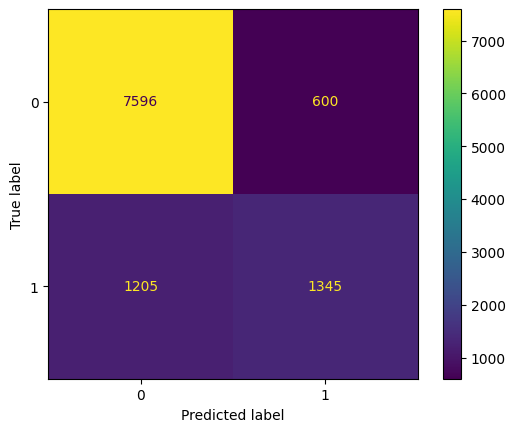

In [72]:

sgd=SGDClassifier(verbose=1,
               validation_fraction = 0.1,
               shuffle= False,
               penalty= 'l2',
               n_iter_no_change= 10,
               max_iter= 100,
               loss= 'squared_hinge',
               learning_rate= 'invscaling',
               eta0= 0.1,
               early_stopping= False,
               average= False,
               alpha= 0.001)

sgd.fit(X_train,Y_train)
print("Train Accuracy is : ",sgd.score(X_train,Y_train))
print("Test Accuracy is : ",sgd.score(X_test,Y_test))

predicted=sgd.predict(X_test)
cl=classification_report(y_true=Y_test,y_pred=predicted)
print(cl)


    
precision,recall,fbeta_score,support=precision_recall_fscore_support(y_true=Y_test,y_pred=predicted,labels=[0,1])
print(f"Precision is : {precision}")
print(f"Recall is : {recall}")
print(f"FBeta Score is : {fbeta_score}")
print(f"Support is : {support}")
cm = confusion_matrix(y_true=Y_test, y_pred=predicted, labels=sgd.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,display_labels=sgd.classes_)
disp.plot()
plt.show()

In [162]:
accuracies={}

In [165]:
def sf_selector(algo:str,forward:bool,floating:bool,scoring:int,X_train,Y_train,X_test,Y_test,min_featues:int,cv:int,verbose:int):
    model=eval(algo)
    sfs=EFS(model, 
            min_features=3,
            max_features=len(X_train.columns), 
            print_progress =True, 
            scoring='accuracy',
            cv=5,
            n_jobs=-1)
    sfs=sfs.fit(X_train, Y_train)
    print("Selected Features",sfs.k_feature_names_)
    model_=eval(algo)
    model_.fit(X_train.loc[:,list(sfs.k_feature_names_)],Y_train)
    score=model_.score(X_test.loc[:,list(sfs.k_feature_names_)],Y_test)
    
    print(f"Prediction using selected features using {model_} is :",score)
    accuracies[model]=score

In [1]:
# algorithms_to_be_tested=["LogisticRegression()","DecisionTreeClassifier()","SVC()","KNeighborsClassifier()","RandomForestClassifier()","SGDClassifier()","RidgeClassifierCV()","GaussianNB()"]

# for algo in algorithms_to_be_tested:
#     print(f"For {algo}")
#     sf_selector(algo=algo,forward=True,floating=False,scoring="accuracy",X_train=X_train,Y_train=Y_train,X_test=X_test,Y_test=Y_test,min_featues=3,cv=5,verbose=2)
#     # algo_testing(algo=algo,X_train=X_train,X_test=X_test,Y_train=Y_train,Y_test=Y_test,evaluation_metric="accuracy_score",final_accuracies=final_accuracies,fbeta=fbeta)
#     print()
#     print("-"*80)
#     print()
# print("All Completed")

In [132]:
def algo_testing(X_train,X_test,Y_train,Y_test,algo:str,evaluation_metric:str,final_accuracies:dict,fbeta:dict):
    model=eval(algo)
    evaluation_metric=eval(evaluation_metric)   
    model.fit(X_train,Y_train)
    
    
    print("Train Score ",model.score(X_train,Y_train))
    print("Test Score ",model.score(X_test,Y_test))
    final_accuracies[f'{model}']=model.score(X_test,Y_test)
    


    predicted=model.predict(X_test)
    cl=classification_report(y_true=Y_test,y_pred=predicted)
    print(cl)


    
    # accuracy=evaluation_metric(y_true=Y_test, y_pred=predicted)
    precision,recall,fbeta_score,support=precision_recall_fscore_support(y_true=Y_test,y_pred=predicted,labels=[0,1])
    fbeta[f'{model}']=fbeta_score
    print(f"Precision is : {precision}")
    print(f"Recall is : {recall}")
    print(f"FBeta Score is : {fbeta_score}")
    print(f"Support is : {support}")
    
    
    
    cm = confusion_matrix(y_true=Y_test, y_pred=predicted, labels=model.classes_)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm,display_labels=model.classes_)
    disp.plot()
    plt.show()

    
    

For LogisticRegression()
Train Score  0.8152188860875544
Test Score  0.8201191140889633
              precision    recall  f1-score   support

           0       0.84      0.95      0.89      8196
           1       0.71      0.41      0.52      2550

    accuracy                           0.82     10746
   macro avg       0.77      0.68      0.70     10746
weighted avg       0.81      0.82      0.80     10746

Precision is : [0.83740976 0.7105802 ]
Recall is : [0.94826745 0.40823529]
FBeta Score is : [0.88939749 0.51855542]
Support is : [8196 2550]


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1310: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


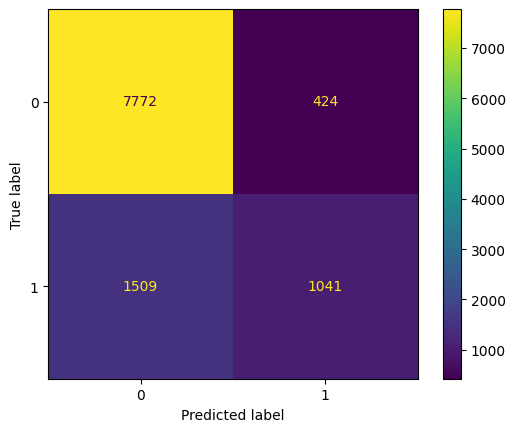


--------------------------------------------------------------------------------

For DecisionTreeClassifier()
Train Score  0.9976163190465276
Test Score  0.7715428996836032
              precision    recall  f1-score   support

           0       0.85      0.85      0.85      8196
           1       0.52      0.51      0.52      2550

    accuracy                           0.77     10746
   macro avg       0.68      0.68      0.68     10746
weighted avg       0.77      0.77      0.77     10746

Precision is : [0.84933674 0.51878213]
Recall is : [0.85151293 0.5145098 ]
FBeta Score is : [0.85042344 0.51663713]
Support is : [8196 2550]


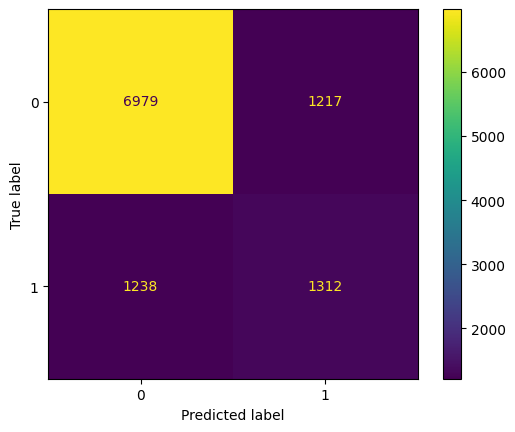


--------------------------------------------------------------------------------

For SVC()


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1310: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Train Score  0.8216823286729315
Test Score  0.8250511818351014
              precision    recall  f1-score   support

           0       0.84      0.95      0.89      8196
           1       0.72      0.44      0.54      2550

    accuracy                           0.83     10746
   macro avg       0.78      0.69      0.72     10746
weighted avg       0.81      0.83      0.81     10746

Precision is : [0.84348488 0.71585052]
Recall is : [0.94619327 0.43568627]
FBeta Score is : [0.89189189 0.54168698]
Support is : [8196 2550]


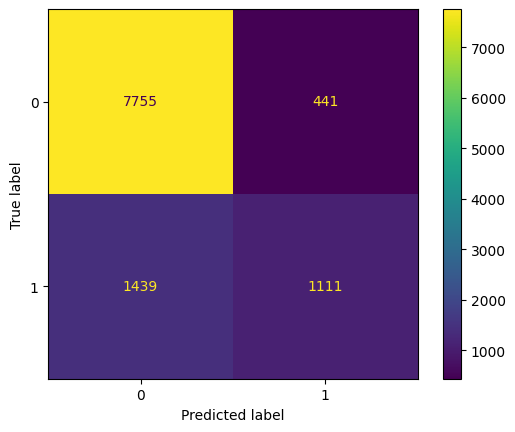


--------------------------------------------------------------------------------

For KNeighborsClassifier()


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:238: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


Train Score  0.862479944991978
Test Score  0.8083007630746324
              precision    recall  f1-score   support

           0       0.86      0.90      0.88      8196
           1       0.61      0.52      0.56      2550

    accuracy                           0.81     10746
   macro avg       0.74      0.71      0.72     10746
weighted avg       0.80      0.81      0.80     10746

Precision is : [0.85749243 0.61321627]
Recall is : [0.89787701 0.52039216]
FBeta Score is : [0.87722017 0.56300382]
Support is : [8196 2550]


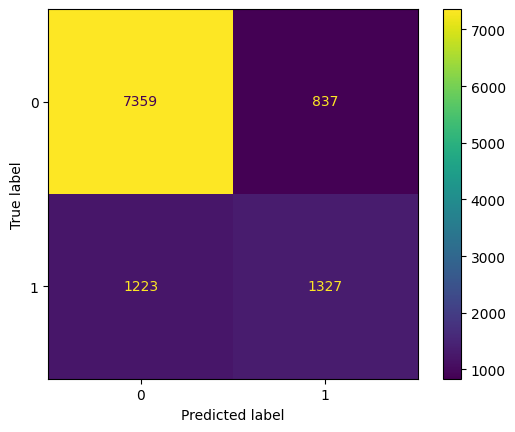


--------------------------------------------------------------------------------

For RandomForestClassifier()


/usr/local/lib/python3.11/dist-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Train Score  0.9973871189548476
Test Score  0.7976921645263354
              precision    recall  f1-score   support

           0       0.85      0.89      0.87      8196
           1       0.58      0.52      0.55      2550

    accuracy                           0.80     10746
   macro avg       0.72      0.70      0.71     10746
weighted avg       0.79      0.80      0.79     10746

Precision is : [0.85448552 0.58348135]
Recall is : [0.88555393 0.51529412]
FBeta Score is : [0.86974236 0.54727197]
Support is : [8196 2550]


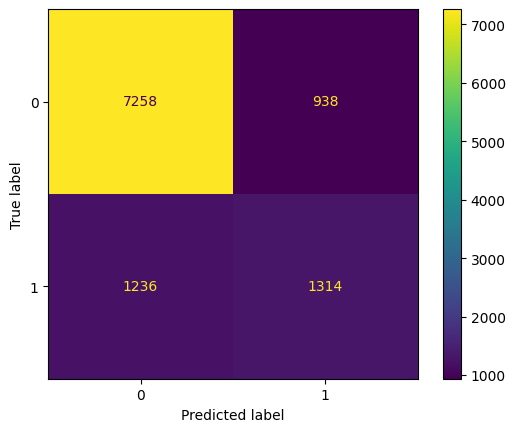


--------------------------------------------------------------------------------

For SGDClassifier()
Train Score  0.806371762548705
Test Score  0.8076493579006142
              precision    recall  f1-score   support

           0       0.86      0.90      0.88      8196
           1       0.61      0.52      0.56      2550

    accuracy                           0.81     10746
   macro avg       0.73      0.71      0.72     10746
weighted avg       0.80      0.81      0.80     10746

Precision is : [0.85695981 0.61175382]
Recall is : [0.89763299 0.51843137]
FBeta Score is : [0.87682498 0.56123965]
Support is : [8196 2550]


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1310: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


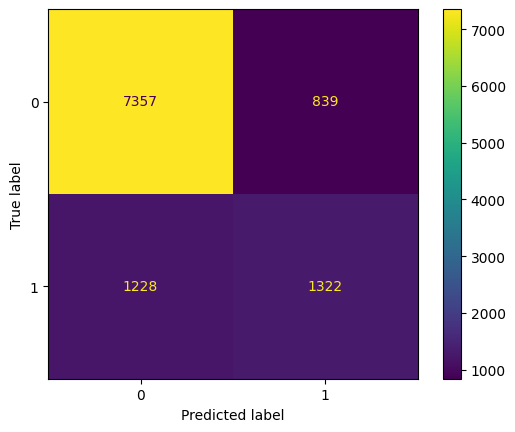


--------------------------------------------------------------------------------

For RidgeClassifierCV()
Train Score  0.8092596837038735
Test Score  0.8162106830448539
              precision    recall  f1-score   support

           0       0.83      0.96      0.89      8196
           1       0.73      0.35      0.48      2550

    accuracy                           0.82     10746
   macro avg       0.78      0.66      0.68     10746
weighted avg       0.80      0.82      0.79     10746

Precision is : [0.82697362 0.73317113]
Recall is : [0.95985847 0.3545098 ]
FBeta Score is : [0.88847479 0.47792757]
Support is : [8196 2550]


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:1301: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


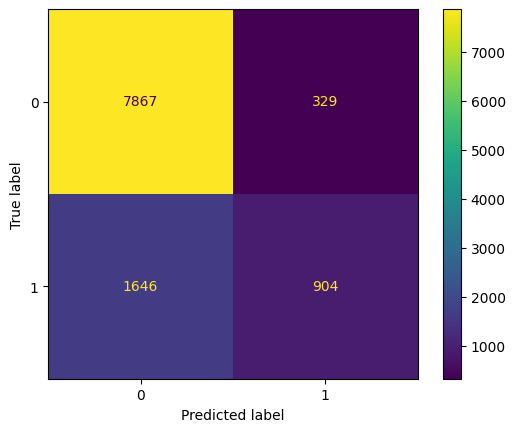


--------------------------------------------------------------------------------

For GaussianNB()
Train Score  0.7529223011689204
Test Score  0.7539549599851108
              precision    recall  f1-score   support

           0       0.88      0.79      0.83      8196
           1       0.49      0.64      0.55      2550

    accuracy                           0.75     10746
   macro avg       0.68      0.71      0.69     10746
weighted avg       0.78      0.75      0.76     10746

Precision is : [0.8758462 0.4860119]
Recall is : [0.78928746 0.64039216]
FBeta Score is : [0.83031703 0.55262267]
Support is : [8196 2550]


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1310: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


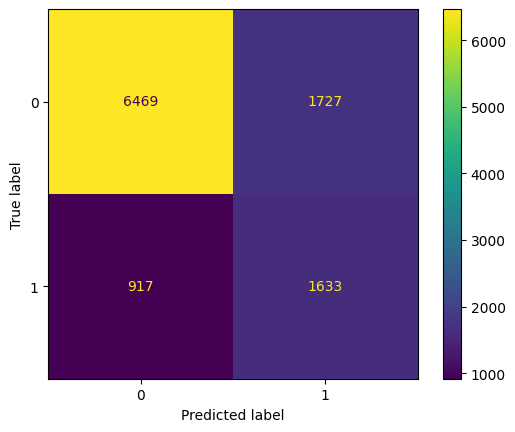


--------------------------------------------------------------------------------

All Completed


In [133]:
algorithms_to_be_tested=["LogisticRegression()","DecisionTreeClassifier()","SVC()","KNeighborsClassifier()","RandomForestClassifier()","SGDClassifier()","RidgeClassifierCV()","GaussianNB()"]
final_accuracies={}
fbeta={}
for algo in algorithms_to_be_tested:
    print(f"For {algo}")
    
    algo_testing(algo=algo,X_train=X_train,X_test=X_test,Y_train=Y_train,Y_test=Y_test,evaluation_metric="accuracy_score",final_accuracies=final_accuracies,fbeta=fbeta)
    print()
    print("-"*80)
    print()
print("All Completed")

In [134]:
final_accuracies

{'LogisticRegression()': 0.8201191140889633,
 'DecisionTreeClassifier()': 0.7715428996836032,
 'SVC()': 0.8250511818351014,
 'KNeighborsClassifier()': 0.8083007630746324,
 'RandomForestClassifier()': 0.7976921645263354,
 'SGDClassifier()': 0.8076493579006142,
 'RidgeClassifierCV()': 0.8162106830448539,
 'GaussianNB()': 0.7539549599851108}

In [135]:
fbeta

{'LogisticRegression()': array([0.88939749, 0.51855542]),
 'DecisionTreeClassifier()': array([0.85042344, 0.51663713]),
 'SVC()': array([0.89189189, 0.54168698]),
 'KNeighborsClassifier()': array([0.87722017, 0.56300382]),
 'RandomForestClassifier()': array([0.86974236, 0.54727197]),
 'SGDClassifier()': array([0.87682498, 0.56123965]),
 'RidgeClassifierCV()': array([0.88847479, 0.47792757]),
 'GaussianNB()': array([0.83031703, 0.55262267])}

In [ ]:
# label encoder

"""
final_accuracies=
{'LogisticRegression()': 0.8201191140889633,
 'DecisionTreeClassifier()': 0.7715428996836032,
 'SVC()': 0.8250511818351014,
 'KNeighborsClassifier()': 0.8083007630746324,
 'RandomForestClassifier()': 0.7976921645263354,
 'SGDClassifier()': 0.8076493579006142,
 'RidgeClassifierCV()': 0.8162106830448539,
 'GaussianNB()': 0.7539549599851108}

"""
"""



fbeta=
{'LogisticRegression()': array([0.88939749, 0.51855542]),
 'DecisionTreeClassifier()': array([0.85042344, 0.51663713]),
 'SVC()': array([0.89189189, 0.54168698]),
 'KNeighborsClassifier()': array([0.87722017, 0.56300382]),
 'RandomForestClassifier()': array([0.86974236, 0.54727197]),
 'SGDClassifier()': array([0.87682498, 0.56123965]),
 'RidgeClassifierCV()': array([0.88847479, 0.47792757]),
 'GaussianNB()': array([0.83031703, 0.55262267])}
"""


In [68]:
## Onehotencoder accuracies are:



""" final_accuracies:

{'LogisticRegression()': 0.8316582914572864,
 'DecisionTreeClassifier()': 0.7708914945095849,
 'SVC()': 0.8287734971152056,
 'KNeighborsClassifier()': 0.810534152242695,
 'RandomForestClassifier()': 0.7908989391401452,
 'SGDClassifier()': 0.827749860413177,
 'RidgeClassifierCV()': 0.83035548110925,
 'GaussianNB()': 0.502605620696073}

"""


"""
fbeta=

{'LogisticRegression()': array([0.89349426, 0.59862436]),
 'DecisionTreeClassifier()': array([0.84958456, 0.519516  ]),
 'SVC()': array([0.89222118, 0.58371041]),
 'KNeighborsClassifier()': array([0.87796691, 0.5765391 ]),
 'RandomForestClassifier()': array([0.8646304 , 0.54077253]),
 'SGDClassifier()': array([0.89014185, 0.60133534]),
 'RidgeClassifierCV()': array([0.89409167, 0.57396588]),
 'GaussianNB()': array([0.52619449, 0.4765449 ])}

"""

